In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import warnings
import numpy as np
from scipy.interpolate import interp1d

pd.set_option('display.float_format', lambda x: '%.10f' % x)  # Configure the format to 10 decimals

# Ignore all the advertencies (will not print them)
warnings.filterwarnings("ignore")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
directory=r'C:\Users\Elías Jr\Desktop\TFG\Supply Curves Datasets\2020' # Directory for the files of the year 2020

In [ ]:
MypathsDet=[]

# Collect all paths in Det files folder
for filename in os.listdir(directory):
  if filename != ".ipynb_checkpoints":
      f1 = os.path.join(directory, filename)
      MypathsDet.append(f1)

In [ ]:
len(MypathsDet)

365

# Global function for each year data

In [ ]:
energy_m_2020 = pd.DataFrame()
prices_m_2020 = pd.DataFrame()

# Iterate through the datasets
for i in range(0,len(MypathsDet)):
  data = pd.read_csv(MypathsDet[i], sep = ";", skiprows = 2, encoding = 'latin-1')

  # Drop the last row as it only contains NA values
  data.drop(data.index[-1], axis=0, inplace=True)

  # Change from ('.') to ('') in the columns Price and Energy
  data['Precio Compra/Venta'] = pd.concat([data['Precio Compra/Venta'].str.split()
                        .str[0]
                        .str.replace('.','')], axis=1)

  data['Energía Compra/Venta'] = pd.concat([data['Energía Compra/Venta'].str.split()
                       .str[0]
                       .str.replace('.','')], axis=1)

  # Change from (',') to ('.') in the columns Price and Energy
  data['Precio Compra/Venta'] = pd.concat([data['Precio Compra/Venta'].str.split()
                        .str[0]
                        .str.replace(',','.')], axis=1)

  data['Energía Compra/Venta'] = pd.concat([data['Energía Compra/Venta'].str.split()
                       .str[0]
                       .str.replace(',','.')], axis=1)

  # Drop the column 'Unnamed: 8' as it only contains NA values
  data = data.drop(['Unnamed: 8'], axis=1)

  # Rename column 'Energía Compra/Venta' to remove the accent
  data = data.rename(columns={'Energía Compra/Venta': 'Energia Compra/Venta'})

  # Only take the data related to Sales (V)
  data_ventas = data[data['Tipo Oferta'] == 'V']

  # Only take columns 'Hora', 'Fecha', 'Energia', 'Precio'
  df = data_ventas.loc[:, ['Hora', 'Fecha', 'Energia Compra/Venta', 'Precio Compra/Venta']]

  # Change column 'Hora' to numeric type, and columns 'Energia' and 'Precio' to float type
  df['Hora'] = df['Hora'].astype('int64')
  df['Energia Compra/Venta'] = df['Energia Compra/Venta'].astype('float64')
  df['Precio Compra/Venta'] = df['Precio Compra/Venta'].astype('float64')

  # Ask if there are 23 hours or not in order to add an hour 24 equal to the 23 one
  if len(df['Hora'].unique()) == 23:
    # Filter rows with hour equal to 23
    filas_hora_23 = df[df['Hora'] == 23]
    # Change column hour to 24 instead of 23
    filas_hora_23['Hora'] = 24
    # Add the filtered rows to the original dataframe
    df = pd.concat([df, filas_hora_23], ignore_index=True)

  # Order by Price the dataframe (in ascending order of price) from the Hour = 1 to Hour = 24
  dfhorario = pd.DataFrame()

  for i in df['Hora'].unique():
    order_i = pd.concat([df[df['Hora'] == i].sort_values(by = "Precio Compra/Venta")])
    dfhorario = dfhorario.append(pd.concat([order_i]))

  print(dfhorario)
  # Iterate through the 24 hours
  for hora in range(1, 25):
      # Filter the dataframe dfhorario for the actual hour
      df_por_hora = dfhorario[dfhorario['Hora'] == hora]

      # Create a variable with a unique name for each iteration
      nombre_variable = f'dfhorario_{hora}'
      nombre_energia_hora = f'energy_m_{hora}'
      nombre_precio_hora = f'precio_m_{hora}'

      # Assign the dataframe to the variable
      locals()[nombre_variable] = df_por_hora

      # Add a new column named 'Energia Acumulada' in each dataframe
      locals()[nombre_variable]['Energia Acumulada'] = locals()[nombre_variable]['Energia Compra/Venta'].cumsum()

      # Add the corresponding columns with the number of rows that there are in each dfhorario_{hora}
      locals()[nombre_energia_hora] = pd.DataFrame({'Hora' : locals()[nombre_variable]['Hora'].unique(), 'Fecha' : locals()[nombre_variable]['Fecha'].unique()})
      locals()[nombre_precio_hora] = pd.DataFrame({'Hora' : locals()[nombre_variable]['Hora'].unique(), 'Fecha' : locals()[nombre_variable]['Fecha'].unique()})

      for i in range(locals()[nombre_variable].shape[0]):
        locals()[nombre_energia_hora][i] = locals()[nombre_variable]['Energia Acumulada'].iloc[i]
        locals()[nombre_precio_hora][i] = locals()[nombre_variable]['Precio Compra/Venta'].iloc[i]

      energy_m_2020 = pd.concat([energy_m_2020, locals()[nombre_energia_hora]], ignore_index = True)
      prices_m_2020 = pd.concat([prices_m_2020, locals()[nombre_precio_hora]], ignore_index = True)

In [ ]:
energy_m = pd.DataFrame()
prices_m = pd.DataFrame()

In [ ]:
# Create the dataframe merging all the years
energy_m = pd.concat([energy_m_2016, energy_m_2017, energy_m_2018, energy_m_2019, energy_m_2020], ignore_index = True)

In [ ]:
# Create the dataframe merging all the years
prices_m = pd.concat([prices_m_2016, prices_m_2017, prices_m_2018, prices_m_2019, prices_m_2020], ignore_index = True)

In [ ]:
energy_m

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
1,1,01/01/2016,24390.2000000000,24750.2000000000,25290.2000000000,25533.8000000000,25537.6000000000,25552.6000000000,26266.4000000000,26267.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,2,01/01/2016,24209.4000000000,24569.4000000000,24749.4000000000,24971.8000000000,24974.2000000000,24989.2000000000,25668.8000000000,25669.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,3,01/01/2016,24926.4000000000,25286.4000000000,25507.4000000000,25509.2000000000,25524.2000000000,26158.6000000000,26182.6000000000,26183.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,4,01/01/2016,25871.4000000000,26396.4000000000,26609.6000000000,26610.8000000000,26625.8000000000,27267.4000000000,27268.4000000000,27971.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,5,01/01/2016,25973.0000000000,26498.2000000000,26723.8000000000,26725.0000000000,26740.0000000000,27428.0000000000,27429.4000000000,28277.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,6,01/01/2016,27280.4000000000,27330.4000000000,27855.8000000000,28092.6000000000,28094.6000000000,28109.6000000000,28853.0000000000,28854.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,7,01/01/2016,29013.8000000000,29233.8000000000,29839.2000000000,30103.4000000000,30108.4000000000,30123.4000000000,30967.6000000000,30969.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,8,01/01/2016,30029.3000000000,30531.3000000000,31176.7000000000,31481.9000000000,31490.9000000000,31505.9000000000,32485.7000000000,32487.9000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,9,01/01/2016,30404.6000000000,30906.6000000000,32206.8000000000,32539.8000000000,32540.2000000000,32552.8000000000,32567.8000000000,33627.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
10,10,01/01/2016,29842.4000000000,30344.4000000000,33190.6000000000,33600.6000000000,33601.0000000000,33615.2000000000,33630.2000000000,34758.8000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
prices_m

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.0100000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


## Removing 25 hours and adding where there are only 23

In [ ]:
fila_a_mover = prices_m.iloc[7295]
# Removing the row from the origianl dataframe
prices_m = prices_m.drop(7295)
# Insert the extracted row in the new index
prices_m = prices_m.iloc[:2087].append(fila_a_mover).append(prices_m.iloc[2087:]).reset_index(drop=True)

fila_a_mover = prices_m.iloc[16031]
# Removing the row from the origianl dataframe
prices_m = prices_m.drop(16031)
# Insert the extracted row in the new index
prices_m = prices_m.iloc[:10823].append(fila_a_mover).append(prices_m.iloc[10823:]).reset_index(drop=True)

fila_a_mover = prices_m.iloc[24767]
# Removing the row from the origianl dataframe
prices_m = prices_m.drop(24767)
# Insert the extracted row in the new index
prices_m = prices_m.iloc[:19559].append(fila_a_mover).append(prices_m.iloc[19559:]).reset_index(drop=True)

fila_a_mover = prices_m.iloc[33503]
# Removing the row from the origianl dataframe
prices_m = prices_m.drop(33503)
# Insertar la fila extraída en el índice 25
prices_m = prices_m.iloc[:28463].append(fila_a_mover).append(prices_m.iloc[28463:]).reset_index(drop=True)

fila_a_mover = prices_m.iloc[42239]
# Removing the row from the origianl dataframe
prices_m = prices_m.drop(42239)
# Insert the extracted row in the new index
prices_m = prices_m.iloc[:37199].append(fila_a_mover).append(prices_m.iloc[37199:]).reset_index(drop=True)




fila_a_mover = energy_m.iloc[7295]
# Removing the row from the origianl dataframe
energy_m = energy_m.drop(7295)
# Insert the extracted row in the new index
energy_m = energy_m.iloc[:2087].append(fila_a_mover).append(energy_m.iloc[2087:]).reset_index(drop=True)

fila_a_mover = energy_m.iloc[16031]
# Removing the row from the origianl dataframe
energy_m = energy_m.drop(16031)
# Insert the extracted row in the new index
energy_m = energy_m.iloc[:10823].append(fila_a_mover).append(energy_m.iloc[10823:]).reset_index(drop=True)

fila_a_mover = energy_m.iloc[24767]
# Removing the row from the origianl dataframe
energy_m = energy_m.drop(24767)
# Insert the extracted row in the new index
energy_m = energy_m.iloc[:19559].append(fila_a_mover).append(energy_m.iloc[19559:]).reset_index(drop=True)

fila_a_mover = energy_m.iloc[33503]
# Removing the row from the origianl dataframe
energy_m = energy_m.drop(33503)
# Insert the extracted row in the new index
energy_m = energy_m.iloc[:28463].append(fila_a_mover).append(energy_m.iloc[28463:]).reset_index(drop=True)

fila_a_mover = energy_m.iloc[42239]
# Removing the row from the origianl dataframe
energy_m = energy_m.drop(42239)
# Insert the extracted row in the new index
energy_m = energy_m.iloc[:37199].append(fila_a_mover).append(energy_m.iloc[37199:]).reset_index(drop=True)

In [ ]:
# Save the DataFrame to a .csv file
energy_m.to_csv('energy_m.csv', index = False)

In [ ]:
# Save the DataFrame to a .csv file
prices_m.to_csv('prices_m.csv', index = False)

In [ ]:
# Load the dataframes
energy_m = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\energy_m.csv')
prices_m = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\prices_m.csv')

In [ ]:
# Obtain the maximum value of the shortest curve (refers to take the last number before the NA values start that is the lowest)
minimum = 1000000000
for i in range(energy_m.shape[0]):
  if minimum > energy_m.iloc[i, energy_m.notna().sum(axis=1)[i] - 1]:
    minimum = energy_m.iloc[i, energy_m.notna().sum(axis=1)[i] - 1]
    minimum_index = i

print(f'Minimum: {minimum}')
print(f'Minimum index: {minimum_index}')

Minimum: 69042.4
Minimum index: 42601


In [ ]:
energy_m.notna().sum(axis=1)[42601] - 1

386

In [ ]:
# Minimum index is the row where the number is --> 42601, 386
# Minimum is the number --> 69042.4

In [ ]:
for index, i in enumerate(energy_m.notna().sum(axis=1) - 1):
    if i == 386:
        print("El valor 386 se encuentra en la fila de índice:", index)
        print(energy_m.iloc[index, 386])

El valor 386 se encuentra en la fila de índice: 2286
97263.6
El valor 386 se encuentra en la fila de índice: 2526
89878.9
El valor 386 se encuentra en la fila de índice: 3725
85208.0
El valor 386 se encuentra en la fila de índice: 4560
91584.2
El valor 386 se encuentra en la fila de índice: 4657
95486.1
El valor 386 se encuentra en la fila de índice: 4659
94483.1
El valor 386 se encuentra en la fila de índice: 4781
88569.6
El valor 386 se encuentra en la fila de índice: 4801
90924.0
El valor 386 se encuentra en la fila de índice: 4824
93973.4
El valor 386 se encuentra en la fila de índice: 5065
92053.7
El valor 386 se encuentra en la fila de índice: 5185
89794.0
El valor 386 se encuentra en la fila de índice: 5256
95118.5
El valor 386 se encuentra en la fila de índice: 5524
83411.7
El valor 386 se encuentra en la fila de índice: 5643
83834.2
El valor 386 se encuentra en la fila de índice: 5932
77449.6
El valor 386 se encuentra en la fila de índice: 5952
82835.5
El valor 386 se encuentr

In [ ]:
minimum = energy_m.iloc[42601, 386]
energy_m.iloc[42601, 386]

69042.4

In [ ]:
# Loading the dataframes
energy_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\energy_m.csv')
prices_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\prices_m.csv')

In [ ]:
# Define a new dataframe in the range [0, Q*], where Q* is the maximum value of energy of the shortest curve
for r in range(energy_m_reduced.shape[0]):
  valor_superado = False
  for c in range(2, energy_m_reduced.shape[1]):
    if valor_superado:
        # If the value has already been exceeded, put the value as NaN
        energy_m_reduced.iloc[r, c] = np.nan
        prices_m_reduced.iloc[r,c] = np.nan
    elif energy_m_reduced.iloc[r,c] >= minimum:
        # If the value is equal or higher than 'minimum', set the flag to True
        valor_superado = True
        energy_m_reduced.iloc[r,c] = minimum

In [ ]:
energy_m_reduced

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,24390.2000000000,24750.2000000000,25290.2000000000,25533.8000000000,25537.6000000000,25552.6000000000,26266.4000000000,26267.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,24209.4000000000,24569.4000000000,24749.4000000000,24971.8000000000,24974.2000000000,24989.2000000000,25668.8000000000,25669.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,24926.4000000000,25286.4000000000,25507.4000000000,25509.2000000000,25524.2000000000,26158.6000000000,26182.6000000000,26183.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,25871.4000000000,26396.4000000000,26609.6000000000,26610.8000000000,26625.8000000000,27267.4000000000,27268.4000000000,27971.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,25973.0000000000,26498.2000000000,26723.8000000000,26725.0000000000,26740.0000000000,27428.0000000000,27429.4000000000,28277.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,27280.4000000000,27330.4000000000,27855.8000000000,28092.6000000000,28094.6000000000,28109.6000000000,28853.0000000000,28854.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,29013.8000000000,29233.8000000000,29839.2000000000,30103.4000000000,30108.4000000000,30123.4000000000,30967.6000000000,30969.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,30029.3000000000,30531.3000000000,31176.7000000000,31481.9000000000,31490.9000000000,31505.9000000000,32485.7000000000,32487.9000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,30404.6000000000,30906.6000000000,32206.8000000000,32539.8000000000,32540.2000000000,32552.8000000000,32567.8000000000,33627.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,29842.4000000000,30344.4000000000,33190.6000000000,33600.6000000000,33601.0000000000,33615.2000000000,33630.2000000000,34758.8000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
prices_m_reduced

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.0100000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
# Save the dataframe
energy_m_reduced.to_csv('energy_m_reduced.csv', index = False)

In [ ]:
# Save the dataframe
prices_m_reduced.to_csv('prices_m_reduced.csv', index = False)

In [ ]:
# Loading the dataframes
energy_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\energy_m_reduced.csv')
prices_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\prices_m_reduced.csv')

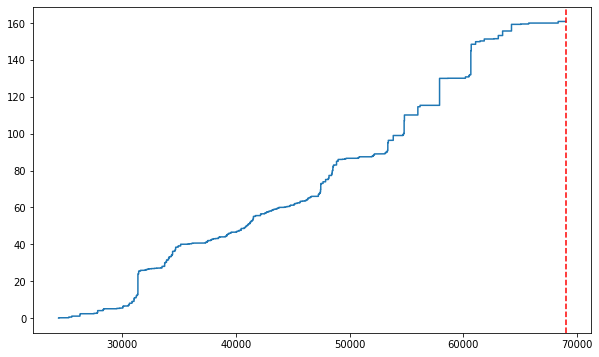

In [ ]:
# Visualization of curve
fig, ax = plt.subplots(figsize = (10,6))
qq = energy_m_reduced.iloc[0][2:].to_list()
pp = prices_m_reduced.iloc[0][2:].to_list()
plt.step(qq,pp)
plt.axvline(x=minimum, color='red', linestyle='--')

# 43848 x N Matrix and [0, minimum] Grid creation using Interpolation

In [ ]:
# Put the grid between 0 and the maximum value of energy of the shortest curve computed before
max_q = minimum
min_q = 0

In [ ]:
# Function for the constant interpolation
def constant_interpolation(qq, pp, x_interp):
    result = np.zeros_like(x_interp)
    result[x_interp < qq[0]] = pp[0]  # Assign the first value of pp to x_interp < qq[0]
    for i, xi in enumerate(qq):
        mask = (x_interp >= xi)
        if i < len(qq) - 1:
            result[mask] = pp[i + 1]
        else:
            result[mask] = pp[-1]
    return result

In [ ]:
# Defining the grid of quantities of energy
x_interp = np.linspace(0, 0, 1)
min_q = energy_m_reduced['x1'].quantile(0.3)
x_interp = np.concatenate([x_interp, np.linspace(min_q, max_q, 49)])
print(x_interp)

[    0.    28399.6   29246.325 30093.05  30939.775 31786.5   32633.225
 33479.95  34326.675 35173.4   36020.125 36866.85  37713.575 38560.3
 39407.025 40253.75  41100.475 41947.2   42793.925 43640.65  44487.375
 45334.1   46180.825 47027.55  47874.275 48721.    49567.725 50414.45
 51261.175 52107.9   52954.625 53801.35  54648.075 55494.8   56341.525
 57188.25  58034.975 58881.7   59728.425 60575.15  61421.875 62268.6
 63115.325 63962.05  64808.775 65655.5   66502.225 67348.95  68195.675
 69042.4  ]


In [ ]:
grid_prices = pd.DataFrame(columns=range(50), dtype = 'object')

# Iterate through all the curves
for i in range(energy_m_reduced.shape[0]):
  qq = energy_m_reduced.iloc[i][2:].to_list()
  pp = prices_m_reduced.iloc[i][2:].to_list()

  # Remove the NaN values from the list
  qq = [x for x in qq if not np.isnan(x)]
  pp = [x for x in pp if not np.isnan(x)]

  # Compute the interpolated values for the x_interp points
  y_interp = constant_interpolation(qq, pp, x_interp)

  # Add the obtained interpolations to the dataframe
  grid_prices.loc[i] = y_interp

In [ ]:
grid_prices

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.0000000000,5.0000000000,5.0000000000,6.3500000000,9.0000000000,25.8600000000,26.8100000000,27.1900000000,34.0200000000,40.0000000000,...,149.9000000000,151.3500000000,153.2500000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000,160.0000000000,160.8700000000
1,0.0000000000,5.0000000000,5.2000000000,8.0000000000,20.0000000000,25.4600000000,26.7300000000,27.1700000000,32.4000000000,39.1000000000,...,151.5200000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000,160.0000000000,160.8700000000,170.0000000000,171.0000000000
2,0.0000000000,2.5000000000,5.0000000000,5.0000000000,6.5000000000,11.0000000000,25.8800000000,26.8300000000,28.0000000000,33.2200000000,...,151.3500000000,151.5200000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000,160.0000000000,160.8700000000,170.0000000000
3,0.0000000000,2.3000000000,2.3000000000,2.7000000000,5.0000000000,5.0000000000,6.5000000000,11.0000000000,25.9500000000,26.9000000000,...,149.9000000000,151.3500000000,153.2500000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000,160.0000000000,160.8700000000
4,0.0000000000,2.3000000000,2.3000000000,2.3000000000,4.0000000000,5.0000000000,5.0000000000,6.5000000000,11.0000000000,25.8600000000,...,132.0000000000,149.9000000000,151.3500000000,153.2500000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000,160.0000000000
5,0.0000000000,1.0000000000,1.1300000000,2.3000000000,2.3000000000,2.3000000000,2.5000000000,4.0000000000,5.0000000000,5.3500000000,...,130.0700000000,130.0700000000,148.5000000000,150.3000000000,151.3500000000,155.7000000000,159.3000000000,159.5000000000,160.0000000000,160.0000000000
6,0.0000000000,0.0000000000,0.1000000000,0.5000000000,1.0000000000,1.1300000000,2.3000000000,2.3000000000,2.3000000000,2.3000000000,...,115.3800000000,115.3800000000,130.0700000000,130.0700000000,132.0000000000,149.9000000000,151.3500000000,153.2500000000,155.7000000000,159.3000000000
7,0.0000000000,0.0000000000,0.0000000000,0.0100000000,0.1000000000,1.0000000000,1.1300000000,1.1300000000,1.1300000000,2.3000000000,...,86.4000000000,87.4500000000,88.4500000000,89.0600000000,99.0100000000,110.1300000000,110.1300000000,115.3800000000,130.0000000000,130.0700000000
8,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.1000000000,0.1000000000,1.0000000000,1.0000000000,1.1300000000,1.1300000000,...,60.2400000000,62.4300000000,64.6500000000,66.0000000000,73.8900000000,77.3200000000,85.2500000000,86.6500000000,88.4500000000,89.0400000000
9,0.0000000000,0.0000000000,0.0000000000,0.0100000000,0.1000000000,0.1000000000,0.1000000000,0.5000000000,1.0000000000,1.1300000000,...,52.7100000000,54.6100000000,55.6500000000,57.5900000000,59.9900000000,60.7400000000,63.2900000000,65.0800000000,66.0000000000,73.0000000000


In [ ]:
# Save the dataframe
grid_prices.to_csv('grid_prices.csv', index = False)

In [ ]:
# Loading the dataframe
grid_prices = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices.csv')

# Graphic representation of the data in edges (Q, P)

In [ ]:
# Real curve for January 22, 2016
qq = energy_m_reduced.iloc[510][2:].to_list()
pp = prices_m_reduced.iloc[510][2:].to_list()

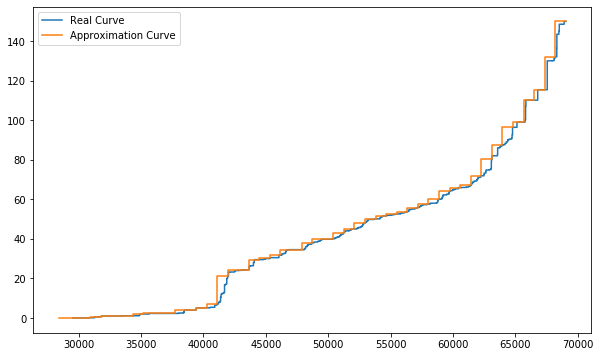

In [ ]:
# Visualization of the real curve and the approximated curve
fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq,pp, label = "Real")
plt.step(x_interp[1:], grid_prices.iloc[510, 1:], label = "Approximation")
plt.legend(["Real Curve", "Approximation Curve"])

In [ ]:
d = 1
h = 1

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m.iloc[(h-1) + (d-1) * 24][2:]
pp = prices_m.iloc[(h-1) + (d-1) * 24][2:]

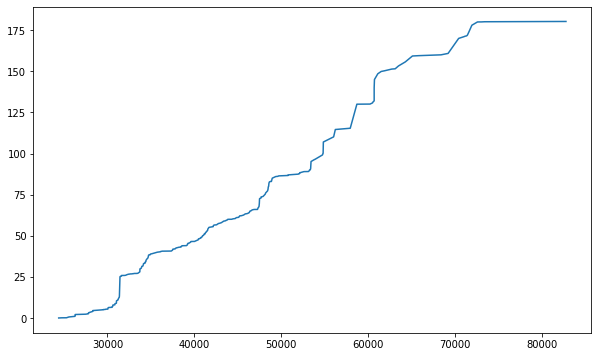

In [ ]:
# (Q,P) figure
fig, ax = plt.subplots(figsize = (10,6))
ax.plot(qq,pp)
plt.show()

# L1 Distance function definition

In [ ]:
# Definition of the L1 distance
def l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada):
  distancia_l1 = 0
  y1 = constant_interpolation(qq, pp, (np.array(qq_combinada[1:]) + np.array(qq_combinada[0:-1])) / 2)
  y2 = constant_interpolation(qq1, pp1, (np.array(qq_combinada[1:]) + np.array(qq_combinada[0:-1])) / 2)
  distancia_l1 = np.sum(np.abs(y1 - y2) * diferencias)

  return distancia_l1

In [ ]:
def l2_distance(qq, pp, qq1, pp1, diferencias_qq_qq1, qq_combinada):
  distancia_l2 = 0
  y1 = constant_interpolation(qq, pp, (np.array(qq_combinada[1:]) + np.array(qq_combinada[0:-1])) / 2)
  y2 = constant_interpolation(qq1, pp1, (np.array(qq_combinada[1:]) + np.array(qq_combinada[0:-1])) / 2)
  distancia_l2 = np.sum((np.abs(y1 - y2)**2) * diferencias)

  return distancia_l2

# Data scaling

In [ ]:
# Loading data
energy_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\energy_m_reduced.csv')

In [ ]:
energy_m_reduced

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,24390.2000000000,24750.2000000000,25290.2000000000,25533.8000000000,25537.6000000000,25552.6000000000,26266.4000000000,26267.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,24209.4000000000,24569.4000000000,24749.4000000000,24971.8000000000,24974.2000000000,24989.2000000000,25668.8000000000,25669.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,24926.4000000000,25286.4000000000,25507.4000000000,25509.2000000000,25524.2000000000,26158.6000000000,26182.6000000000,26183.2000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,25871.4000000000,26396.4000000000,26609.6000000000,26610.8000000000,26625.8000000000,27267.4000000000,27268.4000000000,27971.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,25973.0000000000,26498.2000000000,26723.8000000000,26725.0000000000,26740.0000000000,27428.0000000000,27429.4000000000,28277.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,27280.4000000000,27330.4000000000,27855.8000000000,28092.6000000000,28094.6000000000,28109.6000000000,28853.0000000000,28854.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,29013.8000000000,29233.8000000000,29839.2000000000,30103.4000000000,30108.4000000000,30123.4000000000,30967.6000000000,30969.4000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,30029.3000000000,30531.3000000000,31176.7000000000,31481.9000000000,31490.9000000000,31505.9000000000,32485.7000000000,32487.9000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,30404.6000000000,30906.6000000000,32206.8000000000,32539.8000000000,32540.2000000000,32552.8000000000,32567.8000000000,33627.6000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,29842.4000000000,30344.4000000000,33190.6000000000,33600.6000000000,33601.0000000000,33615.2000000000,33630.2000000000,34758.8000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
# Loading data
prices_m_reduced = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\prices_m_reduced.csv')

In [ ]:
prices_m_reduced

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,0,0.1000000000,0.1300000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.0100000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,0,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,1.1300000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5700000000,0.6000000000,1.0000000000,1.1000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,0,0.0100000000,0.1000000000,0.5000000000,0.5600000000,0.5700000000,0.6000000000,1.0000000000,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


## Energy

In [ ]:
# Divide all the columns by Q*
df_scaled = energy_m_reduced.iloc[:, 2:] / energy_m_reduced.iloc[42601, 386]

In [ ]:
# Merge the new scaled dataframe with the columns 'hour' and 'date'
energy_m_reduced_scaled = pd.concat([energy_m_reduced.iloc[:, :2], df_scaled], axis=1)

In [ ]:
energy_m_reduced_scaled

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,0.3532640812,0.3584782684,0.3662995493,0.3698278160,0.3698828546,0.3701001124,0.3804386870,0.3804502740,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,0.3506454005,0.3558595877,0.3584666813,0.3616878903,0.3617226516,0.3619399094,0.3717831362,0.3717918265,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,0.3610303234,0.3662445106,0.3694454422,0.3694715132,0.3696887710,0.3788773276,0.3792249400,0.3792336303,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,0.3747175649,0.3823215879,0.3854095454,0.3854269261,0.3856441839,0.3949370242,0.3949515081,0.4051336570,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,0.3761891244,0.3837960442,0.3870636015,0.3870809821,0.3872982399,0.3972631311,0.3972834085,0.4095657161,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,0.3951253143,0.3958495070,0.4034593235,0.4068891000,0.4069180677,0.4071353255,0.4179026222,0.4179257963,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,0.4202316258,0.4234180735,0.4321865984,0.4360132324,0.4360856517,0.4363029095,0.4485301786,0.4485562495,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,0.4349399789,0.4422108733,0.4515587523,0.4559792244,0.4561095790,0.4563268368,0.4705181164,0.4705499809,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,0.4403757691,0.4476466635,0.4664785697,0.4713016929,0.4713074864,0.4714899830,0.4717072408,0.4870572286,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,0.4322329467,0.4395038411,0.4807277847,0.4866661646,0.4866719581,0.4868776288,0.4870948866,0.5034413636,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
# Save the dataframe
energy_m_reduced_scaled.to_csv('energy_m_reduced_scaled.csv', index = False)

In [ ]:
energy_m_reduced_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\energy_m_reduced_scaled.csv')

## Prices

In [ ]:
# Divide all the columns by Q*
df_scaled_p = prices_m_reduced.iloc[:, 2:] / prices_m_reduced.iloc[42601, 386]

In [ ]:
# Merge the new scaled dataframe with the columns 'hour' and 'date'
prices_m_reduced_scaled = pd.concat([prices_m_reduced.iloc[:, :2], df_scaled_p], axis=1)

In [ ]:
prices_m_reduced_scaled

,hour,date,x1,x2,x3,x4,x5,x6,x7,x8,...,x689,x690,x691,x692,x693,x694,x695,x696,x697,x698
0,1,01/01/2016,0.0000000000,0.0005546312,0.0007210205,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,01/01/2016,0.0000000000,0.0005546312,0.0007210205,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,3,01/01/2016,0.0000000000,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0056017748,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,01/01/2016,0.0000000000,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,0.0062673322,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,5,01/01/2016,0.0000000000,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,0.0062673322,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,6,01/01/2016,0.0000000000,0.0000554631,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,7,01/01/2016,0.0000000000,0.0000554631,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,8,01/01/2016,0.0000000000,0.0000554631,0.0005546312,0.0027731559,0.0031613977,0.0033277870,0.0055463117,0.0061009429,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,9,01/01/2016,0.0000000000,0.0000554631,0.0005546312,0.0027731559,0.0031059346,0.0031613977,0.0033277870,0.0055463117,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,10,01/01/2016,0.0000000000,0.0000554631,0.0005546312,0.0027731559,0.0031059346,0.0031613977,0.0033277870,0.0055463117,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
# Save the dataframe
prices_m_reduced_scaled.to_csv('prices_m_reduced_scaled.csv', index = False)

In [ ]:
prices_m_reduced_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\prices_m_reduced_scaled.csv')

## Grid Prices Scaled

In [ ]:
grid_prices = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices.csv')

In [ ]:
# Divide by the maximum value of the last column, where the maximum number is
grid_prices_scaled = grid_prices / grid_prices.iloc[:, -1].max()

In [ ]:
grid_prices_scaled

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.0000000000,0.0277315585,0.0277315585,0.0352190793,0.0499168053,0.1434276206,0.1486966167,0.1508042152,0.1886855241,0.2218524681,...,0.8313921242,0.8394342762,0.8499722684,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724,0.8874098724,0.8922351636
1,0.0000000000,0.0277315585,0.0288408209,0.0443704936,0.1109262341,0.1412090960,0.1482529118,0.1506932890,0.1797004992,0.2168607876,...,0.8403771492,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724,0.8874098724,0.8922351636,0.9428729895,0.9484193012
2,0.0000000000,0.0138657793,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1435385469,0.1488075430,0.1552967277,0.1842484748,...,0.8394342762,0.8403771492,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724,0.8874098724,0.8922351636,0.9428729895
3,0.0000000000,0.0127565169,0.0127565169,0.0149750416,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1439267887,0.1491957848,...,0.8313921242,0.8394342762,0.8499722684,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724,0.8874098724,0.8922351636
4,0.0000000000,0.0127565169,0.0127565169,0.0127565169,0.0221852468,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1434276206,...,0.7321131448,0.8313921242,0.8394342762,0.8499722684,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724,0.8874098724
5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,0.0277315585,0.0296727676,...,0.7214087632,0.7214087632,0.8236272879,0.8336106489,0.8394342762,0.8635607321,0.8835274542,0.8846367166,0.8874098724,0.8874098724
6,0.0000000000,0.0000000000,0.0005546312,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0.6399334443,0.6399334443,0.7214087632,0.7214087632,0.7321131448,0.8313921242,0.8394342762,0.8499722684,0.8635607321,0.8835274542
7,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0055463117,0.0062673322,0.0062673322,0.0062673322,0.0127565169,...,0.4792013311,0.4850249584,0.4905712701,0.4939545202,0.5491403217,0.6108153078,0.6108153078,0.6399334443,0.7210205214,0.7214087632
8,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0.3341098170,0.3462562396,0.3585690516,0.3660565724,0.4098169717,0.4288408209,0.4728230727,0.4805879090,0.4905712701,0.4938435940
9,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,0.0055463117,0.0062673322,...,0.2923460899,0.3028840821,0.3086522463,0.3194120910,0.3327232390,0.3368829728,0.3510260677,0.3609539656,0.3660565724,0.4048807543


In [ ]:
# Save the dataframe
grid_prices_scaled.to_csv('grid_prices_scaled.csv', index = False)

In [ ]:
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled.csv')

# Error computation in test data using Naive procedure

In [ ]:
# Comparison between the real curve with the same curve but 24 hours before

In [ ]:
# Create an empty dataframe
naive_l1_distances = pd.DataFrame()

for d in range(1097, 1827):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()
    pp = prices_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()

    # In order to compare the 24 hours before curve, it is just needed to subtract 24 hours in the formula
    qq1 = energy_m_reduced_scaled.iloc[(h-1) + (d-1) * 24 - 24][2:].to_list()
    pp1 = prices_m_reduced_scaled.iloc[(h-1) + (d-1) * 24 - 24][2:].to_list()

    # Remove NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    qq1 = [x for x in qq1 if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]
    pp1 = [x for x in pp1 if not np.isnan(x)]

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    naive_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
naive_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1097: 0.04734291162849477
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1097: 0.04944501030816569
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1097: 0.05409242153441907
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1097: 0.0664248828739055
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1097: 0.07188159093653376
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1097: 0.0748643763457733
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1097: 0.081296866351561
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1097: 0.09369876792743571
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1097: 0.08221425241829255
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1097: 0.05653768640173067
------------------------

Dis

Distancia L1 (Manhattan) para la hora 16 del día 1100: 0.003109813864473382
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1100: 0.003434026688811039
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1100: 0.004162783258784951
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1100: 0.0021470044894450866
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1100: 0.002028156077605794
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1100: 0.018933466681825627
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1100: 0.012878334317207118
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1100: 0.0182483095632011
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1100: 0.0063599994040010824
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1101: 0.0429993527685663
---------

Distancia L1 (Manhattan) para la hora 8 del día 1104: 0.026182828025025962
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1104: 0.019520373548909883
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1104: 0.007713278123294124
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1104: 0.005345632330785906
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1104: 0.00797797942086552
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1104: 0.009088468591187917
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1104: 0.008248069145694412
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1104: 0.012815858219581826
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1104: 0.014861567393998068
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1104: 0.014759371236306834
---------

Distancia L1 (Manhattan) para la hora 20 del día 1107: 0.018335473601826795
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1107: 0.018221665378174073
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1107: 0.011027271182445213
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1107: 0.013442515271219127
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1107: 0.01417369417128416
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1108: 0.03442352566855971
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1108: 0.056846053263859164
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1108: 0.0637030595502339
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1108: 0.06941032622689133
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1108: 0.0711883880092292
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1111: 0.04647259109643294
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1111: 0.051611825543982845
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1111: 0.05515207792221229
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1111: 0.057130320054311595
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1111: 0.06370880762370147
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1111: 0.06295746355263208
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1111: 0.0614276293113451
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1111: 0.052385749243615096
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1111: 0.05600454290761318
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1111: 0.056867963405820586
-------------

Distancia L1 (Manhattan) para la hora 7 del día 1115: 0.014024678857061743
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1115: 0.01706178506277739
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1115: 0.014062380415827691
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1115: 0.016539796706400982
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1115: 0.020347781548260332
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1115: 0.023307003021362342
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1115: 0.01909482901916296
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1115: 0.019651258500816962
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1115: 0.015452085504264534
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1115: 0.02110162466644802
------------

Distancia L1 (Manhattan) para la hora 20 del día 1118: 0.05133583591827139
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1118: 0.05163163396072792
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1118: 0.04756374757591064
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1118: 0.04671098078331494
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1118: 0.062121942105086564
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1119: 0.10446164757236892
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1119: 0.1304688967514389
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1119: 0.13634580742876468
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1119: 0.12796327269445984
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1119: 0.12161450040564104
---------------------

Distancia L1 (Manhattan) para la hora 15 del día 1122: 0.035946986291362906
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1122: 0.0334407019859585
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1122: 0.030405251181058232
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1122: 0.030970831598243206
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1122: 0.0277657532607275
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1122: 0.01988045266792708
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1122: 0.01778334163933725
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1122: 0.015097991438013453
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1122: 0.004656152388427752
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1122: 0.010191433146623201
------------

Distancia L1 (Manhattan) para la hora 7 del día 1126: 0.010652349126141488
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1126: 0.02222519453172727
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1126: 0.03476543072467229
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1126: 0.03737913613947542
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1126: 0.03513727863731589
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1126: 0.02580956257451713
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1126: 0.02191742831170567
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1126: 0.015675824407921757
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1126: 0.014311016284259825
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1126: 0.00981834683639768
----------------

Distancia L1 (Manhattan) para la hora 19 del día 1129: 0.010131437780428038
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1129: 0.00911802673793563
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1129: 0.009538202039764843
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1129: 0.007297543411860134
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1129: 0.010415707623495182
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1129: 0.021315892511691303
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1130: 0.05816235035946207
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1130: 0.07725497442683285
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1130: 0.08773352976362624
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1130: 0.0941173507283786
----------------

------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1133: 0.037787783482911126
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1133: 0.02105516853006944
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1133: 0.007563841146584163
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1133: 0.009085218681187033
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1133: 0.01200700055806295
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1133: 0.009659506280124922
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1133: 0.004495272765871793
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1133: 0.0013398990287601864
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1133: 0.0014585102203050165
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1133: 0.0024

Distancia L1 (Manhattan) para la hora 18 del día 1136: 0.021056026073802362
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1136: 0.021022518566629147
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1136: 0.010922592365356667
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1136: 0.006936825493052379
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1136: 0.003664150698423133
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1136: 0.005996577671894679
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1136: 0.009919537719871245
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1137: 0.030294676961677196
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1137: 0.05083205174928669
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1137: 0.08123237167230377
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1140: 0.04000716562739917
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1140: 0.04446631182302284
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1140: 0.0471990029369945
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1140: 0.03815054826020273
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1140: 0.02267225011423047
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1140: 0.030284034181212813
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1140: 0.034538276266501064
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1140: 0.027693903627694524
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1140: 0.02199093487186142
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1140: 0.017385673185310053
--------------------

Distancia L1 (Manhattan) para la hora 18 del día 1143: 0.007483487250343433
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1143: 0.006153208135129476
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1143: 0.01904847273541763
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1143: 0.022775510750798034
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1143: 0.02229771349069774
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1143: 0.0208127307547762
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1143: 0.016229647036959626
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1144: 0.018644735362052228
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1144: 0.029795467055478524
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1144: 0.03976244722760218
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1147: 0.016804286248911015
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1147: 0.014907476871350644
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1147: 0.012186358139349467
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1147: 0.010541556484145948
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1147: 0.007737993296830881
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1147: 0.007210310528739918
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1147: 0.010760276085927676
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1147: 0.013017710197215683
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1147: 0.018133416536684724
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1148: 0.03457674595952222
--------

Distancia L1 (Manhattan) para la hora 2 del día 1151: 0.03500006585614542
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1151: 0.030697103478027718
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1151: 0.024347762599556323
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1151: 0.02689181409494256
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1151: 0.03915246893966154
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1151: 0.05009192330592848
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1151: 0.0626495222892574
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1151: 0.030529553169379102
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1151: 0.02348467989726428
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1151: 0.020632099429842912
---------------------

Distancia L1 (Manhattan) para la hora 14 del día 1154: 0.01606624820396202
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1154: 0.0182188903907539
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1154: 0.01966701826682704
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1154: 0.021245912524826032
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1154: 0.02162892039512864
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1154: 0.02240112756131965
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1154: 0.025004175816236547
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1154: 0.023259995968363572
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1154: 0.021857830829736212
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1154: 0.014337421883349005
------------

Distancia L1 (Manhattan) para la hora 4 del día 1158: 0.05955013679923221
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1158: 0.05155798336535786
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1158: 0.034817537331180204
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1158: 0.029731954354168942
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1158: 0.028775928692308918
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1158: 0.014917676139032875
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1158: 0.00839988402891851
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1158: 0.006290102480388255
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1158: 0.0034835879769884804
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1158: 0.003445440254485498
--------------

Distancia L1 (Manhattan) para la hora 14 del día 1161: 0.04206772464765096
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1161: 0.03909724914815821
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1161: 0.03687148181738334
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1161: 0.04012899387317093
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1161: 0.03956879425170674
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1161: 0.037577077717687105
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1161: 0.034613050465074194
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1161: 0.018540181139842342
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1161: 0.013636754349135666
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1161: 0.013657133524496417
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1165: 0.012871388253136343
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1165: 0.018396289880378565
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1165: 0.04421568685479012
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1165: 0.024094626293414537
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1165: 0.011902275871422034
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1165: 0.020854472609752726
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1165: 0.0119233645387031
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1165: 0.0052556429365976
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1165: 0.0035505542298317743
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1165: 0.002843614938067043
-----------------

Distancia L1 (Manhattan) para la hora 21 del día 1168: 0.009895450581641667
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1168: 0.0035546998412492523
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1168: 0.001365558022560929
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1168: 0.006774504795365274
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1169: 0.03797284792736684
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1169: 0.05592590715145298
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1169: 0.07740604085713333
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1169: 0.09256568346381717
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1169: 0.10029738604475276
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1169: 0.09654364150674002
-----------------

Distancia L1 (Manhattan) para la hora 15 del día 1172: 0.028821197120575882
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1172: 0.03182024894953262
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1172: 0.03375829826794835
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1172: 0.034295502623259616
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1172: 0.027566596018880167
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1172: 0.029069999999164545
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1172: 0.02749691358161554
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1172: 0.01733159483070613
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1172: 0.014548404633190461
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1172: 0.019038663881088276
----------

Distancia L1 (Manhattan) para la hora 11 del día 1176: 0.0297680072600046
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1176: 0.028906416322314055
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1176: 0.029618082266603556
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1176: 0.029657445974070034
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1176: 0.031180779592035586
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1176: 0.02951654539335411
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1176: 0.030070007653194234
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1176: 0.032195760240804124
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1176: 0.02984329317319869
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1176: 0.018871986861237883
----------

Distancia L1 (Manhattan) para la hora 7 del día 1180: 0.0921706286906232
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1180: 0.09229519159716841
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1180: 0.06781483281417353
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1180: 0.054247733669766166
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1180: 0.05238076111054225
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1180: 0.04981883559214288
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1180: 0.04711480403155159
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1180: 0.047027947664354204
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1180: 0.04820300911461262
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1180: 0.04957364676835524
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1183: 0.017497529904522115
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1183: 0.015252230900623706
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1183: 0.012442324781635705
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1183: 0.01011562965457467
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1183: 0.010802088874029826
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1183: 0.01227680020416401
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1183: 0.01666107106326984
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1183: 0.025540391526047004
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1184: 0.036738405409454306
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1184: 0.042074301104347935
-----------

Distancia L1 (Manhattan) para la hora 7 del día 1187: 0.05202083478292364
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1187: 0.06774831802697696
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1187: 0.020428254496474115
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1187: 0.008551249936786774
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1187: 0.0038780434737189645
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1187: 0.005140405848272488
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1187: 0.006986675815642096
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1187: 0.005739557877539243
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1187: 0.005997830207902532
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1187: 0.006363682383628586
----------

Distancia L1 (Manhattan) para la hora 21 del día 1190: 0.022091088267999055
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1190: 0.01371060529242799
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1190: 0.005584069172531719
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1190: 0.003340025837587825
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1191: 0.007781947976132204
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1191: 0.008826284897418882
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1191: 0.016373556210451723
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1191: 0.038768933127680955
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1191: 0.04594007893123318
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1191: 0.051618682359239804
--------------

Distancia L1 (Manhattan) para la hora 6 del día 1194: 0.041342328604794615
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1194: 0.014979303208113576
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1194: 0.06294458553522443
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1194: 0.02217396715858297
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1194: 0.019124451833142993
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1194: 0.019097560305993834
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1194: 0.0177967475180909
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1194: 0.020361371788875073
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1194: 0.02129950053311184
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1194: 0.02454166235525007
----------------

Distancia L1 (Manhattan) para la hora 21 del día 1197: 0.001865073190228942
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1197: 0.0012645024181174836
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1197: 0.00175178559804536
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1197: 0.0014940600070400363
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1198: 0.008668059764334669
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1198: 0.010436419292861591
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1198: 0.005744049800060495
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1198: 0.005291088452441266
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1198: 0.005773477166368173
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1198: 0.005142192190191849
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1201: 0.0602893987820093
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1201: 0.06281090952950409
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1201: 0.06280160242863196
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1201: 0.06221402727992577
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1201: 0.06307851450630458
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1201: 0.05914379699150876
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1201: 0.05425109805281805
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1201: 0.04474672982867074
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1201: 0.038399443199224004
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1202: 0.056667106178916925
----------------

Distancia L1 (Manhattan) para la hora 3 del día 1205: 0.06838240192949926
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1205: 0.07712351614568719
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1205: 0.08021919961740906
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1205: 0.0926563611422869
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1205: 0.07000124993325219
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1205: 0.02665729166921719
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1205: 0.01669605756226198
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1205: 0.018555560453663276
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1205: 0.028164391241247696
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1205: 0.030307070336336256
---------------------

Distancia L1 (Manhattan) para la hora 13 del día 1208: 0.02823003691690826
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1208: 0.02439801096703562
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1208: 0.01762750292795555
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1208: 0.008663473612417765
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1208: 0.0026005521800813365
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1208: 0.004013707213596507
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1208: 0.007278950498086785
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1208: 0.00724648248654862
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1208: 0.005625393060291148
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1208: 0.007694315039823223
---------

Distancia L1 (Manhattan) para la hora 9 del día 1212: 0.032123601811695324
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1212: 0.022183873535918594
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1212: 0.015617545976827667
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1212: 0.01537036588427638
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1212: 0.0209904869183282
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1212: 0.028285231323510452
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1212: 0.03494151477836002
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1212: 0.03933668628353987
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1212: 0.04136408226008702
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1212: 0.04632837529582809
--------------

Distancia L1 (Manhattan) para la hora 23 del día 1215: 0.009361430585447342
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1215: 0.004799434972588063
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1216: 0.02806004331152552
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1216: 0.022028811795308325
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1216: 0.021969711487874022
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1216: 0.026348531662449017
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1216: 0.03418718725841969
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1216: 0.03145503460961355
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1216: 0.03076000380876342
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1216: 0.005400153876844116
------------------

Distancia L1 (Manhattan) para la hora 11 del día 1219: 0.01739619104956791
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1219: 0.016960156771751094
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1219: 0.014681491885934856
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1219: 0.011403552616271058
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1219: 0.008218296512598509
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1219: 0.006819495275031231
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1219: 0.0044857647547536725
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1219: 0.0048892840268324415
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1219: 0.0053119449603416845
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1219: 0.007315168405779813
----

Distancia L1 (Manhattan) para la hora 6 del día 1223: 0.03827173658153642
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1223: 0.0484574211727003
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1223: 0.022327128325218767
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1223: 0.011584385654770005
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1223: 0.013819349549632336
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1223: 0.018773116045263247
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1223: 0.020594540620979842
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1223: 0.029552382366866192
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1223: 0.03524150727406913
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1223: 0.03493392670122008
---------------

Distancia L1 (Manhattan) para la hora 18 del día 1226: 0.006932185679382437
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1226: 0.010435817124447369
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1226: 0.01105939842578524
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1226: 0.025644539268510874
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1226: 0.035475158579959365
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1226: 0.035984359613717376
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1226: 0.042020633165756355
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1227: 0.0560312905602119
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1227: 0.07016264641167487
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1227: 0.08144531636974142
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1230: 0.027709855708430278
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1230: 0.029008138200080302
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1230: 0.02856910585297481
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1230: 0.026726148052879435
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1230: 0.023455901773902672
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1230: 0.019851042010668223
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1230: 0.018808511594624287
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1230: 0.018882211915481083
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1230: 0.01986644052382894
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1230: 0.022627409614344292
--------

Distancia L1 (Manhattan) para la hora 23 del día 1233: 0.01937952960222972
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1233: 0.02717896399964091
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1234: 0.050236090104034306
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1234: 0.08038577935524907
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1234: 0.09760119255437844
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1234: 0.10734005155345665
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1234: 0.11228722343736636
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1234: 0.10807629441997005
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1234: 0.10483174914841206
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1234: 0.0927967523380088
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1237: 0.009488620989923872
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1237: 0.005866041200054434
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1237: 0.002488030392525951
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1237: 0.0029325592133827095
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1237: 0.0028445564287040404
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1237: 0.0021887540562903025
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1237: 0.0029381748997709305
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1238: 0.00555549934995694
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1238: 0.0047001281950360355
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1238: 0.005272886273348645
-----

Distancia L1 (Manhattan) para la hora 11 del día 1241: 0.002552148395196431
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1241: 0.005872800733301025
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1241: 0.00990986976780958
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1241: 0.01275506941456229
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1241: 0.012643895356394015
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1241: 0.01331474229932797
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1241: 0.011559112816727973
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1241: 0.016725239112754905
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1241: 0.015439615733906183
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1241: 0.01626611276876657
----------

Distancia L1 (Manhattan) para la hora 21 del día 1244: 0.0022762444033603184
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1244: 0.003758178380522865
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1244: 0.0047922996464063216
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1244: 0.006938855481823446
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1245: 0.009813257083388335
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1245: 0.006441609772516007
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1245: 0.007333251934559218
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1245: 0.009124232301947376
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1245: 0.012059181873298913
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1245: 0.01416299957670196
-----------

Distancia L1 (Manhattan) para la hora 11 del día 1248: 0.018017354519404723
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1248: 0.014922955796808938
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1248: 0.012590755279148476
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1248: 0.011656433948753951
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1248: 0.008649280078741264
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1248: 0.00864554970325404
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1248: 0.008350226503046261
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1248: 0.00786973386450371
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1248: 0.0073070592151789305
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1248: 0.007089384973265745
-------

Distancia L1 (Manhattan) para la hora 3 del día 1252: 0.037704448387094455
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1252: 0.03123978125181611
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1252: 0.018318128966467104
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1252: 0.0068758516031840865
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1252: 0.012574910923578585
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1252: 0.007864442397928705
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1252: 0.01145841645683475
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1252: 0.01674208818021871
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1252: 0.018821857465399626
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1252: 0.018863385878343512
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1255: 0.037383948184879626
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1255: 0.034279510296209084
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1255: 0.03277883671910397
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1255: 0.029549843876752795
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1255: 0.026905941194083516
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1255: 0.021497872931655122
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1255: 0.014335422260060925
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1255: 0.006170786536509081
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1255: 0.0022007896323745124
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1255: 0.004338620934334153
------

Distancia L1 (Manhattan) para la hora 1 del día 1259: 0.016256608372586908
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1259: 0.01657761506784492
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1259: 0.014659067940721356
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1259: 0.013694463065929615
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1259: 0.013497328181316617
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1259: 0.01674058163453559
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1259: 0.04931837138263312
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1259: 0.02412661215249505
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1259: 0.0223577674992278
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1259: 0.02293336298289786
----------------------

Distancia L1 (Manhattan) para la hora 20 del día 1262: 0.03367408490275164
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1262: 0.03500239098455815
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1262: 0.03728176006038496
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1262: 0.03555027844698054
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1262: 0.032956155475103194
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1263: 0.05642250393914221
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1263: 0.06040611349650992
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1263: 0.07126000781250857
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1263: 0.0768453892076986
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1263: 0.07570540358557809
---------------------

Distancia L1 (Manhattan) para la hora 17 del día 1266: 0.035159168856949835
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1266: 0.0347665819620715
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1266: 0.03124880253155457
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1266: 0.02809053925363982
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1266: 0.024539393057553437
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1266: 0.017951982213423152
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1266: 0.011571216835646886
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1266: 0.014805644537131683
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1267: 0.027983427020648897
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1267: 0.018837625184274304
------------

Distancia L1 (Manhattan) para la hora 7 del día 1270: 0.008932477168739593
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1270: 0.016646493864125575
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1270: 0.015133058027975274
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1270: 0.006542082327553022
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1270: 0.004808648245724351
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1270: 0.003226663456344258
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1270: 0.0019941129168858642
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1270: 0.002581539130127812
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1270: 0.007596777091822056
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1270: 0.013718297640459298
--------

Distancia L1 (Manhattan) para la hora 20 del día 1273: 0.01603261168365202
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1273: 0.013170173038074415
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1273: 0.010792375373743664
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1273: 0.008730619005544378
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1273: 0.006501500144832106
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1274: 0.021352985716481664
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1274: 0.013045852573401429
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1274: 0.014612322930594428
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1274: 0.014716376845322454
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1274: 0.01439005932348572
-------------

Distancia L1 (Manhattan) para la hora 5 del día 1277: 0.02051073341420128
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1277: 0.02366598970597915
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1277: 0.049349933731590946
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1277: 0.06169725029915464
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1277: 0.03021820342070345
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1277: 0.013334215972772321
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1277: 0.012134703560812055
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1277: 0.010812655901450648
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1277: 0.007938904667479353
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1277: 0.006098776159212914
---------------

Distancia L1 (Manhattan) para la hora 20 del día 1280: 0.010392908849330123
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1280: 0.012443770757016762
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1280: 0.012864759098669947
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1280: 0.011788884651002815
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1280: 0.00793296909920406
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1281: 0.038294573111725336
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1281: 0.03182416489186041
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1281: 0.03288093736208808
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1281: 0.035787960569909405
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1281: 0.036231713223314393
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1284: 0.0139529424117683
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1284: 0.01587831735430926
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1284: 0.01710626800508461
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1284: 0.018032291605754952
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1284: 0.01711498193472264
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1284: 0.014691958980390446
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1284: 0.010390645897858777
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1284: 0.005191923621472456
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1284: 0.00441396099127306
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1284: 0.005109543672726955
------------

Distancia L1 (Manhattan) para la hora 5 del día 1288: 0.04578526533606471
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1288: 0.03862195953069654
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1288: 0.03251810703391253
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1288: 0.024326865042021428
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1288: 0.019488937240806095
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1288: 0.012744544802419322
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1288: 0.009304365488361891
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1288: 0.006497724703112171
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1288: 0.0034778902716633606
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1288: 0.0014790157578476848
------------

Distancia L1 (Manhattan) para la hora 21 del día 1291: 0.006870777996899818
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1291: 0.0076288783879371914
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1291: 0.008716892200588099
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1291: 0.00711353236046953
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1292: 0.008658332527282389
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1292: 0.010634649744821664
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1292: 0.020739195114448918
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1292: 0.0239621736631985
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1292: 0.03200076861303369
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1292: 0.04547987284529505
----------------

Distancia L1 (Manhattan) para la hora 12 del día 1295: 0.0027296296627621025
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1295: 0.0031454444651658033
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1295: 0.0025878018101670908
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1295: 0.003938410294923136
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1295: 0.0044235922316264425
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1295: 0.006263178017133187
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1295: 0.006984281280411075
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1295: 0.007068400898203916
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1295: 0.0065547817670010685
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1295: 0.01009397030900989
--

Distancia L1 (Manhattan) para la hora 3 del día 1299: 0.018606503371317307
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1299: 0.011287609249304274
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1299: 0.010634971233348039
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1299: 0.01721865049701161
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1299: 0.05896552413275395
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1299: 0.10471362292094363
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1299: 0.07838085544276278
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1299: 0.030619845013417968
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1299: 0.022848508086623746
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1299: 0.02273862512380682
------------------

Distancia L1 (Manhattan) para la hora 23 del día 1302: 0.009612138697264487
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1302: 0.004343833675582855
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1303: 0.01435727633031036
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1303: 0.006852968641119072
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1303: 0.00392923172519599
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1303: 0.004399314224646561
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1303: 0.005019629549590428
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1303: 0.00787114505614366
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1303: 0.03118827464475933
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1303: 0.017687498936806427
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1306: 0.03853978531211497
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1306: 0.04225914246693515
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1306: 0.04030726681225774
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1306: 0.042005768378175184
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1306: 0.047736158048810845
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1306: 0.05145272945172746
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1306: 0.04869621083243909
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1306: 0.04488045668452536
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1307: 0.08447154586830882
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1307: 0.06778453159674391
----------------

Distancia L1 (Manhattan) para la hora 9 del día 1310: 0.010636818788225203
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1310: 0.009316373189254032
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1310: 0.009010248231621913
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1310: 0.009728869317494284
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1310: 0.01084898089165384
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1310: 0.011039978494425881
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1310: 0.011172886928214823
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1310: 0.010300998958839886
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1310: 0.009929698829869804
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1310: 0.00966452092274643
---------

Distancia L1 (Manhattan) para la hora 1 del día 1314: 0.04334851870972286
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1314: 0.038722166267259356
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1314: 0.041127517233471994
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1314: 0.042500055461189054
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1314: 0.04509920930274494
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1314: 0.04993158712911991
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1314: 0.06655379294476993
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1314: 0.044810277153057465
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1314: 0.007303922412585633
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1314: 0.004636214637218047
-------------------

Distancia L1 (Manhattan) para la hora 10 del día 1317: 0.018329400505226367
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1317: 0.012688560973591029
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1317: 0.012095695322293423
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1317: 0.010212776064575433
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1317: 0.010051618413086485
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1317: 0.00816365430792794
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1317: 0.009438969729944947
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1317: 0.010196466426260731
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1317: 0.009771819124237753
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1317: 0.005453368020161964
-------

Distancia L1 (Manhattan) para la hora 4 del día 1321: 0.05148422504482188
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1321: 0.02617855500711101
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1321: 0.028510537905476648
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1321: 0.015470080426885875
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1321: 0.004643931245502974
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1321: 0.0032391108944161678
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1321: 0.005436428257908972
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1321: 0.008572211117238406
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1321: 0.008711725489555691
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1321: 0.00841692653575551
--------------

Distancia L1 (Manhattan) para la hora 17 del día 1324: 0.0071427102156920285
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1324: 0.00699419882388989
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1324: 0.004871709963378967
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1324: 0.003797863255187873
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1324: 0.0019368213639893489
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1324: 0.0013403227798787993
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1324: 0.0019481917110663082
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1324: 0.004322156415989739
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1325: 0.04258978602578416
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1325: 0.04313461300098058
-------

Distancia L1 (Manhattan) para la hora 4 del día 1328: 0.0625292413978073
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1328: 0.06699386422518672
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1328: 0.06803214363427429
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1328: 0.050473333614430946
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1328: 0.017245003558995255
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1328: 0.012506068357014457
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1328: 0.01645036875232035
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1328: 0.016948390468415626
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1328: 0.01625902427612078
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1328: 0.016208461007336243
------------------

Distancia L1 (Manhattan) para la hora 22 del día 1331: 0.003893013014183301
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1331: 0.0038353266296757885
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1331: 0.0067575134599903676
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1332: 0.01247738823865089
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1332: 0.01237722431902576
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1332: 0.023322601802113346
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1332: 0.03237001762592578
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1332: 0.036008706545523725
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1332: 0.039636375606410736
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1332: 0.0440741262666447
----------------

Distancia L1 (Manhattan) para la hora 16 del día 1335: 0.01428494052822149
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1335: 0.012770483351460395
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1335: 0.014479589540158558
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1335: 0.014023548104313742
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1335: 0.01364631730731827
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1335: 0.014812899236614331
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1335: 0.01031684684901624
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1335: 0.005183237245698637
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1335: 0.004134253039869219
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1336: 0.026415311545132082
----------

Distancia L1 (Manhattan) para la hora 5 del día 1339: 0.07496069156092586
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1339: 0.07920346987306112
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1339: 0.08147463319926442
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1339: 0.05444613522881293
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1339: 0.017310961404674204
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1339: 0.02024874468611277
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1339: 0.015509941308887524
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1339: 0.015133410042648624
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1339: 0.014037198834898587
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1339: 0.012350161122466084
----------------

------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1342: 0.023002966614504232
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1342: 0.021856205553407903
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1342: 0.019325408270024193
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1342: 0.015365596495145899
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1342: 0.01976032312190018
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1342: 0.021823726375726524
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1342: 0.019129950797185182
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1342: 0.021680486849499775
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1342: 0.025688936335946842
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1343: 0.0

Distancia L1 (Manhattan) para la hora 7 del día 1346: 0.03870283397807444
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1346: 0.010472612779637097
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1346: 0.014643359426505336
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1346: 0.019456396528839053
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1346: 0.016377050249296112
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1346: 0.014470952247215724
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1346: 0.014320162721200734
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1346: 0.011436582871236549
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1346: 0.0077467677967709755
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1346: 0.006203702720083408
---------

Distancia L1 (Manhattan) para la hora 23 del día 1349: 0.011448940337506977
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1349: 0.0076721102402119235
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1350: 0.012143017597925267
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1350: 0.01596885589781451
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1350: 0.018117410071208238
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1350: 0.009114707099788602
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1350: 0.015021285255667286
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1350: 0.016588679269800944
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1350: 0.027972889957051238
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1350: 0.013000448705440407
--------------

Distancia L1 (Manhattan) para la hora 10 del día 1353: 0.0061922632875160265
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1353: 0.003988591344215281
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1353: 0.007912680779296409
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1353: 0.014524722448399549
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1353: 0.01828232725868793
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1353: 0.02046978564070484
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1353: 0.0200033514978046
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1353: 0.018065118460183507
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1353: 0.020410965290170717
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1353: 0.02357073182015801
----------

Distancia L1 (Manhattan) para la hora 20 del día 1356: 0.0067445459527730655
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1356: 0.0046739080824554765
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1356: 0.005036000561526862
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1356: 0.00784801443062865
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1356: 0.008655541232473188
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1357: 0.01958557314116541
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1357: 0.010638955056186776
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1357: 0.009619719624859482
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1357: 0.008489841049324681
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1357: 0.008438624119335906
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1360: 0.05174597390166105
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1360: 0.021300123105845357
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1360: 0.024626055262389927
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1360: 0.01599619029509009
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1360: 0.01809239823172249
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1360: 0.014971302224670394
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1360: 0.012942014510664998
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1360: 0.014554964782498412
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1360: 0.017883292357925643
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1360: 0.017522678870673172
-------------

Distancia L1 (Manhattan) para la hora 21 del día 1363: 0.008890553683188812
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1363: 0.0034821951010366916
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1363: 0.0024202127815110826
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1363: 0.006544896838300283
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1364: 0.006465923446888603
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1364: 0.008811422680460604
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1364: 0.008660647373203541
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1364: 0.02178543566232475
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1364: 0.02544772161483009
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1364: 0.027235280161810954
------------

Distancia L1 (Manhattan) para la hora 13 del día 1367: 0.018216002135262206
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1367: 0.017623988002800104
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1367: 0.017777580552091263
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1367: 0.020177897274682794
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1367: 0.020639121648617066
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1367: 0.02008809376866292
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1367: 0.021642682867477656
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1367: 0.023508685900208583
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1367: 0.02081115994352058
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1367: 0.016580153557958343
--------

Distancia L1 (Manhattan) para la hora 8 del día 1371: 0.03772393772527211
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1371: 0.02882250050671797
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1371: 0.024235208197222864
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1371: 0.027450747684628712
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1371: 0.027528701663396733
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1371: 0.026487899348597087
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1371: 0.025020927762353932
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1371: 0.02352090993508412
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1371: 0.020955891877004505
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1371: 0.020296594662426726
-----------

Distancia L1 (Manhattan) para la hora 21 del día 1374: 0.009528402825271376
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1374: 0.007146993757094475
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1374: 0.004267938846089409
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1374: 0.0029725943354177936
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1375: 0.04867911530650479
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1375: 0.04476157485458837
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1375: 0.04422387541337302
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1375: 0.04652229842812385
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1375: 0.04717206971755519
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1375: 0.04683133188490299
-----------------

Distancia L1 (Manhattan) para la hora 18 del día 1378: 0.012235669595113845
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1378: 0.012588117659389497
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1378: 0.007796529272206717
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1378: 0.008943132320326685
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1378: 0.009328029598460543
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1378: 0.0070237734386905705
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1378: 0.0033862540721799725
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1379: 0.016111150559461683
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1379: 0.021524155221177052
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1379: 0.01816271159624505
--------

Distancia L1 (Manhattan) para la hora 5 del día 1382: 0.05249525456586167
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1382: 0.04755702732499523
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1382: 0.040984559672444534
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1382: 0.02054074158062037
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1382: 0.013056654089829856
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1382: 0.013398021644760493
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1382: 0.013728151239693495
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1382: 0.008812384977076692
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1382: 0.003093048824245604
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1382: 0.005033980694583464
--------------


Distancia L1 (Manhattan) para la hora 18 del día 1385: 0.00364135698517192
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1385: 0.004099362778571896
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1385: 0.004827498382451603
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1385: 0.004330056100824304
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1385: 0.004615943910010872
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1385: 0.00622080925149701
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1385: 0.005349203889977105
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1386: 0.009144663130762006
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1386: 0.013016248316105431
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1386: 0.024348721040238046
----------

Distancia L1 (Manhattan) para la hora 9 del día 1389: 0.02319310233561716
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1389: 0.018444180183339244
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1389: 0.020967988585714546
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1389: 0.024276637400189212
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1389: 0.02635245909224789
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1389: 0.028064734216325583
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1389: 0.03039402462819972
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1389: 0.030503747489409178
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1389: 0.02869672201686908
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1389: 0.024959519758543443
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1393: 0.0500011473011329
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1393: 0.058251802252468475
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1393: 0.037290738041193955
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1393: 0.04016718288630424
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1393: 0.04448666553315049
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1393: 0.02318937437008893
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1393: 0.02993040885198109
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1393: 0.008698862976217445
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1393: 0.013220643443106698
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1393: 0.006799949543813723
---------------------

Distancia L1 (Manhattan) para la hora 11 del día 1396: 0.042761518657558506
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1396: 0.04238550199789133
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1396: 0.03796353962151523
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1396: 0.03531465475033856
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1396: 0.03183309370950646
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1396: 0.03239942723886907
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1396: 0.03485561693217635
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1396: 0.03283689592426389
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1396: 0.0313132724685664
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1396: 0.0167897418252087
-----------------

Distancia L1 (Manhattan) para la hora 22 del día 1399: 0.013562489776552396
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1399: 0.012433286150192666
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1399: 0.013461515227062248
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1400: 0.015440011609832717
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1400: 0.012018850326310703
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1400: 0.018277866263973448
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1400: 0.01646728168369681
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1400: 0.014671472963515411
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1400: 0.013516642074481378
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1400: 0.00640891064591276
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1403: 0.053868136293063695
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1403: 0.03653676349991053
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1403: 0.029526978186060378
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1403: 0.018837864975191645
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1403: 0.013416437747877524
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1403: 0.010318965684941268
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1403: 0.006517954139689012
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1403: 0.0058680094938758955
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1403: 0.010524482246182514
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1403: 0.013257027316640687
--------

Distancia L1 (Manhattan) para la hora 4 del día 1407: 0.01791351131542253
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1407: 0.013216762605847893
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1407: 0.01539626137538392
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1407: 0.008652729453012754
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1407: 0.0027269419158565847
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1407: 0.0041451513563162306
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1407: 0.004537491792724066
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1407: 0.004107053841291756
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1407: 0.0035652283896585413
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1407: 0.003956018017470203
-----------

Distancia L1 (Manhattan) para la hora 22 del día 1410: 0.013644566231131808
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1410: 0.014383444066449341
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1410: 0.016991491941910165
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1411: 0.08766881762573808
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1411: 0.09730209559942199
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1411: 0.09224124321968488
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1411: 0.08861274344594142
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1411: 0.08023873763675785
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1411: 0.05627980834065463
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1411: 0.030380528054656873
-------------------

Distancia L1 (Manhattan) para la hora 14 del día 1414: 0.020041547339154978
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1414: 0.017655508257807942
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1414: 0.015664210172997198
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1414: 0.013670412559076368
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1414: 0.012252670570324631
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1414: 0.009662843510972435
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1414: 0.006198142623415394
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1414: 0.004209498144424774
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1414: 0.0024353658805168444
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1414: 0.004597406344961822
-----

Distancia L1 (Manhattan) para la hora 1 del día 1418: 0.01622357667164602
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1418: 0.0051941137118509725
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1418: 0.012997753326998152
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1418: 0.010517907797784708
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1418: 0.01003145163544282
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1418: 0.00380394526863649
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1418: 0.01225948970988972
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1418: 0.024951923648206933
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1418: 0.022204572432502484
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1418: 0.020151935349039713
------------------

Distancia L1 (Manhattan) para la hora 11 del día 1421: 0.01292794838348596
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1421: 0.011197768308588419
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1421: 0.00797603024605186
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1421: 0.0056337734516079515
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1421: 0.0036577419748703753
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1421: 0.001698790680661672
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1421: 0.005375852493262251
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1421: 0.008364180888461128
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1421: 0.008672918643274841
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1421: 0.005786890435662678
------

Distancia L1 (Manhattan) para la hora 7 del día 1425: 0.023662237560529237
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1425: 0.0288986829246483
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1425: 0.02647422467908648
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1425: 0.021676817044314626
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1425: 0.01569880858826345
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1425: 0.012893412948480749
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1425: 0.01002213393075123
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1425: 0.0063040270626438695
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1425: 0.0043667613825527155
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1425: 0.0051166263011392585
-----------

Distancia L1 (Manhattan) para la hora 18 del día 1428: 0.0007544775800521052
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1428: 0.0017390710561877836
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1428: 0.004679856985837069
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1428: 0.008760303594805972
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1428: 0.004366930722336235
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1428: 0.009324786516676732
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1428: 0.01996650282351756
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1429: 0.050213556184359874
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1429: 0.07050265932866935
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1429: 0.06261939290190219
----------

Distancia L1 (Manhattan) para la hora 7 del día 1432: 0.0851248086259616
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1432: 0.06966028572512087
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1432: 0.05760045709916683
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1432: 0.047880176393444204
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1432: 0.0428324389300813
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1432: 0.044945193323663035
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1432: 0.04685783267737141
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1432: 0.04230546975084089
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1432: 0.04230791634118564
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1432: 0.04595146478237951
-------------------

Distancia L1 (Manhattan) para la hora 2 del día 1436: 0.05333705845511001
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1436: 0.07992025569484709
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1436: 0.08529051644064689
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1436: 0.09796338111048067
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1436: 0.10969134095444616
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1436: 0.11415856348489677
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1436: 0.09222682861243894
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1436: 0.07229339396057469
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1436: 0.05965443902006595
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1436: 0.053113036622269884
-----------------------

Distancia L1 (Manhattan) para la hora 15 del día 1439: 0.02484305487645589
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1439: 0.026230351451899697
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1439: 0.022872165207841376
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1439: 0.01900236130350349
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1439: 0.013051330410136647
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1439: 0.009207990345562989
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1439: 0.00841674972509919
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1439: 0.004923810143329644
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1439: 0.006087901701359692
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1439: 0.004810357629620649
---------

Distancia L1 (Manhattan) para la hora 2 del día 1443: 0.053254649345860966
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1443: 0.04752072788035709
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1443: 0.042669024994674135
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1443: 0.03965277891179736
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1443: 0.03967167515907286
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1443: 0.036862227414280656
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1443: 0.019138341952985367
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1443: 0.012154593112842388
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1443: 0.005057316889598465
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1443: 0.0028882712367560405
----------------

Distancia L1 (Manhattan) para la hora 18 del día 1446: 0.03184566911639959
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1446: 0.03495071551970967
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1446: 0.029946722908553904
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1446: 0.021870561839646738
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1446: 0.029593697257445484
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1446: 0.026192065397751936
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1446: 0.01256416684450557
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1447: 0.08062933117424144
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1447: 0.07428675890652875
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1447: 0.050825501079150695
--------------

Distancia L1 (Manhattan) para la hora 4 del día 1450: 0.014852942311514008
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1450: 0.007414860535770897
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1450: 0.006454937729263015
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1450: 0.006741480565297192
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1450: 0.0063236225193480915
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1450: 0.0023449532975336786
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1450: 0.0015136429319576206
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1450: 0.001103307090936664
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1450: 0.0008464839492330512
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1450: 0.0009056551897929767
-------

Distancia L1 (Manhattan) para la hora 16 del día 1453: 0.0004960158269138931
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1453: 0.0007966269590901874
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1453: 0.0009859353412892944
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1453: 0.0006857004840399358
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1453: 0.0003119940110398867
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1453: 0.00012882805192753377
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1453: 0.0006902389991012394
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1453: 0.0007885395384519843
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1453: 0.0008229540738489448
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1454: 0.0360519449850196

Distancia L1 (Manhattan) para la hora 4 del día 1457: 0.013313720557057322
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1457: 0.010883084703007768
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1457: 0.00940397736671933
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1457: 0.01387606801428615
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1457: 0.004832973889559835
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1457: 0.005482755622146679
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1457: 0.0032154878339519465
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1457: 0.003174407673376195
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1457: 0.0021048729441033617
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1457: 0.0018833124826896632
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1460: 0.02633771472228317
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1460: 0.0325547369642572
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1460: 0.029278773137959818
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1460: 0.03253102971589302
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1460: 0.03623186882633179
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1460: 0.033924977617425744
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1460: 0.040543226778507774
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1460: 0.0470449770770808
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1461: 0.0564325075984882
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1461: 0.07144533518348774
------------------

Distancia L1 (Manhattan) para la hora 8 del día 1464: 0.06708943628932533
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1464: 0.023782756395261517
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1464: 0.009973911937104516
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1464: 0.0009092833026879717
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1464: 0.005477235129137713
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1464: 0.008244815942082939
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1464: 0.008482293620159325
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1464: 0.006567156584976062
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1464: 0.00437088867828204
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1464: 0.0009230928495688362
--------

Distancia L1 (Manhattan) para la hora 3 del día 1468: 0.04388054679449782
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1468: 0.029357147574235874
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1468: 0.015444590210544883
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1468: 0.004200517191333049
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1468: 0.03015881118690614
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1468: 0.07654006066117355
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1468: 0.017589628976791366
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1468: 0.012818636420280617
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1468: 0.01675047001751089
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1468: 0.01494162655225698
------------------

Distancia L1 (Manhattan) para la hora 16 del día 1471: 0.004482154957546836
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1471: 0.005527747869115884
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1471: 0.009218422334949603
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1471: 0.004559162866755826
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1471: 0.001125642188996196
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1471: 0.002403141194502525
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1471: 0.002653298711027338
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1471: 0.0014330256272016206
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1471: 0.0039458675112910915
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1472: 0.02708714697290294
------

Distancia L1 (Manhattan) para la hora 1 del día 1475: 0.12586249595761517
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1475: 0.15420332061626904
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1475: 0.17043041349838192
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1475: 0.17044936629936125
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1475: 0.1621144059223964
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1475: 0.13829979726011313
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1475: 0.08561891801466755
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1475: 0.0461269590387757
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1475: 0.03386582429089415
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1475: 0.021165484482181012
------------------------



Distancia L1 (Manhattan) para la hora 18 del día 1478: 0.022512243780472688
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1478: 0.02554290358694372
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1478: 0.028738064862972403
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1478: 0.028527370745883393
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1478: 0.029070681937220646
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1478: 0.024504015261556794
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1478: 0.03233187906126687
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1479: 0.10810163529918698
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1479: 0.14305227506585308
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1479: 0.12966669676223425
--------------

Distancia L1 (Manhattan) para la hora 11 del día 1482: 0.001801279648367576
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1482: 0.001978074238291172
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1482: 0.002502467251726298
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1482: 0.0030834307583345855
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1482: 0.0032661895147132374
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1482: 0.004067438534108968
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1482: 0.006009380819910323
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1482: 0.005767582888723212
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1482: 0.004486400019937749
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1482: 0.005578126053051645
----

Distancia L1 (Manhattan) para la hora 2 del día 1486: 0.019679097864828403
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1486: 0.020558265998919086
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1486: 0.02640515678135881
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1486: 0.029303708260418414
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1486: 0.04259616655281698
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1486: 0.06543791848013666
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1486: 0.03778594733517305
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1486: 0.01643351325829929
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1486: 0.011840007913919653
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1486: 0.010038726658912768
-------------------

Distancia L1 (Manhattan) para la hora 15 del día 1489: 0.007388366410855622
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1489: 0.010390022441473641
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1489: 0.012571434316770748
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1489: 0.016257353933559766
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1489: 0.017451296930343998
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1489: 0.017265268180973056
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1489: 0.023394027764359657
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1489: 0.02601016563108159
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1489: 0.031893170291318856
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1489: 0.039736530287859825
-------

Distancia L1 (Manhattan) para la hora 4 del día 1493: 0.03949897653541201
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1493: 0.04015274779440713
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1493: 0.04046603169581889
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1493: 0.030075458498389017
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1493: 0.006419088384628205
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1493: 0.003738449813751622
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1493: 0.0026093115776119015
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1493: 0.003798524387264881
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1493: 0.002369393334088199
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1493: 0.0010000998751262082
-------------

Distancia L1 (Manhattan) para la hora 15 del día 1496: 0.01355770906061476
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1496: 0.014793205132256328
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1496: 0.01702888639157158
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1496: 0.018852651760434217
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1496: 0.021093969994108584
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1496: 0.026503662327885785
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1496: 0.02656741964003066
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1496: 0.027318994585169232
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1496: 0.026659891613284303
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1496: 0.02684128054898531
----------

Distancia L1 (Manhattan) para la hora 3 del día 1500: 0.011330584199952975
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1500: 0.015534380943782226
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1500: 0.017279585747204465
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1500: 0.01792083108379728
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1500: 0.05203372139585155
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1500: 0.03924439449488505
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1500: 0.02178904971712575
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1500: 0.016408862912658792
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1500: 0.022525876838025094
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1500: 0.02366975494553946
------------------

Distancia L1 (Manhattan) para la hora 13 del día 1503: 0.036658003394366145
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1503: 0.03829354076563522
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1503: 0.03840008826490787
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1503: 0.03727965849583253
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1503: 0.03496137741918188
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1503: 0.03194617637484576
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1503: 0.02805823415532792
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1503: 0.024695216746857564
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1503: 0.02360369772921905
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1503: 0.023344628425424903
-------------

Distancia L1 (Manhattan) para la hora 23 del día 1506: 0.013945888060207898
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1506: 0.015944266042144117
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1507: 0.04341325695549987
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1507: 0.020212208744167875
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1507: 0.012998824152099775
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1507: 0.00801503840423852
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1507: 0.005687695962198577
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1507: 0.008912420606552743
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1507: 0.03319057700387979
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1507: 0.031117485715000323
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1510: 0.008568340883799045
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1510: 0.012738029639012117
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1510: 0.014670201870823508
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1510: 0.0178351430647078
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1510: 0.015889829728301417
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1510: 0.011807825321855318
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1510: 0.009681800408881993
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1510: 0.0030130925712346384
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1510: 0.0015977191704890363
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1510: 0.003505846599016738
------

Distancia L1 (Manhattan) para la hora 22 del día 1513: 0.01880259811763953
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1513: 0.02296580360123574
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1513: 0.02361083956229001
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1514: 0.08351494928716913
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1514: 0.09834935314998249
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1514: 0.10633798009089837
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1514: 0.11810471754030924
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1514: 0.12068705886544567
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1514: 0.111644860281472
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1514: 0.10715494260509198
------------------------



Distancia L1 (Manhattan) para la hora 10 del día 1517: 0.03073544239060886
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1517: 0.01914283925774831
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1517: 0.01511481279094912
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1517: 0.015083549276903377
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1517: 0.0181200362838281
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1517: 0.02197609779880838
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1517: 0.02390036319624028
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1517: 0.0264377183796369
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1517: 0.027588344372262853
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1517: 0.024636379205282798
--------------

Distancia L1 (Manhattan) para la hora 22 del día 1520: 0.005858789312190577
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1520: 0.010559422554294432
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1520: 0.013338617441500287
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1521: 0.11208561221463342
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1521: 0.15231995366850665
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1521: 0.17247056145148262
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1521: 0.18263658953364842
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1521: 0.1898434939870463
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1521: 0.18290396090509287
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1521: 0.1320086872562121
----------------------


Distancia L1 (Manhattan) para la hora 10 del día 1524: 0.012038071677051043
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1524: 0.005784385765306789
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1524: 0.0025887534226317565
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1524: 0.0016919468791831453
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1524: 0.0016839546519241929
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1524: 0.0018478031029333486
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1524: 0.0023599025943426767
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1524: 0.004895872854652108
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1524: 0.008858289152519539
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1524: 0.013793895482675858


Distancia L1 (Manhattan) para la hora 23 del día 1527: 0.014672891947356027
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1527: 0.014807571781318725
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1528: 0.06106966300335549
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1528: 0.07951333082941806
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1528: 0.08309129946716318
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1528: 0.0853629254251564
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1528: 0.08826388204326654
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1528: 0.08748193350159728
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1528: 0.07094882668062873
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1528: 0.04986464087893604
-----------------------

Distancia L1 (Manhattan) para la hora 10 del día 1531: 0.01638753445446038
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1531: 0.017834502176286134
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1531: 0.01938539881630141
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1531: 0.019964293935459072
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1531: 0.016563024935254203
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1531: 0.016110616914214115
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1531: 0.017948574370777865
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1531: 0.018749926456085482
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1531: 0.02187234834223003
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1531: 0.029576700700492807
---------

Distancia L1 (Manhattan) para la hora 23 del día 1534: 0.017811934115526323
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1534: 0.015984944864219662
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1535: 0.05228347998383513
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1535: 0.07443910486437746
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1535: 0.08417645563080128
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1535: 0.08774188003045591
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1535: 0.09158750618210704
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1535: 0.08996361999846669
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1535: 0.0782795735431722
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1535: 0.059898446080307435
----------------------

Distancia L1 (Manhattan) para la hora 16 del día 1538: 0.0006647885470832287
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1538: 0.0019304298314772187
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1538: 0.004679613338985355
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1538: 0.010486575037584586
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1538: 0.014952738953392343
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1538: 0.010701866071073892
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1538: 0.013191331031841783
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1538: 0.014838103149829857
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1538: 0.01640713400809484
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1539: 0.03733627622420146
-------

Distancia L1 (Manhattan) para la hora 9 del día 1542: 0.028180670433747432
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1542: 0.02813975021411521
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1542: 0.01629551169755845
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1542: 0.014658070137376463
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1542: 0.011046627008896005
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1542: 0.010198079652794189
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1542: 0.012960985868328362
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1542: 0.021826448263717425
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1542: 0.02337538231348079
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1542: 0.02285024012413435
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1546: 0.05413230651601042
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1546: 0.057234087023258454
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1546: 0.0596824285245211
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1546: 0.05725484528516493
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1546: 0.03499691194284343
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1546: 0.024557022710727107
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1546: 0.01682334990800286
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1546: 0.007930466115819443
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1546: 0.0013356956586594204
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1546: 7.142515892667178e-05
-----------------

Distancia L1 (Manhattan) para la hora 4 del día 1553: 0.10630262366320455
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1553: 0.11368799377207475
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1553: 0.11577738931702716
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1553: 0.08075225410370862
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1553: 0.06310929546623287
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1553: 0.03742335848488617
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1553: 0.027748909414841462
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1553: 0.026554225114678538
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1553: 0.025662566645246306
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1553: 0.021843715860722077
------------------

Distancia L1 (Manhattan) para la hora 20 del día 1556: 0.022775444637590334
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1556: 0.022596508397463466
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1556: 0.027008951998238044
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1556: 0.0278263921662992
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1556: 0.03017059612725763
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1557: 0.0956944095616272
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1557: 0.10895783628331265
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1557: 0.1111931488992377
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1557: 0.10217897396080461
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1557: 0.09164586558782245
---------------------

Distancia L1 (Manhattan) para la hora 13 del día 1560: 0.0013547169024734388
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1560: 0.00426972261738587
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1560: 0.005284252684159279
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1560: 0.005130180553033398
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1560: 0.005658258715059104
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1560: 0.009807444905012239
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1560: 0.006623555167742815
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1560: 0.005361036547516172
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1560: 0.005284821755803688
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1560: 0.0038895941660587316
-----

Distancia L1 (Manhattan) para la hora 6 del día 1564: 0.02027100973469829
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1564: 0.014879781060561767
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1564: 0.019457459160080216
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1564: 0.005789600354190699
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1564: 0.008248106580390392
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1564: 0.011288168600780845
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1564: 0.012368335346034662
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1564: 0.013398770981335741
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1564: 0.013406929174435651
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1564: 0.01237992949796782
------------

Distancia L1 (Manhattan) para la hora 15 del día 1567: 0.0033216636372197126
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1567: 0.0038366835972389397
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1567: 0.004128743150679714
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1567: 0.004688618391666775
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1567: 0.005014284822922224
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1567: 0.011385609748763445
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1567: 0.018025902242205898
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1567: 0.016977789557871433
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1567: 0.01945682429655595
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1567: 0.01844947960277886
------

Distancia L1 (Manhattan) para la hora 24 del día 1570: 0.012303178169056994
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1571: 0.012162783278064613
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1571: 0.027150545040497555
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1571: 0.021273891586125686
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1571: 0.027664718060603312
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1571: 0.015647969620172907
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1571: 0.023092884995234944
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1571: 0.02466474193205022
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1571: 0.031802927048119205
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1571: 0.031561350190501485
----------------

Distancia L1 (Manhattan) para la hora 14 del día 1574: 0.005020780786989645
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1574: 0.008905634001433724
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1574: 0.011615503767957995
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1574: 0.014266626527032738
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1574: 0.02012983996156558
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1574: 0.020927185088428363
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1574: 0.019710808827922623
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1574: 0.024553733679058973
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1574: 0.024495894342488934
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1574: 0.026489203216730962
-------

Distancia L1 (Manhattan) para la hora 4 del día 1578: 0.010258166356434277
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1578: 0.03796838524568107
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1578: 0.0801751325536878
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1578: 0.03872375860748173
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1578: 0.031300405858297915
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1578: 0.021027251726043132
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1578: 0.012035276124647672
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1578: 0.006840382469742529
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1578: 0.00584960094196363
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1578: 0.004499404238863335
-----------------

Distancia L1 (Manhattan) para la hora 19 del día 1581: 0.01743791788246686
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1581: 0.021254388752177805
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1581: 0.023473069598606035
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1581: 0.02720933582886833
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1581: 0.026083116133371338
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1581: 0.02783550687211367
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1582: 0.06378355354542267
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1582: 0.0653682977378216
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1582: 0.06639715300236318
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1582: 0.06622314512832672
------------------

Distancia L1 (Manhattan) para la hora 7 del día 1585: 0.10025382250179204
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1585: 0.08814448424111442
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1585: 0.037565391826649204
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1585: 0.017919265413787477
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1585: 0.011592189342905661
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1585: 0.008996379399750426
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1585: 0.007755748508866806
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1585: 0.00929249828807761
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1585: 0.010742857545159627
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1585: 0.012560856605198505
------------

Distancia L1 (Manhattan) para la hora 1 del día 1589: 0.008728513263729743
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1589: 0.017757513064757105
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1589: 0.02146872969950981
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1589: 0.02836717233839587
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1589: 0.02338285005333627
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1589: 0.03176502216914828
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1589: 0.04306996432534527
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1589: 0.05505333820800552
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1589: 0.011081578884810962
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1589: 0.007764205938538632
---------------------

Distancia L1 (Manhattan) para la hora 18 del día 1592: 0.006981126242461571
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1592: 0.016000809142117003
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1592: 0.018814260310747562
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1592: 0.013277588283239638
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1592: 0.01723140624916756
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1592: 0.02134666961568526
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1592: 0.029738721920612107
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1593: 0.033592215383315624
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1593: 0.04943184534497691
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1593: 0.05979956433918548
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1596: 0.00711521250353035
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1596: 0.005279356129527236
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1596: 0.0058861776122150974
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1596: 0.008192087325165265
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1596: 0.005580105914676177
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1596: 0.0062821418235917866
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1596: 0.006028682582948264
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1596: 0.0067922431376884265
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1596: 0.0073283029231536265
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1596: 0.005620002142742717
---

Distancia L1 (Manhattan) para la hora 2 del día 1600: 0.048580819346076054
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1600: 0.053845561805746664
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1600: 0.0589621390240549
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1600: 0.05477459737313571
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1600: 0.051382980981587084
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1600: 0.04132705042891838
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1600: 0.029229306962829667
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1600: 0.015029683721676363
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1600: 0.00525715213323559
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1600: 0.004162835715558491
-------------------

Distancia L1 (Manhattan) para la hora 13 del día 1603: 0.002564636641906877
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1603: 0.002651836669253162
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1603: 0.0026660134135488523
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1603: 0.0028414874262897164
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1603: 0.002721225412851516
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1603: 0.003459977769638756
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1603: 0.004802018287938286
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1603: 0.007228003563834468
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1603: 0.006240320279305376
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1603: 0.006857269935885902
----

Distancia L1 (Manhattan) para la hora 7 del día 1607: 0.060840435498479666
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1607: 0.028882740323084497
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1607: 0.009504049225911866
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1607: 0.010105290368276369
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1607: 0.007026813842925135
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1607: 0.0040557735293821435
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1607: 0.004096122347742952
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1607: 0.0032544063416649963
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1607: 0.0029707748967285987
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1607: 0.002662658509668908
------

Distancia L1 (Manhattan) para la hora 18 del día 1610: 0.006904998289603921
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1610: 0.007078730946326173
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1610: 0.00826640025759184
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1610: 0.009270210505545834
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1610: 0.010326983618429231
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1610: 0.011048949406021911
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1610: 0.011555131323516241
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1611: 0.023546011826703336
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1611: 0.023559831093752044
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1611: 0.0188647486298082
------------

------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1614: 0.03394082904220856
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1614: 0.021850902438697885
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1614: 0.022317403980117282
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1614: 0.022002611123063433
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1614: 0.020640862843971756
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1614: 0.020927875622004783
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1614: 0.020506263100978778
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1614: 0.02160983520707
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1614: 0.019657474106324395
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1614: 0.0175

Distancia L1 (Manhattan) para la hora 2 del día 1618: 0.008984359809727383
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1618: 0.009864446379180915
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1618: 0.008420871718918747
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1618: 0.015528780600799414
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1618: 0.032496666673286045
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1618: 0.04989637112170202
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1618: 0.035838658314404366
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1618: 0.00557970867310621
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1618: 0.003661782190748972
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1618: 0.0028574260112552543
---------------

Distancia L1 (Manhattan) para la hora 19 del día 1621: 0.0038319601579927943
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1621: 0.004661374448184462
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1621: 0.005380344255119568
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1621: 0.005534356699594997
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1621: 0.006013717139414178
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1621: 0.004808567030107115
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1622: 0.04604280327159834
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1622: 0.03375696700661418
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1622: 0.028182885105707454
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1622: 0.02582256574912715
------------

Distancia L1 (Manhattan) para la hora 9 del día 1625: 0.02004945208490337
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1625: 0.012727722324836132
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1625: 0.005096605888336938
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1625: 0.0017864842676046954
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1625: 0.0016160146953256914
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1625: 0.0008266951334875967
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1625: 0.0005658303299300028
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1625: 0.00172497520618147
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1625: 0.0009819187430085876
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1625: 0.0006129696896761392
---

Distancia L1 (Manhattan) para la hora 22 del día 1628: 0.003375503646881653
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1628: 0.004306479391904238
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1628: 0.009294998299179472
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1629: 0.036667156980851975
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1629: 0.02906467937208604
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1629: 0.02743077683664917
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1629: 0.025180814160487033
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1629: 0.019255791222979553
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1629: 0.009893817272116814
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1629: 0.004962954544530001
---------------

Distancia L1 (Manhattan) para la hora 12 del día 1632: 0.008326149888304185
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1632: 0.005573014048087837
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1632: 0.0027528816698771472
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1632: 0.0024194052845927273
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1632: 0.002081590571505316
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1632: 0.0021106827928524755
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1632: 0.0038608919564046256
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1632: 0.003602428034303343
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1632: 0.004297986375171653
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1632: 0.007319251599260016
--

Distancia L1 (Manhattan) para la hora 1 del día 1636: 0.015413629789005377
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1636: 0.012941111820367389
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1636: 0.014569081599147757
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1636: 0.01915322288729163
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1636: 0.023563225681623
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1636: 0.02363565515078376
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1636: 0.006515224298833524
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1636: 0.008928842227627515
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1636: 0.013552981122778546
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1636: 0.006824095485042126
--------------------

Distancia L1 (Manhattan) para la hora 19 del día 1639: 0.009991409363862794
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1639: 0.009495417154546788
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1639: 0.010475895063420126
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1639: 0.0035205349776014213
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1639: 0.0010970870671711255
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1639: 0.0041686573731065536
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1640: 0.011357995715915564
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1640: 0.017569067287204723
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1640: 0.02237234847397445
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1640: 0.02472265919062693
---------

Distancia L1 (Manhattan) para la hora 6 del día 1643: 0.02473204638246873
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1643: 0.020943953181270805
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1643: 0.009488630790423672
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1643: 0.013293597399670983
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1643: 0.015601486492253888
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1643: 0.01386350425552804
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1643: 0.011959987721162656
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1643: 0.009272149397867895
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1643: 0.006614359647970931
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1643: 0.0046836044720329675
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1646: 0.003420926633850482
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1646: 0.008357341103580872
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1646: 0.013338327523436383
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1646: 0.018075909854784286
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1646: 0.019402669064260934
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1646: 0.019298133238071186
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1646: 0.012413147247741063
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1646: 0.012841226491999008
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1646: 0.010124854415182035
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1647: 0.05488855067631835
--------

Distancia L1 (Manhattan) para la hora 5 del día 1650: 0.012391667042459606
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1650: 0.013187222855120317
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1650: 0.014330076408745191
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1650: 0.007125835441999231
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1650: 0.00932698648788704
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1650: 0.01443824323978072
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1650: 0.013391334249619012
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1650: 0.012612001236418199
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1650: 0.014525099365982213
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1650: 0.012687516336710185
-------------

Distancia L1 (Manhattan) para la hora 22 del día 1653: 0.023126175043777224
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1653: 0.02479973947893692
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1653: 0.026889566326212727
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1654: 0.04363601323855366
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1654: 0.06473119704866268
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1654: 0.07087608086418737
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1654: 0.07847878508942835
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1654: 0.0774334764726856
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1654: 0.07201430874256828
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1654: 0.0467602760923542
-----------------------

------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1657: 0.002268283987559751
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1657: 0.0018387135410241112
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1657: 0.0024284060796799663
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1657: 0.003982407469834269
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1657: 0.004363403988381837
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1657: 0.005715086270522241
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1658: 0.03334350038789733
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1658: 0.049673932471240204
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1658: 0.052403545665949375
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1658: 0.05

Distancia L1 (Manhattan) para la hora 4 del día 1661: 0.06984427090961855
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1661: 0.06986678418397782
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1661: 0.07551764159371702
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1661: 0.07453108215338689
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1661: 0.06322701746325028
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1661: 0.03884481936165404
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1661: 0.032339878759398616
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1661: 0.0284595725752042
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1661: 0.02542883131212002
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1661: 0.024096837752095923
---------------------

Distancia L1 (Manhattan) para la hora 20 del día 1664: 0.011517150450505838
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1664: 0.014368014705813833
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1664: 0.014136916028462941
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1664: 0.016438979205903606
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1664: 0.009108181412893906
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1665: 0.0313210216916294
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1665: 0.04640777292035016
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1665: 0.05876676573911587
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1665: 0.062185978972471766
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1665: 0.06359398223670015
----------------

Distancia L1 (Manhattan) para la hora 13 del día 1668: 0.013823724910471468
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1668: 0.011531942055666338
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1668: 0.009539342030688878
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1668: 0.008392425125579264
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1668: 0.008504946511474818
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1668: 0.010137555300605457
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1668: 0.0104911768542348
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1668: 0.01162159839352521
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1668: 0.012158523916583822
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1668: 0.010654365297814473
---------

Distancia L1 (Manhattan) para la hora 23 del día 1671: 0.006770830491590052
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1671: 0.005248489294727696
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1672: 0.007781093565345895
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1672: 0.011957319012932998
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1672: 0.017096983236498935
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1672: 0.0227593714965824
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1672: 0.02914301436536697
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1672: 0.020291069670827694
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1672: 0.007759772979680158
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1672: 0.00524223818249146
------------------

Distancia L1 (Manhattan) para la hora 12 del día 1675: 0.006991620167793682
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1675: 0.006759736727470704
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1675: 0.009549551661194682
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1675: 0.012719952376126036
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1675: 0.01198126500789898
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1675: 0.01275196378077165
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1675: 0.014243464250723287
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1675: 0.01717795239526432
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1675: 0.020564311059663522
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1675: 0.027028762664278144
---------

Distancia L1 (Manhattan) para la hora 23 del día 1678: 0.01583669535462543
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1678: 0.012380578981909814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1679: 0.029038894498095127
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1679: 0.04742146938231636
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1679: 0.06472839354339473
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1679: 0.0793031956621458
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1679: 0.09729053623122993
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1679: 0.1044527187547229
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1679: 0.07691511309625748
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1679: 0.06052636378148107
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1682: 0.009845303673434901
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1682: 0.007318898781267038
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1682: 0.0051637007526571755
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1682: 0.005139580597989738
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1682: 0.004927552648943673
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1682: 0.0050737609232916515
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1682: 0.004193502845091516
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1682: 0.00216251345905851
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1682: 0.004297117183303707
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1682: 0.006058429831143041
-----

Distancia L1 (Manhattan) para la hora 2 del día 1686: 0.0283885847434983
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1686: 0.029351719864647186
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1686: 0.03133794868109981
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1686: 0.03216615509985653
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1686: 0.028078722742825836
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1686: 0.0577911748253707
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1686: 0.059697150562199396
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1686: 0.027606630980251314
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1686: 0.009281992232618696
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1686: 0.006781374945728528
--------------------

Distancia L1 (Manhattan) para la hora 21 del día 1689: 0.005857951530121186
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1689: 0.006687646660864643
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1689: 0.01093234691527726
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1689: 0.009829837440427182
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1690: 0.015542535361279732
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1690: 0.030388443564888692
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1690: 0.03168252389141743
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1690: 0.03507306078201213
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1690: 0.03699958342734582
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1690: 0.03438359272878492
-----------------

Distancia L1 (Manhattan) para la hora 15 del día 1693: 0.01864056830199991
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1693: 0.02205793157051968
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1693: 0.02492309957496099
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1693: 0.027143344484759732
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1693: 0.03235760641757035
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1693: 0.0332413407009185
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1693: 0.0327291166146305
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1693: 0.028882226278836527
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1693: 0.020094362152271762
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1693: 0.016559419636637436
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1697: 0.020407904320952974
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1697: 0.011435955398253116
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1697: 0.024977359319143265
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1697: 0.01485805688710071
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1697: 0.008223611757435328
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1697: 0.00916102273555933
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1697: 0.007472540252725267
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1697: 0.006031245493979217
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1697: 0.004198810378059646
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1697: 0.007308727951100633
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1701: 0.02279961805235098
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1701: 0.016737105991711312
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1701: 0.01940348668300697
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1701: 0.010675849439362253
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1701: 0.010056493358419771
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1701: 0.011044341564474269
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1701: 0.035737053239316134
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1701: 0.05123718738084556
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1701: 0.02724966070830337
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1701: 0.00496465669854939
--------------------

Distancia L1 (Manhattan) para la hora 14 del día 1704: 0.028664833359466922
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1704: 0.03050340149963327
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1704: 0.03504106488143589
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1704: 0.0397648326049891
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1704: 0.04039679951922153
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1704: 0.03863474452368796
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1704: 0.03829812073199077
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1704: 0.03528467084417308
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1704: 0.023656581226166425
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1704: 0.022702591738638804
--------------

Distancia L1 (Manhattan) para la hora 5 del día 1708: 0.06457330473091202
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1708: 0.059913688508458976
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1708: 0.050343580138259535
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1708: 0.02256398318956578
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1708: 0.020855211583504413
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1708: 0.018606662187613324
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1708: 0.010980674143798932
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1708: 0.008827935879976172
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1708: 0.006233366905025747
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1708: 0.0010801418423444832
------------

Distancia L1 (Manhattan) para la hora 18 del día 1711: 0.00797361080791149
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1711: 0.006952758695776223
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1711: 0.004311059518923733
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1711: 0.00495832380837217
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1711: 0.0026217197333526284
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1711: 0.0013817474039231128
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1711: 0.0029369410007790975
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1712: 0.03880073293792912
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1712: 0.03555229558263711
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1712: 0.03227865696508442
-----------

Distancia L1 (Manhattan) para la hora 10 del día 1715: 0.004138203605274197
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1715: 0.0029874027299591054
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1715: 0.0033318106891242977
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1715: 0.002208289264020317
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1715: 0.002166261025586381
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1715: 0.0014836297046247004
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1715: 0.0013805563218689564
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1715: 0.0020143441207659653
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1715: 0.002104228039083415
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1715: 0.0015255537524992327


Distancia L1 (Manhattan) para la hora 22 del día 1718: 0.0033744173980426173
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1718: 0.005405831418845847
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1718: 0.009735147581934875
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1719: 0.024537964032217134
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1719: 0.03452669528901027
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1719: 0.028295683556552414
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1719: 0.02372885637762125
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1719: 0.02316145716440282
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1719: 0.014066045561758857
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1719: 0.014023153995690449
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1722: 0.016910811897889018
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1722: 0.01955426448055499
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1722: 0.019352563045024675
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1722: 0.007468699742113185
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1722: 0.007607214945442159
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1722: 0.009167390730805535
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1722: 0.013793336452527154
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1722: 0.018835338615205054
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1722: 0.02044321287079524
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1722: 0.019888058096771598
-----------

Distancia L1 (Manhattan) para la hora 19 del día 1725: 0.028987733479154478
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1725: 0.026445496040215684
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1725: 0.03790780996302614
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1725: 0.03581419369626834
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1725: 0.03615539207207941
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1725: 0.03386396918481225
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1726: 0.07356096891571298
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1726: 0.06866063402203083
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1726: 0.07230267455189818
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1726: 0.07427382546006489
------------------

Distancia L1 (Manhattan) para la hora 11 del día 1729: 0.0032196836528479394
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1729: 0.004022161751317569
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1729: 0.010193117145618378
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1729: 0.01152683454929259
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1729: 0.012638476322657613
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1729: 0.011951207919312819
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1729: 0.012140127735794249
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1729: 0.016360357025845595
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1729: 0.02180570711251961
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1729: 0.030276908896526757
-------

Distancia L1 (Manhattan) para la hora 3 del día 1733: 0.27400653225162286
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1733: 0.266614984614597
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1733: 0.2604341493525092
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1733: 0.25023947657837675
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1733: 0.17303346448458568
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1733: 0.08358577227768157
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1733: 0.05192324895707097
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1733: 0.041751994155894485
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1733: 0.030674379332258715
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1733: 0.0268303488144406
------------------------


Distancia L1 (Manhattan) para la hora 19 del día 1736: 0.019817968135445403
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1736: 0.034135383021430335
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1736: 0.036877586082786434
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1736: 0.03042872691269751
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1736: 0.034622740508426404
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1736: 0.04751210737679504
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1737: 0.1498206118122345
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1737: 0.16598524482377924
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1737: 0.1895454054392542
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1737: 0.18361164254455187
------------------

Distancia L1 (Manhattan) para la hora 11 del día 1740: 0.022772203162445832
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1740: 0.01954729383490273
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1740: 0.017523748651459253
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1740: 0.014796732910526265
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1740: 0.014789622085594032
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1740: 0.013924936760588029
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1740: 0.01664172551931064
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1740: 0.019510720538593825
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1740: 0.027215514160343717
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1740: 0.03477764833299057
---------

Distancia L1 (Manhattan) para la hora 1 del día 1744: 0.019558622489689544
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1744: 0.01683520064023419
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1744: 0.011560534853183268
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1744: 0.007045894532393716
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1744: 0.005639379578492246
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1744: 0.008829650003458459
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1744: 0.004887900630052608
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1744: 0.028622927064956803
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1744: 0.023327810928423544
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1744: 0.011289330522331477
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1747: 0.021580491225342606
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1747: 0.023893257191225977
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1747: 0.02538936188778679
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1747: 0.02701004852956868
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1747: 0.027129571488923226
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1747: 0.0267320582362536
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1747: 0.027480886872483717
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1747: 0.026172963580976413
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1747: 0.03295952435674516
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1747: 0.03331013442564755
------------

Distancia L1 (Manhattan) para la hora 4 del día 1751: 0.004237704464855137
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1751: 0.004229841331064944
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1751: 0.010599687747079022
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1751: 0.015256208377237172
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1751: 0.01448644571275979
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1751: 0.0117436085911991
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1751: 0.011926683534194415
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1751: 0.014598142812356179
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1751: 0.01147974941362324
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1751: 0.01339807369987421
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1754: 0.05246420457418051
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1754: 0.056766508471176064
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1754: 0.05786446963046504
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1754: 0.06965211138529587
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1754: 0.0820904935543912
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1754: 0.08494714267520699
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1754: 0.07730899108648717
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1754: 0.0769829275743257
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1754: 0.06581652464071543
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1754: 0.061239422842718313
----------------

Distancia L1 (Manhattan) para la hora 4 del día 1758: 0.019537670788409865
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1758: 0.01990455298059902
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1758: 0.029692726729052245
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1758: 0.037055584848874584
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1758: 0.008354848161691984
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1758: 0.0062409171458098905
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1758: 0.00272842773589258
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1758: 0.009073856045978778
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1758: 0.014804721442514811
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1758: 0.017124024823759867
-------------

Distancia L1 (Manhattan) para la hora 22 del día 1761: 0.011781659272687622
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1761: 0.019384262199319945
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1761: 0.025256356332651424
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1762: 0.07951088359641763
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1762: 0.09123194645914337
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1762: 0.08342313675902126
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1762: 0.07551823018602907
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1762: 0.07065614391179875
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1762: 0.07057245141906704
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1762: 0.037822751264555254
-------------------

Distancia L1 (Manhattan) para la hora 8 del día 1765: 0.03894607828630246
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1765: 0.021237410671577205
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1765: 0.014911092934450802
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1765: 0.008120965098080928
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1765: 0.005933575560558546
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1765: 0.006721029251831325
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1765: 0.007424993288585601
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1765: 0.005235453746335525
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1765: 0.001911575035495963
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1765: 0.0026112883062897703
--------

Distancia L1 (Manhattan) para la hora 18 del día 1768: 0.013807381613063167
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1768: 0.03050054770655483
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1768: 0.019385673631955782
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1768: 0.01237850103495527
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1768: 0.010831955334861587
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1768: 0.00758880816083313
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1768: 0.0265157333303668
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1769: 0.042563978578510964
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1769: 0.04767518472126632
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1769: 0.03264919699299587
----------------

Distancia L1 (Manhattan) para la hora 12 del día 1772: 0.002000469344329017
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1772: 0.0011352175986334672
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1772: 0.0022546532596343445
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1772: 0.002611724749858949
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1772: 0.0010094704382511632
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1772: 0.002667908605281616
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1772: 0.006899154219437457
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1772: 0.011739228169446126
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1772: 0.013882516502161903
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1772: 0.016757898153707297
---

Distancia L1 (Manhattan) para la hora 21 del día 1775: 0.03787312117429858
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1775: 0.04475085913269918
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1775: 0.06069400309794759
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1775: 0.04888326212740031
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1776: 0.039656225554782036
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1776: 0.052652135423833284
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1776: 0.03766308433335227
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1776: 0.024898525866015726
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1776: 0.020460949767143015
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1776: 0.015983350435366153
-----------------

Distancia L1 (Manhattan) para la hora 9 del día 1779: 0.005575186545765902
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1779: 0.0023386599306835384
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1779: 0.004625923309103219
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1779: 0.00874259955423214
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1779: 0.010256572248908604
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1779: 0.010421840326414095
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1779: 0.011458561616696615
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1779: 0.00902931687129563
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1779: 0.008719976707071773
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1779: 0.013708782319132301
--------

Distancia L1 (Manhattan) para la hora 4 del día 1783: 0.031295915622747944
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1783: 0.029740911609330838
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1783: 0.027028306619709352
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1783: 0.02146919401827105
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1783: 0.011792702347336644
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1783: 0.01184165343390329
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1783: 0.003446573899184242
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1783: 0.006884447123504786
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1783: 0.008223598341997072
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1783: 0.005386881108157488
--------------

Distancia L1 (Manhattan) para la hora 1 del día 1787: 0.06559383358721768
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1787: 0.08318638399660255
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1787: 0.09405414023592366
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1787: 0.10342459194044554
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1787: 0.1176714294910689
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1787: 0.12463166508454465
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1787: 0.14811323565274787
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1787: 0.12242574649716155
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1787: 0.07501736013942902
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1787: 0.056403707223172075
------------------------


Distancia L1 (Manhattan) para la hora 13 del día 1790: 0.008020150489534321
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1790: 0.010980930402769243
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1790: 0.01722048319047514
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1790: 0.018422473200918877
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1790: 0.02156870861461812
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1790: 0.029731578962893628
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1790: 0.03447019066804891
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1790: 0.029406638571943405
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1790: 0.034472069311396764
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1790: 0.04527127635649215
----------

Distancia L1 (Manhattan) para la hora 22 del día 1793: 0.024717883374939187
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1793: 0.02785765584100887
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1793: 0.027063761614724943
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1794: 0.07779804333696183
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1794: 0.07811563624500913
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1794: 0.08331048210239475
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1794: 0.08774428476784663
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1794: 0.08187911685659038
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1794: 0.07846215018698488
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1794: 0.08595366894691843
---------------------

Distancia L1 (Manhattan) para la hora 14 del día 1797: 0.012442528101840676
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1797: 0.016117156980530654
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1797: 0.018575778884760828
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1797: 0.01913981427725115
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1797: 0.01735999129689911
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1797: 0.010246614619778938
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1797: 0.010002796821648428
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1797: 0.008961089004932378
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1797: 0.005073089428391084
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1797: 0.006574762254816477
--------

Distancia L1 (Manhattan) para la hora 8 del día 1801: 0.02289509588709397
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1801: 0.012148629669375029
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1801: 0.005598918134715664
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1801: 0.005646044721679275
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1801: 0.010018468061832403
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1801: 0.011002598504518273
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1801: 0.012494402468635993
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1801: 0.015684764391711015
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1801: 0.017346188337239426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1801: 0.017635758483397785
---------

Distancia L1 (Manhattan) para la hora 8 del día 1805: 0.06646007574571729
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1805: 0.05319812432058035
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1805: 0.04604894794398014
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1805: 0.03592861734310968
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1805: 0.028636438017921456
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1805: 0.02360325598374012
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1805: 0.019001433388968668
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1805: 0.017796010150978515
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1805: 0.020408912085461577
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1805: 0.02717137045992729
--------------

Distancia L1 (Manhattan) para la hora 3 del día 1809: 0.12964631461459078
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1809: 0.12796239820068217
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1809: 0.12869924837685565
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1809: 0.12372774016495901
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1809: 0.11681147322854663
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1809: 0.10130720448107895
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1809: 0.06686163893443334
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1809: 0.047366174962417004
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1809: 0.042467268049755605
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1809: 0.04160290389194814
---------------------

Distancia L1 (Manhattan) para la hora 20 del día 1812: 0.02582155734196281
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1812: 0.02616078533532127
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1812: 0.03359676795647092
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1812: 0.04011083161906525
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1812: 0.05009119806894294
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1813: 0.11265707140539404
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1813: 0.13743287726048767
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1813: 0.16351872275272272
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1813: 0.16992208045151241
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1813: 0.1730645414678073
----------------------

Distancia L1 (Manhattan) para la hora 6 del día 1816: 0.06701722010153333
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1816: 0.06284303805815557
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1816: 0.021088245377574998
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1816: 0.03318307689024217
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1816: 0.03071055096873955
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1816: 0.013514972213912142
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1816: 0.006563614427284272
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1816: 0.0026601015432034044
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1816: 0.012562819838106152
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1816: 0.020646419968357047
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1819: 0.014408435501615833
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1819: 0.01880653775789718
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1819: 0.02002688024854119
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1819: 0.020800019747525114
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1819: 0.022437349646274904
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1819: 0.024828098912093748
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1820: 0.032479427674461145
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1820: 0.05702481397864119
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1820: 0.04013994464639148
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1820: 0.049776882946088584
--------------

Distancia L1 (Manhattan) para la hora 5 del día 1823: 0.10552373368079414
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1823: 0.09122762002047127
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1823: 0.07994458390930548
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1823: 0.03142759272816795
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1823: 0.010935283209284384
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1823: 0.00888169531667661
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1823: 0.010396005325276687
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1823: 0.002717777966547186
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1823: 0.007370822873549085
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1823: 0.017947740042982996
----------------

------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1826: 0.06702080250553985
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1826: 0.06664270653327473
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1826: 0.057389883721022134
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1826: 0.05782020013019048
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1826: 0.05666856854201896
------------------------



In [ ]:
# Visualize the resultant dataframe
naive_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0473429116,0.0494450103,0.0540924215,0.0664248829,0.0718815909,0.0748643763,0.0812968664,0.0936987679,0.0822142524,0.0565376864,...,0.0234623164,0.0234081676,0.0232491487,0.0098897813,0.0102612290,0.0065459697,0.0026016322,0.0020393298,0.0124943983,0.0319536103
1,0.0409379935,0.0722155626,0.0955412253,0.1213008478,0.1421073361,0.1550396682,0.1279431341,0.1349681725,0.1201179271,0.0934651439,...,0.0740366393,0.0727415444,0.0720913188,0.0596852929,0.0485905083,0.0476170305,0.0515707503,0.0515252250,0.0450440204,0.0346213453
2,0.0814679791,0.0406153179,0.0169506520,0.0080705179,0.0176703343,0.0333013954,0.0141096265,0.0113078555,0.0111845054,0.0154524742,...,0.0357663983,0.0397327493,0.0383581270,0.0278268260,0.0265662359,0.0295822540,0.0234613671,0.0222154999,0.0228564766,0.0249062173
3,0.0134891755,0.0129620498,0.0073380143,0.0066445738,0.0075054962,0.0089865949,0.0135993213,0.0075695217,0.0105228935,0.0110915375,...,0.0051890522,0.0031098139,0.0034340267,0.0041627833,0.0021470045,0.0020281561,0.0189334667,0.0128783343,0.0182483096,0.0063599994
4,0.0429993528,0.0412297372,0.0438825619,0.0427864611,0.0395242881,0.0302728754,0.0296851814,0.0152139146,0.0053208744,0.0048724131,...,0.0192443401,0.0198669615,0.0223345831,0.0178337931,0.0248396235,0.0291639070,0.0392804923,0.0390432518,0.0400578308,0.0413125271
5,0.0592548407,0.0619618258,0.0586663636,0.0810482694,0.0765086726,0.0674254114,0.0461422093,0.0143689094,0.0103476358,0.0111495805,...,0.0070894103,0.0075287724,0.0078396587,0.0065067204,0.0064426323,0.0057015410,0.0057998730,0.0092749774,0.0052457504,0.0043147844
6,0.0264247207,0.0214393427,0.0072790756,0.0258151867,0.0238158712,0.0219995484,0.0180604987,0.0174064062,0.0218988068,0.0222745578,...,0.0111244736,0.0114575020,0.0149548947,0.0123667706,0.0098984523,0.0043870069,0.0043335106,0.0098722572,0.0091645872,0.0023854753
7,0.0354140590,0.0331366468,0.0270137036,0.0276794876,0.0285863361,0.0253823079,0.0476531206,0.0261828280,0.0195203735,0.0077132781,...,0.0128158582,0.0148615674,0.0147593712,0.0107533442,0.0102636482,0.0117316830,0.0141477815,0.0095330134,0.0036567204,0.0046433252
8,0.0216133699,0.0301803655,0.0478799407,0.0420299707,0.0389328687,0.0317765129,0.0175096817,0.0114415079,0.0061882568,0.0105675682,...,0.0141212300,0.0150518112,0.0087056975,0.0151077933,0.0172694136,0.0147406510,0.0159430382,0.0163173607,0.0148814973,0.0162802733
9,0.0122639476,0.0214660816,0.0150787582,0.0152054269,0.0156756106,0.0212769753,0.0142760360,0.0106787733,0.0158038784,0.0134570480,...,0.0106805175,0.0078310236,0.0070443670,0.0028265610,0.0016486665,0.0033090412,0.0133326929,0.0126290402,0.0092490949,0.0147219576


In [ ]:
# Mean error for each hour
naive_l1_distances.mean()

1    0.0409316172
2    0.0447588436
3    0.0472144065
4    0.0478618265
5    0.0479784267
6    0.0463920518
7    0.0423406425
8    0.0353322077
9    0.0246366831
10   0.0184007938
11   0.0159236872
12   0.0147807346
13   0.0142167207
14   0.0139720328
15   0.0140764934
16   0.0144022024
17   0.0148320089
18   0.0154949450
19   0.0159057870
20   0.0158241386
21   0.0155839970
22   0.0152801038
23   0.0154087311
24   0.0168686316
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(naive_l1_distances.mean()) / 24, 4)

0.0254

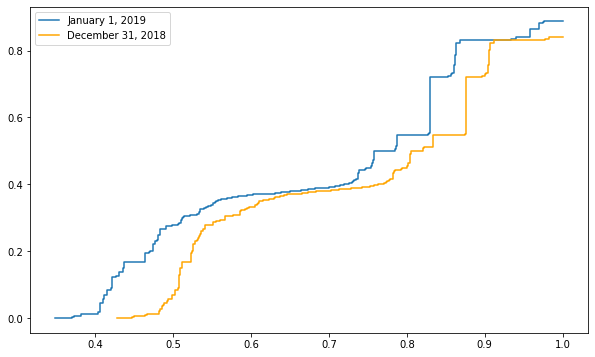

In [ ]:
h = 1
d = 1097

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()
pp = prices_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()

# Compute the prediction using Naive procedure
qq1 = energy_m_reduced_scaled.iloc[(h-1) + (d-1) * 24 - 24][2:].to_list()
pp1 = prices_m_reduced_scaled.iloc[(h-1) + (d-1) * 24 - 24][2:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
qq1 = [x for x in qq1 if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]
pp1 = [x for x in pp1 if not np.isnan(x)]

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'January 1')
plt.step(qq1, pp1, color = 'orange', label = 'December 31')
plt.legend(['January 1, 2019', 'December 31, 2018'])

In [ ]:
# Save the dataframe
naive_l1_distances.to_csv('naive_l1_distances_scaled.csv', index = False)

In [ ]:
naive_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\naive_l1_distances_scaled.csv')

# Error computation in test data using interpolation

In [ ]:
# Loading data
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled.csv')

In [ ]:
# Now 'minimum' = 1 because we are using the scaled dataframes
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]

1.0

In [ ]:
# Put the grid of quantities between 0 and the maximum value of the shortest curve
max_q = minimum
min_q = 0

In [ ]:
# Defining the scaled grid of quantities of energy
qq1 = np.linspace(0, 0, 1)
min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.concatenate([qq1, np.linspace(min_q, max_q, 49)])
qq1 = qq1.tolist()
print(qq1)

[0.0, 0.4113356430251556, 0.42359948379546486, 0.4358633245657741, 0.4481271653360833, 0.4603910061063926, 0.4726548468767019, 0.4849186876470111, 0.49718252841732036, 0.5094463691876296, 0.5217102099579389, 0.5339740507282482, 0.5462378914985574, 0.5585017322688667, 0.570765573039176, 0.5830294138094851, 0.5952932545797944, 0.6075570953501037, 0.619820936120413, 0.6320847768907223, 0.6443486176610315, 0.6566124584313408, 0.66887629920165, 0.6811401399719592, 0.6934039807422685, 0.7056678215125778, 0.7179316622828871, 0.7301955030531964, 0.7424593438235055, 0.7547231845938148, 0.7669870253641241, 0.7792508661344333, 0.7915147069047426, 0.8037785476750519, 0.8160423884453611, 0.8283062292156704, 0.8405700699859796, 0.8528339107562889, 0.8650977515265982, 0.8773615922969074, 0.8896254330672166, 0.9018892738375259, 0.9141531146078352, 0.9264169553781445, 0.9386807961484537, 0.950944636918763, 0.9632084776890723, 0.9754723184593814, 0.9877361592296907, 1.0]


In [ ]:
# Create an empty dataframe
interpolation_l1_distances = pd.DataFrame()

for d in range(1097, 1827):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()
    pp = prices_m_reduced_scaled.iloc[(h-1) + (d-1) * 24][2:].to_list()

    # Compute the prediction using the interpolated dataframe
    pp1 = grid_prices_scaled.iloc[(h-1) + (d-1) * 24].to_list()

    # Remove the NaN values of the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    interpolation_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
interpolation_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1097: 0.026875765013358387
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1097: 0.04375361640451104
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1097: 0.060498158706196285
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1097: 0.07057474114116598
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1097: 0.06153357164983786
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1097: 0.03179373130743448
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1097: 0.01086573376158886
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1097: 0.008526677975061781
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1097: 0.007628488155331285
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1097: 0.003800337680558734
--------------------

Distancia L1 (Manhattan) para la hora 1 del día 1102: 0.005155046730582551
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1102: 0.005787142738283745
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1102: 0.005591063194786005
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1102: 0.0060729070973221805
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1102: 0.005001638743982386
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1102: 0.005939306001159689
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1102: 0.003668190010567173
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1102: 0.0035289755576434945
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1102: 0.0023428243397810005
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1102: 0.0023693949005615467
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1106: 0.00323618606779717
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1106: 0.002992722955377826
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1106: 0.003296609964862896
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1106: 0.0038770779035753205
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1106: 0.003090546383101812
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1106: 0.0032314035243073257
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1106: 0.0026225733809852533
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1106: 0.0022310941835807668
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1106: 0.0019675212488813776
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1106: 0.001827821209308558
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1110: 0.00630755974116377
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1110: 0.005839648574577748
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1110: 0.00241276980398405
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1110: 0.0020905772281666285
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1110: 0.0017597841112806393
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1110: 0.0018186376589995551
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1110: 0.0017986594807281573
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1110: 0.0016379041317230035
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1110: 0.0018443061118892507
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1110: 0.001670688189296884
------

Distancia L1 (Manhattan) para la hora 24 del día 1113: 0.002192198409813979
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1114: 0.008421915793475938
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1114: 0.02375906692034479
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1114: 0.0218374614548753
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1114: 0.02191797489039976
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1114: 0.02232972652206571
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1114: 0.023295007691592963
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1114: 0.008229685838102383
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1114: 0.0044142250223610634
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1114: 0.0035871386922839204
------------------

Distancia L1 (Manhattan) para la hora 13 del día 1117: 0.0015936890362721447
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1117: 0.0018114421641755641
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1117: 0.0017996077393332534
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1117: 0.001806370987933264
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1117: 0.0019902040437710686
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1117: 0.0022849723710093627
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1117: 0.0024651294561836555
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1117: 0.002232462558283031
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1117: 0.0022056898421110084
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1117: 0.00230605167961642


Distancia L1 (Manhattan) para la hora 18 del día 1121: 0.0020356554682557223
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1121: 0.0021461162990672926
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1121: 0.002256378107434056
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1121: 0.0018541590082187536
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1121: 0.0017377133857199507
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1121: 0.0022169813031977324
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1121: 0.0024221220313378603
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1122: 0.0027343274359452672
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1122: 0.0036379869989654505
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1122: 0.0047770906363525075


Distancia L1 (Manhattan) para la hora 2 del día 1126: 0.003026316598501175
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1126: 0.0035412591787545257
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1126: 0.0034783264340706977
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1126: 0.00323978475910976
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1126: 0.003513318556300424
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1126: 0.0028461204719915844
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1126: 0.002272027838734233
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1126: 0.001750635525459668
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1126: 0.00200194925996557
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1126: 0.0019441092405738146
------------

Distancia L1 (Manhattan) para la hora 1 del día 1131: 0.006019130610162011
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1131: 0.0055091636111118825
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1131: 0.006496612366467341
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1131: 0.006143565567969001
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1131: 0.006307414701799842
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1131: 0.00458962968853264
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1131: 0.00593705983906917
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1131: 0.0021462977689776196
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1131: 0.0017939750426513206
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1131: 0.0015718981270306843
-------------

Distancia L1 (Manhattan) para la hora 6 del día 1136: 0.0055779654292864465
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1136: 0.00691754144321292
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1136: 0.0037800557068763713
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1136: 0.002073977089381271
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1136: 0.002570020008250566
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1136: 0.0020367430024062056
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1136: 0.0019431987179095538
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1136: 0.0016910206717026222
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1136: 0.0018607761932222704
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1136: 0.0015654182896053545
----

------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1139: 0.0025817252392091716
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1140: 0.00752261803527565
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1140: 0.010275446726221486
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1140: 0.016341728605343487
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1140: 0.019281915700355135
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1140: 0.023304926881877092
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1140: 0.016580821317422577
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1140: 0.008461435224457766
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1140: 0.002472334048602746
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1140: 0.00241951

Distancia L1 (Manhattan) para la hora 12 del día 1143: 0.0015098320236748915
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1143: 0.0014489831102620836
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1143: 0.001545582499743001
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1143: 0.0011538062146466853
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1143: 0.0014636111796235839
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1143: 0.0013604301921999035
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1143: 0.0017965784811589162
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1143: 0.002045492679768933
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1143: 0.0020410855677203887
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1143: 0.001531467169235027

Distancia L1 (Manhattan) para la hora 14 del día 1147: 0.0017778457094334327
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1147: 0.0018222828022712602
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1147: 0.0019049598587915898
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1147: 0.0020239860452707877
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1147: 0.002083109488311169
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1147: 0.002120295436355832
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1147: 0.0021241684613309978
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1147: 0.001955722170103928
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1147: 0.0020804496165977167
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1147: 0.0021999856499796736

Distancia L1 (Manhattan) para la hora 16 del día 1151: 0.002055336799831187
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1151: 0.001761464093677527
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1151: 0.0024942468816850235
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1151: 0.0023626689862425473
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1151: 0.0018741562050829988
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1151: 0.0022667390431970746
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1151: 0.0018849050438249923
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1151: 0.002264353846557057
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1151: 0.0019334037007612938
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1152: 0.0077055711749281115


Distancia L1 (Manhattan) para la hora 17 del día 1155: 0.0019960345378353442
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1155: 0.001650325923814889
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1155: 0.0018595438406207798
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1155: 0.0019895376499503127
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1155: 0.0017443167937913808
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1155: 0.001726596144583649
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1155: 0.0017929020084206208
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1155: 0.0020600613436418578
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1156: 0.005109679433748902
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1156: 0.005129322507225729
--

Distancia L1 (Manhattan) para la hora 20 del día 1159: 0.0019942812525198263
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1159: 0.001773949830014047
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1159: 0.002258854621435982
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1159: 0.0019201353904987467
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1159: 0.001776575982384926
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1160: 0.008073050514783683
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1160: 0.008110865542451065
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1160: 0.008602563666794134
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1160: 0.006697313869855676
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1160: 0.007063136162090547
---------

Distancia L1 (Manhattan) para la hora 24 del día 1163: 0.0019527814377557039
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1164: 0.01028107689244652
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1164: 0.016432235658718212
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1164: 0.023265823249149272
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1164: 0.028288426527442814
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1164: 0.028151875862415937
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1164: 0.025349916743790217
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1164: 0.007581704505528884
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1164: 0.006674687166760989
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1164: 0.002592632934413171
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1168: 0.0032408032479357947
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1168: 0.0018842259977196586
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1168: 0.0019329229741960549
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1168: 0.0016149870888215799
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1168: 0.0013234050486674001
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1168: 0.0013090190797672688
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1168: 0.001239189434175649
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1168: 0.0009943490703718434
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1168: 0.0015162276531172595
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1168: 0.0011943268028329625


Distancia L1 (Manhattan) para la hora 21 del día 1172: 0.0015994916953103364
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1172: 0.0019544034405564147
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1172: 0.002035871039085446
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1172: 0.0019269549317236638
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1173: 0.005513190110307345
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1173: 0.0055452069172776475
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1173: 0.004956306652632655
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1173: 0.005012729596067965
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1173: 0.0053964898957265415
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1173: 0.005828589774946456
-------

Distancia L1 (Manhattan) para la hora 12 del día 1177: 0.0017057114200802934
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1177: 0.0016683712145786553
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1177: 0.002018657766572532
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1177: 0.0015690023002512305
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1177: 0.0017546862849087469
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1177: 0.001907844137850984
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1177: 0.0018592967194115569
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1177: 0.0020408386473410754
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1177: 0.0016317430113712474
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1177: 0.001714098639614164

Distancia L1 (Manhattan) para la hora 14 del día 1181: 0.0011033353677885854
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1181: 0.0015846163039096956
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1181: 0.0015542909266413813
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1181: 0.0016472225794852725
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1181: 0.0012937733379221753
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1181: 0.0013990875607757312
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1181: 0.0020311617583482363
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1181: 0.0016859895007792064
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1181: 0.001565851580144884
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1181: 0.00166150731002573

Distancia L1 (Manhattan) para la hora 9 del día 1185: 0.0034297115166971722
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1185: 0.0018104330340235183
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1185: 0.0021412753944044217
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1185: 0.0017995938619861894
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1185: 0.002265410673813684
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1185: 0.0018377182882191449
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1185: 0.0017811030702241217
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1185: 0.0021986628837508777
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1185: 0.0022515601576303594
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1185: 0.002139266733770225

------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1189: 0.0015826603812109281
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1189: 0.0020520382287421268
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1189: 0.0021563497279179053
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1190: 0.006568227751488605
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1190: 0.005456748630270958
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1190: 0.005259162962832897
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1190: 0.006458044849195048
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1190: 0.007417387879824127
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1190: 0.008757565499841049
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1190: 0.005

------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1193: 0.0015664959228410763
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1193: 0.0016430517036646018
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1193: 0.002061116986001995
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1193: 0.0020142833094680115
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1193: 0.002241171085596365
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1193: 0.0017323646223704726
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1193: 0.0018536844471318786
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1193: 0.002260341827198391
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1194: 0.0055534049951984545
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 119

Distancia L1 (Manhattan) para la hora 4 del día 1197: 0.0062612007662976015
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1197: 0.005825372098146761
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1197: 0.006527588673653042
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1197: 0.0055919483124661235
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1197: 0.0024771917024804403
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1197: 0.0020044261153783546
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1197: 0.0018825158908356609
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1197: 0.0017169457249734837
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1197: 0.001978601798392372
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1197: 0.0018537778129589103
-----

Distancia L1 (Manhattan) para la hora 18 del día 1200: 0.0021162149339964825
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1200: 0.002136697757675867
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1200: 0.002161968105426967
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1200: 0.0019696577980048233
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1200: 0.002276155254961494
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1200: 0.0022122106086728127
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1200: 0.0022514768734650074
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1201: 0.0470459755632475
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1201: 0.04812482538642297
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1201: 0.038437273168637036
--------

Distancia L1 (Manhattan) para la hora 16 del día 1205: 0.0018758915763701818
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1205: 0.001802332740187821
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1205: 0.0019056414554368365
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1205: 0.001816936549295707
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1205: 0.002074012073952295
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1205: 0.00206253605017457
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1205: 0.0019707182201169193
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1205: 0.00204436642561103
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1205: 0.002018741231484812
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1206: 0.00473873469339469
-------

Distancia L1 (Manhattan) para la hora 19 del día 1210: 0.0015753139627065406
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1210: 0.0018341455842974309
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1210: 0.0017437111510196235
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1210: 0.0018000120099502085
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1210: 0.001823721768688317
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1210: 0.0019719643898165017
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1211: 0.00406083245499972
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1211: 0.004795879379375109
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1211: 0.004010962852738281
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1211: 0.0039529302575419725
-----

Distancia L1 (Manhattan) para la hora 11 del día 1215: 0.0019266156496668865
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1215: 0.001959407640022376
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1215: 0.002222301890110277
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1215: 0.002077527922925336
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1215: 0.0018824891202081217
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1215: 0.0018389219823919047
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1215: 0.0017697707000839124
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1215: 0.0020130884518114647
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1215: 0.002198754422025698
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1215: 0.00233577340232913
--

Distancia L1 (Manhattan) para la hora 1 del día 1219: 0.004058394138847442
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1219: 0.005825612371055903
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1219: 0.0052817580753821355
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1219: 0.006513305328838965
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1219: 0.005243657768821854
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1219: 0.007493407163615302
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1219: 0.006204485635420346
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1219: 0.003094182649691293
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1219: 0.002150625131467293
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1219: 0.001647827740265232
--------------

Distancia L1 (Manhattan) para la hora 22 del día 1222: 0.002109008453776187
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1222: 0.0020606225226706496
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1222: 0.002192062227049269
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1223: 0.025725425143110964
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1223: 0.028424513174953342
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1223: 0.025924340425077887
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1223: 0.027415952215050846
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1223: 0.021268304297087377
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1223: 0.009130030281648601
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1223: 0.006949603216000994
------------

Distancia L1 (Manhattan) para la hora 1 del día 1227: 0.01455161011961439
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1227: 0.019066953706596966
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1227: 0.023697356105189905
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1227: 0.02694361088114215
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1227: 0.028329146599982723
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1227: 0.022735011731744595
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1227: 0.009775818993386684
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1227: 0.008723010162591367
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1227: 0.004002128706313687
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1227: 0.0025444745436002227
----------------

Distancia L1 (Manhattan) para la hora 1 del día 1232: 0.00849368429122364
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1232: 0.009371014570522002
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1232: 0.023098870288996997
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1232: 0.022932528936264924
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1232: 0.02190192773678271
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1232: 0.016606093171398
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1232: 0.007271609481907134
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1232: 0.003622810402859777
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1232: 0.00251646136129818
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1232: 0.002114812880117622
---------------------

Distancia L1 (Manhattan) para la hora 15 del día 1235: 0.0018706994402706615
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1235: 0.0018932688064249084
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1235: 0.0021372605634269624
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1235: 0.002183119110313347
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1235: 0.0018466981969953227
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1235: 0.0020563867787877412
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1235: 0.001977362356494913
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1235: 0.002097427255372485
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1235: 0.001921564757245912
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1235: 0.002145583718218265
-

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1240: 0.006738047177086903
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1240: 0.007998898366786264
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1240: 0.007854113835947866
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1240: 0.007163179644016193
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1240: 0.00558768619961552
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1240: 0.005502168403961141
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1240: 0.0022718157824279943
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1240: 0.001775194172161404
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1240: 0.0018960180273671155
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1240: 0.001873

Distancia L1 (Manhattan) para la hora 20 del día 1244: 0.0015169064783096908
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1244: 0.0017012224497587863
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1244: 0.0018389712660528159
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1244: 0.0019436664909453327
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1244: 0.002136106032417157
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1245: 0.00545135962060669
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1245: 0.006068962235486723
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1245: 0.005053967026549418
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1245: 0.005996036917268204
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1245: 0.0065780371480587164
-------

Distancia L1 (Manhattan) para la hora 9 del día 1248: 0.0026783265365742702
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1248: 0.00206729861108797
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1248: 0.0016071218061512824
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1248: 0.0021399297536484232
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1248: 0.0019758188781906025
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1248: 0.0018348823890860398
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1248: 0.0016904186237863337
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1248: 0.002208469207623313
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1248: 0.0017275832436941228
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1248: 0.00206376396443496
--

Distancia L1 (Manhattan) para la hora 21 del día 1251: 0.0017221716406645435
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1251: 0.0018137741208053737
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1251: 0.0016260080119311013
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1251: 0.0019982696341976154
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1252: 0.005190091530498748
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1252: 0.005894528662281502
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1252: 0.005775810448475475
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1252: 0.004739329672098025
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1252: 0.0061974246564727815
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1252: 0.005063016121231003
-------

Distancia L1 (Manhattan) para la hora 8 del día 1256: 0.005332030241206304
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1256: 0.005067399916926504
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1256: 0.002329446858377193
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1256: 0.0018402869429856416
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1256: 0.0016568867358615564
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1256: 0.0017818962479696026
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1256: 0.0019062036185322033
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1256: 0.0020115251114286524
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1256: 0.001896716051899324
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1256: 0.0019973857214969737
--

Distancia L1 (Manhattan) para la hora 1 del día 1261: 0.010963390299654272
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1261: 0.022150337530980634
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1261: 0.021846506673539517
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1261: 0.027419122516073834
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1261: 0.02215802005842915
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1261: 0.015323644371249447
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1261: 0.008487689297376783
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1261: 0.005265993328790175
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1261: 0.0023472402481797745
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1261: 0.0016683105840276118
--------------

Distancia L1 (Manhattan) para la hora 12 del día 1265: 0.0015117508932545238
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1265: 0.0015233589827837173
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1265: 0.0013558880220341614
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1265: 0.0014901182379853167
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1265: 0.0014661883696614271
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1265: 0.0013992460959098704
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1265: 0.0014141073087185708
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1265: 0.0015825478361271017
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1265: 0.0018019472270848409
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1265: 0.0019115846753318

Distancia L1 (Manhattan) para la hora 3 del día 1269: 0.02337025514585849
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1269: 0.025928478605788542
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1269: 0.03925714404139675
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1269: 0.028133703124988727
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1269: 0.01003501716973667
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1269: 0.006909971501014199
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1269: 0.0041477923500177856
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1269: 0.0022218255818031536
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1269: 0.0018732824945419918
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1269: 0.0022599675404876007
------------

Distancia L1 (Manhattan) para la hora 20 del día 1273: 0.0016357191424242793
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1273: 0.0016278709905456585
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1273: 0.0016983715285481074
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1273: 0.0019044964638479443
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1273: 0.002050249276033883
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1274: 0.005920361715368747
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1274: 0.005860484557660993
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1274: 0.008088858299226197
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1274: 0.007310920451438193
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1274: 0.007533769839240183
-------

Distancia L1 (Manhattan) para la hora 11 del día 1277: 0.0025389633891822563
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1277: 0.0017499646932978125
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1277: 0.0019896645543729945
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1277: 0.0014856349109843938
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1277: 0.0017240538387018718
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1277: 0.002076668611889168
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1277: 0.0017012508671916176
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1277: 0.001629138468299121
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1277: 0.0017140807657518163
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1277: 0.001872565431333927

Distancia L1 (Manhattan) para la hora 2 del día 1281: 0.0074484297981427215
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1281: 0.008299262940077115
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1281: 0.009405540385774304
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1281: 0.010157245950689012
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1281: 0.010446561364184386
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1281: 0.00880392901346331
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1281: 0.005391367708686043
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1281: 0.004104250436438758
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1281: 0.0020670746656508217
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1281: 0.001734721361411673
-------------

Distancia L1 (Manhattan) para la hora 16 del día 1284: 0.0016160726146729216
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1284: 0.0020737926070222294
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1284: 0.0018440526645377322
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1284: 0.00182144508045084
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1284: 0.0019094765034752552
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1284: 0.002070302263448262
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1284: 0.0020001348821902043
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1284: 0.002005396284527071
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1284: 0.0021728679883473104
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1285: 0.00718109863284703
---

Distancia L1 (Manhattan) para la hora 18 del día 1289: 0.0018080309475877196
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1289: 0.0020169720002741233
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1289: 0.0024881713349596416
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1289: 0.002468249168151271
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1289: 0.0024881156046584955
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1289: 0.002259981176838762
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1289: 0.003183546900523187
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1290: 0.007255064932841967
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1290: 0.01009430505231065
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1290: 0.009316515396916206
------

Distancia L1 (Manhattan) para la hora 15 del día 1293: 0.0019757086828167646
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1293: 0.0016929678984661167
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1293: 0.0017514612778172065
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1293: 0.001303160308851106
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1293: 0.0018080770782189777
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1293: 0.001563476003257747
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1293: 0.001578486352360609
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1293: 0.0020402716442447784
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1293: 0.0019560272909923205
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1293: 0.001676209184380635


Distancia L1 (Manhattan) para la hora 7 del día 1297: 0.007736000381261995
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1297: 0.008297625292626128
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1297: 0.0023577750423993886
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1297: 0.0021836664320780616
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1297: 0.001879222240079504
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1297: 0.0019239729087451108
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1297: 0.0020950883701106437
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1297: 0.002016791976339177
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1297: 0.0017495387129671535
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1297: 0.002056230231869756
----

Distancia L1 (Manhattan) para la hora 14 del día 1302: 0.0012899583327091674
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1302: 0.0014168086116432847
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1302: 0.0014490967197444554
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1302: 0.0016437518770768902
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1302: 0.0015629506924515991
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1302: 0.0014267413579465982
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1302: 0.0015393766545694
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1302: 0.0021153097534079403
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1302: 0.002132454462588199
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1302: 0.0016269969185108062


Distancia L1 (Manhattan) para la hora 12 del día 1306: 0.0018880802049318763
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1306: 0.001723571967406138
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1306: 0.0014392872830083553
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1306: 0.0014198459431801617
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1306: 0.001501040453192092
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1306: 0.0013923473272838644
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1306: 0.0011684063686501292
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1306: 0.0014346318046051217
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1306: 0.001362504303303084
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1306: 0.001732856896655755


Distancia L1 (Manhattan) para la hora 14 del día 1310: 0.0016490979693885121
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1310: 0.001976112712437816
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1310: 0.0015445236842702283
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1310: 0.001570225394593684
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1310: 0.0015640212163083645
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1310: 0.0017055475830364273
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1310: 0.001901412760683905
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1310: 0.0016486820305535502
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1310: 0.0017129997184075576
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1310: 0.0018516440553712568

Distancia L1 (Manhattan) para la hora 16 del día 1314: 0.0017767861508899687
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1314: 0.0014903949615238657
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1314: 0.001621423165408635
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1314: 0.0018359867929493086
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1314: 0.0015434226342665312
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1314: 0.0016216966154195779
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1314: 0.0016248994107226312
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1314: 0.0017327362782093808
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1314: 0.0018983479556147944
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1315: 0.007043510600982187

Distancia L1 (Manhattan) para la hora 12 del día 1318: 0.0018136208474149832
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1318: 0.0018768945209608715
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1318: 0.002016422509546325
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1318: 0.002063516401399929
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1318: 0.0020622106253818614
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1318: 0.001832676573725232
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1318: 0.0017796299426386848
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1318: 0.001901926865180848
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1318: 0.0016810341230653419
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1318: 0.0019925445356722238


Distancia L1 (Manhattan) para la hora 3 del día 1322: 0.016015875723595856
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1322: 0.023161266416150492
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1322: 0.01541699003496109
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1322: 0.010008546441506368
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1322: 0.008047285784033185
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1322: 0.005810972774057335
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1322: 0.0023450794990516775
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1322: 0.0019938209704398503
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1322: 0.0014230265266947158
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1322: 0.0014610363995447052
----------

Distancia L1 (Manhattan) para la hora 17 del día 1325: 0.0016936385699640422
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1325: 0.001468489800144305
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1325: 0.0015089567868265313
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1325: 0.001335177718311147
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1325: 0.0017534385085698516
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1325: 0.0017959809920816707
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1325: 0.0017769513937432389
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1325: 0.0018472734943670703
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1326: 0.004786049156742864
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1326: 0.005889850269185044
--

Distancia L1 (Manhattan) para la hora 14 del día 1329: 0.0015221463315967794
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1329: 0.001629964401403578
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1329: 0.0016132113708046654
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1329: 0.0014814242306747578
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1329: 0.0014885504391784106
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1329: 0.0012638687394897418
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1329: 0.0016973681019656194
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1329: 0.001256157352782573
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1329: 0.001248130622944391
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1329: 0.0018446956215075147

Distancia L1 (Manhattan) para la hora 16 del día 1333: 0.0015061966005710224
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1333: 0.0015934781246964252
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1333: 0.0017153562967848332
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1333: 0.0017858479179390977
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1333: 0.0019373255474885499
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1333: 0.0017869377214676165
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1333: 0.0017732243921985654
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1333: 0.0017050295422731667
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1333: 0.0020126649818547346
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1334: 0.01078234183090655

Distancia L1 (Manhattan) para la hora 17 del día 1338: 0.0011745492335626954
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1338: 0.0012609686551161166
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1338: 0.0018482642284989846
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1338: 0.0015227041768490026
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1338: 0.0018617887575658534
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1338: 0.0016175216025026817
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1338: 0.0014240770679750468
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1338: 0.0017889138074897574
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1339: 0.007464511695334903
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1339: 0.0093466123502403
--

Distancia L1 (Manhattan) para la hora 4 del día 1343: 0.008497857797916146
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1343: 0.009877576397964688
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1343: 0.008332315627743978
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1343: 0.007457550810016496
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1343: 0.004332846471815911
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1343: 0.002880562701833676
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1343: 0.002031844760802881
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1343: 0.0016103795686018079
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1343: 0.001201305260768858
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1343: 0.0014796985393894357
----------

Distancia L1 (Manhattan) para la hora 24 del día 1346: 0.0017550796705443615
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1347: 0.0048477744718175425
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1347: 0.006229534528025225
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1347: 0.006952452912149153
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1347: 0.006254109682945919
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1347: 0.006125713796910407
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1347: 0.005959464625108839
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1347: 0.005484604602916295
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1347: 0.005249137895018098
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1347: 0.003156926292928074
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1350: 0.0012810468065187215
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1350: 0.0015278649031499692
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1350: 0.0014068331086512695
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1350: 0.0015541566718438502
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1350: 0.0014191772197324093
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1350: 0.001571860210342905
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1350: 0.001917405569726239
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1351: 0.004943746408398008
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1351: 0.005493788876212992
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1351: 0.00512734551746897
-----

Distancia L1 (Manhattan) para la hora 9 del día 1354: 0.0060726667440810286
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1354: 0.002825325518459802
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1354: 0.002419386928738605
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1354: 0.0019412143175289724
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1354: 0.0018159415977355897
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1354: 0.0017443972060889549
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1354: 0.0017162625618549064
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1354: 0.001884251583450705
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1354: 0.0019503435031802503
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1354: 0.001957413840801816
-

Distancia L1 (Manhattan) para la hora 11 del día 1359: 0.0019679757068938398
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1359: 0.0017317707281486834
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1359: 0.001670900064856186
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1359: 0.0014302746389561836
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1359: 0.001597332331908637
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1359: 0.0017583879618012534
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1359: 0.0016807785067507494
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1359: 0.001599439519698665
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1359: 0.0018238959886387382
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1359: 0.002305574869234515


Distancia L1 (Manhattan) para la hora 23 del día 1362: 0.0018482629431875374
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1362: 0.0019141742766583844
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1363: 0.008720059489162392
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1363: 0.008216289398354698
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1363: 0.006930896030006533
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1363: 0.00543996196066143
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1363: 0.005240942347554153
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1363: 0.005922472116437403
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1363: 0.007057235578386236
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1363: 0.0021638209421308697
------------

Distancia L1 (Manhattan) para la hora 20 del día 1366: 0.0022302114557766033
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1366: 0.0017719364498768554
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1366: 0.002321879968793165
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1366: 0.002291947936994482
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1366: 0.003111861747189809
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1367: 0.022003640356289923
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1367: 0.026473023374789764
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1367: 0.037166913887487586
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1367: 0.046857841714717595
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1367: 0.046402365936408674
---------

Distancia L1 (Manhattan) para la hora 21 del día 1371: 0.002022741944119316
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1371: 0.0016296224282259582
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1371: 0.0018545571133573371
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1371: 0.002245696225385392
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1372: 0.021719363705088705
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1372: 0.02598926425777841
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1372: 0.034155209412452744
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1372: 0.025975831025990468
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1372: 0.025053354182016947
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1372: 0.027058399034277425
-----------

Distancia L1 (Manhattan) para la hora 11 del día 1375: 0.0022248899852124458
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1375: 0.0021303596459208802
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1375: 0.002165028150827129
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1375: 0.001985154316163593
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1375: 0.0017919047473164951
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1375: 0.002065706049952658
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1375: 0.0022183505615516255
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1375: 0.0018651294627708708
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1375: 0.0020105302602834883
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1375: 0.002104358217033712


Distancia L1 (Manhattan) para la hora 6 del día 1380: 0.017765687585329072
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1380: 0.008482397067648112
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1380: 0.00446715864645499
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1380: 0.0031700259863947783
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1380: 0.002133098584371481
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1380: 0.0019703708646975995
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1380: 0.0015798926839166265
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1380: 0.001754235261087801
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1380: 0.0014057670231356026
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1380: 0.0014717957216082162
------

Distancia L1 (Manhattan) para la hora 24 del día 1384: 0.0023633726741783398
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1385: 0.008600395748038104
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1385: 0.008695737460265368
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1385: 0.00925820049510975
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1385: 0.007301150819191053
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1385: 0.007775015407831716
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1385: 0.007911229843416532
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1385: 0.004995000672667805
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1385: 0.002070897061404662
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1385: 0.0019171187846089989
--------------

Distancia L1 (Manhattan) para la hora 9 del día 1389: 0.0037535702176474395
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1389: 0.003974815356013104
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1389: 0.0025297418619365034
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1389: 0.002070720973736035
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1389: 0.002098700336280548
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1389: 0.0021788092601921646
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1389: 0.002109067417438952
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1389: 0.0021445572966106155
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1389: 0.002164837402574776
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1389: 0.0021043476734632248
--

Distancia L1 (Manhattan) para la hora 15 del día 1393: 0.001609758903752481
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1393: 0.0013143043808639184
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1393: 0.0016957929728668596
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1393: 0.001668168235784546
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1393: 0.001802759323008227
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1393: 0.002023533234063607
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1393: 0.0017269854132060242
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1393: 0.001950411062363335
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1393: 0.0025001483088749367
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1393: 0.003398359617406246
--

Distancia L1 (Manhattan) para la hora 18 del día 1397: 0.0041647358677901584
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1397: 0.004036806770723827
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1397: 0.00423670824806659
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1397: 0.0031411311607701213
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1397: 0.0031271244591626513
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1397: 0.004277547171749612
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1397: 0.004327056947054099
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1398: 0.02271141311228089
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1398: 0.027777606824660662
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1398: 0.027728406026178924
--------

Distancia L1 (Manhattan) para la hora 1 del día 1404: 0.0021072128736807907
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1404: 0.002229113418221628
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1404: 0.002415947917290672
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1404: 0.0021945396648688194
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1404: 0.0024449591238505167
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1404: 0.002161476252884512
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1404: 0.001992385478380316
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1404: 0.001434367512438257
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1404: 0.0009815123235115634
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1404: 0.0005919356882976843
----------

Distancia L1 (Manhattan) para la hora 1 del día 1409: 0.004814975311834129
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1409: 0.00669785765701387
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1409: 0.0065298955667096
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1409: 0.005859550839141662
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1409: 0.006109828371623097
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1409: 0.006389692749446991
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1409: 0.005304465150608484
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1409: 0.002849605071830006
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1409: 0.0021810172244330485
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1409: 0.0017596933763254774
----------------

Distancia L1 (Manhattan) para la hora 20 del día 1413: 0.0014752764454292967
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1413: 0.0013568273035421048
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1413: 0.0014950168611654706
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1413: 0.0015892835509458952
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1413: 0.0016906883383608832
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1414: 0.002530336218067107
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1414: 0.003192754369674975
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1414: 0.0027555692561187653
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1414: 0.0025256687902839837
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1414: 0.0025900062398015187
---

Distancia L1 (Manhattan) para la hora 7 del día 1418: 0.003332218534513774
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1418: 0.001970116694358396
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1418: 0.0016719895269738509
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1418: 0.001403342463832427
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1418: 0.001064561236700728
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1418: 0.0012929980340390308
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1418: 0.0012545075551217701
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1418: 0.0013420226444371985
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1418: 0.0014866762140886627
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1418: 0.0014241904967104884
---

Distancia L1 (Manhattan) para la hora 23 del día 1421: 0.001972791527900448
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1421: 0.002232224374004988
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1422: 0.005133683870219879
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1422: 0.005123719392790137
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1422: 0.005033713229303992
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1422: 0.004143075056167031
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1422: 0.004312552267591855
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1422: 0.004191307031060499
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1422: 0.003555635527901777
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1422: 0.0017535638264362147
-------------

Distancia L1 (Manhattan) para la hora 12 del día 1426: 0.0011123503213847528
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1426: 0.0012743340666420922
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1426: 0.0014292920183527945
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1426: 0.001276649394555017
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1426: 0.0013298874968816058
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1426: 0.0012598562783052623
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1426: 0.0013216443125620714
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1426: 0.001343478360069079
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1426: 0.0012163718824136371
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1426: 0.001216393471629395

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1431: 0.004369885070952657
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1431: 0.005168126702551726
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1431: 0.00572851970314014
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1431: 0.006087950844439706
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1431: 0.0045936188534470785
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1431: 0.006201676306084857
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1431: 0.00371864394754649
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1431: 0.0025643082046654846
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1431: 0.0022116956807732304
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1431: 0.002012

Distancia L1 (Manhattan) para la hora 3 del día 1436: 0.00709220450476091
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1436: 0.005699085649196307
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1436: 0.006850344175719499
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1436: 0.008640676565390028
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1436: 0.006544301538269174
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1436: 0.007563029432237731
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1436: 0.0027986623750888757
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1436: 0.002014280939675022
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1436: 0.002105128660832921
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1436: 0.001640893203831538
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1439: 0.0018245440667713337
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1440: 0.005504050802828392
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1440: 0.006196811582994174
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1440: 0.005554529040227341
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1440: 0.0048802929719960805
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1440: 0.007170547671819355
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1440: 0.0058343103146328
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1440: 0.0066441714228171345
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1440: 0.0023560974097124997
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1440: 0.0019798368220317235
------------

Distancia L1 (Manhattan) para la hora 5 del día 1444: 0.0023347581669477
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1444: 0.0023888709839648675
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1444: 0.0023107385276522423
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1444: 0.0017249291759651956
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1444: 0.0013984875010755763
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1444: 0.0013266885775958964
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1444: 0.0010322886527519115
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1444: 0.0010698471603701012
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1444: 0.0011268822133004204
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1444: 0.0010795535111113256
----

Distancia L1 (Manhattan) para la hora 10 del día 1448: 0.001385637720353891
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1448: 0.0010398533733728618
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1448: 0.0011683721472327763
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1448: 0.0009627072128510423
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1448: 0.0008115989496794824
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1448: 0.0009113870763694698
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1448: 0.0009783053308633173
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1448: 0.0010369002096529446
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1448: 0.0010660860579060321
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1448: 0.00114296244360431

Distancia L1 (Manhattan) para la hora 17 del día 1452: 3.824060633822183e-05
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1452: 9.224718433086622e-05
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1452: 4.9008925581875246e-05
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1452: 7.109170093740931e-05
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1452: 7.95093261202688e-05
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1452: 6.573333791804069e-05
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1452: 0.00012159982182755769
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1452: 0.00017193388343121377
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1453: 0.001856052814225112
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1453: 0.00166769357428272

Distancia L1 (Manhattan) para la hora 11 del día 1458: 0.0010259551801679362
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1458: 0.0007079588048233397
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1458: 0.000657824327988254
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1458: 0.0009498948467423313
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1458: 0.0008910914663359454
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1458: 0.0007388737584702864
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1458: 0.0011085228446340934
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1458: 0.000977256094977437
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1458: 0.0012162399773260925
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1458: 0.001129032157779139

Distancia L1 (Manhattan) para la hora 21 del día 1461: 0.002198823005441335
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1461: 0.0020770282580992168
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1461: 0.0019831762017593207
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1461: 0.003022139175625305
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1462: 0.0060475830677350125
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1462: 0.006202362682482089
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1462: 0.0062468039726651225
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1462: 0.00611472908343438
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1462: 0.005949026610824819
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1462: 0.005743620847447168
---------

Distancia L1 (Manhattan) para la hora 3 del día 1466: 0.005373325249624101
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1466: 0.006694891861092397
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1466: 0.003500694347738195
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1466: 0.006692377370153746
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1466: 0.005390764516039266
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1466: 0.004118765097147838
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1466: 0.005162558291525262
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1466: 0.001780656183499412
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1466: 0.0016084232040772253
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1466: 0.0015635932879275332
-----------

Distancia L1 (Manhattan) para la hora 21 del día 1469: 0.0017405038772094835
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1469: 0.0016545183486853343
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1469: 0.0016622747012102485
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1469: 0.0016316791273755997
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1470: 0.005303758088730112
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1470: 0.0054304464786705114
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1470: 0.005506508780229286
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1470: 0.005511621026188967
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1470: 0.005839368517262626
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1470: 0.006458510834844629
-------

Distancia L1 (Manhattan) para la hora 18 del día 1473: 0.0020070988402062988
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1473: 0.0017950179523948972
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1473: 0.0016556648464985805
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1473: 0.0016610420473638847
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1473: 0.001755848929447081
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1473: 0.0021070143733937508
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1473: 0.0019102185499246236
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1474: 0.007698449766259426
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1474: 0.018864125334087038
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1474: 0.017417855255216667
---

Distancia L1 (Manhattan) para la hora 20 del día 1477: 0.0011918648289168036
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1477: 0.0012731590509810504
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1477: 0.0012239213399611055
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1477: 0.0013716269619821549
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1477: 0.0016315523434508655
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1478: 0.0035240075276450483
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1478: 0.003143645169717035
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1478: 0.0031763367451155024
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1478: 0.0031491645782444535
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1478: 0.0035911726623522027
--

Distancia L1 (Manhattan) para la hora 15 del día 1482: 0.0006864134101517866
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1482: 0.0007269287968432914
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1482: 0.0007779047711011739
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1482: 0.0009568238603533852
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1482: 0.0008222924798631421
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1482: 0.0009507280498896852
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1482: 0.0008997587431849452
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1482: 0.0010374873158236386
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1482: 0.0009656106711672191
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1482: 0.0011226180720676

Distancia L1 (Manhattan) para la hora 9 del día 1486: 0.0027687393605533347
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1486: 0.0018857858436619715
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1486: 0.0019171825882726876
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1486: 0.0019348389719079247
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1486: 0.002056553086039557
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1486: 0.0018548483970646508
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1486: 0.0016815500751974834
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1486: 0.0018639196232027413
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1486: 0.002196315583715634
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1486: 0.0019064958059741351

Distancia L1 (Manhattan) para la hora 21 del día 1489: 0.0016135961810029458
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1489: 0.001491267989243163
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1489: 0.0015998581898204517
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1489: 0.0018168857995764288
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1490: 0.004233162756598262
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1490: 0.0052608371211622824
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1490: 0.005059741529233681
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1490: 0.0033534486061372795
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1490: 0.00493277167616874
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1490: 0.003965772728054758
--------

Distancia L1 (Manhattan) para la hora 24 del día 1493: 0.0017302100788867153
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1494: 0.005338516083446045
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1494: 0.005714368102749679
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1494: 0.004486317579258114
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1494: 0.004589804551138805
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1494: 0.004904640867785991
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1494: 0.005246279121357823
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1494: 0.004127628102831104
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1494: 0.00601990864533198
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1494: 0.0020070881158888946
--------------

Distancia L1 (Manhattan) para la hora 22 del día 1497: 0.0014035302598850428
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1497: 0.0015356157127692548
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1497: 0.0015811891615096774
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1498: 0.006000993841372412
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1498: 0.005487684711224867
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1498: 0.006030416608675061
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1498: 0.005854718750911999
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1498: 0.005314027024309506
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1498: 0.004535870693657986
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1498: 0.0040534468545791475
---------

Distancia L1 (Manhattan) para la hora 16 del día 1501: 0.001206156709002205
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1501: 0.0013488772505651021
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1501: 0.0012902740574170235
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1501: 0.0015365483267240493
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1501: 0.001376169413309772
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1501: 0.0011805191035873098
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1501: 0.0011726182941052214
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1501: 0.0012052741820279664
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1501: 0.0013619553949820438
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1502: 0.0054151018682587005

Distancia L1 (Manhattan) para la hora 19 del día 1505: 0.0017001045902912755
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1505: 0.0018281159472903954
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1505: 0.001869016124097195
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1505: 0.0018917562760103423
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1505: 0.001670771031636421
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1505: 0.0017831774624891808
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1506: 0.0065462829262010296
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1506: 0.007171794905917482
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1506: 0.00730612613931537
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1506: 0.008466561086685653
------

Distancia L1 (Manhattan) para la hora 16 del día 1509: 0.001114118548445872
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1509: 0.0012604349496195641
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1509: 0.0012037682388345832
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1509: 0.0014926751442018425
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1509: 0.0012141873951896894
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1509: 0.0012643236393280245
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1509: 0.001305624070153497
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1509: 0.0014538201991565781
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1509: 0.0015542718678825437
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1510: 0.006111173691051243


Distancia L1 (Manhattan) para la hora 2 del día 1514: 0.009469315812777448
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1514: 0.008145119895908586
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1514: 0.009253604422195073
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1514: 0.009344072896143297
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1514: 0.009782034337815219
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1514: 0.008129115619478168
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1514: 0.008581206550166988
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1514: 0.004081408383427241
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1514: 0.0016724195640687718
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1514: 0.0017971694834299362
------------

Distancia L1 (Manhattan) para la hora 1 del día 1519: 0.0051096292865193535
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1519: 0.004673245644984106
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1519: 0.005401848178413899
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1519: 0.005080387145641409
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1519: 0.005906513348065494
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1519: 0.00492015985881217
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1519: 0.003092142498926591
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1519: 0.0018400114244265747
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1519: 0.0012793406760670208
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1519: 0.0011425490151432901
------------

Distancia L1 (Manhattan) para la hora 13 del día 1522: 7.270561029257969e-05
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1522: 5.981052234228336e-05
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1522: 8.415146941721349e-05
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1522: 9.885641646980447e-05
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1522: 0.00011173600035073804
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1522: 0.00022583183252335482
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1522: 0.0006568572114542216
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1522: 0.0005086782734917845
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1522: 0.0005861049532375166
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1522: 0.00041117352267

Distancia L1 (Manhattan) para la hora 10 del día 1527: 0.0007761947646321363
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1527: 0.00019049976549814166
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1527: 7.575551378207736e-05
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1527: 4.8059301333359586e-05
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1527: 7.12911652080289e-05
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1527: 5.731830344107082e-05
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1527: 5.466889496614225e-05
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1527: 0.0001235091720692656
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1527: 0.00020640702099708876
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1527: 0.00072124422579

Distancia L1 (Manhattan) para la hora 19 del día 1530: 0.0011567227871562473
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1530: 0.0012756799885599683
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1530: 0.0011459488245920088
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1530: 0.001120286095354864
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1530: 0.0014330058454551041
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1530: 0.0016699745401973591
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1531: 0.004540255212341274
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1531: 0.005275328425352348
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1531: 0.006315978511077135
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1531: 0.0059721256056283565
----

Distancia L1 (Manhattan) para la hora 6 del día 1535: 0.004988687684735071
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1535: 0.0044966430283753
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1535: 0.0028505421040429316
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1535: 0.0016521956302315661
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1535: 0.0012639592535319977
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1535: 0.0013886160882280094
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1535: 0.0011203913703958077
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1535: 0.0011576615264234247
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1535: 0.0013812925643338218
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1535: 0.0011346996181192033
----

Distancia L1 (Manhattan) para la hora 16 del día 1539: 0.0009458791321132493
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1539: 0.0007939483499457708
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1539: 0.0009365867119078434
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1539: 0.0011578555080373892
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1539: 0.001007195416901994
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1539: 0.0010137556465419097
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1539: 0.0011908984755364459
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1539: 0.0010823471154645368
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1539: 0.0013545230413574342
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1540: 0.003950416690420851

Distancia L1 (Manhattan) para la hora 11 del día 1543: 0.0012669825470578836
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1543: 0.0011226804297559817
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1543: 0.001430375174411156
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1543: 0.001387365801515189
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1543: 0.0007966345906269333
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1543: 0.0012200812711748348
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1543: 0.001236616702561894
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1543: 0.0011623542587757137
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1543: 0.0014906653790031099
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1543: 0.001365548201978145


Distancia L1 (Manhattan) para la hora 9 del día 1550: 0.0010115711392349816
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1550: 0.0009030170277932482
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1550: 0.0005996864577509963
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1550: 0.0003943133493173458
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1550: 0.00027524601278876174
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1550: 0.00037290423782545
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1550: 0.00048464756846804883
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1550: 0.00038444458742463916
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1550: 0.0004176160258197038
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1550: 0.0004484629382917

Distancia L1 (Manhattan) para la hora 20 del día 1554: 0.0009595902924192269
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1554: 0.0011779220715539536
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1554: 0.000993619294630213
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1554: 0.0011313391311676452
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1554: 0.001252988437486018
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1555: 0.004879650898677927
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1555: 0.004759342614027542
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1555: 0.005174997113993844
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1555: 0.0045698469177676004
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1555: 0.004430666364933431
-------

Distancia L1 (Manhattan) para la hora 5 del día 1559: 0.005050862035414515
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1559: 0.0056337326028034675
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1559: 0.005266816410109899
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1559: 0.0031688273531358595
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1559: 0.0014449215863296028
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1559: 0.00111384929578012
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1559: 0.001062743866559645
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1559: 0.0008466447336622381
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1559: 0.0008887033978281502
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1559: 0.0008337539836380838
------

Distancia L1 (Manhattan) para la hora 21 del día 1562: 0.0012154822058944555
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1562: 0.001132361897670853
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1562: 0.0010212268607548776
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1562: 0.001706361225350146
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1563: 0.006818103845054858
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1563: 0.005487145141494821
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1563: 0.007063633457123659
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1563: 0.006694826571287356
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1563: 0.00760499242103258
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1563: 0.006880997488154453
-----------

Distancia L1 (Manhattan) para la hora 15 del día 1566: 0.0008045713888296092
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1566: 0.000913709533744347
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1566: 0.0009558343111179624
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1566: 0.0008941499251797793
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1566: 0.001035412682562678
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1566: 0.00087805427113848
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1566: 0.0010248104094919468
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1566: 0.0009315899632316861
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1566: 0.0009054737399656551
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1566: 0.0010069057398339892


Distancia L1 (Manhattan) para la hora 20 del día 1570: 0.0015436559182946665
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1570: 0.0019792210172663157
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1570: 0.0014537997948373173
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1570: 0.0014791451324783164
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1570: 0.0025437998555040307
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1571: 0.009029587047779081
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1571: 0.008584085708063582
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1571: 0.009457495205033199
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1571: 0.00866626687536015
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1571: 0.020090558112372148
-------

Distancia L1 (Manhattan) para la hora 5 del día 1574: 0.00613608268553801
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1574: 0.003988049705937178
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1574: 0.006206894911567052
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1574: 0.0036694192302220065
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1574: 0.001544737387381749
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1574: 0.00122917103391399
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1574: 0.0010045137752258645
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1574: 0.0008708055162212868
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1574: 0.0008130352450586829
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1574: 0.0010000961798558024
--------

Distancia L1 (Manhattan) para la hora 16 del día 1577: 0.0013774095982779142
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1577: 0.001240285824925337
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1577: 0.0013371451083980079
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1577: 0.001540977148486309
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1577: 0.0016049910208463586
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1577: 0.0015372804722586602
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1577: 0.0012519019275681023
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1577: 0.001316409962014626
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1577: 0.0016691736104171928
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1578: 0.009730793448817724
-

Distancia L1 (Manhattan) para la hora 1 del día 1581: 0.005254286671939203
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1581: 0.005098728600279365
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1581: 0.004866134744218493
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1581: 0.005798433034556975
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1581: 0.00423883732631732
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1581: 0.00611293300126417
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1581: 0.0030049612893432495
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1581: 0.0022031792874386545
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1581: 0.0013010576598171337
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1581: 0.0008283653555506707
-------------

Distancia L1 (Manhattan) para la hora 8 del día 1585: 0.008605713342584934
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1585: 0.0031437954105757076
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1585: 0.0015487037581009596
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1585: 0.0012218522094397922
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1585: 0.000957605410046851
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1585: 0.0009745847558758909
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1585: 0.000890520306060431
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1585: 0.0008890410531626184
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1585: 0.0009143431922891133
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1585: 0.0010032197477577642
-

Distancia L1 (Manhattan) para la hora 8 del día 1590: 0.002862613026191997
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1590: 0.0021818164471589423
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1590: 0.0013283966962637397
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1590: 0.0010421422720690984
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1590: 0.0008896763585126791
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1590: 0.0008254739068633472
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1590: 0.0008271717028736109
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1590: 0.0008149264402761609
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1590: 0.000858107803910504
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1590: 0.0008318302941405165


Distancia L1 (Manhattan) para la hora 8 del día 1595: 0.0035841553639109425
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1595: 0.0022539713014952797
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1595: 0.0013999621549683561
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1595: 0.001033446698285212
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1595: 0.0010032609982221106
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1595: 0.0008728820573664307
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1595: 0.0010354305765080164
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1595: 0.0011161689214532068
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1595: 0.001105727493060629
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1595: 0.0011307050709630563


Distancia L1 (Manhattan) para la hora 1 del día 1600: 0.023049394815441812
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1600: 0.03964304516785596
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1600: 0.05471970190186061
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1600: 0.052777932912192085
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1600: 0.04986355264188099
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1600: 0.04847529479405362
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1600: 0.02230652088657782
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1600: 0.0072407427676054814
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1600: 0.00309797996178889
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1600: 0.0013670948734780988
-------------------

Distancia L1 (Manhattan) para la hora 22 del día 1604: 0.0011525404037815022
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1604: 0.0013310169241521556
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1604: 0.0011872074627123708
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1605: 0.010435516301319177
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1605: 0.013096652680903653
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1605: 0.010078064941312168
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1605: 0.01018544289236236
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1605: 0.010086109042937937
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1605: 0.007202498305332964
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1605: 0.008122218116080649
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1610: 0.009908423451017709
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1610: 0.010570489929363098
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1610: 0.010731287432567207
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1610: 0.009060135808160757
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1610: 0.007747397920709299
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1610: 0.0036732570095472363
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1610: 0.001418543521021655
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1610: 0.001301641934286035
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1610: 0.0012645466408645618
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1610: 0.0010493978351203755
----------

Distancia L1 (Manhattan) para la hora 22 del día 1614: 0.0019078403622485914
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1614: 0.0025499568789255182
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1614: 0.0038733763873467176
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1615: 0.018813690475949576
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1615: 0.022447160649484387
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1615: 0.039096903620291196
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1615: 0.040113954765224454
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1615: 0.021889372111636093
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1615: 0.024247702529079745
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1615: 0.014314929535466855
----------

Distancia L1 (Manhattan) para la hora 9 del día 1619: 0.004623183989075831
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1619: 0.002310311382508078
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1619: 0.0013058370904433163
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1619: 0.0015006022021536807
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1619: 0.0012213409366446403
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1619: 0.0013960579411075424
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1619: 0.0013888863249603318
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1619: 0.0012869091923733457
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1619: 0.0011459479811063724
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1619: 0.0012744641843433924

Distancia L1 (Manhattan) para la hora 23 del día 1622: 0.001232138235644887
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1622: 0.001165970562871765
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1623: 0.008716478410633263
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1623: 0.01031698126447775
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1623: 0.011479546916820984
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1623: 0.008956841552665526
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1623: 0.010698315960517546
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1623: 0.009276324310369908
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1623: 0.007830479930668285
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1623: 0.007358918941473602
---------------

Distancia L1 (Manhattan) para la hora 3 del día 1627: 0.054432182249207525
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1627: 0.05919638179412504
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1627: 0.06248683132145785
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1627: 0.06348650117957212
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1627: 0.0549193539283672
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1627: 0.024226068126590308
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1627: 0.0065051066082624336
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1627: 0.003599939691419499
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1627: 0.001764465516825775
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1627: 0.0015928305687216053
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1630: 0.0014232438849106788
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1630: 0.001106055307729312
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1630: 0.001194720610211393
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1630: 0.0013728022387220777
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1630: 0.001284752379511561
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1630: 0.0012920426861379663
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1630: 0.0011536584038299485
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1630: 0.001327930931527106
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1630: 0.0014538896260578606
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1630: 0.0019622634614829522


Distancia L1 (Manhattan) para la hora 9 del día 1634: 0.003153106507963128
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1634: 0.0015084342876391821
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1634: 0.0013762509100888874
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1634: 0.0011567608645079522
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1634: 0.0012934698035900914
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1634: 0.0013592750185343633
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1634: 0.001461990442051332
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1634: 0.0012931672533245987
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1634: 0.0013560954793353573
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1634: 0.0013651548765915107

Distancia L1 (Manhattan) para la hora 9 del día 1638: 0.001492375666634029
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1638: 0.0012177829334726316
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1638: 0.0010507475928896153
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1638: 0.0009075431315658619
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1638: 0.000971518123254555
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1638: 0.0010690171905843673
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1638: 0.001070027324885978
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1638: 0.0009347622725537858
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1638: 0.0007671760956825532
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1638: 0.0007677495655020807


Distancia L1 (Manhattan) para la hora 15 del día 1643: 0.0010344536393911933
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1643: 0.0009119044744770009
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1643: 0.0008385968162681237
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1643: 0.0008617877911722945
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1643: 0.0010491327597168388
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1643: 0.0009242051058817512
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1643: 0.0013063145233979487
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1643: 0.0012500633297051042
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1643: 0.001214381457135625
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1643: 0.00124527566505244

Distancia L1 (Manhattan) para la hora 1 del día 1648: 0.005799009998816976
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1648: 0.00612508955728861
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1648: 0.0062869814429432885
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1648: 0.005484323300455692
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1648: 0.005108811587441397
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1648: 0.006064379337014418
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1648: 0.0046874048166623316
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1648: 0.0055748323018806134
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1648: 0.0032326978128543113
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1648: 0.0018679339521054188
-----------

Distancia L1 (Manhattan) para la hora 14 del día 1651: 0.0011909108868251362
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1651: 0.00114780995557136
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1651: 0.0010189200480303009
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1651: 0.0011712689982447842
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1651: 0.0011886707697150076
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1651: 0.0011443977749999372
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1651: 0.001203593315979458
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1651: 0.0014746270619022655
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1651: 0.0011715843614587963
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1651: 0.0015273681905235803

Distancia L1 (Manhattan) para la hora 9 del día 1655: 0.003816523928974255
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1655: 0.0017981538512535874
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1655: 0.0017335476913110587
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1655: 0.0014405307013381126
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1655: 0.0014998786722223863
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1655: 0.0012499602838762153
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1655: 0.0012580224401112347
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1655: 0.0011916930590913305
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1655: 0.0013234685310032288
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1655: 0.001610308715808134


Distancia L1 (Manhattan) para la hora 6 del día 1659: 0.006543806833941926
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1659: 0.0030838471992443582
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1659: 0.0015964706309964853
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1659: 0.0014468588720123587
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1659: 0.0009945653842722462
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1659: 0.0010674554568408635
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1659: 0.0011264608922237642
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1659: 0.0007522427849347094
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1659: 0.000789483278384029
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1659: 0.001061168215303095
--

Distancia L1 (Manhattan) para la hora 7 del día 1663: 0.007269816934343455
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1663: 0.00610140239191579
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1663: 0.002220750539273319
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1663: 0.0013783748872597192
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1663: 0.0011634872005697615
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1663: 0.0010924552666147667
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1663: 0.0009703686933245689
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1663: 0.0009877793013110038
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1663: 0.0011265069425230468
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1663: 0.0008502510364285707
---

Distancia L1 (Manhattan) para la hora 22 del día 1666: 0.001628895966177915
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1666: 0.0017816179378747302
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1666: 0.001825162924151428
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1667: 0.004274706673611501
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1667: 0.007789277324093917
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1667: 0.005753014064186415
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1667: 0.007318838050301115
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1667: 0.005916661544700589
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1667: 0.006448004799468697
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1667: 0.00576273007484651
-------------

Distancia L1 (Manhattan) para la hora 13 del día 1670: 0.0011372430285655007
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1670: 0.0012036148650292316
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1670: 0.0011830471907111628
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1670: 0.0009798421616974747
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1670: 0.0009400997492620966
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1670: 0.0008737889650922357
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1670: 0.0011954475944172076
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1670: 0.0013667219323277406
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1670: 0.0013158385808262037
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1670: 0.0013203140553774

Distancia L1 (Manhattan) para la hora 7 del día 1674: 0.006974710851355689
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1674: 0.005200300036356992
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1674: 0.004093350272356545
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1674: 0.0018839249737615015
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1674: 0.0014631365382047508
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1674: 0.0014874807788902678
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1674: 0.001416976907111243
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1674: 0.0013666596348884017
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1674: 0.0014117523369806052
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1674: 0.001333124834929875
----

Distancia L1 (Manhattan) para la hora 20 del día 1677: 0.0010769058900226358
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1677: 0.0012471305703044635
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1677: 0.0012801476106616154
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1677: 0.0013423131047418612
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1677: 0.0014612943053203126
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1678: 0.004452896489196871
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1678: 0.004806905262983481
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1678: 0.006010139434827647
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1678: 0.00523394736131637
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1678: 0.004172598921248424
-------


Distancia L1 (Manhattan) para la hora 21 del día 1681: 0.001731578292925052
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1681: 0.0017621633834381898
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1681: 0.0020091928736369483
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1681: 0.0020515105883089787
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1682: 0.006394069516095517
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1682: 0.0075300267713024095
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1682: 0.008864912583333467
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1682: 0.008047947277604012
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1682: 0.012288781154511676
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1682: 0.015892255372086207
-------

Distancia L1 (Manhattan) para la hora 10 del día 1685: 0.0017473490844974082
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1685: 0.0014067694455685176
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1685: 0.001423551194845137
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1685: 0.0012682136946798933
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1685: 0.0012689214594629374
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1685: 0.0013400235232239102
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1685: 0.0013127476879512502
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1685: 0.001110683734343126
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1685: 0.001231684480537116
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1685: 0.0012557985500581616

Distancia L1 (Manhattan) para la hora 10 del día 1689: 0.002149754493623972
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1689: 0.001532048009512402
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1689: 0.001478624641590115
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1689: 0.0014268877027049588
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1689: 0.0013642831743496428
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1689: 0.0011529624880118356
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1689: 0.0013016895912246417
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1689: 0.001135593471900592
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1689: 0.00114975798565451
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1689: 0.0015508172117842957
--

Distancia L1 (Manhattan) para la hora 24 del día 1692: 0.00433558806122138
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1693: 0.006723998160616548
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1693: 0.007474574559339538
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1693: 0.008335154258163953
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1693: 0.007405608241382368
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1693: 0.009686261684758429
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1693: 0.00726067170238202
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1693: 0.006556354445974953
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1693: 0.005462161137035128
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1693: 0.002283916206491454
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1696: 0.0014062379492010206
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1696: 0.0014746471248106778
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1696: 0.0014237660426871723
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1696: 0.0013835456349734023
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1696: 0.001449682038528909
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1696: 0.0014185957970482821
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1696: 0.001386556356546669
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1696: 0.001461116791759299
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1696: 0.001795451142519474
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1696: 0.0017465786005322163


Distancia L1 (Manhattan) para la hora 6 del día 1700: 0.007690580346492941
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1700: 0.008250674150675407
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1700: 0.007043240283917917
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1700: 0.007289669754582499
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1700: 0.0022480692115666497
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1700: 0.0014631454952189187
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1700: 0.0016141911396232772
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1700: 0.0014460050034668511
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1700: 0.0013069353890771882
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1700: 0.0013783660708264994
----

Distancia L1 (Manhattan) para la hora 9 del día 1704: 0.006554210365729705
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1704: 0.0031337974949653034
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1704: 0.0016947897471142853
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1704: 0.0016851626438571367
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1704: 0.0016387684032580503
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1704: 0.0015074575111862863
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1704: 0.0017106863787107723
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1704: 0.0015107264397800364
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1704: 0.0016244658189382328
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1704: 0.001791049111467748

Distancia L1 (Manhattan) para la hora 7 del día 1709: 0.007784956046750648
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1709: 0.00512519221913069
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1709: 0.0024076743474051423
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1709: 0.0017738325252612567
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1709: 0.0015697010678541188
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1709: 0.001620331213000032
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1709: 0.0011050282233829548
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1709: 0.0014478211686284486
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1709: 0.00102750145000806
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1709: 0.0014326263170835586
-----

Distancia L1 (Manhattan) para la hora 16 del día 1712: 0.0009582655178912927
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1712: 0.0010018852932279808
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1712: 0.001240622134699381
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1712: 0.0012343941179032716
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1712: 0.0015061629213944314
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1712: 0.0015611042220559754
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1712: 0.0014461275699633918
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1712: 0.0015193280854131274
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1712: 0.0016323985603766467
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1713: 0.005251679176667301

Distancia L1 (Manhattan) para la hora 4 del día 1716: 0.010650974987620713
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1716: 0.011588462180697118
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1716: 0.01308324977443269
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1716: 0.011239248341606101
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1716: 0.007207440388106528
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1716: 0.005661170507816754
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1716: 0.002476069003012011
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1716: 0.0018043195706103662
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1716: 0.0017060490151657854
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1716: 0.0016403734760970035
----------

Distancia L1 (Manhattan) para la hora 20 del día 1720: 0.002780981088544296
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1720: 0.00405789216447729
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1720: 0.0038733474879220882
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1720: 0.004762018773046979
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1720: 0.006711680077092262
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1721: 0.02214150848563588
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1721: 0.02640781840029255
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1721: 0.025766448930729848
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1721: 0.026746269121634744
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1721: 0.02571068051206736
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1724: 0.0019028373075131453
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1724: 0.0019452280439419137
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1724: 0.0017534715450907123
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1724: 0.0019128788835468752
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1724: 0.002150225801266231
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1724: 0.0031701133474074015
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1724: 0.0020336754258842736
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1724: 0.002586618259234748
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1724: 0.005523907238005951
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1725: 0.014385190362883908
-

------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1728: 0.005994488900207796
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1728: 0.005665239181294209
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1728: 0.005146613300085466
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1728: 0.004998255081258756
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1728: 0.004411125292969959
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1728: 0.005800895831875797
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1728: 0.003506644255269328
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1728: 0.0021155813156177026
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1728: 0.0017481015540193228
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1728: 0.001613

------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1732: 0.0014493643055219117
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1732: 0.0013587195029091525
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1732: 0.0014806735485390866
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1732: 0.0015064208271700387
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1732: 0.0015666771919214829
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1733: 0.009504450102503307
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1733: 0.007901095283132605
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1733: 0.011305049017794278
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1733: 0.010842694754680648
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1733: 0

Distancia L1 (Manhattan) para la hora 1 del día 1738: 0.00197304415184932
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1738: 0.0028319107112580377
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1738: 0.0027084397370384233
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1738: 0.0033741983930214168
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1738: 0.0040098743947701776
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1738: 0.003060992935774074
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1738: 0.002680969920151783
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1738: 0.0019781964633768865
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1738: 0.001610493820739906
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1738: 0.0012755727253028857
----------

Distancia L1 (Manhattan) para la hora 23 del día 1741: 0.0022887216847574787
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1741: 0.003654899488516125
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1742: 0.007720248688614459
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1742: 0.008615305340773111
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1742: 0.010616267240549284
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1742: 0.009510633655556416
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1742: 0.010411933206007865
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1742: 0.008921000542472184
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1742: 0.007514819207223946
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1742: 0.0047097435899092835
------------

------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1746: 0.005420366544123183
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1746: 0.006147798078490287
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1746: 0.0026691471836104994
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1746: 0.001760661376511128
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1746: 0.0016788966501242758
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1746: 0.0012748729937164063
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1746: 0.001226602640226386
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1746: 0.0009571947128726491
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1746: 0.0011639165146769977
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1746:

Distancia L1 (Manhattan) para la hora 6 del día 1751: 0.008572728756341918
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1751: 0.005707820625809356
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1751: 0.005136763617034575
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1751: 0.002638738301263897
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1751: 0.001699721045321458
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1751: 0.0014694006039704362
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1751: 0.0013567966970632023
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1751: 0.0013576829795568326
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1751: 0.001300264823482506
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1751: 0.0014894341108831503
------

Distancia L1 (Manhattan) para la hora 9 del día 1755: 0.0016656440849270031
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1755: 0.001707171192476439
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1755: 0.0014580576902597404
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1755: 0.0013387490967554302
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1755: 0.001198248087236468
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1755: 0.0011292558019714075
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1755: 0.0011374708701029767
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1755: 0.0014290337109173663
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1755: 0.0013658995539127538
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1755: 0.0014212053207022833

Distancia L1 (Manhattan) para la hora 5 del día 1760: 0.003727666131019597
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1760: 0.003395106735122647
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1760: 0.003411049899010215
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1760: 0.0028887405963481678
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1760: 0.0018731635831498975
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1760: 0.0017389306961608769
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1760: 0.0015083273055439762
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1760: 0.0011834511400002582
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1760: 0.0011673229916788668
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1760: 0.0010777268626282208
----

Distancia L1 (Manhattan) para la hora 18 del día 1763: 0.0017882822978250734
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1763: 0.001969758112546888
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1763: 0.0018764057812820758
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1763: 0.0016341874126699302
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1763: 0.0018751428824506497
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1763: 0.0021433702713207162
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1763: 0.005189170484347002
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1764: 0.008730195093761885
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1764: 0.01779061023624999
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1764: 0.023809219491955115
-----

Distancia L1 (Manhattan) para la hora 3 del día 1768: 0.008925486379847017
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1768: 0.00851104587662807
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1768: 0.009038172506521072
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1768: 0.009620644988854437
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1768: 0.015966892062417158
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1768: 0.006451008010003178
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1768: 0.00424559402786209
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1768: 0.0022504813997471147
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1768: 0.00167323909069898
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1768: 0.0017320539585764462
--------------

Distancia L1 (Manhattan) para la hora 15 del día 1771: 0.001058302693757677
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1771: 0.0012423514409231568
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1771: 0.001117791546826652
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1771: 0.0013185353851608494
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1771: 0.0014901739682864601
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1771: 0.0013571463419435382
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1771: 0.001496664891523039
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1771: 0.0011656197732609237
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1771: 0.0016805402622237318
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1771: 0.0018257958396255128

Distancia L1 (Manhattan) para la hora 23 del día 1775: 0.007821226993624012
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1775: 0.008121621430323047
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1776: 0.02616474373309293
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1776: 0.05816937334138999
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1776: 0.05984031238733244
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1776: 0.06101830258039322
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1776: 0.061072756025027625
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1776: 0.03614088538431803
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1776: 0.023663085524675345
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1776: 0.009597996716626964
-------------------

Distancia L1 (Manhattan) para la hora 8 del día 1779: 0.007037134170879592
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1779: 0.004855199716063194
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1779: 0.002214110519908566
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1779: 0.0019517249318269363
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1779: 0.0014902824766890171
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1779: 0.0021313949442107235
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1779: 0.001554460366839859
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1779: 0.0017444401033585902
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1779: 0.0018589295019137487
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1779: 0.0022495037195596123
--

Distancia L1 (Manhattan) para la hora 19 del día 1783: 0.0016215401086675657
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1783: 0.0017986415867828121
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1783: 0.0017823829391832755
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1783: 0.0017739528625457441
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1783: 0.0019497263729374111
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1783: 0.002178624938497064
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1784: 0.004612588604471175
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1784: 0.0061818977527480145
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1784: 0.006617748974098209
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1784: 0.006987796787973321
----

Distancia L1 (Manhattan) para la hora 12 del día 1787: 0.0017262276819403682
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1787: 0.0015989583312246377
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1787: 0.001513494880145011
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1787: 0.0019365782995444084
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1787: 0.0016295864194223746
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1787: 0.0019272914423276197
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1787: 0.004042830603746369
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1787: 0.0024838930151349636
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1787: 0.001985485484691833
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1787: 0.0023419681014425066

Distancia L1 (Manhattan) para la hora 8 del día 1792: 0.002254638840046536
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1792: 0.001999015134921505
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1792: 0.0015040353895341158
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1792: 0.0016718323173171424
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1792: 0.0014043603903347093
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1792: 0.0015156761942563097
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1792: 0.0014392874838382687
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1792: 0.0015698017438900208
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1792: 0.0015385940404773948
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1792: 0.001714172565105527
-

Distancia L1 (Manhattan) para la hora 19 del día 1795: 0.0044914309699482825
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1795: 0.002207025762699174
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1795: 0.002112044560250598
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1795: 0.002458715651634062
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1795: 0.0024810132748316364
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1795: 0.002205420448864337
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1796: 0.015443860816380132
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1796: 0.017203961234775376
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1796: 0.02261939644052537
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1796: 0.017242672686847038
---------

Distancia L1 (Manhattan) para la hora 7 del día 1799: 0.004111742135302986
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1799: 0.0022927822848723494
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1799: 0.0020417264963080335
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1799: 0.0017932645867474238
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1799: 0.0016337092165616207
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1799: 0.0012969574560432176
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1799: 0.0016754009243086128
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1799: 0.001582364759577463
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1799: 0.001273280010838272
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1799: 0.0012853691482605572
--

Distancia L1 (Manhattan) para la hora 11 del día 1803: 0.0002889657686150621
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1803: 0.00018672331962863752
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1803: 5.1292261289499975e-05
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1803: 6.282054101085436e-05
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1803: 0.00010192059896619016
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1803: 7.164167365699462e-05
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1803: 0.0002458628491451375
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1803: 0.0002908558592680167
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1803: 0.0003297852720453961
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1803: 0.0002855106305

Distancia L1 (Manhattan) para la hora 19 del día 1808: 0.0016026985272946533
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1808: 0.0016239899524569286
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1808: 0.0016405457078312801
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1808: 0.0013842159650604715
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1808: 0.0016318885126439643
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1808: 0.0019348117192885847
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1809: 0.005618846808413292
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1809: 0.0051819604896032045
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1809: 0.00525043172165628
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1809: 0.005344650714332127
----

Distancia L1 (Manhattan) para la hora 11 del día 1812: 0.0017895580497709908
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1812: 0.0016219685592061767
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1812: 0.00172608216058466
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1812: 0.0015542989196719635
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1812: 0.0014109661280331406
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1812: 0.0016093269587733768
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1812: 0.00145188351596358
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1812: 0.0019163074719222733
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1812: 0.0017340811758947056
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1812: 0.0017143457005744122


Distancia L1 (Manhattan) para la hora 11 del día 1816: 0.0026815631918008405
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1816: 0.0022668274284422473
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1816: 0.0019539263490126325
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1816: 0.0018237185754926793
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1816: 0.0018825264344061558
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1816: 0.002026189390423647
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1816: 0.0020329006039929397
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1816: 0.0021309832629699413
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1816: 0.0019622272116834693
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1816: 0.00175657362419187

Distancia L1 (Manhattan) para la hora 1 del día 1820: 0.006583899915490163
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1820: 0.005273059629730469
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1820: 0.006716288601461626
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1820: 0.006167878117694099
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1820: 0.005901397125673485
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1820: 0.004958951221106631
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1820: 0.005251914489077596
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1820: 0.005986653822356601
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1820: 0.00404328956034892
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1820: 0.0027232713274347896
---------------

Distancia L1 (Manhattan) para la hora 13 del día 1823: 0.0014992583889499014
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1823: 0.001218112113784726
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1823: 0.0011774762291448034
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1823: 0.0009493871085536701
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1823: 0.0012291470347392734
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1823: 0.0013813171860812801
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1823: 0.0016136023866472914
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1823: 0.0015313777597572918
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1823: 0.0015611183203159368
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1823: 0.00142379012219387

In [ ]:
interpolation_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0268757650,0.0437536164,0.0604981587,0.0705747411,0.0615335716,0.0317937313,0.0108657338,0.0085266780,0.0076284882,0.0038003377,...,0.0022711093,0.0021432927,0.0025623210,0.0027183934,0.0028281583,0.0022471399,0.0020499997,0.0022653637,0.0024840780,0.0025650395
1,0.0075974853,0.0058541891,0.0044099477,0.0054821010,0.0039121810,0.0060616321,0.0047743249,0.0028789452,0.0022144218,0.0020590970,...,0.0017996444,0.0017282721,0.0019187931,0.0018575838,0.0024779801,0.0019361960,0.0018425830,0.0019478036,0.0018022695,0.0021919266
2,0.0050067650,0.0044700582,0.0051881067,0.0057251591,0.0048386493,0.0047280249,0.0054201368,0.0022064903,0.0022715608,0.0020435538,...,0.0020071791,0.0022641806,0.0020723910,0.0022675199,0.0020385543,0.0020510739,0.0020525372,0.0021894843,0.0016927348,0.0021650495
3,0.0048384707,0.0058886192,0.0054531306,0.0046767619,0.0055365808,0.0039832448,0.0049723052,0.0028250052,0.0024725560,0.0019690673,...,0.0020487945,0.0022407811,0.0020799452,0.0022436617,0.0024901248,0.0021205409,0.0020229343,0.0019225683,0.0024727639,0.0026062783
4,0.0077601973,0.0082210952,0.0086969818,0.0074026037,0.0069074602,0.0057783518,0.0052689432,0.0035267351,0.0025387440,0.0025416911,...,0.0021648079,0.0022414089,0.0020192451,0.0019741757,0.0021069118,0.0019410153,0.0018720836,0.0019283076,0.0018599441,0.0021550881
5,0.0051550467,0.0057871427,0.0055910632,0.0060729071,0.0050016387,0.0059393060,0.0036681900,0.0035289756,0.0023428243,0.0023693949,...,0.0019831011,0.0021965073,0.0025530595,0.0023392284,0.0023091804,0.0020957306,0.0018687946,0.0020532562,0.0023510404,0.0022044245
6,0.0064867887,0.0056474677,0.0052197425,0.0040020259,0.0053567818,0.0058406105,0.0056085804,0.0028368640,0.0022150113,0.0018772852,...,0.0018702827,0.0017791014,0.0017499732,0.0019916755,0.0021668223,0.0019176529,0.0020316452,0.0019457534,0.0016855096,0.0018619848
7,0.0033081801,0.0047011121,0.0052142255,0.0039406104,0.0057811768,0.0051280771,0.0034322807,0.0023119989,0.0021343255,0.0021928078,...,0.0020944481,0.0017825801,0.0020967808,0.0022530761,0.0019813789,0.0020568435,0.0017335337,0.0019919343,0.0020500354,0.0021415804
8,0.0027995651,0.0031383447,0.0034078943,0.0036525480,0.0037235676,0.0030090554,0.0030080509,0.0025142764,0.0021052755,0.0018970482,...,0.0015664081,0.0014110641,0.0013271562,0.0020422916,0.0017093511,0.0016598475,0.0018743784,0.0016112902,0.0017727997,0.0022707223
9,0.0032361861,0.0029927230,0.0032966100,0.0038770779,0.0030905464,0.0032314035,0.0026225734,0.0022310942,0.0019675212,0.0018278212,...,0.0014060441,0.0014484611,0.0014070492,0.0016372660,0.0017736708,0.0016380580,0.0014054546,0.0016514845,0.0018069493,0.0018899083


In [ ]:
# Mean error for each hour
interpolation_l1_distances.mean()

1    0.0081092955
2    0.0096599343
3    0.0108752051
4    0.0113450444
5    0.0112205997
6    0.0101662507
7    0.0070896873
8    0.0042559715
9    0.0027046797
10   0.0018486194
11   0.0015571680
12   0.0014378354
13   0.0013819993
14   0.0013521067
15   0.0013628456
16   0.0013885348
17   0.0014467095
18   0.0015483056
19   0.0016153600
20   0.0016600919
21   0.0016753388
22   0.0017049558
23   0.0017975064
24   0.0021279546
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(interpolation_l1_distances.mean()) / 24, 4)

0.0041

In [ ]:
# Saving the dataframe
interpolation_l1_distances.to_csv('interpolation_l1_distances_scaled.csv', index = False)

In [ ]:
interpolation_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\interpolation_l1_distances_scaled.csv')

## Analysis comparison Naive vs Interpolation

In [ ]:
difference = naive_l1_distances.iloc[:, :25] - interpolation_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,729.0000000000,729.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,0.5382166263,0.5349133724,0.5563282375,0.5723242469,0.5701480194,0.5767215030,0.6334371669,0.6430325882,0.6175221898,0.5507804740,...,0.3824177459,0.3827258849,0.4028308465,0.4559015774,0.5405803517,0.5965190677,0.5835189404,0.5445962337,0.5443450847,0.5641968960
std,0.5065016332,0.5026195577,0.4635709458,0.4226357438,0.4430673641,0.4353673278,0.3328630771,0.3740919652,0.4455808777,0.5613545142,...,0.7961696695,0.8363091592,1.0673718045,0.9530167856,0.5713728216,0.4633187164,0.4255382334,0.6024712796,0.5703294043,0.4064874202
min,-5.6851951737,-3.7984579897,-3.6968361173,-2.7586104873,-3.2696949430,-2.5830629319,-1.4047300028,-1.8062669946,-2.7460131131,-3.8403138531,...,-8.3896742936,-9.0972212768,-20.7783065386,-13.5677257775,-4.8728626520,-5.3181719117,-2.1948225635,-7.2270929167,-5.9853656474,-2.1016623016
25%,0.4249062331,0.4036779523,0.4206030296,0.4687495451,0.4726527850,0.4723259252,0.5479242707,0.5774220005,0.5551379934,0.4773511822,...,0.2843293113,0.2804167487,0.3119317340,0.4086993507,0.4541981905,0.5028632394,0.4960701686,0.4886287619,0.4837407914,0.4567087697
50%,0.6801939426,0.6931264697,0.7085809439,0.7096668263,0.7147518948,0.7123817538,0.7320439213,0.7639763600,0.7614333467,0.7372669853,...,0.6226076323,0.6353168493,0.6440641806,0.6969904976,0.7150182774,0.7360663624,0.7192730674,0.7175860135,0.7072737751,0.6945209011
75%,0.8264186795,0.8397751850,0.8394503151,0.8456359734,0.8454580583,0.8413486579,0.8500522708,0.8587251897,0.8598315575,0.8487625431,...,0.7974998983,0.8080076922,0.8217205034,0.8349250310,0.8427763167,0.8569506178,0.8448435975,0.8428864734,0.8319281059,0.8284443730
max,0.9943525784,0.9941331021,0.9913948978,0.9915607759,0.9933342325,0.9931853531,0.9974690713,0.9986922694,0.9980454040,0.9998520954,...,1.0000000000,1.0000000000,1.0000000000,0.9999325000,0.9996386006,0.9994739364,0.9986689918,0.9973301063,0.9967220640,0.9975773926


# Adding new variables

## Data Loading using 12 Weeks and four days before

### Same hour 12 weeks

In [ ]:
# Take the first principal component of each supply curve
from sklearn.decomposition import PCA
pca = PCA(n_components = 1)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 0:50])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PC{i+1}' for i in range(1)])

In [ ]:
# Iterate through the rows of the dataframe from the day 84 (row 2016)
i = 0
for indice in range(2016, len(grid_prices_scaled)):
    # Obtain the indices of the previous rows every 24 hours (one day)
    indices_semanales = list(range(indice - 24, i-1, -24))

    # Obtain the values of the first principal component for this indices
    valores_semanales = grid_prices_scaled_pca_df.iloc[indices_semanales]['PC1'].tolist()

    # Add the values to the dataframe
    for j in range(len(valores_semanales)):
        grid_prices_scaled.loc[indice, f'PCSemana_{j+1}'] = valores_semanales[j]

    i += 1

In [ ]:
grid_prices_scaled

,0,1,2,3,4,5,6,7,8,9,...,PCSemana_75,PCSemana_76,PCSemana_77,PCSemana_78,PCSemana_79,PCSemana_80,PCSemana_81,PCSemana_82,PCSemana_83,PCSemana_84
0,0.0000000000,0.0277315585,0.0277315585,0.0352190793,0.0499168053,0.1434276206,0.1486966167,0.1508042152,0.1886855241,0.2218524681,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,0.0000000000,0.0277315585,0.0288408209,0.0443704936,0.1109262341,0.1412090960,0.1482529118,0.1506932890,0.1797004992,0.2168607876,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2,0.0000000000,0.0138657793,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1435385469,0.1488075430,0.1552967277,0.1842484748,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,0.0000000000,0.0127565169,0.0127565169,0.0149750416,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1439267887,0.1491957848,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
4,0.0000000000,0.0127565169,0.0127565169,0.0127565169,0.0221852468,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1434276206,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,0.0277315585,0.0296727676,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
6,0.0000000000,0.0000000000,0.0005546312,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0055463117,0.0062673322,0.0062673322,0.0062673322,0.0127565169,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,0.0055463117,0.0062673322,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
# Save the dataframe
grid_prices_scaled.to_csv('grid_prices_scaled_w12.csv', index = False)

In [ ]:
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled_w12.csv')

### All hours in the previous four days

In [ ]:
# Iterate through the rows of the dataframe from the day 5 (row 120)
for indice in range(96, len(grid_prices_scaled), 24):
    # Obtain the indices of the previous rows every 24 hours (one day)
    indices_semanales = list(range(indice - 24 * 4, indice))

    # Obtain the values of the first principal component for this indices
    valores_semanales = grid_prices_scaled_pca_df.iloc[indices_semanales]['PC1'].tolist()

    # Add the values to the dataframe
    for i in range(0, 24):
        for j in range(len(valores_semanales)):
            grid_prices_scaled.loc[indice + i, f'PCDía_{j//24 + 1}_{j}'] = valores_semanales[j]

In [ ]:
# Save the dataframe
grid_prices_scaled.to_csv('grid_prices_scaled_w12_d4_2.csv', index = False)

In [ ]:
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled_w12_d4_2.csv')

## Exogenous variables

In [ ]:
!pip install openmeteo-requests

In [ ]:
!pip install requests-cache retry-requests numpy pandas

In [ ]:
# Obtain the wind speed
import openmeteo_requests

import requests_cache
import pandas as pd
from retry_requests import retry

# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after = -1)
retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
openmeteo = openmeteo_requests.Client(session = retry_session)

# Empty dataframe to store all data
final_dataframe = pd.DataFrame()

# Make sure all required weather variables are listed here
# The order of variables in hourly or daily is important to assign them correctly below
url = "https://archive-api.open-meteo.com/v1/archive"
# Coordinates of the 52 capitals of province in Spain
params = {
	"latitude": [36.8381, 36.5267, 37.8916, 37.1882, 37.2664, 37.7692, 36.7202, 37.3828, 42.1362, 40.3456, 41.6561, 43.3603, 43.4647, 43.3713, 43.0099, 42.3367, 42.431, 39.5694, 28.0997, 28.4682, 35.8892, 35.2937, 38.9942, 38.9863, 40.0667, 40.6286, 39.8581, 38.8779, 39.4765, 40.6572, 42.3411, 42.6, 42.0095, 40.9688, 40.9481, 41.764, 41.6552, 41.5063, 41.3888, 41.9831, 41.6167, 41.1167, 42.4667, 42.8169, 43.2627, 43.5667, 42.85, 40.4165, 37.987, 38.3452, 39.9857, 39.4697],
	"longitude": [-2.4597, -6.2891, -4.7728, -3.6067, -6.94, -3.7903, -4.4203, -5.9732, -0.4087, -1.1065, -0.8773, -5.8448, -3.8044, -8.396, -7.556, -7.8641, -8.6443, 2.6502, -15.4134, -16.2546, -5.3204, -2.9383, -1.8564, -3.9291, -2.1333, -3.1618, -4.0226, -6.9706, -6.3722, -4.6995, -3.7018, -5.5703, -4.5241, -5.6639, -4.1184, -2.4688, -4.7237, -5.7446, 2.159, 2.8249, 0.6222, 1.25, -2.45, -1.6432, -2.9253, -5.9, -2.6727, -3.7026, -1.13, -0.4815, -0.0493, -0.3774],
	"start_date": "2016-01-01",
	"end_date": "2020-12-31",
	"hourly": "wind_speed_10m",
	"timezone": "Europe/Berlin"
}
responses = openmeteo.weather_api(url, params=params)

# Process first location. Add a for-loop for multiple locations or weather models
for i in range(len(responses)):
  response = responses[i]
  print(f"Coordinates {response.Latitude()}°E {response.Longitude()}°N")
  print(f"Elevation {response.Elevation()} m asl")
  print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
  print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

  # Process hourly data. The order of variables needs to be the same as requested.
  hourly = response.Hourly()
  hourly_wind_speed_10m = hourly.Variables(0).ValuesAsNumpy()

  hourly_data = {"date": pd.date_range(
    start = pd.to_datetime(hourly.Time(), unit = "s"),
    end = pd.to_datetime(hourly.TimeEnd(), unit = "s"),
    freq = pd.Timedelta(seconds = hourly.Interval()),
    inclusive = "left"
  )}
  hourly_data["wind_speed_10m"] = hourly_wind_speed_10m

  hourly_dataframe = pd.DataFrame(data = hourly_data)
  final_dataframe = pd.concat([final_dataframe, hourly_dataframe], ignore_index=True, axis = 1)

In [6]:
final_dataframe

,0,1,2,3,4,5,6,7,8,9,...,94,95,96,97,98,99,100,101,102,103
0,2015-12-31 23:00:00,2.8116898537,2015-12-31 23:00:00,7.5942072868,2015-12-31 23:00:00,4.2136917114,2015-12-31 23:00:00,3.5999999046,2015-12-31 23:00:00,3.2599384785,...,2015-12-31 23:00:00,0.5091168880,2015-12-31 23:00:00,5.6233797073,2015-12-31 23:00:00,5.8048253059,2015-12-31 23:00:00,4.1046314240,2015-12-31 23:00:00,4.5820517540
1,2016-01-01 00:00:00,3.8939952850,2016-01-01 00:00:00,8.7591781616,2016-01-01 00:00:00,4.1046314240,2016-01-01 00:00:00,3.5999999046,2016-01-01 00:00:00,3.5999999046,...,2016-01-01 00:00:00,1.1384198666,2016-01-01 00:00:00,6.6963868141,2016-01-01 00:00:00,6.2974281311,2016-01-01 00:00:00,4.3498964310,2016-01-01 00:00:00,4.1046314240
2,2016-01-01 01:00:00,4.3943600655,2016-01-01 01:00:00,8.9059076309,2016-01-01 01:00:00,4.3795890808,2016-01-01 01:00:00,3.5999999046,2016-01-01 01:00:00,4.5820517540,...,2016-01-01 01:00:00,4.3498964310,2016-01-01 01:00:00,6.4096174240,2016-01-01 01:00:00,6.1516828537,2016-01-01 01:00:00,3.6712939739,2016-01-01 01:00:00,2.7416782379
3,2016-01-01 02:00:00,4.1046314240,2016-01-01 02:00:00,8.3112449646,2016-01-01 02:00:00,4.8029990196,2016-01-01 02:00:00,3.5999999046,2016-01-01 02:00:00,5.3999996185,...,2016-01-01 02:00:00,5.2416787148,2016-01-01 02:00:00,6.1305785179,2016-01-01 02:00:00,4.8299069405,2016-01-01 02:00:00,6.1516828537,2016-01-01 02:00:00,3.9600000381
4,2016-01-01 03:00:00,3.8939952850,2016-01-01 03:00:00,9.0215740204,2016-01-01 03:00:00,3.7064266205,2016-01-01 03:00:00,3.5999999046,2016-01-01 03:00:00,5.3999996185,...,2016-01-01 03:00:00,6.9527544975,2016-01-01 03:00:00,6.1305785179,2016-01-01 03:00:00,4.5820517540,2016-01-01 03:00:00,6.9247384071,2016-01-01 03:00:00,4.2136917114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43843,2020-12-31 18:00:00,7.4215898514,2020-12-31 18:00:00,8.6400003433,2020-12-31 18:00:00,10.4647970200,2020-12-31 18:00:00,4.3795890808,2020-12-31 18:00:00,7.0728778839,...,2020-12-31 18:00:00,21.1758365631,2020-12-31 18:00:00,10.6306724548,2020-12-31 18:00:00,18.8751258850,2020-12-31 18:00:00,7.2805495262,2020-12-31 18:00:00,18.8888511658
43844,2020-12-31 19:00:00,3.5455887318,2020-12-31 19:00:00,11.2121353149,2020-12-31 19:00:00,10.9726200104,2020-12-31 19:00:00,3.0968370438,2020-12-31 19:00:00,8.4042844772,...,2020-12-31 19:00:00,17.6105880737,2020-12-31 19:00:00,8.3965702057,2020-12-31 19:00:00,20.1246109009,2020-12-31 19:00:00,10.0864267349,2020-12-31 19:00:00,18.4480228424
43845,2020-12-31 20:00:00,8.1219701767,2020-12-31 20:00:00,12.5999994278,2020-12-31 20:00:00,12.6820182800,2020-12-31 20:00:00,3.7585103512,2020-12-31 20:00:00,9.1782350540,...,2020-12-31 20:00:00,12.9849748611,2020-12-31 20:00:00,8.2171525955,2020-12-31 20:00:00,18.0575084686,2020-12-31 20:00:00,12.0155887604,2020-12-31 20:00:00,17.1633548737
43846,2020-12-31 21:00:00,11.2121353149,2020-12-31 21:00:00,10.2394533157,2020-12-31 21:00:00,15.6299705505,2020-12-31 21:00:00,4.6938257217,2020-12-31 21:00:00,9.8260879517,...,2020-12-31 21:00:00,11.9181203842,2020-12-31 21:00:00,5.8048253059,2020-12-31 21:00:00,17.1066284180,2020-12-31 21:00:00,11.2525186539,2020-12-31 21:00:00,17.5331459045


In [ ]:
# Obtain the total number of columns in the dataframe
total_columns = final_dataframe.shape[1]

# Compute the indices of the columns that are going to be remove: 5, 10, 15, ...
columns_to_drop_indexes = list(range(2, total_columns, 2))  # Starts in column two and advances by two at a time

# Remove the column by index
final_dataframe.drop(final_dataframe.columns[columns_to_drop_indexes], axis=1, inplace=True)

final_dataframe.columns = range(len(final_dataframe.columns))

In [ ]:
grid_prices_scaled = pd.read_csv('/content/drive/MyDrive/Supply Curves Datasets/Dataframes/Nuevos Datos/grid_prices_scaled_w12_d4_2.csv')

In [ ]:
# Add the wind speed to our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled, final_dataframe.iloc[:, 1:]], axis=1)

In [ ]:
# Obtain the diffuse solar radiation
import openmeteo_requests

import requests_cache
import pandas as pd
from retry_requests import retry

# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after = -1)
retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
openmeteo = openmeteo_requests.Client(session = retry_session)

# Empty dataframe to store all data
final_dataframe = pd.DataFrame()

# Make sure all required weather variables are listed here
# The order of variables in hourly or daily is important to assign them correctly below
url = "https://archive-api.open-meteo.com/v1/archive"
params = {
	"latitude": [36.8381, 36.5267, 37.8916, 37.1882, 37.2664, 37.7692, 36.7202, 37.3828, 42.1362, 40.3456, 41.6561, 43.3603, 43.4647, 43.3713, 43.0099, 42.3367, 42.431, 39.5694, 28.0997, 28.4682, 35.8892, 35.2937, 38.9942, 38.9863, 40.0667, 40.6286, 39.8581, 38.8779, 39.4765, 40.6572, 42.3411, 42.6, 42.0095, 40.9688, 40.9481, 41.764, 41.6552, 41.5063, 41.3888, 41.9831, 41.6167, 41.1167, 42.4667, 42.8169, 43.2627, 43.5667, 42.85, 40.4165, 37.987, 38.3452, 39.9857, 39.4697],
	"longitude": [-2.4597, -6.2891, -4.7728, -3.6067, -6.94, -3.7903, -4.4203, -5.9732, -0.4087, -1.1065, -0.8773, -5.8448, -3.8044, -8.396, -7.556, -7.8641, -8.6443, 2.6502, -15.4134, -16.2546, -5.3204, -2.9383, -1.8564, -3.9291, -2.1333, -3.1618, -4.0226, -6.9706, -6.3722, -4.6995, -3.7018, -5.5703, -4.5241, -5.6639, -4.1184, -2.4688, -4.7237, -5.7446, 2.159, 2.8249, 0.6222, 1.25, -2.45, -1.6432, -2.9253, -5.9, -2.6727, -3.7026, -1.13, -0.4815, -0.0493, -0.3774],
	"start_date": "2016-01-01",
	"end_date": "2020-12-31",
	"hourly": "diffuse_radiation",
	"timezone": "Europe/Berlin"
}
responses = openmeteo.weather_api(url, params=params)

# Process first location. Add a for-loop for multiple locations or weather models
for i in range(len(responses)):
  response = responses[0]
  print(f"Coordinates {response.Latitude()}°E {response.Longitude()}°N")
  print(f"Elevation {response.Elevation()} m asl")
  print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
  print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

  # Process hourly data. The order of variables needs to be the same as requested.
  hourly = response.Hourly()
  hourly_diffuse_radiation = hourly.Variables(0).ValuesAsNumpy()

  hourly_data = {"date": pd.date_range(
    start = pd.to_datetime(hourly.Time(), unit = "s"),
    end = pd.to_datetime(hourly.TimeEnd(), unit = "s"),
    freq = pd.Timedelta(seconds = hourly.Interval()),
    inclusive = "left"
  )}
  hourly_data["diffuse_radiation"] = hourly_diffuse_radiation

  hourly_dataframe = pd.DataFrame(data = hourly_data)
  final_dataframe = pd.concat([final_dataframe, hourly_dataframe], ignore_index=True, axis = 1)

In [ ]:
# Obtain the total number of columns in the dataframe
total_columns = final_dataframe.shape[1]

# Compute the indices of the columns that are going to be remove: 5, 10, 15, ...
columns_to_drop_indexes = list(range(2, total_columns, 2))  # Starts in column two and advances by two at a time

# Remove the column by index
final_dataframe.drop(final_dataframe.columns[columns_to_drop_indexes], axis=1, inplace=True)

final_dataframe.columns = range(len(final_dataframe.columns))

In [ ]:
# Add diffuse solar radiation to our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled, final_dataframe.iloc[:, 1:]], axis=1)

In [ ]:
grid_prices_scaled

,0,1,2,3,4,5,6,7,8,9,...,43.2,44.2,45.2,46.2,47.2,48.2,49.2,50.1,51.1,52.1
0,0.0000000000,0.0277315585,0.0277315585,0.0352190793,0.0499168053,0.1434276206,0.1486966167,0.1508042152,0.1886855241,0.2218524681,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
1,0.0000000000,0.0277315585,0.0288408209,0.0443704936,0.1109262341,0.1412090960,0.1482529118,0.1506932890,0.1797004992,0.2168607876,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
2,0.0000000000,0.0138657793,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1435385469,0.1488075430,0.1552967277,0.1842484748,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
3,0.0000000000,0.0127565169,0.0127565169,0.0149750416,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1439267887,0.1491957848,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
4,0.0000000000,0.0127565169,0.0127565169,0.0127565169,0.0221852468,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1434276206,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,0.0277315585,0.0296727676,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
6,0.0000000000,0.0000000000,0.0005546312,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
7,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0055463117,0.0062673322,0.0062673322,0.0062673322,0.0127565169,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
8,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000
9,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,0.0055463117,0.0062673322,...,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000,7.0000000000


In [ ]:
# Save the data
grid_prices_scaled.to_csv('grid_prices_scaled_w12_d4_2_wsd.csv', index = False)

## Hours + Days Dummies

In [ ]:
# Loading the dataframe
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled_w12_d4_2_wsd.csv')

In [ ]:
# Obtain the total number of rows
total_rows = grid_prices_scaled.shape[0]

# Create a list with the days of the week in numbers
days_of_week = [5, 6, 7, 1, 2, 3, 4]

# Insert to the data the column 'day_of_week' that contains each row´s day of the week
day_column = []
for i in range(total_rows // 24):
    day_column.extend([days_of_week[i % 7]] * 24) # Repeat the number 24 times as there are 24 hours per day
grid_prices_scaled.insert(0, 'day_of_week', day_column)

In [ ]:
# Insert column 'Hora'
grid_prices_scaled.insert(0, 'Hora', prices_m_reduced_scaled['hour'])

In [ ]:
from sklearn.preprocessing import OneHotEncoder
# Obtain the categorical variables for the day of the week
day_of_week_categorical = grid_prices_scaled['day_of_week']


# Apply One-Hot Encoding for the day of the week dummy variables creation
day_of_week_dummies = pd.get_dummies(day_of_week_categorical, prefix='day')

# Remove one column of the dummy variables, in this case 'day_1'
day_of_week_dummies = day_of_week_dummies.drop(columns=['day_1'])

# Merge the dummy variables to our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled, day_of_week_dummies], axis=1)

# ---------------------------------

# Obtain the categorical variables for the hours
hour_categorical = grid_prices_scaled['Hora']

# Apply One-Hot Encoding for the hourly dummy variables creation
hour_dummies = pd.get_dummies(hour_categorical, prefix='hour')

# Remove one column of the dummy variables, in this case 'hour_1'
hour_dummies = hour_dummies.drop(columns=['hour_1'])

# Merge the dummy variables to our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled, hour_dummies], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,hour_24
0,1,5,0.0000000000,0.0277315585,0.0277315585,0.0352190793,0.0499168053,0.1434276206,0.1486966167,0.1508042152,...,0,0,0,0,0,0,0,0,0,0
1,2,5,0.0000000000,0.0277315585,0.0288408209,0.0443704936,0.1109262341,0.1412090960,0.1482529118,0.1506932890,...,0,0,0,0,0,0,0,0,0,0
2,3,5,0.0000000000,0.0138657793,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1435385469,0.1488075430,...,0,0,0,0,0,0,0,0,0,0
3,4,5,0.0000000000,0.0127565169,0.0127565169,0.0149750416,0.0277315585,0.0277315585,0.0360510261,0.0610094287,...,0,0,0,0,0,0,0,0,0,0
4,5,5,0.0000000000,0.0127565169,0.0127565169,0.0127565169,0.0221852468,0.0277315585,0.0277315585,0.0360510261,...,0,0,0,0,0,0,0,0,0,0
5,6,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,0,0,0,0,0
6,7,5,0.0000000000,0.0000000000,0.0005546312,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,...,0,0,0,0,0,0,0,0,0,0
7,8,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0,0,0,0,0
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0005546312,0.0005546312,0.0055463117,0.0055463117,...,0,0,0,0,0,0,0,0,0,0
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0,0,0,0,0


# Reduction using PCA

## PCA Day before curves

In [ ]:
# Dataframe containing a shift of one row
grid_prices_scaled_shifted = grid_prices_scaled.iloc[:, 2:52].shift(periods=1)

# Copy the first column of our data into the first column of the shifted one
grid_prices_scaled_shifted.iloc[0] = grid_prices_scaled.iloc[0]

# Concat our datafrane with the shifted one
grid_prices_scaled = pd.concat([grid_prices_scaled, grid_prices_scaled_shifted], axis=1)

In [ ]:
# Compute five principal components for the day before curve
from sklearn.decomposition import PCA
pca = PCA(n_components = 5)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 365:])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PC{i+1}' for i in range(5)])

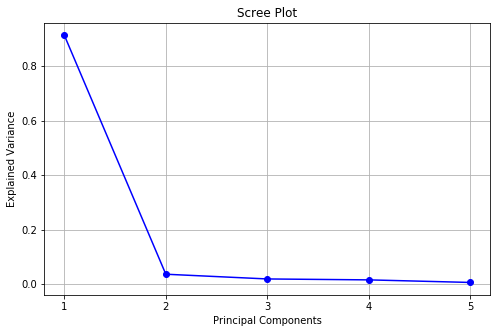

In [ ]:
explained_variances = pca.explained_variance_ratio_ # Explained variance of the principal components

# Create the Scree plot
componentes = range(1, len(explained_variances) + 1)

plt.figure(figsize=(8, 5))
plt.plot(componentes, explained_variances, marker='o', linestyle='-', color='b')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.xticks(componentes)
plt.grid(True)
plt.show()

In [ ]:
cum_explained_variances = np.cumsum(pca.explained_variance_ratio_) # Cumulative explained variance of the principal components

In [ ]:
cum_explained_variances

array([0.91327736, 0.94929962, 0.96793112, 0.98318134, 0.98898935])

In [ ]:
# Concat this five principal components with our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled.iloc[:, 0:365], grid_prices_scaled_pca_df], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0277315585,0.0277315585,0.0352190793,0.0499168053,0.1434276206,0.1486966167,0.1508042152,...,0,0,0,0,0,2.2562455660,0.2805252710,0.0129023010,0.1530525441,0.0221359703
1,2,5,0.0000000000,0.0277315585,0.0288408209,0.0443704936,0.1109262341,0.1412090960,0.1482529118,0.1506932890,...,0,0,0,0,0,2.2562455660,0.2805252710,0.0129023010,0.1530525441,0.0221359703
2,3,5,0.0000000000,0.0138657793,0.0277315585,0.0277315585,0.0360510261,0.0610094287,0.1435385469,0.1488075430,...,0,0,0,0,0,2.4418514629,0.3651175369,0.0052684502,0.1460836943,0.0250875626
3,4,5,0.0000000000,0.0127565169,0.0127565169,0.0149750416,0.0277315585,0.0277315585,0.0360510261,0.0610094287,...,0,0,0,0,0,2.3348846024,0.3009899497,0.0230953227,0.1186972919,-0.0212993386
4,5,5,0.0000000000,0.0127565169,0.0127565169,0.0127565169,0.0221852468,0.0277315585,0.0277315585,0.0360510261,...,0,0,0,0,0,2.2055255187,0.2139848024,0.0134808970,0.0609149357,-0.0739813000
5,6,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,2.1011718756,0.1484648320,0.0390847788,0.0203701321,-0.0800911511
6,7,5,0.0000000000,0.0000000000,0.0005546312,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,...,0,0,0,0,0,1.8996684707,-0.0063546670,0.0242926815,-0.1022558243,-0.1196584926
7,8,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,1.5167610829,-0.1560902446,0.0016156965,-0.2465945235,-0.0631038699
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0005546312,0.0005546312,0.0055463117,0.0055463117,...,0,0,0,0,0,0.7113020119,-0.1329588666,0.0350212163,-0.2498754857,0.0206213079
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.1155725148,-0.0087881728,-0.0296834716,-0.1942597440,0.0626956456


In [ ]:
# Total variance explained by all the principal components
print(f'{round(np.sum(explained_variances), 2) * 100}%')

99.0%


## PCA 12 Weeks before same Hour

In [ ]:
# The dataframe starts from the row 2016, as previous rows do not have past evolution information
grid_prices_scaled = grid_prices_scaled.iloc[2016:]

# Reset the indices to start from 0
grid_prices_scaled.reset_index(drop=True, inplace=True)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0027731559,0.0055463117,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,-0.6850580894,0.0665015009,-0.0448216318,0.0028155707,0.0099633939
1,2,5,0.0000000000,0.0055463117,0.0066555740,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,1.2530296295,-0.5161317513,-0.0058057916,-0.0366312304,-0.0200620219
2,3,5,0.0000000000,0.0031613977,0.0061009429,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0221852468,...,0,0,0,0,0,1.4128296591,-0.4817493016,-0.0836601048,-0.0446575148,-0.0670517362
3,4,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0166389351,...,0,0,0,0,0,1.4616429758,-0.4534641126,-0.1165120218,-0.0576586428,-0.0827281255
4,5,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0145867998,...,0,0,0,0,0,1.4044869997,-0.5011307487,-0.0862408685,-0.0685168160,-0.0903142850
5,6,5,0.0000000000,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.4051449015,-0.5296194243,-0.1015027640,-0.0643506929,-0.1126966289
6,7,5,0.0000000000,0.0005546312,0.0055463117,0.0056017748,0.0062673322,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.2104578303,-0.5815102529,-0.0024639080,-0.0869960972,-0.0512274470
7,8,5,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0.7531561243,-0.5322634199,0.1575179055,-0.1461480329,0.1200568323
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.0319917809,-0.2275619074,0.1604020302,-0.1336746100,0.1480050014
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,...,0,0,0,0,0,-0.5573640443,0.0671596486,-0.0049497019,-0.0287734659,0.0290626414


In [ ]:
# Compute the 15 principal components for 12 weeks before same hour
from sklearn.decomposition import PCA
pca = PCA(n_components = 15)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 52:136])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PCSemana{i+1}' for i in range(15)])

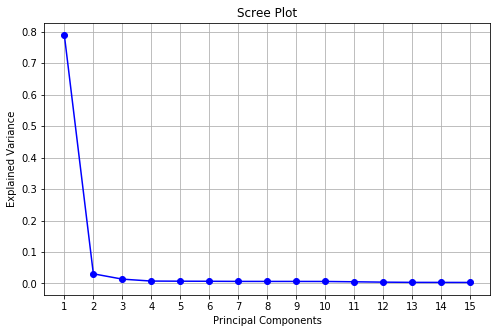

In [ ]:
explained_variances = pca.explained_variance_ratio_  # Explained variance of the principal components

# Create the Scree plot
componentes = range(1, len(explained_variances) + 1)

plt.figure(figsize=(8, 5))
plt.plot(componentes, explained_variances, marker='o', linestyle='-', color='b')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.xticks(componentes)
plt.grid(True)
plt.show()

In [ ]:
cum_explained_variances = np.cumsum(pca.explained_variance_ratio_) # Cumulative explained variance of the principal components

In [ ]:
cum_explained_variances

array([0.78845099, 0.81908528, 0.8328069 , 0.84038629, 0.84755992,
       0.85448163, 0.86100819, 0.86745859, 0.8738723 , 0.88014919,
       0.88546337, 0.8896285 , 0.89308353, 0.89642087, 0.8996192 ])

In [ ]:
# Concat this 15 principal components with our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled.iloc[:, :52], grid_prices_scaled_pca_df, grid_prices_scaled.iloc[:, 136:]], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0027731559,0.0055463117,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,-0.6850580894,0.0665015009,-0.0448216318,0.0028155707,0.0099633939
1,2,5,0.0000000000,0.0055463117,0.0066555740,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,1.2530296295,-0.5161317513,-0.0058057916,-0.0366312304,-0.0200620219
2,3,5,0.0000000000,0.0031613977,0.0061009429,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0221852468,...,0,0,0,0,0,1.4128296591,-0.4817493016,-0.0836601048,-0.0446575148,-0.0670517362
3,4,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0166389351,...,0,0,0,0,0,1.4616429758,-0.4534641126,-0.1165120218,-0.0576586428,-0.0827281255
4,5,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0145867998,...,0,0,0,0,0,1.4044869997,-0.5011307487,-0.0862408685,-0.0685168160,-0.0903142850
5,6,5,0.0000000000,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.4051449015,-0.5296194243,-0.1015027640,-0.0643506929,-0.1126966289
6,7,5,0.0000000000,0.0005546312,0.0055463117,0.0056017748,0.0062673322,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.2104578303,-0.5815102529,-0.0024639080,-0.0869960972,-0.0512274470
7,8,5,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0.7531561243,-0.5322634199,0.1575179055,-0.1461480329,0.1200568323
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.0319917809,-0.2275619074,0.1604020302,-0.1336746100,0.1480050014
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,...,0,0,0,0,0,-0.5573640443,0.0671596486,-0.0049497019,-0.0287734659,0.0290626414


In [ ]:
# Total variance explained by all the principal components
print(f'{round(np.sum(explained_variances), 2) * 100}%')

90.0%


## PCA four days before

In [ ]:
# Compute the eight principal components for all the hours in the previous four days
from sklearn.decomposition import PCA
pca = PCA(n_components = 8)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 67:163])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PCDia{i+1}' for i in range(8)])

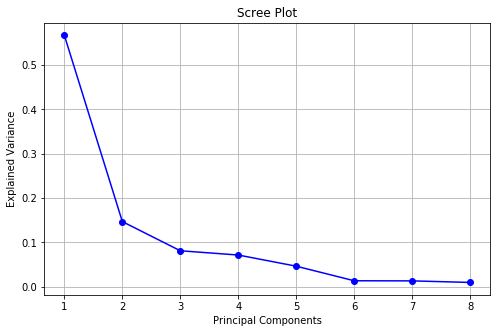

In [ ]:
explained_variances = pca.explained_variance_ratio_ # Explained variance of the principal components

# Create the Scree plot
componentes = range(1, len(explained_variances) + 1)

plt.figure(figsize=(8, 5))
plt.plot(componentes, explained_variances, marker='o', linestyle='-', color='b')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.xticks(componentes)
plt.grid(True)
plt.show()

In [ ]:
cum_explained_variances = np.cumsum(pca.explained_variance_ratio_) # Cumulative explained variance of the principal components

In [ ]:
cum_explained_variances

array([0.56701995, 0.71379774, 0.79474138, 0.86607822, 0.91219118,
       0.92545877, 0.93846344, 0.94793461])

In [ ]:
# Concat this 8 principal components with our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled.iloc[:, :67], grid_prices_scaled_pca_df, grid_prices_scaled.iloc[:, 163:]], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0027731559,0.0055463117,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,-0.6850580894,0.0665015009,-0.0448216318,0.0028155707,0.0099633939
1,2,5,0.0000000000,0.0055463117,0.0066555740,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,1.2530296295,-0.5161317513,-0.0058057916,-0.0366312304,-0.0200620219
2,3,5,0.0000000000,0.0031613977,0.0061009429,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0221852468,...,0,0,0,0,0,1.4128296591,-0.4817493016,-0.0836601048,-0.0446575148,-0.0670517362
3,4,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0166389351,...,0,0,0,0,0,1.4616429758,-0.4534641126,-0.1165120218,-0.0576586428,-0.0827281255
4,5,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0145867998,...,0,0,0,0,0,1.4044869997,-0.5011307487,-0.0862408685,-0.0685168160,-0.0903142850
5,6,5,0.0000000000,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.4051449015,-0.5296194243,-0.1015027640,-0.0643506929,-0.1126966289
6,7,5,0.0000000000,0.0005546312,0.0055463117,0.0056017748,0.0062673322,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.2104578303,-0.5815102529,-0.0024639080,-0.0869960972,-0.0512274470
7,8,5,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0.7531561243,-0.5322634199,0.1575179055,-0.1461480329,0.1200568323
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.0319917809,-0.2275619074,0.1604020302,-0.1336746100,0.1480050014
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,...,0,0,0,0,0,-0.5573640443,0.0671596486,-0.0049497019,-0.0287734659,0.0290626414


In [ ]:
# Total variance explained by all the principal components
print(f'{round(np.sum(explained_variances), 2) * 100}%')

95.0%


## PCA Exogenous variables

### Diffuse solar radiation

In [ ]:
# Compute the two principal components for the diffuse solar radiation
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 127:179])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PCSolarRadiation{i+1}' for i in range(2)])

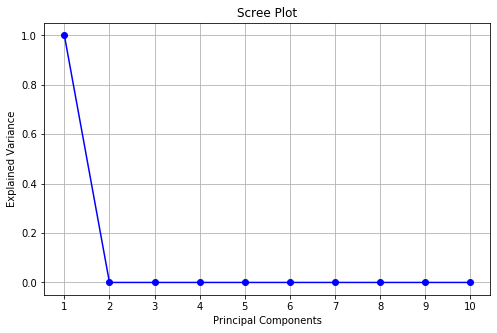

In [ ]:
explained_variances = pca.explained_variance_ratio_ # Explained variance of the principal components

# Create the Scree plot
componentes = range(1, len(explained_variances) + 1)

plt.figure(figsize=(8, 5))
plt.plot(componentes, explained_variances, marker='o', linestyle='-', color='b')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.xticks(componentes)
plt.grid(True)
plt.show()

In [ ]:
cum_explained_variances = np.cumsum(pca.explained_variance_ratio_) # Cumulative explained variance of the principal components

In [ ]:
cum_explained_variances

array([1., 1.])

In [ ]:
# Concat this two principal components with our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled.iloc[:, :127], grid_prices_scaled_pca_df, grid_prices_scaled.iloc[:, 179:]], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0027731559,0.0055463117,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,-0.6850580894,0.0665015009,-0.0448216318,0.0028155707,0.0099633939
1,2,5,0.0000000000,0.0055463117,0.0066555740,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,1.2530296295,-0.5161317513,-0.0058057916,-0.0366312304,-0.0200620219
2,3,5,0.0000000000,0.0031613977,0.0061009429,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0221852468,...,0,0,0,0,0,1.4128296591,-0.4817493016,-0.0836601048,-0.0446575148,-0.0670517362
3,4,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0166389351,...,0,0,0,0,0,1.4616429758,-0.4534641126,-0.1165120218,-0.0576586428,-0.0827281255
4,5,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0145867998,...,0,0,0,0,0,1.4044869997,-0.5011307487,-0.0862408685,-0.0685168160,-0.0903142850
5,6,5,0.0000000000,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.4051449015,-0.5296194243,-0.1015027640,-0.0643506929,-0.1126966289
6,7,5,0.0000000000,0.0005546312,0.0055463117,0.0056017748,0.0062673322,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.2104578303,-0.5815102529,-0.0024639080,-0.0869960972,-0.0512274470
7,8,5,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0.7531561243,-0.5322634199,0.1575179055,-0.1461480329,0.1200568323
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.0319917809,-0.2275619074,0.1604020302,-0.1336746100,0.1480050014
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,...,0,0,0,0,0,-0.5573640443,0.0671596486,-0.0049497019,-0.0287734659,0.0290626414


In [ ]:
# Total variance explained by all the principal components
print(f'{round(np.sum(explained_variances), 2) * 100}%')

100.0%


### Wind speed

In [ ]:
# Compute the 20 principal components for the wind speed
from sklearn.decomposition import PCA
pca = PCA(n_components = 20)
grid_prices_scaled_pca = pca.fit_transform(grid_prices_scaled.iloc[:, 75:127])
grid_prices_scaled_pca_df = pd.DataFrame(data=grid_prices_scaled_pca, columns=[f'PCWindSpeed{i+1}' for i in range(20)])

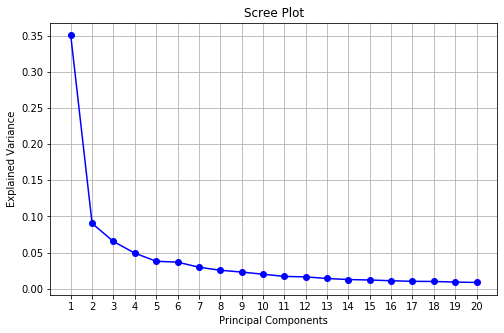

In [ ]:
explained_variances = pca.explained_variance_ratio_ # Explained variance of the principal components

# Crete the Scree plot
componentes = range(1, len(explained_variances) + 1)

plt.figure(figsize=(8, 5))
plt.plot(componentes, explained_variances, marker='o', linestyle='-', color='b')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance')
plt.xticks(componentes)
plt.grid(True)
plt.show()

In [ ]:
cum_explained_variances = np.cumsum(pca.explained_variance_ratio_) # Cumulative explained variance of the principal components

In [ ]:
cum_explained_variances

array([0.35020747, 0.44056179, 0.50588724, 0.55508554, 0.5930938 ,
       0.62987668, 0.65969228, 0.68523924, 0.70834159, 0.72845655,
       0.74551719, 0.76193838, 0.77612623, 0.78885733, 0.80095789,
       0.81204701, 0.82232015, 0.83239027, 0.84162686, 0.85035549])

In [ ]:
# Concat this 20 principal components with our dataframe
grid_prices_scaled = pd.concat([grid_prices_scaled.iloc[:, :75], grid_prices_scaled_pca_df, grid_prices_scaled.iloc[:, 127:]], axis=1)

In [ ]:
grid_prices_scaled

,Hora,day_of_week,0,1,2,3,4,5,6,7,...,hour_20,hour_21,hour_22,hour_23,hour_24,PC1,PC2,PC3,PC4,PC5
0,1,5,0.0000000000,0.0027731559,0.0055463117,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,-0.6850580894,0.0665015009,-0.0448216318,0.0028155707,0.0099633939
1,2,5,0.0000000000,0.0055463117,0.0066555740,0.0127565169,0.0127565169,0.0127565169,0.0138657793,0.0221852468,...,0,0,0,0,0,1.2530296295,-0.5161317513,-0.0058057916,-0.0366312304,-0.0200620219
2,3,5,0.0000000000,0.0031613977,0.0061009429,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0221852468,...,0,0,0,0,0,1.4128296591,-0.4817493016,-0.0836601048,-0.0446575148,-0.0670517362
3,4,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0166389351,...,0,0,0,0,0,1.4616429758,-0.4534641126,-0.1165120218,-0.0576586428,-0.0827281255
4,5,5,0.0000000000,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,0.0145867998,...,0,0,0,0,0,1.4044869997,-0.5011307487,-0.0862408685,-0.0685168160,-0.0903142850
5,6,5,0.0000000000,0.0027731559,0.0055463117,0.0062673322,0.0127565169,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.4051449015,-0.5296194243,-0.1015027640,-0.0643506929,-0.1126966289
6,7,5,0.0000000000,0.0005546312,0.0055463117,0.0056017748,0.0062673322,0.0127565169,0.0127565169,0.0127565169,...,0,0,0,0,0,1.2104578303,-0.5815102529,-0.0024639080,-0.0869960972,-0.0512274470
7,8,5,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0055463117,0.0055463117,0.0062673322,0.0062673322,...,0,0,0,0,0,0.7531561243,-0.5322634199,0.1575179055,-0.1461480329,0.1200568323
8,9,5,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,0.0027731559,...,0,0,0,0,0,0.0319917809,-0.2275619074,0.1604020302,-0.1336746100,0.1480050014
9,10,5,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000554631,0.0005546312,0.0005546312,0.0005546312,...,0,0,0,0,0,-0.5573640443,0.0671596486,-0.0049497019,-0.0287734659,0.0290626414


In [ ]:
# Total variance explained by all the principal components
print(f'{round(np.sum(explained_variances), 2) * 100}%')

85.0%


## Save final dataset

In [ ]:
grid_prices_scaled.to_csv('grid_prices_scaled_final_2.csv', index = False)

# DNN

In [ ]:
# Loading the dataset
grid_prices_scaled = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\grid_prices_scaled_final_2.csv')

In [ ]:
!pip install tensorflow

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)

In [ ]:
X_train.shape

(24264, 128)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)

In [ ]:
X_test.shape

(17544, 128)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtainin y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras import regularizers

# Build the neural network model
model = Sequential()
model.add(Dense(64, input_shape=(X_train.shape[1], ), activation='relu'))
model.add(Dropout(0.1))# Add dropout for regularization

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))

model.add(Dense(y_train.shape[1]))  # Output layer with the same number of columns as y_train

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=1)

# Compute the predictions using the test set
predictions = model.predict(X_test)


Epoch 1/200
759/759 [==============================] - 1s 1ms/step - loss: 11.7619 - mean_absolute_error: 1.4843
Epoch 2/200
759/759 [==============================] - 1s 1ms/step - loss: 0.6217 - mean_absolute_error: 0.5318
Epoch 3/200
759/759 [==============================] - 1s 1ms/step - loss: 0.5117 - mean_absolute_error: 0.4668A: 0s - loss: 0.5106 - mean_absolute_error: 0
Epoch 4/200
759/759 [==============================] - 1s 1ms/step - loss: 0.4737 - mean_absolute_error: 0.4403
Epoch 5/200
759/759 [==============================] - 1s 1ms/step - loss: 0.4452 - mean_absolute_error: 0.4239A: 0s - loss: 0.4490 - mean_absolute_error: 0.4
Epoch 6/200
759/759 [==============================] - 1s 1ms/step - loss: 0.4361 - mean_absolute_error: 0.4149
Epoch 7/200
759/759 [==============================] - 1s 1ms/step - loss: 0.4292 - mean_absolute_error: 0.4130
Epoch 8/200
759/759 [==============================] - 1s 1ms/step - loss: 0.4146 - mean_absolute_error: 0.4057A: 0s - loss

759/759 [==============================] - 1s 1ms/step - loss: 0.1551 - mean_absolute_error: 0.2478A: 0s - loss: 0.1563 - mean_abso
Epoch 143/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1582 - mean_absolute_error: 0.2496
Epoch 144/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1574 - mean_absolute_error: 0.2487A: 0s - loss: 0.1570 - mean_absolute_error: 0.2 - ETA: 0s - loss: 0.1575 - mean_absolute_error: 
Epoch 145/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1555 - mean_absolute_error: 0.2480
Epoch 146/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1562 - mean_absolute_error: 0.2486
Epoch 147/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1573 - mean_absolute_error: 0.2489
Epoch 148/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1575 - mean_absolute_error: 0.2494
Epoch 149/200
759/759 [==============================] - 1s 1ms/step - loss: 0.1517 - me

In [ ]:
print(predictions.shape)

(17544, 49)


In [ ]:
# Store the predictions into a dataframe
dnn_predictions = pd.DataFrame(predictions)

In [ ]:
dnn_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\DNN\dnn_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
dnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.0509589240,0.1480161500,0.1786243900,0.1795596300,0.1815644800,0.1731469500,0.2369275400,0.2984430500,0.4127810600,0.5434400000,...,2.0078950000,2.0812740000,2.1357727000,2.2020330000,2.2602220000,2.3453940000,2.4150790000,2.4823895000,2.5752494000,2.6233313000
1,0.1972488500,0.3356797700,0.4311738300,0.5250899000,0.6109571500,0.6528305400,0.7628141600,0.8590935000,1.0131851000,1.1640007000,...,2.6070814000,2.6906967000,2.7123125000,2.7364378000,2.7652063000,2.8152916000,2.8510818000,2.8985815000,2.9469910000,2.9806576000
2,0.2460467000,0.4100189200,0.5457948400,0.6927736400,0.7892007000,0.8233546000,0.9257644400,0.9976640300,1.1293548000,1.2742388000,...,2.7812400000,2.8609767000,2.8690280000,2.8758730000,2.8946772000,2.9347172000,2.9648213000,3.0116549000,3.0490284000,3.0812023000
3,0.1398534800,0.2888801400,0.3676262000,0.4586617400,0.5288175300,0.5557964400,0.6711058600,0.7819071000,0.9748072000,1.2167397000,...,2.9315112000,2.9945517000,2.9949408000,2.9916682000,2.9987588000,3.0212789000,3.0390580000,3.0748572000,3.1025949000,3.1262546000
4,0.1795976200,0.3678452000,0.4528573500,0.5522105000,0.6487012500,0.6874612600,0.8259727400,0.9740770000,1.1954090000,1.5153157000,...,3.2069320000,3.2422445000,3.2251200000,3.2076960000,3.1994467000,3.2068138000,3.2157235000,3.2474394000,3.2643766000,3.2848442000
5,0.3760108600,0.6464731000,0.8343181600,1.0293860000,1.2669060000,1.4083002000,1.6065733000,1.8048920000,2.0141573000,2.3190446000,...,3.6953516000,3.7044687000,3.6620579000,3.6094604000,3.5752550000,3.5428352000,3.5138378000,3.5215720000,3.4926136000,3.5026765000
6,0.1659117300,0.3021593000,0.3320864400,0.3946172600,0.4761264300,0.5411759000,0.6867966700,0.8522696500,1.0557089000,1.2697011000,...,2.6356630000,2.7154431000,2.7533846000,2.7846490000,2.8212829000,2.8633413000,2.8847600000,2.9235685000,2.9624820000,2.9846440000
7,0.0505267900,0.1289346700,0.1209287050,0.1630264800,0.2078463000,0.2368573700,0.3024012700,0.4031174800,0.5113941000,0.6221587700,...,2.0949240000,2.1410966000,2.1872437000,2.2304468000,2.2742080000,2.3260508000,2.3636340000,2.4026184000,2.4628901000,2.4931760000
8,0.0341254800,0.0986426850,0.1211120000,0.1400400300,0.1471296300,0.1430393800,0.1727524400,0.2087074200,0.2567853600,0.3204628800,...,1.6659291000,1.6839460000,1.6856527000,1.6991392000,1.7141789000,1.7470520000,1.7783289000,1.8162444000,1.8633101000,1.8914570000
9,0.0053103426,0.0495723900,0.0653864200,0.0879593200,0.1019634600,0.0992831140,0.1029625300,0.1182740300,0.1201039250,0.1365738800,...,1.5828223000,1.5883262000,1.5790918000,1.5779054000,1.5832540000,1.6019596000,1.6265138000,1.6598583000,1.6923732000,1.7165570000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(dnn_predictions.shape[0]):
    for c in range(dnn_predictions.shape[1]):
        if dnn_predictions.iloc[i, c] < 0:
            dnn_predictions.iloc[i, c] = abs(dnn_predictions.iloc[i, c])

In [ ]:
for i in range(dnn_predictions.shape[0]):
    for c in range(dnn_predictions.shape[1]):
        if c < dnn_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and dnn_predictions.iloc[i, c] > dnn_predictions.iloc[i, c + 1] and dnn_predictions.iloc[i, c] > dnn_predictions.iloc[i, c + 2]:
                dnn_predictions.iloc[i, c] = dnn_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and dnn_predictions.iloc[i, c] > dnn_predictions.iloc[i, c + 1] and dnn_predictions.iloc[i, c] > dnn_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if dnn_predictions.iloc[i, c + 1] >= dnn_predictions.iloc[i, c - 1]:
                    dnn_predictions.iloc[i, c] = dnn_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if dnn_predictions.iloc[i, c + 1] < dnn_predictions.iloc[i, c - 1]:
                    dnn_predictions.iloc[i, c + 1] = dnn_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if dnn_predictions.iloc[i, c] > dnn_predictions.iloc[i, c + 1] and dnn_predictions.iloc[i, c] < dnn_predictions.iloc[i, c + 2]:
                dnn_predictions.iloc[i, c + 1] = dnn_predictions.iloc[i, c]
        if c >= dnn_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if dnn_predictions.iloc[i, c] < dnn_predictions.iloc[i, c - 1]:
                dnn_predictions.iloc[i, c] = dnn_predictions.iloc[i, c - 1]

In [ ]:
dnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.0509589240,0.1480161500,0.1786243900,0.1795596300,0.1815644800,0.1815644800,0.2369275400,0.2984430500,0.4127810600,0.5434400000,...,2.4282832000,2.4282832000,2.4282832000,2.4282832000,2.4282832000,2.4282832000,2.4282832000,2.4823895000,2.5752494000,2.6233313000
1,0.1972488500,0.3356797700,0.4311738300,0.5250899000,0.6109571500,0.6528305400,0.7628141600,0.8590935000,1.0131851000,1.1640007000,...,2.8009624000,2.8009624000,2.8009624000,2.8009624000,2.8009624000,2.8152916000,2.8510818000,2.8985815000,2.9469910000,2.9806576000
2,0.2460467000,0.4100189200,0.5457948400,0.6927736400,0.7892007000,0.8233546000,0.9257644400,0.9976640300,1.1293548000,1.2742388000,...,2.9131827000,2.9131827000,2.9131827000,2.9131827000,2.9131827000,2.9347172000,2.9648213000,3.0116549000,3.0490284000,3.0812023000
3,0.1398534800,0.2888801400,0.3676262000,0.4586617400,0.5288175300,0.5557964400,0.6711058600,0.7819071000,0.9748072000,1.2167397000,...,2.9348972000,2.9945517000,2.9949408000,2.9949408000,2.9987588000,3.0212789000,3.0390580000,3.0748572000,3.1025949000,3.1262546000
4,0.1795976200,0.3678452000,0.4528573500,0.5522105000,0.6487012500,0.6874612600,0.8259727400,0.9740770000,1.1954090000,1.5153157000,...,3.2335591000,3.2422445000,3.2422445000,3.2422445000,3.2422445000,3.2422445000,3.2422445000,3.2474394000,3.2643766000,3.2848442000
5,0.3760108600,0.6464731000,0.8343181600,1.0293860000,1.2669060000,1.4083002000,1.6065733000,1.8048920000,2.0141573000,2.3190446000,...,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000,3.7840460000
6,0.1659117300,0.3021593000,0.3320864400,0.3946172600,0.4761264300,0.5411759000,0.6867966700,0.8522696500,1.0557089000,1.2697011000,...,2.6795423000,2.7154431000,2.7533846000,2.7846490000,2.8212829000,2.8633413000,2.8847600000,2.9235685000,2.9624820000,2.9846440000
7,0.0505267900,0.1289346700,0.1289346700,0.1630264800,0.2078463000,0.2368573700,0.3024012700,0.4031174800,0.5113941000,0.6221587700,...,2.4185338000,2.4185338000,2.4185338000,2.4185338000,2.4185338000,2.4185338000,2.4185338000,2.4185338000,2.4628901000,2.4931760000
8,0.0341254800,0.0986426850,0.1211120000,0.1400400300,0.1471296300,0.1471296300,0.1727524400,0.2087074200,0.2567853600,0.3204628800,...,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000,2.1134690000
9,0.0053103426,0.0495723900,0.0653864200,0.0879593200,0.1019634600,0.1019634600,0.1029625300,0.1182740300,0.1201039250,0.1365738800,...,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000,1.9690877000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(dnn_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

dnn_predictions = dnn_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
dnn_predictions.to_csv('dnn_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
dnn_predictions = dnn_predictions.multiply(desv_y, axis = 1)

In [ ]:
dnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.0009137827,0.0033985590,0.0049994765,0.0059643018,0.0070113826,0.0080517084,0.0118779230,0.0166701497,0.0255039464,0.0366900620,...,0.5209351919,0.5398372543,0.5571992391,0.5735933649,0.5893552653,0.6037899678,0.6173690684,0.6437755882,0.6808237615,0.7057434097
1,0.0035370173,0.0077074528,0.0120680241,0.0174415297,0.0235930197,0.0289506027,0.0382422740,0.0479864324,0.0626003008,0.0785868869,...,0.6008853849,0.6226884292,0.6427150335,0.6616252372,0.6798061850,0.7000191841,0.7248617932,0.7517095967,0.7791018213,0.8018733500
2,0.0044120482,0.0094143340,0.0152761250,0.0230113587,0.0304761597,0.0365127095,0.0464114842,0.0557265741,0.0697779213,0.0860295534,...,0.6249598024,0.6476363836,0.6684653520,0.6881331912,0.7070425570,0.7297142292,0.7537790336,0.7810337195,0.8060776499,0.8289224534
3,0.0025078178,0.0066328991,0.0102894043,0.0152350338,0.0204210760,0.0246475018,0.0336446483,0.0436750275,0.0602290973,0.0821475323,...,0.6296181747,0.6657257142,0.6872257466,0.7074455612,0.7278122618,0.7512377015,0.7726530440,0.7974244181,0.8202391311,0.8410426777
4,0.0032204998,0.0084459946,0.0126749191,0.0183423750,0.0250505643,0.0304863461,0.0414086123,0.0544090720,0.0738591230,0.1023057319,...,0.6936895706,0.7207908735,0.7439726011,0.7658620431,0.7869073374,0.8061805568,0.8243113762,0.8421813780,0.8630096781,0.8837073480
5,0.0067425332,0.0148434948,0.0233515371,0.0341923669,0.0489234609,0.0624528680,0.0805425744,0.1008159507,0.1244460196,0.1565690602,...,0.8117845271,0.8412400180,0.8682955728,0.8938428921,0.9184050008,0.9408989085,0.9620595134,0.9813433546,1.0003957021,1.0180054370
6,0.0029750879,0.0069377983,0.0092946902,0.0131077148,0.0183863308,0.0239991353,0.0344312780,0.0476052723,0.0652276614,0.0857231930,...,0.5748373510,0.6036764358,0.6317977261,0.6577717912,0.6847380618,0.7119666896,0.7334241713,0.7581896518,0.7831972075,0.8029457939
7,0.0009060338,0.0029604342,0.0036087225,0.0054151321,0.0080262942,0.0105037421,0.0151603271,0.0225169550,0.0315968173,0.0420047178,...,0.5188436708,0.5376698427,0.5549621202,0.5712904247,0.5869890420,0.6013657901,0.6148903715,0.6272154388,0.6511191118,0.6707282954
8,0.0006119296,0.0022649081,0.0033897756,0.0046516079,0.0056816297,0.0065246510,0.0086606234,0.0116577817,0.0158656506,0.0216358805,...,0.4533986724,0.4698501814,0.4849612758,0.4992299891,0.5129484416,0.5255117605,0.5373304018,0.5481008313,0.5587419667,0.5685773727
9,0.0000952237,0.0011382183,0.0018300853,0.0029216808,0.0039374708,0.0045216996,0.0051618356,0.0066064389,0.0074206992,0.0092207127,...,0.4224248139,0.4377524407,0.4518312231,0.4651251714,0.4779064500,0.4896115078,0.5006227605,0.5106574098,0.5205715977,0.5297350996


In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]

max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
dnn_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]


    # Compute the prediction using DNN procedure
    pp1 = dnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    dnn_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
dnn_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.1287272994585045
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.10899736674001856
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.10869928514578528
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.11536510176027467
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.10016382040644782
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.059591507239209765
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.09624756196152057
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.08567076723766033
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.07171995006824188
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.04259550333204409
------------------------


Distancia L1 (Manhattan) para la hora 15 del día 1017: 0.024797939153486846
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1017: 0.02825009122873424
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1017: 0.04124217511996059
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1017: 0.05163159252722885
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1017: 0.06493370720642921
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1017: 0.07144799066434417
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1017: 0.0870908517183923
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1017: 0.09681197903894653
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1017: 0.08899373307569164
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1017: 0.07799054419149568
----------------

Distancia L1 (Manhattan) para la hora 2 del día 1021: 0.0576447212519267
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1021: 0.07434628001445323
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1021: 0.0634760633907028
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1021: 0.0644960522347055
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1021: 0.04913473832207462
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1021: 0.042065727621221856
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1021: 0.04276879443800729
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1021: 0.027117953462033936
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1021: 0.03525378859469586
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1021: 0.04053061891618441
------------------------


Distancia L1 (Manhattan) para la hora 11 del día 1025: 0.024881120733109625
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1025: 0.013006637556492315
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1025: 0.01677611292783405
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1025: 0.015721179589204815
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1025: 0.015116286575936699
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1025: 0.017306457283800616
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1025: 0.016841647358831514
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1025: 0.016203136000904922
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1025: 0.013897538152846339
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1025: 0.023597358330432316
-------

------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1029: 0.008200868942761574
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1029: 0.009141606516367494
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1029: 0.0091268621940805
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1029: 0.006880816376225835
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1029: 0.007580372751432958
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1029: 0.007220778223497421
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1029: 0.02177720140052502
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1029: 0.021845320419326186
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1029: 0.03379294822170724
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1029: 0.034

Distancia L1 (Manhattan) para la hora 18 del día 1033: 0.021963524202406152
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1033: 0.017545396181730625
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1033: 0.020767809644685317
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1033: 0.021766885851682627
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1033: 0.024305145389467268
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1033: 0.023131956403075846
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1033: 0.02817881924541228
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1034: 0.03438966532925316
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1034: 0.02084892404270202
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1034: 0.02281275406533292
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1037: 0.016541683529420006
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1038: 0.03507362325234887
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1038: 0.027047779776716227
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1038: 0.027583509829536595
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1038: 0.027530112807334455
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1038: 0.0459585434172824
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1038: 0.047081193180699706
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1038: 0.02763838133190119
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1038: 0.029307264095251487
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1038: 0.043582709469498083
-------------------


Distancia L1 (Manhattan) para la hora 12 del día 1042: 0.014738804742979707
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1042: 0.01642756754891074
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1042: 0.012901450673243105
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1042: 0.013422332679950142
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1042: 0.018426059516759467
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1042: 0.016083154057350932
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1042: 0.017608299222911922
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1042: 0.017244950875639126
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1042: 0.02245034799452222
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1042: 0.023810402943973047
-------

Distancia L1 (Manhattan) para la hora 22 del día 1046: 0.01696505174945916
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1046: 0.012782906151324124
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1046: 0.014333229300449942
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1047: 0.08266901876200428
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1047: 0.07696767954982602
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1047: 0.08245662118148202
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1047: 0.049286774393947165
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1047: 0.043421091901008096
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1047: 0.04465064497711463
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1047: 0.06216951351809625
-------------------

Distancia L1 (Manhattan) para la hora 11 del día 1051: 0.011134333059705086
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1051: 0.009276785692440812
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1051: 0.0108872310179642
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1051: 0.019282876457305705
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1051: 0.02024186970187649
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1051: 0.022749547598054747
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1051: 0.030158419749619587
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1051: 0.01502280566051698
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1051: 0.016583285859480483
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1051: 0.01766259124543617
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1055: 0.008285237763996417
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1055: 0.011370900850995734
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1055: 0.010836913772791758
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1055: 0.015545972202626494
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1055: 0.01167964747966399
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1055: 0.016427054345899167
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1055: 0.018574716291188016
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1055: 0.014875935760685029
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1055: 0.027550731577361046
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1056: 0.06701265521911445
---------

Distancia L1 (Manhattan) para la hora 19 del día 1059: 0.010386683129113665
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1059: 0.028565704146361802
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1059: 0.03480351855396022
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1059: 0.03100627225541784
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1059: 0.032214081971272276
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1059: 0.025655287454478495
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1060: 0.025258270728523293
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1060: 0.036199935877243065
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1060: 0.038173684892549464
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1060: 0.030472967406995625
------------

Distancia L1 (Manhattan) para la hora 5 del día 1064: 0.04218443332084228
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1064: 0.03006486884770157
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1064: 0.023502691982173377
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1064: 0.0184791849838786
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1064: 0.010323356956155235
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1064: 0.011126521078644359
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1064: 0.0082089298862181
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1064: 0.023746977567271704
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1064: 0.02356773625127282
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1064: 0.03327409001616101
-------------------

Distancia L1 (Manhattan) para la hora 17 del día 1068: 0.01525895916777658
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1068: 0.014874795555464145
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1068: 0.009373962331755135
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1068: 0.008268943847736111
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1068: 0.008873809283717988
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1068: 0.009977570883239271
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1068: 0.009750392359050845
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1068: 0.01070618051556998
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1069: 0.025489755674678545
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1069: 0.03186209211074591
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1073: 0.031429133772207275
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1073: 0.029555087607100537
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1073: 0.03619526728745447
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1073: 0.03498546922959538
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1073: 0.03181848555928015
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1073: 0.013102549076764941
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1073: 0.021340352167439625
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1073: 0.022122844318184502
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1073: 0.013732706532259059
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1073: 0.00726289256362659
-----------------

Distancia L1 (Manhattan) para la hora 3 del día 1077: 0.10514092662894745
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1077: 0.09116663839187067
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1077: 0.08831501929902746
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1077: 0.07363209365761181
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1077: 0.04119203750663178
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1077: 0.035045814762736695
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1077: 0.044959906850788
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1077: 0.03888919824002107
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1077: 0.044728884221472615
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1077: 0.03669929602170453
-----------------------

Distancia L1 (Manhattan) para la hora 2 del día 1081: 0.03421198531307612
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1081: 0.05141971987765684
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1081: 0.05217534677876858
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1081: 0.030342751340163572
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1081: 0.047174548431094226
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1081: 0.05560696267819536
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1081: 0.05564638365131416
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1081: 0.028691818359862165
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1081: 0.026483772170941416
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1081: 0.012844390875214735
-------------------

Distancia L1 (Manhattan) para la hora 1 del día 1085: 0.03591753539147702
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1085: 0.02849998827133717
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1085: 0.07532108675378286
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1085: 0.06116676756335371
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1085: 0.0652116901272194
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1085: 0.04257318625815611
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1085: 0.030416629288711687
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1085: 0.023957872113741098
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1085: 0.03151501762316528
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1085: 0.019471920187742596
-----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1089: 0.023875942482107664
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1089: 0.020444050662631212
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1089: 0.017863284209786313
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1089: 0.019573988549046847
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1089: 0.017306398989672303
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1089: 0.02032074996806125
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1089: 0.018990328066107714
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1089: 0.01819910234426503
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1089: 0.016014216283673614
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1089: 0.01511062456685753
------------

Distancia L1 (Manhattan) para la hora 1 del día 1095: 0.042971648691535386
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1095: 0.030857500083197126
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1095: 0.028880528287508055
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1095: 0.02930227237043438
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1095: 0.024790709945385066
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1095: 0.022021857820993758
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1095: 0.06821760521420675
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1095: 0.022098754066850326
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1095: 0.01847678769238979
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1095: 0.008387493863085687
------------------

Distancia L1 (Manhattan) para la hora 10 del día 1099: 0.013097244413299191
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1099: 0.01644859445443515
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1099: 0.016730752917809136
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1099: 0.01588178936033459
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1099: 0.015401477130233293
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1099: 0.014732889471205515
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1099: 0.013345758976917928
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1099: 0.011486070505117501
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1099: 0.010010127922530965
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1099: 0.008047856829719466
--------

Distancia L1 (Manhattan) para la hora 7 del día 1103: 0.06583446834026932
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1103: 0.024415168030430347
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1103: 0.02003241965496015
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1103: 0.01403139803179311
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1103: 0.02619873242498455
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1103: 0.021862192863663504
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1103: 0.02232980841475337
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1103: 0.021774097191412416
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1103: 0.017833730489557713
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1103: 0.01815014998656978
---------------

Distancia L1 (Manhattan) para la hora 17 del día 1107: 0.011042016443301222
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1107: 0.00789675917021686
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1107: 0.008679211058081731
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1107: 0.007498225914264017
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1107: 0.012106229590039869
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1107: 0.013554981422321023
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1107: 0.019199324204553295
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1107: 0.012771571313981317
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1108: 0.026712692524898694
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1108: 0.02434360694885504
----------

Distancia L1 (Manhattan) para la hora 5 del día 1113: 0.03448946198506789
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1113: 0.032430788511762246
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1113: 0.01795883372355996
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1113: 0.04115860710077787
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1113: 0.016348277272354023
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1113: 0.008718980595542944
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1113: 0.013502646572192703
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1113: 0.012517454860515987
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1113: 0.013083585741208522
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1113: 0.011864634913744086
--------------

Distancia L1 (Manhattan) para la hora 20 del día 1116: 0.04374401973639466
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1116: 0.03706899046968333
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1116: 0.040705152036574946
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1116: 0.03457616592755206
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1116: 0.035265648745157085
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1117: 0.06825296675601239
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1117: 0.06914855251486687
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1117: 0.07382877518234635
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1117: 0.05209900369443725
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1117: 0.040914265937833594
------------------

Distancia L1 (Manhattan) para la hora 20 del día 1120: 0.0174960985189421
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1120: 0.011713493596703154
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1120: 0.00853327796842099
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1120: 0.007326319815292588
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1120: 0.01244929065815506
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1121: 0.05943923323913851
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1121: 0.05891124631703831
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1121: 0.06581215128621246
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1121: 0.06717045227262483
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1121: 0.0389772566113148
---------------------

Distancia L1 (Manhattan) para la hora 1 del día 1125: 0.027671376820041865
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1125: 0.03335656746704692
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1125: 0.03306695942957871
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1125: 0.04403937492692886
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1125: 0.04492666356489732
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1125: 0.032603388639329545
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1125: 0.025553821359382965
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1125: 0.023099558355827377
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1125: 0.022731565379763306
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1125: 0.02262678571415614
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1129: 0.017898467655209235
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1129: 0.02308490472090246
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1129: 0.023573588760251323
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1129: 0.023066609447024888
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1129: 0.026281938524978753
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1129: 0.02601928835365806
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1129: 0.02946153643717364
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1129: 0.029348584501022502
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1129: 0.03067692389024454
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1129: 0.028779360387784447
----------

Distancia L1 (Manhattan) para la hora 2 del día 1133: 0.035482712805316056
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1133: 0.051398830930863545
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1133: 0.05147479623349434
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1133: 0.04883448744360516
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1133: 0.05820726644918789
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1133: 0.07195141488889442
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1133: 0.07630276066914349
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1133: 0.038532706134849284
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1133: 0.028583393914559996
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1133: 0.015812749590810398
-------------------

Distancia L1 (Manhattan) para la hora 9 del día 1137: 0.014381019856791383
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1137: 0.010519968002626518
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1137: 0.014482577253255422
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1137: 0.009206861443685698
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1137: 0.01239864255874886
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1137: 0.013067072489922133
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1137: 0.013207916893412719
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1137: 0.011291993120972113
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1137: 0.013335647351985589
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1137: 0.016383037074905037
--------

Distancia L1 (Manhattan) para la hora 22 del día 1140: 0.025596079499262264
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1140: 0.02783635716500017
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1140: 0.01988878310355914
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1141: 0.03182963281655003
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1141: 0.02344265895044066
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1141: 0.019878874293514558
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1141: 0.022966903148511283
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1141: 0.019731226009199677
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1141: 0.0274176880424707
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1141: 0.020644008580850755
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1144: 0.01130000458306363
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1144: 0.011835799065629277
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1144: 0.005966955944782732
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1144: 0.006422249273015334
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1144: 0.008532771167929035
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1144: 0.009934607525036707
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1144: 0.010236191672609044
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1144: 0.009840078840129053
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1144: 0.031814534732082664
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1145: 0.027258170183880125
--------

Distancia L1 (Manhattan) para la hora 12 del día 1148: 0.007752137949633394
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1148: 0.006608030950702511
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1148: 0.008668868601721749
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1148: 0.013055725046069132
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1148: 0.01621273285478592
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1148: 0.012393847925684608
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1148: 0.014770001883573367
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1148: 0.020476082208543626
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1148: 0.029441161875214242
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1148: 0.0429405133609566
---------

Distancia L1 (Manhattan) para la hora 8 del día 1152: 0.023752174505560712
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1152: 0.02693417024874808
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1152: 0.027374282221348856
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1152: 0.016867404372686197
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1152: 0.011323072271560977
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1152: 0.01073780580832119
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1152: 0.013273038509071897
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1152: 0.014955012514721562
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1152: 0.019382718170958407
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1152: 0.022059165643323896
----------

Distancia L1 (Manhattan) para la hora 1 del día 1156: 0.02216437937602447
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1156: 0.03103783941218102
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1156: 0.03277801381667042
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1156: 0.0344958514444805
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1156: 0.041133400244216925
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1156: 0.025588423205873446
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1156: 0.04761393927956106
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1156: 0.03252160931034559
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1156: 0.016598797290655505
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1156: 0.010590525128173713
----------------------

Distancia L1 (Manhattan) para la hora 21 del día 1159: 0.016138871963124257
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1159: 0.010344780798151527
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1159: 0.009944946164575846
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1159: 0.021933214239534173
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1160: 0.03611366525284358
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1160: 0.03478916417974784
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1160: 0.032339521436806226
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1160: 0.03045111154765924
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1160: 0.037062822992116926
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1160: 0.037364497619327676
---------------

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1164: 0.02096211472427019
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1164: 0.04050150425548814
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1164: 0.04185972587219336
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1164: 0.03386865240435727
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1164: 0.020078134246782068
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1164: 0.025885400032862722
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1164: 0.03273241637400006
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1164: 0.012958151942491534
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1164: 0.008751064194441648
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1164: 0.006441592870

Distancia L1 (Manhattan) para la hora 17 del día 1167: 0.019551057948462236
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1167: 0.015191568972977996
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1167: 0.01106904478008715
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1167: 0.00904569563853222
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1167: 0.012112362159856522
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1167: 0.01382951580447981
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1167: 0.014923488755256977
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1167: 0.01901591861898351
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1168: 0.027593582151251066
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1168: 0.06130907374772923
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1171: 0.038308724245220305
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1171: 0.03265868269931375
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1171: 0.027159059431571847
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1171: 0.02311434282498948
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1171: 0.019400928106755238
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1171: 0.017633089257942013
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1171: 0.015202743309241908
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1171: 0.0121054222709357
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1171: 0.010533671753651112
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1171: 0.007694201815990765
----------

Distancia L1 (Manhattan) para la hora 20 del día 1174: 0.013842321243156704
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1174: 0.01629034000948137
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1174: 0.014257870428375001
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1174: 0.011547330903852994
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1174: 0.013844005105795034
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1175: 0.01916083534865816
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1175: 0.02627671406306855
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1175: 0.03855760684444337
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1175: 0.046413610590451564
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1175: 0.034442058693349396
---------------

Distancia L1 (Manhattan) para la hora 20 del día 1178: 0.029376898487352116
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1178: 0.03632338579302416
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1178: 0.029977562154515393
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1178: 0.03168565091723074
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1178: 0.024874844515124398
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1179: 0.035815525737716604
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1179: 0.04177102028601945
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1179: 0.046652001059139615
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1179: 0.08378725546180707
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1179: 0.07813013258429613
----------------

Distancia L1 (Manhattan) para la hora 21 del día 1182: 0.022762191955053954
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1182: 0.02955401999860728
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1182: 0.03237253357305908
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1182: 0.03343969880303661
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1183: 0.08003049354811646
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1183: 0.08397827282028475
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1183: 0.07736895726202124
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1183: 0.046131606570121206
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1183: 0.04552087040755396
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1183: 0.04505945644023035
--------------------

Distancia L1 (Manhattan) para la hora 16 del día 1186: 0.01102968659202079
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1186: 0.00959271930976157
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1186: 0.008965656757282586
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1186: 0.005756544188619463
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1186: 0.009002662767417987
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1186: 0.012539907951703413
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1186: 0.022341912058806396
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1186: 0.024048874947820056
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1186: 0.02238822497687956
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1187: 0.07047524330213094
-----------

Distancia L1 (Manhattan) para la hora 4 del día 1192: 0.028770857434698455
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1192: 0.0285875541251766
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1192: 0.03932379793644414
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1192: 0.01967764345071898
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1192: 0.023265356318828097
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1192: 0.019433747351906505
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1192: 0.01581278445897137
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1192: 0.00958258211635249
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1192: 0.0114123057866362
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1192: 0.0100462967938783
----------------------

Distancia L1 (Manhattan) para la hora 1 del día 1196: 0.01482410391728083
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1196: 0.013723983507550686
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1196: 0.010430580276659867
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1196: 0.011681736944424925
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1196: 0.0173643707497826
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1196: 0.018757801402198376
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1196: 0.020040022099654317
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1196: 0.014331013701645898
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1196: 0.013630449534468247
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1196: 0.01054984694545703
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1199: 0.008486031661590461
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1199: 0.009528548054500744
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1199: 0.014760310439412243
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1199: 0.011498006922672393
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1199: 0.01109539866240523
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1199: 0.011247091692725315
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1199: 0.012646313352956129
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1200: 0.020260645676841577
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1200: 0.023852958396440894
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1200: 0.019287809930189064
----------

Distancia L1 (Manhattan) para la hora 2 del día 1205: 0.033915589957257755
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1205: 0.054638828716026884
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1205: 0.07125990216883628
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1205: 0.06018832377139768
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1205: 0.04500464048349538
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1205: 0.020912986334607156
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1205: 0.02722191703285024
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1205: 0.015378024455275367
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1205: 0.014175300822412001
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1205: 0.011320340726042967
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1208: 0.020701911114685913
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1208: 0.01627061003837532
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1208: 0.01208789206912482
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1208: 0.018298754404478507
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1208: 0.025246270493166613
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1208: 0.03353451212487274
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1208: 0.03210371858475675
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1208: 0.030181499283383692
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1209: 0.021314939725043214
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1209: 0.02302920468053312
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1212: 0.0059768914672660815
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1212: 0.0047067166083237175
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1212: 0.006115917563043718
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1212: 0.009099882988198272
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1212: 0.009153039412470745
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1212: 0.009394969754935457
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1212: 0.0071608255701443736
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1213: 0.018133260310693365
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1213: 0.012982582440468304
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1213: 0.014571829732380066
------

Distancia L1 (Manhattan) para la hora 8 del día 1216: 0.012094094732985467
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1216: 0.013603589073327746
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1216: 0.008042325520262775
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1216: 0.012551315887732499
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1216: 0.012262020542785471
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1216: 0.013159785648039993
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1216: 0.013937324866256725
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1216: 0.019023941725895346
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1216: 0.01776008812278145
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1216: 0.01586656440715052
----------

Distancia L1 (Manhattan) para la hora 2 del día 1220: 0.014094966931106888
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1220: 0.013524407521330543
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1220: 0.01641478228623777
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1220: 0.0338635844468749
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1220: 0.04417797099969838
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1220: 0.057388054238131064
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1220: 0.0755864539915774
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1220: 0.023065515289690332
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1220: 0.010536249893939541
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1220: 0.01640942769001486
---------------------

Distancia L1 (Manhattan) para la hora 15 del día 1225: 0.004940564213581917
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1225: 0.005792673290988001
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1225: 0.006214344447181915
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1225: 0.005879664274677203
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1225: 0.006680902580329708
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1225: 0.006500955966934517
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1225: 0.007447803470958756
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1225: 0.009297021620853895
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1225: 0.012035598054926338
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1225: 0.011368227616159937
------

Distancia L1 (Manhattan) para la hora 9 del día 1229: 0.01763602791979148
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1229: 0.018228736861703794
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1229: 0.006263906232610823
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1229: 0.007407120360030654
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1229: 0.0075358867083661985
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1229: 0.00741662885573609
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1229: 0.006256267301632508
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1229: 0.005745411988607355
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1229: 0.0056258426494692
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1229: 0.0047666645096363916
---------

Distancia L1 (Manhattan) para la hora 1 del día 1233: 0.05829910598367812
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1233: 0.02671389258412294
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1233: 0.03859378847913379
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1233: 0.0522352005220847
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1233: 0.06476286255515121
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1233: 0.08055116239491031
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1233: 0.057104570303530895
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1233: 0.06316339880891897
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1233: 0.026242753654390827
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1233: 0.024449795236216956
-----------------------

Distancia L1 (Manhattan) para la hora 21 del día 1236: 0.011899913078404866
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1236: 0.010230104565497729
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1236: 0.00945454018910559
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1236: 0.009353926286335666
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1237: 0.01942344040246893
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1237: 0.015926939329819166
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1237: 0.01919934418806055
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1237: 0.020488321740860516
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1237: 0.011162510296896532
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1237: 0.025319134981640287
---------------

Distancia L1 (Manhattan) para la hora 24 del día 1240: 0.013490336903448101
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1241: 0.02610004764301071
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1241: 0.02561682086809573
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1241: 0.015482322814008489
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1241: 0.014651524112891131
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1241: 0.014755972310939756
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1241: 0.01420239796028986
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1241: 0.013687906771043859
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1241: 0.018935425398189137
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1241: 0.01902847337013814
-------------------

Distancia L1 (Manhattan) para la hora 22 del día 1244: 0.01812287141191058
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1244: 0.014939473162756133
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1244: 0.014293418716275937
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1245: 0.0194631191052987
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1245: 0.018063467894875885
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1245: 0.022837282622447923
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1245: 0.02117543187288734
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1245: 0.019540325688617802
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1245: 0.016634247448180185
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1245: 0.020363675769911285
-----------------

Distancia L1 (Manhattan) para la hora 12 del día 1248: 0.00967430198159715
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1248: 0.011115789147397786
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1248: 0.01092226933548161
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1248: 0.012625626091171011
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1248: 0.010156812110132618
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1248: 0.01020520605417545
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1248: 0.01018424382397553
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1248: 0.009607899540251309
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1248: 0.01300074506386926
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1248: 0.01041810544598924
------------

Distancia L1 (Manhattan) para la hora 16 del día 1253: 0.008683762475235224
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1253: 0.00882993098827226
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1253: 0.007906155356702659
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1253: 0.009884838780402933
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1253: 0.008476590368373994
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1253: 0.01070922815298599
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1253: 0.00781190016676461
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1253: 0.008393055391713328
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1253: 0.011808461782389116
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1254: 0.021416198462521505
----------

Distancia L1 (Manhattan) para la hora 7 del día 1257: 0.04494716692102228
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1257: 0.039022593465793336
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1257: 0.03152458431009622
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1257: 0.026252823768161807
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1257: 0.028962391184309013
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1257: 0.03365667281801351
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1257: 0.038492873166544976
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1257: 0.037869922282142934
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1257: 0.03832370913096454
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1257: 0.03529865497862164
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1262: 0.028345284891194214
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1262: 0.029607045791823532
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1262: 0.03023049702558512
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1262: 0.028950919305287988
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1262: 0.026156392044636836
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1262: 0.017909722652219972
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1262: 0.008906448148161085
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1262: 0.008768587834531574
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1262: 0.007492604370340088
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1262: 0.009591365852400321
-------

Distancia L1 (Manhattan) para la hora 23 del día 1265: 0.01635108298555328
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1265: 0.011573897733712661
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1266: 0.02101274913802574
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1266: 0.04801743134324986
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1266: 0.026338538549143368
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1266: 0.02765320192208174
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1266: 0.034367442872327826
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1266: 0.04929392075438209
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1266: 0.03115787899169884
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1266: 0.003737826408916483
--------------------

Distancia L1 (Manhattan) para la hora 9 del día 1270: 0.026185379316514712
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1270: 0.011852941461950647
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1270: 0.021653360567711954
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1270: 0.017623097033224813
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1270: 0.016350365822898415
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1270: 0.014232873165267597
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1270: 0.01259072708242516
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1270: 0.01359221461787137
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1270: 0.017473123896794496
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1270: 0.013154846274137641
---------

Distancia L1 (Manhattan) para la hora 14 del día 1274: 0.01003171658724999
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1274: 0.010082407231363725
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1274: 0.008549552483257901
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1274: 0.012383743296063473
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1274: 0.008996145885063984
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1274: 0.01217878868404555
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1274: 0.013529050072991558
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1274: 0.015140950372589938
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1274: 0.015415997317272896
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1274: 0.010551787312880437
--------

Distancia L1 (Manhattan) para la hora 4 del día 1279: 0.018011460395499314
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1279: 0.05914367215260817
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1279: 0.049891570359633534
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1279: 0.0292239540130435
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1279: 0.021977924971975378
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1279: 0.018596929762969047
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1279: 0.009382926731094813
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1279: 0.01206912867761637
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1279: 0.012329397821467886
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1279: 0.013219137919402251
----------------

Distancia L1 (Manhattan) para la hora 19 del día 1282: 0.007868419920711729
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1282: 0.006984275952956061
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1282: 0.005572624720727911
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1282: 0.0068559019971004675
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1282: 0.006083747960937949
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1282: 0.019666162131103476
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1283: 0.023780543146208866
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1283: 0.05867708170709091
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1283: 0.08462593878750443
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1283: 0.08256777833712325
------------

Distancia L1 (Manhattan) para la hora 17 del día 1287: 0.01399745829354634
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1287: 0.00618382775280651
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1287: 0.005802401934989936
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1287: 0.014329997308853457
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1287: 0.009792381746406655
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1287: 0.01040996639230007
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1287: 0.018567092225311426
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1287: 0.013501383673688347
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1288: 0.07146744718900755
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1288: 0.10116223746891131
-------------

Distancia L1 (Manhattan) para la hora 4 del día 1291: 0.047645118370598094
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1291: 0.0641672351575455
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1291: 0.06301461459806523
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1291: 0.054873627952862776
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1291: 0.07573653086649258
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1291: 0.04718257182081327
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1291: 0.019414069205128916
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1291: 0.013776772511807641
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1291: 0.011413920808004522
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1291: 0.013602367401807005
-----------------

Distancia L1 (Manhattan) para la hora 22 del día 1295: 0.017456885702702492
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1295: 0.018408197501319674
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1295: 0.016842960318524933
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1296: 0.016926708243348958
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1296: 0.021830270452829995
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1296: 0.019631754390386315
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1296: 0.02375777682894209
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1296: 0.0322368443097031
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1296: 0.02717854694553714
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1296: 0.019959678515481895
-----------------

Distancia L1 (Manhattan) para la hora 9 del día 1300: 0.0150309310159977
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1300: 0.013215103849861454
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1300: 0.0072222333345932825
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1300: 0.004675339734644919
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1300: 0.009244837923075106
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1300: 0.011570357551562733
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1300: 0.0054363330684145394
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1300: 0.005627568859476948
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1300: 0.004256127259287243
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1300: 0.0072951232081074485
------

Distancia L1 (Manhattan) para la hora 6 del día 1305: 0.054571932502928536
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1305: 0.03188572711979381
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1305: 0.045810364922011286
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1305: 0.030903286425468635
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1305: 0.0313078344485582
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1305: 0.03356106134091131
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1305: 0.02935545769703169
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1305: 0.034393962551003326
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1305: 0.04119398204852015
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1305: 0.042009331217124225
----------------

Distancia L1 (Manhattan) para la hora 24 del día 1309: 0.0097661784750903
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1310: 0.024026144698510804
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1310: 0.03134113724882063
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1310: 0.06905268093474021
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1310: 0.02214651637916674
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1310: 0.052253435396329304
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1310: 0.018065139515528295
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1310: 0.024478596480012528
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1310: 0.011212300920130808
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1310: 0.01834028559200994
---------------------

Distancia L1 (Manhattan) para la hora 8 del día 1314: 0.026555527585046812
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1314: 0.017104339716548088
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1314: 0.008659812269140841
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1314: 0.007238044755262267
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1314: 0.006234388583927029
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1314: 0.009596294657847986
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1314: 0.00901316811329016
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1314: 0.009865115567494897
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1314: 0.03322586660177818
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1314: 0.03163479227783986
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1318: 0.12520720955721673
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1318: 0.1438358140406324
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1318: 0.11210305472777872
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1318: 0.08167479396770368
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1318: 0.08943848904610441
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1318: 0.07822363825912948
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1318: 0.053565658856950055
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1318: 0.04088397036091686
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1318: 0.035203033411649945
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1318: 0.03886357995439127
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1322: 0.0647524429751907
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1322: 0.017078839755344445
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1322: 0.014397299622743703
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1322: 0.009384225133270706
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1322: 0.007370627350154478
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1322: 0.007028020138172077
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1322: 0.00721644340707382
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1322: 0.004547001935883411
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1322: 0.014125375953112139
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1322: 0.014336549764932762
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1326: 0.015836110345652243
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1326: 0.017906283579105037
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1326: 0.019914933943882288
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1326: 0.027807933557134155
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1326: 0.02811768583249666
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1326: 0.021973928298431557
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1326: 0.013034492092620496
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1326: 0.009285506865341252
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1326: 0.00823461028978761
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1326: 0.00729693018279242
---------

Distancia L1 (Manhattan) para la hora 3 del día 1330: 0.09602130209915374
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1330: 0.05872626181734045
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1330: 0.0283694347192689
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1330: 0.02037548150618379
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1330: 0.025044067791033228
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1330: 0.0486575717336135
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1330: 0.037548218142600454
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1330: 0.03849192665527086
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1330: 0.026913052201020523
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1330: 0.026010102441664597
---------------------

------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1333: 0.00801245856114623
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1333: 0.00866043461669229
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1333: 0.014360129823936578
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1333: 0.013085059663189073
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1333: 0.01774729547747836
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1333: 0.012270783820838866
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1333: 0.016141384508232548
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1333: 0.02277470587258522
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1334: 0.050667879651021784
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1334: 0.02520

Distancia L1 (Manhattan) para la hora 2 del día 1338: 0.06307042196984365
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1338: 0.06380689952799079
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1338: 0.04388130886813804
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1338: 0.041106052250435
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1338: 0.0336025483900443
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1338: 0.025162229307365003
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1338: 0.010082352128429981
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1338: 0.020405603237162753
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1338: 0.026378161366019774
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1338: 0.025900916293821328
----------------------

Distancia L1 (Manhattan) para la hora 20 del día 1341: 0.012161625513724955
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1341: 0.009335625314982159
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1341: 0.010606936209425231
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1341: 0.009002198392247347
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1341: 0.009782788620869728
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1342: 0.015842518720462606
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1342: 0.031133179985518213
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1342: 0.021505491075324193
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1342: 0.017617593234549887
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1342: 0.016473397451487452
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1346: 0.01776187034524069
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1346: 0.020617666647285805
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1346: 0.016083557532237454
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1346: 0.010023186648163662
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1346: 0.010196896258414469
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1346: 0.010728633225248776
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1346: 0.014311705504108535
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1346: 0.023308350675318758
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1346: 0.025818900028524407
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1346: 0.019821303326155545
-----------

Distancia L1 (Manhattan) para la hora 7 del día 1350: 0.037347800570922934
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1350: 0.03056399262034922
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1350: 0.016082320985409664
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1350: 0.01096370316951324
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1350: 0.007773717261115611
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1350: 0.006818608946850965
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1350: 0.008119532301822042
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1350: 0.007315743414473998
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1350: 0.011200335332493476
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1350: 0.00636620939646529
------------

Distancia L1 (Manhattan) para la hora 12 del día 1355: 0.024006909949099212
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1355: 0.026524731889105917
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1355: 0.024686382717280055
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1355: 0.022672939907393448
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1355: 0.02271720630766015
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1355: 0.010287788857568033
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1355: 0.017414244075183473
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1355: 0.01242103909143144
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1355: 0.007315758912851976
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1355: 0.006180393073818364
--------

Distancia L1 (Manhattan) para la hora 18 del día 1359: 0.03857888944295702
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1359: 0.03122177104032033
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1359: 0.02680459688718168
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1359: 0.026407145438601506
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1359: 0.02570074822425876
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1359: 0.022920760361520007
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1359: 0.02582593794149249
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1360: 0.0824730824009205
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1360: 0.09332584271104392
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1360: 0.08844525728004655
------------------

Distancia L1 (Manhattan) para la hora 18 del día 1363: 0.039551031519092804
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1363: 0.030031195290521874
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1363: 0.017055935787599414
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1363: 0.010008859298544961
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1363: 0.008265076749093159
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1363: 0.007999091901410682
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1363: 0.007968048526786215
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1364: 0.0222724864950234
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1364: 0.034990360346757995
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1364: 0.026432993531133833
-----------

Distancia L1 (Manhattan) para la hora 4 del día 1368: 0.14745436698210931
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1368: 0.15164798747513453
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1368: 0.14673528785884496
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1368: 0.11011618920307818
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1368: 0.060972664281467616
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1368: 0.043395311085368954
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1368: 0.028482782901572582
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1368: 0.02106591274081004
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1368: 0.015823006764996518
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1368: 0.01584478408579474
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1372: 0.013184160026398876
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1372: 0.012009648198708318
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1372: 0.011412426125425791
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1372: 0.00346175770487405
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1372: 0.004139649302230135
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1372: 0.0046910865947761395
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1372: 0.004207641463268536
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1372: 0.010564765408051745
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1372: 0.013592337032757942
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1372: 0.016523847306038716
------

Distancia L1 (Manhattan) para la hora 10 del día 1376: 0.041755405624260326
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1376: 0.03029749772169231
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1376: 0.024006807004367373
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1376: 0.01950336486155141
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1376: 0.015963659444153636
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1376: 0.015900267686233427
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1376: 0.017429352621151563
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1376: 0.02057170063435282
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1376: 0.03101800998777129
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1376: 0.034735795364280016
----------

Distancia L1 (Manhattan) para la hora 1 del día 1381: 0.10644796503830845
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1381: 0.10626297875469991
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1381: 0.06799501707618177
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1381: 0.07363505353203832
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1381: 0.07833065586212729
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1381: 0.08093809098623625
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1381: 0.03987774541738389
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1381: 0.012865725825642419
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1381: 0.007086413543775503
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1381: 0.01781723376133623
-----------------------

Distancia L1 (Manhattan) para la hora 10 del día 1385: 0.011299762643425892
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1385: 0.014440195274501862
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1385: 0.014625592534120841
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1385: 0.012071355006390016
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1385: 0.01449945306335837
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1385: 0.01497178115171124
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1385: 0.01625361474945045
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1385: 0.014331466683842047
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1385: 0.007546628555224171
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1385: 0.0082322176716069
-----------

Distancia L1 (Manhattan) para la hora 4 del día 1390: 0.08829178891721597
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1390: 0.08365560803005352
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1390: 0.08658881877468706
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1390: 0.03333330412551848
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1390: 0.05436211452361962
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1390: 0.022134267352668026
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1390: 0.02298407556176788
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1390: 0.02319676322475684
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1390: 0.02587660033441573
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1390: 0.027615789070639184
--------------------

Distancia L1 (Manhattan) para la hora 17 del día 1393: 0.03256023810196146
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1393: 0.02905821727384559
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1393: 0.02693800167723054
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1393: 0.03287348232368453
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1393: 0.026300451384517958
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1393: 0.020502869235503367
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1393: 0.017351726863836698
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1393: 0.02111347311666678
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1394: 0.15868377655527433
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1394: 0.16038901902114533
---------------

Distancia L1 (Manhattan) para la hora 21 del día 1398: 0.03399231050690785
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1398: 0.03464362669107579
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1398: 0.03697921104401655
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1398: 0.03892214231438729
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1399: 0.047555122593358354
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1399: 0.03482211636892704
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1399: 0.02961081672448068
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1399: 0.025190564438199975
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1399: 0.01607637897513179
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1399: 0.017428987065033534
-------------------

Distancia L1 (Manhattan) para la hora 15 del día 1403: 0.031193367962794705
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1403: 0.0350441477358759
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1403: 0.03703967549711966
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1403: 0.020148337386850332
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1403: 0.027985764415589125
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1403: 0.04063298240036575
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1403: 0.0266101990936821
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1403: 0.03198373117435432
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1403: 0.03657966993980837
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1403: 0.038943424357846756
--------------

Distancia L1 (Manhattan) para la hora 12 del día 1407: 0.020798263868074998
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1407: 0.020793423543609756
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1407: 0.013720258501083202
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1407: 0.015752912962335424
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1407: 0.01947757955666739
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1407: 0.02222136256428922
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1407: 0.01612757687788844
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1407: 0.018679553217477496
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1407: 0.02553686972791458
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1407: 0.01746936510221525
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1411: 0.019896580481863678
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1411: 0.01731033880696417
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1411: 0.006227631784636022
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1411: 0.004524430657919504
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1411: 0.006604247024509144
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1411: 0.006253612444937002
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1411: 0.006602263976759234
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1411: 0.0064451130318595555
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1411: 0.006463526177559454
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1411: 0.004918071243873506
--------

Distancia L1 (Manhattan) para la hora 22 del día 1414: 0.02612020624418329
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1414: 0.02757162624398453
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1414: 0.026874347494814196
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1415: 0.018617170561496213
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1415: 0.01607855038154114
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1415: 0.01699388098838077
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1415: 0.05232632493912063
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1415: 0.0745984916101794
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1415: 0.07138772120576474
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1415: 0.05968724229668984
----------------------

Distancia L1 (Manhattan) para la hora 2 del día 1420: 0.1553147009793388
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1420: 0.17529725534692703
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1420: 0.16824218461396673
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1420: 0.14064393820689375
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1420: 0.11980419990193895
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1420: 0.0862673545339722
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1420: 0.026764478298080003
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1420: 0.013332767796486653
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1420: 0.018472716525918035
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1420: 0.01814492817629789
-----------------------

Distancia L1 (Manhattan) para la hora 1 del día 1425: 0.05078959226880847
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1425: 0.03049309843104577
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1425: 0.021985149155210975
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1425: 0.020614511129927158
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1425: 0.029272389948611036
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1425: 0.037660570212267735
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1425: 0.037290315469325416
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1425: 0.017088600348768204
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1425: 0.008760673264358134
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1425: 0.006180245758964829
-----------------

Distancia L1 (Manhattan) para la hora 4 del día 1429: 0.05407165503410025
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1429: 0.051511102741242175
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1429: 0.037406552107778344
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1429: 0.05590343266853416
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1429: 0.006963129299315993
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1429: 0.02055686104377212
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1429: 0.02791612900715657
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1429: 0.026880924772978293
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1429: 0.022191050207669708
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1429: 0.02022103510637295
-----------------

Distancia L1 (Manhattan) para la hora 16 del día 1432: 0.009460656226720583
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1432: 0.007384058186751472
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1432: 0.01686460908566454
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1432: 0.027622019330440017
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1432: 0.008263375386421312
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1432: 0.017019701653155618
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1432: 0.028780929334851164
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1432: 0.03921032308785793
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1432: 0.052262420901105645
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1433: 0.09580917861083535
----------

Distancia L1 (Manhattan) para la hora 2 del día 1437: 0.18626826650585362
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1437: 0.1942431924525216
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1437: 0.2501358526341555
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1437: 0.25158833683762327
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1437: 0.24625442254609461
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1437: 0.15650974295037828
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1437: 0.0986790318476598
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1437: 0.07577290821755822
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1437: 0.057042347580536557
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1437: 0.051223957832822
------------------------

Di

Distancia L1 (Manhattan) para la hora 7 del día 1441: 0.01295698398633275
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1441: 0.013079833489049036
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1441: 0.016667412782363604
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1441: 0.01416512404932312
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1441: 0.005696943591545221
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1441: 0.004094452273028242
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1441: 0.005768688687686227
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1441: 0.006527887441978627
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1441: 0.01222858499734535
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1441: 0.013621365985876434
------------

Distancia L1 (Manhattan) para la hora 14 del día 1445: 0.005602498035364118
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1445: 0.005958937442771937
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1445: 0.006096845041584982
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1445: 0.0087517635814359
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1445: 0.005577887163604445
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1445: 0.006299313138935491
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1445: 0.0072422401662588344
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1445: 0.008465407173704795
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1445: 0.008973264110018416
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1445: 0.009649554276331128
-------

Distancia L1 (Manhattan) para la hora 17 del día 1450: 0.022557253534254314
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1450: 0.019762556684822387
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1450: 0.01856851771729976
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1450: 0.030463063450838712
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1450: 0.03652770233084581
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1450: 0.033325012688753486
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1450: 0.023219388564887825
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1450: 0.01887189497751665
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1451: 0.019616126649331458
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1451: 0.026513540643573523
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1454: 0.04698631369375264
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1454: 0.04096983453222495
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1454: 0.03230819914895491
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1454: 0.025543357492613616
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1454: 0.02106981598626229
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1454: 0.019632013436879252
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1454: 0.019226926282204522
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1454: 0.019061648738129943
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1454: 0.02033418694917878
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1454: 0.01985045752865697
--------------

Distancia L1 (Manhattan) para la hora 15 del día 1458: 0.020744187859184776
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1458: 0.013954701480582712
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1458: 0.010052456117316613
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1458: 0.010306832497523974
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1458: 0.00879141266130833
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1458: 0.014220443586783562
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1458: 0.016064405513174743
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1458: 0.012341184252541906
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1458: 0.013693303177199963
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1458: 0.007207999416892663
-------

Distancia L1 (Manhattan) para la hora 20 del día 1462: 0.03269522775898632
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1462: 0.03829008295232626
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1462: 0.043927842694845766
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1462: 0.039594888905274545
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1462: 0.04070056653767143
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1463: 0.053630728435125695
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1463: 0.058715221459801153
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1463: 0.04569338600129928
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1463: 0.06178645845646316
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1463: 0.06873135504915193
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1466: 0.025183553016961742
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1466: 0.02826001456386695
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1466: 0.028223745864384742
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1466: 0.02932403473614846
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1466: 0.030526201289487843
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1466: 0.028833218928548354
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1466: 0.03621229096391841
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1466: 0.04258193421024655
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1466: 0.04153744421474286
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1466: 0.04031129092578697
------------

Distancia L1 (Manhattan) para la hora 14 del día 1470: 0.005558539588733482
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1470: 0.007082641321165009
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1470: 0.005402825243875239
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1470: 0.005949645609611115
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1470: 0.006882229563377189
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1470: 0.005211756294664739
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1470: 0.005204006289982596
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1470: 0.004323276581610227
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1470: 0.004555818721596646
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1470: 0.004541088507971747
------

Distancia L1 (Manhattan) para la hora 3 del día 1474: 0.08245603880469884
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1474: 0.08984845077363941
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1474: 0.09013501826765698
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1474: 0.09395734848159251
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1474: 0.07523267020201778
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1474: 0.059589577419903166
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1474: 0.03610263312765413
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1474: 0.03429908845705155
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1474: 0.03201679089950987
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1474: 0.029465281758394888
---------------------

Distancia L1 (Manhattan) para la hora 16 del día 1478: 0.015379807893559567
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1478: 0.013928849073462462
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1478: 0.011427017560763045
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1478: 0.006230674461881306
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1478: 0.006603881367671828
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1478: 0.010922850261097572
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1478: 0.011670343795076617
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1478: 0.01147891055049012
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1478: 0.008807743678527727
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1479: 0.04618052098795952
---------

Distancia L1 (Manhattan) para la hora 6 del día 1482: 0.016770888992402942
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1482: 0.027597003024966524
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1482: 0.020496359761076922
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1482: 0.021913559531568576
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1482: 0.018678654684458507
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1482: 0.01809404618904878
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1482: 0.015856367872116375
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1482: 0.01200064576185745
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1482: 0.01618811988983735
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1482: 0.014462872232422343
-------------

Distancia L1 (Manhattan) para la hora 2 del día 1487: 0.09883764383857208
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1487: 0.07002273600996625
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1487: 0.031117359281239945
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1487: 0.04770432139598464
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1487: 0.034865108448615026
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1487: 0.058015921953057284
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1487: 0.04096986661132285
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1487: 0.028030052364095094
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1487: 0.0030524612222911614
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1487: 0.004777152308943904
-----------------

Distancia L1 (Manhattan) para la hora 20 del día 1490: 0.006092598461493045
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1490: 0.010227019632668432
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1490: 0.017211354463526993
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1490: 0.016293882536810772
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1490: 0.01394530116883741
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1491: 0.08107239113384371
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1491: 0.08933095459068727
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1491: 0.10567697802087504
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1491: 0.10053891686890624
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1491: 0.096178034992368
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1495: 0.004463971134751104
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1495: 0.00344650660612021
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1495: 0.003368664057239478
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1495: 0.0037935805249244814
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1495: 0.0062876208690789345
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1495: 0.010981654914158822
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1495: 0.012567877621383963
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1495: 0.013311262086020605
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1495: 0.011778310077133822
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1496: 0.020816743695169265
------


Distancia L1 (Manhattan) para la hora 13 del día 1500: 0.013293574158664891
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1500: 0.014701350464568136
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1500: 0.019294872058204456
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1500: 0.01989144803615997
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1500: 0.020006473660454608
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1500: 0.013040220575452097
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1500: 0.01125828693664322
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1500: 0.010907663714791245
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1500: 0.010652445369836321
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1500: 0.015151284240691811
-------

Distancia L1 (Manhattan) para la hora 19 del día 1504: 0.016115900731752574
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1504: 0.018391126980190294
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1504: 0.01679877005070823
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1504: 0.015548303456146917
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1504: 0.015108436839983929
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1504: 0.013401718854259937
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1505: 0.06909426094466213
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1505: 0.08087969746175482
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1505: 0.06613888801007597
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1505: 0.057977259899246736
--------------

Distancia L1 (Manhattan) para la hora 3 del día 1509: 0.06877513438174611
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1509: 0.05366029957498333
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1509: 0.059043129558777746
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1509: 0.0846671472013141
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1509: 0.11137288874548443
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1509: 0.1440842120700656
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1509: 0.06631679417754924
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1509: 0.031121603789561525
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1509: 0.03305244207893096
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1509: 0.02418396252316626
-----------------------

Distancia L1 (Manhattan) para la hora 18 del día 1513: 0.0027166242484000748
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1513: 0.003323421034381916
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1513: 0.007666120831226643
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1513: 0.005633823981328033
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1513: 0.008215100013309664
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1513: 0.007422884463041766
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1513: 0.01341381204438925
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1514: 0.026918150879151555
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1514: 0.031050445872512728
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1514: 0.023186860283464117
---------

Distancia L1 (Manhattan) para la hora 19 del día 1518: 0.007492019291551879
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1518: 0.011215249118041932
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1518: 0.01764661666797366
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1518: 0.019034783190650037
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1518: 0.015777342639603655
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1518: 0.013220794955486989
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1519: 0.043570686549094836
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1519: 0.04135933580885108
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1519: 0.03165302133164358
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1519: 0.027824813332596586
-------------

Distancia L1 (Manhattan) para la hora 15 del día 1523: 0.013024800677900072
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1523: 0.00922070233001852
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1523: 0.010604864976672464
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1523: 0.012416718291357709
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1523: 0.017189387734191208
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1523: 0.018731313204643503
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1523: 0.02252467421880061
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1523: 0.01702985133792331
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1523: 0.017767820540111307
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1523: 0.024888490177221972
---------

Distancia L1 (Manhattan) para la hora 16 del día 1527: 0.005911671220995819
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1527: 0.0049541859400531445
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1527: 0.004964741496108272
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1527: 0.004724106921997626
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1527: 0.008349557204906755
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1527: 0.008997150151750708
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1527: 0.010883544232057913
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1527: 0.009832468168775699
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1527: 0.008320040040750664
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1528: 0.047187245349442075
------

Distancia L1 (Manhattan) para la hora 2 del día 1531: 0.050309699019361595
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1531: 0.038411489582269795
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1531: 0.034421115515099715
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1531: 0.03703089483960437
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1531: 0.0377898690187067
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1531: 0.049890930265270875
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1531: 0.024866653404569585
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1531: 0.01911277787539508
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1531: 0.010796071364593932
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1531: 0.016036291316729196
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1534: 0.00742387433703783
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1534: 0.0036336116727740475
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1534: 0.004077173985476159
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1534: 0.004014747098411907
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1534: 0.004734618492927276
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1534: 0.004947513274821682
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1534: 0.010589005242017304
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1534: 0.017838810102430217
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1534: 0.02896524222479209
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1534: 0.022639119366155015
-------

Distancia L1 (Manhattan) para la hora 9 del día 1538: 0.014452976376817587
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1538: 0.010103714869049523
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1538: 0.007551636409484918
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1538: 0.007356384702120712
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1538: 0.006278411293469547
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1538: 0.00617470949389887
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1538: 0.004748814407329757
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1538: 0.006106871251336421
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1538: 0.007488585463478845
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1538: 0.004917769555933169
--------

Distancia L1 (Manhattan) para la hora 8 del día 1542: 0.08753906836560471
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1542: 0.02131349247003541
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1542: 0.007052324689922297
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1542: 0.00893999899336361
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1542: 0.01379342606136024
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1542: 0.00882351195527022
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1542: 0.01031747750423426
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1542: 0.019533237654576326
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1542: 0.015254968318480163
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1542: 0.00908721645634833
---------------

Distancia L1 (Manhattan) para la hora 18 del día 1546: 0.01669922862838149
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1546: 0.013500406427565934
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1546: 0.021101403713575002
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1546: 0.027285946242222258
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1546: 0.026024140059861124
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1546: 0.02181341543847603
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1546: 0.015637192397100503
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1547: 0.04257042341655545
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1547: 0.05056739223566854
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1547: 0.05396337985973722
--------------

Distancia L1 (Manhattan) para la hora 5 del día 1551: 0.12838921408369852
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1551: 0.12693866852319824
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1551: 0.11217336074604914
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1551: 0.09560668640033174
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1551: 0.06225573031891105
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1551: 0.047585052290377655
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1551: 0.04125052272152322
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1551: 0.037941337891323916
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1551: 0.04122589658650226
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1551: 0.042654166007072496
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1555: 0.027798842535783852
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1555: 0.02646322778529705
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1555: 0.023317145416551572
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1555: 0.022837422594217237
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1555: 0.020609314798758806
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1555: 0.018863236842971955
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1555: 0.02885481834534364
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1555: 0.021316480063116736
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1555: 0.01744457629592526
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1555: 0.01618233328597296
----------

Distancia L1 (Manhattan) para la hora 12 del día 1559: 0.004285710214302002
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1559: 0.004399925763752092
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1559: 0.008835836362468433
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1559: 0.011021766662948886
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1559: 0.013293491307606672
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1559: 0.013163960980900074
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1559: 0.013272519467780068
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1559: 0.012112486054982271
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1559: 0.011265455683225203
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1559: 0.00946193991014389
-------

Distancia L1 (Manhattan) para la hora 3 del día 1563: 0.034349976085672224
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1563: 0.02904795123068584
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1563: 0.039775710177964545
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1563: 0.04856719846080572
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1563: 0.03644933633194599
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1563: 0.03694460507182425
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1563: 0.024102035955473007
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1563: 0.006753962362279525
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1563: 0.00728986613362377
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1563: 0.011896506202781404
------------------

Distancia L1 (Manhattan) para la hora 16 del día 1566: 0.005258130990117247
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1566: 0.0051690367299650425
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1566: 0.004306685609446559
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1566: 0.003533261561897971
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1566: 0.006810525350594919
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1566: 0.011491503896310123
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1566: 0.011955094747628242
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1566: 0.012601418225064309
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1566: 0.014103358065314302
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1567: 0.026852097123500302
------

Distancia L1 (Manhattan) para la hora 12 del día 1570: 0.022374592180880244
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1570: 0.016312396586619444
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1570: 0.01970615511081075
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1570: 0.021444045480256135
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1570: 0.018491443419062694
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1570: 0.013907661068759708
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1570: 0.00693644946198347
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1570: 0.008468889816722062
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1570: 0.006274568181572085
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1570: 0.005354220538750806
--------

Distancia L1 (Manhattan) para la hora 18 del día 1574: 0.009796133238025341
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1574: 0.01022839787027246
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1574: 0.01026517559028166
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1574: 0.01147631520670666
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1574: 0.01267077451402836
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1574: 0.009029096784120609
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1574: 0.008872816296692374
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1575: 0.009126193444841533
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1575: 0.010513774302504808
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1575: 0.010305325176940052
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1578: 0.003803359669613312
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1578: 0.004284130068025385
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1578: 0.007615146501011588
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1578: 0.010268100173700577
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1578: 0.012251966020443563
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1578: 0.00810653680603412
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1578: 0.006936774035187636
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1578: 0.0060513536774227245
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1579: 0.015542016255747835
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1579: 0.01876998822951615
---------

Distancia L1 (Manhattan) para la hora 13 del día 1582: 0.005837141899814588
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1582: 0.005806065750760866
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1582: 0.01137141923125975
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1582: 0.0038865622971014186
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1582: 0.005939075641098918
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1582: 0.0036257771991895886
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1582: 0.005540036047800573
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1582: 0.007207377410881329
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1582: 0.005988284379147599
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1582: 0.006607840605245411
-----

Distancia L1 (Manhattan) para la hora 19 del día 1586: 0.019353318446253584
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1586: 0.010488232844266445
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1586: 0.011731624385688135
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1586: 0.012018880924604982
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1586: 0.009373578331994521
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1586: 0.00593231474362977
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1587: 0.05420586981882844
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1587: 0.0704837280949964
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1587: 0.061182877031798366
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1587: 0.05267647624111471
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1590: 0.041819241363537124
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1590: 0.028149748195118417
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1590: 0.012356681369896464
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1590: 0.004993380546445246
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1590: 0.00549513186523381
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1590: 0.006204181771536106
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1590: 0.005038812673847941
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1590: 0.006895070208272104
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1590: 0.006713975145628947
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1590: 0.004748807424476637
----------

Distancia L1 (Manhattan) para la hora 11 del día 1595: 0.007332386113320238
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1595: 0.008762917811592774
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1595: 0.009126272209018852
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1595: 0.0057280801151076465
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1595: 0.0069089700051603795
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1595: 0.005300276769473429
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1595: 0.005082435242340687
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1595: 0.004196211725377562
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1595: 0.0033690426150966143
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1595: 0.00826381426413144
----

Distancia L1 (Manhattan) para la hora 3 del día 1600: 0.07700897570984906
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1600: 0.04003876827765701
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1600: 0.04404203978143982
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1600: 0.03344095284964578
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1600: 0.027954630780609866
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1600: 0.026205722780690877
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1600: 0.012745068711001941
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1600: 0.008303215246110189
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1600: 0.0075579100706145465
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1600: 0.00633457375387168
-----------------

Distancia L1 (Manhattan) para la hora 1 del día 1605: 0.018903977882579272
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1605: 0.032883408737221995
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1605: 0.03291247835639225
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1605: 0.03680231639887883
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1605: 0.03886170894111332
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1605: 0.029277875847745435
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1605: 0.027894440249751292
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1605: 0.020156617645614185
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1605: 0.025410224807227606
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1605: 0.012680615191176598
------------------

Distancia L1 (Manhattan) para la hora 12 del día 1608: 0.0044133694881486885
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1608: 0.0037918468228439997
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1608: 0.00527872784734682
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1608: 0.006349866855425219
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1608: 0.003937786907151462
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1608: 0.002588223896127548
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1608: 0.004604606943641496
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1608: 0.011910718863526924
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1608: 0.015840375626600286
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1608: 0.012833636305228588
-----

Distancia L1 (Manhattan) para la hora 23 del día 1611: 0.01788552100889261
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1611: 0.02688789893981761
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1612: 0.05429971513184539
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1612: 0.04915680852911988
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1612: 0.04965808581106611
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1612: 0.03572124023853638
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1612: 0.04001234302523815
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1612: 0.0434901292456264
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1612: 0.04264789835882969
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1612: 0.03921709793928599
------------------------


Distancia L1 (Manhattan) para la hora 8 del día 1616: 0.022253547213295234
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1616: 0.02415060498337518
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1616: 0.005355297450630106
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1616: 0.004931260907119517
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1616: 0.006422052914119875
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1616: 0.00515432708941991
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1616: 0.0034990307582481216
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1616: 0.003908984506718885
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1616: 0.003237175285075943
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1616: 0.00562604379361573
----------

Distancia L1 (Manhattan) para la hora 22 del día 1619: 0.024207179760984063
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1619: 0.034416539390182424
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1619: 0.019233359043207443
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1620: 0.01700188863572972
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1620: 0.015962462574685678
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1620: 0.01854721688668886
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1620: 0.015981740958133265
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1620: 0.04492158300492195
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1620: 0.0312665523243949
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1620: 0.06151544728480745
-------------------

Distancia L1 (Manhattan) para la hora 22 del día 1624: 0.009828567702422754
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1624: 0.015846451629901816
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1624: 0.02054343158298028
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1625: 0.04838534807330386
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1625: 0.06590898488094174
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1625: 0.03878010142149189
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1625: 0.03078573043578595
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1625: 0.023301873331901497
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1625: 0.025319397483558152
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1625: 0.010536147100324758
------------------

Distancia L1 (Manhattan) para la hora 23 del día 1629: 0.00862169378786627
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1629: 0.00976416549318409
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1630: 0.020522200881422335
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1630: 0.040657321686613915
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1630: 0.05965955386097026
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1630: 0.055601399075560554
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1630: 0.05569004427711873
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1630: 0.06065743813632117
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1630: 0.03014731349894246
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1630: 0.025634060540809765
--------------------

Distancia L1 (Manhattan) para la hora 4 del día 1634: 0.07441145776842076
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1634: 0.08494924011721375
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1634: 0.08354045409311311
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1634: 0.02818243885744996
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1634: 0.043602837347331724
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1634: 0.027763666650963935
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1634: 0.020397273290857436
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1634: 0.00969605160390576
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1634: 0.011892484468508782
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1634: 0.00950229500709374
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1638: 0.01765346112066253
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1638: 0.0043416266673348336
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1638: 0.004077126791329017
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1638: 0.006968694327241065
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1638: 0.004969288107305637
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1638: 0.009522793675487352
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1638: 0.01236499518465748
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1638: 0.00877108641888476
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1638: 0.008259181896826796
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1638: 0.008084517934096827
--------

Distancia L1 (Manhattan) para la hora 6 del día 1643: 0.04405016037639603
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1643: 0.030154382799036143
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1643: 0.01661879746515705
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1643: 0.010349905000444234
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1643: 0.006810639045704939
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1643: 0.007794776143570319
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1643: 0.010786323193171823
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1643: 0.01485681438558432
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1643: 0.012952511767769966
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1643: 0.017864608129607114
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1647: 0.03409762177899373
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1647: 0.036162740127634825
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1647: 0.041029489068390546
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1647: 0.03701304345618134
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1647: 0.03932530746760097
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1647: 0.04493471075841218
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1647: 0.04609713238120265
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1647: 0.051660624616484824
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1648: 0.12768464275920866
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1648: 0.15659935143393336
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1651: 0.057942869163662175
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1651: 0.05057152644073357
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1651: 0.030251725401872594
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1651: 0.02320182785852544
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1651: 0.018937651708554062
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1651: 0.015504066870330908
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1651: 0.006834990096621048
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1651: 0.003380349504369908
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1651: 0.0058801938934877505
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1651: 0.007349657808726394
---------

Distancia L1 (Manhattan) para la hora 24 del día 1654: 0.006321866321498926
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1655: 0.0771072684561788
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1655: 0.08694818398957185
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1655: 0.0945661847299116
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1655: 0.04316661240697353
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1655: 0.03638714003671353
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1655: 0.06070922563946021
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1655: 0.03680185223057097
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1655: 0.015424249288249325
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1655: 0.023797791176217088
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1659: 0.011891709119500812
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1659: 0.011921702950003932
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1659: 0.014833544830212451
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1659: 0.008791236669865816
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1659: 0.013349904656056873
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1659: 0.024697086447791422
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1659: 0.018398184982179655
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1659: 0.02382047223051999
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1659: 0.020114474285962653
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1659: 0.027616350524541512
-------

Distancia L1 (Manhattan) para la hora 10 del día 1664: 0.008384915059833641
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1664: 0.004489707849559972
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1664: 0.004418744918641393
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1664: 0.006928132572794659
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1664: 0.009859075195030579
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1664: 0.0198453440074969
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1664: 0.02713413516839411
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1664: 0.026277075779960704
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1664: 0.02418376147283246
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1664: 0.01837575782371201
-----------

Distancia L1 (Manhattan) para la hora 2 del día 1668: 0.061382235950359666
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1668: 0.057433131253628186
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1668: 0.06583157700639246
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1668: 0.06546537757650778
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1668: 0.06536601276197372
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1668: 0.06508782368284663
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1668: 0.053282810004107665
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1668: 0.026095008453060745
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1668: 0.018086515911960442
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1668: 0.013921936869044096
------------------

Distancia L1 (Manhattan) para la hora 24 del día 1672: 0.04592010208964912
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1673: 0.09385718785298625
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1673: 0.09048882221629824
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1673: 0.074946012748431
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1673: 0.08557337621667524
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1673: 0.08807198066706405
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1673: 0.08657051189390301
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1673: 0.07560023456262423
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1673: 0.04682431917969993
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1673: 0.0444995351322898
------------------------

Di

Distancia L1 (Manhattan) para la hora 24 del día 1677: 0.013933474517937078
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1678: 0.08241700665814074
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1678: 0.06476920052177292
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1678: 0.0623252470288472
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1678: 0.05269435079416807
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1678: 0.020054551364789275
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1678: 0.018711043734418415
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1678: 0.02783632877181963
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1678: 0.052787707083862934
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1678: 0.04884216042314199
----------------------

Distancia L1 (Manhattan) para la hora 16 del día 1682: 0.007121135500279193
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1682: 0.0074149953890867565
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1682: 0.010584238875538844
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1682: 0.023487148336834043
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1682: 0.01717604731840279
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1682: 0.015393055236307497
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1682: 0.015189503825991137
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1682: 0.020800355236004084
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1682: 0.04345647823959703
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1683: 0.05434225338888928
---------

Distancia L1 (Manhattan) para la hora 5 del día 1687: 0.1292560160592044
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1687: 0.14505780114873948
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1687: 0.1418352426964253
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1687: 0.08298767965444923
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1687: 0.05881482538725547
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1687: 0.04962506744371416
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1687: 0.03968417274086476
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1687: 0.031477911763256344
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1687: 0.025820801989482525
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1687: 0.03418071352266067
---------------------

Distancia L1 (Manhattan) para la hora 18 del día 1690: 0.011101553199362037
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1690: 0.008368835195373703
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1690: 0.011885234317665524
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1690: 0.010666969387103518
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1690: 0.011072690249231583
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1690: 0.011833604058134587
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1690: 0.023134699441131286
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1691: 0.0199830336292874
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1691: 0.021040847895755797
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1691: 0.029279219559321827
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1695: 0.04424174530095773
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1695: 0.03235037111710101
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1695: 0.02493647231274164
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1695: 0.030029274611274744
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1695: 0.008900250620880259
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1695: 0.012399531111389032
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1695: 0.018324352806859033
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1695: 0.017365326784625233
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1695: 0.013852515394295557
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1695: 0.014687870197935476
-------------

Distancia L1 (Manhattan) para la hora 20 del día 1699: 0.02547888054369382
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1699: 0.015522390083494956
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1699: 0.01756551799580389
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1699: 0.018579077597066646
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1699: 0.040287588953028856
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1700: 0.0243273400685389
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1700: 0.03517321884923834
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1700: 0.035598122828784745
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1700: 0.039784005864612115
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1700: 0.04586011271150074
-----------------

Distancia L1 (Manhattan) para la hora 6 del día 1703: 0.0581047868688956
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1703: 0.07774805436902567
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1703: 0.0869033600052339
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1703: 0.048397424203553245
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1703: 0.015964620083714194
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1703: 0.009256186647154326
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1703: 0.005995386438834685
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1703: 0.005607993994502607
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1703: 0.007018762228035914
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1703: 0.007134870972232768
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1707: 0.00911865904157646
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1707: 0.009964242065430375
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1707: 0.008820539181515437
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1707: 0.008474325476775915
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1707: 0.015418099709104788
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1707: 0.008831784077965383
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1707: 0.010178739993096885
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1707: 0.00811149575081829
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1707: 0.024790127373679676
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1707: 0.015284048633427343
--------

Distancia L1 (Manhattan) para la hora 14 del día 1711: 0.008611865604388817
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1711: 0.00827031177697485
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1711: 0.010776052783411004
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1711: 0.02537746171576918
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1711: 0.040763467566187164
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1711: 0.04101521662279929
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1711: 0.03298642232085759
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1711: 0.02642213697895156
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1711: 0.02695923592311505
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1711: 0.03165911404174698
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1715: 0.005196741855691663
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1715: 0.01768943499898944
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1715: 0.02443262731382708
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1715: 0.030133436058750067
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1715: 0.03837324338124292
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1715: 0.04802014227537654
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1715: 0.05294521485342181
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1715: 0.05279926500225369
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1715: 0.0467636611297612
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1715: 0.04906593648079014
---------------

Distancia L1 (Manhattan) para la hora 21 del día 1719: 0.051402858131529845
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1719: 0.052531195095518415
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1719: 0.054818543486922056
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1719: 0.07419634700647802
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1720: 0.1657181418320544
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1720: 0.14312365711566516
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1720: 0.11947250006670806
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1720: 0.12902688624306902
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1720: 0.12461568953463012
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1720: 0.1159290551996075
---------------------

Distancia L1 (Manhattan) para la hora 15 del día 1724: 0.011449814105052959
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1724: 0.010226135075599515
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1724: 0.01323557001315218
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1724: 0.01772205569146914
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1724: 0.019533223422616746
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1724: 0.02271363039230881
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1724: 0.024672516570174483
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1724: 0.019156154913848422
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1724: 0.02783389923956695
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1724: 0.02737654055300638
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1729: 0.06677556457475353
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1729: 0.059264368876129445
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1729: 0.051374237433831293
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1729: 0.04441417405401461
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1729: 0.04673259248642449
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1729: 0.04083475802415978
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1729: 0.03240684411285368
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1729: 0.03684899690422426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1729: 0.04003737410282911
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1729: 0.0432437204824709
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1733: 0.008292192839582529
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1733: 0.013942150234920896
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1733: 0.008138445839025923
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1733: 0.01011413336985606
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1733: 0.011922756472503508
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1733: 0.010989228910006364
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1733: 0.02591915148549928
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1733: 0.0221863281886944
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1733: 0.02389080132778119
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1733: 0.022780197591759255
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1737: 0.06459839085226587
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1737: 0.05528964511033535
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1737: 0.059255377907207155
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1737: 0.05571206762178596
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1737: 0.057490881364119326
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1737: 0.0499356202937911
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1737: 0.050487060525242336
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1737: 0.05489614200590544
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1737: 0.05548542406639982
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1737: 0.05545572421340576
---------------

Distancia L1 (Manhattan) para la hora 11 del día 1741: 0.016400221723905095
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1741: 0.022516779758833254
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1741: 0.022252525516715718
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1741: 0.021328601868609853
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1741: 0.02427644805682303
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1741: 0.022179281852327305
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1741: 0.029989986142333395
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1741: 0.029841561643119456
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1741: 0.038133581131723396
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1741: 0.029008436988753494
-------

In [ ]:
# Save the dataframe
dnn_l1_distances.to_csv('dnn_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading the dataframe
dnn_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\DNN\dnn_l1_distances_scaled_final_2_qq_desv_incremental.csv')

In [ ]:
dnn_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.1287272995,0.1089973667,0.1086992851,0.1153651018,0.1001638204,0.0595915072,0.0962475620,0.0856707672,0.0717199501,0.0425955033,...,0.0355239185,0.0407704774,0.0414332299,0.0352257318,0.0219003239,0.0213574751,0.0126949052,0.0138395002,0.0256478809,0.0263165795
1,0.0174075462,0.0329716576,0.0467678218,0.0522518082,0.0494427821,0.0561806483,0.0303045811,0.0459707314,0.0409432140,0.0420677427,...,0.0470182012,0.0433965610,0.0375330735,0.0282950071,0.0405187305,0.0415449473,0.0618438844,0.0591564708,0.0349053923,0.0304504881
2,0.0732600415,0.0312910264,0.0205724632,0.0172721026,0.0257963566,0.0234784863,0.0336510587,0.0157018534,0.0139737426,0.0089595275,...,0.0074370884,0.0114477214,0.0063303591,0.0054728345,0.0121799091,0.0079846660,0.0107010084,0.0074245584,0.0075264025,0.0086021201
3,0.0293180819,0.0218786332,0.0180240726,0.0236143736,0.0217027224,0.0228811374,0.0252686649,0.0148276265,0.0222811475,0.0211805917,...,0.0118952447,0.0146213480,0.0201191216,0.0306261291,0.0265567338,0.0180597277,0.0182603141,0.0205732366,0.0172788600,0.0511233329
4,0.0364514025,0.0380344642,0.0371850664,0.0315030530,0.0250473991,0.0162391121,0.0162345945,0.0291069688,0.0190396785,0.0471162679,...,0.0247979392,0.0282500912,0.0412421751,0.0516315925,0.0649337072,0.0714479907,0.0870908517,0.0968119790,0.0889937331,0.0779905442
5,0.1205179184,0.0942456358,0.0960532864,0.1290329116,0.1228043865,0.1308717345,0.0905759518,0.0283767800,0.0183541928,0.0282042748,...,0.0182087157,0.0230127989,0.0356637532,0.0474362360,0.0461560015,0.0468005365,0.0512449577,0.0305838629,0.0452671322,0.0384706865
6,0.0238834025,0.0256381787,0.0253605645,0.0232446521,0.0257820200,0.0260763029,0.0285459421,0.0261467261,0.0136505656,0.0104550374,...,0.0084446099,0.0112406510,0.0088482554,0.0134672350,0.0169874851,0.0128997018,0.0108790607,0.0171298798,0.0361473039,0.0320767261
7,0.0735332552,0.0394493691,0.0525292352,0.0583578515,0.0532612193,0.0697216281,0.0915815678,0.0628615458,0.0143173223,0.0114639725,...,0.0314671513,0.0321656006,0.0408786018,0.0378217780,0.0414126934,0.0505304238,0.0422298788,0.0340969216,0.0317884619,0.0288256990
8,0.0620244635,0.0576447213,0.0743462800,0.0634760634,0.0644960522,0.0491347383,0.0420657276,0.0427687944,0.0271179535,0.0352537886,...,0.0491686532,0.0569252009,0.0494747333,0.0450634161,0.0356399834,0.0386164321,0.0472857996,0.0480096405,0.0468732003,0.0566525949
9,0.1080127957,0.1035306772,0.0724042898,0.0467675972,0.0410735699,0.0663169294,0.0662941210,0.0447275316,0.0377603687,0.0399559477,...,0.0403998837,0.0437767436,0.0410225581,0.0358429262,0.0323253507,0.0341193804,0.0359028101,0.0387155515,0.0351891252,0.0236579780


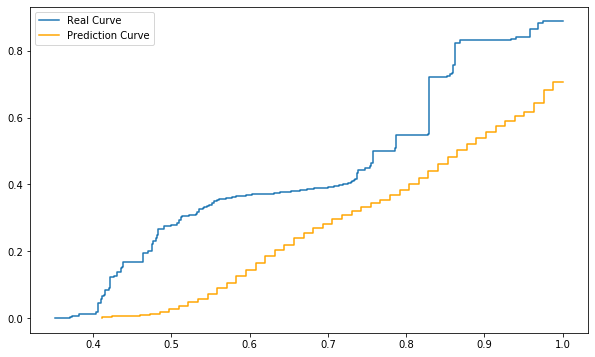

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using DNN procedure
pp1 = dnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
dnn_l1_distances.mean()

1    0.0490601299
2    0.0538256067
3    0.0566527593
4    0.0561380973
5    0.0556943271
6    0.0543075754
7    0.0478897137
8    0.0372413888
9    0.0256910788
10   0.0198513111
11   0.0179508050
12   0.0172275957
13   0.0169833703
14   0.0170722773
15   0.0170046669
16   0.0170475868
17   0.0172716432
18   0.0176080055
19   0.0181759370
20   0.0190152140
21   0.0193937952
22   0.0196337947
23   0.0201954473
24   0.0218223672
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(dnn_l1_distances.mean()) / 24, 4)

0.0297

## Analysis comparison Naive vs DNN

In [15]:
difference = naive_l1_distances.iloc[:, :25] - dnn_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-1.1442550759,-1.3749509249,-1.2570604087,-1.1531424787,-1.5559432463,-1.8449583958,-1.1405895144,-1.2648721667,-1.1573313861,-2.7258875101,...,-3.0832099048,-2.5592012130,-2.7300516896,-2.2262552261,-1.4129146404,-1.5953523336,-2.0357911792,-1.6545521784,-1.6416706670,-1.5360320739
std,3.4503273221,5.9249493910,3.1404206382,2.7180806009,12.0804526264,16.5638185224,5.6901866349,5.7854417266,5.0582838606,37.4636627656,...,12.7985395217,10.1023367167,18.2326641325,11.7430944989,5.0480397602,7.0371474701,12.5154218149,4.4859095420,4.3679146405,4.6996868810
min,-67.9488030825,-142.9742265999,-43.0810874114,-34.6511634761,-320.4627862803,-440.9139272067,-135.5727207367,-104.0635832875,-96.2612348513,-1000.1435077878,...,-161.3767571367,-162.0091764252,-415.6847805373,-181.0979934660,-63.4152028869,-135.3669457576,-311.7415025870,-56.5400723919,-56.1154608864,-64.0264492759
25%,-1.4235138781,-1.5848200405,-1.6291411426,-1.5564443025,-1.5361507550,-1.4922905120,-1.2232236861,-1.1932144168,-1.0490875176,-1.0365447662,...,-1.4852170852,-1.4625420450,-1.3436609675,-1.3189338779,-1.2371588795,-1.3860969626,-1.6723779265,-1.9019532663,-1.8056279246,-1.6370595216
50%,-0.2622224188,-0.2450669369,-0.2637254092,-0.2500941176,-0.2427678324,-0.2450256722,-0.1629528724,-0.1594204482,-0.1443117320,-0.1587692766,...,-0.2592939887,-0.2099938845,-0.2092640557,-0.1325212180,-0.1908321069,-0.2349119718,-0.3150114108,-0.3706511451,-0.3452190765,-0.3634608343
75%,0.2898706038,0.2831949522,0.3126077205,0.3017343170,0.3090363667,0.3027986065,0.3169876592,0.3224498373,0.3026279275,0.3095813298,...,0.2604089956,0.2858610964,0.2941237656,0.3245951470,0.3145549101,0.2472607623,0.2136145688,0.2134567407,0.1794696961,0.1868849787
max,0.8647754996,0.8782666682,0.8902835650,0.8685713321,0.8547993561,0.8362525131,0.8307538077,0.9156027648,0.8708800617,0.8506566738,...,0.8360684652,0.8539003173,0.9122900082,0.9455148044,0.8467185574,0.8346327097,0.7992205130,0.8014470144,0.8192728063,0.8393832474


# CNN

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)

In [ ]:
X_train.shape

(24264, 128)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)

In [ ]:
X_test.shape

(17544, 128)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Concatenate

# Build the convolutional neural network model
model = Sequential()

# Conv1D layer with 64 filters, kernel size = 3 and ReLU activation
model.add(Conv1D(filters=128, kernel_size=3, activation='relu', input_shape=(X_train.shape[1], 1)))

# Another Conv1D layer with 128 filters, kernel size = 3 and ReLU activation
model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))

# Flattening of data to connect with dense layers
model.add(Flatten())

# Dense layers
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))  # Add dropout for regularization

model.add(Dense(64, activation='relu'))
model.add(Dropout(0.1))

# Output layer with the same number of columns as y_train
model.add(Dense(y_train.shape[1]))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=1)

# Compute the predictions using the test set
predictions = model.predict(X_test)

Epoch 1/200
759/759 [==============================] - 13s 16ms/step - loss: 0.5114 - mean_absolute_error: 0.4612
Epoch 2/200
759/759 [==============================] - 12s 16ms/step - loss: 0.3619 - mean_absolute_error: 0.3794
Epoch 3/200
759/759 [==============================] - 13s 17ms/step - loss: 0.3338 - mean_absolute_error: 0.3668
Epoch 4/200
759/759 [==============================] - 14s 19ms/step - loss: 0.3018 - mean_absolute_error: 0.3493
Epoch 5/200
759/759 [==============================] - 14s 19ms/step - loss: 0.2773 - mean_absolute_error: 0.3356
Epoch 6/200
759/759 [==============================] - 15s 19ms/step - loss: 0.2537 - mean_absolute_error: 0.3220 0s - loss: 0.2537 - mean_absolute_err
Epoch 7/200
759/759 [==============================] - 14s 19ms/step - loss: 0.2402 - mean_absolute_error: 0.3126
Epoch 8/200
759/759 [==============================] - 15s 20ms/step - loss: 0.2250 - mean_absolute_error: 0.3022
Epoch 9/200
759/759 [=============================

759/759 [==============================] - 16s 21ms/step - loss: 0.0606 - mean_absolute_error: 0.1474
Epoch 142/200
759/759 [==============================] - 16s 21ms/step - loss: 0.0563 - mean_absolute_error: 0.1440
Epoch 143/200
759/759 [==============================] - 15s 20ms/step - loss: 0.0581 - mean_absolute_error: 0.1454
Epoch 144/200
759/759 [==============================] - 16s 21ms/step - loss: 0.0575 - mean_absolute_error: 0.1445
Epoch 145/200
759/759 [==============================] - 15s 20ms/step - loss: 0.0561 - mean_absolute_error: 0.1440
Epoch 146/200
759/759 [==============================] - 17s 22ms/step - loss: 0.0577 - mean_absolute_error: 0.1447
Epoch 147/200
759/759 [==============================] - 18s 23ms/step - loss: 0.0563 - mean_absolute_error: 0.1440
Epoch 148/200
759/759 [==============================] - 18s 24ms/step - loss: 0.0571 - mean_absolute_error: 0.1438
Epoch 149/200
759/759 [==============================] - 18s 24ms/step - loss: 0.0571 

In [ ]:
# Store the predictions into a dataframe
cnn_predictions = pd.DataFrame(predictions)

In [ ]:
# Loading the dataframe
cnn_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\CNN\cnn_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
cnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.3733343200,0.3573363400,0.3085689000,0.3320506500,0.4993352000,0.8014268000,1.0761261000,1.4600506000,1.8217154000,2.0762400000,...,2.7258706000,2.6922226000,2.7140460000,2.7309952000,2.7458800000,2.7684050000,2.8063955000,2.8157563000,2.8316150000,2.8537264000
1,0.2936065500,0.3115246000,0.2849514000,0.3277507400,0.4213823000,0.6455731000,0.9150965000,1.3139764000,1.7718450000,2.1198044000,...,2.7987900000,2.8094475000,2.8475103000,2.9078894000,2.9418828000,2.9632998000,2.9924588000,2.9893758000,2.9935017000,2.9955660000
2,0.3059419700,0.3296346000,0.2969801400,0.3354451400,0.4120063800,0.6039435000,0.8426558000,1.2140313000,1.6591802000,2.0148802000,...,2.8634381000,2.8630686000,2.8893864000,2.9327040000,2.9495220000,2.9589820000,2.9775622000,2.9672346000,2.9646730000,2.9638596000
3,0.3341399400,0.3590335000,0.3291216000,0.3902846000,0.5116012000,0.7506380700,1.0083101000,1.3729315000,1.7822651000,2.0823193000,...,2.8172570000,2.8232303000,2.8627730000,2.9157171000,2.9448686000,2.9635430000,2.9872956000,2.9894843000,2.9933028000,2.9993950000
4,0.3424511300,0.3728584000,0.3553201000,0.4371376300,0.6114130600,0.9261246000,1.2467574000,1.6660175000,2.1051245000,2.4037890000,...,2.9700184000,2.9498420000,2.9584220000,2.9872174000,2.9957128000,2.9921772000,3.0040183000,2.9873734000,2.9824352000,2.9815626000
5,0.4712861500,0.5394742000,0.5527625000,0.6848156000,0.9072062000,1.2518075000,1.5547142000,1.9255517000,2.2986884000,2.5516240000,...,3.1075930000,3.0569813000,3.0324767000,3.0342824000,3.0251336000,3.0036607000,3.0051737000,2.9875946000,2.9740343000,2.9753985000
6,0.3585577600,0.3783421000,0.3596542200,0.4284410200,0.5340052000,0.7531701000,0.9787971000,1.3135873000,1.7226996000,2.0438302000,...,2.8068557000,2.7908604000,2.8044052000,2.8372889000,2.8496637000,2.8597230000,2.8798060000,2.8779612000,2.8800302000,2.8899913000
7,0.0618334260,0.0426722580,0.0621157550,0.0572407730,0.0918313040,0.1983304500,0.2662471500,0.3809462200,0.4765967000,0.5861180000,...,1.7060897000,1.7094572000,1.7548704000,1.8198514000,1.8789327000,1.9660705000,2.0546043000,2.1325727000,2.2023053000,2.2692947000
8,0.0178532450,0.0050001144,0.0123333390,0.0366227440,0.0491397100,0.0667240500,0.0718417300,0.0939369600,0.1070563400,0.1039940300,...,1.4840881000,1.4424101000,1.4204711000,1.4046314000,1.3888675000,1.3864620000,1.3880163000,1.3938025000,1.3980397000,1.4115844000
9,-0.0148107670,-0.0174966040,-0.0040814170,0.0124600160,0.0135255340,0.0196763650,0.0202436670,0.0315381900,0.0397970340,0.0412646300,...,1.3851405000,1.3482395000,1.3221503000,1.2999513000,1.2747387000,1.2659725000,1.2627128000,1.2666506000,1.2703879000,1.2832150000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(cnn_predictions.shape[0]):
    for c in range(cnn_predictions.shape[1]):
        if cnn_predictions.iloc[i, c] < 0:
            cnn_predictions.iloc[i, c] = abs(cnn_predictions.iloc[i, c])

In [ ]:
for i in range(cnn_predictions.shape[0]):
    for c in range(cnn_predictions.shape[1]):
        if c < cnn_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and cnn_predictions.iloc[i, c] > cnn_predictions.iloc[i, c + 1] and cnn_predictions.iloc[i, c] > cnn_predictions.iloc[i, c + 2]:
                cnn_predictions.iloc[i, c] = cnn_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and cnn_predictions.iloc[i, c] > cnn_predictions.iloc[i, c + 1] and cnn_predictions.iloc[i, c] > cnn_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if cnn_predictions.iloc[i, c + 1] >= cnn_predictions.iloc[i, c - 1]:
                    cnn_predictions.iloc[i, c] = cnn_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if cnn_predictions.iloc[i, c + 1] < cnn_predictions.iloc[i, c - 1]:
                    cnn_predictions.iloc[i, c + 1] = cnn_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if cnn_predictions.iloc[i, c] > cnn_predictions.iloc[i, c + 1] and cnn_predictions.iloc[i, c] < cnn_predictions.iloc[i, c + 2]:
                cnn_predictions.iloc[i, c + 1] = cnn_predictions.iloc[i, c]
        if c >= cnn_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if cnn_predictions.iloc[i, c] < cnn_predictions.iloc[i, c - 1]:
                cnn_predictions.iloc[i, c] = cnn_predictions.iloc[i, c - 1]

In [ ]:
cnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.3573363400,0.3573363400,0.3573363400,0.3573363400,0.4993352000,0.8014268000,1.0761261000,1.4600506000,1.8217154000,2.0762400000,...,2.6922226000,2.6922226000,2.7140460000,2.7309952000,2.7458800000,2.7684050000,2.8063955000,2.8157563000,2.8316150000,2.8537264000
1,0.2936065500,0.3115246000,0.3115246000,0.3277507400,0.4213823000,0.6455731000,0.9150965000,1.3139764000,1.7718450000,2.1198044000,...,2.7987900000,2.8094475000,2.8475103000,2.9078894000,2.9418828000,2.9632998000,2.9924588000,2.9924588000,2.9935017000,2.9955660000
2,0.3059419700,0.3296346000,0.3296346000,0.3354451400,0.4120063800,0.6039435000,0.8426558000,1.2140313000,1.6591802000,2.0148802000,...,2.8634381000,2.8634381000,2.8893864000,2.9327040000,2.9495220000,2.9589820000,2.9672346000,2.9672346000,2.9672346000,2.9672346000
3,0.3341399400,0.3590335000,0.3590335000,0.3902846000,0.5116012000,0.7506380700,1.0083101000,1.3729315000,1.7822651000,2.0823193000,...,2.8172570000,2.8232303000,2.8627730000,2.9157171000,2.9448686000,2.9635430000,2.9872956000,2.9894843000,2.9933028000,2.9993950000
4,0.3424511300,0.3728584000,0.3728584000,0.4371376300,0.6114130600,0.9261246000,1.2467574000,1.6660175000,2.1051245000,2.4037890000,...,2.9498420000,2.9498420000,2.9584220000,2.9872174000,2.9957128000,2.9957128000,3.0040183000,3.0040183000,3.0040183000,3.0040183000
5,0.4712861500,0.5394742000,0.5527625000,0.6848156000,0.9072062000,1.2518075000,1.5547142000,1.9255517000,2.2986884000,2.5516240000,...,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000,3.1075930000
6,0.3585577600,0.3783421000,0.3783421000,0.4284410200,0.5340052000,0.7531701000,0.9787971000,1.3135873000,1.7226996000,2.0438302000,...,2.7908604000,2.7908604000,2.8044052000,2.8372889000,2.8496637000,2.8597230000,2.8798060000,2.8798060000,2.8800302000,2.8899913000
7,0.0618334260,0.0618334260,0.0621157550,0.0621157550,0.0918313040,0.1983304500,0.2662471500,0.3809462200,0.4765967000,0.5861180000,...,2.0304112000,2.0304112000,2.0304112000,2.0304112000,2.0304112000,2.0304112000,2.0546043000,2.1325727000,2.2023053000,2.2692947000
8,0.0050001144,0.0050001144,0.0123333390,0.0366227440,0.0491397100,0.0667240500,0.0718417300,0.0939369600,0.1070563400,0.1070563400,...,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000,1.7378502000
9,0.0148107670,0.0174966040,0.0174966040,0.0174966040,0.0174966040,0.0196763650,0.0202436670,0.0315381900,0.0397970340,0.0412646300,...,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000,1.5821309000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(cnn_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

cnn_predictions = cnn_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
cnn_predictions.to_csv('cnn_predictions_incremental_sin_multiplicar_2.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
cnn_predictions = cnn_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
cnn_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # Compute the prediction using CNN procedure
    pp1 = cnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    cnn_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
cnn_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.0911391888555728
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.1016419474149195
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.11103034831527842
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.12750516684067897
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.11813104098546706
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.1046415439477697
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.09290389714950353
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.11583021526364912
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.10356368662402454
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.07399732613076446
------------------------

Di

Distancia L1 (Manhattan) para la hora 1 del día 1017: 0.04687578803312317
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1017: 0.04929921905056976
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1017: 0.05567293440440496
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1017: 0.053632411299535845
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1017: 0.04568951115193215
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1017: 0.03377121982099403
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1017: 0.018993387551737576
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1017: 0.019363132189198377
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1017: 0.024695517156471475
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1017: 0.012962509527711438
--------------------

Distancia L1 (Manhattan) para la hora 3 del día 1021: 0.08442484338031297
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1021: 0.07892274968309543
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1021: 0.06463225446448069
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1021: 0.080998444369199
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1021: 0.03772072012897631
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1021: 0.028608302144388333
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1021: 0.019638419447807573
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1021: 0.019727694268075406
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1021: 0.02273777644382978
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1021: 0.030228577006744462
---------------------

Distancia L1 (Manhattan) para la hora 21 del día 1024: 0.007921631555913362
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1024: 0.010542868276008846
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1024: 0.007139965723725324
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1024: 0.02014178557776497
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1025: 0.06534072437917633
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1025: 0.08499913557303562
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1025: 0.1247081392627863
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1025: 0.11054936366035872
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1025: 0.1127486261214004
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1025: 0.13199696245763562
---------------------


Distancia L1 (Manhattan) para la hora 11 del día 1028: 0.03673994298207266
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1028: 0.03533420817971596
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1028: 0.035549711617194335
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1028: 0.045141892465556874
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1028: 0.03078947988297173
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1028: 0.0290839693635362
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1028: 0.02782775576707128
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1028: 0.020140059847455233
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1028: 0.015804119466686285
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1028: 0.011268546818149497
-----------

Distancia L1 (Manhattan) para la hora 22 del día 1031: 0.046317433785964944
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1031: 0.044461566495928286
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1031: 0.03631471364008021
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1032: 0.017729137008533076
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1032: 0.025274984126312558
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1032: 0.025114773876558215
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1032: 0.03407376125667421
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1032: 0.043294767961909314
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1032: 0.034419896205759325
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1032: 0.029330709476015286
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1037: 0.02000301481778187
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1037: 0.03005122987164981
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1037: 0.023977452703491997
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1037: 0.019256051713068763
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1037: 0.014266432737791546
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1037: 0.009248274197123388
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1037: 0.010608345313100672
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1037: 0.012909035918709726
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1037: 0.009866438019760893
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1037: 0.01365741866360327
------------


Distancia L1 (Manhattan) para la hora 7 del día 1041: 0.019701124172526355
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1041: 0.01031867503363737
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1041: 0.019065699202422678
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1041: 0.02163634559780962
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1041: 0.019060718290279707
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1041: 0.019422210384969378
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1041: 0.022728216956890562
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1041: 0.02522510544178646
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1041: 0.02637322502704781
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1041: 0.025101890382144644
------------


Distancia L1 (Manhattan) para la hora 2 del día 1046: 0.06331879065902801
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1046: 0.05281536375597317
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1046: 0.05385783629357513
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1046: 0.04337074575177156
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1046: 0.05774709763469904
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1046: 0.021902430229620025
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1046: 0.023281225110986594
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1046: 0.01608440220790367
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1046: 0.0167177167489891
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1046: 0.013774739974777067
---------------------

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1051: 0.08834656914048841
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1051: 0.08429879552413745
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1051: 0.049017163262484745
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1051: 0.07069279178683532
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1051: 0.051597515490632684
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1051: 0.028031283528596553
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1051: 0.012356171279608781
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1051: 0.008151478697255118
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1051: 0.007861845189547426
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1051: 0.0187086070

Distancia L1 (Manhattan) para la hora 18 del día 1055: 0.010089332188059495
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1055: 0.013921874940873227
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1055: 0.0165496672049833
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1055: 0.015020799292031534
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1055: 0.014903180494964167
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1055: 0.010279954323358518
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1055: 0.02530219915026992
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1056: 0.11044036300712129
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1056: 0.11685861459401983
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1056: 0.11014178767231236
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1059: 0.009236755840493096
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1059: 0.010764639833273592
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1059: 0.008973644305027544
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1059: 0.009958848111769118
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1059: 0.006672379215822756
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1059: 0.006491632611867228
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1059: 0.014312130445058045
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1059: 0.021656319972601496
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1059: 0.020625182853037605
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1059: 0.023915930815809776
------

Distancia L1 (Manhattan) para la hora 1 del día 1064: 0.04940495457948084
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1064: 0.031693563560896594
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1064: 0.05129588602551197
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1064: 0.037944236805706126
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1064: 0.04387625197274209
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1064: 0.05323522841678116
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1064: 0.036621583189155746
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1064: 0.01643736625080424
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1064: 0.0077857566078391545
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1064: 0.017766869221811817
-------------------

Distancia L1 (Manhattan) para la hora 1 del día 1069: 0.0315881032685619
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1069: 0.05688699441228335
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1069: 0.06790230185875853
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1069: 0.0673419138395199
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1069: 0.057145779328734395
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1069: 0.04278700664909092
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1069: 0.035591912885724775
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1069: 0.01667995826961366
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1069: 0.016079542140480005
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1069: 0.010830093874732261
-----------------------

Distancia L1 (Manhattan) para la hora 2 del día 1074: 0.06989558400662242
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1074: 0.07330407692389469
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1074: 0.06883929069441569
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1074: 0.05811924722660158
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1074: 0.045836331922915266
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1074: 0.07134494565911162
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1074: 0.07502402536779865
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1074: 0.0201121791372255
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1074: 0.02210297982174734
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1074: 0.021787076439314913
-----------------------

Distancia L1 (Manhattan) para la hora 18 del día 1079: 0.03237709861575901
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1079: 0.026703906160955054
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1079: 0.031984950863467594
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1079: 0.029954765931183184
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1079: 0.03476477342424052
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1079: 0.03743128435209612
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1079: 0.030469719452000055
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1080: 0.0683472838339898
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1080: 0.08134806976212948
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1080: 0.09488156347084442
----------------

Distancia L1 (Manhattan) para la hora 12 del día 1083: 0.032613052650596296
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1083: 0.032382187229262144
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1083: 0.03855789455072687
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1083: 0.034091981000530694
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1083: 0.03341139343877743
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1083: 0.025490121066146273
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1083: 0.02264284874879472
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1083: 0.026396591500402068
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1083: 0.015369219097333806
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1083: 0.013018701568543168
---------

Distancia L1 (Manhattan) para la hora 22 del día 1087: 0.00585852580697483
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1087: 0.01874824012963003
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1087: 0.02176462688766814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1088: 0.035144809722286494
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1088: 0.037004604361287774
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1088: 0.03953779493787962
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1088: 0.028346251497897677
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1088: 0.030072628487081376
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1088: 0.034496094973309244
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1088: 0.033436052230721186
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1093: 0.01588595586574107
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1093: 0.02123767754010102
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1093: 0.013917592059778572
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1093: 0.02089606936697081
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1093: 0.021529634056833426
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1093: 0.020703535521367004
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1093: 0.0160804458327822
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1093: 0.02127950541045044
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1093: 0.01795582700785231
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1093: 0.010632563911570315
-------------

Distancia L1 (Manhattan) para la hora 1 del día 1097: 0.07748702731797485
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1097: 0.11196525941132929
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1097: 0.0729216342393444
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1097: 0.08391232828818126
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1097: 0.08051325086331446
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1097: 0.08765161040588232
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1097: 0.052709945455644266
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1097: 0.05939513055481066
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1097: 0.03388841914417454
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1097: 0.05586885073595263
------------------------


Distancia L1 (Manhattan) para la hora 9 del día 1101: 0.007776088207860689
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1101: 0.009239374771320261
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1101: 0.024172073071226787
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1101: 0.014913471229733787
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1101: 0.014058649912573759
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1101: 0.013043763613885692
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1101: 0.013453181910516443
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1101: 0.011830479400331474
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1101: 0.018832226723442157
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1101: 0.020637243106262127
-------

Distancia L1 (Manhattan) para la hora 22 del día 1106: 0.009924274980747603
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1106: 0.005688709769896542
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1106: 0.010277115179896283
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1107: 0.0628984334505006
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1107: 0.03980327623804041
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1107: 0.06192064307408754
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1107: 0.047410616372292054
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1107: 0.03374537358431944
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1107: 0.024814317070566805
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1107: 0.023571662289500746
------------------

Distancia L1 (Manhattan) para la hora 7 del día 1110: 0.033559509881863674
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1110: 0.03754105943541022
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1110: 0.028995217865210636
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1110: 0.02333250178359661
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1110: 0.023061976833374756
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1110: 0.019889200139549493
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1110: 0.013750884627163267
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1110: 0.00889183729563572
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1110: 0.007805366134593275
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1110: 0.007745626531910126
------------

Distancia L1 (Manhattan) para la hora 7 del día 1115: 0.09427567321191677
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1115: 0.10386250473186755
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1115: 0.07254605229634033
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1115: 0.06021481224746278
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1115: 0.037342071773672054
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1115: 0.028912798382853648
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1115: 0.029192322101209412
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1115: 0.020671740479171384
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1115: 0.026980868807976906
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1115: 0.035645914974410116
-------------

Distancia L1 (Manhattan) para la hora 6 del día 1119: 0.1065736823839781
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1119: 0.0346065182424888
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1119: 0.043822425378126084
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1119: 0.02880887538534681
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1119: 0.034650304296340854
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1119: 0.038721901736070895
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1119: 0.03370398054263846
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1119: 0.03776090495988267
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1119: 0.046655552731746
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1119: 0.04940461227715316
---------------------

Distancia L1 (Manhattan) para la hora 20 del día 1124: 0.01391472789109132
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1124: 0.020998277291129
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1124: 0.014279087638523105
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1124: 0.011469558605867815
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1124: 0.026597735981114964
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1125: 0.02631973695256041
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1125: 0.03380399581199659
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1125: 0.02867427064114979
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1125: 0.018008345002155784
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1125: 0.01898760277963851
-------------------

Distancia L1 (Manhattan) para la hora 19 del día 1128: 0.012998988648426245
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1128: 0.011440347704171537
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1128: 0.024918712639373244
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1128: 0.032494652714061184
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1128: 0.028103981612737226
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1128: 0.03798982523322009
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1129: 0.10969092730729516
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1129: 0.08252596998171462
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1129: 0.1209967390248206
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1129: 0.1389791213388648
-----------------

Distancia L1 (Manhattan) para la hora 20 del día 1134: 0.011935527575286323
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1134: 0.027632205185895577
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1134: 0.024407799562586974
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1134: 0.024781999229105525
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1134: 0.011362352458594918
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1135: 0.05306078856871002
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1135: 0.09287332306689419
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1135: 0.08047710899237208
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1135: 0.09652420019314999
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1135: 0.12660748531797064
----------------

Distancia L1 (Manhattan) para la hora 13 del día 1139: 0.028657246916690995
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1139: 0.014704199019559511
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1139: 0.026789586778688593
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1139: 0.01708745628930141
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1139: 0.015366455034100349
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1139: 0.01543059615457062
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1139: 0.01295964325731287
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1139: 0.02151879828921777
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1139: 0.0076452520252735575
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1139: 0.02993573059466035
----------

Distancia L1 (Manhattan) para la hora 8 del día 1143: 0.01942370465865102
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1143: 0.024574810002896172
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1143: 0.01595717423716537
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1143: 0.014596374034355592
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1143: 0.01027459859571345
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1143: 0.0083759453971879
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1143: 0.008146319167166667
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1143: 0.0041476198411043805
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1143: 0.0095334770745713
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1143: 0.013891236751356803
--------------

Distancia L1 (Manhattan) para la hora 8 del día 1147: 0.02205876968232106
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1147: 0.02165103713145782
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1147: 0.023521146339888555
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1147: 0.02190656588668177
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1147: 0.020537251513630478
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1147: 0.02398564749389954
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1147: 0.024281195212403198
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1147: 0.022188995789569156
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1147: 0.020863539430085364
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1147: 0.01383680247608398
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1151: 0.01785251480475206
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1151: 0.014548183065646928
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1151: 0.010943065596568515
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1151: 0.014400277235941141
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1151: 0.024686662073278087
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1151: 0.021217239623776387
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1151: 0.023770293302311975
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1152: 0.04477068934986355
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1152: 0.07901756879522698
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1152: 0.07896856847946235
-------------

Distancia L1 (Manhattan) para la hora 1 del día 1156: 0.031130568640835403
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1156: 0.026343458641278125
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1156: 0.0322762366046484
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1156: 0.03640014302543364
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1156: 0.034102118887918434
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1156: 0.03555269916543147
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1156: 0.03497932642929709
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1156: 0.032010553692258664
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1156: 0.029356455114814592
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1156: 0.0379271222471108
----------------------

Distancia L1 (Manhattan) para la hora 14 del día 1160: 0.019211767659337485
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1160: 0.006414423894174571
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1160: 0.005693462135205433
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1160: 0.008691824246284733
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1160: 0.008924905074233179
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1160: 0.009858774172084275
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1160: 0.006951908444059552
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1160: 0.019953561341024738
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1160: 0.009196501593916686
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1160: 0.018058355418586185
------


Distancia L1 (Manhattan) para la hora 24 del día 1164: 0.029391131511373198
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1165: 0.019891600751160053
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1165: 0.02585462897440135
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1165: 0.0317222182715608
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1165: 0.024312372391606014
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1165: 0.022444075771131514
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1165: 0.024028841784809206
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1165: 0.03195338291477255
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1165: 0.03721833264230846
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1165: 0.030322498741418975
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1169: 0.05003247919490893
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1169: 0.05695287210886125
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1169: 0.05676776514809641
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1169: 0.05248363723493582
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1169: 0.05781664349312313
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1169: 0.042970507947581615
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1169: 0.040477206332270234
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1170: 0.08155741871563418
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1170: 0.09932497301618634
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1170: 0.11659557609966516
-----------------

Distancia L1 (Manhattan) para la hora 19 del día 1173: 0.02287240944756406
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1173: 0.017569371347529977
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1173: 0.009291103862208529
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1173: 0.007059626270381267
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1173: 0.004948892538436416
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1173: 0.007539071037794122
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1174: 0.03627901139648603
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1174: 0.05106072687752802
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1174: 0.05852497537142231
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1174: 0.050776559403291524
--------------

Distancia L1 (Manhattan) para la hora 8 del día 1177: 0.01283949634941084
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1177: 0.011779243219089238
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1177: 0.01485470345789535
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1177: 0.010680378199310296
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1177: 0.004309334618773443
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1177: 0.004635038371692787
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1177: 0.007408755219922091
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1177: 0.007542660532565818
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1177: 0.004302644690607933
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1177: 0.007239253330137779
----------

Distancia L1 (Manhattan) para la hora 2 del día 1182: 0.02352011255905128
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1182: 0.027358459918281706
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1182: 0.024213076682599952
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1182: 0.02396035327556716
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1182: 0.024158045387977847
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1182: 0.024296463861516994
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1182: 0.021619223410167435
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1182: 0.008983359705738311
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1182: 0.02278776419378438
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1182: 0.019213556323847934
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1186: 0.004531498771695287
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1186: 0.012137589990219478
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1186: 0.011480785226594264
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1186: 0.010727019990887753
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1186: 0.005111730198202682
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1186: 0.013335704583620846
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1186: 0.02029182245777683
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1186: 0.008363870695580373
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1186: 0.020378147589528196
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1186: 0.02352527101842413
--------

Distancia L1 (Manhattan) para la hora 1 del día 1190: 0.015829763123977995
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1190: 0.022740563220099187
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1190: 0.016930295476857905
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1190: 0.03016531554483455
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1190: 0.017919857131933913
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1190: 0.025302202792267133
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1190: 0.01678403566001342
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1190: 0.006867890015520562
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1190: 0.015400343414213615
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1190: 0.017949879340873127
-----------------

Distancia L1 (Manhattan) para la hora 1 del día 1194: 0.019456886474017252
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1194: 0.020160354312771037
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1194: 0.026739217631515495
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1194: 0.02144731634528764
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1194: 0.017674958826496844
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1194: 0.0235758222673469
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1194: 0.01726997221590431
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1194: 0.044464045487527526
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1194: 0.031951112325438784
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1194: 0.006743943094842527
-------------------

Distancia L1 (Manhattan) para la hora 24 del día 1197: 0.011825953027272627
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1198: 0.03368336535995969
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1198: 0.03524026319376941
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1198: 0.034993338822074324
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1198: 0.03240781692061161
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1198: 0.049190973832663985
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1198: 0.05243996670061813
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1198: 0.03204348693517314
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1198: 0.0327454705864807
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1198: 0.025464943568124898
----------------------

Distancia L1 (Manhattan) para la hora 17 del día 1202: 0.008860345581142199
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1202: 0.009723195699447306
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1202: 0.0039006254630150152
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1202: 0.006440545635984776
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1202: 0.007409032437530025
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1202: 0.011672187288678687
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1202: 0.004190984168364629
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1202: 0.01104370625202794
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1203: 0.018216399437221087
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1203: 0.02262924624061847
---------

Distancia L1 (Manhattan) para la hora 4 del día 1207: 0.056609934185292615
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1207: 0.03740577534613608
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1207: 0.053675640285295284
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1207: 0.060911243975832155
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1207: 0.06305312547109669
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1207: 0.02875535058932671
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1207: 0.021227566807701114
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1207: 0.01069392119938075
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1207: 0.008647157635014835
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1207: 0.013115504876264828
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1211: 0.011682839124141
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1211: 0.013491278372227874
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1211: 0.00937218358197155
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1211: 0.008076984025466138
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1211: 0.008537204718587477
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1211: 0.003801721655956934
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1211: 0.016291791308786115
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1211: 0.011609052155932493
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1211: 0.010791935564593666
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1211: 0.0077158910081638115
---------

Distancia L1 (Manhattan) para la hora 15 del día 1215: 0.007979008670091624
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1215: 0.0043089978312680095
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1215: 0.005168762594924079
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1215: 0.009788741407213378
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1215: 0.010313766321102615
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1215: 0.013865175920541997
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1215: 0.008263462559324931
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1215: 0.007931375726356575
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1215: 0.004599604707183145
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1215: 0.022804754446376408
-----

Distancia L1 (Manhattan) para la hora 24 del día 1218: 0.0076628335620156
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1219: 0.017955918801965634
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1219: 0.016479857470141034
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1219: 0.01796788538311232
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1219: 0.01818881066610316
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1219: 0.021336172937087776
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1219: 0.03275882689341515
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1219: 0.05778760522077335
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1219: 0.018828101458055083
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1219: 0.014992159094021865
---------------------

Distancia L1 (Manhattan) para la hora 1 del día 1223: 0.02616874044588058
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1223: 0.04693803193915691
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1223: 0.027362084809440947
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1223: 0.037597788243127435
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1223: 0.02722653494754161
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1223: 0.03076150767641509
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1223: 0.02851604616803069
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1223: 0.029146045159120497
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1223: 0.022418554499455255
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1223: 0.022065640441532256
--------------------

Distancia L1 (Manhattan) para la hora 1 del día 1227: 0.03413474544530518
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1227: 0.0363340008240486
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1227: 0.061269711676524105
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1227: 0.04000836534665039
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1227: 0.032795172416272445
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1227: 0.027239629927439474
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1227: 0.021069668552119003
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1227: 0.03332696776611207
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1227: 0.014897369646639916
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1227: 0.006976795468868537
--------------------

Distancia L1 (Manhattan) para la hora 1 del día 1231: 0.022234560178621136
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1231: 0.025511204323440995
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1231: 0.02303005077628892
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1231: 0.02178174472696
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1231: 0.018621857565386014
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1231: 0.020747334882954074
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1231: 0.014093499927069417
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1231: 0.00900990612614927
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1231: 0.013373241888771906
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1231: 0.010586617616459845
---------------------

Distancia L1 (Manhattan) para la hora 1 del día 1235: 0.017327986272502628
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1235: 0.029408025208467796
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1235: 0.026474919657894277
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1235: 0.028461289728085447
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1235: 0.024186597951315416
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1235: 0.02240501623142304
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1235: 0.03885488642144139
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1235: 0.030581613094885086
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1235: 0.02263311437592271
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1235: 0.017511728379315673
------------------

Distancia L1 (Manhattan) para la hora 9 del día 1239: 0.008157616754405341
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1239: 0.004834326438426156
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1239: 0.00591187177285523
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1239: 0.005389172307492228
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1239: 0.008348166082326402
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1239: 0.0042790577688152235
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1239: 0.004911239575046765
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1239: 0.006088262765040745
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1239: 0.00970639400011185
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1239: 0.00611917284403987
---------

Distancia L1 (Manhattan) para la hora 20 del día 1242: 0.019196479559884606
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1242: 0.026518426819305125
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1242: 0.0053863780764720915
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1242: 0.01016146866525603
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1242: 0.009346482856844814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1243: 0.016783092208515156
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1243: 0.015092823137118596
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1243: 0.017131606768423395
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1243: 0.01943802478399135
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1243: 0.017482221529297258
------------

Distancia L1 (Manhattan) para la hora 10 del día 1246: 0.014427154608607516
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1246: 0.02679574684162428
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1246: 0.026820729853708765
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1246: 0.02605196722587904
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1246: 0.02230043611596986
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1246: 0.023717470955409846
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1246: 0.016683351895089373
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1246: 0.017463110580764798
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1246: 0.011382436908978815
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1246: 0.007650082088489245
---------

Distancia L1 (Manhattan) para la hora 20 del día 1249: 0.019545490049383166
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1249: 0.016507401223484316
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1249: 0.006784248490738651
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1249: 0.010391766756445778
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1249: 0.011099649460257877
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1250: 0.03522826079495173
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1250: 0.02265763225098781
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1250: 0.049101441152002226
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1250: 0.041827828318517425
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1250: 0.039199400313123134
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1254: 0.004658180158271611
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1254: 0.005965485460523256
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1254: 0.007609435138945242
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1254: 0.010041582753215924
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1254: 0.00979834625885869
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1254: 0.008069136049728932
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1254: 0.005776908976335059
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1255: 0.03351900871303539
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1255: 0.04905378609836285
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1255: 0.033515455949112094
------------

Distancia L1 (Manhattan) para la hora 7 del día 1259: 0.043813503262911654
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1259: 0.014924270968507377
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1259: 0.010706702963674153
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1259: 0.008273847837342169
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1259: 0.007826007491893392
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1259: 0.009719694504391406
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1259: 0.008662816050743139
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1259: 0.011465864928694404
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1259: 0.014546975705840407
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1259: 0.020030411348599824
---------

Distancia L1 (Manhattan) para la hora 8 del día 1263: 0.015048871934755858
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1263: 0.004253775310065852
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1263: 0.008891342760447646
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1263: 0.0047839435682127856
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1263: 0.0032724012336954236
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1263: 0.0034382675084481795
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1263: 0.0058049904735380815
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1263: 0.011444006094344997
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1263: 0.01379144196961159
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1263: 0.020541341552589326
-----

Distancia L1 (Manhattan) para la hora 1 del día 1267: 0.019251598208038886
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1267: 0.013341809631760907
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1267: 0.018465109242713516
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1267: 0.017465147470662554
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1267: 0.01190312714514547
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1267: 0.026997401159387868
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1267: 0.01928683669780275
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1267: 0.01194172824610771
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1267: 0.013017810206332405
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1267: 0.016158770769529256
------------------

Distancia L1 (Manhattan) para la hora 16 del día 1270: 0.018424135174727997
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1270: 0.01596710988260978
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1270: 0.01759694218833939
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1270: 0.02083574837746357
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1270: 0.020795307199134142
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1270: 0.018837920275668395
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1270: 0.010929664381267877
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1270: 0.026651532702312353
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1270: 0.026725198022405472
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1271: 0.059421695410524465
----------

Distancia L1 (Manhattan) para la hora 7 del día 1275: 0.02311557734371758
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1275: 0.00669151289906922
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1275: 0.010806764439970678
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1275: 0.005195818514473584
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1275: 0.009919071620368074
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1275: 0.013895809323255745
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1275: 0.014684850007950155
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1275: 0.012385221619818669
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1275: 0.007479715098881248
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1275: 0.007012413209675603
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1281: 0.033826530409285946
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1281: 0.02422112472485296
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1281: 0.027148246723818235
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1281: 0.01850870411963395
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1281: 0.007443218910550859
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1281: 0.015086891299074338
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1281: 0.009310681682389094
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1281: 0.009932056833728501
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1281: 0.010356642369877368
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1281: 0.014902758557411811
----------

Distancia L1 (Manhattan) para la hora 7 del día 1286: 0.0367388104709453
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1286: 0.0230480864711829
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1286: 0.026031483979332852
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1286: 0.018496453652916436
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1286: 0.023858709068428838
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1286: 0.015978875669292875
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1286: 0.017627691647348096
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1286: 0.017268504202872154
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1286: 0.014110491752287492
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1286: 0.013428025883173598
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1289: 0.009949940387935657
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1290: 0.027124203915338194
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1290: 0.032433759683895697
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1290: 0.037963816153502666
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1290: 0.03545950593239819
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1290: 0.03473792322908297
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1290: 0.03784265977339968
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1290: 0.030265160570014115
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1290: 0.03280404484126564
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1290: 0.02173614667298606
--------------------

Distancia L1 (Manhattan) para la hora 8 del día 1295: 0.024159714750781363
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1295: 0.022251976368128566
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1295: 0.006267927754868211
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1295: 0.004700241292025778
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1295: 0.010706502188832671
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1295: 0.015099461516055675
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1295: 0.017661617547317
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1295: 0.016345920618420655
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1295: 0.021864476957700784
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1295: 0.02530988966950788
------------

Distancia L1 (Manhattan) para la hora 21 del día 1299: 0.02119631962554116
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1299: 0.008831738052409962
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1299: 0.007771360286961723
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1299: 0.01765389073622443
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1300: 0.018430995950862707
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1300: 0.05994281127584961
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1300: 0.08360620552338272
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1300: 0.06864096098825008
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1300: 0.06939728959075264
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1300: 0.09176096830925677
-------------------


Distancia L1 (Manhattan) para la hora 17 del día 1303: 0.014552147292453039
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1303: 0.009944160182009052
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1303: 0.008938235927186667
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1303: 0.008332542043722068
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1303: 0.010459013663996135
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1303: 0.011642033097552207
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1303: 0.009658930172684783
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1303: 0.006719441296334448
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1304: 0.03585437980657818
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1304: 0.02276679613348584
---------

Distancia L1 (Manhattan) para la hora 7 del día 1308: 0.07228070676619397
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1308: 0.05691749703432104
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1308: 0.04561414926910258
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1308: 0.03639827661777256
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1308: 0.033986650511728354
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1308: 0.022211595503019158
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1308: 0.011864891235923243
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1308: 0.008690734776975446
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1308: 0.009754484989098542
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1308: 0.0031949144519554623
------------

Distancia L1 (Manhattan) para la hora 15 del día 1312: 0.03737335057667962
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1312: 0.0386166477735809
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1312: 0.0432156885878828
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1312: 0.007956467973549665
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1312: 0.012363808849150807
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1312: 0.023215633871492024
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1312: 0.02548614893958609
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1312: 0.027220010347239323
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1312: 0.024611821913714235
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1312: 0.020978256281650336
------------

Distancia L1 (Manhattan) para la hora 22 del día 1317: 0.055926630284390856
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1317: 0.07339575025915726
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1317: 0.07370562078627432
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1318: 0.09330118002589685
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1318: 0.12089841313632299
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1318: 0.11269233237430751
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1318: 0.09919193090065864
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1318: 0.10649441307233333
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1318: 0.05887295354181247
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1318: 0.0827908237851929
-----------------------

Distancia L1 (Manhattan) para la hora 14 del día 1324: 0.02143924481290749
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1324: 0.023215821237423863
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1324: 0.02042242571464104
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1324: 0.018656606177216158
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1324: 0.011361923849946177
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1324: 0.004604537196630323
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1324: 0.004271926484112303
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1324: 0.007662894864615244
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1324: 0.004479045769862874
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1324: 0.0095496632563782
----------


Distancia L1 (Manhattan) para la hora 19 del día 1330: 0.01734452252261432
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1330: 0.01806311675434581
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1330: 0.01377716163732668
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1330: 0.01046324802881882
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1330: 0.010431097303637393
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1330: 0.007216311579295823
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1331: 0.05121664869377784
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1331: 0.03401123081038565
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1331: 0.05406059756641005
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1331: 0.04266658421294098
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1334: 0.016013763624114156
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1334: 0.026075797355067435
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1334: 0.027132611390873924
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1334: 0.006976323165152188
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1334: 0.006747865454448772
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1334: 0.008436249096729263
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1334: 0.010317791625464102
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1334: 0.020142800764710957
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1334: 0.02246540417359344
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1334: 0.018575164198964107
-------

Distancia L1 (Manhattan) para la hora 17 del día 1338: 0.0404667044974434
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1338: 0.03494397618684473
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1338: 0.048251738913741335
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1338: 0.048532797428358324
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1338: 0.054124232650155424
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1338: 0.04929471167543238
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1338: 0.035906531849479985
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1338: 0.028872067523899952
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1339: 0.08602769786583406
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1339: 0.11210362375884562
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1344: 0.019491511887341988
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1344: 0.013841218739147074
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1344: 0.03700414106809821
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1344: 0.03430806253868649
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1344: 0.022485679702542234
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1344: 0.022853872313052394
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1344: 0.01605391458276863
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1344: 0.010099976412763221
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1344: 0.007516072426599032
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1344: 0.00855450037717647
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1348: 0.033445570829799376
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1349: 0.02154081589980844
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1349: 0.017507125061633072
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1349: 0.05257446400003926
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1349: 0.022885167572432537
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1349: 0.025181230941160163
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1349: 0.01750015820010946
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1349: 0.03840075940032814
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1349: 0.01969221844674429
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1349: 0.00919388427392008
---------------------

Distancia L1 (Manhattan) para la hora 17 del día 1352: 0.04410496721929277
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1352: 0.05483967371613139
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1352: 0.053918812919395404
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1352: 0.04923686727610311
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1352: 0.0476019891304572
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1352: 0.04682205200841782
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1352: 0.04987720080864756
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1352: 0.05486919176405522
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1353: 0.07961122504483337
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1353: 0.10280738425227265
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1357: 0.04334370202349297
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1357: 0.04545564211724354
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1357: 0.04391475500795045
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1357: 0.038211416570825156
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1357: 0.026840050321323666
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1357: 0.029042874563869166
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1357: 0.02913248645088372
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1357: 0.045633173390362075
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1358: 0.04844283671387199
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1358: 0.09796958610626226
--------------

Distancia L1 (Manhattan) para la hora 1 del día 1364: 0.046837577320261795
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1364: 0.04386421914679328
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1364: 0.09145476288496694
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1364: 0.11218503959074126
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1364: 0.09371553935483388
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1364: 0.08656036001260298
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1364: 0.10903686176336877
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1364: 0.024134787076954697
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1364: 0.043869093202930864
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1364: 0.044652871812487595
---------------------

Distancia L1 (Manhattan) para la hora 13 del día 1367: 0.04262990719098264
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1367: 0.046098171826709104
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1367: 0.044501479379703876
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1367: 0.04425634959100072
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1367: 0.04922825455311472
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1367: 0.0472651914228026
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1367: 0.046936634439011
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1367: 0.05610478581632803
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1367: 0.05384195793868271
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1367: 0.05762522545159841
-----------------

------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1372: 0.028311200083200563
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1372: 0.027382594123749864
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1372: 0.02716788475915276
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1372: 0.015799099139286586
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1372: 0.010918039805495008
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1372: 0.010244484281002109
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1372: 0.01445578121402584
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1372: 0.016649217722270966
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1372: 0.01204503154110987
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1372: 0.01415663

Distancia L1 (Manhattan) para la hora 15 del día 1375: 0.009257715895904205
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1375: 0.010070262335129001
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1375: 0.009580619549539027
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1375: 0.01793722128858995
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1375: 0.02357365307219421
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1375: 0.019076399088285307
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1375: 0.010496515649881272
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1375: 0.010362453723896525
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1375: 0.010410431845019143
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1375: 0.00984039165913744
---------

Distancia L1 (Manhattan) para la hora 17 del día 1380: 0.010698372265212289
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1380: 0.013762154394523898
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1380: 0.014963080293363806
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1380: 0.011860642312292509
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1380: 0.015187278583048285
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1380: 0.009749124683714482
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1380: 0.009752845598825714
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1380: 0.013219697133483806
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1381: 0.04883670684888315
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1381: 0.044527346681471645
---------

Distancia L1 (Manhattan) para la hora 10 del día 1386: 0.023261495390483035
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1386: 0.022711079929315578
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1386: 0.022630227601076542
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1386: 0.033371907454998156
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1386: 0.02908937732918714
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1386: 0.029564998406083225
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1386: 0.03083791276161426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1386: 0.02616752975878847
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1386: 0.02402614837252296
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1386: 0.031668817868049065
----------

Distancia L1 (Manhattan) para la hora 20 del día 1391: 0.04051085967486672
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1391: 0.04034083283901382
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1391: 0.03966761369559434
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1391: 0.040939949804655706
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1391: 0.050858977290840324
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1392: 0.0831756286352324
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1392: 0.09066886028697488
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1392: 0.09537241934987029
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1392: 0.10130669484157635
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1392: 0.10456377097711822
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1395: 0.0073200766098571
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1395: 0.007971175410420158
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1395: 0.008186634150704737
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1395: 0.008539366313542796
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1395: 0.008852547871343978
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1395: 0.007098171622779906
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1395: 0.008300060727196377
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1395: 0.00918097549292767
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1395: 0.026890070388139363
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1395: 0.03425367833913211
----------

Distancia L1 (Manhattan) para la hora 4 del día 1399: 0.020282185285663536
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1399: 0.02440533741370969
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1399: 0.038760871220295805
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1399: 0.021056978093014253
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1399: 0.01135323594272873
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1399: 0.013507079017710436
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1399: 0.013953650383162958
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1399: 0.011148185630830896
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1399: 0.012220122813786344
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1399: 0.015557366040346325
--------------

Distancia L1 (Manhattan) para la hora 18 del día 1403: 0.006977142799497666
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1403: 0.010229514967292817
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1403: 0.02073097320757957
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1403: 0.03251021460367726
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1403: 0.018504963976198687
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1403: 0.024545392613450543
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1403: 0.038930624157029484
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1404: 0.02205978638717726
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1404: 0.031247272711809868
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1404: 0.04102545840117733
-------------

------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1407: 0.016372111782889224
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1407: 0.01288793994232767
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1407: 0.01058857768623597
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1407: 0.005694760518126241
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1407: 0.009625519762691942
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1408: 0.0370429852381601
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1408: 0.04269484912866145
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1408: 0.04491469318663788
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1408: 0.047819734474488416
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1408: 0.0284567056

Distancia L1 (Manhattan) para la hora 11 del día 1411: 0.004657519631542858
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1411: 0.009520293200076427
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1411: 0.010878528508867592
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1411: 0.011003187005899962
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1411: 0.011662147733154212
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1411: 0.011414253834434448
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1411: 0.007645915790537925
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1411: 0.004622019483140528
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1411: 0.007464362181311572
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1411: 0.011021007083289212
------

Distancia L1 (Manhattan) para la hora 9 del día 1415: 0.011863693609867868
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1415: 0.009452722731191812
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1415: 0.006020593525849723
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1415: 0.012434517517006298
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1415: 0.01959303061177283
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1415: 0.01677192746502166
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1415: 0.016117341378728778
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1415: 0.016715418918145514
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1415: 0.020970235479807697
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1415: 0.02329200927577586
----------

Distancia L1 (Manhattan) para la hora 20 del día 1418: 0.009425581262897132
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1418: 0.009396478562779231
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1418: 0.007184286745656928
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1418: 0.01051103002781004
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1418: 0.013899236514618659
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1419: 0.10319108175257036
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1419: 0.07474887944160492
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1419: 0.11232739559295953
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1419: 0.10484140036814772
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1419: 0.11781682114071818
-----------------

Distancia L1 (Manhattan) para la hora 7 del día 1423: 0.027910762636392854
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1423: 0.029724587146895128
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1423: 0.010753266217690665
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1423: 0.011794063062125633
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1423: 0.02502143124111515
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1423: 0.02445360665899965
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1423: 0.030789673058801287
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1423: 0.0274146230469188
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1423: 0.02438824211004563
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1423: 0.02863719771923946
---------------

Distancia L1 (Manhattan) para la hora 5 del día 1427: 0.035041025758876784
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1427: 0.04039982917643708
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1427: 0.05225648722874018
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1427: 0.02483927753560978
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1427: 0.0203948388728849
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1427: 0.028914308431439467
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1427: 0.034629534321050384
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1427: 0.025092546949933826
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1427: 0.0366060486165963
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1427: 0.04474805421727464
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1431: 0.020881132877372442
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1431: 0.018330001531874435
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1431: 0.04170510536309073
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1431: 0.023631663537429425
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1431: 0.033170773853214444
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1431: 0.0470599320126926
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1431: 0.03664795837954121
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1432: 0.06664595207678856
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1432: 0.09050116483463495
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1432: 0.09635947662235164
----------------

Distancia L1 (Manhattan) para la hora 10 del día 1435: 0.024932219326610928
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1435: 0.016240840638968322
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1435: 0.019590243235857344
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1435: 0.01997441572060015
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1435: 0.0206562106565927
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1435: 0.018370623130004954
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1435: 0.021894621089449742
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1435: 0.015631744696950257
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1435: 0.010854703192657255
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1435: 0.007303493775551127
---------

Distancia L1 (Manhattan) para la hora 3 del día 1439: 0.09947770989516988
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1439: 0.11443437067925465
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1439: 0.11679844963560164
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1439: 0.10135638217982403
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1439: 0.07843501472113676
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1439: 0.04305549589927721
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1439: 0.02997952440837261
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1439: 0.0165278873273183
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1439: 0.006896098807543568
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1439: 0.007552147484428362
----------------------

Distancia L1 (Manhattan) para la hora 24 del día 1442: 0.03686554277145947
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1443: 0.10384955623318286
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1443: 0.10631523210118024
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1443: 0.09802969096894124
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1443: 0.09322233767524934
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1443: 0.09596227589714852
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1443: 0.10238018516918251
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1443: 0.07907210894350299
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1443: 0.021489784901869213
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1443: 0.01830671375347514
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1447: 0.011980290348868959
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1447: 0.006864044237882484
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1447: 0.00954148907324416
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1447: 0.02157788199323907
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1447: 0.010532793585146877
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1447: 0.009011666387012401
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1447: 0.012701264605623822
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1447: 0.009435498161937571
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1448: 0.06488629115983668
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1448: 0.08919361162726452
------------

Distancia L1 (Manhattan) para la hora 7 del día 1452: 0.016836752221223092
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1452: 0.013021000136956132
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1452: 0.011315880475356444
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1452: 0.005454172247107451
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1452: 0.006008611860803486
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1452: 0.017810804892986455
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1452: 0.03036825934790774
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1452: 0.02622226676213118
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1452: 0.029941894436512854
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1452: 0.02833352316516385
------------

Distancia L1 (Manhattan) para la hora 17 del día 1455: 0.01659169433539845
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1455: 0.017785450248338445
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1455: 0.010099790831627622
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1455: 0.005873028657363545
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1455: 0.02176056061573428
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1455: 0.023060648940337526
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1455: 0.02118742536485273
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1455: 0.024527953144928387
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1456: 0.02211337851456973
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1456: 0.022164960279356362
------------

Distancia L1 (Manhattan) para la hora 14 del día 1460: 0.005676465587832423
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1460: 0.005878151771980485
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1460: 0.03363933987593123
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1460: 0.030659210891476864
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1460: 0.056699996125847196
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1460: 0.013332329357857185
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1460: 0.006789197214464713
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1460: 0.012094793055688847
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1460: 0.009848481233787527
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1460: 0.008737650277170767
-------

Distancia L1 (Manhattan) para la hora 5 del día 1465: 0.03949254584009411
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1465: 0.0266389777692621
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1465: 0.03495721093495791
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1465: 0.00805020705919925
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1465: 0.0052715611948411
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1465: 0.01002873930388435
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1465: 0.0129097452537594
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1465: 0.009762788627668748
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1465: 0.006356521507828386
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1465: 0.009487575261948588
---------------------

Distancia L1 (Manhattan) para la hora 19 del día 1468: 0.00649742635992212
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1468: 0.00900094744393658
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1468: 0.010014220922554343
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1468: 0.011986979288439698
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1468: 0.01073176534145095
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1468: 0.01289694853509354
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1469: 0.03486689716397939
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1469: 0.03966716449874083
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1469: 0.04944657922613223
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1469: 0.049961501700721084
-----------------

Distancia L1 (Manhattan) para la hora 4 del día 1472: 0.026824519545003367
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1472: 0.023378109834938845
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1472: 0.01928580137683313
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1472: 0.01803693785130399
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1472: 0.01763750762940379
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1472: 0.009301494665248967
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1472: 0.011462985955422077
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1472: 0.019065493861543156
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1472: 0.026231552158680373
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1472: 0.02629984647453034
----------------

Distancia L1 (Manhattan) para la hora 9 del día 1477: 0.009336711637443313
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1477: 0.009239651227892474
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1477: 0.010278972982155006
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1477: 0.010257383499455796
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1477: 0.013636703586618963
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1477: 0.015460256334426244
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1477: 0.014468775101318127
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1477: 0.012555816680399727
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1477: 0.009494080347469097
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1477: 0.009375581262684797
-------

Distancia L1 (Manhattan) para la hora 3 del día 1483: 0.02949237110782301
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1483: 0.01535724037732175
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1483: 0.024307237021548033
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1483: 0.02586379334795715
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1483: 0.04677986744656439
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1483: 0.047009616496560776
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1483: 0.006465023636289379
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1483: 0.006320046252277209
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1483: 0.006484240070576167
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1483: 0.019302435100941207
-----------------

Distancia L1 (Manhattan) para la hora 9 del día 1487: 0.021818699900086717
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1487: 0.019716437935834472
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1487: 0.008361498685623877
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1487: 0.00797831723976578
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1487: 0.014846436931572872
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1487: 0.01112801994126559
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1487: 0.011987876609597155
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1487: 0.020112472226390322
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1487: 0.020930277926988657
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1487: 0.034655917952219326
---------

Distancia L1 (Manhattan) para la hora 22 del día 1490: 0.019130331145916897
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1490: 0.02213583985468233
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1490: 0.02757008581319209
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1491: 0.07109010864842338
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1491: 0.10285244621504457
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1491: 0.09099464561561971
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1491: 0.11253766050770506
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1491: 0.09981732388499985
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1491: 0.08419391334478676
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1491: 0.08916660023352217
----------------------

Distancia L1 (Manhattan) para la hora 17 del día 1494: 0.011531531694361514
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1494: 0.014978282106539073
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1494: 0.013617104177120497
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1494: 0.01878124914761798
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1494: 0.01736205524042538
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1494: 0.02346215630209928
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1494: 0.024280299758739292
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1494: 0.021307936491891083
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1495: 0.1467263111292858
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1495: 0.11911958540161119
--------------

Distancia L1 (Manhattan) para la hora 24 del día 1498: 0.028935218335896497
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1499: 0.11144245436176362
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1499: 0.11139359222029004
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1499: 0.09317346099039205
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1499: 0.08584417764180458
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1499: 0.11281952810860844
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1499: 0.10609689428270613
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1499: 0.06535736240716478
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1499: 0.04904228014742128
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1499: 0.018352401849844095
-----------------------

Distancia L1 (Manhattan) para la hora 18 del día 1502: 0.031515746430760626
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1502: 0.03152154016669586
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1502: 0.02145728656247635
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1502: 0.017973877028849776
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1502: 0.009755120195811758
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1502: 0.011648935524443044
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1502: 0.012652104254096899
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1503: 0.08032229781298168
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1503: 0.0751344968384891
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1503: 0.08575368933867665
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1506: 0.017045367556610513
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1506: 0.011953969252413899
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1506: 0.009040282099124042
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1506: 0.011690477080120307
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1506: 0.02459486102901739
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1506: 0.032712020171045436
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1506: 0.02679597763545711
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1506: 0.023300386240607762
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1506: 0.023556654629924997
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1506: 0.023559298184824263
----------

Distancia L1 (Manhattan) para la hora 9 del día 1510: 0.025881304026039456
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1510: 0.019780983330691
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1510: 0.016868004758412207
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1510: 0.018833036816936374
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1510: 0.02046295463282826
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1510: 0.019792127007694574
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1510: 0.019908743265254335
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1510: 0.023179214045180183
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1510: 0.019461034746626096
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1510: 0.014907467399911577
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1514: 0.03431948723170977
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1514: 0.009170469096815154
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1514: 0.005422350422024042
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1514: 0.003503432066599592
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1514: 0.005720874402098177
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1514: 0.008727485605212422
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1514: 0.013016300929805068
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1514: 0.0053988568656878864
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1514: 0.004143685997940015
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1514: 0.0029776485534107654
-------

Distancia L1 (Manhattan) para la hora 8 del día 1518: 0.08153807576794171
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1518: 0.025116330648495843
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1518: 0.014493152724540943
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1518: 0.007291610365408964
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1518: 0.006545087627481927
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1518: 0.006990079227963671
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1518: 0.0058368714196446216
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1518: 0.0056569184524856275
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1518: 0.00701337470957774
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1518: 0.006251728104494911
--------

Distancia L1 (Manhattan) para la hora 9 del día 1522: 0.03090751528187072
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1522: 0.04311229200804981
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1522: 0.03350323830740916
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1522: 0.022947078967108115
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1522: 0.0258300380367634
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1522: 0.020634815803116976
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1522: 0.024275613739969473
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1522: 0.022648095472623857
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1522: 0.019340125420960492
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1522: 0.022374039573307997
------------

Distancia L1 (Manhattan) para la hora 8 del día 1526: 0.031966295257577625
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1526: 0.013417381232919818
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1526: 0.007752337667709121
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1526: 0.004063012322366437
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1526: 0.00860099436209496
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1526: 0.012949533803263856
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1526: 0.005913095612881213
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1526: 0.010409012021004423
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1526: 0.00854459158978153
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1526: 0.00523194112314608
-----------

Distancia L1 (Manhattan) para la hora 21 del día 1530: 0.010634207681332625
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1530: 0.014824211123996575
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1530: 0.01426285786066053
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1530: 0.014753327384689218
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1531: 0.03460191360475865
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1531: 0.0480970707994494
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1531: 0.042582542391144326
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1531: 0.07402053368145274
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1531: 0.06647485355480603
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1531: 0.04800254018332854
-------------------

Distancia L1 (Manhattan) para la hora 9 del día 1534: 0.017538146778770268
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1534: 0.006849405681759899
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1534: 0.008440473018305746
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1534: 0.013420997720113563
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1534: 0.010850227297095042
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1534: 0.010711986291926481
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1534: 0.007205468918253051
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1534: 0.0072748848825245
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1534: 0.012404143192043134
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1534: 0.00955801787430299
----------

Distancia L1 (Manhattan) para la hora 11 del día 1538: 0.022484370347838983
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1538: 0.02394910729512948
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1538: 0.02760094109631378
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1538: 0.02704003479998672
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1538: 0.027716755790779212
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1538: 0.024796991851230295
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1538: 0.025329763339138195
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1538: 0.018765790344711916
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1538: 0.0171280235363127
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1538: 0.015903179507514624
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1543: 0.06429600356916343
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1543: 0.03033957563069648
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1543: 0.01644233390716263
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1543: 0.00868634437605837
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1543: 0.008589835382163565
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1543: 0.011469674995459077
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1543: 0.010555290797067157
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1543: 0.0040728558026770865
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1543: 0.006774307094068411
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1543: 0.005060241760104717
----------

Distancia L1 (Manhattan) para la hora 9 del día 1548: 0.020680818501761865
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1548: 0.010873482374255289
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1548: 0.008975197039992975
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1548: 0.01068448494880647
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1548: 0.010517903088060271
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1548: 0.008250864110602017
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1548: 0.009797992298197427
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1548: 0.006243013367666871
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1548: 0.00523472389987326
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1548: 0.004870973987496162
---------

Distancia L1 (Manhattan) para la hora 20 del día 1551: 0.027437219800569054
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1551: 0.01992518122207025
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1551: 0.021670032728602004
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1551: 0.01993623350275208
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1551: 0.026390621397959783
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1552: 0.03849562388523753
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1552: 0.03450069348364783
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1552: 0.04608683516600874
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1552: 0.03595731325611206
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1552: 0.05519922873889611
------------------

Distancia L1 (Manhattan) para la hora 8 del día 1556: 0.04582463340200585
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1556: 0.027007338922066366
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1556: 0.020452416915023516
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1556: 0.025492428504150597
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1556: 0.022579670990719586
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1556: 0.02510274843747231
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1556: 0.03130427281587792
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1556: 0.027658738045530144
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1556: 0.02424645434455474
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1556: 0.02067515398927566
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1561: 0.016859150624345006
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1561: 0.019102171013903317
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1561: 0.023503921091068164
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1561: 0.020156819563180155
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1561: 0.015111597701041677
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1561: 0.019054959479859128
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1561: 0.019968407010201035
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1561: 0.020663565339994448
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1562: 0.028093370835269707
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1562: 0.024338593394414344
--------

Distancia L1 (Manhattan) para la hora 6 del día 1565: 0.04898327002928762
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1565: 0.04512357642222252
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1565: 0.046371551224935456
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1565: 0.030556959078244537
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1565: 0.047058862158515305
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1565: 0.04433002953186331
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1565: 0.03893734221658757
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1565: 0.043872789513813654
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1565: 0.032173976483879915
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1565: 0.0379729107703268
----------------

Distancia L1 (Manhattan) para la hora 24 del día 1570: 0.010935605727765018
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1571: 0.030196774621256847
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1571: 0.035119849647610085
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1571: 0.0460716793681997
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1571: 0.05113017791010148
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1571: 0.06234977230343978
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1571: 0.06344978929911005
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1571: 0.0653416344486667
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1571: 0.06436666787095018
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1571: 0.05214299435072854
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1576: 0.04945370101697421
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1576: 0.05435300091884873
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1576: 0.05937102796696317
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1576: 0.0541248993903767
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1576: 0.04455859536887644
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1576: 0.043766390431773
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1576: 0.0512594217958906
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1576: 0.04976999227310704
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1576: 0.04312480061489702
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1576: 0.04564177939993235
--------------------

Distancia L1 (Manhattan) para la hora 8 del día 1580: 0.02490711126804298
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1580: 0.02450783558122708
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1580: 0.01562679358480069
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1580: 0.012923183817818467
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1580: 0.02016572492083342
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1580: 0.022659317748815643
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1580: 0.02696035102001257
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1580: 0.026379357032128008
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1580: 0.024333997080949524
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1580: 0.023048308220241877
-------------

Distancia L1 (Manhattan) para la hora 8 del día 1585: 0.040076387489046586
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1585: 0.017823130892355654
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1585: 0.009882340509767346
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1585: 0.008242301563987076
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1585: 0.004732991298050247
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1585: 0.00839321841986675
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1585: 0.009317446174186273
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1585: 0.012464745552771257
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1585: 0.010973404061067922
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1585: 0.005302925861198019
---------

Distancia L1 (Manhattan) para la hora 1 del día 1589: 0.02300519642703948
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1589: 0.030186213853154013
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1589: 0.03789375601475847
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1589: 0.054973328644277605
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1589: 0.0623454876497716
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1589: 0.03555966681298264
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1589: 0.02378285426315039
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1589: 0.019413838315695108
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1589: 0.02192036775507019
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1589: 0.008422086578045405
----------------------

Distancia L1 (Manhattan) para la hora 13 del día 1592: 0.038860482705184815
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1592: 0.03650943383432531
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1592: 0.03408629834149465
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1592: 0.03489709250191071
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1592: 0.03481348101361967
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1592: 0.02986699094276271
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1592: 0.028292219834166507
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1592: 0.024292752180188525
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1592: 0.02053224462877878
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1592: 0.011005017110140784
------------

Distancia L1 (Manhattan) para la hora 24 del día 1596: 0.011088537507758992
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1597: 0.0218703407217207
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1597: 0.01697455226881296
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1597: 0.021403253605072947
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1597: 0.024960497750224332
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1597: 0.03172226785241851
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1597: 0.026731119032107734
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1597: 0.022034031634261105
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1597: 0.02267035445444144
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1597: 0.020743334267750862
--------------------

Distancia L1 (Manhattan) para la hora 23 del día 1600: 0.012982787740253764
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1600: 0.011882982456295068
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1601: 0.016799315008385246
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1601: 0.031204584286206427
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1601: 0.02334359605454857
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1601: 0.029374456480536593
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1601: 0.02603158672522269
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1601: 0.0341253191015182
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1601: 0.01366225553747076
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1601: 0.015870230839882576
-------------------

Distancia L1 (Manhattan) para la hora 24 del día 1604: 0.01137178716583392
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1605: 0.029073691057021206
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1605: 0.021418225447938612
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1605: 0.031040975977342913
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1605: 0.02401885849064835
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1605: 0.02885609198339181
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1605: 0.02677201415440108
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1605: 0.01952078881149151
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1605: 0.016970892348555464
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1605: 0.018623257697261298
--------------------

Distancia L1 (Manhattan) para la hora 12 del día 1608: 0.005678631256152936
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1608: 0.004373168762615955
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1608: 0.0038879375605392254
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1608: 0.004593612985168916
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1608: 0.0059375308048992695
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1608: 0.004350392009413974
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1608: 0.003751178433925446
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1608: 0.005378019792088648
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1608: 0.010857132117529093
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1608: 0.014601529141277525
----

Distancia L1 (Manhattan) para la hora 20 del día 1612: 0.005011497486916643
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1612: 0.005270720919359365
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1612: 0.00611461078691955
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1612: 0.011365414648307554
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1612: 0.016267253909183738
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1613: 0.05517232477906489
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1613: 0.05787764422555236
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1613: 0.06258295884746672
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1613: 0.0730080980156001
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1613: 0.06975051217865223
------------------

Distancia L1 (Manhattan) para la hora 8 del día 1616: 0.03860729775212136
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1616: 0.029188614779981022
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1616: 0.0097336218019196
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1616: 0.005663762244754443
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1616: 0.006989270746090831
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1616: 0.0055238549191995055
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1616: 0.0028234264326026624
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1616: 0.00333445681094306
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1616: 0.006887511394989589
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1616: 0.005269192249881087
----------

Distancia L1 (Manhattan) para la hora 18 del día 1619: 0.03744914407081319
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1619: 0.02683512368653552
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1619: 0.019553132394139344
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1619: 0.018553777526362593
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1619: 0.023432867645029314
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1619: 0.023050968235931335
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1619: 0.017723019501269796
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1620: 0.039732620273649766
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1620: 0.03288441282616715
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1620: 0.03990931914629188
-------------

Distancia L1 (Manhattan) para la hora 14 del día 1623: 0.013323141661651187
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1623: 0.010375206075869198
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1623: 0.007782074506199061
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1623: 0.007242369867577775
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1623: 0.004831257833766007
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1623: 0.008268432520242727
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1623: 0.0040720062278130405
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1623: 0.004191918958185263
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1623: 0.00373508606036936
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1623: 0.005345551972097452
------

Distancia L1 (Manhattan) para la hora 7 del día 1627: 0.042320269462862825
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1627: 0.029118880622591044
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1627: 0.006843878634762552
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1627: 0.00424698970403052
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1627: 0.01374611171809053
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1627: 0.01636106866471364
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1627: 0.014986934938271409
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1627: 0.012873122936647016
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1627: 0.013994394367499005
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1627: 0.0073355299916129536
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1630: 0.004153051688967396
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1630: 0.005145217079422612
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1630: 0.006853140152129612
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1630: 0.005455994287381899
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1630: 0.009258656493569706
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1630: 0.010701141886691629
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1630: 0.013603409908093545
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1630: 0.004362215649908288
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1630: 0.015567375346573233
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1631: 0.028957402151742584
-------

Distancia L1 (Manhattan) para la hora 12 del día 1634: 0.00916651518502622
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1634: 0.009264541109520595
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1634: 0.007984434898351527
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1634: 0.007738633129819815
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1634: 0.007479687378526698
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1634: 0.00683199880568129
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1634: 0.004310121839459625
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1634: 0.005383676822196907
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1634: 0.007501050439274116
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1634: 0.005628114713151845
--------

Distancia L1 (Manhattan) para la hora 19 del día 1638: 0.01194179894811955
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1638: 0.0062588615691914
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1638: 0.006749556635973802
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1638: 0.014439720712594077
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1638: 0.014673749896585537
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1638: 0.015071785001272072
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1639: 0.03616620514108332
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1639: 0.04649297915235632
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1639: 0.039629683408914367
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1639: 0.045653986354490333
---------------

Distancia L1 (Manhattan) para la hora 6 del día 1643: 0.021870213328861982
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1643: 0.03831369044868566
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1643: 0.011784236790535795
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1643: 0.018628858356838807
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1643: 0.028418004683145762
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1643: 0.011589150240849316
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1643: 0.013967934946373124
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1643: 0.008325542464896064
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1643: 0.009677181842497037
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1643: 0.013981851952420653
-----------

Distancia L1 (Manhattan) para la hora 23 del día 1647: 0.06021382354309283
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1647: 0.08687368866492827
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1648: 0.17278246879648199
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1648: 0.16424434812315242
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1648: 0.17661347762059548
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1648: 0.1708399256838142
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1648: 0.15854291716014907
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1648: 0.1540919299982303
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1648: 0.11394989227385874
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1648: 0.07677927236459287
------------------------



Distancia L1 (Manhattan) para la hora 24 del día 1651: 0.042742082306081064
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1652: 0.025832962396727128
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1652: 0.04327288580792356
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1652: 0.0487746577747439
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1652: 0.04080802945984162
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1652: 0.04945407744188956
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1652: 0.04983834923569347
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1652: 0.02595345553516829
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1652: 0.011509497184645476
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1652: 0.013569907966585186
----------------------

Distancia L1 (Manhattan) para la hora 13 del día 1655: 0.04316905057514302
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1655: 0.04718508750769317
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1655: 0.04244682037704112
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1655: 0.040887632677596056
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1655: 0.04399177028377659
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1655: 0.046278352818987734
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1655: 0.031138468500879504
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1655: 0.03831423885012735
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1655: 0.03649532275523424
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1655: 0.033631109135998524
------------

Distancia L1 (Manhattan) para la hora 9 del día 1659: 0.057981955472873735
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1659: 0.0397606859902381
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1659: 0.02619516259100483
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1659: 0.018291917825300087
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1659: 0.007173253277864167
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1659: 0.010974314010733899
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1659: 0.013517153609750874
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1659: 0.017295711632519334
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1659: 0.016923706712414367
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1659: 0.024624528626697714
----------

Distancia L1 (Manhattan) para la hora 23 del día 1663: 0.01880518735175605
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1663: 0.011543846373462088
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1664: 0.108261394601682
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1664: 0.11985850129774844
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1664: 0.1379665456909191
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1664: 0.12481254683167516
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1664: 0.11468277448805536
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1664: 0.10645931307415067
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1664: 0.03487432567898209
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1664: 0.01241497590381816
------------------------



Distancia L1 (Manhattan) para la hora 10 del día 1668: 0.025932663605785618
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1668: 0.014743648589194525
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1668: 0.008919011273897569
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1668: 0.009202004938445054
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1668: 0.019949293331758964
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1668: 0.013013223025754571
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1668: 0.007215918359893244
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1668: 0.004106048363148835
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1668: 0.01632647302620134
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1668: 0.030442207387471103
-------

Distancia L1 (Manhattan) para la hora 10 del día 1672: 0.008792210573840328
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1672: 0.010670860219961718
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1672: 0.006836576267463028
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1672: 0.003311932518243462
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1672: 0.007038044072523904
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1672: 0.004716471287335615
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1672: 0.0036826693993950834
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1672: 0.008034045416383282
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1672: 0.003914039191365237
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1672: 0.011199059315398115
-----

Distancia L1 (Manhattan) para la hora 23 del día 1675: 0.015967524396618485
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1675: 0.025009566129130075
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1676: 0.14004324629803702
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1676: 0.14399466017961465
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1676: 0.1428385014749757
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1676: 0.11848941001323313
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1676: 0.1301898823198604
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1676: 0.13600671586661178
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1676: 0.11336289263869931
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1676: 0.033319271376885624
-----------------------

Distancia L1 (Manhattan) para la hora 22 del día 1679: 0.023398835454699774
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1679: 0.023287673694119933
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1679: 0.03661648836399904
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1680: 0.0731324816592392
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1680: 0.07258329237536092
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1680: 0.1026138505317337
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1680: 0.12747046350108082
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1680: 0.1256080883806242
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1680: 0.11151514641249587
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1680: 0.08015966382169318
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1683: 0.03255001163997587
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1683: 0.032413829266355755
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1683: 0.022466466319224
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1683: 0.016919735389001204
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1683: 0.030418163775354248
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1684: 0.06991536033868388
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1684: 0.06992380309421692
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1684: 0.06727146291509903
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1684: 0.05909224073440198
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1684: 0.07539434751551724
--------------------

Distancia L1 (Manhattan) para la hora 15 del día 1688: 0.024147305772441802
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1688: 0.026675728174780602
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1688: 0.01787354234127929
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1688: 0.028392982333035614
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1688: 0.0481564671350497
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1688: 0.04289444173987144
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1688: 0.02500924077888028
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1688: 0.01921290062489172
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1688: 0.02157704484878016
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1688: 0.044052274884451556
-------------

Distancia L1 (Manhattan) para la hora 3 del día 1692: 0.09672233544138359
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1692: 0.10328704585219042
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1692: 0.09190409766374442
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1692: 0.082981712078861
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1692: 0.06502151051276964
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1692: 0.04654832310405998
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1692: 0.043655100134808486
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1692: 0.017507693336344787
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1692: 0.017380854375698133
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1692: 0.006732217069318627
---------------------

Distancia L1 (Manhattan) para la hora 10 del día 1696: 0.006426225194978496
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1696: 0.013843725646613476
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1696: 0.012406588296542526
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1696: 0.009988510439238138
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1696: 0.01703355751732334
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1696: 0.01825609174965567
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1696: 0.0243843112286235
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1696: 0.013908503431256969
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1696: 0.017625008449237464
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1696: 0.015291618400164434
----------

Distancia L1 (Manhattan) para la hora 23 del día 1700: 0.019051966670849435
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1700: 0.02681019789728125
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1701: 0.08594468702315289
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1701: 0.08376085247053419
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1701: 0.09174334410076887
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1701: 0.08292562843323358
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1701: 0.06221251959456667
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1701: 0.02904782185124463
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1701: 0.028289716145837054
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1701: 0.06605507045874148
----------------------

Distancia L1 (Manhattan) para la hora 18 del día 1704: 0.041427127875715765
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1704: 0.03806274830437846
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1704: 0.023092145891011343
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1704: 0.02433725227990937
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1704: 0.024895110808779333
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1704: 0.038589961914379745
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1704: 0.05131907146172959
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1705: 0.09775907947696841
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1705: 0.09596598493356928
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1705: 0.0818562284241676
----------------

Distancia L1 (Manhattan) para la hora 11 del día 1708: 0.025349326474254086
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1708: 0.02146052041684176
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1708: 0.014109218146638899
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1708: 0.01071611834887404
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1708: 0.004727523830355535
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1708: 0.005494136370251926
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1708: 0.006941710303479108
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1708: 0.02073653030929824
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1708: 0.019089432103364168
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1708: 0.016986008079707817
---------

Distancia L1 (Manhattan) para la hora 10 del día 1712: 0.03773235770176735
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1712: 0.02811530864148984
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1712: 0.03823399622437634
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1712: 0.05247555744509563
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1712: 0.04040349550296242
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1712: 0.03110262915890036
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1712: 0.024927763429253236
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1712: 0.02927720696366457
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1712: 0.028745886041046782
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1712: 0.04660864588224703
--------------


Distancia L1 (Manhattan) para la hora 17 del día 1716: 0.028327847913542252
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1716: 0.02674175437409458
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1716: 0.02478578556363873
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1716: 0.010366738376296123
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1716: 0.009247721855218473
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1716: 0.01424492023730525
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1716: 0.054064685122546696
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1716: 0.031315745300358466
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1717: 0.08720487425919494
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1717: 0.10163961175798722
------------

Distancia L1 (Manhattan) para la hora 10 del día 1725: 0.020717306122923003
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1725: 0.013039901156292399
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1725: 0.008859535671087299
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1725: 0.009204627322177673
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1725: 0.02167802306421012
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1725: 0.013132289887423652
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1725: 0.02369993648756064
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1725: 0.02128543536162924
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1725: 0.026863719808876727
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1725: 0.02311071904273548
----------

Distancia L1 (Manhattan) para la hora 10 del día 1732: 0.02849397598309624
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1732: 0.031904894702945
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1732: 0.02412768135850467
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1732: 0.01714552080809329
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1732: 0.007558132120477439
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1732: 0.02324592105646311
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1732: 0.010887386421189409
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1732: 0.009556382899105145
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1732: 0.00880770368775774
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1732: 0.008685053865585036
--------------

Distancia L1 (Manhattan) para la hora 24 del día 1735: 0.033654906737618395
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1736: 0.09403963119547268
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1736: 0.11082670112685324
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1736: 0.11723817646803504
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1736: 0.0968073607068303
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1736: 0.10421128850580433
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1736: 0.11250154582910034
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1736: 0.0830048701994439
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1736: 0.1103514225604043
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1736: 0.05856446159617934
------------------------

D

Distancia L1 (Manhattan) para la hora 11 del día 1740: 0.057425733139635456
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1740: 0.03739647102917956
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1740: 0.04284848451431336
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1740: 0.03416923810238792
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1740: 0.03186433357469542
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1740: 0.035716723340554674
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1740: 0.042979384303742735
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1740: 0.04685950914593241
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1740: 0.0485790389589343
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1740: 0.04990311909020866
--------------

In [ ]:
# Save data
cnn_l1_distances.to_csv('cnn_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading data
cnn_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\CNN\cnn_l1_distances_scaled_final_2_qq_desv_incremental.csv')

In [ ]:
cnn_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0911391889,0.1016419474,0.1110303483,0.1275051668,0.1181310410,0.1046415439,0.0929038971,0.1158302153,0.1035636866,0.0739973261,...,0.0415602000,0.0452654909,0.0420535229,0.0474768126,0.0332922272,0.0350126575,0.0278082013,0.0206635861,0.0212661063,0.0192344927
1,0.0462867869,0.0188236028,0.0305236404,0.0506054615,0.0576759728,0.0578723573,0.0498059296,0.0599824911,0.0466075625,0.0607844576,...,0.0566801763,0.0570527650,0.0552945812,0.0378126518,0.0273810234,0.0372416843,0.0455840624,0.0414757048,0.0409559506,0.0404387010
2,0.0434667551,0.0343791979,0.0285996475,0.0356087854,0.0297886080,0.0278892359,0.0267707728,0.0172153607,0.0119569832,0.0090965312,...,0.0080715183,0.0120003985,0.0149618573,0.0149956057,0.0152534638,0.0153024581,0.0108866205,0.0075767226,0.0069623837,0.0131952639
3,0.0284366278,0.0261965080,0.0262924638,0.0268318199,0.0286208693,0.0269976079,0.0168084696,0.0245918269,0.0056110823,0.0080959296,...,0.0031100022,0.0031588902,0.0054304072,0.0121540122,0.0185679842,0.0103423535,0.0153980377,0.0053308446,0.0122473421,0.0142167073
4,0.0468757880,0.0492992191,0.0556729344,0.0536324113,0.0456895112,0.0337712198,0.0189933876,0.0193631322,0.0246955172,0.0129625095,...,0.0387159737,0.0363274496,0.0332473607,0.0331645585,0.0370503080,0.0378595472,0.0362325930,0.0478955795,0.0448716523,0.0508184983
5,0.0862268037,0.0851171623,0.0823120881,0.1300635082,0.1217136705,0.1283575833,0.0833517855,0.0584663914,0.0310023305,0.0211066858,...,0.0271442410,0.0325244099,0.0323783896,0.0512178315,0.0265909074,0.0330644407,0.0463689865,0.0347017631,0.0290239729,0.0479939361
6,0.0502046564,0.0280829743,0.0430272237,0.0444840310,0.0437484502,0.0362988887,0.0243608814,0.0331590487,0.0139181870,0.0170081255,...,0.0136479081,0.0137240165,0.0233575563,0.0204174099,0.0144088648,0.0126632758,0.0244379372,0.0314274420,0.0263395392,0.0279159597
7,0.0734356003,0.0595932114,0.0663904355,0.0679238083,0.0815107383,0.0876951745,0.0837788573,0.0726124098,0.0756450341,0.0394022092,...,0.0445420080,0.0514580718,0.0487659923,0.0380224637,0.0529321187,0.0346920153,0.0411995366,0.0411002086,0.0449283590,0.0564262704
8,0.0577065255,0.0678512525,0.0844248434,0.0789227497,0.0646322545,0.0809984444,0.0377207201,0.0286083021,0.0196384194,0.0197276943,...,0.0387339743,0.0465234039,0.0470791019,0.0415224572,0.0168163508,0.0249125075,0.0381059438,0.0448858465,0.0320268305,0.0342804934
9,0.0775093369,0.0680417594,0.0604726710,0.0857058467,0.0926713692,0.0779920154,0.0753580341,0.0487122630,0.0522981873,0.0411328443,...,0.0542938284,0.0440818941,0.0419060384,0.0441195053,0.0385541978,0.0430229658,0.0458651313,0.0359451884,0.0427254346,0.0339316301


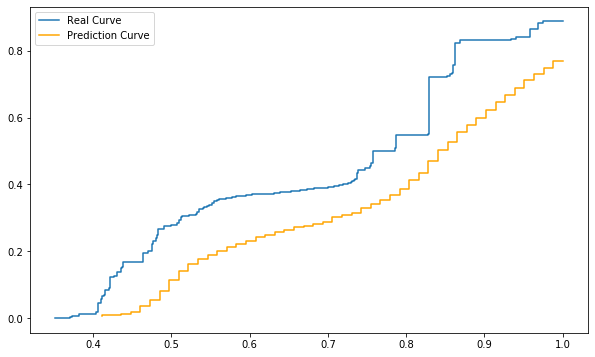

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using CNN procedure
pp1 = cnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
cnn_l1_distances.mean()

1    0.0495841760
2    0.0547041382
3    0.0576263532
4    0.0578443347
5    0.0585816035
6    0.0566405773
7    0.0468571716
8    0.0359225584
9    0.0262740937
10   0.0209803246
11   0.0185853847
12   0.0184674353
13   0.0188483749
14   0.0186080191
15   0.0185292075
16   0.0183708634
17   0.0182666812
18   0.0190540090
19   0.0188249927
20   0.0194288608
21   0.0196970546
22   0.0193668181
23   0.0194801174
24   0.0223735146
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(cnn_l1_distances.mean()) / 24, 4)

0.0305

## Analysis comparison Naive vs CNN

In [23]:
difference = naive_l1_distances.iloc[:, :25] - cnn_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-1.2937393452,-1.6231435571,-1.4792816290,-1.4766625831,-1.8499790255,-2.0512054741,-1.2730816414,-1.3558501040,-1.4559399413,-2.7601164842,...,-4.0466399885,-3.2582161213,-3.0266812485,-2.9485894010,-1.6976990450,-1.8722548685,-2.2615055816,-1.7302353120,-1.6530682128,-1.5995640071
std,3.2995963780,7.0490513923,3.3264985118,3.3894438746,10.5608690885,15.0086480418,6.4566321328,8.7611571173,7.0561534464,30.8195695673,...,18.1833534383,13.1257930827,16.7068294447,21.5239931871,6.2984922045,8.5746266066,14.7361942532,4.8755899115,4.6799171436,4.4084224044
min,-40.4191410797,-173.4836437287,-32.9075971914,-36.0810836295,-271.3553319359,-394.9454870994,-132.8157411011,-219.4801681835,-131.9846394323,-806.0367612359,...,-280.2349167727,-190.3586729714,-336.6394477402,-533.1664522865,-106.1004340988,-152.7575518296,-374.3826712700,-67.0951564286,-59.2239672851,-66.7979461687
25%,-1.6566653660,-1.8684230059,-1.8502990617,-1.9732893009,-1.7981993675,-1.8894125031,-1.1844251891,-1.3430757558,-1.2764919756,-1.2961221956,...,-1.9875570328,-1.8513090690,-1.7174530646,-1.6262734933,-1.4047450118,-1.5595966423,-1.7188605823,-1.6700678709,-1.6557021456,-1.5664631640
50%,-0.2424394102,-0.3040321250,-0.3221410356,-0.2786112218,-0.3165398972,-0.3413189362,-0.1550139812,-0.1293826252,-0.1986690490,-0.1712993852,...,-0.3149975482,-0.2876353507,-0.2549003000,-0.2364703030,-0.1796833311,-0.2733788635,-0.3010632543,-0.3517425432,-0.3131967622,-0.3669534609
75%,0.2666453849,0.2873908943,0.2989782769,0.2996829281,0.2634754231,0.2906985732,0.3313714342,0.3587461988,0.3742598040,0.3278479017,...,0.2423853344,0.2648059800,0.2869517945,0.3209264429,0.3203796972,0.2794633305,0.2354257360,0.2709293774,0.2586869043,0.2175420025
max,0.8532072470,0.8713653555,0.8697753499,0.8734788592,0.8842178216,0.8673928231,0.8176638591,0.9053066281,0.9656709674,0.9174622043,...,0.8848713378,0.8574338094,0.9262999765,0.8685262385,0.8499564703,0.8984586830,0.8762923228,0.8547238546,0.8430128740,0.8650623787


# LSTM

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1) # Reshape data due to the input structure required

In [ ]:
X_train.shape

(24264, 128, 1)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1) # Reshape data due to the input structure required

In [ ]:
X_test.shape

(17544, 128, 1)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

model = Sequential()
# Add the first LSTM layer and dropout regularization
model.add(LSTM(units=64, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model.add(Dropout(0.1))

# Add the second LSTM layer and dropout regularization
model.add(LSTM(units=128, return_sequences=True))
model.add(Dropout(0.1))

# Add the third LSTM layer and dropout regularization
model.add(LSTM(units=64))
model.add(Dropout(0.1))

# Dense layers
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))  # Add dropout for regularization

model.add(Dense(64, activation='relu'))
model.add(Dropout(0.1))

# Output layer with the same number of columns as y_train
model.add(Dense(y_train.shape[1]))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=1)

# Compute the predictions using the test set
predictions = model.predict(X_test)

Epoch 1/200
759/759 [==============================] - 214s 275ms/step - loss: 0.7901 - mean_absolute_error: 0.6080
Epoch 2/200
759/759 [==============================] - 219s 289ms/step - loss: 0.4571 - mean_absolute_error: 0.4302
Epoch 3/200
759/759 [==============================] - 226s 298ms/step - loss: 0.4201 - mean_absolute_error: 0.4024
Epoch 4/200
759/759 [==============================] - 207s 272ms/step - loss: 0.4093 - mean_absolute_error: 0.3928
Epoch 5/200
759/759 [==============================] - 203s 267ms/step - loss: 0.3989 - mean_absolute_error: 0.3862
Epoch 6/200
759/759 [==============================] - 201s 264ms/step - loss: 0.3901 - mean_absolute_error: 0.3794
Epoch 7/200
759/759 [==============================] - 228s 300ms/step - loss: 0.3899 - mean_absolute_error: 0.3783
Epoch 8/200
759/759 [==============================] - 205s 270ms/step - loss: 0.3856 - mean_absolute_error: 0.3739
Epoch 9/200
759/759 [==============================] - 197s 260ms/step -

759/759 [==============================] - 200s 264ms/step - loss: 0.0756 - mean_absolute_error: 0.1647
Epoch 72/200
759/759 [==============================] - 205s 269ms/step - loss: 0.0760 - mean_absolute_error: 0.1647
Epoch 73/200
759/759 [==============================] - 210s 276ms/step - loss: 0.0745 - mean_absolute_error: 0.1626
Epoch 74/200
759/759 [==============================] - 207s 272ms/step - loss: 0.0763 - mean_absolute_error: 0.1640
Epoch 75/200
759/759 [==============================] - 209s 275ms/step - loss: 0.0707 - mean_absolute_error: 0.1589
Epoch 76/200
759/759 [==============================] - 207s 272ms/step - loss: 0.0708 - mean_absolute_error: 0.1594
Epoch 77/200
759/759 [==============================] - 206s 271ms/step - loss: 0.0719 - mean_absolute_error: 0.1596
Epoch 78/200
759/759 [==============================] - 206s 272ms/step - loss: 0.0704 - mean_absolute_error: 0.1584
Epoch 79/200
759/759 [==============================] - 200s 264ms/step - los

In [ ]:
# Store the predictions into a dataframe
lstm_predictions = pd.DataFrame(predictions)

In [ ]:
# Loading the dataframe
lstm_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\LSTM\lstm_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
lstm_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.2623003400,0.3072145300,0.3603537000,0.3732674400,0.3887747800,0.5148227000,0.6710142500,0.8957571400,1.3308454000,1.8051245000,...,3.2171040000,3.3055778000,3.3376360000,3.3897681000,3.3845105000,3.3646640000,3.3354168000,3.3158640000,3.2827650000,3.2690930000
1,1.2759111000,1.7818205000,2.7283676000,3.4391096000,4.0458546000,4.4474480000,4.5440235000,4.4503546000,4.3263407000,4.1499540000,...,3.9187436000,3.8227825000,3.7141213000,3.6752390000,3.5840306000,3.5318100000,3.5032606000,3.4692330000,3.4448843000,3.4227982000
2,0.2225378300,0.2701082200,0.3528455500,0.4195397200,0.4527440700,0.5214541600,0.5462077000,0.5745088500,0.7622662000,1.0204313000,...,3.4987988000,3.5419097000,3.5218568000,3.5100900000,3.4803863000,3.4450580000,3.4119496000,3.3938804000,3.3724308000,3.3456550000
3,0.2191507400,0.2657262700,0.3428313000,0.4047244800,0.4334721000,0.5078067000,0.5525743400,0.6193617000,0.8670932000,1.1911085000,...,3.5977573000,3.6271348000,3.5951767000,3.5767200000,3.5372605000,3.4964356000,3.4587846000,3.4362512000,3.4092240000,3.3816729000
4,0.6028343000,0.7047201400,0.8384579400,0.9953660400,1.3495291000,1.9402040000,2.4926374000,2.9308536000,3.3141537000,3.4928863000,...,3.8613615000,3.7882300000,3.6967692000,3.6735172000,3.5876350000,3.5346112000,3.4854054000,3.4400000000,3.3934030000,3.3682504000
5,0.9218986000,1.0676930000,1.5578039000,2.0914052000,2.7975857000,3.4949489000,3.8964130000,4.0738783000,4.1696630000,4.1165943000,...,3.9187217000,3.8175268000,3.7093920000,3.6757233000,3.5789266000,3.5235758000,3.4846940000,3.4435740000,3.4051533000,3.3838778000
6,0.3726912400,0.4464715400,0.5624086000,0.5899999000,0.6613545000,0.9251966500,1.2649939000,1.6528740000,2.1621096000,2.5641768000,...,3.1942130000,3.2697515000,3.3046398000,3.3807745000,3.3749413000,3.3612990000,3.3348885000,3.3078480000,3.2676720000,3.2533927000
7,0.0430664200,0.0731636100,0.1204716600,0.1582621500,0.1656366000,0.1909139600,0.1922206900,0.1704235500,0.2163464100,0.2642703700,...,1.9446274000,1.9172566000,1.8729650000,1.8679397000,1.8634744000,1.8722112000,1.9047992000,1.9521198000,2.0063932000,2.0645460000
8,0.0270896650,0.0303545610,0.0705353600,0.0895962600,0.1017168240,0.1074576200,0.1070641800,0.0861136000,0.1122767700,0.1322625000,...,1.6339161000,1.6049824000,1.5723565000,1.5595193000,1.5329894000,1.5128517000,1.5024252000,1.5017165000,1.5068150000,1.5178652000
9,0.0324944480,0.0394269000,0.0756587000,0.0916547300,0.1014873460,0.1080152900,0.1082372440,0.0891588100,0.1143153400,0.1341788200,...,1.5846231000,1.5578407000,1.5272818000,1.5166806000,1.4919238000,1.4718479000,1.4620224000,1.4616605000,1.4644098000,1.4745617000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(lstm_predictions.shape[0]):
    for c in range(lstm_predictions.shape[1]):
        if lstm_predictions.iloc[i, c] < 0:
            lstm_predictions.iloc[i, c] = abs(lstm_predictions.iloc[i, c])

In [ ]:
for i in range(lstm_predictions.shape[0]):
    for c in range(lstm_predictions.shape[1]):
        if c < lstm_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and lstm_predictions.iloc[i, c] > lstm_predictions.iloc[i, c + 1] and lstm_predictions.iloc[i, c] > lstm_predictions.iloc[i, c + 2]:
                lstm_predictions.iloc[i, c] = lstm_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and lstm_predictions.iloc[i, c] > lstm_predictions.iloc[i, c + 1] and lstm_predictions.iloc[i, c] > lstm_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if lstm_predictions.iloc[i, c + 1] >= lstm_predictions.iloc[i, c - 1]:
                    lstm_predictions.iloc[i, c] = lstm_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if lstm_predictions.iloc[i, c + 1] < lstm_predictions.iloc[i, c - 1]:
                    lstm_predictions.iloc[i, c + 1] = lstm_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if lstm_predictions.iloc[i, c] > lstm_predictions.iloc[i, c + 1] and lstm_predictions.iloc[i, c] < lstm_predictions.iloc[i, c + 2]:
                lstm_predictions.iloc[i, c + 1] = lstm_predictions.iloc[i, c]
        if c >= lstm_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if lstm_predictions.iloc[i, c] < lstm_predictions.iloc[i, c - 1]:
                lstm_predictions.iloc[i, c] = lstm_predictions.iloc[i, c - 1]

In [ ]:
lstm_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,0.2623003400,0.3072145300,0.3603537000,0.3732674400,0.3887747800,0.5148227000,0.6710142500,0.8957571400,1.3308454000,1.8051245000,...,3.2171040000,3.3055778000,3.3376360000,3.3845105000,3.3845105000,3.3845105000,3.3845105000,3.3845105000,3.3845105000,3.3845105000
1,1.2759111000,1.7818205000,2.7283676000,3.4391096000,4.0458546000,4.4474480000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,...,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000,4.4503546000
2,0.2225378300,0.2701082200,0.3528455500,0.4195397200,0.4527440700,0.5214541600,0.5462077000,0.5745088500,0.7622662000,1.0204313000,...,3.4987988000,3.5218568000,3.5218568000,3.5218568000,3.5218568000,3.5218568000,3.5218568000,3.5218568000,3.5218568000,3.5218568000
3,0.2191507400,0.2657262700,0.3428313000,0.4047244800,0.4334721000,0.5078067000,0.5525743400,0.6193617000,0.8670932000,1.1911085000,...,3.5977573000,3.6271348000,3.6271348000,3.6271348000,3.6271348000,3.6271348000,3.6271348000,3.6271348000,3.6271348000,3.6271348000
4,0.6028343000,0.7047201400,0.8384579400,0.9953660400,1.3495291000,1.9402040000,2.4926374000,2.9308536000,3.3141537000,3.4928863000,...,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000,3.8976421000
5,0.9218986000,1.0676930000,1.5578039000,2.0914052000,2.7975857000,3.4949489000,3.8964130000,4.0738783000,4.1165943000,4.1165943000,...,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000,4.1165943000
6,0.3726912400,0.4464715400,0.5624086000,0.5899999000,0.6613545000,0.9251966500,1.2649939000,1.6528740000,2.1621096000,2.5641768000,...,3.1942130000,3.2697515000,3.3046398000,3.3749413000,3.3749413000,3.3749413000,3.3749413000,3.3749413000,3.3749413000,3.3749413000
7,0.0430664200,0.0731636100,0.1204716600,0.1582621500,0.1656366000,0.1909139600,0.1922206900,0.1922206900,0.2163464100,0.2642703700,...,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000,2.4766684000
8,0.0270896650,0.0303545610,0.0705353600,0.0895962600,0.1017168240,0.1070641800,0.1070641800,0.1070641800,0.1122767700,0.1322625000,...,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000,2.0822515000
9,0.0324944480,0.0394269000,0.0756587000,0.0916547300,0.1014873460,0.1080152900,0.1082372440,0.1082372440,0.1143153400,0.1341788200,...,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000,2.0271080000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(lstm_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

lstm_predictions = lstm_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
lstm_predictions.to_csv('lstm_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
lstm_predictions = lstm_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
lstm_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # Compute the prediction using LSTM procedure
    pp1 = lstm_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    lstm_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
lstm_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.0514256339363918
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.024312819569227838
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.08082053328133958
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.08473450684388922
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.05658136346123531
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.04141362645580127
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.05644891245572289
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.09339526743645019
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.08422462825887295
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.043872796448257846
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1018: 0.006352178748328253
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1018: 0.012099791892201353
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1018: 0.012637073993085465
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1018: 0.006230772887245878
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1018: 0.005883920687862025
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1018: 0.007733759907477144
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1018: 0.010890352139242256
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1018: 0.010293513736210692
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1018: 0.008540841514560062
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1018: 0.01049619954155643
--------

Distancia L1 (Manhattan) para la hora 12 del día 1022: 0.02534669067514255
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1022: 0.043135323214327115
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1022: 0.039108357329426365
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1022: 0.036921977131873424
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1022: 0.035662721411006036
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1022: 0.03920189531089688
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1022: 0.053097964133549544
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1022: 0.047023228414073914
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1022: 0.03968399468111686
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1022: 0.022558454951463573
---------

Distancia L1 (Manhattan) para la hora 19 del día 1026: 0.011823851640419939
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1026: 0.00980380687659701
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1026: 0.01147411735376925
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1026: 0.013254718522474255
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1026: 0.005981452201587342
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1026: 0.007605132351182289
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1027: 0.02062852396544455
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1027: 0.019989421012620363
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1027: 0.016937271249845367
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1027: 0.01759088200253122
--------------

Distancia L1 (Manhattan) para la hora 14 del día 1030: 0.04290066126231854
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1030: 0.026527991785610106
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1030: 0.03890045923148986
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1030: 0.037557895874501264
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1030: 0.030680031135529855
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1030: 0.007344422587871596
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1030: 0.019529628712453742
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1030: 0.018084689967548785
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1030: 0.005835580738495514
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1030: 0.016673572120601943
--------

Distancia L1 (Manhattan) para la hora 21 del día 1034: 0.06623114491951909
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1034: 0.05524111560993348
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1034: 0.055220564587718235
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1034: 0.07409125835870355
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1035: 0.10770459721117095
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1035: 0.12028828379780226
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1035: 0.12500630510196392
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1035: 0.14734067395620382
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1035: 0.14954152547551536
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1035: 0.12967502104844292
---------------------

Distancia L1 (Manhattan) para la hora 3 del día 1039: 0.00983921915332331
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1039: 0.01688644353357231
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1039: 0.06579390691922907
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1039: 0.10330025341658289
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1039: 0.14043280271554234
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1039: 0.09070935009035386
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1039: 0.06590745514082039
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1039: 0.04598920704518661
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1039: 0.05708370290008505
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1039: 0.048779732561349494
----------------------

Distancia L1 (Manhattan) para la hora 2 del día 1044: 0.04383246431538969
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1044: 0.042432006637975084
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1044: 0.05495583801890964
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1044: 0.06062726882032815
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1044: 0.038076679967953976
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1044: 0.04900967690809349
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1044: 0.05257256596682944
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1044: 0.03638530205414119
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1044: 0.027416707071386513
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1044: 0.013268826658063563
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1048: 0.008295004551542843
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1048: 0.004186858025549557
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1048: 0.013521951405369194
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1048: 0.01431811614889036
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1048: 0.011638273351586566
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1048: 0.02444069464140408
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1048: 0.032613662347592276
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1048: 0.017706770603346442
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1048: 0.03020660819462277
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1048: 0.02877353940799149
----------

Distancia L1 (Manhattan) para la hora 23 del día 1052: 0.005434213249934004
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1052: 0.009654986958684705
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1053: 0.07633111078117039
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1053: 0.09998385868980873
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1053: 0.10073924925595917
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1053: 0.13163453639884437
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1053: 0.13897521335703972
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1053: 0.13121341501161812
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1053: 0.12293457180075743
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1053: 0.08460394576819802
----------------------

Distancia L1 (Manhattan) para la hora 6 del día 1058: 0.026635798090026683
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1058: 0.011373360129294928
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1058: 0.040271391765271315
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1058: 0.025627719928767924
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1058: 0.003492096400021836
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1058: 0.008929235287042276
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1058: 0.016584675389788046
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1058: 0.012248881446625483
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1058: 0.006443562885654968
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1058: 0.01379613096886994
-----------

Distancia L1 (Manhattan) para la hora 10 del día 1062: 0.05269205110384961
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1062: 0.04058490739767286
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1062: 0.030552769112134084
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1062: 0.036499508160504505
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1062: 0.029808863334806795
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1062: 0.026814746510259467
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1062: 0.02869053572002274
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1062: 0.030571660000316317
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1062: 0.032834143956406846
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1062: 0.02198844460032766
----------

Distancia L1 (Manhattan) para la hora 18 del día 1066: 0.05653762923572704
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1066: 0.042020715353897314
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1066: 0.03231881482994205
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1066: 0.02325242916653075
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1066: 0.026473796689527058
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1066: 0.026750259836278135
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1066: 0.011674211938271901
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1067: 0.03061796355299281
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1067: 0.03560672218690692
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1067: 0.024682362996144416
--------------

Distancia L1 (Manhattan) para la hora 6 del día 1071: 0.040863941465832825
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1071: 0.017673423447698313
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1071: 0.026718044489483804
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1071: 0.0062618430580405615
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1071: 0.007355695661351689
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1071: 0.01153849390470061
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1071: 0.012664889138971635
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1071: 0.00883512505938049
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1071: 0.004977972789348892
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1071: 0.006492327922927394
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1075: 0.02912956123211194
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1075: 0.022410800107425972
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1075: 0.026414017450154058
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1075: 0.006220271273954844
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1075: 0.005219204946122645
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1075: 0.006712438344051939
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1075: 0.031741228092581
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1075: 0.03276132190188832
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1075: 0.028600863870130215
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1075: 0.020557551283660727
-------------

Distancia L1 (Manhattan) para la hora 12 del día 1079: 0.03469596181247109
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1079: 0.03965548711053195
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1079: 0.031162599901286343
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1079: 0.033057786966588766
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1079: 0.026041341877774744
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1079: 0.0332538163151477
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1079: 0.017005074463149028
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1079: 0.012651150707360299
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1079: 0.020322711696005233
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1079: 0.010043419384062795
----------

------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1083: 0.0283730517512183
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1083: 0.0370111835648138
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1083: 0.035236514672997744
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1084: 0.11064387460718672
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1084: 0.12319102530516104
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1084: 0.13005890449686025
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1084: 0.12698612363364326
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1084: 0.12113217160243098
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1084: 0.13120477503494232
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1084: 0.1014721133933351

Distancia L1 (Manhattan) para la hora 24 del día 1087: 0.008901451772426319
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1088: 0.018297732640498394
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1088: 0.050520565876310916
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1088: 0.07561559543849271
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1088: 0.08691193165245618
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1088: 0.07899277436901453
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1088: 0.046981538476980465
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1088: 0.024074087311933418
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1088: 0.017615162104624143
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1088: 0.025538627059616653
------------------

Distancia L1 (Manhattan) para la hora 5 del día 1092: 0.024329202760248147
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1092: 0.03546693310148538
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1092: 0.017094163888296883
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1092: 0.01009387773013758
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1092: 0.005326861675189334
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1092: 0.0051824350680040095
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1092: 0.004089965389449841
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1092: 0.009639179012488827
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1092: 0.014154242772556483
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1092: 0.009269649386666034
------------

Distancia L1 (Manhattan) para la hora 5 del día 1096: 0.0920165892036473
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1096: 0.0576766453069218
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1096: 0.04123818704445717
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1096: 0.08953478217578556
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1096: 0.0439990735565802
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1096: 0.0512283153818448
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1096: 0.03897113310259906
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1096: 0.03401875551041356
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1096: 0.02931725139021587
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1096: 0.02828101631121109
------------------------


Distancia L1 (Manhattan) para la hora 7 del día 1100: 0.03055611563397468
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1100: 0.0197057239905407
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1100: 0.011146274072480125
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1100: 0.008575747730866928
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1100: 0.006270126762601604
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1100: 0.010264650190523115
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1100: 0.013162426701618865
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1100: 0.007946993735648184
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1100: 0.008791419068196627
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1100: 0.010197377093613728
------------

Distancia L1 (Manhattan) para la hora 23 del día 1103: 0.05229692708522364
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1103: 0.057099280365129845
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1104: 0.083845846253672
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1104: 0.05415209421152452
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1104: 0.054356453701941185
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1104: 0.06063660176827799
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1104: 0.050865382967075504
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1104: 0.0436001110590927
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1104: 0.016492127883295585
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1104: 0.02444603367294014
-----------------------

Distancia L1 (Manhattan) para la hora 17 del día 1108: 0.02984302868624144
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1108: 0.016236665146420574
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1108: 0.004206253979820408
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1108: 0.007361015965862574
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1108: 0.006629610977293648
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1108: 0.006922758172427505
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1108: 0.01390251305275661
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1108: 0.01580672395936154
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1109: 0.025603551043959026
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1109: 0.035025650495819446
-----------

Distancia L1 (Manhattan) para la hora 21 del día 1112: 0.02637753842678638
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1112: 0.027665325094960017
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1112: 0.030211102171877932
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1112: 0.0301141342220563
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1113: 0.012640895814513942
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1113: 0.038050391883850676
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1113: 0.0274587580974918
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1113: 0.02857491648046397
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1113: 0.05909618710333844
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1113: 0.043852691575041014
-------------------

Distancia L1 (Manhattan) para la hora 20 del día 1116: 0.03320020922814884
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1116: 0.05676498997190177
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1116: 0.05898906633918994
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1116: 0.046292798853753925
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1116: 0.03138441042392874
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1117: 0.05840958191560581
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1117: 0.06143865562201739
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1117: 0.05105180396758881
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1117: 0.04187787416286847
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1117: 0.02898188591050912
--------------------

Distancia L1 (Manhattan) para la hora 14 del día 1120: 0.03921326322596452
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1120: 0.0349620401756303
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1120: 0.023308177890189137
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1120: 0.022777410131011783
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1120: 0.019882520897861848
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1120: 0.020974588718600688
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1120: 0.034261125922617486
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1120: 0.024150768398760195
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1120: 0.025165488847909118
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1120: 0.02312928771519316
----------

Distancia L1 (Manhattan) para la hora 22 del día 1124: 0.025400314800090033
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1124: 0.028361214035009755
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1124: 0.02056998442404742
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1125: 0.015363662143635992
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1125: 0.01275843869988315
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1125: 0.016735059648024325
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1125: 0.028548509813079465
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1125: 0.031523314920583065
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1125: 0.03347283906166139
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1125: 0.05944553546607548
-----------------

Distancia L1 (Manhattan) para la hora 9 del día 1129: 0.02165666623577097
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1129: 0.020814499177910773
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1129: 0.019236964643760176
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1129: 0.014966041022631126
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1129: 0.015010515032062749
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1129: 0.010779740882667017
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1129: 0.017453620526514387
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1129: 0.02287384353154293
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1129: 0.019264626425822585
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1129: 0.019722368754529953
---------

Distancia L1 (Manhattan) para la hora 6 del día 1133: 0.05620586475650416
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1133: 0.0684888385653741
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1133: 0.08376900631001909
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1133: 0.0445981481742051
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1133: 0.03322030980547299
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1133: 0.0306240169822307
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1133: 0.015160865666093131
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1133: 0.015831081086446687
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1133: 0.005601330044820552
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1133: 0.013825483817132741
-------------------

Distancia L1 (Manhattan) para la hora 3 del día 1137: 0.07897571277442852
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1137: 0.07929326992106295
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1137: 0.08797048801713662
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1137: 0.0630884165847527
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1137: 0.0600873202547406
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1137: 0.03245717883322039
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1137: 0.03860132974456022
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1137: 0.014237844122841813
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1137: 0.008947353708338011
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1137: 0.0045746976231031715
---------------------

Distancia L1 (Manhattan) para la hora 18 del día 1140: 0.05374142535037833
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1140: 0.045280261227468845
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1140: 0.036439294716750906
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1140: 0.02621145487803649
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1140: 0.025083143758106094
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1140: 0.025852860436242728
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1140: 0.02264309335155615
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1141: 0.03217273801843702
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1141: 0.02455333762949647
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1141: 0.029291504658110517
--------------

Distancia L1 (Manhattan) para la hora 19 del día 1145: 0.01986035693579929
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1145: 0.012046457736047737
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1145: 0.023171643359982057
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1145: 0.014391348419155306
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1145: 0.015297315744034463
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1145: 0.032473056612242396
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1146: 0.0362879569527015
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1146: 0.07822008228234947
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1146: 0.047123886334251006
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1146: 0.03958993275833253
---------------

Distancia L1 (Manhattan) para la hora 18 del día 1150: 0.01489534093298542
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1150: 0.016421958939569624
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1150: 0.0315361997716528
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1150: 0.017111716292419595
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1150: 0.028323527083546095
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1150: 0.04049542498373718
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1150: 0.04024771390782861
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1151: 0.1033953302132225
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1151: 0.11493415413482086
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1151: 0.1313732994979532
-------------------

Distancia L1 (Manhattan) para la hora 4 del día 1154: 0.03923549450833672
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1154: 0.028215479817888817
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1154: 0.03878233339361868
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1154: 0.022663001155891663
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1154: 0.022969400557973967
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1154: 0.019658176468016722
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1154: 0.01746589643431114
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1154: 0.013093862742667203
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1154: 0.00980462558610417
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1154: 0.005064033188276254
----------------

Distancia L1 (Manhattan) para la hora 16 del día 1157: 0.004254481076966322
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1157: 0.007539092835547908
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1157: 0.005817945733862245
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1157: 0.005499535467455218
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1157: 0.005009320251880412
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1157: 0.003961064199970811
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1157: 0.00677890333636451
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1157: 0.011708450602016375
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1157: 0.004671590018432113
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1158: 0.015401358964523972
--------

Distancia L1 (Manhattan) para la hora 10 del día 1161: 0.02928391652841942
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1161: 0.013645424585627298
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1161: 0.024314732316980753
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1161: 0.0196771348605315
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1161: 0.019288485612502407
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1161: 0.016595285849452683
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1161: 0.017244879942168646
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1161: 0.0225602996801985
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1161: 0.02058720373396151
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1161: 0.03420154442368342
-------------

Distancia L1 (Manhattan) para la hora 4 del día 1165: 0.08386538378972701
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1165: 0.06037072528317511
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1165: 0.06234941793132444
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1165: 0.02601562247464599
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1165: 0.022386503514993637
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1165: 0.04280075427425538
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1165: 0.0060875592128700595
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1165: 0.008709767316157347
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1165: 0.006854651522869851
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1165: 0.004771205592802338
----------------

Distancia L1 (Manhattan) para la hora 1 del día 1169: 0.022114797954237604
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1169: 0.03171285892006303
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1169: 0.03047126467808335
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1169: 0.0315706776938039
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1169: 0.032401992269400076
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1169: 0.08546499367137153
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1169: 0.04521266263127324
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1169: 0.023802870484977336
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1169: 0.007989988174115982
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1169: 0.015800412601012094
---------------------

Distancia L1 (Manhattan) para la hora 3 del día 1174: 0.01725640369527908
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1174: 0.042199136265845594
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1174: 0.03268129613725103
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1174: 0.03589841482029034
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1174: 0.016402555864489295
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1174: 0.01730708633549259
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1174: 0.006011577080604865
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1174: 0.012634959851776015
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1174: 0.019147519974491534
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1174: 0.016739774719136503
-----------------

Distancia L1 (Manhattan) para la hora 21 del día 1177: 0.006228518617243618
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1177: 0.0035130090830459613
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1177: 0.00682116042383306
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1177: 0.0075249780564071896
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1178: 0.04487572796615705
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1178: 0.019800147182906125
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1178: 0.04692033192070725
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1178: 0.018314065488961702
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1178: 0.019934732231673184
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1178: 0.022222477105713415
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1181: 0.005296708121371474
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1181: 0.005699383312330517
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1181: 0.014753515148624285
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1181: 0.014931134203229706
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1181: 0.01821531319419458
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1181: 0.01085376112397806
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1181: 0.017093151671640765
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1181: 0.017228040061976653
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1181: 0.027807248801171802
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1181: 0.031138907434024997
--------

Distancia L1 (Manhattan) para la hora 7 del día 1185: 0.08005684602462279
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1185: 0.044584035598073266
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1185: 0.01872694472362251
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1185: 0.009965918932467264
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1185: 0.004711897154359102
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1185: 0.004256866239599833
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1185: 0.01842174159056176
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1185: 0.008348313291944737
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1185: 0.0064892901283279915
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1185: 0.013962601271779906
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1188: 0.02053642355431614
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1188: 0.02903180451046166
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1188: 0.015491707113595871
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1188: 0.0115635037228315
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1188: 0.011966195463069196
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1188: 0.006089239166879101
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1188: 0.009308073515397038
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1188: 0.006807045927646099
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1188: 0.011301911824465983
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1189: 0.031713564105662756
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1193: 0.02723160338813023
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1193: 0.01529010129693068
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1193: 0.031047969569632017
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1193: 0.01652311400627627
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1193: 0.01737131399303967
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1193: 0.02522796649140697
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1193: 0.03530975789738833
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1193: 0.023185379047467036
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1193: 0.03700054890403876
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1193: 0.011531080093744437
----------------------

Distancia L1 (Manhattan) para la hora 1 del día 1197: 0.05632574713441294
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1197: 0.025234605187276996
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1197: 0.04012336689805726
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1197: 0.036000570699465495
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1197: 0.03362958714959319
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1197: 0.025132975406919236
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1197: 0.009458543581782029
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1197: 0.013109311271537558
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1197: 0.00977376376522029
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1197: 0.019217526374474457
-------------------

Distancia L1 (Manhattan) para la hora 14 del día 1200: 0.06700591718034184
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1200: 0.06726068299764941
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1200: 0.05787083212013572
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1200: 0.020976879704001427
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1200: 0.030803090473102264
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1200: 0.023487983717561424
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1200: 0.040730152425899765
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1200: 0.030382077350457684
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1200: 0.013805440959496694
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1200: 0.004428145911844569
---------

Distancia L1 (Manhattan) para la hora 4 del día 1204: 0.01940655854161108
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1204: 0.019553716478647364
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1204: 0.014266312628350084
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1204: 0.014638257364323861
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1204: 0.023286539121252996
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1204: 0.014042922701553242
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1204: 0.01720892091162544
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1204: 0.012516402382677682
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1204: 0.006677787739656809
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1204: 0.0061621449368373165
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1207: 0.013193227147569134
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1207: 0.014147926408358378
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1207: 0.008154662299831344
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1207: 0.0102513998715614
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1207: 0.023855982961071394
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1207: 0.038093324248206245
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1207: 0.0344505722509653
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1207: 0.031560266196420626
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1208: 0.01916286389854467
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1208: 0.05785592084384633
--------------

Distancia L1 (Manhattan) para la hora 23 del día 1211: 0.02504253539377417
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1211: 0.013761511529684725
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1212: 0.017761287057936746
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1212: 0.014735561926636134
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1212: 0.023215007483239968
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1212: 0.022201798717575213
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1212: 0.027781139867107698
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1212: 0.03453780540845569
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1212: 0.016749006387779302
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1212: 0.03404630952447009
-----------------

Distancia L1 (Manhattan) para la hora 5 del día 1216: 0.025158452731887535
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1216: 0.02869198106311499
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1216: 0.031403188664013065
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1216: 0.005865170925368394
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1216: 0.010485116830943917
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1216: 0.004105499945152111
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1216: 0.010042622468512482
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1216: 0.004248047981633229
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1216: 0.009933102205106601
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1216: 0.012884675635122666
------------

Distancia L1 (Manhattan) para la hora 19 del día 1221: 0.009262659828067198
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1221: 0.009910114948590714
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1221: 0.019879830099282885
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1221: 0.019099188265590743
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1221: 0.017878209278358648
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1221: 0.022836660302407413
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1222: 0.036449177937807664
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1222: 0.017729443927726764
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1222: 0.018772521116461417
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1222: 0.015073113526843753
----------

Distancia L1 (Manhattan) para la hora 5 del día 1225: 0.019970715325068472
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1225: 0.030491857250203307
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1225: 0.04428740675756469
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1225: 0.010721570544032055
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1225: 0.011164191499822923
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1225: 0.008277881927031487
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1225: 0.006881197027094122
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1225: 0.009666444910871637
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1225: 0.009478196571952585
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1225: 0.00996369801644869
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1228: 0.01634716194767858
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1228: 0.008474852963928177
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1228: 0.010540404504448667
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1228: 0.02280412281168051
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1228: 0.02804059103629321
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1228: 0.028190422136750274
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1229: 0.030532450147104984
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1229: 0.030214891579930202
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1229: 0.04418786945332273
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1229: 0.050041621447721965
--------------

Distancia L1 (Manhattan) para la hora 8 del día 1232: 0.01951441985113196
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1232: 0.005513016515907326
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1232: 0.009293012758801084
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1232: 0.01686035551993991
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1232: 0.024528917116549323
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1232: 0.02307422370808538
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1232: 0.025861223722767168
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1232: 0.02756292340273124
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1232: 0.02827844887920094
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1232: 0.02925357020362713
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1237: 0.00706855100629793
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1237: 0.006022533184659069
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1237: 0.004612781641383632
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1237: 0.004848429056179761
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1237: 0.007904048199305794
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1237: 0.00784335843399457
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1237: 0.008914313726403002
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1237: 0.005612133306711608
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1237: 0.00971632667701212
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1237: 0.004759173079484137
---------

Distancia L1 (Manhattan) para la hora 7 del día 1241: 0.023460456491208724
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1241: 0.012236547980050807
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1241: 0.05327362975244012
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1241: 0.007234878809276011
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1241: 0.015184268858826521
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1241: 0.004977395064656829
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1241: 0.004138350674181578
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1241: 0.0070373316464619855
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1241: 0.005600093892642485
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1241: 0.0059330499688055325
--------

Distancia L1 (Manhattan) para la hora 14 del día 1246: 0.016938640427390142
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1246: 0.013358920992670187
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1246: 0.017734347325979644
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1246: 0.008953011260911305
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1246: 0.005572521402390134
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1246: 0.004767372376946856
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1246: 0.011995815552678243
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1246: 0.008782034279859999
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1246: 0.0044725382858416835
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1246: 0.0047751046491319475
----

Distancia L1 (Manhattan) para la hora 11 del día 1250: 0.0066891062252942435
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1250: 0.007360196341156599
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1250: 0.018508723029841124
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1250: 0.023229313228018883
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1250: 0.019266045595893087
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1250: 0.012376222489098322
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1250: 0.009602890790846278
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1250: 0.005656945854818363
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1250: 0.006723063149134902
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1250: 0.007767998462349254
-----

Distancia L1 (Manhattan) para la hora 1 del día 1254: 0.022539387659466885
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1254: 0.035894910911715504
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1254: 0.023656116358861376
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1254: 0.029772461245510706
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1254: 0.01998078651049302
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1254: 0.019367533552780578
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1254: 0.027167399511382778
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1254: 0.007670807349881967
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1254: 0.011893333017796224
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1254: 0.010838280210796282
----------------

Distancia L1 (Manhattan) para la hora 24 del día 1257: 0.028205020289477235
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1258: 0.025227379966522582
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1258: 0.033111276421270805
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1258: 0.014666132835359105
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1258: 0.013611600048408404
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1258: 0.03300122577310267
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1258: 0.013392607152591393
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1258: 0.020280171122826745
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1258: 0.04602439627334816
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1258: 0.018113377058685712
-----------------

Distancia L1 (Manhattan) para la hora 17 del día 1262: 0.015825022282399348
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1262: 0.012034069602517884
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1262: 0.01229323388988521
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1262: 0.009030548732856592
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1262: 0.005162838192262943
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1262: 0.006638514546661498
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1262: 0.011397742417405427
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1262: 0.016253641762357496
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1263: 0.06541401859306437
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1263: 0.04118921546710151
-----------

Distancia L1 (Manhattan) para la hora 15 del día 1266: 0.00448550661742724
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1266: 0.005070367153645728
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1266: 0.004660873354929587
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1266: 0.011990588825953268
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1266: 0.010444822779768114
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1266: 0.007685489541342284
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1266: 0.007599900779245773
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1266: 0.009394609214492713
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1266: 0.015309451233771032
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1266: 0.006768277871669023
-------

Distancia L1 (Manhattan) para la hora 1 del día 1270: 0.03096690958749643
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1270: 0.06692377146863794
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1270: 0.04986820690796406
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1270: 0.03207570061235272
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1270: 0.02577413358569261
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1270: 0.04724185479802572
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1270: 0.04271081222209229
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1270: 0.014896416663465176
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1270: 0.024645662320235795
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1270: 0.028430291624124058
----------------------

Distancia L1 (Manhattan) para la hora 24 del día 1274: 0.058673755483904445
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1275: 0.03748899807726646
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1275: 0.0414294237635387
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1275: 0.04538636498753529
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1275: 0.03685730971517978
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1275: 0.03983004294856586
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1275: 0.03618420453059093
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1275: 0.020643068035050696
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1275: 0.009145400842752963
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1275: 0.007177962982259061
----------------------

Distancia L1 (Manhattan) para la hora 20 del día 1279: 0.004054575743155982
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1279: 0.006230314042628785
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1279: 0.004066481002919564
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1279: 0.003285326187547961
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1279: 0.01527154849926111
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1280: 0.023906819194322276
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1280: 0.02710538471787864
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1280: 0.012334573554619426
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1280: 0.07050253437824824
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1280: 0.07526213038837301
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1284: 0.015071174232222092
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1284: 0.014619131164108587
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1284: 0.013756878391437112
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1284: 0.010766728162254864
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1284: 0.008851129319886901
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1284: 0.0095746888309028
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1284: 0.014821860285341661
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1284: 0.015153358526954088
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1284: 0.021009218564562962
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1284: 0.02185838556861525
---------

Distancia L1 (Manhattan) para la hora 7 del día 1289: 0.02575347853624356
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1289: 0.02850402332358187
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1289: 0.02504035048391795
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1289: 0.018254689431166198
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1289: 0.018214138591631714
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1289: 0.017803315891617634
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1289: 0.014759209423331152
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1289: 0.018614243579152513
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1289: 0.01305339415247208
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1289: 0.024187231381291672
-------------

Distancia L1 (Manhattan) para la hora 12 del día 1293: 0.019683467380022846
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1293: 0.01842532256420605
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1293: 0.012676434081596764
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1293: 0.017539133818093
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1293: 0.01881180098898254
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1293: 0.014523602381626165
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1293: 0.012705929917349174
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1293: 0.0225065456391839
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1293: 0.015445811429528536
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1293: 0.014274974796365057
-------------

Distancia L1 (Manhattan) para la hora 6 del día 1297: 0.020298047594676526
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1297: 0.033959152714710436
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1297: 0.04661239914439102
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1297: 0.006545307644492477
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1297: 0.023749953997434497
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1297: 0.011290455889436578
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1297: 0.005025862489024705
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1297: 0.008824469021195167
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1297: 0.012914700997208126
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1297: 0.009083126022530957
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1302: 0.012634394062253113
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1302: 0.016134408385742805
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1302: 0.04368603234381265
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1302: 0.03759406559590106
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1302: 0.0309974201611755
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1302: 0.025610724198241494
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1302: 0.027634374918539067
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1302: 0.03728130779505006
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1302: 0.04100597551891226
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1302: 0.047037379705280366
--------------

Distancia L1 (Manhattan) para la hora 22 del día 1306: 0.024944099353454888
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1306: 0.03656510555229229
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1306: 0.01246834391926166
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1307: 0.017254872343191334
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1307: 0.024334964904339403
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1307: 0.02441024537967002
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1307: 0.016807664022783678
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1307: 0.01788928463412075
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1307: 0.01961853025967604
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1307: 0.026908454460555394
------------------

Distancia L1 (Manhattan) para la hora 7 del día 1310: 0.02664804569030963
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1310: 0.018109470385230735
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1310: 0.011164448152058552
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1310: 0.005002939588575561
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1310: 0.00623532343052594
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1310: 0.00983273684859738
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1310: 0.011800324066186623
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1310: 0.012324406738594688
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1310: 0.011904320429497621
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1310: 0.004042891183286699
------------

Distancia L1 (Manhattan) para la hora 10 del día 1314: 0.010926667536952133
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1314: 0.005089430141193997
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1314: 0.00794708391578295
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1314: 0.006677344622942033
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1314: 0.007019892150666457
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1314: 0.012000485583446987
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1314: 0.023945844346280408
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1314: 0.03179502627805714
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1314: 0.03613399963637485
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1314: 0.018805069552943476
---------

Distancia L1 (Manhattan) para la hora 18 del día 1318: 0.029247608768163534
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1318: 0.0395823417607174
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1318: 0.03739618727211879
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1318: 0.046848250248128095
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1318: 0.045406749159875144
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1318: 0.04407643545672619
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1318: 0.05586103330579682
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1319: 0.14763216762582657
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1319: 0.08486753263814976
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1319: 0.08851701703765044
-----------------

Distancia L1 (Manhattan) para la hora 6 del día 1323: 0.025803161500771533
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1323: 0.01104461513987192
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1323: 0.009934192319589703
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1323: 0.012485911390804677
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1323: 0.009981780165198087
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1323: 0.005762400263405676
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1323: 0.013671197805320608
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1323: 0.0062020024224597224
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1323: 0.009573362772752014
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1323: 0.01284491278957293
-----------

Distancia L1 (Manhattan) para la hora 20 del día 1326: 0.012024372833784967
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1326: 0.006583523819289949
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1326: 0.007741897421469074
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1326: 0.0162143715004436
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1326: 0.02989095060519683
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1327: 0.08255468158646179
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1327: 0.03466106514947354
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1327: 0.03727807471553336
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1327: 0.06598669001642062
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1327: 0.059381770893564154
------------------

Distancia L1 (Manhattan) para la hora 16 del día 1331: 0.004824516256981539
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1331: 0.011787967244084863
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1331: 0.007591213384697589
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1331: 0.007154627109059512
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1331: 0.0074420595785359995
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1331: 0.009175285170783821
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1331: 0.0112490991807765
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1331: 0.009075349893266697
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1331: 0.007015550532917538
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1332: 0.02751486267105384
---------

Distancia L1 (Manhattan) para la hora 19 del día 1335: 0.024590031319659846
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1335: 0.026877561180593236
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1335: 0.03085368778868129
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1335: 0.030233277459466867
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1335: 0.035774616259413916
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1335: 0.028769551880928026
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1336: 0.05352185227149263
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1336: 0.07937166412186958
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1336: 0.08145571057568374
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1336: 0.06320469587443422
---------------

Distancia L1 (Manhattan) para la hora 13 del día 1340: 0.00819887281198824
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1340: 0.008454693520264052
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1340: 0.0049773567591189635
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1340: 0.005637083363937057
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1340: 0.015397268093241531
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1340: 0.009071417363219089
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1340: 0.007202895224371446
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1340: 0.015247735902968611
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1340: 0.013167087286089408
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1340: 0.02306351117861806
-------

Distancia L1 (Manhattan) para la hora 11 del día 1345: 0.033049868535077506
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1345: 0.03119743792805147
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1345: 0.033049110284185876
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1345: 0.03087526589258087
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1345: 0.03578517725716817
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1345: 0.036422471860126024
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1345: 0.03507297904977844
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1345: 0.03346483412933371
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1345: 0.028922632272474484
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1345: 0.024362931862799194
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1349: 0.017624446501213045
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1349: 0.012427831200520646
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1349: 0.007912477962601406
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1349: 0.008582404600758896
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1349: 0.004489327084550673
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1349: 0.003918993803685482
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1349: 0.005038969705112598
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1349: 0.004679846553281011
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1349: 0.007836576504789408
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1349: 0.019696487713295907
----------

Distancia L1 (Manhattan) para la hora 1 del día 1354: 0.013796009789444914
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1354: 0.01668473533004479
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1354: 0.016557967213867836
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1354: 0.017274176028326635
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1354: 0.06262637082517555
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1354: 0.07066087564363295
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1354: 0.06188915318387496
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1354: 0.07404807488275389
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1354: 0.05681755482902416
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1354: 0.04048999794385204
----------------------

Distancia L1 (Manhattan) para la hora 20 del día 1357: 0.03567886370488439
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1357: 0.03297191226896299
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1357: 0.02987706976747608
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1357: 0.025486961798339938
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1357: 0.03082475908068026
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1358: 0.08125331284727666
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1358: 0.13089959606446197
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1358: 0.11117872259101834
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1358: 0.09099110039153563
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1358: 0.10017935400820625
--------------------

Distancia L1 (Manhattan) para la hora 5 del día 1362: 0.026169588452319516
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1362: 0.03346581678719857
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1362: 0.010235679085045066
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1362: 0.01097244982926783
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1362: 0.013010507753325884
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1362: 0.003980438948553334
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1362: 0.005175572878488884
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1362: 0.0075649767553068485
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1362: 0.008740109752430803
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1362: 0.007246782392741517
------------

Distancia L1 (Manhattan) para la hora 4 del día 1367: 0.14455511019068662
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1367: 0.12087976363738395
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1367: 0.12027020430656979
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1367: 0.12431656186180226
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1367: 0.09282144590019793
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1367: 0.0320188887639326
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1367: 0.032314113273590156
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1367: 0.03263206530980013
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1367: 0.022747125520726975
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1367: 0.0297608283242528
----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1372: 0.05567263820483856
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1372: 0.020932056226791895
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1372: 0.005332450355221266
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1372: 0.033229245840646286
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1372: 0.021657545565671506
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1372: 0.025872907228346426
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1372: 0.026218862862386477
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1372: 0.02601870236184886
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1372: 0.021314971234141836
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1372: 0.024596784119449662
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1376: 0.03304212815878807
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1376: 0.02089300741384307
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1376: 0.012996999679337741
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1376: 0.014046256539572644
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1376: 0.018780892568644805
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1376: 0.01607682542529748
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1376: 0.016977271914191187
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1376: 0.006268974885304319
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1376: 0.0076223956245363225
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1376: 0.013181716104434672
---------

Distancia L1 (Manhattan) para la hora 7 del día 1381: 0.020075808037976987
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1381: 0.014482298935840944
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1381: 0.011596913092469246
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1381: 0.023509246677876412
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1381: 0.021696658322856128
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1381: 0.01866422512013218
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1381: 0.01870744461634282
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1381: 0.01957359096320911
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1381: 0.010975543815475282
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1381: 0.004189441346808018
------------

Distancia L1 (Manhattan) para la hora 19 del día 1384: 0.01624528360584282
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1384: 0.014300506438379735
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1384: 0.005541613917095997
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1384: 0.003871962857998684
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1384: 0.005698651655898191
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1384: 0.011021186773114235
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1385: 0.07499503237033818
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1385: 0.09311105123051601
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1385: 0.025030687637351536
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1385: 0.014183759459853732
-------------

Distancia L1 (Manhattan) para la hora 22 del día 1388: 0.04159961619736986
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1388: 0.03549272950796582
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1388: 0.018343511981426704
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1389: 0.021396526916336034
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1389: 0.01706134946208619
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1389: 0.04335001200699041
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1389: 0.09314133180316067
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1389: 0.045624134697640255
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1389: 0.023210994322767027
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1389: 0.02821932286652632
-------------------

Distancia L1 (Manhattan) para la hora 4 del día 1393: 0.03456439149232004
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1393: 0.0290706929929787
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1393: 0.039620799862101375
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1393: 0.04802990776064995
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1393: 0.03183301975153355
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1393: 0.0208753106193743
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1393: 0.018448577605115122
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1393: 0.01479010310691361
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1393: 0.023986400648007118
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1393: 0.02917183795928715
---------------------

Distancia L1 (Manhattan) para la hora 20 del día 1396: 0.07507545505848177
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1396: 0.08495296336717123
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1396: 0.07579576712232988
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1396: 0.08808158100531162
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1396: 0.0870502154840764
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1397: 0.1845343395130979
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1397: 0.2028179843399101
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1397: 0.2183285908101837
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1397: 0.17774427097051998
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1397: 0.1976914396198759
------------------------



Distancia L1 (Manhattan) para la hora 16 del día 1400: 0.024943501682013498
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1400: 0.008926527025849935
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1400: 0.013512218682669407
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1400: 0.0062517116808218955
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1400: 0.00787595829100234
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1400: 0.014009412719832588
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1400: 0.009805141877682787
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1400: 0.01354154663632151
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1400: 0.012117857650282213
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1401: 0.10976731974385208
---------

Distancia L1 (Manhattan) para la hora 12 del día 1405: 0.01602911309444701
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1405: 0.018602794637061108
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1405: 0.021161801270317446
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1405: 0.031247673795303188
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1405: 0.014240993485427244
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1405: 0.014826775699576007
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1405: 0.00921872341165031
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1405: 0.006105255745318057
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1405: 0.00411276201308023
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1405: 0.011405609121141348
---------

Distancia L1 (Manhattan) para la hora 6 del día 1409: 0.07846222824907034
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1409: 0.015231862615908837
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1409: 0.019342471869591586
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1409: 0.007112634983288707
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1409: 0.00391299524359425
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1409: 0.005771332745059857
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1409: 0.0031961678337573273
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1409: 0.005226914291212105
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1409: 0.0050593558545045676
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1409: 0.004660849447001544
----------

Distancia L1 (Manhattan) para la hora 24 del día 1412: 0.01944244935312961
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1413: 0.09310393526287956
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1413: 0.09666067181647922
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1413: 0.11997717212041481
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1413: 0.11986302186475502
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1413: 0.12847715429467388
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1413: 0.12340094259274119
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1413: 0.07648529392551576
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1413: 0.031648344044159164
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1413: 0.04042829843672645
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1416: 0.010075520760830889
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1416: 0.016460253681851472
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1416: 0.017688359565990894
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1416: 0.014328150195991925
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1416: 0.009855757461647937
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1416: 0.005224193796278353
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1416: 0.006548586757200896
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1417: 0.01289197835833383
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1417: 0.017271260824377653
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1417: 0.014999770916271717
----------

Distancia L1 (Manhattan) para la hora 9 del día 1421: 0.023815816161895625
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1421: 0.012787207638761736
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1421: 0.00971384101364324
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1421: 0.012864442530342971
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1421: 0.01329991536739077
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1421: 0.013207451968945782
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1421: 0.012035874116109862
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1421: 0.007496573627764917
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1421: 0.005356136779322748
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1421: 0.007091605167490119
---------

Distancia L1 (Manhattan) para la hora 23 del día 1424: 0.0064280849149571575
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1424: 0.01907918656073817
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1425: 0.05147242924538614
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1425: 0.06115109155919053
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1425: 0.041464707089624984
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1425: 0.012855268125984604
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1425: 0.019355921329629634
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1425: 0.05418210878560621
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1425: 0.07577109189937087
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1425: 0.013936111300558843
------------------

Distancia L1 (Manhattan) para la hora 13 del día 1428: 0.014927908519748007
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1428: 0.01640776061398964
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1428: 0.01005503467953288
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1428: 0.012952499956269601
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1428: 0.005867693829899583
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1428: 0.004298546480823292
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1428: 0.006365119890096877
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1428: 0.005182336713651283
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1428: 0.008775612859360607
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1428: 0.010641450259725193
--------

Distancia L1 (Manhattan) para la hora 3 del día 1433: 0.07050462909890459
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1433: 0.09270711758405269
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1433: 0.12786515097489018
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1433: 0.10875165405563537
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1433: 0.06686294724323624
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1433: 0.04314188245416939
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1433: 0.041262617902266395
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1433: 0.04164132613377634
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1433: 0.03708897916590291
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1433: 0.02963259951670045
----------------------

Distancia L1 (Manhattan) para la hora 18 del día 1436: 0.01172445309273392
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1436: 0.014188100318057957
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1436: 0.023974467490506104
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1436: 0.028857757298732363
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1436: 0.03295553315184026
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1436: 0.03444578757161393
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1436: 0.031526204946157196
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1437: 0.07024286285851485
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1437: 0.10891848423903405
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1437: 0.19629254363767634
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1441: 0.009567964231317283
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1441: 0.01805043887248647
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1441: 0.010300734298947033
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1441: 0.010500506052613589
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1441: 0.0045285415687958365
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1441: 0.0068205395354346745
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1441: 0.006737591825092781
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1441: 0.013182781516903918
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1441: 0.014023744267038552
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1441: 0.00589049962028251
--------

Distancia L1 (Manhattan) para la hora 2 del día 1445: 0.017773515103087566
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1445: 0.022671079549565265
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1445: 0.015612125963577838
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1445: 0.018038252552111757
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1445: 0.022701288396122662
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1445: 0.03413725187465986
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1445: 0.03849243750224793
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1445: 0.03009631956938963
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1445: 0.022812099429557704
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1445: 0.01598410805353914
------------------

Distancia L1 (Manhattan) para la hora 15 del día 1449: 0.013532737240963473
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1449: 0.011989548325660144
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1449: 0.015360902453696184
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1449: 0.016734117203653417
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1449: 0.006633952058433881
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1449: 0.008421587620193557
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1449: 0.020283511352299617
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1449: 0.023472660927451785
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1449: 0.0073424372291004784
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1449: 0.009650875984336097
-----

Distancia L1 (Manhattan) para la hora 6 del día 1453: 0.13396876045800282
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1453: 0.07134568199428742
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1453: 0.0626853052109418
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1453: 0.0404824540238769
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1453: 0.02342016301403474
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1453: 0.0188554431451557
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1453: 0.020385777403884742
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1453: 0.016292524600100944
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1453: 0.030550428637490874
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1453: 0.02801596928018882
--------------------

Distancia L1 (Manhattan) para la hora 1 del día 1458: 0.05165050585974905
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1458: 0.06312204253787032
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1458: 0.023723424976965935
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1458: 0.01921751150499959
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1458: 0.021476951708512257
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1458: 0.019220435860283852
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1458: 0.03472145525774492
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1458: 0.007828516054654046
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1458: 0.009558368175365805
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1458: 0.010709028410039536
-------------------

Distancia L1 (Manhattan) para la hora 11 del día 1463: 0.025499198736165508
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1463: 0.024879734858798637
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1463: 0.02574640419049491
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1463: 0.019931576143913745
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1463: 0.016373516407749138
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1463: 0.0127868492021094
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1463: 0.017411418275891686
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1463: 0.01935123639751778
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1463: 0.023969513987735325
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1463: 0.028760770142134816
----------

Distancia L1 (Manhattan) para la hora 23 del día 1467: 0.009376324687371124
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1467: 0.02964966523451509
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1468: 0.02333613505679159
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1468: 0.019799882457860307
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1468: 0.023077815533096013
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1468: 0.030512665165368495
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1468: 0.048678873106842865
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1468: 0.050056418883194294
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1468: 0.026126495160816898
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1468: 0.03180408399934208
-----------------

Distancia L1 (Manhattan) para la hora 8 del día 1472: 0.038152748339339
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1472: 0.02126766117292818
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1472: 0.015722096295692836
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1472: 0.00918085429750105
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1472: 0.010442860351847527
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1472: 0.016433014153047168
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1472: 0.021079108188535593
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1472: 0.023602738171050807
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1472: 0.026663236559859596
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1472: 0.029150779420514906
-------------

Distancia L1 (Manhattan) para la hora 13 del día 1476: 0.012505995818466627
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1476: 0.007452267521723088
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1476: 0.008504445783434298
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1476: 0.006350134103452313
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1476: 0.005436305280802839
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1476: 0.008302281643221185
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1476: 0.008715545106218721
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1476: 0.008010957149740735
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1476: 0.008846420163188705
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1476: 0.009178152888346055
------

Distancia L1 (Manhattan) para la hora 8 del día 1481: 0.026480878751434966
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1481: 0.011361602876896252
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1481: 0.009338977105256382
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1481: 0.012234287704479157
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1481: 0.012032447995067344
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1481: 0.006647057802863203
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1481: 0.01324487647522187
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1481: 0.013901433185805178
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1481: 0.009117280681907028
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1481: 0.005230474813565004
---------

Distancia L1 (Manhattan) para la hora 2 del día 1485: 0.022716602184104165
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1485: 0.01617085629428192
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1485: 0.01946750448364693
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1485: 0.0231439259378907
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1485: 0.023549964244292194
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1485: 0.022036315247402405
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1485: 0.027201619719009786
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1485: 0.005249980251035569
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1485: 0.006115275132894336
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1485: 0.016010930160613737
------------------

Distancia L1 (Manhattan) para la hora 16 del día 1488: 0.0249376405456678
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1488: 0.02294582108415163
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1488: 0.02456116885108197
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1488: 0.020325147108615126
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1488: 0.018498184119908487
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1488: 0.016721627948139608
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1488: 0.017381893390806133
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1488: 0.014746451554984412
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1488: 0.013075863184983397
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1489: 0.07901028753094808
------------

Distancia L1 (Manhattan) para la hora 17 del día 1492: 0.009507360832753834
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1492: 0.008568348604204225
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1492: 0.013035592408074689
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1492: 0.02383595533486512
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1492: 0.019528029826191243
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1492: 0.016665132485390314
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1492: 0.01608791595298878
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1492: 0.01337482573589534
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1493: 0.06430005801835789
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1493: 0.04025476178272331
-------------

Distancia L1 (Manhattan) para la hora 1 del día 1498: 0.12068778656061263
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1498: 0.17284972461094014
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1498: 0.16849923419138693
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1498: 0.15340441242619046
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1498: 0.15683418816937103
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1498: 0.09753685322773316
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1498: 0.13988273970958062
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1498: 0.08758968748617038
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1498: 0.036138185306350754
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1498: 0.02785060401982859
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1501: 0.010313387020486094
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1501: 0.011414917224895887
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1501: 0.02296573039700725
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1501: 0.010561228295026105
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1501: 0.01064064265533062
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1501: 0.01590904114666017
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1501: 0.0185185421157653
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1502: 0.01973511944217887
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1502: 0.025950597673232916
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1502: 0.035124948828526965
---------------

Distancia L1 (Manhattan) para la hora 6 del día 1506: 0.0313363854217861
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1506: 0.023105239541567114
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1506: 0.01965899507722255
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1506: 0.013342766631013052
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1506: 0.004898343158836346
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1506: 0.005685815476779033
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1506: 0.02126405719479221
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1506: 0.01930925836457003
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1506: 0.01682389949194959
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1506: 0.015965713463180216
----------------

Distancia L1 (Manhattan) para la hora 17 del día 1510: 0.025392589812666143
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1510: 0.025049490079153594
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1510: 0.029182794350779327
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1510: 0.026597950702215083
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1510: 0.025416484833316627
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1510: 0.02392375578917606
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1510: 0.024087917465684658
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1510: 0.02338585514601033
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1511: 0.0713076783880999
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1511: 0.02399933721862659
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1515: 0.007499377627616474
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1515: 0.012761577010122174
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1515: 0.019540247934937974
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1515: 0.02052511785593817
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1515: 0.022441025253373978
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1515: 0.023160849966924073
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1515: 0.017690104820711264
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1516: 0.049300572082783684
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1516: 0.04071376373231777
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1516: 0.05031407665016632
------------

Distancia L1 (Manhattan) para la hora 11 del día 1520: 0.005735959882231856
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1520: 0.007413164898634552
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1520: 0.008527302624953593
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1520: 0.008577768344977895
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1520: 0.0064407450537067625
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1520: 0.006169138140478262
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1520: 0.005975562669557102
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1520: 0.005544824880233355
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1520: 0.005995184991679221
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1520: 0.008431179048941107
-----

Distancia L1 (Manhattan) para la hora 17 del día 1525: 0.007056333908784656
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1525: 0.006614226385776684
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1525: 0.007042696419249896
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1525: 0.008050258460732252
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1525: 0.008947242124676397
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1525: 0.00966724992899496
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1525: 0.011549568452532296
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1525: 0.010901116603923814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1526: 0.030210277564165413
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1526: 0.025502384046599554
---------

Distancia L1 (Manhattan) para la hora 1 del día 1530: 0.06910454531464004
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1530: 0.03679363100437893
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1530: 0.040469897652138556
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1530: 0.038769535840190175
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1530: 0.0604900248250908
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1530: 0.047282294708185
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1530: 0.032326289610457144
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1530: 0.03344621022819256
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1530: 0.026672366128347155
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1530: 0.014963343987716995
-----------------------

Distancia L1 (Manhattan) para la hora 9 del día 1535: 0.034195863205701886
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1535: 0.007653377295378922
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1535: 0.01037007837604989
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1535: 0.007157336821277142
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1535: 0.005791290614185782
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1535: 0.005995405378736125
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1535: 0.0076122383491565625
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1535: 0.0077231608730274045
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1535: 0.007365341606832269
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1535: 0.00887272471589418
-------

Distancia L1 (Manhattan) para la hora 10 del día 1540: 0.01072706553915935
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1540: 0.020033538151511758
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1540: 0.03331193785261501
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1540: 0.037763892928210016
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1540: 0.03503991055137537
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1540: 0.03728028871240687
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1540: 0.04252637254084996
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1540: 0.04274402454851044
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1540: 0.03368334550308188
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1540: 0.03290347620970823
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1544: 0.008047292591857245
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1544: 0.010919583865473315
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1544: 0.011998281822238138
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1544: 0.006986175679233769
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1544: 0.007523792156028201
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1544: 0.012287085418181166
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1544: 0.01226316373221404
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1544: 0.02006140248768024
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1544: 0.010844731636112432
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1544: 0.014356621214746365
--------

Distancia L1 (Manhattan) para la hora 12 del día 1549: 0.007225482713260147
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1549: 0.007041283250827892
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1549: 0.007025228766330902
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1549: 0.006829720777116941
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1549: 0.011107265507782384
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1549: 0.004286722318395149
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1549: 0.004316277827014166
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1549: 0.005752704945005279
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1549: 0.0074809668961484865
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1549: 0.007468093678447719
-----

Distancia L1 (Manhattan) para la hora 6 del día 1554: 0.026721512904120448
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1554: 0.0415644092251564
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1554: 0.007997339273581521
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1554: 0.01410287727238108
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1554: 0.009836890664503127
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1554: 0.01898620090206109
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1554: 0.005978599342541136
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1554: 0.02257389549912382
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1554: 0.02604141001115145
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1554: 0.01772682745332485
-----------------

Distancia L1 (Manhattan) para la hora 19 del día 1557: 0.019024038859585434
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1557: 0.015076348072013869
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1557: 0.013793895865253803
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1557: 0.021392010733553138
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1557: 0.017775991575439888
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1557: 0.023820602923873814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1558: 0.029193447647607455
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1558: 0.06167212020674722
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1558: 0.03705821354524108
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1558: 0.028001044464006863
------------

Distancia L1 (Manhattan) para la hora 9 del día 1561: 0.012972619041247309
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1561: 0.007546865003895691
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1561: 0.011607148745944752
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1561: 0.014795462352243247
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1561: 0.01316641232163624
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1561: 0.007618118884258482
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1561: 0.005596719911494356
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1561: 0.010862348830806952
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1561: 0.020017373621231682
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1561: 0.025084075158392668
--------

Distancia L1 (Manhattan) para la hora 18 del día 1566: 0.010690340432736034
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1566: 0.006672253102844501
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1566: 0.004223310924327358
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1566: 0.007050841993703539
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1566: 0.0073430198105959394
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1566: 0.00804866458026067
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1566: 0.01483925675333597
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1567: 0.059276164457661734
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1567: 0.07350849740769813
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1567: 0.04741387328742935
------------

Distancia L1 (Manhattan) para la hora 21 del día 1570: 0.006930851513475784
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1570: 0.008140658190016968
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1570: 0.013522444916623204
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1570: 0.010533962506376348
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1571: 0.04844647304533449
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1571: 0.07004389239234862
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1571: 0.0841492238165446
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1571: 0.08772377181937585
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1571: 0.08306704008456822
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1571: 0.015783919541163705
------------------

Distancia L1 (Manhattan) para la hora 23 del día 1575: 0.00809157854307365
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1575: 0.012862264460555273
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1576: 0.04392039317868847
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1576: 0.031188588140442158
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1576: 0.03800848344413005
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1576: 0.058339786712597624
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1576: 0.06739436531506215
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1576: 0.07007234809082526
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1576: 0.03984378031288574
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1576: 0.016371513962935933
--------------------

Distancia L1 (Manhattan) para la hora 12 del día 1579: 0.008394607577715162
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1579: 0.007456345869517485
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1579: 0.009221602214198106
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1579: 0.0061420898475457964
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1579: 0.006843559405046028
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1579: 0.005827607107793783
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1579: 0.008498888471814424
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1579: 0.006632080742429139
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1579: 0.010631118812336629
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1579: 0.011055768627925153
-----

Distancia L1 (Manhattan) para la hora 8 del día 1583: 0.008107094911734909
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1583: 0.009294144585447054
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1583: 0.017064359988496904
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1583: 0.012227409660705027
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1583: 0.01274427881971834
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1583: 0.019338244928128405
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1583: 0.015113801042500973
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1583: 0.00826857823905119
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1583: 0.010863356810076996
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1583: 0.013675060278858498
----------

Distancia L1 (Manhattan) para la hora 8 del día 1588: 0.006966431651869983
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1588: 0.010102312309050116
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1588: 0.00898854489581636
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1588: 0.007106746201707089
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1588: 0.01256528229076358
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1588: 0.006266219316673182
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1588: 0.00739521039618584
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1588: 0.007138572177836322
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1588: 0.009794099753978993
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1588: 0.005994679661455409
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1591: 0.01807241947383728
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1591: 0.013826325210172916
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1591: 0.0186086520302937
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1591: 0.01690992263693496
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1591: 0.018568917034684787
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1591: 0.008625536730867743
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1591: 0.012928755667784305
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1591: 0.01097567533099368
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1592: 0.07064840761443261
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1592: 0.11731993542877905
---------------

Distancia L1 (Manhattan) para la hora 9 del día 1595: 0.012238901399790548
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1595: 0.003924495147081314
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1595: 0.005532770814080467
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1595: 0.00641851344386272
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1595: 0.0077829696556857815
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1595: 0.007474449926505927
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1595: 0.012745405214324157
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1595: 0.010823754000073196
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1595: 0.011006445135587368
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1595: 0.009623527980627062
-------

Distancia L1 (Manhattan) para la hora 4 del día 1600: 0.02316517798587599
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1600: 0.03967917702051892
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1600: 0.01520087923119873
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1600: 0.01318924789361942
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1600: 0.02483064016249024
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1600: 0.012884620755601105
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1600: 0.008354714371855828
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1600: 0.0076962097623757934
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1600: 0.013502123494744039
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1600: 0.014199314150434182
----------------

Distancia L1 (Manhattan) para la hora 16 del día 1603: 0.004533344212404278
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1603: 0.0045938184306166105
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1603: 0.004513816053695859
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1603: 0.00424007259601469
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1603: 0.007903817111227411
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1603: 0.008529886889575644
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1603: 0.008075832222686347
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1603: 0.010391418780366425
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1603: 0.009898734653893558
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1604: 0.02868865706964565
--------

Distancia L1 (Manhattan) para la hora 9 del día 1607: 0.0190678318665466
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1607: 0.03202982545576808
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1607: 0.027650261534899474
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1607: 0.013045694416372886
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1607: 0.007647854378722942
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1607: 0.004335389587203241
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1607: 0.003858759566305345
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1607: 0.0037580072943764133
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1607: 0.003550838243492998
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1607: 0.016125790273699543
---------

Distancia L1 (Manhattan) para la hora 1 del día 1611: 0.024135503816618224
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1611: 0.011419037389933015
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1611: 0.015524961512434023
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1611: 0.03161738902736797
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1611: 0.03222940933629972
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1611: 0.015001355599740593
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1611: 0.029405766566248635
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1611: 0.04192260404868152
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1611: 0.01324428940050571
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1611: 0.005858279724252101
-------------------

Distancia L1 (Manhattan) para la hora 3 del día 1616: 0.019320773073186522
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1616: 0.019593287830507938
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1616: 0.02083745424224378
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1616: 0.02544024179378509
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1616: 0.03455434830587475
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1616: 0.0449838600504081
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1616: 0.04212291483165784
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1616: 0.014054960857066593
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1616: 0.008145846897982038
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1616: 0.00506360480384974
--------------------

Distancia L1 (Manhattan) para la hora 16 del día 1619: 0.04474734156632055
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1619: 0.03525483769999878
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1619: 0.02350804729122197
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1619: 0.01884398657357051
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1619: 0.012366117438331107
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1619: 0.009773111787364747
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1619: 0.0037109416409781574
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1619: 0.004796774313806646
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1619: 0.020225386088600233
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1620: 0.026775912629351695
----------

Distancia L1 (Manhattan) para la hora 4 del día 1624: 0.06602807148941492
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1624: 0.018514488684908594
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1624: 0.01863787721593739
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1624: 0.011914440305147406
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1624: 0.007063483047213931
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1624: 0.007546841403241002
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1624: 0.006798261675172294
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1624: 0.0040462329892813455
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1624: 0.005476901114144622
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1624: 0.005743133026080877
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1628: 0.0081989913952453
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1628: 0.004053584761066968
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1628: 0.019174706621917843
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1628: 0.009704517713464728
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1628: 0.003617994978326694
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1628: 0.03051899089428454
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1628: 0.030440491174598558
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1629: 0.07527289232921078
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1629: 0.060664014842932684
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1629: 0.05881197051441968
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1633: 0.01358615145130904
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1633: 0.03557942310402537
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1633: 0.052936810884437545
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1633: 0.027473356846622485
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1633: 0.015420565357280994
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1633: 0.013008422805538485
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1633: 0.011646613289186087
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1633: 0.0079488912632565
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1633: 0.008096007332751188
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1633: 0.006657016976672599
-------------

Distancia L1 (Manhattan) para la hora 21 del día 1636: 0.020828272256345624
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1636: 0.021271788297589543
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1636: 0.01723389196821207
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1636: 0.03595708340041102
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1637: 0.04151450778550226
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1637: 0.03565811022328171
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1637: 0.03458994479554221
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1637: 0.051482470357156584
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1637: 0.029352392043752742
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1637: 0.018995040820478058
-----------------

Distancia L1 (Manhattan) para la hora 1 del día 1641: 0.06652337741639316
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1641: 0.06547348121047722
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1641: 0.08923987663866188
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1641: 0.07553798509375698
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1641: 0.08164174287017383
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1641: 0.07846310592381328
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1641: 0.07805153114429476
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1641: 0.0691193051847625
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1641: 0.04839918205661649
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1641: 0.07250894376881224
------------------------



Distancia L1 (Manhattan) para la hora 1 del día 1646: 0.13666298434857319
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1646: 0.18189092543941143
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1646: 0.19588070345975608
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1646: 0.19624318688358888
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1646: 0.19489870989483238
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1646: 0.16836278684445283
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1646: 0.1192811884322241
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1646: 0.082150158740121
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1646: 0.08434844997310921
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1646: 0.07914581007920975
------------------------

Di

Distancia L1 (Manhattan) para la hora 15 del día 1650: 0.02162390523810492
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1650: 0.018185540804153893
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1650: 0.017181589400767056
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1650: 0.011129539963577609
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1650: 0.0185204524295203
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1650: 0.03585331993220775
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1650: 0.04507670140067033
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1650: 0.0382264655876564
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1650: 0.028292838557864193
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1650: 0.04412701362158352
--------------

Distancia L1 (Manhattan) para la hora 24 del día 1655: 0.0219094630845141
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1656: 0.01716179236201721
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1656: 0.03648954959822221
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1656: 0.014217490507509138
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1656: 0.018971714205777937
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1656: 0.030075527425628162
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1656: 0.018865604539407548
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1656: 0.054243169687915996
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1656: 0.051174527739581366
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1656: 0.025340883520996383
-------------------

Distancia L1 (Manhattan) para la hora 9 del día 1660: 0.03011538038918022
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1660: 0.02500863646684116
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1660: 0.01097140319213004
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1660: 0.012135933666393851
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1660: 0.011241133470680493
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1660: 0.034777675566674056
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1660: 0.03476018321091752
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1660: 0.028560046525756472
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1660: 0.022095357607545427
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1660: 0.024198012770895266
-----------

Distancia L1 (Manhattan) para la hora 2 del día 1665: 0.03331167224250531
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1665: 0.014157457537972823
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1665: 0.027897862433580882
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1665: 0.020594905422451345
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1665: 0.02528504108875878
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1665: 0.012435713123706447
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1665: 0.02127951830321281
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1665: 0.025342778711937717
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1665: 0.02131857525569601
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1665: 0.0216652078756656
--------------------

Distancia L1 (Manhattan) para la hora 5 del día 1669: 0.09078636604927665
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1669: 0.08747981006377861
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1669: 0.08178655476222792
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1669: 0.07737458965473143
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1669: 0.08464512378177044
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1669: 0.05584529341955698
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1669: 0.021286266582764182
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1669: 0.026613870002958562
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1669: 0.020140649992838103
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1669: 0.009024306517649357
-----------------

Distancia L1 (Manhattan) para la hora 18 del día 1672: 0.007230880895506951
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1672: 0.010545634731560095
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1672: 0.022008463093861348
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1672: 0.02553424306472462
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1672: 0.020042051912437082
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1672: 0.020955768480761246
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1672: 0.039960112333651814
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1673: 0.04665041899547985
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1673: 0.06904381948791816
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1673: 0.09835584971302483
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1677: 0.01567628239214769
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1677: 0.014624147812229706
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1677: 0.010854380844040796
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1677: 0.007267358484215543
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1677: 0.007856750833442403
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1677: 0.009046298990089378
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1677: 0.012341350961705966
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1678: 0.08325895932699093
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1678: 0.11691836182985434
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1678: 0.1189564306007593
--------------

Distancia L1 (Manhattan) para la hora 3 del día 1682: 0.026862452476660283
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1682: 0.03672580148907442
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1682: 0.03247594564846332
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1682: 0.024139813495819007
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1682: 0.03721048621503651
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1682: 0.04243663680865071
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1682: 0.02479740018317214
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1682: 0.014806610797457298
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1682: 0.007804767090137992
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1682: 0.00509433284189685
-------------------

Distancia L1 (Manhattan) para la hora 6 del día 1686: 0.02366080434782885
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1686: 0.012744174167560006
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1686: 0.012781810245582363
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1686: 0.007860057464593919
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1686: 0.01111768983773928
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1686: 0.00553629489926794
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1686: 0.0069021084180169575
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1686: 0.008806966742687647
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1686: 0.009755491925251445
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1686: 0.007248552038554196
------------

Distancia L1 (Manhattan) para la hora 7 del día 1690: 0.03651680829877588
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1690: 0.017750210188589563
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1690: 0.06938835466432537
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1690: 0.05043419869213011
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1690: 0.006241657144650742
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1690: 0.010176962545120759
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1690: 0.00478115281345725
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1690: 0.004987438185826544
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1690: 0.011481414546626932
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1690: 0.010278399579675798
-------------

Distancia L1 (Manhattan) para la hora 8 del día 1694: 0.06570146576954933
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1694: 0.030215513305161305
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1694: 0.004383410385976198
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1694: 0.004276558179213193
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1694: 0.008734579368918985
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1694: 0.009371207477107048
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1694: 0.031064655361775467
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1694: 0.012721837746858793
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1694: 0.022492277385965972
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1694: 0.032783961115707694
---------

Distancia L1 (Manhattan) para la hora 7 del día 1698: 0.046279946000478384
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1698: 0.07730834170252204
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1698: 0.03515848942437038
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1698: 0.02431691415916889
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1698: 0.024427278767612404
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1698: 0.021162771009323345
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1698: 0.02353280297679833
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1698: 0.03804565015521168
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1698: 0.03116595266595914
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1698: 0.034805215118397674
---------------

Distancia L1 (Manhattan) para la hora 1 del día 1702: 0.12908757790930442
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1702: 0.08529650898286036
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1702: 0.09395026638287651
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1702: 0.08672369744682218
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1702: 0.08421535138165681
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1702: 0.09564491281877574
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1702: 0.09035011805301833
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1702: 0.060388337982778
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1702: 0.0354482036206472
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1702: 0.028456494431512096
------------------------

D

Distancia L1 (Manhattan) para la hora 15 del día 1705: 0.007539887730401897
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1705: 0.010075173122674896
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1705: 0.012644910816690202
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1705: 0.012939468315310374
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1705: 0.02059884961835137
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1705: 0.020584534776862007
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1705: 0.010408813987036941
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1705: 0.007937768755311813
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1705: 0.016158351602369236
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1705: 0.034210978917081566
-------

Distancia L1 (Manhattan) para la hora 4 del día 1710: 0.05939438450184623
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1710: 0.04964556878354344
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1710: 0.04686418886249327
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1710: 0.11682228400354017
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1710: 0.07063369001928836
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1710: 0.03752197481606784
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1710: 0.01890245836188157
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1710: 0.025248630981037842
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1710: 0.022076024703622396
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1710: 0.021716854587492136
-------------------

Distancia L1 (Manhattan) para la hora 13 del día 1717: 0.04473783345609887
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1717: 0.04114014846164158
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1717: 0.04057429105749835
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1717: 0.03923871313309156
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1717: 0.0371405046519015
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1717: 0.045033324663276975
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1717: 0.04433377106008808
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1717: 0.025194032220366605
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1717: 0.023984996552117756
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1717: 0.02528791316270949
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1721: 0.05232648205224008
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1721: 0.05685793211928928
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1721: 0.04138117231493459
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1721: 0.034511766770656156
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1721: 0.02422857867409051
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1721: 0.012733920174222266
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1721: 0.010319007374722189
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1721: 0.009748073294881174
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1721: 0.009449888914472189
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1721: 0.005606412397449923
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1724: 0.0111417468586701
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1725: 0.07321976620034598
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1725: 0.09957993773061827
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1725: 0.0666461539980019
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1725: 0.07902295492607761
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1725: 0.08214095145374296
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1725: 0.06834149610036003
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1725: 0.07846561103621795
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1725: 0.07276012908924845
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1725: 0.04073797347934679
------------------------

D

Distancia L1 (Manhattan) para la hora 18 del día 1728: 0.020871873657721536
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1728: 0.032330928404789835
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1728: 0.03867988069999831
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1728: 0.024763300503263138
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1728: 0.035834978079712004
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1728: 0.03138843728713478
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1728: 0.030730960635298975
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1729: 0.10435745842346245
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1729: 0.12232970931448678
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1729: 0.1344547989544601
---------------

Distancia L1 (Manhattan) para la hora 13 del día 1732: 0.014971347856446977
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1732: 0.011403328179544538
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1732: 0.014449549707246576
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1732: 0.02244249239207985
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1732: 0.01791058405285017
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1732: 0.0057841430165823365
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1732: 0.008575764097796276
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1732: 0.024199203968327216
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1732: 0.024493744029569334
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1732: 0.020224940869473594
-------

Distancia L1 (Manhattan) para la hora 10 del día 1736: 0.0161792121601793
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1736: 0.008048816811119713
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1736: 0.006206554801814243
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1736: 0.004934799137863517
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1736: 0.005774469980782175
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1736: 0.007730488259139564
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1736: 0.007476723645556904
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1736: 0.018394652167449167
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1736: 0.008224854831795024
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1736: 0.011437689127897709
--------

Distancia L1 (Manhattan) para la hora 19 del día 1739: 0.053631572943987335
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1739: 0.04585511889105377
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1739: 0.0401025500654939
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1739: 0.03678070385398156
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1739: 0.049398658349401554
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1739: 0.06171171754111517
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1740: 0.16625546804700828
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1740: 0.2495136340199912
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1740: 0.2809405714134996
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1740: 0.22402299333031644
---------------------

In [ ]:
# Save the dataframe
lstm_l1_distances.to_csv('lstm_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading the dataframe
lstm_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\LSTM\lstm_l1_distances_scaled_final_2_qq_desv_incremental.csv')

In [ ]:
lstm_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0514256339,0.0243128196,0.0808205333,0.0847345068,0.0565813635,0.0414136265,0.0564489125,0.0933952674,0.0842246283,0.0438727964,...,0.0237359836,0.0194939886,0.0425445271,0.0258388783,0.0378314621,0.0258597858,0.0272696390,0.0124348698,0.0048986572,0.0119453017
1,0.0185632319,0.0323663165,0.0774795405,0.0812707372,0.0983539145,0.1193491013,0.0926233674,0.0766101812,0.0733719006,0.0424466121,...,0.0649235539,0.0526036083,0.0410565625,0.0452224781,0.0292607461,0.0162241868,0.0307838748,0.0358701357,0.0329806378,0.0498851447
2,0.0495298947,0.0531812965,0.0361438540,0.0384445422,0.0339160508,0.0379235603,0.0476758563,0.0330695844,0.0431334249,0.0294282251,...,0.0041432748,0.0107218064,0.0054576543,0.0062475559,0.0081471435,0.0078740095,0.0046385315,0.0310076280,0.0337715943,0.0111171390
3,0.0725117497,0.0203399798,0.0214603466,0.0340280102,0.0262917440,0.0206594360,0.0109332787,0.0060544886,0.0312417601,0.0250993542,...,0.0183282191,0.0221553164,0.0221581470,0.0106152231,0.0099765534,0.0231342016,0.0371600370,0.0328120900,0.0351405003,0.0046768076
4,0.0393329350,0.0366847525,0.0368310533,0.0335940853,0.0302037953,0.0182372777,0.0327569610,0.0342321605,0.0143353038,0.0095145152,...,0.0415317573,0.0311122024,0.0271234806,0.0162841567,0.0142060784,0.0213171070,0.0260764909,0.0351566867,0.0346164986,0.0827251449
5,0.1198380733,0.1147094199,0.1137269460,0.1443813180,0.1393344610,0.1439620952,0.1312597340,0.0710665026,0.0063521787,0.0120997919,...,0.0108903521,0.0102935137,0.0085408415,0.0104961995,0.0094721393,0.0129741391,0.0108108785,0.0071001451,0.0183666371,0.0258806262
6,0.0580695647,0.0370355048,0.0602995699,0.0780551842,0.0562002885,0.0602025165,0.0268185605,0.0375105533,0.0042956728,0.0062889021,...,0.0042722962,0.0222705055,0.0226174748,0.0089038416,0.0096947771,0.0036554463,0.0135106421,0.0342400276,0.0294823309,0.0204588888
7,0.1031657957,0.0778159341,0.0833046912,0.0918636264,0.0565945568,0.0810306299,0.0778372252,0.0648859870,0.0605766468,0.0334279495,...,0.0318966726,0.0368636705,0.0409932418,0.0358656741,0.0439692968,0.0473723266,0.0226511216,0.0174876457,0.0226839087,0.0214274920
8,0.0580921414,0.0880248110,0.1193598900,0.1082016588,0.1152811695,0.1044923420,0.1084607642,0.0664063758,0.0527184212,0.0489086403,...,0.0448954115,0.0479645581,0.0357424100,0.0241824571,0.0352731848,0.0321696647,0.0341444321,0.0437367496,0.0408656378,0.0414124392
9,0.0697583707,0.1188251032,0.0837777516,0.0939374947,0.0786860071,0.0923329106,0.0347351517,0.0558222864,0.0449656849,0.0363754113,...,0.0369219771,0.0356627214,0.0392018953,0.0530979641,0.0470232284,0.0396839947,0.0225584550,0.0124399904,0.0102295643,0.0314219509


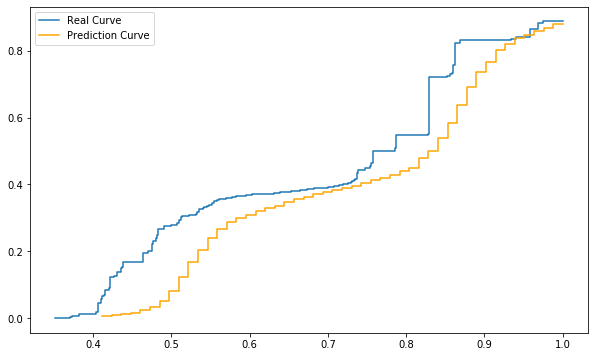

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using LSTM procedure
pp1 = lstm_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
lstm_l1_distances.mean()

1    0.0479682367
2    0.0479721335
3    0.0505531293
4    0.0509347031
5    0.0511540976
6    0.0492780490
7    0.0442812238
8    0.0340508471
9    0.0244947652
10   0.0198398514
11   0.0173872485
12   0.0165839989
13   0.0165845896
14   0.0165716524
15   0.0166644474
16   0.0171294887
17   0.0172376215
18   0.0175287196
19   0.0178269094
20   0.0179091388
21   0.0179380638
22   0.0178775071
23   0.0183260639
24   0.0206737838
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(lstm_l1_distances.mean()) / 24, 4)

0.0278

## Analysis comparison Naive vs LSTM

In [25]:
difference = naive_l1_distances.iloc[:, :25] - lstm_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-1.0490704991,-1.0163889529,-0.8127597495,-0.8649128394,-0.9561073494,-0.9682990726,-0.7455738329,-1.0850262763,-1.0407449847,-2.0378107761,...,-3.0032965970,-2.4145102824,-2.4916233946,-2.1764685190,-1.4897824633,-1.5806446240,-1.7040688063,-1.4336283747,-1.4804552801,-1.3832239318
std,2.4706206953,6.2525487965,1.9091282328,2.1849999621,2.8876274456,3.3216340643,3.0128923345,7.3098238748,6.2698421578,24.9501471777,...,15.1005397447,10.3556456435,15.7317584351,14.7182636699,6.0126583348,6.6282655792,9.5279495315,4.2132403208,4.3499122538,3.9813255780
min,-20.5221652615,-159.7282064509,-11.6987245498,-16.5028986179,-43.0231196006,-59.7493123557,-63.2884040755,-151.5620602940,-151.5212762300,-665.5684281516,...,-229.9267964426,-169.1061765751,-358.0653810816,-359.8092784139,-102.8334666492,-106.9604922752,-229.5481628339,-56.1118096191,-52.0881712876,-54.8850108655
25%,-1.4709461726,-1.1144305694,-1.2455984361,-1.1517797804,-1.1266564884,-1.0822841744,-0.8348443026,-0.8865852767,-0.9715323734,-1.1055276861,...,-1.4759765869,-1.5545319083,-1.5929635056,-1.3817043293,-1.2684272482,-1.2483582527,-1.4104295450,-1.4825818971,-1.4055287011,-1.4615643659
50%,-0.1792761590,-0.1251314160,-0.1585351216,-0.1296202754,-0.1372391054,-0.1609832590,-0.0790561328,-0.0436412814,-0.0896593398,-0.0830035217,...,-0.2393677042,-0.3085270815,-0.2316652539,-0.2050662230,-0.1214530490,-0.1746490717,-0.2550597971,-0.2292705563,-0.2463303774,-0.2973412266
75%,0.2960215575,0.3445720706,0.3405062729,0.3462015309,0.3438366199,0.3647850627,0.3495608720,0.3914572127,0.3628941537,0.3399397578,...,0.3246506553,0.3070125745,0.3353164446,0.3215771132,0.3490843404,0.3369390443,0.3468426798,0.3209912480,0.2987401190,0.2585428163
max,0.8688649003,0.8926754334,0.8979957209,0.9046058797,0.9151681208,0.8785189756,0.8688553277,0.9417544398,0.9103344333,0.9108991484,...,0.8841573378,0.8855077467,0.8624502743,0.8874187324,0.8900556136,0.8983327838,0.9103318141,0.9488331354,0.9290366900,0.8587283158


# Random Forest

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)

In [ ]:
X_train.shape

(24264, 128)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)

In [ ]:
X_test.shape

(17544, 128)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# Create the Random Forest model for regression
random_forest = RandomForestRegressor(n_estimators=100, random_state=42)

# Create the MultiOutputRegressor model with the Random Forest
multi_output_forest = MultiOutputRegressor(random_forest)

# Train the model
multi_output_forest.fit(X_train, y_train)

# Compute the predictions using the test set
predictions = multi_output_forest.predict(X_test)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

In [ ]:
# Store the predictions into a dataframe
rf_predictions = pd.DataFrame(predictions)

In [ ]:
rf_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest\rf_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,1.2959100575,1.7494723039,1.4154522360,2.1463728991,2.3773894892,2.0898907182,1.9447270448,2.2485591770,2.4733228585,2.2338385200,...,2.9929421508,3.2463774918,3.2402635953,3.1459628732,3.1767274796,3.2713850361,3.1844596619,3.2043745038,3.1915741119,3.1451896946
1,1.9840433087,2.0717810225,1.6665037431,1.6729799904,2.2584101412,2.3171647704,1.9796202609,2.4779896033,2.7164657191,2.6124266746,...,3.2690266539,3.2195812871,3.3917071238,3.3002827451,3.3494154211,3.2724864133,3.2975924799,3.2745195278,3.2463977894,3.2184656904
2,1.1012977590,1.4957897614,1.2013777683,1.7213194659,2.3616624991,2.3720322186,1.8575382572,2.4778712771,2.3836097319,2.5248712325,...,3.0775769688,3.0336579418,3.2439601310,3.0171129141,3.2320859519,3.1606789715,3.2489887091,3.3099213677,3.3010178928,3.2554529099
3,1.5889110593,1.5419511915,1.1161477731,1.9533656461,2.1093412551,2.3081848690,1.7880947831,2.2684081955,2.3378375453,2.2779448410,...,2.9566444338,2.8757974995,3.0860751330,2.8928182703,3.0274050788,3.0894050914,3.2737959647,3.3268897641,3.2697380847,3.3054986354
4,1.9148835663,1.9925988311,1.2939788964,1.4595349072,1.8456592357,2.0953687082,1.5131088035,2.1583101877,2.3075681173,2.4337833414,...,3.0158759475,2.8596048545,3.1090036828,2.9200147722,3.0342863496,3.1018738699,3.2785042817,3.3210255142,3.3032180854,3.2826492249
5,1.3959692146,2.0669257387,1.6921454175,1.8729835268,1.9067431525,2.0365741166,1.7633354243,2.1718242019,2.1945604576,2.3869742863,...,3.2710296831,3.0153441535,3.2835801825,3.1516451506,3.2313390344,3.1799040282,3.3022350667,3.3326419815,3.2921435034,3.2910990655
6,0.3394894166,0.4162260475,0.2902689477,0.5397323686,0.7311255079,0.6912147835,1.2554809267,1.4074532929,1.5009129968,1.8205009264,...,2.8397390803,2.7547924224,2.9668794602,3.0124507175,3.0123862700,3.0494011471,3.1223023241,2.9766809243,3.0245632837,3.0971854612
7,0.0419739449,0.0554379280,0.0733209189,0.0822701757,0.1060965776,0.1468454486,0.1744985786,0.2548498798,0.2870927773,0.4998671880,...,1.9627494319,1.9013847382,1.9155687935,1.7598762728,1.7934455372,1.9293914544,2.0391986095,2.2669725235,2.3003319097,2.4723882804
8,0.0180712178,0.0253499331,0.0244618322,0.0420317563,0.0391878640,0.0572322039,0.0528518017,0.0773327251,0.0693556529,0.0975788794,...,1.6887429096,1.6372771672,1.6250966335,1.5934125834,1.5471271756,1.5499642970,1.5414460484,1.4947908798,1.4882545220,1.5167300422
9,0.0074953510,0.0039755048,0.0095586438,0.0126120256,0.0249391980,0.0322583486,0.0305514672,0.0414173616,0.0533164565,0.0666175636,...,1.5513520178,1.5429720548,1.4955727965,1.4998375279,1.4845962801,1.4256303060,1.4309143637,1.4135383307,1.4191627182,1.4017245096


In [ ]:
# If there is any negative number it is changed to positive
for i in range(rf_predictions.shape[0]):
    for c in range(rf_predictions.shape[1]):
        if rf_predictions.iloc[i, c] < 0:
            rf_predictions.iloc[i, c] = abs(rf_predictions.iloc[i, c])

In [ ]:
for i in range(rf_predictions.shape[0]):
    for c in range(rf_predictions.shape[1]):
        if c < rf_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and rf_predictions.iloc[i, c] > rf_predictions.iloc[i, c + 1] and rf_predictions.iloc[i, c] > rf_predictions.iloc[i, c + 2]:
                rf_predictions.iloc[i, c] = rf_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and rf_predictions.iloc[i, c] > rf_predictions.iloc[i, c + 1] and rf_predictions.iloc[i, c] > rf_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if rf_predictions.iloc[i, c + 1] >= rf_predictions.iloc[i, c - 1]:
                    rf_predictions.iloc[i, c] = rf_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if rf_predictions.iloc[i, c + 1] < rf_predictions.iloc[i, c - 1]:
                    rf_predictions.iloc[i, c + 1] = rf_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if rf_predictions.iloc[i, c] > rf_predictions.iloc[i, c + 1] and rf_predictions.iloc[i, c] < rf_predictions.iloc[i, c + 2]:
                rf_predictions.iloc[i, c + 1] = rf_predictions.iloc[i, c]
        if c >= rf_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if rf_predictions.iloc[i, c] < rf_predictions.iloc[i, c - 1]:
                rf_predictions.iloc[i, c] = rf_predictions.iloc[i, c - 1]

In [ ]:
rf_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,1.2959100575,1.7494723039,1.7494723039,2.1463728991,2.3773894892,2.3773894892,2.3773894892,2.3773894892,2.4733228585,2.4733228585,...,3.1246224334,3.2402635953,3.2402635953,3.2402635953,3.2402635953,3.2713850361,3.2713850361,3.2713850361,3.2713850361,3.2713850361
1,1.9840433087,2.0717810225,2.0717810225,2.0717810225,2.2584101412,2.3171647704,2.3171647704,2.4779896033,2.7164657191,2.7164657191,...,3.3610223730,3.3610223730,3.3917071238,3.3917071238,3.3917071238,3.3917071238,3.3917071238,3.3917071238,3.3917071238,3.3917071238
2,1.1012977590,1.4957897614,1.4957897614,1.7213194659,2.3616624991,2.3720322186,2.3720322186,2.4778712771,2.4778712771,2.5248712325,...,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344,3.4628194344
3,1.5419511915,1.5419511915,1.5419511915,1.9533656461,2.1093412551,2.3081848690,2.3081848690,2.3081848690,2.3378375453,2.3378375453,...,3.3198111956,3.3198111956,3.3198111956,3.3198111956,3.3198111956,3.3198111956,3.3198111956,3.3268897641,3.3268897641,3.3268897641
4,1.9148835663,1.9925988311,1.9925988311,1.9925988311,1.9925988311,2.0953687082,2.0953687082,2.1583101877,2.3075681173,2.4337833414,...,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714,3.4145302714
5,1.3959692146,1.6921454175,1.6921454175,1.8729835268,1.9067431525,2.0365741166,2.0365741166,2.1718242019,2.1945604576,2.3869742863,...,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148,3.4072444148
6,0.3394894166,0.4162260475,0.4162260475,0.5397323686,0.7311255079,0.7311255079,1.2554809267,1.4074532929,1.5009129968,1.8205009264,...,2.8397390803,2.8397390803,2.9668794602,3.0124507175,3.0124507175,3.0494011471,3.1223023241,3.1223023241,3.1223023241,3.1223023241
7,0.0419739449,0.0554379280,0.0733209189,0.0822701757,0.1060965776,0.1468454486,0.1744985786,0.2548498798,0.2870927773,0.4998671880,...,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465,2.5373200465
8,0.0180712178,0.0253499331,0.0253499331,0.0420317563,0.0420317563,0.0572322039,0.0572322039,0.0773327251,0.0773327251,0.0975788794,...,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590,2.1334158590
9,0.0074953510,0.0074953510,0.0095586438,0.0126120256,0.0249391980,0.0322583486,0.0322583486,0.0414173616,0.0533164565,0.0666175636,...,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025,1.8786659025


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(rf_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

rf_predictions = rf_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
rf_predictions.to_csv('rf_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
rf_predictions = rf_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
rf_l1_distances = pd.DataFrame()

for d in range(1013, 1743):
  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # Compute the prediction using Random Forest procedure
    pp1 = rf_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    rf_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
rf_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.04747915860473127
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.0573591559695162
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.06808767005972102
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.08605500664639104
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.08859480305962063
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.07732053567186749
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.08009440788837667
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.09622707457238873
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.08089893651835274
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.0551269043082211
------------------------

D

Distancia L1 (Manhattan) para la hora 11 del día 1018: 0.01833227682926847
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1018: 0.019349762072685683
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1018: 0.021428908992201633
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1018: 0.015408821530068827
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1018: 0.008597812437638028
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1018: 0.00785278150426735
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1018: 0.01056327479267346
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1018: 0.01182952923282224
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1018: 0.010195375910004892
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1018: 0.020584813351984307
----------

Distancia L1 (Manhattan) para la hora 24 del día 1022: 0.018102754717465586
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1023: 0.043323912762596534
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1023: 0.04437775257372029
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1023: 0.04173145622297239
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1023: 0.04413934083694013
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1023: 0.042022245737436424
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1023: 0.043045508352026696
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1023: 0.03606117076654683
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1023: 0.019794886469345664
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1023: 0.02102467445954405
--------------------

Distancia L1 (Manhattan) para la hora 3 del día 1027: 0.03484038746107056
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1027: 0.03717068239946239
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1027: 0.03965717754497758
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1027: 0.04077681149380957
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1027: 0.02737663860101206
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1027: 0.019375969416661653
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1027: 0.027931272784286965
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1027: 0.027809790092861546
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1027: 0.03417695783401932
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1027: 0.03197144214273704
--------------------

Distancia L1 (Manhattan) para la hora 15 del día 1031: 0.01278632415076194
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1031: 0.014690195956274157
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1031: 0.013976226382760151
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1031: 0.015426247643903681
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1031: 0.014996714167755833
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1031: 0.014475651358921806
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1031: 0.026459858862370525
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1031: 0.022590681337855238
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1031: 0.018107797023050154
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1031: 0.012406942287623589
-------


Distancia L1 (Manhattan) para la hora 18 del día 1036: 0.01759869183600675
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1036: 0.01384763200085777
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1036: 0.014342440208414717
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1036: 0.01490915529128668
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1036: 0.016615577996135767
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1036: 0.015366878056721855
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1036: 0.012953221634266451
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1037: 0.035617880077566916
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1037: 0.03592660014355943
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1037: 0.03828313804413765
-------------

Distancia L1 (Manhattan) para la hora 23 del día 1041: 0.04360416711096973
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1041: 0.041810937858747954
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1042: 0.05626166358947419
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1042: 0.057039156023122206
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1042: 0.060599457390711015
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1042: 0.04680029227108309
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1042: 0.041629553049644455
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1042: 0.04329974230484272
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1042: 0.027283874538980873
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1042: 0.02141357380035426
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1046: 0.015918496921316354
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1046: 0.021477816929500147
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1046: 0.031406935921105196
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1046: 0.03217503427713918
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1046: 0.033749971614299545
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1046: 0.026224127267930053
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1046: 0.023235825763142474
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1046: 0.012710565893675928
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1046: 0.012742660170975233
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1047: 0.04362345826136119
---------

Distancia L1 (Manhattan) para la hora 9 del día 1051: 0.008603166477265759
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1051: 0.009727768990852285
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1051: 0.016945909206471543
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1051: 0.023338039723593038
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1051: 0.02810828093194731
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1051: 0.02988769415813558
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1051: 0.03176102161601253
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1051: 0.032979245578449196
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1051: 0.030324297450762
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1051: 0.02796501832649975
--------------

Distancia L1 (Manhattan) para la hora 17 del día 1056: 0.010696920727334771
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1056: 0.011539614858189252
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1056: 0.012394205116678061
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1056: 0.009820644038226238
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1056: 0.009446169803593496
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1056: 0.010004080189306066
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1056: 0.007643774193295574
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1056: 0.011721943236751142
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1057: 0.028582030491396737
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1057: 0.031634235668043804
--------

Distancia L1 (Manhattan) para la hora 24 del día 1060: 0.02343919341546371
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1061: 0.0802897841670594
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1061: 0.09075528600565903
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1061: 0.10204574667441224
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1061: 0.10493084701328823
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1061: 0.09956917593171266
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1061: 0.07772370092264531
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1061: 0.03192200435154818
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1061: 0.024211664170973982
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1061: 0.015532669835767156
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1065: 0.015839169658739143
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1065: 0.018425268056313608
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1065: 0.018259661706372887
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1065: 0.015251094050575566
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1065: 0.012370421786805134
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1065: 0.010787394982173858
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1065: 0.012237831146851622
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1065: 0.013181762008884247
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1065: 0.012761255117217119
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1065: 0.012882492279877871
------

Distancia L1 (Manhattan) para la hora 14 del día 1069: 0.03385164488717689
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1069: 0.03648658426611277
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1069: 0.03851212370103075
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1069: 0.0345622703610719
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1069: 0.03298164047853616
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1069: 0.028479042735595886
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1069: 0.029145767437420284
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1069: 0.02934684574249557
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1069: 0.025054378308968367
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1069: 0.020605995048767957
-------------

Distancia L1 (Manhattan) para la hora 3 del día 1074: 0.054392834708533316
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1074: 0.05817712214871271
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1074: 0.049568894504517944
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1074: 0.03825018792690832
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1074: 0.03417482049061146
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1074: 0.028132417891771632
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1074: 0.013914633489782694
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1074: 0.011924369544595132
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1074: 0.011994389563167823
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1074: 0.008938506366703413
----------------

Distancia L1 (Manhattan) para la hora 5 del día 1078: 0.06577374530374777
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1078: 0.08390891345784099
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1078: 0.0667473030359226
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1078: 0.02215332196645374
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1078: 0.021492070323539583
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1078: 0.01826938787231327
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1078: 0.014766127158887036
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1078: 0.011426068045224613
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1078: 0.010564806354644608
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1078: 0.01093976877604413
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1081: 0.010392688616797078
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1081: 0.013021829246306809
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1081: 0.012274145734619511
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1081: 0.013661871645463206
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1081: 0.013453490649668026
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1081: 0.01231567404897393
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1081: 0.012616543322984333
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1081: 0.022137138358040494
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1082: 0.029525542236792414
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1082: 0.03398717563219139
----------

Distancia L1 (Manhattan) para la hora 20 del día 1085: 0.013804429005432738
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1085: 0.012171308593049067
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1085: 0.012501226422747338
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1085: 0.010230700982844242
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1085: 0.012136773258400721
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1086: 0.026981809743724834
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1086: 0.0356576767100274
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1086: 0.05038949948421821
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1086: 0.05101408248829565
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1086: 0.05098468414659424
----------------

------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1090: 0.024885335411362917
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1090: 0.023301215404625236
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1090: 0.03185697967447233
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1090: 0.029191121562845403
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1090: 0.03061108523636196
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1090: 0.01246812170106264
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1090: 0.01199291550656064
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1090: 0.011287579491550882
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1090: 0.012852685542803666
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1090: 0.0118670754

Distancia L1 (Manhattan) para la hora 24 del día 1093: 0.01688652473093602
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1094: 0.03156489182335097
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1094: 0.031785853822336146
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1094: 0.037118031992488865
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1094: 0.038971067069231306
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1094: 0.04121757352040267
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1094: 0.0373317585004163
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1094: 0.041187321426495005
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1094: 0.06201569944369687
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1094: 0.024016673789370998
---------------------

Distancia L1 (Manhattan) para la hora 5 del día 1100: 0.03267452254535276
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1100: 0.028091826009336664
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1100: 0.024645855897534423
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1100: 0.018340264149387688
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1100: 0.017054372759519175
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1100: 0.0137346463318971
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1100: 0.010742826284804306
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1100: 0.009246290504957483
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1100: 0.007541662402034199
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1100: 0.0075748819383810746
-------------

Distancia L1 (Manhattan) para la hora 22 del día 1103: 0.027173688439959327
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1103: 0.025703924304433277
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1103: 0.03181184171580054
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1104: 0.040765107215014085
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1104: 0.054551874098161694
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1104: 0.07197333389735977
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1104: 0.07748318974787533
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1104: 0.06785485048994154
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1104: 0.05887233030568802
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1104: 0.037909151735626964
------------------

Distancia L1 (Manhattan) para la hora 21 del día 1108: 0.010146282725693392
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1108: 0.01004294273165435
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1108: 0.009115633327782084
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1108: 0.011548363750775925
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1109: 0.03302074806466192
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1109: 0.027501784141034866
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1109: 0.032658712506108696
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1109: 0.03155870265650187
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1109: 0.027588241315942577
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1109: 0.03063670274962299
----------------

Distancia L1 (Manhattan) para la hora 4 del día 1113: 0.055722102356042184
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1113: 0.05347226523203884
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1113: 0.048492371231029896
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1113: 0.028834588227670113
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1113: 0.017792458086814116
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1113: 0.029765808160118815
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1113: 0.013919990259297849
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1113: 0.008407785889336085
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1113: 0.008248451567852026
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1113: 0.00924340704167934
--------------

Distancia L1 (Manhattan) para la hora 17 del día 1116: 0.012192093466035052
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1116: 0.010450431446929493
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1116: 0.012091965175454616
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1116: 0.017003549020958533
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1116: 0.02090231986489695
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1116: 0.0279968739017409
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1116: 0.022537516095874243
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1116: 0.026269376602219893
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1117: 0.053814311887670635
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1117: 0.05972639199801992
------------

Distancia L1 (Manhattan) para la hora 18 del día 1120: 0.026742616928320497
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1120: 0.02363223286748964
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1120: 0.01904289533765089
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1120: 0.013365266122139868
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1120: 0.008978947554246657
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1120: 0.011248345691519772
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1120: 0.012867040236221653
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1121: 0.03985246082685259
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1121: 0.04247822145623281
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1121: 0.04706645585576715
--------------

Distancia L1 (Manhattan) para la hora 19 del día 1124: 0.016672633292135756
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1124: 0.016648694250791483
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1124: 0.021222536328609237
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1124: 0.02371786710487197
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1124: 0.02188593662524393
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1124: 0.02381961091893032
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1125: 0.035436280677471094
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1125: 0.03074484978014686
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1125: 0.03450157536054453
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1125: 0.047140162886171996
---------------

Distancia L1 (Manhattan) para la hora 5 del día 1128: 0.030342587265489954
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1128: 0.028942314026352268
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1128: 0.04222018446670334
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1128: 0.02291695351850548
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1128: 0.012988175576821585
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1128: 0.01539805089846475
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1128: 0.015156506695380842
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1128: 0.018133357656295992
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1128: 0.019613360968458088
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1128: 0.01742024747854942
---------------

Distancia L1 (Manhattan) para la hora 2 del día 1132: 0.03672088797692044
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1132: 0.04057782454915977
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1132: 0.041329486458730066
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1132: 0.03914407597841993
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1132: 0.032957475052660376
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1132: 0.029842831161116454
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1132: 0.021561019110891512
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1132: 0.01466479117842083
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1132: 0.011069151986330036
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1132: 0.009188152134269836
------------------

Distancia L1 (Manhattan) para la hora 1 del día 1136: 0.024550967520941155
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1136: 0.022369639674565723
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1136: 0.024283773001288755
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1136: 0.025210906504918376
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1136: 0.027268741068741848
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1136: 0.03181073083084455
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1136: 0.029728369820533018
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1136: 0.026058386728653987
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1136: 0.012626369155968528
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1136: 0.014099893330421819
----------------

Distancia L1 (Manhattan) para la hora 21 del día 1139: 0.028298935493233607
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1139: 0.026254615296163606
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1139: 0.027878143906579333
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1139: 0.03250115025606781
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1140: 0.058240701753501864
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1140: 0.07963806681625037
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1140: 0.08325750461905931
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1140: 0.09011493419677871
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1140: 0.08943041239245758
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1140: 0.08605146966059044
------------------

Distancia L1 (Manhattan) para la hora 24 del día 1143: 0.014047708944380573
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1144: 0.02585024924410037
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1144: 0.03632737583814516
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1144: 0.0536059016292834
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1144: 0.06814463825832429
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1144: 0.06727421299082902
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1144: 0.07124560748349915
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1144: 0.07603839622783869
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1144: 0.06246645890671198
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1144: 0.058998877172047395
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1147: 0.00901736557977357
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1147: 0.011219191161110125
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1147: 0.010748281925032606
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1147: 0.00980402735246284
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1148: 0.02614349041425971
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1148: 0.037497605711337714
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1148: 0.03957457424905264
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1148: 0.04219011635241998
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1148: 0.05123826742282599
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1148: 0.05235779632574701
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1151: 0.011889010312674898
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1151: 0.017521938046220598
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1151: 0.016651008202398107
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1151: 0.014071826574301076
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1151: 0.015024166422338418
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1151: 0.014100654921358575
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1151: 0.01748703057321864
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1152: 0.022342423961147054
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1152: 0.02620634192229282
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1152: 0.03289054312062686
------------

Distancia L1 (Manhattan) para la hora 8 del día 1155: 0.02178781105100751
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1155: 0.012079585640721946
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1155: 0.01340296877170958
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1155: 0.012410176983524772
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1155: 0.011537730898892611
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1155: 0.010053423149325343
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1155: 0.009490652860673214
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1155: 0.008972662154085157
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1155: 0.007307985201436971
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1155: 0.005975028290314924
----------

Distancia L1 (Manhattan) para la hora 24 del día 1158: 0.011777927200086523
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1159: 0.05259317483985949
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1159: 0.05866532589430142
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1159: 0.06635950294790069
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1159: 0.06371806847561574
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1159: 0.05960275360869017
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1159: 0.04839601667906486
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1159: 0.030894750692370628
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1159: 0.024954870372587402
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1159: 0.01374212154121276
----------------------

Distancia L1 (Manhattan) para la hora 8 del día 1163: 0.06762359189734736
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1163: 0.046963135646945625
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1163: 0.028059662580194725
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1163: 0.021987450733096242
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1163: 0.021565453169576292
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1163: 0.019734788888038174
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1163: 0.017404882678986423
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1163: 0.01427421841112243
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1163: 0.014553838692082278
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1163: 0.015236640244969218
----------

Distancia L1 (Manhattan) para la hora 17 del día 1166: 0.0083843864808915
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1166: 0.011838585994364586
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1166: 0.015404248377270769
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1166: 0.013164513601468662
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1166: 0.010230193396766401
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1166: 0.00781397821591763
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1166: 0.006043470167144677
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1166: 0.007606058950461011
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1167: 0.02873800172448509
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1167: 0.025359687441167872
------------

Distancia L1 (Manhattan) para la hora 4 del día 1170: 0.09511785428868424
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1170: 0.09101469229852449
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1170: 0.08851703610698977
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1170: 0.059479015849582345
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1170: 0.029157850073441467
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1170: 0.018494429074011585
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1170: 0.02814052621024734
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1170: 0.02303428978805514
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1170: 0.018761016740466395
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1170: 0.014068853214792058
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1175: 0.021115203791295445
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1175: 0.020171190779684163
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1175: 0.020030217582733517
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1175: 0.01938564072837107
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1175: 0.01469590657540676
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1175: 0.010327664088265194
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1175: 0.008524132756761935
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1175: 0.007942100993445288
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1175: 0.006809001146696596
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1175: 0.012527945596353349
--------

Distancia L1 (Manhattan) para la hora 23 del día 1178: 0.030308556232698437
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1178: 0.030209212938557127
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1179: 0.059570750088883226
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1179: 0.07456549387285158
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1179: 0.09386148783428148
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1179: 0.10628863264476418
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1179: 0.1049916503246099
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1179: 0.09881956523423864
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1179: 0.09222872066240785
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1179: 0.0883857825404045
-----------------------

Distancia L1 (Manhattan) para la hora 15 del día 1182: 0.02518955971502884
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1182: 0.02791142525609183
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1182: 0.029332317405745194
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1182: 0.02745121753706182
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1182: 0.022712621145094782
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1182: 0.0214180959281283
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1182: 0.01930337339997287
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1182: 0.020505957245957517
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1182: 0.01639863021281955
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1182: 0.022597184979198406
-------------

Distancia L1 (Manhattan) para la hora 8 del día 1186: 0.034833762180020184
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1186: 0.021771054240378767
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1186: 0.010932949434881555
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1186: 0.0070204216597159665
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1186: 0.0069746398837932395
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1186: 0.0039292693106521516
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1186: 0.004202497428895649
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1186: 0.009288850096528717
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1186: 0.015274823962286268
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1186: 0.0130710432711545
-------

Distancia L1 (Manhattan) para la hora 13 del día 1191: 0.009393232466765357
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1191: 0.009209967903788911
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1191: 0.007301122523991909
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1191: 0.004573456702342785
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1191: 0.004068384682932302
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1191: 0.004028197055977782
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1191: 0.004962167199836156
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1191: 0.004482504302666866
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1191: 0.005470633698628186
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1191: 0.006495504248213272
------

Distancia L1 (Manhattan) para la hora 22 del día 1194: 0.008135774667666053
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1194: 0.006866595234243885
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1194: 0.008379004840703311
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1195: 0.0456889910571239
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1195: 0.03673350977623599
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1195: 0.03997741483604258
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1195: 0.03936537091021374
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1195: 0.043569585846687665
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1195: 0.03923684828180324
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1195: 0.037167840295827675
-------------------

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1199: 0.029466453444672212
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1199: 0.032691177204090954
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1199: 0.04094366369854575
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1199: 0.04452314879681891
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1199: 0.05343079391530353
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1199: 0.03726654885538569
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1199: 0.025493719664961997
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1199: 0.023437326125204487
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1199: 0.01459228603340415
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1199: 0.011614829976

Distancia L1 (Manhattan) para la hora 17 del día 1203: 0.011983315032560626
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1203: 0.013736008381410767
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1203: 0.013784009080924779
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1203: 0.01209145502706626
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1203: 0.013374685428614249
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1203: 0.01322876879578444
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1203: 0.012674818559549156
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1203: 0.013214486416442916
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1204: 0.021268446890572196
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1204: 0.028823746530374793
----------

Distancia L1 (Manhattan) para la hora 4 del día 1207: 0.04013792557946375
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1207: 0.039399195711479144
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1207: 0.036291820678540636
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1207: 0.03603456998157306
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1207: 0.04726907948318669
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1207: 0.025001232321222908
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1207: 0.01436423017721397
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1207: 0.008469743978918937
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1207: 0.009109084079393903
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1207: 0.008476644441307406
----------------

Distancia L1 (Manhattan) para la hora 24 del día 1211: 0.007932191762978262
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1212: 0.01652864080775227
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1212: 0.015925344181429067
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1212: 0.024487559148423467
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1212: 0.02957989790857045
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1212: 0.031183040993671692
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1212: 0.034748505964086566
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1212: 0.02801127817116328
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1212: 0.013935052402317346
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1212: 0.01651210232935501
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1215: 0.003639245333402903
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1215: 0.004350581900306195
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1215: 0.004907340315067798
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1215: 0.00514856709690014
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1215: 0.005322946185404251
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1215: 0.0050309274472056945
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1215: 0.004764204588092469
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1215: 0.005359797710822099
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1215: 0.011600061665051191
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1216: 0.02781750951115381
--------

Distancia L1 (Manhattan) para la hora 13 del día 1219: 0.004075415855147481
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1219: 0.0036919640448502076
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1219: 0.0042431270555933044
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1219: 0.005288726776454052
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1219: 0.006735266611559477
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1219: 0.010405604172650022
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1219: 0.008986123074492288
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1219: 0.00808854731357008
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1219: 0.010186768878343773
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1219: 0.007780518011928186
-----

Distancia L1 (Manhattan) para la hora 16 del día 1224: 0.005040235121029527
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1224: 0.00479007031505115
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1224: 0.004593657987258423
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1224: 0.004298683967622734
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1224: 0.005071269266726314
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1224: 0.005461743418429572
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1224: 0.006992408925399791
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1224: 0.008538841744893578
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1224: 0.008178480074276597
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1225: 0.01660212170265212
---------

Distancia L1 (Manhattan) para la hora 8 del día 1228: 0.060125673125739486
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1228: 0.053039835190991105
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1228: 0.022671514308975592
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1228: 0.015295364123333936
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1228: 0.015075439718468855
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1228: 0.015197229735576709
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1228: 0.012958821266278215
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1228: 0.010915164129942626
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1228: 0.012045065719682549
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1228: 0.010293653633387261
--------

Distancia L1 (Manhattan) para la hora 7 del día 1233: 0.04361466845349542
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1233: 0.03482832534229342
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1233: 0.01961628446101759
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1233: 0.01727800728954688
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1233: 0.01620470957109167
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1233: 0.015605196986409676
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1233: 0.018238609346213363
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1233: 0.02014163174888174
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1233: 0.01995039055236327
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1233: 0.021117862401367635
----------------

Distancia L1 (Manhattan) para la hora 1 del día 1237: 0.016021471631519922
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1237: 0.01471893156104661
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1237: 0.030247423071404548
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1237: 0.03338923680916893
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1237: 0.016978919562261007
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1237: 0.018276642418876353
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1237: 0.014508915353299515
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1237: 0.0068631329395297536
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1237: 0.004862312581580051
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1237: 0.0031671671022223185
---------------

Distancia L1 (Manhattan) para la hora 18 del día 1240: 0.005991509321190461
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1240: 0.00612429670302025
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1240: 0.005541193300350019
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1240: 0.006978361430219231
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1240: 0.006973878012186277
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1240: 0.006600931309340706
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1240: 0.00845479730766979
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1241: 0.028089999327720175
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1241: 0.022051018968951897
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1241: 0.015795430765478475
-----------

Distancia L1 (Manhattan) para la hora 4 del día 1244: 0.04259897861636732
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1244: 0.04572584155672994
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1244: 0.048173492574817824
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1244: 0.043850359596593405
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1244: 0.02508358406752833
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1244: 0.014751620720521748
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1244: 0.018081856350704414
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1244: 0.020947464613615005
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1244: 0.019744572874704366
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1244: 0.018302847704574007
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1247: 0.006463242552202536
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1247: 0.006017746543835983
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1247: 0.005850157944048365
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1247: 0.0056136583050742225
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1247: 0.005186666590687802
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1247: 0.00527289472992086
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1247: 0.0055221428568970774
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1247: 0.007115830476638343
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1247: 0.0075098653901291956
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1247: 0.0065230760832859355
---

Distancia L1 (Manhattan) para la hora 14 del día 1252: 0.006555572618688623
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1252: 0.006531629992811468
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1252: 0.005198182636988416
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1252: 0.004682959327931885
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1252: 0.004138463153560812
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1252: 0.004442449178523728
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1252: 0.005165967935835318
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1252: 0.006325288912094629
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1252: 0.006903322078954045
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1252: 0.005977600619666448
------

Distancia L1 (Manhattan) para la hora 8 del día 1256: 0.04870021433350015
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1256: 0.025533857963209658
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1256: 0.014270015900813508
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1256: 0.014206188239407651
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1256: 0.016827167909219606
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1256: 0.016209878230283796
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1256: 0.014092183892736728
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1256: 0.013214319870763372
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1256: 0.006727333601450864
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1256: 0.006488277460068369
---------

Distancia L1 (Manhattan) para la hora 13 del día 1261: 0.016211995668360686
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1261: 0.01180680135894569
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1261: 0.009515491300303464
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1261: 0.009306550546573863
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1261: 0.004242959132505889
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1261: 0.003393051803434725
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1261: 0.002012551161442098
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1261: 0.0028451299830708544
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1261: 0.0038181622624314454
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1261: 0.004483740857725952
-----

Distancia L1 (Manhattan) para la hora 1 del día 1265: 0.060572878648087115
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1265: 0.06580811455844685
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1265: 0.07646619056572879
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1265: 0.10451537632572316
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1265: 0.11790031403816637
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1265: 0.104797407285974
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1265: 0.09167927074985424
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1265: 0.07676669907801008
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1265: 0.05594712026137518
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1265: 0.04990548761832368
------------------------



Distancia L1 (Manhattan) para la hora 24 del día 1268: 0.01187016167621157
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1269: 0.02127155500447324
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1269: 0.01856820697277276
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1269: 0.021556993945245996
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1269: 0.024963212251631912
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1269: 0.0251864458540864
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1269: 0.02791126495100122
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1269: 0.038882964150188874
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1269: 0.026659478395192227
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1269: 0.00842548494588126
----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1273: 0.028578977952685464
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1273: 0.01715491135026908
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1273: 0.018793785042881123
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1273: 0.01160863085035185
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1273: 0.006246438047591478
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1273: 0.005904587580964311
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1273: 0.009065203164365994
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1273: 0.010003270053665076
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1273: 0.010656019115888265
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1273: 0.010408537163764397
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1278: 0.08376795705249737
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1278: 0.09913712449402237
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1278: 0.1118580205282095
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1278: 0.10494054123968818
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1278: 0.10561062606229768
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1278: 0.09037029906276384
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1278: 0.029906207021562586
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1278: 0.016398176705340203
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1278: 0.010504382428538397
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1278: 0.010607414446550174
----------------------

Distancia L1 (Manhattan) para la hora 11 del día 1281: 0.013735756837191401
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1281: 0.007939305104997685
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1281: 0.005454798835420432
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1281: 0.007471051899178989
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1281: 0.009400317135986163
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1281: 0.009332690150351517
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1281: 0.008571530744202017
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1281: 0.00816570787599745
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1281: 0.007254419603195814
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1281: 0.012016274197614064
-------

Distancia L1 (Manhattan) para la hora 20 del día 1284: 0.012533259245678939
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1284: 0.013304474106999503
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1284: 0.0164272234408463
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1284: 0.01586590830365307
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1284: 0.015564784617276119
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1285: 0.02150210417842285
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1285: 0.031257692789284745
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1285: 0.03684349593137057
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1285: 0.03494256399030281
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1285: 0.04094797484424251
------------------

Distancia L1 (Manhattan) para la hora 7 del día 1289: 0.027137335133746093
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1289: 0.019775077096223816
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1289: 0.01832354902274954
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1289: 0.015449382498698556
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1289: 0.01450193047439241
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1289: 0.012562158332804024
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1289: 0.015017438187090162
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1289: 0.017567435255192144
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1289: 0.018681701480947336
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1289: 0.02297701350607245
------------

Distancia L1 (Manhattan) para la hora 9 del día 1293: 0.021915810487969648
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1293: 0.0209404637178532
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1293: 0.016437460148441572
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1293: 0.012391396174143872
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1293: 0.010908525951626525
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1293: 0.00981687642397149
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1293: 0.009928317033302757
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1293: 0.009035543827938232
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1293: 0.008419029834622843
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1293: 0.009596005544967121
----------

Distancia L1 (Manhattan) para la hora 9 del día 1297: 0.00905594371784762
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1297: 0.007061744924231515
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1297: 0.01585381509978571
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1297: 0.01825531651583451
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1297: 0.017262340744048116
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1297: 0.017640952565207393
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1297: 0.021732022063476575
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1297: 0.02240985082554273
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1297: 0.021011081231203127
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1297: 0.02026015718044317
------------

Distancia L1 (Manhattan) para la hora 13 del día 1302: 0.01888600724513085
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1302: 0.015405177455618202
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1302: 0.016573040318002073
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1302: 0.01777220134787072
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1302: 0.02120922829034528
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1302: 0.024720654484328978
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1302: 0.03351792761844099
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1302: 0.03140171806822026
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1302: 0.02445467342297184
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1302: 0.025147568811435463
------------

Distancia L1 (Manhattan) para la hora 19 del día 1306: 0.01632893106588751
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1306: 0.0201459591576601
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1306: 0.023678618528382704
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1306: 0.008966212971162207
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1306: 0.010614766515896311
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1306: 0.011150705912698091
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1307: 0.026295219493859656
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1307: 0.026221172348222774
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1307: 0.026562437347059056
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1307: 0.03075825445042078
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1310: 0.020481570319231028
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1310: 0.008047700927564023
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1310: 0.008505168901373913
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1310: 0.01176803758112648
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1310: 0.007545244989159919
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1310: 0.010436599366189729
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1310: 0.010791570200724972
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1310: 0.010727999381167587
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1310: 0.008306088505299104
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1310: 0.008658894505813369
----------

Distancia L1 (Manhattan) para la hora 8 del día 1314: 0.018348527416301892
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1314: 0.01496281122979094
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1314: 0.0097443707172964
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1314: 0.008759761327047328
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1314: 0.007925301270408025
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1314: 0.008296524147935838
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1314: 0.00793086750409058
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1314: 0.007640389983356387
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1314: 0.01131420558332753
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1314: 0.014848880984983912
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1317: 0.06584733172810738
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1317: 0.06777174635307232
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1317: 0.06885930628167347
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1317: 0.0684998292643417
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1317: 0.06672963049898752
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1317: 0.06583717901465268
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1318: 0.08685311535506093
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1318: 0.09850776127302527
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1318: 0.09269156624148744
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1318: 0.09105183443638684
---------------------

Distancia L1 (Manhattan) para la hora 6 del día 1322: 0.06419012053011905
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1322: 0.021450330888212292
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1322: 0.015986921019552087
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1322: 0.024206944164166265
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1322: 0.025713098071668695
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1322: 0.018301756500772568
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1322: 0.013134938353064536
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1322: 0.013939761000064766
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1322: 0.011844078951184224
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1322: 0.01222769192263844
------------

Distancia L1 (Manhattan) para la hora 7 del día 1326: 0.07949515019511211
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1326: 0.04831862212701196
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1326: 0.027588408408018864
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1326: 0.01802577814806304
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1326: 0.014107359607487442
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1326: 0.01775376547189834
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1326: 0.020673531502486114
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1326: 0.019197102537804496
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1326: 0.01510301065576096
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1326: 0.012700387570352578
--------------

Distancia L1 (Manhattan) para la hora 21 del día 1329: 0.011358346197713086
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1329: 0.012189275653866282
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1329: 0.010782908355703998
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1329: 0.013399468536643389
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1330: 0.050989684738322744
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1330: 0.06208124889456877
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1330: 0.06812760037616979
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1330: 0.07328746365535191
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1330: 0.06768635254414151
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1330: 0.06688488397746517
-----------------

Distancia L1 (Manhattan) para la hora 7 del día 1334: 0.030877048343479485
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1334: 0.01987078383995139
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1334: 0.01881272978740851
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1334: 0.015629573212484132
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1334: 0.019159793240458814
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1334: 0.017421753478446378
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1334: 0.014330337441306837
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1334: 0.01163030479327872
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1334: 0.00973745412330989
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1334: 0.007291387938012534
-------------

Distancia L1 (Manhattan) para la hora 10 del día 1338: 0.040567614114527126
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1338: 0.03805044004100992
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1338: 0.041773917170829
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1338: 0.044013252068599476
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1338: 0.044956996191097234
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1338: 0.045229918670572966
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1338: 0.054542127904403756
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1338: 0.062357495858162706
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1338: 0.06378712967773349
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1338: 0.062471565741846126
-----------

Distancia L1 (Manhattan) para la hora 20 del día 1341: 0.007224194854977054
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1341: 0.009560445533978047
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1341: 0.011503108809842379
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1341: 0.00835067805248535
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1341: 0.008033357856935144
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1342: 0.02564327034918029
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1342: 0.01883523286787577
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1342: 0.022470128083482997
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1342: 0.03451862775702309
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1342: 0.042290797222949775
---------------

Distancia L1 (Manhattan) para la hora 5 del día 1346: 0.03569289356574254
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1346: 0.03717558821385207
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1346: 0.026061536270992326
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1346: 0.014966297645479772
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1346: 0.015400180013899154
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1346: 0.010870184066241809
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1346: 0.013215320807940198
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1346: 0.017175699543438096
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1346: 0.019399444177455146
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1346: 0.02250420189221064
--------------

Distancia L1 (Manhattan) para la hora 1 del día 1350: 0.07022789145049582
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1350: 0.0899897478929581
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1350: 0.09945601407056823
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1350: 0.10658677362171828
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1350: 0.1100452422547546
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1350: 0.09911244358248576
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1350: 0.06514339127666374
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1350: 0.033219480060698275
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1350: 0.02812109878290521
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1350: 0.016883805944761094
------------------------


Distancia L1 (Manhattan) para la hora 14 del día 1354: 0.015360967546650357
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1354: 0.014282322697185369
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1354: 0.011279629613642738
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1354: 0.010964388093450465
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1354: 0.014138026219422506
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1354: 0.013701209611235027
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1354: 0.012542948731988482
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1354: 0.013505500275808605
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1354: 0.014044427794402608
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1354: 0.014422170868797117
------

Distancia L1 (Manhattan) para la hora 1 del día 1358: 0.08982311476539183
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1358: 0.11136242121754425
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1358: 0.11702330608622341
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1358: 0.1209870761109799
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1358: 0.11360083492548045
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1358: 0.11202618546287191
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1358: 0.08475466099057014
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1358: 0.03878916140858367
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1358: 0.04012682856213894
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1358: 0.045290166963375775
------------------------


Distancia L1 (Manhattan) para la hora 4 del día 1362: 0.05538374850798703
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1362: 0.04888786053085529
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1362: 0.03985376645095891
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1362: 0.03346927153693818
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1362: 0.013175184040566352
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1362: 0.023035267487545898
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1362: 0.019255054776353506
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1362: 0.019085915922958795
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1362: 0.014339911105013505
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1362: 0.013782843846007305
----------------

Distancia L1 (Manhattan) para la hora 5 del día 1366: 0.07653556110814505
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1366: 0.07308291873302156
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1366: 0.05768515730511928
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1366: 0.03393194783319837
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1366: 0.02625698543257946
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1366: 0.023240284423054928
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1366: 0.01932045275010528
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1366: 0.015824982358917696
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1366: 0.014828634770406576
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1366: 0.012145147055671369
-----------------

Distancia L1 (Manhattan) para la hora 5 del día 1371: 0.049576071652002555
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1371: 0.05083020931386939
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1371: 0.039840979906705584
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1371: 0.03090716910470002
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1371: 0.02118418359202437
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1371: 0.019166211723533673
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1371: 0.018646050429753203
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1371: 0.019192397319536016
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1371: 0.01963262501791219
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1371: 0.020900007919090597
---------------

Distancia L1 (Manhattan) para la hora 19 del día 1375: 0.01731410502712899
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1375: 0.01593542343662458
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1375: 0.01506033152209901
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1375: 0.01437928784345717
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1375: 0.0149755168996916
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1375: 0.014935781299584738
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1376: 0.13893688961867662
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1376: 0.10907584324777127
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1376: 0.090164478677621
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1376: 0.09559813100704621
----------------------

Distancia L1 (Manhattan) para la hora 22 del día 1380: 0.01101461839626259
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1380: 0.011212403019018189
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1380: 0.016162736600141808
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1381: 0.02918952215069995
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1381: 0.04390669971198471
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1381: 0.035420663222847606
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1381: 0.03404116503788635
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1381: 0.03378608918132735
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1381: 0.031494138508856545
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1381: 0.026308396175684708
------------------

Distancia L1 (Manhattan) para la hora 18 del día 1384: 0.008202504638705886
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1384: 0.012972849065491072
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1384: 0.012980246110212633
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1384: 0.010374435590151724
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1384: 0.009353908920510117
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1384: 0.009507535163920942
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1384: 0.012235659699959706
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1385: 0.02517654566498076
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1385: 0.03351478441872402
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1385: 0.03390445436243362
------------

Distancia L1 (Manhattan) para la hora 3 del día 1389: 0.07473082903826427
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1389: 0.0804106752268355
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1389: 0.07045707969904919
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1389: 0.06585947129772002
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1389: 0.06077193695290971
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1389: 0.07681364399819195
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1389: 0.053785397495394266
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1389: 0.023479041880953448
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1389: 0.011830039848069157
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1389: 0.015031297637534606
--------------------

Distancia L1 (Manhattan) para la hora 7 del día 1393: 0.03162863308998437
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1393: 0.023111571450334614
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1393: 0.014055833867872944
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1393: 0.019036701294536298
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1393: 0.026641326040466616
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1393: 0.028557682451957736
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1393: 0.02811089198999167
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1393: 0.029935007827603995
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1393: 0.03074263427331661
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1393: 0.03599092851025226
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1397: 0.024031182000927468
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1397: 0.023490351185251532
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1397: 0.022393203292473768
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1397: 0.021556090970181067
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1397: 0.01848585732017413
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1397: 0.016701978557968206
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1398: 0.05805835058708556
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1398: 0.0555839963293442
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1398: 0.05777660705333966
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1398: 0.05808792245075914
----------------

Distancia L1 (Manhattan) para la hora 14 del día 1401: 0.027731368916522618
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1401: 0.026800675045354976
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1401: 0.03380875686458303
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1401: 0.025555702696536516
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1401: 0.020623458567547506
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1401: 0.0297804441790354
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1401: 0.030455652057232097
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1401: 0.03732570443096719
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1401: 0.041666128098390404
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1401: 0.040834428122417665
----------

Distancia L1 (Manhattan) para la hora 1 del día 1407: 0.05195442506051059
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1407: 0.06863415794268346
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1407: 0.06551764806610173
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1407: 0.06513522189144264
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1407: 0.06996362069613206
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1407: 0.06889912360348036
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1407: 0.04364281590550784
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1407: 0.023198870913776034
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1407: 0.015731360039581536
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1407: 0.01614787954458495
-----------------------

Distancia L1 (Manhattan) para la hora 5 del día 1411: 0.049896881056947645
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1411: 0.046689672346356514
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1411: 0.028004692484683694
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1411: 0.035650750096448566
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1411: 0.020350747803745184
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1411: 0.010283779866586636
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1411: 0.009214781491169766
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1411: 0.00999978087277352
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1411: 0.00809880224734797
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1411: 0.008739646336537614
-------------

Distancia L1 (Manhattan) para la hora 4 del día 1416: 0.03650713698823705
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1416: 0.0392021234530174
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1416: 0.03646867173771631
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1416: 0.055670062430225986
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1416: 0.035462023931437665
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1416: 0.02584902809369398
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1416: 0.020694692499108904
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1416: 0.026934940746075053
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1416: 0.023857458390662205
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1416: 0.02068731640072443
------------------

Distancia L1 (Manhattan) para la hora 24 del día 1420: 0.00856374720150731
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1421: 0.03530215379452689
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1421: 0.03321451469725269
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1421: 0.03751642148064134
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1421: 0.041652232821731944
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1421: 0.045698392097185805
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1421: 0.04650859921274213
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1421: 0.040815629220371796
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1421: 0.04240894098589562
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1421: 0.029527079747344358
---------------------

Distancia L1 (Manhattan) para la hora 7 del día 1426: 0.038247127454795055
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1426: 0.042604111388229296
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1426: 0.008520214597268209
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1426: 0.006889727037661478
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1426: 0.008106186644310797
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1426: 0.009303616453996246
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1426: 0.010385497367584588
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1426: 0.006772474260626692
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1426: 0.006061698148816014
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1426: 0.0049026329824113386
--------

Distancia L1 (Manhattan) para la hora 20 del día 1429: 0.018112613800913568
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1429: 0.020073781107858315
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1429: 0.02390309983407793
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1429: 0.027656413633885393
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1429: 0.029891488023684146
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1430: 0.06084101976439082
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1430: 0.07192741898410387
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1430: 0.08121588709299486
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1430: 0.09244196711267476
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1430: 0.09613241898414304
-----------------

Distancia L1 (Manhattan) para la hora 24 del día 1434: 0.011299142666668243
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1435: 0.044190933215918826
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1435: 0.047680273860645814
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1435: 0.047498024096948685
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1435: 0.05422353123428033
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1435: 0.058731963935926605
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1435: 0.06375715475911567
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1435: 0.07535089118592425
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1435: 0.02603000035238478
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1435: 0.029965114888400847
-------------------

Distancia L1 (Manhattan) para la hora 9 del día 1440: 0.00551222659802364
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1440: 0.012869013578014583
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1440: 0.01618686609868409
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1440: 0.016273379748963757
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1440: 0.017408960228636704
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1440: 0.017205900809865136
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1440: 0.016722650485599354
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1440: 0.01599000172644924
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1440: 0.013604457514005696
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1440: 0.008410481833961453
----------

Distancia L1 (Manhattan) para la hora 6 del día 1444: 0.044838180634645605
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1444: 0.044491113705328114
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1444: 0.03295015409892674
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1444: 0.016484804210928995
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1444: 0.011144002095924001
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1444: 0.010524703591507013
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1444: 0.006779360171758102
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1444: 0.003032588394915363
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1444: 0.004595331157122645
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1444: 0.0053038014391208945
----------

Distancia L1 (Manhattan) para la hora 20 del día 1447: 0.02297390149982017
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1447: 0.02181758417391952
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1447: 0.01980151109203559
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1447: 0.01631102348640671
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1447: 0.017275065716955598
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1448: 0.05091353619018511
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1448: 0.07635255213785139
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1448: 0.08641633639644766
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1448: 0.09534125756315341
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1448: 0.09333630566481442
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1451: 0.011056444314087453
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1451: 0.01399807152557462
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1451: 0.01448176276472817
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1451: 0.012515295683650245
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1451: 0.008408231502987725
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1451: 0.007253843314355179
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1451: 0.012610284390364938
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1451: 0.010830747743175443
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1451: 0.010021199578493775
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1451: 0.010956475439960953
--------

Distancia L1 (Manhattan) para la hora 24 del día 1455: 0.012944803451789355
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1456: 0.026035619191337088
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1456: 0.025866211521614856
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1456: 0.029473682566042506
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1456: 0.028686038298385376
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1456: 0.027872773685744364
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1456: 0.02704640239730203
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1456: 0.021405819506037996
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1456: 0.014138085251042284
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1456: 0.015483847946270711
----------------

Distancia L1 (Manhattan) para la hora 22 del día 1459: 0.012189074132763317
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1459: 0.011814286817105172
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1459: 0.01077667684986161
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1460: 0.07987627619451435
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1460: 0.06936614451717682
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1460: 0.06301391001629526
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1460: 0.06377584365309727
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1460: 0.06447251007196249
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1460: 0.0729812074049627
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1460: 0.09240398470704961
----------------------

Distancia L1 (Manhattan) para la hora 1 del día 1464: 0.04256335576817778
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1464: 0.0778725655999077
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1464: 0.07371753637473785
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1464: 0.07559244218466613
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1464: 0.061610676286554145
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1464: 0.05801701923093239
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1464: 0.03313447181350303
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1464: 0.02322978261142654
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1464: 0.026548253598299383
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1464: 0.024827768767412682
-----------------------

Distancia L1 (Manhattan) para la hora 4 del día 1468: 0.05374113563614816
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1468: 0.05540587026528687
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1468: 0.05952842098140612
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1468: 0.05797511073159094
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1468: 0.043707342752340665
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1468: 0.024686974942865564
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1468: 0.022866207344514076
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1468: 0.02087880978323603
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1468: 0.021670174684408548
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1468: 0.01789889797397522
------------------

Distancia L1 (Manhattan) para la hora 12 del día 1472: 0.015537345067248767
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1472: 0.01824410330720167
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1472: 0.018038612472016477
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1472: 0.019151229385409217
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1472: 0.017821919687282396
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1472: 0.017347490934338166
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1472: 0.016564059992541576
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1472: 0.014121328219145735
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1472: 0.0203956321492808
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1472: 0.021384582332215206
---------

Distancia L1 (Manhattan) para la hora 16 del día 1476: 0.004098332639751191
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1476: 0.004897715058465473
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1476: 0.008515641083169857
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1476: 0.010598913826146193
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1476: 0.008366216947769197
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1476: 0.008028065543421926
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1476: 0.007364711072182695
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1476: 0.008918168415695269
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1476: 0.010387691455403037
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1477: 0.02086959002311624
--------

Distancia L1 (Manhattan) para la hora 15 del día 1481: 0.006222023304619081
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1481: 0.008076552533490423
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1481: 0.009085715282315502
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1481: 0.0078083086415617585
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1481: 0.005660798108903561
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1481: 0.005120254285702134
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1481: 0.006330460730767016
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1481: 0.008351330862921086
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1481: 0.006908921878327618
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1481: 0.0067783072300577835
----

Distancia L1 (Manhattan) para la hora 8 del día 1485: 0.024756792951015443
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1485: 0.005138750795831695
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1485: 0.004979625226859763
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1485: 0.007351672223645949
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1485: 0.008101808493750633
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1485: 0.007395573293083627
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1485: 0.012832388971322231
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1485: 0.013810861244468611
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1485: 0.012059429488024201
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1485: 0.009115794948173148
--------

Distancia L1 (Manhattan) para la hora 17 del día 1490: 0.0024215324671935812
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1490: 0.005875747775923016
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1490: 0.007253874909393511
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1490: 0.007081858326350536
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1490: 0.012400459161680756
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1490: 0.010798051922858699
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1490: 0.01373789823050426
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1490: 0.02007320410084578
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1491: 0.09117252484920449
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1491: 0.08901050098255939
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1495: 0.03997402574648065
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1495: 0.04341880542288436
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1495: 0.04471589258922319
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1495: 0.04260026170629428
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1495: 0.04601393897971299
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1495: 0.06702462355589112
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1495: 0.03177417629703836
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1495: 0.027668527280880678
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1495: 0.02003183375780443
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1495: 0.007793546486436636
-----------------------

Distancia L1 (Manhattan) para la hora 16 del día 1498: 0.025386294761590614
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1498: 0.02560368592653347
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1498: 0.026294773040352423
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1498: 0.025419884233611186
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1498: 0.024696800168127524
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1498: 0.025783452909599384
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1498: 0.024497848788391702
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1498: 0.02340514868268295
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1498: 0.024898243828288466
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1499: 0.08554940582204167
----------

Distancia L1 (Manhattan) para la hora 7 del día 1502: 0.0547394147395223
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1502: 0.06905616755580833
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1502: 0.043914742613406346
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1502: 0.023655226441113838
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1502: 0.019914778975580395
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1502: 0.020678942591172027
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1502: 0.023184517282116835
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1502: 0.0248106279463913
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1502: 0.024656286972989126
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1502: 0.024904635647682572
--------------

Distancia L1 (Manhattan) para la hora 18 del día 1505: 0.008180277049159846
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1505: 0.01416198769316386
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1505: 0.011941946862336617
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1505: 0.009326620205643081
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1505: 0.007306531445966213
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1505: 0.00880964931566991
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1505: 0.00772009663775076
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1506: 0.03803360355377008
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1506: 0.029757474952942457
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1506: 0.029862435023191167
-------------

Distancia L1 (Manhattan) para la hora 20 del día 1510: 0.020030222738210167
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1510: 0.018748243686412275
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1510: 0.016602647938626664
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1510: 0.015464496691456737
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1510: 0.017666796847211397
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1511: 0.06614514909338526
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1511: 0.04025500777719269
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1511: 0.05166940853425354
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1511: 0.045255479584399065
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1511: 0.04407951449085492
---------------

Distancia L1 (Manhattan) para la hora 13 del día 1515: 0.0051567040048415835
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1515: 0.005064248343979608
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1515: 0.005936813329078275
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1515: 0.008134167542853659
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1515: 0.00478802673001423
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1515: 0.004853042153454033
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1515: 0.014708952535655434
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1515: 0.01525145288521073
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1515: 0.015330175091847378
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1515: 0.01772746660837185
--------

Distancia L1 (Manhattan) para la hora 9 del día 1520: 0.014532196573021555
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1520: 0.007202972905744976
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1520: 0.012016559974548606
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1520: 0.006431094709039116
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1520: 0.004817713678722304
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1520: 0.005012458041357148
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1520: 0.0046467422537932
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1520: 0.004509051225738931
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1520: 0.004560433991403676
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1520: 0.0046759360959457595
--------

Distancia L1 (Manhattan) para la hora 2 del día 1525: 0.022302232131648787
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1525: 0.022562632557942074
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1525: 0.021104439813056843
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1525: 0.02144127004787953
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1525: 0.021594509214943703
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1525: 0.015612119346948006
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1525: 0.01779690730764853
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1525: 0.008472621639317857
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1525: 0.00933212271409413
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1525: 0.007157078106805931
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1529: 0.02794021835435643
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1529: 0.02824337724424828
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1529: 0.022879317616862
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1529: 0.02198969703885846
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1529: 0.020873454157002445
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1529: 0.020022335256529702
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1529: 0.020640239712954554
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1529: 0.01974054463104552
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1529: 0.01694460660207263
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1529: 0.019116051929229813
--------------

Distancia L1 (Manhattan) para la hora 17 del día 1533: 0.026062344865241324
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1533: 0.028871171069651973
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1533: 0.025388635989929964
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1533: 0.024144747166339322
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1533: 0.016824160927331452
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1533: 0.015466349833021621
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1533: 0.014246675595240784
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1533: 0.01320656026434122
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1534: 0.026489565417669163
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1534: 0.017694000314945613
---------

Distancia L1 (Manhattan) para la hora 5 del día 1537: 0.02971034946119795
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1537: 0.029235383737554434
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1537: 0.019094992913276508
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1537: 0.028331859928492915
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1537: 0.013072648712119462
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1537: 0.006267219915427485
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1537: 0.007035703601518461
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1537: 0.005299682852441857
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1537: 0.004343872279394188
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1537: 0.00421084653639237
-------------

Distancia L1 (Manhattan) para la hora 9 del día 1542: 0.023023563899214613
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1542: 0.013926660020350604
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1542: 0.003986019554321258
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1542: 0.004464916447698232
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1542: 0.0034476515143697633
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1542: 0.007516176772207225
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1542: 0.012093949383587524
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1542: 0.006831905569911997
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1542: 0.004114034855936739
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1542: 0.006175595904447849
------

Distancia L1 (Manhattan) para la hora 16 del día 1546: 0.013241030046848443
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1546: 0.011711435221076736
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1546: 0.011306952339254508
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1546: 0.011840617930020916
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1546: 0.014595817086663184
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1546: 0.013857402322053645
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1546: 0.011295220792453504
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1546: 0.010947720360208794
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1546: 0.009491981231822252
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1547: 0.03045688699065628
--------

Distancia L1 (Manhattan) para la hora 8 del día 1551: 0.08331256714788368
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1551: 0.05102392918101307
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1551: 0.03278028216120558
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1551: 0.031449971762036524
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1551: 0.030901112194526723
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1551: 0.03127294226205724
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1551: 0.03131125396989781
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1551: 0.028744915624615466
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1551: 0.027103007655417715
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1551: 0.02626926976259121
--------------

Distancia L1 (Manhattan) para la hora 4 del día 1556: 0.03986918252826151
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1556: 0.03477549834579852
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1556: 0.03266646375993155
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1556: 0.04245768082744386
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1556: 0.02225078022738139
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1556: 0.011717888223765148
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1556: 0.005358086694180963
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1556: 0.006461708885276725
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1556: 0.0076282221935317085
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1556: 0.008605957395258641
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1560: 0.06972787489301552
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1560: 0.01124039581959971
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1560: 0.010404326291153555
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1560: 0.005693311863847894
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1560: 0.005417648377506172
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1560: 0.009815907444349594
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1560: 0.009419965754486668
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1560: 0.009358105064235704
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1560: 0.009380159669923414
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1560: 0.008793807164452652
----------

Distancia L1 (Manhattan) para la hora 12 del día 1564: 0.003670452166118853
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1564: 0.004173405133661119
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1564: 0.004701805498576438
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1564: 0.00445136509672336
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1564: 0.003828355179419079
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1564: 0.0035117759776439003
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1564: 0.00324603301775085
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1564: 0.004368494525235127
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1564: 0.0056618349242410545
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1564: 0.0065085396238248015
-----

------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1569: 0.010158093215590854
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1569: 0.01073941496277404
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1569: 0.0116587109074908
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1569: 0.010967171314164283
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1569: 0.015258617873071036
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1569: 0.01985330039457119
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1569: 0.021093994675802197
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1569: 0.02204186616945865
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1569: 0.0236757518241062
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1570: 0.0675591

Distancia L1 (Manhattan) para la hora 8 del día 1575: 0.021678680448815685
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1575: 0.007080294027321777
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1575: 0.006763278479419796
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1575: 0.006631372473972313
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1575: 0.009914764424312685
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1575: 0.009765362341335411
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1575: 0.010439633456366875
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1575: 0.009440009251399813
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1575: 0.009153761407245041
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1575: 0.007226297856342944
--------

Distancia L1 (Manhattan) para la hora 13 del día 1579: 0.009449413201006153
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1579: 0.005658987412471592
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1579: 0.0056298888425195
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1579: 0.006690983607439835
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1579: 0.005952059796917743
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1579: 0.01083543853358902
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1579: 0.00816861771358834
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1579: 0.00940989294222122
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1579: 0.008073510829721006
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1579: 0.006935692627958303
-----------

Distancia L1 (Manhattan) para la hora 7 del día 1584: 0.04836474985991957
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1584: 0.037292930717468524
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1584: 0.03717864563976295
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1584: 0.020540342047553513
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1584: 0.016149666674308123
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1584: 0.01199871913146305
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1584: 0.009348766542718713
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1584: 0.0072103706851392654
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1584: 0.005820470106493588
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1584: 0.005622976836296334
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1589: 0.02568340737447178
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1589: 0.03470110696081935
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1589: 0.03809744416109331
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1589: 0.03151524991759452
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1589: 0.02333351027010853
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1589: 0.01746959712982414
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1589: 0.016894612443485616
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1589: 0.012028442723380814
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1589: 0.008380745214239253
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1589: 0.006117094564119535
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1593: 0.008117032950703889
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1593: 0.007918732856543473
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1593: 0.007193092122442353
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1593: 0.005335638462245133
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1593: 0.003625410354045173
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1593: 0.005025583879550569
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1593: 0.00706815417366353
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1593: 0.008704928163086791
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1593: 0.0070758071522134215
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1594: 0.04858225202847743
--------

Distancia L1 (Manhattan) para la hora 12 del día 1597: 0.007426540491252572
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1597: 0.009700691622028293
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1597: 0.004214425897902349
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1597: 0.0030180603629248754
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1597: 0.003007916638269914
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1597: 0.00269937452538045
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1597: 0.0059813724315923985
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1597: 0.011417442367714989
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1597: 0.011347660865455349
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1597: 0.010997400602010944
-----

Distancia L1 (Manhattan) para la hora 7 del día 1602: 0.05109853299952492
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1602: 0.04362138070768082
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1602: 0.027335377668140582
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1602: 0.011478246466162443
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1602: 0.008066085317402489
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1602: 0.010161753911418107
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1602: 0.01060584523995968
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1602: 0.0038681179434039087
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1602: 0.004507605233124512
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1602: 0.004402139824702437
-----------

Distancia L1 (Manhattan) para la hora 12 del día 1607: 0.0028089906092700063
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1607: 0.0022302605730272515
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1607: 0.0032270984326780434
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1607: 0.005823464207951653
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1607: 0.005082312274534251
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1607: 0.00544262658445965
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1607: 0.006314994407392721
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1607: 0.006782887987821352
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1607: 0.005193706015995426
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1607: 0.006403290505707133
----

Distancia L1 (Manhattan) para la hora 15 del día 1612: 0.007961554286109215
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1612: 0.006825914780450304
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1612: 0.006031087265041847
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1612: 0.0061127554349014075
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1612: 0.0055917676398270135
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1612: 0.004970848936738433
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1612: 0.003735017255653056
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1612: 0.007030027712984345
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1612: 0.007440807865835769
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1612: 0.01595623676281554
-----

Distancia L1 (Manhattan) para la hora 4 del día 1617: 0.0304202872103599
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1617: 0.029989700609905138
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1617: 0.029783948641478875
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1617: 0.023034182037742566
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1617: 0.045745575626128285
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1617: 0.02641220442148585
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1617: 0.013060950452366608
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1617: 0.004247156568779968
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1617: 0.0031577380527040124
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1617: 0.005633264230662119
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1620: 0.016611705770102212
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1620: 0.011087703014223668
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1620: 0.01089281151148863
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1620: 0.012969183736361148
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1620: 0.016985074599642852
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1620: 0.01832993914146292
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1620: 0.021381913628663422
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1620: 0.023837251769101307
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1620: 0.024883947870507503
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1620: 0.012236199278599012
--------

Distancia L1 (Manhattan) para la hora 20 del día 1624: 0.009664650703974013
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1624: 0.011003970636391573
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1624: 0.012028919812526982
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1624: 0.015170350254751316
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1624: 0.009725769598673016
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1625: 0.02166016174845241
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1625: 0.0264933652649435
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1625: 0.023103439062033736
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1625: 0.021087150254204136
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1625: 0.019762720750762026
--------------

Distancia L1 (Manhattan) para la hora 2 del día 1629: 0.07625215418112594
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1629: 0.06203355761379048
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1629: 0.050374957081501776
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1629: 0.048660034541362904
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1629: 0.052603212907124844
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1629: 0.06382137167129678
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1629: 0.037095563575574544
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1629: 0.010995900162713484
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1629: 0.011123044552229743
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1629: 0.015207384271010593
-----------------

Distancia L1 (Manhattan) para la hora 11 del día 1633: 0.009782647498160024
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1633: 0.010435902992675834
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1633: 0.010185795915075256
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1633: 0.009587169278521362
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1633: 0.00859674368743056
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1633: 0.009344438999324254
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1633: 0.007868692465697045
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1633: 0.010853271094495959
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1633: 0.012495791570493
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1633: 0.00925240456374829
-----------

Distancia L1 (Manhattan) para la hora 5 del día 1637: 0.036764131379543374
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1637: 0.029328245098143184
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1637: 0.024297805608878086
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1637: 0.023334461879126564
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1637: 0.014520939769340458
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1637: 0.006525551534541295
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1637: 0.00488735735311918
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1637: 0.009113825729114306
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1637: 0.012124672985559661
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1637: 0.018352189185671226
------------

Distancia L1 (Manhattan) para la hora 4 del día 1641: 0.07359406235012535
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1641: 0.07033833530896358
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1641: 0.06265963387538223
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1641: 0.06877115196913262
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1641: 0.06192545546594102
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1641: 0.059364500713797216
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1641: 0.04586210939748267
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1641: 0.020078184016780527
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1641: 0.013814068322009295
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1641: 0.014543900137687988
------------------

Distancia L1 (Manhattan) para la hora 21 del día 1645: 0.047300307498531334
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1645: 0.044382685732651174
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1645: 0.048790432964502035
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1645: 0.05567025727409683
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1646: 0.15611384935379968
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1646: 0.1810216207081647
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1646: 0.1884060464479451
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1646: 0.184766887541519
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1646: 0.18083816949545595
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1646: 0.17297969379014633
-----------------------

Distancia L1 (Manhattan) para la hora 10 del día 1649: 0.025862525601284228
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1649: 0.020738172519658295
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1649: 0.013598249156132496
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1649: 0.012201936918341883
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1649: 0.014346174607002419
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1649: 0.01444169526392431
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1649: 0.01564794426790042
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1649: 0.017080560309615953
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1649: 0.025040132280574393
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1649: 0.03680803694349033
---------

Distancia L1 (Manhattan) para la hora 16 del día 1654: 0.02906723677553692
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1654: 0.02834471088448703
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1654: 0.02462746460778744
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1654: 0.014398971994374184
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1654: 0.008373318461540337
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1654: 0.00870639007160084
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1654: 0.008497270572360651
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1654: 0.009204317818211185
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1654: 0.009296186059155467
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1655: 0.053894821149204054
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1659: 0.0628978846897089
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1659: 0.07746988692408895
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1659: 0.07766669499390527
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1659: 0.07132901722584745
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1659: 0.05937411336732802
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1659: 0.05095923615958069
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1659: 0.039795201681839074
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1659: 0.01284479855683765
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1659: 0.009625530870163669
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1659: 0.014002300826446715
---------------------

Distancia L1 (Manhattan) para la hora 22 del día 1663: 0.02375757569999764
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1663: 0.028712366224474466
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1663: 0.02871962481405209
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1664: 0.058694210743623174
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1664: 0.08855102891860482
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1664: 0.1029042675912286
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1664: 0.10075224616087378
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1664: 0.09616679084287069
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1664: 0.0798156751174458
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1664: 0.03749933239509506
-----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1667: 0.04395625751089334
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1667: 0.03291001137924235
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1667: 0.011855681149532081
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1667: 0.005496793984693764
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1667: 0.0069211153642465915
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1667: 0.0036955397563410647
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1667: 0.0033713427974140908
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1667: 0.004258642901819542
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1667: 0.005803833081055093
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1667: 0.006791408485839884
--------

Distancia L1 (Manhattan) para la hora 8 del día 1671: 0.05750007981335102
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1671: 0.019699051936544934
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1671: 0.014083141070121614
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1671: 0.008790768625199466
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1671: 0.006904819145185153
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1671: 0.008324152429301858
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1671: 0.008089652860302804
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1671: 0.008084624100289147
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1671: 0.008963566570620808
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1671: 0.008258992784874665
---------

Distancia L1 (Manhattan) para la hora 1 del día 1676: 0.12099361598806438
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1676: 0.12665908958247685
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1676: 0.11832882060944255
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1676: 0.11572379176815793
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1676: 0.11566900522794117
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1676: 0.11884292337052428
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1676: 0.11547788617363326
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1676: 0.07131036247421668
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1676: 0.05642984826694117
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1676: 0.05169263117841409
------------------------


Distancia L1 (Manhattan) para la hora 17 del día 1679: 0.017578893685662456
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1679: 0.03056349871130615
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1679: 0.029326324529241308
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1679: 0.026542959932368472
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1679: 0.02830399025633567
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1679: 0.03235525790896765
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1679: 0.03250103846412476
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1679: 0.041802361603660076
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1680: 0.0670812024059658
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1680: 0.07539328323666525
---------------

Distancia L1 (Manhattan) para la hora 22 del día 1683: 0.011912577023267689
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1683: 0.01355527729434276
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1683: 0.028209862057629875
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1684: 0.0692039176713569
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1684: 0.08837735169389341
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1684: 0.08477415728377816
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1684: 0.09342193785207017
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1684: 0.09365521934039303
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1684: 0.09630968780744477
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1684: 0.07130884465373222
----------------------

Distancia L1 (Manhattan) para la hora 21 del día 1688: 0.02982906325615946
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1688: 0.03138497977443031
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1688: 0.03328078080131383
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1688: 0.03908008725340672
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1689: 0.0606391772862474
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1689: 0.04905789594994307
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1689: 0.041453011591337324
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1689: 0.03392535026151334
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1689: 0.0291800804008243
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1689: 0.030453347186144262
----------------------

Distancia L1 (Manhattan) para la hora 17 del día 1693: 0.021969389229104755
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1693: 0.02370996441315415
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1693: 0.009152870140168815
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1693: 0.016050917898374553
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1693: 0.012371686279265224
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1693: 0.008363601696316444
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1693: 0.00823713667366356
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1693: 0.011056808935854145
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1694: 0.024768152617322653
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1694: 0.0380696238485787
------------

Distancia L1 (Manhattan) para la hora 1 del día 1698: 0.07670401958645215
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1698: 0.10610706114185074
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1698: 0.11347028811071727
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1698: 0.1349999400318398
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1698: 0.13412192894636066
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1698: 0.12248009729633288
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1698: 0.06800619164491209
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1698: 0.052612467825690644
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1698: 0.04338496003396697
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1698: 0.025388937463312757
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1701: 0.020785161214210698
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1701: 0.019268346657731264
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1701: 0.027433211628756525
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1701: 0.04075882477824802
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1701: 0.052265504051627554
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1701: 0.05079439489238563
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1701: 0.05470042585955954
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1701: 0.05233477470342411
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1701: 0.05598943706170961
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1701: 0.051894806790951736
-----------

Distancia L1 (Manhattan) para la hora 24 del día 1704: 0.04301638519639022
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1705: 0.0743141115459656
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1705: 0.084718753933695
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1705: 0.09311735053919105
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1705: 0.09717806714984106
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1705: 0.09021614697288342
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1705: 0.07538342849650256
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1705: 0.04834890740805617
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1705: 0.051667362673032555
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1705: 0.057696594234730995
------------------------



Distancia L1 (Manhattan) para la hora 12 del día 1708: 0.0158014741285169
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1708: 0.01423383428366615
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1708: 0.01369857455256075
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1708: 0.018191513629548243
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1708: 0.018212759173548344
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1708: 0.014631668268616586
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1708: 0.015971626916754383
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1708: 0.01513391998209502
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1708: 0.011802802693204063
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1708: 0.011167806593011271
-----------

Distancia L1 (Manhattan) para la hora 2 del día 1713: 0.0458936127762769
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1713: 0.04211147715857566
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1713: 0.039839252029873116
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1713: 0.04180273511339252
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1713: 0.03953800105421025
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1713: 0.03964968082307735
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1713: 0.028530970529410817
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1713: 0.010326628634476046
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1713: 0.00443626792199398
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1713: 0.008171871128445241
---------------------

Distancia L1 (Manhattan) para la hora 19 del día 1716: 0.010399895534630913
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1716: 0.011912496576311596
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1716: 0.012764909964060439
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1716: 0.011432155737134192
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1716: 0.010687486406944457
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1716: 0.015418070333361171
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1717: 0.04633707478826484
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1717: 0.05706632363643557
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1717: 0.057514282037660625
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1717: 0.05490589782759436
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1720: 0.005494393145706055
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1720: 0.006246257145237848
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1720: 0.0069064039877611665
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1720: 0.007729239696401944
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1720: 0.010597485071846975
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1720: 0.01587348575663455
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1721: 0.06274287151065817
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1721: 0.051963947015639916
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1721: 0.04898562910884845
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1721: 0.05034011192321772
-------------

Distancia L1 (Manhattan) para la hora 5 del día 1725: 0.07085361876650152
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1725: 0.07076690166111797
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1725: 0.06590542361283089
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1725: 0.06688488507815854
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1725: 0.05128764547329341
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1725: 0.03632260677311689
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1725: 0.02842166562000522
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1725: 0.027658095161560543
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1725: 0.0255819542648539
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1725: 0.022629601406710685
--------------------

Distancia L1 (Manhattan) para la hora 1 del día 1729: 0.07575748098053638
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1729: 0.10668440396734184
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1729: 0.12972993519514348
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1729: 0.13825881399988324
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1729: 0.14002130636674623
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1729: 0.12120600539371924
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1729: 0.06702243486484465
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1729: 0.05399301460985353
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1729: 0.05056693501719335
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1729: 0.04633463197662305
------------------------


Distancia L1 (Manhattan) para la hora 15 del día 1732: 0.017589308753071985
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1732: 0.014589256698568928
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1732: 0.016099954195682022
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1732: 0.01946597345243535
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1732: 0.015954654139356022
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1732: 0.015593213977970347
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1732: 0.014970162737793447
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1732: 0.014453468424648924
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1732: 0.01637331975540325
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1732: 0.02028044078429178
---------

Distancia L1 (Manhattan) para la hora 9 del día 1736: 0.03741193379261389
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1736: 0.01905785098270015
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1736: 0.01651650489601716
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1736: 0.016759685787224525
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1736: 0.014330591161175743
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1736: 0.013255917912543422
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1736: 0.014377526652769004
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1736: 0.014545420842424401
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1736: 0.01453006295013214
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1736: 0.018045087687675303
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1740: 0.04667124126410038
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1740: 0.04670564210765287
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1740: 0.04411670395018598
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1740: 0.039008615467244344
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1740: 0.039350036356958426
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1740: 0.03857447563551016
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1740: 0.04061704728993618
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1740: 0.04539519280511435
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1741: 0.05885536912815802
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1741: 0.05134157757533504
----------------

In [ ]:
# Save the dataframe
rf_l1_distances.to_csv('rf_l1_distances_scaled_final_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading the dataframe
rf_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest\rf_l1_distances_scaled_final_qq_desv_incremental.csv')

In [ ]:
rf_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0474791586,0.0573591560,0.0680876701,0.0860550066,0.0885948031,0.0773205357,0.0800944079,0.0962270746,0.0808989365,0.0551269043,...,0.0244080133,0.0227937160,0.0243317300,0.0165543016,0.0137612088,0.0102185614,0.0074685617,0.0054495632,0.0073282928,0.0195858759
1,0.0159636739,0.0287403882,0.0429844825,0.0600661056,0.0768808916,0.0923586557,0.0789276452,0.0932965616,0.0823176610,0.0766078721,...,0.0708058611,0.0684410860,0.0657852552,0.0527132687,0.0423697721,0.0394430246,0.0476356920,0.0477195413,0.0462066551,0.0348148187
2,0.0636767846,0.0313398317,0.0248353345,0.0271059137,0.0281515692,0.0257518982,0.0409509424,0.0108639943,0.0086204922,0.0074600743,...,0.0164609262,0.0215762664,0.0232603912,0.0169676409,0.0185023615,0.0177831030,0.0092984187,0.0075758041,0.0077368311,0.0120245098
3,0.0280080468,0.0303146738,0.0303577632,0.0351092438,0.0361999890,0.0290360053,0.0276131890,0.0162064389,0.0101075014,0.0085165534,...,0.0103867818,0.0085123729,0.0074901320,0.0095757765,0.0089177713,0.0094847736,0.0118150079,0.0082250298,0.0112333411,0.0092970372
4,0.0359258517,0.0404226661,0.0438562068,0.0400711193,0.0371830818,0.0323818723,0.0214286538,0.0137263987,0.0071904556,0.0060085009,...,0.0202252560,0.0209356469,0.0215851414,0.0182144041,0.0257787304,0.0297536304,0.0389604303,0.0353362621,0.0388141582,0.0389434967
5,0.0562703632,0.0587773003,0.0691035882,0.0882233260,0.0767155599,0.0786721547,0.0423420815,0.0165795037,0.0145898426,0.0149939177,...,0.0085978124,0.0078527815,0.0105632748,0.0118295292,0.0101953759,0.0205848134,0.0253741498,0.0132404662,0.0202037236,0.0196681183
6,0.0214084694,0.0270269214,0.0290758700,0.0277230248,0.0284633583,0.0260275616,0.0241493943,0.0207280485,0.0181553165,0.0275204159,...,0.0141559301,0.0153345585,0.0195476431,0.0180086320,0.0147965026,0.0101633429,0.0142340656,0.0193192306,0.0216219822,0.0157039396
7,0.0483598303,0.0416688880,0.0405345108,0.0480381114,0.0535682184,0.0464721083,0.0566147268,0.0333679676,0.0299447860,0.0183470724,...,0.0233212713,0.0234729840,0.0261012179,0.0205659635,0.0189153183,0.0223131794,0.0300480835,0.0308865160,0.0251708615,0.0239009180
8,0.0502928626,0.0540091243,0.0679875346,0.0688001518,0.0712818330,0.0640291080,0.0515840398,0.0249156918,0.0173038608,0.0221918155,...,0.0312910567,0.0322341984,0.0272250569,0.0297020998,0.0316531891,0.0305136234,0.0354387596,0.0365099438,0.0352849294,0.0383547116
9,0.0541609042,0.0690336022,0.0579568922,0.0584800810,0.0593865182,0.0679951171,0.0591435935,0.0331731203,0.0341934067,0.0329902279,...,0.0326510050,0.0293721655,0.0308139830,0.0271771431,0.0239767478,0.0222380530,0.0156297327,0.0186024781,0.0220018515,0.0181027547


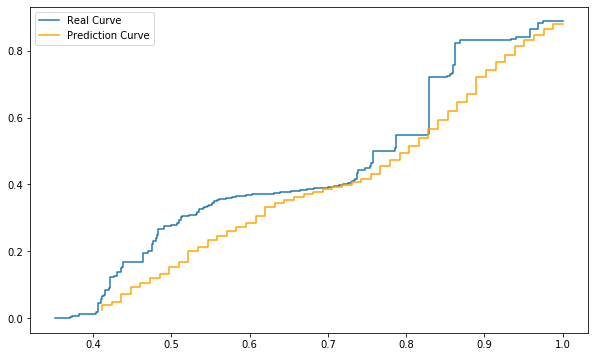

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using the Random Forest procedure
pp1 = rf_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
rf_l1_distances.mean()

1    0.0436034200
2    0.0478196706
3    0.0508696070
4    0.0518276362
5    0.0519011703
6    0.0498170867
7    0.0431098612
8    0.0340962677
9    0.0234654089
10   0.0184201993
11   0.0166675729
12   0.0161608581
13   0.0157849350
14   0.0156766623
15   0.0156591999
16   0.0158747163
17   0.0160160251
18   0.0162731287
19   0.0163980386
20   0.0166595490
21   0.0167260478
22   0.0165863624
23   0.0166466386
24   0.0184229801
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(rf_l1_distances.mean()) / 24, 4)

0.0269

## Analysis comparison Naive vs Random Forest

In [17]:
difference = naive_l1_distances.iloc[:, :25] - rf_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-0.8077950561,-0.9928296577,-0.8895501743,-0.9344159009,-1.1085066276,-1.1614185136,-0.7751249619,-0.7490720554,-0.6769176965,-1.7471056235,...,-2.6248897101,-2.1444542569,-2.1173091798,-1.6779254856,-0.9743463763,-1.0558231208,-1.3122657601,-0.9707469214,-0.9572795318,-0.8724633748
std,2.3420560683,5.2837386745,2.0027278610,2.2719825759,4.8139314776,6.8858616271,3.4542463073,3.1159077218,3.1489699427,24.0851445178,...,12.0983851646,9.9982382258,16.3384254244,11.0481842207,3.9831875812,5.2351901855,9.5136231185,3.0122887363,3.0869448599,2.8303233375
min,-28.2416868410,-134.4231843007,-16.8419952152,-34.7275504802,-113.0888984397,-177.0795664935,-70.1550320320,-55.2477074102,-44.4629621503,-638.6668306794,...,-169.2876099446,-196.8065149460,-409.5826547011,-259.5471235667,-53.0313440656,-101.2651416479,-240.4506019342,-43.4776197606,-39.7212647568,-44.1764371081
25%,-0.9221285549,-1.1006434247,-1.1946641151,-1.1948891090,-1.2305851795,-1.1190480232,-0.8373553990,-0.7394277996,-0.5788273437,-0.6662775816,...,-1.0979160011,-1.0021517304,-0.8973078266,-0.9283115203,-0.8204079269,-0.8606689876,-1.0241592999,-0.9924733759,-0.9624572741,-0.8924912512
50%,-0.1251587851,-0.1819008256,-0.2027328446,-0.2135284812,-0.2040343731,-0.1524515470,-0.0779297669,-0.0716741779,-0.0221143209,-0.0627710389,...,-0.1032443042,-0.0654134373,-0.0851685843,-0.0472365495,-0.0441656068,-0.0810911643,-0.1238210250,-0.0968590485,-0.1123482848,-0.1680962462
75%,0.2550829241,0.2568347747,0.2556793443,0.2315002634,0.2357583917,0.2466468377,0.2663509562,0.2736923309,0.2473221372,0.2413521657,...,0.2330013086,0.2426062814,0.2452597166,0.2647375086,0.2763734048,0.2440079246,0.2417898901,0.2211529385,0.2091361049,0.1699665950
max,0.6831917068,0.7485787968,0.7282590408,0.6937544312,0.6925785316,0.7073800630,0.7315213189,0.7043200388,0.8120343482,0.7590037104,...,0.8189082804,0.8370248633,0.8302659383,0.8292219184,0.8311896639,0.7760536337,0.7663681233,0.7626266719,0.8131945463,0.7651046924


# Random Forest + DNN

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)

In [ ]:
X_train.shape

(24264, 128)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)

In [ ]:
X_test.shape

(17544, 128)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# Create the Random Forest model for regression
random_forest = RandomForestRegressor(n_estimators=100, random_state=42)

# Create the MultiOutputRegressor model with the Random Forest
multi_output_forest = MultiOutputRegressor(random_forest)

# Train the model
multi_output_forest.fit(X_train, y_train)

# Compute the predictions using the test set
rf_predictions = multi_output_forest.predict(X_test)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

In [ ]:
# Loading the dataframe
rf_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest\rf_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_predictions.shape

(17544, 49)

In [ ]:
import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras import regularizers

# Build the neural network model
model = Sequential()
model.add(Dense(64, input_shape=(rf_predictions.shape[1], ), activation='relu'))
model.add(Dropout(0.1)) # Add dropout for regularization

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))

model.add(Dense(rf_predictions.shape[1]))  # Output layer with the same number of columns as y_train

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(rf_predictions, y_test, epochs=200, batch_size=32, verbose=1)

# Train the model with the training set
predictions = model.predict(rf_predictions)

Epoch 1/200
549/549 [==============================] - 1s 1ms/step - loss: 0.4206 - mean_absolute_error: 0.4134
Epoch 2/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3467 - mean_absolute_error: 0.3667
Epoch 3/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3344 - mean_absolute_error: 0.3565
Epoch 4/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3279 - mean_absolute_error: 0.3512
Epoch 5/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3222 - mean_absolute_error: 0.3457
Epoch 6/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3193 - mean_absolute_error: 0.3441
Epoch 7/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3184 - mean_absolute_error: 0.3423
Epoch 8/200
549/549 [==============================] - 1s 1ms/step - loss: 0.3180 - mean_absolute_error: 0.3422A: 0s - loss: 0.3221 - mean_absolute_erro
Epoch 9/200
549/549 [==============================] - 1s 1ms/s

549/549 [==============================] - 1s 2ms/step - loss: 0.2828 - mean_absolute_error: 0.3158
Epoch 145/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2843 - mean_absolute_error: 0.3164
Epoch 146/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2839 - mean_absolute_error: 0.3160
Epoch 147/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2834 - mean_absolute_error: 0.3162
Epoch 148/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2826 - mean_absolute_error: 0.3158
Epoch 149/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2849 - mean_absolute_error: 0.3165
Epoch 150/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2839 - mean_absolute_error: 0.3154
Epoch 151/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2867 - mean_absolute_error: 0.3179
Epoch 152/200
549/549 [==============================] - 1s 2ms/step - loss: 0.2826 - mean_absolute_er

In [ ]:
# Store the predictions into a dataframe
rf_dnn_predictions = pd.DataFrame(predictions)

In [ ]:
rf_dnn_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest + DNN\rf_dnn_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_dnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,1.4579302000,1.4993990000,1.6369468000,1.8465617000,1.9808096000,2.1072805000,2.2168267000,2.3057709000,2.3596911000,2.4480570000,...,3.1640236000,3.2042298000,3.2455878000,3.2559605000,3.2624474000,3.2684314000,3.3328366000,3.3179727000,3.3158503000,3.3311393000
1,2.0910053000,2.1541889000,2.3152866000,2.5542880000,2.6922073000,2.7965662000,2.8841438000,2.9407911000,2.9540477000,3.0147939000,...,3.5351355000,3.5633478000,3.5829340000,3.5711465000,3.5533700000,3.5374696000,3.5814683000,3.5476677000,3.5278930000,3.5349376000
2,1.2695264000,1.2915074000,1.4125946000,1.6042200000,1.7296345000,1.8732425000,1.9745992000,2.0701318000,2.1393213000,2.2461634000,...,3.1301665000,3.1396642000,3.1763854000,3.1786654000,3.1957135000,3.2063900000,3.2821238000,3.2689934000,3.2716360000,3.2848650000
3,1.2705246000,1.2898935000,1.4093610000,1.5975922000,1.7247276000,1.8645605000,1.9740807000,2.0708861000,2.1377058000,2.2426560000,...,3.1924994000,3.2144675000,3.2542028000,3.2635736000,3.2776868000,3.2854552000,3.3517480000,3.3337355000,3.3285189000,3.3373660000
4,1.6663553000,1.7200252000,1.8763465000,2.1010647000,2.2426555000,2.3651175000,2.4671980000,2.5450797000,2.5851280000,2.6646010000,...,3.3294806000,3.3569460000,3.3820062000,3.3783800000,3.3702705000,3.3627214000,3.4132059000,3.3870277000,3.3729400000,3.3805888000
5,1.8953129000,1.9554251000,2.1180350000,2.3545752000,2.4949730000,2.6090136000,2.7059534000,2.7743335000,2.8017788000,2.8700523000,...,3.4421732000,3.4723454000,3.4967370000,3.4894948000,3.4761052000,3.4643734000,3.5111806000,3.4806778000,3.4637508000,3.4719996000
6,1.3091920000,1.3575234000,1.5072200000,1.7029380000,1.8351789000,1.9457783000,2.0496213000,2.1361103000,2.1908095000,2.2794244000,...,3.1129692000,3.1485538000,3.1855845000,3.1977353000,3.2052412000,3.2095716000,3.2651713000,3.2438664000,3.2364745000,3.2425158000
7,0.1334397800,0.1225112400,0.1686538600,0.2365538500,0.3001361000,0.3652684400,0.4098773300,0.4747964400,0.5546399400,0.6578919000,...,2.0550718000,2.0417290000,2.0621884000,2.0783260000,2.1191869000,2.1240692000,2.1855283000,2.1961772000,2.2115000000,2.2347517000
8,0.0322953240,0.0211476870,0.0369096030,0.0556275770,0.0762278800,0.0995093800,0.1104465100,0.1410533200,0.1819473200,0.2410893100,...,1.6595213000,1.6164224000,1.6006124000,1.5861187000,1.5878856000,1.5690119000,1.5824220000,1.5711654000,1.5618844000,1.5562166000
9,0.0001895707,-0.0025182357,0.0044000517,0.0076958416,0.0153979370,0.0244955380,0.0250777680,0.0311741010,0.0386625000,0.0584653400,...,1.4088967000,1.3773729000,1.3607707000,1.3462573000,1.3410537000,1.3279933000,1.3258620000,1.3151702000,1.3027755000,1.2884732000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(rf_dnn_predictions.shape[0]):
    for c in range(rf_dnn_predictions.shape[1]):
        if rf_dnn_predictions.iloc[i, c] < 0:
            rf_dnn_predictions.iloc[i, c] = abs(rf_dnn_predictions.iloc[i, c])

In [ ]:
for i in range(rf_dnn_predictions.shape[0]):
    for c in range(rf_dnn_predictions.shape[1]):
        if c < rf_dnn_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and rf_dnn_predictions.iloc[i, c] > rf_dnn_predictions.iloc[i, c + 1] and rf_dnn_predictions.iloc[i, c] > rf_dnn_predictions.iloc[i, c + 2]:
                rf_dnn_predictions.iloc[i, c] = rf_dnn_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and rf_dnn_predictions.iloc[i, c] > rf_dnn_predictions.iloc[i, c + 1] and rf_dnn_predictions.iloc[i, c] > rf_dnn_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if rf_dnn_predictions.iloc[i, c + 1] >= rf_dnn_predictions.iloc[i, c - 1]:
                    rf_dnn_predictions.iloc[i, c] = rf_dnn_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if rf_dnn_predictions.iloc[i, c + 1] < rf_dnn_predictions.iloc[i, c - 1]:
                    rf_dnn_predictions.iloc[i, c + 1] = rf_dnn_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if rf_dnn_predictions.iloc[i, c] > rf_dnn_predictions.iloc[i, c + 1] and rf_dnn_predictions.iloc[i, c] < rf_dnn_predictions.iloc[i, c + 2]:
                rf_dnn_predictions.iloc[i, c + 1] = rf_dnn_predictions.iloc[i, c]
        if c >= rf_dnn_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if rf_dnn_predictions.iloc[i, c] < rf_dnn_predictions.iloc[i, c - 1]:
                rf_dnn_predictions.iloc[i, c] = rf_dnn_predictions.iloc[i, c - 1]

In [ ]:
rf_dnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,1.4579302000,1.4993990000,1.6369468000,1.8465617000,1.9808096000,2.1072805000,2.2168267000,2.3057709000,2.3596911000,2.4480570000,...,3.1640236000,3.2042298000,3.2455878000,3.2559605000,3.2624474000,3.2684314000,3.3179727000,3.3179727000,3.3179727000,3.3311393000
1,2.0910053000,2.1541889000,2.3152866000,2.5542880000,2.6922073000,2.7965662000,2.8841438000,2.9407911000,2.9540477000,3.0147939000,...,3.5351355000,3.5633478000,3.5711465000,3.5711465000,3.5711465000,3.5711465000,3.5814683000,3.5814683000,3.5814683000,3.5814683000
2,1.2695264000,1.2915074000,1.4125946000,1.6042200000,1.7296345000,1.8732425000,1.9745992000,2.0701318000,2.1393213000,2.2461634000,...,3.2480865000,3.2480865000,3.2480865000,3.2480865000,3.2480865000,3.2480865000,3.2689934000,3.2689934000,3.2716360000,3.2848650000
3,1.2705246000,1.2898935000,1.4093610000,1.5975922000,1.7247276000,1.8645605000,1.9740807000,2.0708861000,2.1377058000,2.2426560000,...,3.1935110000,3.2144675000,3.2542028000,3.2635736000,3.2776868000,3.2854552000,3.3337355000,3.3337355000,3.3337355000,3.3373660000
4,1.6663553000,1.7200252000,1.8763465000,2.1010647000,2.2426555000,2.3651175000,2.4671980000,2.5450797000,2.5851280000,2.6646010000,...,3.3294806000,3.3569460000,3.3783800000,3.3783800000,3.3783800000,3.3783800000,3.3870277000,3.3870277000,3.3870277000,3.3870277000
5,1.8953129000,1.9554251000,2.1180350000,2.3545752000,2.4949730000,2.6090136000,2.7059534000,2.7743335000,2.8017788000,2.8700523000,...,3.4421732000,3.4723454000,3.4894948000,3.4894948000,3.4894948000,3.4894948000,3.5111806000,3.5111806000,3.5111806000,3.5111806000
6,1.3091920000,1.3575234000,1.5072200000,1.7029380000,1.8351789000,1.9457783000,2.0496213000,2.1361103000,2.1908095000,2.2794244000,...,3.1129692000,3.1485538000,3.1855845000,3.1977353000,3.2052412000,3.2095716000,3.2438664000,3.2438664000,3.2438664000,3.2438664000
7,0.1334397800,0.1334397800,0.1686538600,0.2365538500,0.3001361000,0.3652684400,0.4098773300,0.4747964400,0.5546399400,0.6578919000,...,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000,2.4044683000
8,0.0322953240,0.0322953240,0.0369096030,0.0556275770,0.0762278800,0.0995093800,0.1104465100,0.1410533200,0.1819473200,0.2410893100,...,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000,2.0662136000
9,0.0001895707,0.0025182357,0.0044000517,0.0076958416,0.0153979370,0.0244955380,0.0250777680,0.0311741010,0.0386625000,0.0584653400,...,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000,1.6033837000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(rf_dnn_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

rf_dnn_predictions = rf_dnn_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
rf_dnn_predictions.to_csv('rf_dnn_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
rf_dnn_predictions = rf_dnn_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
rf_dnn_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # Compute the prediction using Random Forest + DNN procedure
    pp1 = rf_dnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    rf_dnn_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
rf_dnn_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.04616900689276993
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.04590234070366721
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.073318336038591
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.08568508597570532
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.08047693346089971
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.06626399483774262
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.06466462852328245
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.09045442646572795
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.07871964367975826
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.06567518829505802
------------------------

D

Distancia L1 (Manhattan) para la hora 11 del día 1016: 0.012847938399182543
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1016: 0.012564891370368992
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1016: 0.011792605078019026
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1016: 0.017261293024057864
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1016: 0.013028073411051829
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1016: 0.010123224561486868
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1016: 0.011753151124957423
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1016: 0.012964113344220034
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1016: 0.013530769968959884
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1016: 0.013091559217861634
------

Distancia L1 (Manhattan) para la hora 4 del día 1021: 0.05044240486280159
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1021: 0.061260568710823284
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1021: 0.05679605855539245
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1021: 0.04844530303669843
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1021: 0.018326619714429518
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1021: 0.01455787018519739
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1021: 0.016584396344028203
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1021: 0.022297718013660903
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1021: 0.021241177854189892
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1021: 0.022489675711321787
----------------

Distancia L1 (Manhattan) para la hora 10 del día 1025: 0.013620055970825311
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1025: 0.010597368438305374
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1025: 0.010552516343177925
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1025: 0.011305044318547963
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1025: 0.012072578210712188
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1025: 0.012650558575577672
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1025: 0.013626890793649656
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1025: 0.013169921960998789
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1025: 0.015409440483241136
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1025: 0.015642425855879417
------

Distancia L1 (Manhattan) para la hora 7 del día 1030: 0.060926325265078955
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1030: 0.03764723430593714
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1030: 0.03683604798611058
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1030: 0.039816703371910636
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1030: 0.03712252342993827
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1030: 0.035545579114200254
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1030: 0.028469171908786627
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1030: 0.025100532567826662
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1030: 0.02660679648022126
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1030: 0.029804326306962475
-------------

Distancia L1 (Manhattan) para la hora 22 del día 1033: 0.02151309721321913
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1033: 0.024004451581152005
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1033: 0.029029557174888525
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1034: 0.020141949584983675
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1034: 0.020628916650668884
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1034: 0.025205201616631763
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1034: 0.02305820576605086
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1034: 0.019650324537848915
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1034: 0.023713819957909832
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1034: 0.02560475375862186
----------------

Distancia L1 (Manhattan) para la hora 19 del día 1037: 0.016181482785647912
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1037: 0.01589511911234359
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1037: 0.011964485113617907
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1037: 0.012587659596725836
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1037: 0.013667624478573368
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1037: 0.02564317209819685
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1038: 0.02882554046023346
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1038: 0.028708205757699515
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1038: 0.02826956508598958
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1038: 0.026436502217565435
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1041: 0.007373916274526311
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1041: 0.005843336975247765
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1041: 0.02973559914175209
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1041: 0.035867478377593846
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1041: 0.040447405844991006
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1041: 0.035101522862673755
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1041: 0.032995819596605636
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1041: 0.03756762002705748
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1041: 0.03222277389733092
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1042: 0.041281117074299295
----------

Distancia L1 (Manhattan) para la hora 12 del día 1045: 0.009065549091328373
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1045: 0.011118550983378937
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1045: 0.011665386725927242
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1045: 0.008897247529074667
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1045: 0.009350580191333663
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1045: 0.008800066895097155
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1045: 0.01486916552387832
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1045: 0.014561310689589633
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1045: 0.010277182954199318
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1045: 0.007246266177821786
-------

Distancia L1 (Manhattan) para la hora 19 del día 1049: 0.012594779563646226
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1049: 0.013152033479316073
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1049: 0.01411096211740997
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1049: 0.011490505815978862
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1049: 0.011070207628452232
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1049: 0.016486238998864335
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1050: 0.021892145005685718
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1050: 0.025395493110801422
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1050: 0.03496381679766192
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1050: 0.046988400956105174
------------

Distancia L1 (Manhattan) para la hora 12 del día 1053: 0.030550929931519637
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1053: 0.027478582370406505
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1053: 0.0263320561427038
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1053: 0.02399165435801297
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1053: 0.02022249895908524
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1053: 0.01642421181292817
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1053: 0.009375458809683872
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1053: 0.009602738458009496
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1053: 0.009987923049233466
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1053: 0.01007237193431747
------------

Distancia L1 (Manhattan) para la hora 6 del día 1057: 0.028164923580276318
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1057: 0.02963916003782393
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1057: 0.024208383150778903
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1057: 0.031016006159671303
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1057: 0.037798078271073406
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1057: 0.03987988060237204
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1057: 0.04233877999759439
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1057: 0.03610819272566197
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1057: 0.03332330578438679
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1057: 0.029337044867161738
---------------

Distancia L1 (Manhattan) para la hora 11 del día 1061: 0.01603954397822839
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1061: 0.013400235649112132
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1061: 0.01283299168483508
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1061: 0.01265917401463579
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1061: 0.01000626099147546
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1061: 0.010380132357091124
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1061: 0.013480652453536864
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1061: 0.017308490641122144
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1061: 0.014368351840063805
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1061: 0.013741742760071542
----------

Distancia L1 (Manhattan) para la hora 15 del día 1065: 0.017382311042894987
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1065: 0.01411783351276102
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1065: 0.012283678522384114
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1065: 0.010806100566176834
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1065: 0.010019048430665188
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1065: 0.00930840299272457
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1065: 0.009586207520453607
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1065: 0.00940810744723606
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1065: 0.012007549976120316
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1065: 0.01383626044763824
----------

Distancia L1 (Manhattan) para la hora 13 del día 1070: 0.014288105707085387
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1070: 0.014481182902485538
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1070: 0.015315462851165775
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1070: 0.015459248854792149
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1070: 0.015498473010440238
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1070: 0.015423003253370593
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1070: 0.01422593633644905
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1070: 0.01944665662209644
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1070: 0.018656546039698
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1070: 0.0186758749463299
-------------

Distancia L1 (Manhattan) para la hora 1 del día 1074: 0.06500690872121116
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1074: 0.040952670088353495
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1074: 0.06530574288900079
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1074: 0.06520221397944939
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1074: 0.05463641125337391
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1074: 0.04064891349919372
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1074: 0.032824036709278824
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1074: 0.034803273210398784
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1074: 0.01748719111520897
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1074: 0.014668074742333437
---------------------

Distancia L1 (Manhattan) para la hora 12 del día 1077: 0.0360669380382628
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1077: 0.03331310773415537
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1077: 0.028052933240372103
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1077: 0.03117458747327692
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1077: 0.031256642662419606
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1077: 0.03316404091994923
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1077: 0.03239391003096065
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1077: 0.030623437295735134
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1077: 0.03218533531843258
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1077: 0.029039322371366978
-------------

Distancia L1 (Manhattan) para la hora 3 del día 1081: 0.043971433010870434
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1081: 0.04202025468314932
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1081: 0.025585951256919218
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1081: 0.03131984009071384
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1081: 0.03237125776099459
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1081: 0.04026488873196804
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1081: 0.026699414406637804
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1081: 0.01699742175205639
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1081: 0.014506888029130704
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1081: 0.01065062310606726
-------------------

Distancia L1 (Manhattan) para la hora 22 del día 1084: 0.01327375131064159
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1084: 0.010760347802037811
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1084: 0.011719316791720818
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1085: 0.031273722979042864
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1085: 0.032649922726538896
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1085: 0.03832162398652121
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1085: 0.041004098466743244
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1085: 0.049356793944271685
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1085: 0.05710856450346344
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1085: 0.02771262384429912
-----------------

Distancia L1 (Manhattan) para la hora 2 del día 1090: 0.022781028248910158
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1090: 0.022164917967695187
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1090: 0.021300828477836008
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1090: 0.026797874111495056
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1090: 0.024213753663303417
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1090: 0.02425146163270399
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1090: 0.01693899388042686
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1090: 0.012277926212224698
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1090: 0.012019527389790558
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1090: 0.01467686234605116
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1094: 0.020066555415085886
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1094: 0.01873996156451222
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1094: 0.016570625031546715
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1094: 0.016044759581704413
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1094: 0.015193395752651278
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1094: 0.01765358836199165
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1094: 0.01669077430012056
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1094: 0.014283045236870708
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1094: 0.011208730548892081
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1094: 0.011983112459761532
---------

Distancia L1 (Manhattan) para la hora 13 del día 1098: 0.018209394290840574
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1098: 0.018083511141595506
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1098: 0.016500581459291546
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1098: 0.016229248798053077
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1098: 0.01664293320024624
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1098: 0.015705255904681355
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1098: 0.013453412146923992
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1098: 0.016160866205608825
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1098: 0.016507970688541027
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1098: 0.015469826113352347
-------

Distancia L1 (Manhattan) para la hora 14 del día 1102: 0.026990558473511728
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1102: 0.028660469894561492
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1102: 0.02581578013589679
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1102: 0.027566766241604097
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1102: 0.021268928796246082
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1102: 0.01905631269073578
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1102: 0.015120451366879036
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1102: 0.0206559242723261
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1102: 0.020476565361439165
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1102: 0.026743126241797616
----------

Distancia L1 (Manhattan) para la hora 14 del día 1107: 0.009735849632439533
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1107: 0.010844487514508058
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1107: 0.01226458960497125
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1107: 0.01250762914156245
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1107: 0.011875849296524795
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1107: 0.012465895557444182
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1107: 0.012777519233951578
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1107: 0.01290284425937286
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1107: 0.012356796731273666
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1107: 0.012400127149252874
---------

Distancia L1 (Manhattan) para la hora 15 del día 1112: 0.013869506016565083
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1112: 0.017482968793791145
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1112: 0.016700237196957703
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1112: 0.018906759297670196
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1112: 0.016619866017937055
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1112: 0.017272816961677165
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1112: 0.014009134290194972
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1112: 0.012588294896760565
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1112: 0.013523045418667463
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1112: 0.017139017237835667
------

Distancia L1 (Manhattan) para la hora 16 del día 1116: 0.010961273444992009
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1116: 0.012219584960065593
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1116: 0.014115343310332373
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1116: 0.018321273716671322
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1116: 0.019995283472592988
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1116: 0.018715416068435912
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1116: 0.024247688657420594
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1116: 0.019823734728383224
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1116: 0.026410394216660294
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1117: 0.06091797360499244
--------

Distancia L1 (Manhattan) para la hora 14 del día 1121: 0.022607062959243973
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1121: 0.029345444960281648
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1121: 0.024041684232303077
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1121: 0.022039604545486268
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1121: 0.021730353390819905
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1121: 0.020926020948534095
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1121: 0.02006393733608816
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1121: 0.017596998504421132
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1121: 0.01924192812420011
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1121: 0.017994755205315117
--------

Distancia L1 (Manhattan) para la hora 11 del día 1126: 0.023524214533213378
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1126: 0.02654006446661283
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1126: 0.025459160223792944
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1126: 0.023109217007999894
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1126: 0.026956878323132896
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1126: 0.02492604514353586
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1126: 0.03440959231492244
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1126: 0.029809104130824444
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1126: 0.03662740746667578
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1126: 0.033041665969397074
----------

Distancia L1 (Manhattan) para la hora 10 del día 1130: 0.018201932201739053
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1130: 0.015222170834078199
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1130: 0.017723781610923882
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1130: 0.01776675834082299
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1130: 0.017615558276340412
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1130: 0.017179288221365184
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1130: 0.01975666238202426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1130: 0.01782246089382174
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1130: 0.014484846970244193
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1130: 0.01685347801516909
----------

Distancia L1 (Manhattan) para la hora 8 del día 1135: 0.025406344737132686
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1135: 0.021093022722900076
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1135: 0.011442843915166019
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1135: 0.01480800543809387
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1135: 0.013900571888238794
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1135: 0.013309787936877817
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1135: 0.013167355149001653
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1135: 0.011862136206735494
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1135: 0.008988510285820138
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1135: 0.009815994463733983
---------

Distancia L1 (Manhattan) para la hora 24 del día 1139: 0.03356443599161242
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1140: 0.046942981432556
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1140: 0.07100823902894057
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1140: 0.07239666135785013
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1140: 0.07854312640202898
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1140: 0.08699412751731872
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1140: 0.07381850133534218
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1140: 0.08074419271979741
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1140: 0.05414560187241069
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1140: 0.057289360738698
------------------------

Dis

Distancia L1 (Manhattan) para la hora 17 del día 1144: 0.015179828653240655
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1144: 0.010708390854803676
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1144: 0.008575138185611807
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1144: 0.012386402182646555
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1144: 0.014925878412806744
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1144: 0.015411123838540843
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1144: 0.014371204974831919
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1144: 0.01614038132044178
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1145: 0.03675882643450537
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1145: 0.03546148015916297
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1149: 0.021149894549013046
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1149: 0.01940088127847824
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1149: 0.014534678663006631
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1149: 0.013169935098591067
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1149: 0.012856367723300444
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1149: 0.011394515938052342
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1149: 0.01356514133512765
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1149: 0.015452706870714615
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1149: 0.027236934822155355
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1150: 0.01984026017433341
----------

Distancia L1 (Manhattan) para la hora 20 del día 1156: 0.01609567856488255
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1156: 0.015310715334834983
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1156: 0.014046542270961467
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1156: 0.01221216460863232
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1156: 0.013579222234047764
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1157: 0.021690154709532748
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1157: 0.025510465306614737
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1157: 0.02973358612659628
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1157: 0.02867991775174247
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1157: 0.022418853907417186
---------------

Distancia L1 (Manhattan) para la hora 24 del día 1160: 0.012008901855066301
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1161: 0.029388217659563825
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1161: 0.02850098079210014
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1161: 0.025765310350667033
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1161: 0.021756054173260257
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1161: 0.02136029730922837
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1161: 0.024441783151701466
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1161: 0.025574917232260914
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1161: 0.018192420278274092
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1161: 0.0159977975383138
-------------------

Distancia L1 (Manhattan) para la hora 8 del día 1165: 0.048128698559396416
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1165: 0.04001457044071662
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1165: 0.025403530317298237
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1165: 0.019780324983962108
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1165: 0.015344147717683769
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1165: 0.013707388996377481
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1165: 0.011593426228043534
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1165: 0.006697968296353076
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1165: 0.006946315491490123
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1165: 0.010839001981476054
---------

Distancia L1 (Manhattan) para la hora 1 del día 1169: 0.01922393394229533
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1169: 0.018812480639758614
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1169: 0.020800943477503685
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1169: 0.024629669362549504
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1169: 0.023952478922694045
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1169: 0.027011083156288987
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1169: 0.02749582635640515
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1169: 0.020846195290856802
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1169: 0.029512355740325503
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1169: 0.01800860606122796
------------------

Distancia L1 (Manhattan) para la hora 12 del día 1173: 0.012752899228383536
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1173: 0.01628568853832177
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1173: 0.01745623600156122
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1173: 0.017191404778179827
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1173: 0.01133140426395222
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1173: 0.011169114036212782
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1173: 0.010617723374137685
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1173: 0.010320498226093364
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1173: 0.011312671664923328
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1173: 0.015806004620041246
---------

Distancia L1 (Manhattan) para la hora 24 del día 1176: 0.01907426787770148
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1177: 0.021589260525731856
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1177: 0.035159879843629005
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1177: 0.033525525439832074
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1177: 0.02978169130857787
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1177: 0.03788631384668031
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1177: 0.03258085645621368
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1177: 0.026885523962692094
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1177: 0.01664393601696848
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1177: 0.013895968221433868
--------------------

Distancia L1 (Manhattan) para la hora 21 del día 1181: 0.021453551852014273
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1181: 0.013635542174143934
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1181: 0.006426352574566829
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1181: 0.00625651841259252
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1182: 0.02340139481766991
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1182: 0.025533817616688756
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1182: 0.016257255407343206
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1182: 0.017023283606792203
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1182: 0.026804439335151732
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1182: 0.022557718738693777
--------------

Distancia L1 (Manhattan) para la hora 6 del día 1185: 0.06378993817155806
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1185: 0.05684893866580177
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1185: 0.038448960004523317
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1185: 0.019200630442295308
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1185: 0.016981780969518096
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1185: 0.010362628148141415
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1185: 0.007670805138947882
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1185: 0.005782864410246283
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1185: 0.0071757174115217055
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1185: 0.008156719112061847
-----------

Distancia L1 (Manhattan) para la hora 7 del día 1189: 0.04660596842301932
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1189: 0.01661925408471186
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1189: 0.008826968721188518
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1189: 0.01625204112627691
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1189: 0.01338240719118973
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1189: 0.015350768149854907
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1189: 0.017898618972138826
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1189: 0.017001467486582544
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1189: 0.012181805072723616
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1189: 0.010886883716690254
-------------

Distancia L1 (Manhattan) para la hora 24 del día 1192: 0.01672119762189523
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1193: 0.01572983660960099
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1193: 0.03077004494032424
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1193: 0.033721683361562865
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1193: 0.030797358727781277
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1193: 0.034599285001339145
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1193: 0.02613413689704089
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1193: 0.03284878979159063
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1193: 0.06546036949809711
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1193: 0.027831399394305213
---------------------

Distancia L1 (Manhattan) para la hora 20 del día 1196: 0.008009253861761214
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1196: 0.010379486949560658
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1196: 0.014276560019874877
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1196: 0.010799842169248793
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1196: 0.010825212602995354
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1197: 0.031109774595500583
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1197: 0.030057290832268612
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1197: 0.03785247273578624
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1197: 0.029968851882742394
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1197: 0.041293765989937704
------------

Distancia L1 (Manhattan) para la hora 10 del día 1201: 0.014035639604478341
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1201: 0.014581096252515613
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1201: 0.014171319704368749
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1201: 0.012464519929514768
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1201: 0.008379928249117373
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1201: 0.01048842528834119
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1201: 0.007759528990356067
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1201: 0.010394096156933643
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1201: 0.010579505106622537
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1201: 0.010292645529006566
-------

Distancia L1 (Manhattan) para la hora 19 del día 1204: 0.00462742861159654
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1204: 0.004878096349607931
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1204: 0.007375895065730631
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1204: 0.006998726534406031
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1204: 0.005716700123939814
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1204: 0.0061490935915509
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1205: 0.020932708977328227
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1205: 0.02202754822613783
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1205: 0.020253194652825414
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1205: 0.027641207881334378
--------------

Distancia L1 (Manhattan) para la hora 8 del día 1209: 0.0194990221712362
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1209: 0.005853225794773959
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1209: 0.0045797074328062255
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1209: 0.0050396177644002945
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1209: 0.0046682918898256565
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1209: 0.004790801336194767
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1209: 0.007048965783914573
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1209: 0.009898600919157452
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1209: 0.014366252502690875
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1209: 0.01793391259825141
--------

Distancia L1 (Manhattan) para la hora 18 del día 1212: 0.009351140646342558
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1212: 0.007125233388082384
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1212: 0.005125007682037853
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1212: 0.0054637123154212125
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1212: 0.005381293775314956
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1212: 0.006316733798372142
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1212: 0.005121527061277941
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1213: 0.03436339616453046
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1213: 0.02635122518848306
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1213: 0.023953812816532093
----------

Distancia L1 (Manhattan) para la hora 3 del día 1216: 0.04147582386513989
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1216: 0.03933634676811406
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1216: 0.04010456158413718
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1216: 0.03664882497927324
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1216: 0.024971654999191614
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1216: 0.013695413613722925
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1216: 0.008679280928623585
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1216: 0.0082642484060771
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1216: 0.0071474421729437595
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1216: 0.007680919766113648
------------------

Distancia L1 (Manhattan) para la hora 23 del día 1220: 0.007906996106588814
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1220: 0.005107878451184263
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1221: 0.025667891710301472
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1221: 0.031236600774106536
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1221: 0.028411179214371234
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1221: 0.0427440168333817
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1221: 0.035061548654136285
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1221: 0.03722689126055279
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1221: 0.034322802000039745
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1221: 0.035601830149181106
-----------------

Distancia L1 (Manhattan) para la hora 8 del día 1224: 0.012815754815926953
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1224: 0.013082178927206043
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1224: 0.008825933405592767
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1224: 0.006694242151174506
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1224: 0.005893700134993312
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1224: 0.00560005304405036
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1224: 0.006136632250771027
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1224: 0.005581155258308948
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1224: 0.0058094242047721754
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1224: 0.005685759086022845
--------

Distancia L1 (Manhattan) para la hora 21 del día 1227: 0.005895449960153518
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1227: 0.006197596859842577
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1227: 0.00588901098062837
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1227: 0.012597714643245432
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1228: 0.028620238062763627
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1228: 0.025958139778967784
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1228: 0.02670070689476203
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1228: 0.021676901613724774
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1228: 0.027285756013288132
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1228: 0.03140314024012216
---------------

Distancia L1 (Manhattan) para la hora 12 del día 1231: 0.0061345102449824026
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1231: 0.0068956593190434776
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1231: 0.007109676004485366
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1231: 0.007941214273079292
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1231: 0.009294449433542379
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1231: 0.010332195712794605
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1231: 0.012988195190931646
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1231: 0.012484707792226126
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1231: 0.012782847446380311
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1231: 0.01133005553591054
-----

Distancia L1 (Manhattan) para la hora 2 del día 1235: 0.024899905075691137
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1235: 0.01867684354385178
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1235: 0.02350667794108071
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1235: 0.0245303152625607
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1235: 0.023571896891890754
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1235: 0.02066213431610195
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1235: 0.023099148851249
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1235: 0.013071228349707142
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1235: 0.010714100337141598
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1235: 0.010552388367572042
----------------------

Distancia L1 (Manhattan) para la hora 8 del día 1239: 0.03850839428229102
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1239: 0.012587062288774424
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1239: 0.008590509271258394
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1239: 0.004553396531278477
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1239: 0.004498093034024501
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1239: 0.007353473067456185
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1239: 0.008889728076962138
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1239: 0.007327832701929219
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1239: 0.006004180620840742
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1239: 0.007646129322853218
---------

Distancia L1 (Manhattan) para la hora 17 del día 1242: 0.00720213638270777
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1242: 0.006100836104610359
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1242: 0.005172591227000866
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1242: 0.008118980579735419
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1242: 0.009049874593023663
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1242: 0.009226620377471633
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1242: 0.00869941495157528
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1242: 0.0059531329685786945
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1243: 0.0244802665193675
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1243: 0.03275468087613864
------------

Distancia L1 (Manhattan) para la hora 11 del día 1246: 0.018311152043550147
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1246: 0.015615935120692153
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1246: 0.015088075000709644
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1246: 0.012047328901605935
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1246: 0.008729546425255473
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1246: 0.007167110267635438
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1246: 0.007640391181620266
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1246: 0.0069651287763463346
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1246: 0.006196895167517952
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1246: 0.005848328812483665
-----

Distancia L1 (Manhattan) para la hora 4 del día 1251: 0.02413180429583414
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1251: 0.02754987043101017
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1251: 0.029969236229954944
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1251: 0.03097500928685347
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1251: 0.024776479710445665
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1251: 0.031080913566258826
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1251: 0.02797010214498063
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1251: 0.019894689608761236
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1251: 0.006887079339706273
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1251: 0.008290942711864865
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1256: 0.038534519622857
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1256: 0.023108568122128206
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1256: 0.013306981327429836
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1256: 0.013292237180377427
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1256: 0.01704626280114638
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1256: 0.01762893734629431
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1256: 0.017442165128224205
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1256: 0.016395810758913772
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1256: 0.006719492587155389
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1256: 0.00648624234261045
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1261: 0.039339999211999266
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1261: 0.016575561773369565
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1261: 0.01824615363321062
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1261: 0.005116085287124454
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1261: 0.007010596848126411
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1261: 0.011363077674467932
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1261: 0.011748805272728185
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1261: 0.010277744881185779
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1261: 0.008467260026971846
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1261: 0.006954576546144297
----------

Distancia L1 (Manhattan) para la hora 1 del día 1267: 0.01954571044375032
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1267: 0.0219710256583181
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1267: 0.02239828609666082
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1267: 0.024580147257382938
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1267: 0.026781469049518267
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1267: 0.034077891973088796
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1267: 0.02486624034449741
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1267: 0.009290589133465551
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1267: 0.008235148294619432
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1267: 0.012755658783914875
--------------------

Distancia L1 (Manhattan) para la hora 14 del día 1270: 0.011743656161174561
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1270: 0.01214033646663602
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1270: 0.012699007712248701
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1270: 0.013210566827769494
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1270: 0.011910307153412174
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1270: 0.012801346237307235
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1270: 0.014969302422220394
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1270: 0.015037546481072318
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1270: 0.01095485524201755
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1270: 0.013546308681492786
--------

Distancia L1 (Manhattan) para la hora 6 del día 1275: 0.02656468209734808
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1275: 0.01803440984777446
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1275: 0.0164991855612285
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1275: 0.009472360812996367
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1275: 0.007859233274468289
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1275: 0.004989859144816954
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1275: 0.0038746612977975416
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1275: 0.005733825811370491
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1275: 0.006344332530143172
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1275: 0.007133855728292761
-------------

Distancia L1 (Manhattan) para la hora 12 del día 1280: 0.006571964883414944
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1280: 0.006994425596919579
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1280: 0.008088198518599939
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1280: 0.011607677783416625
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1280: 0.00841576102920673
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1280: 0.008640087798788871
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1280: 0.006955644223357517
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1280: 0.008102902961057949
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1280: 0.014057877437342724
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1280: 0.013455064974497328
-------

Distancia L1 (Manhattan) para la hora 21 del día 1284: 0.013520396073999394
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1284: 0.014059833649163373
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1284: 0.015280492878750268
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1284: 0.015561296145921551
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1285: 0.02441508457798667
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1285: 0.03368043272452613
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1285: 0.032629741171428375
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1285: 0.028111426430463233
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1285: 0.04898957136016914
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1285: 0.042103839584423874
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1289: 0.024740480486511267
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1289: 0.02053423844952663
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1289: 0.014826306267744858
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1289: 0.013118118456057672
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1289: 0.011432206536642632
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1289: 0.013507026076112595
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1289: 0.019098202249726727
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1289: 0.01969906437402612
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1289: 0.024110406566007964
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1289: 0.027155973764590814
----------

Distancia L1 (Manhattan) para la hora 10 del día 1294: 0.016454075248740596
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1294: 0.01756581617711913
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1294: 0.016647824875857115
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1294: 0.013875865275070275
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1294: 0.011030976393945537
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1294: 0.011807689173511292
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1294: 0.009276636045306652
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1294: 0.008407095798941439
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1294: 0.009610053319287513
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1294: 0.00809632005003838
--------

Distancia L1 (Manhattan) para la hora 22 del día 1298: 0.021663706886826936
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1298: 0.01989157560567529
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1298: 0.03220933931593972
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1299: 0.03131732644166742
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1299: 0.03749274359961889
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1299: 0.03361022566769971
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1299: 0.028284256030232074
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1299: 0.02147973066599891
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1299: 0.0211323540787199
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1299: 0.02068799010590309
----------------------

Distancia L1 (Manhattan) para la hora 16 del día 1303: 0.010136167457898186
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1303: 0.007837056324595006
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1303: 0.005834879648523739
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1303: 0.008002689821635057
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1303: 0.006891843913801196
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1303: 0.007404954839163933
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1303: 0.006982891951700899
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1303: 0.006764408327334528
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1303: 0.004269458902578568
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1304: 0.014373238529478742
-------

Distancia L1 (Manhattan) para la hora 4 del día 1308: 0.05838224842535044
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1308: 0.07361440761052199
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1308: 0.058490004161324896
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1308: 0.03480249652408202
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1308: 0.01968810067727758
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1308: 0.019458991636888984
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1308: 0.016539035009219827
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1308: 0.015477035209180132
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1308: 0.008477814814308562
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1308: 0.009008885963336679
----------------

Distancia L1 (Manhattan) para la hora 13 del día 1312: 0.0316826931290945
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1312: 0.03207303796021865
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1312: 0.029748624796286732
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1312: 0.02508782375252424
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1312: 0.030848575721939768
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1312: 0.039311960586328715
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1312: 0.03982048140825884
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1312: 0.02707152933840607
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1312: 0.026982983633979878
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1312: 0.028658175700367685
------------

Distancia L1 (Manhattan) para la hora 7 del día 1317: 0.09219971840351758
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1317: 0.039628902028712436
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1317: 0.039226899985108116
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1317: 0.03845809024389479
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1317: 0.04363017100569915
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1317: 0.04463051505589867
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1317: 0.042040575342502794
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1317: 0.04491520920090749
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1317: 0.04927113298253602
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1317: 0.05384294715456646
----------------

Distancia L1 (Manhattan) para la hora 11 del día 1321: 0.01329875600429046
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1321: 0.011945401363361653
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1321: 0.010901277543607023
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1321: 0.011199543275112845
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1321: 0.009954071509587182
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1321: 0.010391236489141443
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1321: 0.00744948485539575
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1321: 0.006318764635364606
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1321: 0.006153462419967888
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1321: 0.006254090547935836
--------

Distancia L1 (Manhattan) para la hora 23 del día 1324: 0.00966247185148192
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1324: 0.01853678923123213
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1325: 0.022299394512786553
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1325: 0.03090854794551173
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1325: 0.052788173844048485
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1325: 0.042744012057081775
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1325: 0.05110476682087949
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1325: 0.04094252892095902
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1325: 0.05941087871246291
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1325: 0.0397691809243272
----------------------

Distancia L1 (Manhattan) para la hora 13 del día 1328: 0.009035135515098299
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1328: 0.010546748265728581
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1328: 0.011144360110005861
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1328: 0.010140799115914059
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1328: 0.009178326553868937
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1328: 0.010128395358401425
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1328: 0.010424462374849295
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1328: 0.009366992006157515
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1328: 0.00880292540724988
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1328: 0.009035755562032914
-------

Distancia L1 (Manhattan) para la hora 13 del día 1332: 0.008976678081998073
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1332: 0.008295421339543939
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1332: 0.008417320053684268
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1332: 0.009034394632919622
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1332: 0.008180989890544152
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1332: 0.007102988159585374
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1332: 0.008906622513772016
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1332: 0.006957056419105629
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1332: 0.007754352676838324
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1332: 0.007315863696561521
------

Distancia L1 (Manhattan) para la hora 17 del día 1336: 0.006914157236701144
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1336: 0.0068551646981565755
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1336: 0.007218591299422039
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1336: 0.007343297035048825
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1336: 0.008264326483913769
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1336: 0.008997772383937922
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1336: 0.008683598770117026
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1336: 0.010691296421343002
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1337: 0.021835574360913806
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1337: 0.03786637508415255
--------

Distancia L1 (Manhattan) para la hora 7 del día 1340: 0.028161754256688893
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1340: 0.027959226319248284
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1340: 0.023813345625231012
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1340: 0.0223867660945107
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1340: 0.017321852192803987
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1340: 0.016371399680682866
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1340: 0.015755226102104284
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1340: 0.014774472698151957
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1340: 0.016760838660649126
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1340: 0.013793667836338614
-----------

Distancia L1 (Manhattan) para la hora 24 del día 1343: 0.014194351652794441
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1344: 0.020877198143621815
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1344: 0.02273391374490788
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1344: 0.025632974629988224
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1344: 0.026050756792043432
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1344: 0.024941184984909763
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1344: 0.022494203522636175
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1344: 0.01862789410843426
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1344: 0.013519847665215
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1344: 0.012796775921839455
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1347: 0.032854995951295506
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1347: 0.030252688746944954
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1347: 0.028562096747762368
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1347: 0.028628017787695064
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1347: 0.03488643402097582
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1347: 0.03264244212873507
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1347: 0.022784094448805366
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1347: 0.017051279867721758
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1347: 0.016534581266075175
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1347: 0.01566938457822764
---------

Distancia L1 (Manhattan) para la hora 20 del día 1351: 0.012350157430017186
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1351: 0.012432830877906736
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1351: 0.013646100561481177
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1351: 0.013932929576395263
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1351: 0.01607590996495729
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1352: 0.040537330132944194
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1352: 0.04530886172695918
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1352: 0.058095130971887315
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1352: 0.0641194549544263
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1352: 0.06439728606429013
----------------

Distancia L1 (Manhattan) para la hora 5 del día 1356: 0.020733923002997444
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1356: 0.03646933115943603
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1356: 0.019006015597971812
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1356: 0.010397679188288027
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1356: 0.010718008889246516
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1356: 0.011086235428766071
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1356: 0.011168872505339699
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1356: 0.011012794486688073
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1356: 0.010883180524057949
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1356: 0.011549944193254833
------------

Distancia L1 (Manhattan) para la hora 19 del día 1360: 0.01071410513475435
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1360: 0.009122849795338504
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1360: 0.008639263128027638
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1360: 0.008973323939907987
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1360: 0.009207925883169347
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1360: 0.009098921353899931
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1361: 0.028523684146932304
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1361: 0.01993276081259515
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1361: 0.02046654847885316
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1361: 0.018923353116672342
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1366: 0.008654100792905906
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1366: 0.007521347654702115
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1366: 0.009080049051228029
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1366: 0.013944508823998773
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1366: 0.014417222979592656
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1366: 0.013376125550360399
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1366: 0.013850759447629167
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1366: 0.013310747472042524
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1367: 0.04755208256463994
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1367: 0.04268601313917075
----------

Distancia L1 (Manhattan) para la hora 22 del día 1370: 0.010755756319857883
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1370: 0.01112439973373704
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1370: 0.014834130348602611
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1371: 0.03538310291162547
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1371: 0.03225850622001949
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1371: 0.03404908334015079
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1371: 0.033357600968490504
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1371: 0.02958864461501208
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1371: 0.027667377133018277
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1371: 0.022598854865563237
------------------

Distancia L1 (Manhattan) para la hora 2 del día 1375: 0.01927749525051854
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1375: 0.019194576089969887
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1375: 0.020880160369649528
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1375: 0.021767459229983403
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1375: 0.026001571289048002
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1375: 0.015208004300181072
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1375: 0.015407113800656461
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1375: 0.014846504354070436
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1375: 0.013912694990280555
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1375: 0.014016336532508196
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1378: 0.0076736447720537155
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1378: 0.0077307932021901445
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1378: 0.007482046580869924
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1378: 0.008999256268303737
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1378: 0.010001406945353307
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1378: 0.010946679919273623
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1378: 0.012019853840550605
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1378: 0.009552235168238405
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1378: 0.009732050676309015
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1378: 0.010724534699145263
----

Distancia L1 (Manhattan) para la hora 13 del día 1382: 0.016661304358998895
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1382: 0.01770202037244427
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1382: 0.01805803396580031
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1382: 0.022553232423798423
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1382: 0.016827765417774986
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1382: 0.015572500169735246
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1382: 0.021615554561507287
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1382: 0.029749169152646113
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1382: 0.030570261203867768
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1382: 0.031053237057016687
--------

Distancia L1 (Manhattan) para la hora 22 del día 1385: 0.009375830025760057
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1385: 0.008668621589991333
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1385: 0.009366933468547212
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1386: 0.03791589134853498
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1386: 0.03674621791516218
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1386: 0.03296833954950522
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1386: 0.021386674969282995
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1386: 0.021925860200005164
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1386: 0.027096455553213918
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1386: 0.025355413560669157
----------------

Distancia L1 (Manhattan) para la hora 16 del día 1389: 0.011261824623805428
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1389: 0.008506964785119248
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1389: 0.0060962620796730285
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1389: 0.007156599287400906
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1389: 0.008290773478846216
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1389: 0.00823117197794371
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1389: 0.007201871348889327
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1389: 0.007800906645191655
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1389: 0.012037089810682668
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1390: 0.043468920963859875
-------

Distancia L1 (Manhattan) para la hora 2 del día 1393: 0.021758462875231154
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1393: 0.02194312880987135
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1393: 0.02998185255583251
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1393: 0.03902065786511108
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1393: 0.021676752258012556
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1393: 0.028346451308941468
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1393: 0.012543256811831735
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1393: 0.014838599198564801
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1393: 0.01075191793067295
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1393: 0.012909202116739474
------------------

Distancia L1 (Manhattan) para la hora 6 del día 1397: 0.07057468249270477
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1397: 0.03791367514226017
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1397: 0.03525145318040281
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1397: 0.03083111020840728
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1397: 0.027978361519138857
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1397: 0.026380212431331332
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1397: 0.021817989975311664
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1397: 0.019959594041414595
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1397: 0.021966534881042565
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1397: 0.02238893084193079
---------------

Distancia L1 (Manhattan) para la hora 3 del día 1401: 0.021470695998383207
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1401: 0.022749681151632964
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1401: 0.022240732421073363
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1401: 0.027695748796664255
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1401: 0.038500229944439565
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1401: 0.01900611199541476
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1401: 0.013212491734091536
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1401: 0.012503890821972018
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1401: 0.022804029522508658
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1401: 0.022469006227844975
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1405: 0.008090984290603731
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1405: 0.008662848322963086
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1405: 0.00999696596127701
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1405: 0.00940765183559027
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1405: 0.009852607398812784
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1405: 0.011425700575229111
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1405: 0.010604421896134482
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1405: 0.02454804824142072
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1405: 0.02924096391064152
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1406: 0.024117376348697286
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1409: 0.010709474745354233
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1409: 0.007564973071829385
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1409: 0.008411994343371657
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1409: 0.007749845691773985
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1409: 0.00865811805265642
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1409: 0.008147139041622998
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1409: 0.008726070592543423
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1409: 0.009248250723974777
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1409: 0.008525174643892752
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1409: 0.00997193285105616
---------

Distancia L1 (Manhattan) para la hora 4 del día 1413: 0.03455213869859741
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1413: 0.03446033680157479
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1413: 0.044497325723863605
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1413: 0.03991475956227719
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1413: 0.03114641203725387
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1413: 0.02113346147847258
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1413: 0.01719832313306727
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1413: 0.011123281329194145
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1413: 0.007668193730016555
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1413: 0.008375898003937161
------------------

Distancia L1 (Manhattan) para la hora 18 del día 1416: 0.032921485715749904
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1416: 0.024094968681295383
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1416: 0.01989525840045975
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1416: 0.019490042409705446
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1416: 0.017432108843179746
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1416: 0.012116909913737324
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1416: 0.012498134645165837
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1417: 0.037777759337894894
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1417: 0.026057205285557446
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1417: 0.026227203952672574
----------

Distancia L1 (Manhattan) para la hora 13 del día 1421: 0.029696998689920522
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1421: 0.027774045058745096
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1421: 0.024621837652578145
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1421: 0.021683980414496085
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1421: 0.014949487002675566
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1421: 0.010345553939330709
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1421: 0.006620089377031322
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1421: 0.01002862836911844
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1421: 0.006389878818027996
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1421: 0.007430235484188533
-------

Distancia L1 (Manhattan) para la hora 8 del día 1425: 0.022723451412025624
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1425: 0.013514701196865963
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1425: 0.007002020960154924
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1425: 0.006864688955495104
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1425: 0.006517084413827073
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1425: 0.008879705838641247
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1425: 0.011633164005320945
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1425: 0.012077705166271355
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1425: 0.01075151600963793
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1425: 0.005763092240653652
---------

Distancia L1 (Manhattan) para la hora 2 del día 1429: 0.06808301779675204
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1429: 0.07061130583731919
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1429: 0.06489218612874295
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1429: 0.06737306952111616
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1429: 0.058276674814975754
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1429: 0.04174411677385398
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1429: 0.027278848969622772
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1429: 0.030488061880715567
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1429: 0.02507056637313089
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1429: 0.012135069736119566
--------------------

Distancia L1 (Manhattan) para la hora 22 del día 1433: 0.02722175867582715
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1433: 0.027063038436322406
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1433: 0.021532512431654195
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1434: 0.02555964595300394
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1434: 0.054666246542707644
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1434: 0.042685305418732646
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1434: 0.03341539505961241
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1434: 0.03440118160022821
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1434: 0.021754970858017243
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1434: 0.02747096493416479
------------------

Distancia L1 (Manhattan) para la hora 10 del día 1437: 0.0520557809904689
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1437: 0.04021660749934894
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1437: 0.03432538272294483
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1437: 0.03315555147696407
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1437: 0.033377405286489276
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1437: 0.03254291993955013
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1437: 0.03303881409627339
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1437: 0.03312969723090423
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1437: 0.03448145778955131
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1437: 0.038656515767403477
---------------

Distancia L1 (Manhattan) para la hora 24 del día 1441: 0.009215889160469778
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1442: 0.015303120723357096
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1442: 0.015675266598842726
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1442: 0.014005310573638446
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1442: 0.01316865206985271
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1442: 0.010227938187946019
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1442: 0.008956644272391175
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1442: 0.01836555095705765
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1442: 0.04106416811264012
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1442: 0.030711364907217716
------------------

Distancia L1 (Manhattan) para la hora 20 del día 1445: 0.008895278673479895
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1445: 0.007721048954407285
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1445: 0.008205187512044675
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1445: 0.01116712745777559
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1445: 0.008046482586297534
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1446: 0.026722758288676964
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1446: 0.04357848253078406
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1446: 0.020531620954226743
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1446: 0.02621717485457299
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1446: 0.030730575376290026
--------------

Distancia L1 (Manhattan) para la hora 22 del día 1450: 0.025859814626746185
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1450: 0.01588825386050755
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1450: 0.014612682867948737
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1451: 0.018606890495935908
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1451: 0.017920585084559005
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1451: 0.018495369335511595
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1451: 0.023472022100195424
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1451: 0.03915037857261003
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1451: 0.019773527100776345
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1451: 0.020553439445690894
---------------

Distancia L1 (Manhattan) para la hora 19 del día 1454: 0.01368283601760362
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1454: 0.007656268882784666
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1454: 0.008304900529454175
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1454: 0.007825606915286698
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1454: 0.007852765579087652
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1454: 0.008034971863128642
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1455: 0.021595376282815847
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1455: 0.022472848449522013
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1455: 0.023958860744014418
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1455: 0.028937132526018695
-----------

Distancia L1 (Manhattan) para la hora 23 del día 1458: 0.01025815944437825
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1458: 0.01377431994064702
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1459: 0.026194540955506797
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1459: 0.049210939128959755
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1459: 0.060149537974258205
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1459: 0.05719366134926638
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1459: 0.04597535509988107
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1459: 0.04492154743776153
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1459: 0.027302438355053426
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1459: 0.029836700778486467
-------------------

Distancia L1 (Manhattan) para la hora 24 del día 1462: 0.014195672397002479
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1463: 0.07274005233724434
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1463: 0.014569964996419398
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1463: 0.012525092192420643
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1463: 0.01285900213584361
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1463: 0.017555407314258344
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1463: 0.021008476688224323
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1463: 0.06483865754908948
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1463: 0.03915044483992018
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1463: 0.03200165171352484
--------------------

Distancia L1 (Manhattan) para la hora 7 del día 1467: 0.03841977074199655
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1467: 0.027107762323090322
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1467: 0.019967667229752472
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1467: 0.017110780618896235
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1467: 0.017303176902163365
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1467: 0.01847899250386932
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1467: 0.017512911985224144
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1467: 0.01229036796816552
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1467: 0.009914744712197741
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1467: 0.008457733421497433
------------

------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1472: 0.017159275179425417
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1472: 0.016813510024635225
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1472: 0.014823591702078136
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1472: 0.01130305432957164
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1472: 0.01343919419047523
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1472: 0.018867192300478872
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1472: 0.022461155487883445
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1472: 0.019518466900265548
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1472: 0.02075651432738148
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1473: 0.127

Distancia L1 (Manhattan) para la hora 6 del día 1476: 0.019296026107103407
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1476: 0.014555807772414671
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1476: 0.01243036544908411
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1476: 0.007521576233870792
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1476: 0.007038999780952498
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1476: 0.005316837990567119
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1476: 0.004332991464954078
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1476: 0.005350088504731686
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1476: 0.008188013263038984
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1476: 0.0055031503498740655
----------

Distancia L1 (Manhattan) para la hora 18 del día 1479: 0.007913276216576398
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1479: 0.004757652910991459
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1479: 0.005212015602905235
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1479: 0.007394530742718016
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1479: 0.007489139813705455
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1479: 0.006956207192089827
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1479: 0.005755874182597218
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1480: 0.015149437977495574
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1480: 0.01365563499180076
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1480: 0.015289261781074565
----------

Distancia L1 (Manhattan) para la hora 6 del día 1484: 0.03282880114962092
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1484: 0.03988721815432572
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1484: 0.007999437521606536
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1484: 0.005551282445094808
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1484: 0.009091858437890819
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1484: 0.008453413343292865
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1484: 0.01236442206760284
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1484: 0.009697402509307944
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1484: 0.010329584867934057
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1484: 0.009660282992891851
-------------

Distancia L1 (Manhattan) para la hora 16 del día 1487: 0.016586960354378878
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1487: 0.021069513171110235
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1487: 0.024196837157436892
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1487: 0.03041386143932141
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1487: 0.030910661192728298
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1487: 0.03150035606307699
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1487: 0.027847815167175417
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1487: 0.02549429312549806
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1487: 0.03770561602227662
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1488: 0.029402354934956354
-----------

Distancia L1 (Manhattan) para la hora 12 del día 1492: 0.004596986060700013
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1492: 0.0036019968196039634
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1492: 0.005034197873655931
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1492: 0.00345132683599981
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1492: 0.005439857920281779
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1492: 0.0049984340886303725
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1492: 0.004615213779977987
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1492: 0.007685400390877274
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1492: 0.007913859451998075
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1492: 0.010453635823568494
-----

Distancia L1 (Manhattan) para la hora 14 del día 1497: 0.020325227902435152
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1497: 0.02016516207102244
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1497: 0.0225079041040007
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1497: 0.02304590438856661
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1497: 0.023651521409246083
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1497: 0.024219991828585877
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1497: 0.027620097099730546
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1497: 0.026948634794212847
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1497: 0.02821501016166947
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1497: 0.032302142133619045
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1501: 0.04856213085205211
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1501: 0.04571155031643892
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1501: 0.017157369102816383
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1501: 0.008138227847780472
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1501: 0.003977936239934223
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1501: 0.0021631234270363406
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1501: 0.005043659974044956
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1501: 0.007478689883602897
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1501: 0.008873609239914334
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1501: 0.01114043030249957
----------

Distancia L1 (Manhattan) para la hora 24 del día 1505: 0.010396009616903642
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1506: 0.03256898319188808
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1506: 0.03397479430253195
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1506: 0.04354693987011393
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1506: 0.04571044942007813
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1506: 0.03531456419417278
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1506: 0.03093392008393893
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1506: 0.02390282579496574
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1506: 0.015764701403607397
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1506: 0.008706845702670166
----------------------

Distancia L1 (Manhattan) para la hora 16 del día 1510: 0.02103048914031727
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1510: 0.019817974537925075
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1510: 0.018377630630733117
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1510: 0.02196690747166499
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1510: 0.021108373642159412
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1510: 0.02070385480811338
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1510: 0.018946865452125608
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1510: 0.017176997818277643
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1510: 0.014831548032759897
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1511: 0.054869327574211355
----------

Distancia L1 (Manhattan) para la hora 15 del día 1515: 0.010046525111512113
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1515: 0.008305396840190106
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1515: 0.003031865871655137
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1515: 0.004632183340782921
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1515: 0.01556943064471297
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1515: 0.01234633117507354
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1515: 0.013850749644180926
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1515: 0.015784635198879356
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1515: 0.01456179497142707
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1515: 0.013644351745864074
---------

Distancia L1 (Manhattan) para la hora 6 del día 1520: 0.03746715141860402
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1520: 0.036008055745183606
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1520: 0.04709216732703108
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1520: 0.021532377266174327
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1520: 0.005294269669798712
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1520: 0.012961885574634218
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1520: 0.0068032247393352095
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1520: 0.005009671759383303
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1520: 0.004742026886359912
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1520: 0.005266947609383419
-----------

Distancia L1 (Manhattan) para la hora 12 del día 1524: 0.013362038662134885
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1524: 0.011973902767388408
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1524: 0.011564446005960113
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1524: 0.010685385582034973
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1524: 0.00481009813516375
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1524: 0.002739188798005327
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1524: 0.003570847325948137
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1524: 0.005042511834631378
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1524: 0.006660576944103049
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1524: 0.008642008436288767
-------

Distancia L1 (Manhattan) para la hora 7 del día 1528: 0.069246209088004
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1528: 0.05466883751079347
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1528: 0.02572720355896577
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1528: 0.008561653438750292
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1528: 0.013702263630563077
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1528: 0.011493685991493377
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1528: 0.008134511184127842
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1528: 0.006942840472120291
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1528: 0.007024465950309994
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1528: 0.010349361766705237
--------------

Distancia L1 (Manhattan) para la hora 14 del día 1532: 0.005168420940659654
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1532: 0.004629443330054374
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1532: 0.009323050537627452
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1532: 0.00980541763097069
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1532: 0.006858414406525683
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1532: 0.010304172161226088
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1532: 0.009313066206904324
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1532: 0.016766669813546513
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1532: 0.016754900010990843
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1532: 0.011218988577763402
-------

Distancia L1 (Manhattan) para la hora 4 del día 1537: 0.03095417585470114
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1537: 0.028736333406995586
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1537: 0.042323520114282406
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1537: 0.019052606006364856
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1537: 0.01894602229727599
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1537: 0.017695562229075687
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1537: 0.007449612365695719
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1537: 0.0043090352416527795
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1537: 0.003338296999517177
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1537: 0.004808269601327064
-------------

Distancia L1 (Manhattan) para la hora 17 del día 1541: 0.013513155076974148
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1541: 0.013790163985134034
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1541: 0.004705295814563673
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1541: 0.0052198725020926404
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1541: 0.004006774305692296
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1541: 0.008643637784246254
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1541: 0.006783778011631821
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1541: 0.00784028607274857
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1542: 0.037591217916568345
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1542: 0.04611257344344308
---------

Distancia L1 (Manhattan) para la hora 5 del día 1546: 0.023308168631362126
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1546: 0.022608198664578638
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1546: 0.04366110578292724
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1546: 0.02868772329841869
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1546: 0.023970144007932487
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1546: 0.009898773533621511
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1546: 0.005999660905120881
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1546: 0.013821090946209827
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1546: 0.010267759103962364
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1546: 0.01975924044265464
--------------

Distancia L1 (Manhattan) para la hora 18 del día 1550: 0.010542889741397993
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1550: 0.009723899644329913
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1550: 0.012959143400481207
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1550: 0.017633439287019687
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1550: 0.01506664153086334
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1550: 0.016623818625077197
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1550: 0.02727468887224298
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1551: 0.07571316186075704
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1551: 0.0902630368323338
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1551: 0.10612494450619013
---------------

Distancia L1 (Manhattan) para la hora 17 del día 1554: 0.014907149915002289
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1554: 0.013829889093229455
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1554: 0.010445930379029248
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1554: 0.010901527739213813
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1554: 0.021147811506909878
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1554: 0.019826430677064834
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1554: 0.01630721295011043
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1554: 0.010751737120774311
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1555: 0.03130141637053702
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1555: 0.023348713109283548
----------

Distancia L1 (Manhattan) para la hora 13 del día 1558: 0.00705057371871209
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1558: 0.006862291360232672
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1558: 0.009214410575870087
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1558: 0.010915663688264167
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1558: 0.011765033179118782
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1558: 0.01113302357488332
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1558: 0.00885876343280513
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1558: 0.005477541142671377
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1558: 0.006435254619879771
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1558: 0.0053483297671820034
--------

Distancia L1 (Manhattan) para la hora 22 del día 1561: 0.00421498265001997
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1561: 0.005357454622117069
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1561: 0.004011761705189864
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1562: 0.03162059615323128
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1562: 0.025010935584854312
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1562: 0.024652040325240973
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1562: 0.020885218634714802
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1562: 0.021477901374424836
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1562: 0.025505296951415055
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1562: 0.042229794638771426
---------------

Distancia L1 (Manhattan) para la hora 20 del día 1565: 0.019078632604590116
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1565: 0.01646011662427943
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1565: 0.014081466453110111
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1565: 0.011911671281919885
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1565: 0.015017740564621528
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1566: 0.0524389900399141
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1566: 0.041846133313190224
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1566: 0.032897084010721674
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1566: 0.02561371866585095
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1566: 0.026265925741505748
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1569: 0.020793921931163355
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1569: 0.016577051381639542
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1569: 0.004067910831742093
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1569: 0.0035693810696139786
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1569: 0.003547894387817098
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1569: 0.0035626833005278063
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1569: 0.007533342352516802
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1569: 0.007265553862974479
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1569: 0.004543951831405177
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1569: 0.0044486634029220545
------

Distancia L1 (Manhattan) para la hora 13 del día 1574: 0.012231648360507337
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1574: 0.012595663268293806
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1574: 0.014205585469866087
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1574: 0.012905940523120739
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1574: 0.010158771992334363
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1574: 0.0070278711011547285
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1574: 0.00561737672499019
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1574: 0.004327715068624003
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1574: 0.0035692389678370203
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1574: 0.005376071150433377
-----

Distancia L1 (Manhattan) para la hora 14 del día 1578: 0.010565505920314367
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1578: 0.008551000347782358
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1578: 0.007162936956415702
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1578: 0.007394557886165022
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1578: 0.008378020508475501
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1578: 0.004884794535511605
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1578: 0.00325064507298582
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1578: 0.003333474500091195
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1578: 0.002937803153201771
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1578: 0.005351517254887909
-------

Distancia L1 (Manhattan) para la hora 9 del día 1583: 0.01868868337846888
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1583: 0.018403352650911087
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1583: 0.017602393283104853
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1583: 0.016223465749224297
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1583: 0.015397080812433666
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1583: 0.009160836808113419
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1583: 0.014160014993010825
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1583: 0.007984103197399334
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1583: 0.011002176065632635
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1583: 0.008897426968369909
--------

Distancia L1 (Manhattan) para la hora 9 del día 1587: 0.007619190328865457
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1587: 0.003226335718434073
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1587: 0.005678107488286375
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1587: 0.003933746312859506
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1587: 0.0031124305687538064
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1587: 0.0025563557841030015
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1587: 0.0028200651418641923
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1587: 0.006639593966468304
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1587: 0.006538822610446828
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1587: 0.004261417156656989
----

Distancia L1 (Manhattan) para la hora 4 del día 1592: 0.06466485948181855
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1592: 0.08764524254525252
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1592: 0.050962187510349755
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1592: 0.05680054545938168
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1592: 0.042302282467896746
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1592: 0.03205548182090399
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1592: 0.025336626650988618
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1592: 0.019255132104483264
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1592: 0.006127713503599346
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1592: 0.007467653113656619
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1596: 0.022818790867234935
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1596: 0.009388284931717748
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1596: 0.003285372774113731
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1596: 0.003831715905207607
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1596: 0.003983043703032827
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1596: 0.00285524580045552
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1596: 0.005842950093321982
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1596: 0.005818761212033563
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1596: 0.005619715760820361
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1596: 0.003207010909183812
---------

Distancia L1 (Manhattan) para la hora 18 del día 1600: 0.009309793137373762
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1600: 0.004847857719638425
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1600: 0.0031590630065042222
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1600: 0.0035583556129936164
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1600: 0.003955870717311832
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1600: 0.004589213144365352
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1600: 0.003915048569106732
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1601: 0.02567873076217452
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1601: 0.0205189061114701
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1601: 0.03217933911666163
-----------

Distancia L1 (Manhattan) para la hora 12 del día 1605: 0.00441354654324313
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1605: 0.006332085326692565
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1605: 0.0042806565724421266
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1605: 0.005026527867171386
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1605: 0.005147929926859233
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1605: 0.004995138950875886
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1605: 0.0045331054690599315
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1605: 0.00451009283118708
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1605: 0.007259300828581549
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1605: 0.00469235672382946
-------

Distancia L1 (Manhattan) para la hora 3 del día 1610: 0.029910147773301456
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1610: 0.034688399575424245
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1610: 0.039370261492684716
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1610: 0.04582746592991832
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1610: 0.05005296201025029
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1610: 0.014266248283105052
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1610: 0.009424812824034397
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1610: 0.006660000676071028
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1610: 0.005772012798372962
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1610: 0.0035853453208084386
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1614: 0.013685975545588397
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1614: 0.016171181343279543
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1614: 0.019187585542527138
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1614: 0.01749131674341875
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1614: 0.020539544660538703
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1614: 0.02455149150647709
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1614: 0.03080996422633855
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1614: 0.02609408757864451
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1614: 0.02570719200304043
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1615: 0.03301538099526984
-------------

Distancia L1 (Manhattan) para la hora 21 del día 1619: 0.00598372458415476
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1619: 0.005176070749308941
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1619: 0.004332594430259825
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1619: 0.007122370834111271
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1620: 0.025399517292792474
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1620: 0.03456408064291549
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1620: 0.04139378396479031
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1620: 0.04487549267434317
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1620: 0.049896041934243636
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1620: 0.059546571063997106
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1623: 0.00982216728524425
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1623: 0.009823555058561034
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1623: 0.008067256514923625
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1623: 0.004416887316426265
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1623: 0.004338338425880803
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1623: 0.004546618143240051
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1623: 0.0046495190198108365
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1623: 0.003958552223538147
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1623: 0.004052919090480401
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1623: 0.004441302076157711
------

Distancia L1 (Manhattan) para la hora 3 del día 1627: 0.0753777856077466
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1627: 0.08790218618821743
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1627: 0.0655441643844451
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1627: 0.043709738197885054
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1627: 0.05772580628887611
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1627: 0.06581987728528396
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1627: 0.04019232701442953
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1627: 0.028241291940070197
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1627: 0.021869256592777223
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1627: 0.008937768580670084
---------------------

Distancia L1 (Manhattan) para la hora 19 del día 1630: 0.01283646803940459
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1630: 0.004107056040063845
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1630: 0.003600002982002626
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1630: 0.0036359557340701464
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1630: 0.00414267422597977
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1630: 0.0054307520977597825
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1631: 0.02120824370448822
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1631: 0.021069340842550646
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1631: 0.03165875843135032
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1631: 0.021421647174937997
------------

Distancia L1 (Manhattan) para la hora 24 del día 1634: 0.014623294376661941
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1635: 0.034773488481463194
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1635: 0.07017575057197149
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1635: 0.044978484551958714
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1635: 0.051576656906470994
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1635: 0.06193601527280813
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1635: 0.05749631284867688
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1635: 0.01603925361194735
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1635: 0.013467927172979094
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1635: 0.010420762014376497
-------------------

Distancia L1 (Manhattan) para la hora 17 del día 1639: 0.006492961341321407
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1639: 0.010087691697369852
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1639: 0.018907102713865892
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1639: 0.015987345099458445
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1639: 0.013119837452481119
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1639: 0.012832985355133357
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1639: 0.005941864066609554
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1639: 0.009530235166295049
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1640: 0.028372898487443916
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1640: 0.07302653850658936
---------

Distancia L1 (Manhattan) para la hora 10 del día 1644: 0.023370847189609814
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1644: 0.018118475730107608
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1644: 0.018361386164025356
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1644: 0.007015882904301079
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1644: 0.0077511632977893445
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1644: 0.009213390401745191
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1644: 0.008859135750015987
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1644: 0.009320395190669547
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1644: 0.007242296699864755
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1644: 0.016037433542825004
-----

Distancia L1 (Manhattan) para la hora 22 del día 1648: 0.014343793171349456
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1648: 0.01751938942435788
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1648: 0.014878755049006154
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1649: 0.1016222152598504
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1649: 0.0459261901042402
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1649: 0.024751723093912853
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1649: 0.028472842353173967
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1649: 0.029424945117067586
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1649: 0.050692614459013935
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1649: 0.024871640115566446
------------------

Distancia L1 (Manhattan) para la hora 1 del día 1654: 0.024547163451823582
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1654: 0.017301957329195747
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1654: 0.014833260400544506
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1654: 0.01492983998963849
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1654: 0.023858778423088745
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1654: 0.028044357709911556
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1654: 0.015587452493955035
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1654: 0.017047601287725873
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1654: 0.010283614306149373
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1654: 0.0080235092558975
------------------

Distancia L1 (Manhattan) para la hora 19 del día 1657: 0.023503559961204262
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1657: 0.022964826184010106
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1657: 0.01978603068879884
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1657: 0.024865191510860214
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1657: 0.014931325573443253
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1657: 0.014764893620105232
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1658: 0.07874968579479426
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1658: 0.049413345640689436
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1658: 0.06159675731150202
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1658: 0.08029926420485536
--------------

Distancia L1 (Manhattan) para la hora 1 del día 1662: 0.03253346227741404
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1662: 0.022010606965218917
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1662: 0.026524386521630916
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1662: 0.022820592152355743
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1662: 0.02418331366756274
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1662: 0.02321127513520993
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1662: 0.05258763878495787
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1662: 0.0636320969426766
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1662: 0.028225345739067494
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1662: 0.01831385207208998
----------------------

Distancia L1 (Manhattan) para la hora 24 del día 1665: 0.006174018009953371
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1666: 0.02330783671545192
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1666: 0.032094166248397844
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1666: 0.042861101094845186
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1666: 0.032262237284216254
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1666: 0.028284599728488697
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1666: 0.03412841290774557
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1666: 0.02235896335013235
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1666: 0.02082751561805901
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1666: 0.007669702060793626
-------------------

Distancia L1 (Manhattan) para la hora 20 del día 1670: 0.06285805011117321
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1670: 0.05955593507588101
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1670: 0.046964848604257814
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1670: 0.04117681942107195
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1670: 0.05104469758541016
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1671: 0.0687936146021855
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1671: 0.0555226363008956
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1671: 0.05176791803121092
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1671: 0.02486441081403226
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1671: 0.02279615980223006
----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1674: 0.06366975658659282
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1674: 0.03747251543610915
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1674: 0.02401469274164483
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1674: 0.010992560794677433
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1674: 0.007565584332268438
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1674: 0.014086743900591331
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1674: 0.014825523276754621
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1674: 0.017764132140155552
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1674: 0.019439440672134045
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1674: 0.019260803408448084
------------

Distancia L1 (Manhattan) para la hora 20 del día 1677: 0.02561009244391341
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1677: 0.01830626849678469
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1677: 0.011367247580752183
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1677: 0.017474529572324815
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1677: 0.020253114031384904
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1678: 0.05014420225983955
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1678: 0.05146825545007697
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1678: 0.047929107160653225
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1678: 0.04900310114214941
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1678: 0.03751658963553459
-----------------

Distancia L1 (Manhattan) para la hora 24 del día 1681: 0.038811205346607584
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1682: 0.04555790087208858
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1682: 0.0371586644829194
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1682: 0.03729328696385642
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1682: 0.035520573966770594
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1682: 0.042520631214824675
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1682: 0.04557192216517949
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1682: 0.06863006594707187
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1682: 0.043600038515145184
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1682: 0.0281070901308524
-----------------------

Distancia L1 (Manhattan) para la hora 1 del día 1686: 0.05187973670155073
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1686: 0.0412290148594856
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1686: 0.04031105810989123
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1686: 0.028419411065072415
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1686: 0.025388169013126488
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1686: 0.023010357227389353
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1686: 0.02568304810491446
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1686: 0.021267116798246232
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1686: 0.006448814548609102
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1686: 0.008717607077864375
--------------------

Distancia L1 (Manhattan) para la hora 9 del día 1690: 0.04033596368887262
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1690: 0.027964862394473766
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1690: 0.019027811604875024
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1690: 0.013847756171636572
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1690: 0.011869619671725461
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1690: 0.010576798803568759
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1690: 0.018823586441815705
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1690: 0.024960369738779176
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1690: 0.02504165339264168
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1690: 0.013652996814416394
---------

Distancia L1 (Manhattan) para la hora 17 del día 1694: 0.03431404068403929
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1694: 0.022463050784408585
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1694: 0.0187240893500741
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1694: 0.01985215735071589
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1694: 0.018176125671007456
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1694: 0.017433947010129992
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1694: 0.019371713193340592
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1694: 0.02249876807552885
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1695: 0.03687278905710117
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1695: 0.04006736537187297
---------------

Distancia L1 (Manhattan) para la hora 1 del día 1699: 0.031201990564937235
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1699: 0.02810881755280656
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1699: 0.03940041243958726
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1699: 0.040122098725891925
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1699: 0.03588157415805583
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1699: 0.027715097180547633
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1699: 0.020923166652340244
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1699: 0.024114691738522664
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1699: 0.009180023434206866
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1699: 0.0056844986219554625
-----------------

Distancia L1 (Manhattan) para la hora 11 del día 1702: 0.021077670282868582
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1702: 0.016425647778116073
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1702: 0.013119548800587556
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1702: 0.010045422369206797
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1702: 0.008672125356956842
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1702: 0.008145455812022685
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1702: 0.00752427368428257
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1702: 0.006926577981320901
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1702: 0.008309380366301121
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1702: 0.006774162314928142
-------

Distancia L1 (Manhattan) para la hora 5 del día 1707: 0.022116388666984642
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1707: 0.02213030755893829
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1707: 0.0166791624815747
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1707: 0.01724125472531799
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1707: 0.01529428038344038
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1707: 0.012673244693850056
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1707: 0.006972240338916623
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1707: 0.00655152568514938
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1707: 0.006619443674857844
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1707: 0.014661444426674393
-----------------

Distancia L1 (Manhattan) para la hora 24 del día 1710: 0.017575263666843186
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1711: 0.04928053483947564
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1711: 0.05421853120385529
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1711: 0.07495368275219441
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1711: 0.08188596466171712
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1711: 0.10929160783171127
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1711: 0.1028916819979679
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1711: 0.07544226425783339
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1711: 0.0813778676046211
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1711: 0.08523497079368061
------------------------



Distancia L1 (Manhattan) para la hora 2 del día 1715: 0.032156594165256
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1715: 0.04879370525486275
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1715: 0.059122409494249864
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1715: 0.05683731117907294
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1715: 0.03753525864687672
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1715: 0.03555692644372926
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1715: 0.021175129110815066
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1715: 0.020345811259034768
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1715: 0.009550515535458087
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1715: 0.008391381961627057
---------------------

Distancia L1 (Manhattan) para la hora 7 del día 1719: 0.052290606828789866
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1719: 0.04182798542730402
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1719: 0.031151917989046665
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1719: 0.032952074979971255
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1719: 0.032910531196524394
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1719: 0.03170489878037069
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1719: 0.02504678003920214
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1719: 0.019502756242766022
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1719: 0.022067262358339446
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1719: 0.03420535519053775
-------------

Distancia L1 (Manhattan) para la hora 13 del día 1724: 0.008287861634737095
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1724: 0.008245944912750946
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1724: 0.009473703580661387
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1724: 0.01216979792696171
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1724: 0.01806148381085246
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1724: 0.02901819806524092
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1724: 0.03517809246083094
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1724: 0.037303141590193344
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1724: 0.03790239769785424
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1724: 0.03348613129993042
------------

Distancia L1 (Manhattan) para la hora 6 del día 1728: 0.03933633800423756
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1728: 0.015991780534565597
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1728: 0.024389584444538967
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1728: 0.013593082353739844
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1728: 0.009313011903470158
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1728: 0.006306153308263026
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1728: 0.010960931012605892
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1728: 0.02254605036488095
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1728: 0.024202962014720324
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1728: 0.023118013829699254
------------

Distancia L1 (Manhattan) para la hora 3 del día 1732: 0.1151588106335895
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1732: 0.11467348854616276
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1732: 0.1066531113805491
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1732: 0.0855116772859168
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1732: 0.055604580795297356
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1732: 0.0426987799188699
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1732: 0.04392567621643517
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1732: 0.03457064366686051
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1732: 0.019110679570565732
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1732: 0.016332053754329987
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1735: 0.025604449949847615
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1735: 0.028991045868287997
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1735: 0.027570744468626094
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1736: 0.05369990390237696
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1736: 0.08508060409033524
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1736: 0.0785969043605661
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1736: 0.07353415138686538
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1736: 0.06507258060511648
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1736: 0.04863169767464434
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1736: 0.04639479642035437
---------------------

Distancia L1 (Manhattan) para la hora 14 del día 1739: 0.026250122589323865
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1739: 0.025466461697816033
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1739: 0.04099667943269825
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1739: 0.04986132475701268
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1739: 0.0622934905124988
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1739: 0.062192546698237844
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1739: 0.06064370543539634
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1739: 0.06257090553986953
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1739: 0.0637102159111076
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1739: 0.0691996168108749
----------------

In [ ]:
rf_dnn_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0461690069,0.0459023407,0.0733183360,0.0856850860,0.0804769335,0.0662639948,0.0646646285,0.0904544265,0.0787196437,0.0656751883,...,0.0323790289,0.0321733724,0.0355177794,0.0191754682,0.0248554194,0.0220201722,0.0184630470,0.0181508796,0.0123459744,0.0225246194
1,0.0215245365,0.0341263772,0.0395974911,0.0503404233,0.0612806474,0.0897662169,0.0869263208,0.0868011658,0.0820274206,0.0796132452,...,0.0597481159,0.0589553706,0.0609381416,0.0526603202,0.0348940746,0.0287207986,0.0366026620,0.0360783940,0.0347448931,0.0194386441
2,0.0763734917,0.0416919316,0.0260546704,0.0268960836,0.0314363828,0.0245589255,0.0457362105,0.0127263376,0.0115437299,0.0103094990,...,0.0227436095,0.0264734009,0.0281792260,0.0218481200,0.0249336604,0.0218648246,0.0149526055,0.0130126532,0.0145381480,0.0230804510
3,0.0219301899,0.0201422444,0.0224350858,0.0242647873,0.0265197126,0.0249015103,0.0254293094,0.0169767795,0.0181825098,0.0162228269,...,0.0130280734,0.0101232246,0.0117531511,0.0129641133,0.0135307700,0.0130915592,0.0178418144,0.0135675146,0.0173308079,0.0168778782
4,0.0343608962,0.0419622979,0.0393279343,0.0352298040,0.0300407513,0.0231441503,0.0246650070,0.0105079106,0.0157801522,0.0148830088,...,0.0142491791,0.0147080835,0.0153016772,0.0131036789,0.0168610060,0.0208938461,0.0302167825,0.0291655362,0.0303427241,0.0273935567
5,0.0417067806,0.0330415371,0.0311444693,0.0691552095,0.0636537287,0.0711943996,0.0392339336,0.0221941008,0.0225512944,0.0216010286,...,0.0129936397,0.0135246611,0.0153837866,0.0167661699,0.0162221394,0.0176430546,0.0206223803,0.0149199278,0.0186357387,0.0188025771
6,0.0232205092,0.0288849453,0.0285403199,0.0317669514,0.0299423757,0.0309492915,0.0270628250,0.0226639376,0.0141443931,0.0190766689,...,0.0102766045,0.0102591134,0.0172102761,0.0153400481,0.0123315222,0.0113594230,0.0121219583,0.0156184724,0.0169057787,0.0183133093
7,0.0479096329,0.0281078158,0.0298050467,0.0404130247,0.0481065383,0.0395593723,0.0576446017,0.0218447018,0.0181961267,0.0141818573,...,0.0191935502,0.0199149357,0.0209738198,0.0137864913,0.0132612788,0.0141289542,0.0238114873,0.0254345022,0.0179868315,0.0173923993
8,0.0472313655,0.0462718703,0.0491187935,0.0504424049,0.0612605687,0.0567960586,0.0484453030,0.0183266197,0.0145578702,0.0165843963,...,0.0260939083,0.0269940583,0.0224368175,0.0239386343,0.0241834933,0.0251229648,0.0303808706,0.0317526967,0.0297090961,0.0298483080
9,0.0500650351,0.0673322311,0.0562542382,0.0578446488,0.0615297436,0.0638536449,0.0440024223,0.0232641056,0.0258530663,0.0275631989,...,0.0255192546,0.0198596886,0.0278775937,0.0244269618,0.0212327519,0.0183850937,0.0160963140,0.0188850618,0.0194011650,0.0170454016


In [ ]:
# Save the dataframe
rf_dnn_l1_distances.to_csv('rf_dnn_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

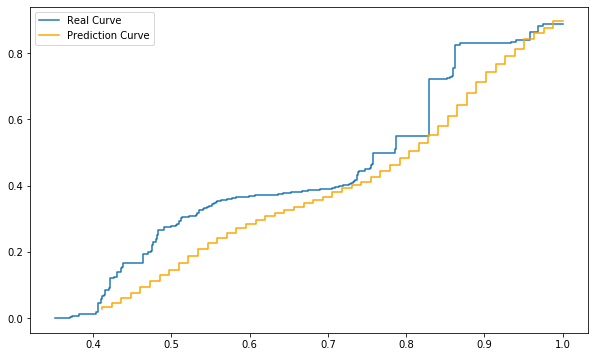

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using the Random Forest + CNN procedure
pp1 = rf_dnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
rf_dnn_l1_distances.mean()

1    0.0391276111
2    0.0416085730
3    0.0435144168
4    0.0444451920
5    0.0449156013
6    0.0429205716
7    0.0398063721
8    0.0322993026
9    0.0226569743
10   0.0177838091
11   0.0159116608
12   0.0151006241
13   0.0145546900
14   0.0144083929
15   0.0144945733
16   0.0148130181
17   0.0152986262
18   0.0158200607
19   0.0159711012
20   0.0162432274
21   0.0160568143
22   0.0159248468
23   0.0162451403
24   0.0181468232
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(rf_dnn_l1_distances.mean()) / 24, 4)

0.0245

## Analysis comparison Naive vs Random Forest + DNN

In [19]:
difference = naive_l1_distances.iloc[:, :25] - rf_dnn_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-0.5658746687,-0.6356771296,-0.6023873927,-0.6487072958,-0.7187506313,-0.7238170256,-0.5833194880,-0.5931814530,-0.5324300906,-1.0919067606,...,-1.6102048166,-1.4016094730,-1.4185954407,-1.1978480094,-0.7249223411,-0.7954746899,-0.9123964492,-0.7328704318,-0.7979483709,-0.7539429193
std,1.8344257003,2.4456563343,1.6035864285,1.7607422626,2.1321244338,2.6000863644,2.3402970652,2.8014744194,2.4675998667,14.0410207272,...,6.7261492099,5.5651874053,9.1067926633,6.7444237582,2.7739990184,3.8352666730,5.8595921954,2.0795996288,2.4850285366,2.3134102116
min,-28.4228833551,-51.1301567360,-12.4041710572,-16.5169921085,-29.6083625225,-49.6552577665,-32.6650564621,-47.4294188552,-38.8296801890,-371.9533517123,...,-84.3959971182,-94.5667781099,-223.9562269509,-153.8342071152,-49.1946532039,-80.0009434064,-148.2106599058,-25.5861303559,-32.0814755326,-38.6143083554
25%,-0.8130714332,-0.8737643914,-0.9351150067,-0.9435321068,-0.9677546454,-0.9454287115,-0.6462257596,-0.7063847358,-0.5073994172,-0.5516109766,...,-0.9326404583,-0.9178043702,-0.8817581400,-0.8220256288,-0.7074365680,-0.7076371549,-0.8252979598,-0.8038021165,-0.7667281062,-0.8288874333
50%,-0.0086803943,-0.0260109406,-0.0351864983,-0.0510131883,-0.0735641331,-0.0367100712,0.0038787093,0.0092197637,0.0153768499,-0.0261062398,...,-0.0442582645,-0.0363114519,-0.0850509413,-0.0637107339,-0.0726160378,-0.0612657423,-0.0913933133,-0.1039931614,-0.1033173133,-0.1338683546
75%,0.3285587007,0.3421096500,0.3533514353,0.3484959754,0.3615487966,0.3488402392,0.3276834025,0.3064220236,0.2520606830,0.2159058931,...,0.2581699706,0.2587566118,0.2505260767,0.2462860132,0.2540259717,0.2248790153,0.2353143482,0.2093834710,0.2097348932,0.2024258963
max,0.8390270907,0.8628929361,0.9096673977,0.8932061437,0.8870157958,0.8539895596,0.8562610985,0.7894554225,0.8250599963,0.7653405476,...,0.8064673095,0.8259501804,0.7907277085,0.7892119492,0.7638520067,0.7348366545,0.8071771456,0.8266829818,0.7577399440,0.8152219755


# Random Forest + CNN

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)

In [ ]:
X_train.shape

(24264, 128)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)

In [ ]:
X_test.shape

(17544, 128)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# Create the Random Forest model for regression
random_forest = RandomForestRegressor(n_estimators=100, random_state=42)

# Create the MultiOutputRegressor model with the Random Forest
multi_output_forest = MultiOutputRegressor(random_forest)

# Train the model
multi_output_forest.fit(X_train, y_train)

# Compute the predictions using the test set
rf_predictions = multi_output_forest.predict(X_test)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dtype=np.int)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\base.py:158: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for 

In [ ]:
# Loading the dataframe
rf_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest\rf_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_predictions.shape

(17544, 49)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, Flatten, Dense

# Build the convolutional neural network model
model = Sequential()

# Conv1D layer with 64 filters, kernel size = 3 and ReLU activation
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(rf_predictions.shape[1], 1)))

# Another Conv1D layer with 128 filters, kernel size = 3 and ReLU activation
model.add(Conv1D(filters=128, kernel_size=3, activation='relu'))

# Flattening of data to connect with dense layers
model.add(Flatten())

# Dense layers
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.1)) # # Add dropout for regularization

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))

# Output layer with the same number of columns as y_train
model.add(Dense(rf_predictions.shape[1]))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(rf_predictions, y_test, epochs=200, batch_size=32, verbose=1)

# Compute the predictions using the test set
predictions = model.predict(rf_predictions)

Epoch 1/200
549/549 [==============================] - 6s 11ms/step - loss: 0.4172 - mean_absolute_error: 0.4104
Epoch 2/200
549/549 [==============================] - 6s 11ms/step - loss: 0.3394 - mean_absolute_error: 0.3581
Epoch 3/200
549/549 [==============================] - 7s 13ms/step - loss: 0.3205 - mean_absolute_error: 0.3438
Epoch 4/200
549/549 [==============================] - 8s 14ms/step - loss: 0.3172 - mean_absolute_error: 0.3406
Epoch 5/200
549/549 [==============================] - 8s 14ms/step - loss: 0.3090 - mean_absolute_error: 0.3356
Epoch 6/200
549/549 [==============================] - 8s 14ms/step - loss: 0.3025 - mean_absolute_error: 0.3319
Epoch 7/200
549/549 [==============================] - 8s 14ms/step - loss: 0.2959 - mean_absolute_error: 0.3292
Epoch 8/200
549/549 [==============================] - 8s 14ms/step - loss: 0.2908 - mean_absolute_error: 0.3259
Epoch 9/200
549/549 [==============================] - 8s 14ms/step - loss: 0.2813 - mean_absolu

549/549 [==============================] - 7s 13ms/step - loss: 0.0809 - mean_absolute_error: 0.1799
Epoch 143/200
549/549 [==============================] - 7s 13ms/step - loss: 0.0811 - mean_absolute_error: 0.1793
Epoch 144/200
549/549 [==============================] - 7s 14ms/step - loss: 0.0821 - mean_absolute_error: 0.1814
Epoch 145/200
549/549 [==============================] - 7s 13ms/step - loss: 0.0796 - mean_absolute_error: 0.1790
Epoch 146/200
549/549 [==============================] - 7s 13ms/step - loss: 0.0818 - mean_absolute_error: 0.1807
Epoch 147/200
549/549 [==============================] - 7s 13ms/step - loss: 0.0812 - mean_absolute_error: 0.1799
Epoch 148/200
549/549 [==============================] - 8s 14ms/step - loss: 0.0809 - mean_absolute_error: 0.1796
Epoch 149/200
549/549 [==============================] - 7s 13ms/step - loss: 0.0783 - mean_absolute_error: 0.1780
Epoch 150/200
549/549 [==============================] - 8s 14ms/step - loss: 0.0789 - mean_ab

In [ ]:
# Store the predictions into a dataframe
rf_cnn_predictions = pd.DataFrame(predictions)

In [ ]:
# Loading the dataframe
rf_cnn_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest + CNN\rf_cnn_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_cnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,3.0139167000,3.3780770000,3.6265323000,3.7444057000,3.6763970000,3.5218813000,3.3555157000,3.2758844000,3.1823192000,3.1337698000,...,3.3568254000,3.3857994000,3.4120910000,3.4089916000,3.3843520000,3.3722243000,3.3835273000,3.3735383000,3.3654504000,3.3670015000
1,4.6901180000,5.3518567000,5.6564484000,6.0228906000,5.7204275000,5.3560500000,4.9639800000,4.6741915000,4.3751620000,4.1928067000,...,3.5068219000,3.5302331000,3.5569250000,3.4822867000,3.4097934000,3.3857415000,3.3668127000,3.3518520000,3.3498406000,3.3066077000
2,5.5818615000,6.1336690000,6.2840700000,6.4546175000,6.0286098000,5.6026720000,5.1601744000,4.8258953000,4.5049320000,4.3144380000,...,3.7782493000,3.7545168000,3.7525475000,3.6457830000,3.5514624000,3.5053810000,3.4658760000,3.4444313000,3.4273730000,3.3880777000
3,6.8791995000,7.2604427000,7.1575200000,7.1773010000,6.6202180000,6.0594554000,5.5221415000,5.1251570000,4.7444550000,4.5176563000,...,3.9268131000,3.8921971000,3.8758776000,3.7386296000,3.6297054000,3.5537174000,3.5087920000,3.4805052000,3.4436970000,3.3876154000
4,6.7524962000,6.9354900000,6.7726016000,6.8527390000,6.3642710000,5.8396587000,5.2994933000,4.9413370000,4.5857190000,4.3521240000,...,3.8816533000,3.8412309000,3.8289948000,3.6890125000,3.5756762000,3.4875640000,3.4397564000,3.4072826000,3.3868876000,3.3400967000
5,4.7219930000,5.2452630000,5.3713620000,5.6702730000,5.4216413000,5.1216617000,4.7772307000,4.5089200000,4.2104783000,4.0149865000,...,3.8834429000,3.8324733000,3.8092330000,3.6681192000,3.5605645000,3.4979136000,3.4479141000,3.4135170000,3.3842149000,3.3428440000
6,1.2413974000,1.8026108000,2.2950284000,3.1303933000,3.6378808000,3.9519120000,4.0045270000,4.0069710000,3.8674700000,3.7641997000,...,3.6238887000,3.5721934000,3.5392654000,3.4273431000,3.3263060000,3.2836290000,3.2859988000,3.2674460000,3.2745000000,3.2784371000
7,0.3417053800,0.3152739700,0.3714796000,0.4642644000,0.6707152000,1.0106826000,1.3548324000,1.6288905000,1.9676819000,2.4739020000,...,2.8348665000,2.9529028000,2.9471862000,3.0387008000,3.0596318000,3.1337380000,3.3423758000,3.4459355000,3.5988111000,3.6650590000
8,0.1274225100,0.0860818300,0.0919836500,0.1705293700,0.3402499600,0.5845424000,0.7896611700,1.0013441000,1.2162391000,1.4973636000,...,2.4801054000,2.5702010000,2.6473353000,2.7336800000,2.7953615000,2.8606446000,2.9356222000,2.9323847000,2.9810915000,2.9833317000
9,0.2569028000,0.2060182500,0.1966641000,0.2298958200,0.2676091000,0.3949264600,0.5076600000,0.6487329000,0.8087838000,1.0064500000,...,1.8229597000,1.8699949000,1.8918460000,1.9682766000,1.9972644000,2.0777762000,2.2348905000,2.3325100000,2.4489224000,2.5557475000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(rf_cnn_predictions.shape[0]):
    for c in range(rf_cnn_predictions.shape[1]):
        if rf_cnn_predictions.iloc[i, c] < 0:
            rf_cnn_predictions.iloc[i, c] = abs(rf_cnn_predictions.iloc[i, c])

In [ ]:
for i in range(rf_cnn_predictions.shape[0]):
    for c in range(rf_cnn_predictions.shape[1]):
        if c < rf_cnn_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and rf_cnn_predictions.iloc[i, c] > rf_cnn_predictions.iloc[i, c + 1] and rf_cnn_predictions.iloc[i, c] > rf_cnn_predictions.iloc[i, c + 2]:
                rf_cnn_predictions.iloc[i, c] = rf_cnn_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and rf_cnn_predictions.iloc[i, c] > rf_cnn_predictions.iloc[i, c + 1] and rf_cnn_predictions.iloc[i, c] > rf_cnn_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if rf_cnn_predictions.iloc[i, c + 1] >= rf_cnn_predictions.iloc[i, c - 1]:
                    rf_cnn_predictions.iloc[i, c] = rf_cnn_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if rf_cnn_predictions.iloc[i, c + 1] < rf_cnn_predictions.iloc[i, c - 1]:
                    rf_cnn_predictions.iloc[i, c + 1] = rf_cnn_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if rf_cnn_predictions.iloc[i, c] > rf_cnn_predictions.iloc[i, c + 1] and rf_cnn_predictions.iloc[i, c] < rf_cnn_predictions.iloc[i, c + 2]:
                rf_cnn_predictions.iloc[i, c + 1] = rf_cnn_predictions.iloc[i, c]
        if c >= rf_cnn_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if rf_cnn_predictions.iloc[i, c] < rf_cnn_predictions.iloc[i, c - 1]:
                rf_cnn_predictions.iloc[i, c] = rf_cnn_predictions.iloc[i, c - 1]

In [ ]:
rf_cnn_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,3.0139167000,3.3780770000,3.6265323000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,...,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000,3.6763970000
1,4.6901180000,5.3518567000,5.6564484000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,...,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000,5.7204275000
2,5.5818615000,6.1336690000,6.2840700000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,...,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000,6.4546175000
3,6.8791995000,7.1575200000,7.1575200000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,...,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000,7.1773010000
4,6.7524962000,6.7726016000,6.7726016000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,...,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000,6.8527390000
5,4.7219930000,5.2452630000,5.3713620000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,...,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000,5.4216413000
6,1.2413974000,1.8026108000,2.2950284000,3.1303933000,3.6378808000,3.9519120000,4.0045270000,4.0069710000,4.0069710000,4.0069710000,...,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000,4.0069710000
7,0.3417053800,0.3417053800,0.3714796000,0.4642644000,0.6707152000,1.0106826000,1.3548324000,1.6288905000,1.9676819000,2.4739020000,...,3.4247503000,3.4247503000,3.4247503000,3.4247503000,3.4247503000,3.4247503000,3.4247503000,3.4459355000,3.5988111000,3.6650590000
8,0.0860818300,0.0860818300,0.0919836500,0.1705293700,0.3402499600,0.5845424000,0.7896611700,1.0013441000,1.2162391000,1.4973636000,...,2.6970274000,2.6970274000,2.6970274000,2.7336800000,2.7953615000,2.8606446000,2.9356222000,2.9356222000,2.9810915000,2.9833317000
9,0.2060182500,0.2060182500,0.2060182500,0.2298958200,0.2676091000,0.3949264600,0.5076600000,0.6487329000,0.8087838000,1.0064500000,...,2.1595044000,2.1595044000,2.1595044000,2.1595044000,2.1595044000,2.1595044000,2.2348905000,2.3325100000,2.4489224000,2.5557475000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(rf_cnn_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

rf_cnn_predictions = rf_cnn_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the dataframe
rf_cnn_predictions.to_csv('rf_cnn_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
rf_cnn_predictions = rf_cnn_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
rf_cnn_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

    # Compute the prediction using Random Forest + CNN procedure
    pp1 = rf_cnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    rf_cnn_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
rf_cnn_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.030684932002482214
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.16324698616617103
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.21431019852643293
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.2641309139847307
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.23460967949287836
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.12344046291429256
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.04153086524337436
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.03138091199624955
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.025056899790379047
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.028643953366350172
-----------------------

Distancia L1 (Manhattan) para la hora 14 del día 1016: 0.008950801380254864
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1016: 0.008806709171378808
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1016: 0.008914515778216957
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1016: 0.014361356224644727
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1016: 0.012344563709309935
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1016: 0.015954028282027174
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1016: 0.012664544916833977
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1016: 0.013994275845009486
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1016: 0.013485966790778958
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1016: 0.013154215716200696
------

Distancia L1 (Manhattan) para la hora 13 del día 1020: 0.012360619044405389
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1020: 0.009258358564188716
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1020: 0.010407310924532946
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1020: 0.00912731630954695
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1020: 0.008715075235409892
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1020: 0.007275272798951612
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1020: 0.01014546914163799
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1020: 0.011940694553496417
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1020: 0.010793365472878503
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1020: 0.009592010153507566
--------

Distancia L1 (Manhattan) para la hora 16 del día 1024: 0.009999942680633105
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1024: 0.00844385804245027
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1024: 0.007288332475391434
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1024: 0.016985786944932933
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1024: 0.011661705539104061
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1024: 0.007369606221521258
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1024: 0.009485320755523935
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1024: 0.00955244029532489
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1024: 0.02023776085549464
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1025: 0.022155918760556365
----------

Distancia L1 (Manhattan) para la hora 3 del día 1028: 0.17424318656936177
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1028: 0.09104580585499628
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1028: 0.09228625950201225
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1028: 0.052634122642700114
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1028: 0.03319856180090775
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1028: 0.028199544414518142
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1028: 0.017270252536972983
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1028: 0.021593134392196536
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1028: 0.016499270036144688
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1028: 0.014254103232711224
-----------------

Distancia L1 (Manhattan) para la hora 6 del día 1032: 0.019713775117410366
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1032: 0.025879724016297612
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1032: 0.02299889171685836
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1032: 0.012987249964590018
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1032: 0.012308549652168871
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1032: 0.00818817204688245
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1032: 0.013832447860471527
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1032: 0.009790471764320146
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1032: 0.012818017453032933
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1032: 0.009250223349015875
------------

Distancia L1 (Manhattan) para la hora 1 del día 1036: 0.013118472654031581
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1036: 0.015626470017356425
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1036: 0.014047833077552346
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1036: 0.015338179278549656
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1036: 0.016788368529032656
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1036: 0.018984304121318213
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1036: 0.020256093920102247
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1036: 0.012890653523980326
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1036: 0.012399682264992357
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1036: 0.012180014030231626
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1039: 0.03000904736418464
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1039: 0.030590009551143202
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1039: 0.03247754575301209
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1039: 0.03686472985229512
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1039: 0.01461777766709157
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1039: 0.020527177787004438
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1039: 0.018852452276589562
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1039: 0.012260692722575036
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1039: 0.012554260557262897
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1039: 0.013965302860402928
----------

Distancia L1 (Manhattan) para la hora 2 del día 1044: 0.011144213875341253
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1044: 0.011077445036781788
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1044: 0.009951283292517703
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1044: 0.010084427291943102
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1044: 0.013432662182254737
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1044: 0.011125509959495718
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1044: 0.011941729348016683
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1044: 0.0098037482007775
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1044: 0.00577392837645066
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1044: 0.008042352706561614
-----------------

Distancia L1 (Manhattan) para la hora 2 del día 1048: 0.018584870089476135
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1048: 0.0189909449464288
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1048: 0.016020598062663413
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1048: 0.030285882139737232
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1048: 0.015075012783343448
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1048: 0.026932944181956426
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1048: 0.017038925678354203
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1048: 0.025925172120102286
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1048: 0.012820212044447523
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1048: 0.00786709877638042
-----------------

Distancia L1 (Manhattan) para la hora 10 del día 1052: 0.01008571933315702
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1052: 0.009197226566646132
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1052: 0.014773269722895898
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1052: 0.0046286949511321505
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1052: 0.00569001325304159
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1052: 0.004767928467272919
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1052: 0.010031125980789446
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1052: 0.01083984294562096
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1052: 0.012987465041457754
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1052: 0.009535350753164334
--------

Distancia L1 (Manhattan) para la hora 22 del día 1055: 0.01092730733466189
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1055: 0.014868855599633227
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1055: 0.02314678606353424
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1056: 0.022708429020249738
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1056: 0.028847612649432714
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1056: 0.06257098784356582
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1056: 0.049463891799487444
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1056: 0.0776430036507668
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1056: 0.03533074044425004
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1056: 0.02884444773934481
--------------------

Distancia L1 (Manhattan) para la hora 8 del día 1060: 0.017455969838802654
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1060: 0.01738047706935971
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1060: 0.012725506110792316
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1060: 0.017854631322574345
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1060: 0.010664045313867214
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1060: 0.006953244217838227
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1060: 0.007121908584027895
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1060: 0.008346552387520481
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1060: 0.004773405839418755
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1060: 0.008811943795106199
---------

Distancia L1 (Manhattan) para la hora 18 del día 1063: 0.011311529261908
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1063: 0.027402578624529397
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1063: 0.017075651262074325
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1063: 0.015407785424564046
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1063: 0.017397096612853394
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1063: 0.02449155944830942
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1063: 0.023319190382094707
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1064: 0.01739388717210484
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1064: 0.02631121629623371
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1064: 0.024110915119986098
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1067: 0.025779665506205328
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1067: 0.018988235149683085
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1067: 0.022528776252013
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1067: 0.026354976229135886
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1067: 0.02078902011963995
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1067: 0.016307078081980973
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1067: 0.014986271589716313
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1067: 0.01262087467718543
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1067: 0.023540610721023127
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1067: 0.018435789670236402
--------------

Distancia L1 (Manhattan) para la hora 2 del día 1071: 0.018547332191604243
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1071: 0.01862175156876716
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1071: 0.01562068464265821
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1071: 0.017351039858640695
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1071: 0.021541595357701185
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1071: 0.020629382562167356
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1071: 0.023240014206998033
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1071: 0.012630201585589147
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1071: 0.019678489735271493
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1071: 0.01008971357705183
-----------------

Distancia L1 (Manhattan) para la hora 22 del día 1074: 0.010814783249431043
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1074: 0.03338769816234266
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1074: 0.018181118327977364
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1075: 0.029019058898436353
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1075: 0.024676457549311297
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1075: 0.03602335514121286
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1075: 0.017777957126056516
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1075: 0.029645860318247116
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1075: 0.022752036191706907
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1075: 0.017572560702074844
---------------

Distancia L1 (Manhattan) para la hora 19 del día 1078: 0.0393162405546025
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1078: 0.028130882311867063
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1078: 0.012651593897986294
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1078: 0.01702912953334766
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1078: 0.023259119227503035
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1078: 0.03189497924625882
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1079: 0.019631107159667986
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1079: 0.017296478583059004
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1079: 0.032904075060243676
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1079: 0.02128274692945625
---------------

Distancia L1 (Manhattan) para la hora 11 del día 1082: 0.010937380048696804
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1082: 0.017697048009946523
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1082: 0.006604187005019316
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1082: 0.005423916101635467
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1082: 0.009096759200399526
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1082: 0.009089236140162956
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1082: 0.013558594103682174
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1082: 0.01387968750074759
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1082: 0.015971021439396535
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1082: 0.027719527897871674
-------

Distancia L1 (Manhattan) para la hora 7 del día 1086: 0.01728528917951611
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1086: 0.034698778638649785
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1086: 0.017529117061684904
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1086: 0.011831455532634812
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1086: 0.00870182773043322
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1086: 0.00935074597059607
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1086: 0.008353961715191217
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1086: 0.0069358195907531775
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1086: 0.006052318670363698
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1086: 0.005221920339782105
-----------

Distancia L1 (Manhattan) para la hora 5 del día 1090: 0.01722136849948127
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1090: 0.01603618742255729
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1090: 0.01676375309816473
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1090: 0.01688700401227578
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1090: 0.011345137743022616
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1090: 0.01184438820300739
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1090: 0.011852192633423653
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1090: 0.010761148992492694
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1090: 0.010321865420493601
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1090: 0.011352541760651076
----------------

Distancia L1 (Manhattan) para la hora 24 del día 1093: 0.02869625663762957
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1094: 0.035000940678903636
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1094: 0.025850481694265674
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1094: 0.06156252028642237
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1094: 0.03379164285673709
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1094: 0.02629275532715392
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1094: 0.029971981289951037
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1094: 0.024251867005423876
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1094: 0.022220040892470733
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1094: 0.022017859414426764
-------------------

Distancia L1 (Manhattan) para la hora 12 del día 1097: 0.010846936816772425
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1097: 0.010669327620773897
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1097: 0.013596350385407956
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1097: 0.008380743245828978
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1097: 0.010131718562101114
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1097: 0.015073356794246399
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1097: 0.010885015500481121
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1097: 0.009715039703498133
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1097: 0.014396607018256381
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1097: 0.009686138563354067
------

Distancia L1 (Manhattan) para la hora 22 del día 1100: 0.017274185459514285
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1100: 0.017949538863220888
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1100: 0.02925907943265249
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1101: 0.019755899128019706
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1101: 0.024048669774879915
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1101: 0.03911737517604588
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1101: 0.07477919525236261
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1101: 0.11486231655640088
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1101: 0.1081045122313325
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1101: 0.02966090625519693
--------------------

Distancia L1 (Manhattan) para la hora 14 del día 1105: 0.010043363486526033
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1105: 0.01157224374537125
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1105: 0.020679620656812142
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1105: 0.014058137351755599
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1105: 0.011469916710546514
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1105: 0.007823764732132431
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1105: 0.009134879050370555
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1105: 0.009701630887703892
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1105: 0.009166375777476341
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1105: 0.010133871610067353
-------

Distancia L1 (Manhattan) para la hora 13 del día 1109: 0.009113499158120344
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1109: 0.014615282628268889
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1109: 0.014673708976079647
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1109: 0.0133294629986273
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1109: 0.010280298449361815
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1109: 0.00748488840077745
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1109: 0.009959817003455652
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1109: 0.013971554719805459
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1109: 0.012140733283859315
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1109: 0.011554931649951812
---------

Distancia L1 (Manhattan) para la hora 14 del día 1113: 0.007124465757152328
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1113: 0.007172437002165445
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1113: 0.009394304167562862
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1113: 0.0113973475778375
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1113: 0.008915154606552001
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1113: 0.007517984688998064
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1113: 0.008605487104400799
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1113: 0.008206478352072562
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1113: 0.007320416983087218
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1113: 0.007942803385615415
--------

Distancia L1 (Manhattan) para la hora 5 del día 1117: 0.043207097692387376
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1117: 0.02802916539158233
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1117: 0.01811194919861755
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1117: 0.03970258752821816
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1117: 0.021515134990922287
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1117: 0.009760131007331085
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1117: 0.012790999614801696
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1117: 0.007824245250818746
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1117: 0.00766387338637438
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1117: 0.009193641284227514
---------------

Distancia L1 (Manhattan) para la hora 5 del día 1121: 0.031011103961877964
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1121: 0.035637261027567375
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1121: 0.02127662951528709
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1121: 0.03318138183581311
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1121: 0.02024898690095637
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1121: 0.014218132673662613
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1121: 0.011354584787864426
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1121: 0.018538912679855402
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1121: 0.015298747760575795
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1121: 0.013242297258595112
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1124: 0.011399824267498318
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1124: 0.011692853404691728
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1124: 0.010012899733950942
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1124: 0.014426179484600553
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1124: 0.01429109083442571
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1124: 0.018213881325358443
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1124: 0.018215150220323266
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1124: 0.016669138792228592
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1124: 0.019603185958633182
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1125: 0.025546272882667222
--------

Distancia L1 (Manhattan) para la hora 9 del día 1128: 0.01898060794881931
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1128: 0.013480709202241238
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1128: 0.01466428864884247
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1128: 0.013718852230381834
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1128: 0.013304617094051827
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1128: 0.01060013204708256
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1128: 0.014092929888721357
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1128: 0.010919737969863685
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1128: 0.014003403494076076
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1128: 0.017423820098330614
----------

Distancia L1 (Manhattan) para la hora 11 del día 1133: 0.017632216809684825
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1133: 0.010185880147682885
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1133: 0.008048875662534063
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1133: 0.013064911845098759
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1133: 0.01787629112089327
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1133: 0.008135050336529922
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1133: 0.006006618268594097
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1133: 0.005462831906532767
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1133: 0.014947204026620682
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1133: 0.011069088234934785
-------

Distancia L1 (Manhattan) para la hora 15 del día 1138: 0.010451117544068536
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1138: 0.007314313686732334
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1138: 0.008491281080089069
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1138: 0.009000110583444453
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1138: 0.010192768444149873
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1138: 0.01451256423448519
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1138: 0.017537197385933505
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1138: 0.018097853695684903
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1138: 0.026541625877457318
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1138: 0.02445125102572017
--------

Distancia L1 (Manhattan) para la hora 7 del día 1142: 0.025425334899882683
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1142: 0.016318725119677132
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1142: 0.019968303962654217
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1142: 0.009589598614848736
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1142: 0.006997377019370588
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1142: 0.011110856721084101
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1142: 0.015307732053991965
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1142: 0.007988767357723067
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1142: 0.009130568400803549
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1142: 0.0091258694695264
-----------

Distancia L1 (Manhattan) para la hora 16 del día 1145: 0.0058899555260802025
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1145: 0.009459944483625193
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1145: 0.008906646240709215
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1145: 0.018530529152957657
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1145: 0.008508998641253467
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1145: 0.00987541923371106
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1145: 0.009804741801348157
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1145: 0.015941471788824914
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1145: 0.01749263464003856
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1146: 0.016776554584433997
--------

Distancia L1 (Manhattan) para la hora 11 del día 1150: 0.011260169224586045
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1150: 0.011562538592621296
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1150: 0.014767509998958362
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1150: 0.015119062205638965
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1150: 0.01703095205328983
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1150: 0.01640050946761973
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1150: 0.012609387432152789
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1150: 0.008168689681781399
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1150: 0.015483922546967753
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1150: 0.021839020469677756
--------

Distancia L1 (Manhattan) para la hora 4 del día 1155: 0.2663962852819943
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1155: 0.19351476241359067
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1155: 0.1900149934084443
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1155: 0.017450578441028236
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1155: 0.02414986676997408
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1155: 0.02354217837141976
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1155: 0.018559261122982743
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1155: 0.01490147418287564
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1155: 0.012204186399323042
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1155: 0.01162061872539499
---------------------

Distancia L1 (Manhattan) para la hora 8 del día 1160: 0.018281017865648515
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1160: 0.018089524774206993
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1160: 0.008503208712926851
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1160: 0.006088045692728408
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1160: 0.011046339895590864
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1160: 0.006656964838815696
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1160: 0.005394773373694086
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1160: 0.004971114733938796
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1160: 0.007806701664802612
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1160: 0.007744274836095905
--------

Distancia L1 (Manhattan) para la hora 5 del día 1164: 0.01749913467131875
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1164: 0.015485384148378358
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1164: 0.015855927200762957
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1164: 0.027915591661195824
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1164: 0.01924468420318163
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1164: 0.014084464587776162
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1164: 0.011847132413960359
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1164: 0.008318781611146112
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1164: 0.008830741621463863
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1164: 0.009249260744509716
-------------

Distancia L1 (Manhattan) para la hora 3 del día 1169: 0.012985969116238828
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1169: 0.018402186740141088
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1169: 0.019666442279125753
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1169: 0.017446206803877144
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1169: 0.026503647942503254
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1169: 0.01859070913763562
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1169: 0.024132666799855568
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1169: 0.01464644136373075
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1169: 0.0077954739046666235
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1169: 0.004105092956509221
--------------

Distancia L1 (Manhattan) para la hora 14 del día 1173: 0.007604278861278716
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1173: 0.00830753540188405
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1173: 0.013873288027031585
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1173: 0.008061460001715646
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1173: 0.004333862901586108
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1173: 0.00638512676718217
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1173: 0.007906939479831704
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1173: 0.0234478415927124
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1173: 0.007846598172659449
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1173: 0.01040398001041401
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1177: 0.01905003852257519
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1177: 0.01890962445874124
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1177: 0.015171233324842884
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1177: 0.013430647633358727
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1177: 0.007821161602335994
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1177: 0.01267013207795364
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1177: 0.010480674625782158
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1177: 0.009893305629996218
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1177: 0.005798426703701813
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1177: 0.0044149752617287374
----------

Distancia L1 (Manhattan) para la hora 15 del día 1181: 0.008693945836234665
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1181: 0.014598510552702993
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1181: 0.014462374577952304
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1181: 0.017216748571373557
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1181: 0.005000643765469956
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1181: 0.009230210856184914
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1181: 0.026427728735574134
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1181: 0.008673310504077169
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1181: 0.017629423148805248
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1181: 0.0142710462838899
--------

Distancia L1 (Manhattan) para la hora 9 del día 1185: 0.021058362695620295
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1185: 0.01905967012045109
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1185: 0.014925322986307877
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1185: 0.01194540443146704
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1185: 0.011191893435119702
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1185: 0.008426299220190054
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1185: 0.010090035260549732
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1185: 0.010792196986088635
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1185: 0.012363277439830784
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1185: 0.011246040430448516
---------

Distancia L1 (Manhattan) para la hora 17 del día 1189: 0.004747849591889048
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1189: 0.0023908764074980393
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1189: 0.004870306439582226
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1189: 0.01033729385558497
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1189: 0.0061058988048869264
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1189: 0.010999590607595599
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1189: 0.009675082001758964
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1189: 0.014293787585981883
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1190: 0.0191503431425634
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1190: 0.012199789909187684
---------

Distancia L1 (Manhattan) para la hora 11 del día 1193: 0.014791521743959452
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1193: 0.013900941521260373
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1193: 0.00986827317807126
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1193: 0.008565941541509168
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1193: 0.009142331821152776
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1193: 0.011658900222991592
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1193: 0.01332423357336063
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1193: 0.009425313167148702
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1193: 0.009132309204270146
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1193: 0.013415805471561825
--------

Distancia L1 (Manhattan) para la hora 22 del día 1196: 0.014254403210547538
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1196: 0.014790121669094682
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1196: 0.01808432975239009
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1197: 0.015410668516941962
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1197: 0.01589917014374898
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1197: 0.015070208595281149
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1197: 0.015161284707711727
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1197: 0.01725167722819731
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1197: 0.01617489445684344
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1197: 0.014800288772042362
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1200: 0.01569296645516037
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1200: 0.013186421092905045
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1200: 0.018525386557764454
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1200: 0.015348808084182439
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1200: 0.011568571261055646
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1200: 0.011965940268608602
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1200: 0.013307238166184756
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1200: 0.0267840895652028
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1200: 0.01452141908252618
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1200: 0.014702779946596533
----------

Distancia L1 (Manhattan) para la hora 17 del día 1205: 0.013108717286492728
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1205: 0.014865911151918024
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1205: 0.027613528298830098
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1205: 0.015745772179663428
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1205: 0.015699593063676846
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1205: 0.016830979721159205
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1205: 0.016741596465587684
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1205: 0.02341788309420629
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1206: 0.023819707577775018
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1206: 0.019394632519660344
---------

Distancia L1 (Manhattan) para la hora 15 del día 1210: 0.005865339653798389
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1210: 0.006038744137933523
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1210: 0.007174953128879341
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1210: 0.005596346571409144
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1210: 0.012441144390750069
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1210: 0.006680137587023025
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1210: 0.008646805876430703
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1210: 0.009597868213679174
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1210: 0.013032170051415593
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1210: 0.01466276330512855
-------

Distancia L1 (Manhattan) para la hora 17 del día 1215: 0.006050082388032313
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1215: 0.007897976781410718
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1215: 0.0075908659158156425
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1215: 0.008722786450297825
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1215: 0.013349840648001089
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1215: 0.014787594794348966
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1215: 0.012137596678497085
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1215: 0.01681049331306647
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1216: 0.02196783446814655
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1216: 0.015621428439739807
---------

Distancia L1 (Manhattan) para la hora 9 del día 1219: 0.017546672294753977
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1219: 0.022348770255009233
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1219: 0.01007485370845343
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1219: 0.008192784448765058
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1219: 0.006567867297700775
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1219: 0.005327369309905232
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1219: 0.005209143841773495
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1219: 0.006925533351011113
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1219: 0.006501653368685238
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1219: 0.0050199580723885385
-------

Distancia L1 (Manhattan) para la hora 18 del día 1224: 0.00787811337596971
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1224: 0.006557633867876689
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1224: 0.008007440387685465
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1224: 0.006861031914904123
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1224: 0.01060965803885869
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1224: 0.00906185205298332
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1224: 0.019608644728007035
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1225: 0.01975598162211053
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1225: 0.014477249356855088
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1225: 0.011928551220501144
-------------

Distancia L1 (Manhattan) para la hora 5 del día 1228: 0.016275350661203603
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1228: 0.02185156215112021
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1228: 0.0239624916809495
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1228: 0.01912743840358137
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1228: 0.024032361440425167
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1228: 0.02010358036337292
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1228: 0.021511738920699387
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1228: 0.01584630166452298
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1228: 0.015930146609431456
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1228: 0.014163512773071343
-----------------

Distancia L1 (Manhattan) para la hora 23 del día 1232: 0.008246928019351944
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1232: 0.008270883393995714
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1233: 0.011849403231179733
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1233: 0.0180154487126233
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1233: 0.014473052639747491
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1233: 0.013777594700665655
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1233: 0.014426202688146818
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1233: 0.016719693494146003
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1233: 0.01838363383039833
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1233: 0.014117983758028821
-----------------

Distancia L1 (Manhattan) para la hora 11 del día 1238: 0.009162513657844318
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1238: 0.006424867168308682
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1238: 0.005523659751442276
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1238: 0.004804039893993488
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1238: 0.006497262714510965
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1238: 0.012640166061950099
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1238: 0.004850408978361047
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1238: 0.005914501206770775
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1238: 0.014400398828000344
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1238: 0.008013409653558037
------

Distancia L1 (Manhattan) para la hora 12 del día 1243: 0.00965826945274679
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1243: 0.007357260899918077
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1243: 0.004144312240678455
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1243: 0.007490677022116005
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1243: 0.006936978811910286
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1243: 0.003968178495543083
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1243: 0.005567058343933409
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1243: 0.005352910658937499
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1243: 0.006490208586183456
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1243: 0.006438326389344925
-------

Distancia L1 (Manhattan) para la hora 9 del día 1247: 0.018005910924128395
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1247: 0.018337519681977048
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1247: 0.009611905218836366
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1247: 0.014643641113713073
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1247: 0.01026512856333615
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1247: 0.009413854055530664
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1247: 0.004474770711091838
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1247: 0.004622366557373314
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1247: 0.005242280239751715
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1247: 0.008021208704382912
--------

Distancia L1 (Manhattan) para la hora 8 del día 1252: 0.018360991897773675
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1252: 0.019413991591788228
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1252: 0.018850920385223374
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1252: 0.014241958216275958
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1252: 0.010235163086589165
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1252: 0.019643390958416097
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1252: 0.00818877316994028
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1252: 0.009794142815223138
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1252: 0.013430342903739748
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1252: 0.0092622679475717
-----------

Distancia L1 (Manhattan) para la hora 6 del día 1256: 0.012601256820980473
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1256: 0.03324293573348633
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1256: 0.019787493403582882
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1256: 0.01636530060217127
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1256: 0.013536292652405304
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1256: 0.02242065559523376
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1256: 0.022210656445238355
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1256: 0.023222603323820732
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1256: 0.006306634526747724
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1256: 0.0043649307232599644
------------

Distancia L1 (Manhattan) para la hora 15 del día 1259: 0.009902371016398622
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1259: 0.00451157025426647
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1259: 0.01666464685959008
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1259: 0.010370884156311263
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1259: 0.02693942648855684
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1259: 0.01960391221933893
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1259: 0.03871386543194174
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1259: 0.031582764732391716
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1259: 0.023932777190492804
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1259: 0.02714605410618163
------------

Distancia L1 (Manhattan) para la hora 7 del día 1263: 0.015297730043956476
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1263: 0.01592980645988116
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1263: 0.013760244017933212
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1263: 0.014113146756058676
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1263: 0.030497598617198713
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1263: 0.010721144212615913
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1263: 0.008091617582703173
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1263: 0.007457616897044988
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1263: 0.00680169196134518
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1263: 0.00981985828031652
------------

Distancia L1 (Manhattan) para la hora 2 del día 1268: 0.015966584906885326
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1268: 0.017983271744300696
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1268: 0.01734089289083806
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1268: 0.01336363348998516
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1268: 0.014666984352008812
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1268: 0.018023437371606388
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1268: 0.028199703334163863
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1268: 0.0183115323093129
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1268: 0.01387260441479371
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1268: 0.010807248746052392
-------------------

Distancia L1 (Manhattan) para la hora 10 del día 1272: 0.014938118521650468
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1272: 0.014443529792272496
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1272: 0.011009603303448648
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1272: 0.012716607818303543
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1272: 0.023916182136729993
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1272: 0.012474380954006955
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1272: 0.013862276248075022
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1272: 0.01633571814393577
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1272: 0.016208524271520496
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1272: 0.014388639191284778
-------

Distancia L1 (Manhattan) para la hora 19 del día 1275: 0.014411194858187393
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1275: 0.016819596598397428
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1275: 0.013687137912998519
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1275: 0.022108585535627074
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1275: 0.020330514830460313
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1275: 0.014381367910202303
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1276: 0.017541349324760466
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1276: 0.015877616648431514
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1276: 0.017298975601112765
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1276: 0.012236447247781704
----------

Distancia L1 (Manhattan) para la hora 7 del día 1279: 0.015095427349983079
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1279: 0.009084030431309828
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1279: 0.010668888948904342
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1279: 0.013886427679320402
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1279: 0.008246723931869954
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1279: 0.0066785743415470385
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1279: 0.004868215484456354
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1279: 0.003868503100649133
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1279: 0.005499882466313849
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1279: 0.004398497545983997
--------

Distancia L1 (Manhattan) para la hora 16 del día 1282: 0.011381852064039369
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1282: 0.009765882448757781
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1282: 0.007510037564265281
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1282: 0.008976794133389497
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1282: 0.020944821583353222
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1282: 0.016286067477929943
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1282: 0.012786132038165346
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1282: 0.016372028478416442
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1282: 0.01773458392262478
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1283: 0.022875356622577947
--------

Distancia L1 (Manhattan) para la hora 14 del día 1287: 0.006918996760609598
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1287: 0.010213346492700611
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1287: 0.005298166526105049
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1287: 0.0036626058870794804
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1287: 0.007429753993279717
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1287: 0.00523515646587483
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1287: 0.016678148738958648
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1287: 0.008847359089457371
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1287: 0.014604512571284476
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1287: 0.012696945941173026
------

Distancia L1 (Manhattan) para la hora 1 del día 1292: 0.024059894581335582
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1292: 0.0411518881428794
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1292: 0.05486925788664179
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1292: 0.04311450863324908
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1292: 0.04977507936841247
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1292: 0.02350361391739248
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1292: 0.026059558314057076
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1292: 0.023547728203472288
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1292: 0.019287766280389897
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1292: 0.016440031870240675
---------------------

Distancia L1 (Manhattan) para la hora 21 del día 1296: 0.020267280413151584
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1296: 0.01898769194531873
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1296: 0.01724784814076808
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1296: 0.01438182549155588
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1297: 0.015540720630589738
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1297: 0.017233275618429276
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1297: 0.016678550335461576
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1297: 0.019192104906701885
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1297: 0.01852707664276232
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1297: 0.01921708317036451
-----------------

Distancia L1 (Manhattan) para la hora 20 del día 1301: 0.010295943431853541
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1301: 0.018147298268540543
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1301: 0.01079060393477159
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1301: 0.026388151922755728
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1301: 0.013284742541932938
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1302: 0.012785439615071585
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1302: 0.016238607700284298
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1302: 0.019600785978474977
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1302: 0.018217167200669328
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1302: 0.017307774816112242
------------

Distancia L1 (Manhattan) para la hora 7 del día 1305: 0.018329651845758476
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1305: 0.017079762307348725
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1305: 0.017525500418946967
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1305: 0.015297831323553742
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1305: 0.013330610384616595
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1305: 0.011018235919292314
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1305: 0.012060129937450158
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1305: 0.015297074677187937
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1305: 0.012594419093306225
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1305: 0.013894975203689186
---------

Distancia L1 (Manhattan) para la hora 18 del día 1309: 0.011972530142680349
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1309: 0.017617216736832367
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1309: 0.009966360271052771
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1309: 0.01225661218154651
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1309: 0.019658399407731404
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1309: 0.012023978340468183
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1309: 0.019687159249209697
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1310: 0.018145216848838693
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1310: 0.01578501070547897
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1310: 0.03092081931297734
------------

Distancia L1 (Manhattan) para la hora 20 del día 1313: 0.02050050183933918
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1313: 0.0187115084947885
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1313: 0.018829510182061287
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1313: 0.01954253520228782
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1313: 0.019265951442685975
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1314: 0.018436663205001397
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1314: 0.03319996753024667
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1314: 0.02665966251894723
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1314: 0.03161681411269113
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1314: 0.03790942902385954
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1318: 0.016956059691110435
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1318: 0.010038038067766009
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1318: 0.01276128193718221
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1318: 0.008226692799370765
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1318: 0.02441889909358077
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1318: 0.021382973641874595
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1318: 0.013599769135760283
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1319: 0.027121323179613036
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1319: 0.03043409714829347
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1319: 0.010588675528221193
------------

Distancia L1 (Manhattan) para la hora 6 del día 1323: 0.01532103625049818
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1323: 0.018016634844956518
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1323: 0.015100474426302907
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1323: 0.006521034340063662
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1323: 0.005338638863745877
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1323: 0.00457799554218616
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1323: 0.008116920024270786
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1323: 0.010154250171319198
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1323: 0.0069691379842438395
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1323: 0.0071921168876360325
----------

Distancia L1 (Manhattan) para la hora 15 del día 1327: 0.007329235000741769
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1327: 0.00784207383636197
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1327: 0.004127844399239963
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1327: 0.008851208633124349
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1327: 0.00714163942632992
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1327: 0.0066375370103176805
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1327: 0.00694292097442172
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1327: 0.007820525949359105
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1327: 0.008600439144562768
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1327: 0.008023258171532311
--------

Distancia L1 (Manhattan) para la hora 19 del día 1332: 0.009297440306194962
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1332: 0.006698141827727521
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1332: 0.007744060078481693
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1332: 0.01605806533167177
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1332: 0.005584809681182894
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1332: 0.016086291959791
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1333: 0.013790112596067444
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1333: 0.021226409422268812
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1333: 0.0206242614229999
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1333: 0.017865123179946096
----------------

Distancia L1 (Manhattan) para la hora 7 del día 1336: 0.014839408753927868
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1336: 0.012379876089224334
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1336: 0.014625888694208729
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1336: 0.015453275667008135
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1336: 0.02059718028849305
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1336: 0.009727420157514401
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1336: 0.019364338385618782
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1336: 0.00936201822327409
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1336: 0.013218556954989281
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1336: 0.007229730813052362
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1340: 0.013039613359544622
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1340: 0.01400538490011732
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1340: 0.014549005885374847
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1340: 0.013831675994040074
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1340: 0.013869236962443937
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1340: 0.020096509751510956
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1340: 0.020372446852945106
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1340: 0.008471826212862124
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1340: 0.01594789358449004
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1340: 0.007859332767855394
-----------------

Distancia L1 (Manhattan) para la hora 15 del día 1343: 0.008095847832188037
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1343: 0.00860441183303514
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1343: 0.008837851503309442
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1343: 0.00924628538293877
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1343: 0.013999070345293423
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1343: 0.011938139688012266
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1343: 0.011306080100573046
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1343: 0.01339479431112431
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1343: 0.008027632373369228
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1343: 0.007120779458449124
---------

Distancia L1 (Manhattan) para la hora 9 del día 1347: 0.009178137706184725
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1347: 0.02147000272855771
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1347: 0.007865103058575455
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1347: 0.019189316687081712
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1347: 0.0252804104697651
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1347: 0.018247392659234668
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1347: 0.015580195760734437
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1347: 0.009112755223192427
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1347: 0.014664707653933878
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1347: 0.01363724915120112
-----------

Distancia L1 (Manhattan) para la hora 14 del día 1352: 0.009288946543190645
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1352: 0.011141810751850514
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1352: 0.029387143504927115
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1352: 0.024081006429048847
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1352: 0.021572390196649506
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1352: 0.022503505868511978
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1352: 0.021428499297435722
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1352: 0.020199214317302008
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1352: 0.015057955255067921
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1352: 0.01644753279958891
-------

Distancia L1 (Manhattan) para la hora 3 del día 1358: 0.011065551233497905
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1358: 0.013825962285513112
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1358: 0.008898031574759342
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1358: 0.031210466156146317
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1358: 0.030735763545341892
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1358: 0.013074005105663873
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1358: 0.02634260356503055
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1358: 0.01371311812612104
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1358: 0.01548360016312658
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1358: 0.021232974280337193
----------------

Distancia L1 (Manhattan) para la hora 7 del día 1362: 0.009023067457034756
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1362: 0.009012132171034679
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1362: 0.00461038261161697
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1362: 0.005609184289397819
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1362: 0.006895367896301334
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1362: 0.006550364236104656
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1362: 0.006067819377978977
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1362: 0.007217344320514746
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1362: 0.0062607769411847595
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1362: 0.0071858545937297565
--------

Distancia L1 (Manhattan) para la hora 8 del día 1366: 0.015745777174395764
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1366: 0.008280604127187167
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1366: 0.00705592624360642
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1366: 0.005537008223316412
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1366: 0.0037396966089002434
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1366: 0.005324810134442793
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1366: 0.0035262765571269796
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1366: 0.004132573366202988
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1366: 0.003859313245908808
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1366: 0.0047073079950145464
------

Distancia L1 (Manhattan) para la hora 9 del día 1371: 0.017285057061882485
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1371: 0.006303182324709556
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1371: 0.00615323602625884
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1371: 0.005964457240615304
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1371: 0.005082930080128303
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1371: 0.005470113990648933
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1371: 0.00556072714876743
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1371: 0.005969282246431246
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1371: 0.00618557218618203
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1371: 0.0069891751393791595
---------

Distancia L1 (Manhattan) para la hora 5 del día 1375: 0.014676112386595096
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1375: 0.014717576529515854
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1375: 0.0200548284139671
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1375: 0.007541893688796911
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1375: 0.00863225374171548
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1375: 0.01027756042191697
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1375: 0.0078055922917144825
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1375: 0.008751171898684488
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1375: 0.007825732830282622
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1375: 0.007925990676163522
--------------

Distancia L1 (Manhattan) para la hora 19 del día 1378: 0.022813702804927363
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1378: 0.019536597956515564
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1378: 0.03191458737010775
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1378: 0.01190722367074765
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1378: 0.034688285843064735
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1378: 0.03218618529444258
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1379: 0.0414334988929439
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1379: 0.04486977628059331
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1379: 0.023109231609601513
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1379: 0.01846085392921829
-----------------

Distancia L1 (Manhattan) para la hora 22 del día 1382: 0.020121553879330796
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1382: 0.021096865652524874
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1382: 0.020524011224464317
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1383: 0.03159606854938758
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1383: 0.03205899452726106
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1383: 0.03523959249186566
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1383: 0.02922052813852411
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1383: 0.022040384041209345
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1383: 0.018018403032909178
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1383: 0.019069072445182106
-----------------

Distancia L1 (Manhattan) para la hora 1 del día 1387: 0.028513816727770164
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1387: 0.018863479492036695
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1387: 0.017650401751012425
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1387: 0.023030651235312054
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1387: 0.021917179675894093
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1387: 0.01931716888056642
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1387: 0.011985169073238945
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1387: 0.009030183661387598
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1387: 0.004898616314265489
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1387: 0.004623304783591986
----------------

Distancia L1 (Manhattan) para la hora 9 del día 1392: 0.003890736382269438
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1392: 0.011354872788749346
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1392: 0.00792847430543353
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1392: 0.009289954379443011
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1392: 0.013552784974407452
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1392: 0.0063482878724621505
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1392: 0.006488022210831702
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1392: 0.01029581222334882
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1392: 0.0030883030126720896
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1392: 0.006458823959261768
-------

Distancia L1 (Manhattan) para la hora 5 del día 1398: 0.011952755685590349
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1398: 0.009415452876638822
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1398: 0.008687782403826325
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1398: 0.007977264383973351
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1398: 0.017818129704178797
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1398: 0.013738539478341501
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1398: 0.0027683796237709256
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1398: 0.005692456822720043
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1398: 0.0036402209626084543
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1398: 0.0032072831712017563
--------

------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1402: 0.016677971845740318
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1402: 0.021951406286336007
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1402: 0.02082646115182058
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1402: 0.032440665923633455
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1402: 0.026238338387008918
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1402: 0.013166491830773393
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1402: 0.012712549809294232
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1402: 0.019378782665385938
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1402: 0.014458882202089894
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1402: 0.01427988

Distancia L1 (Manhattan) para la hora 7 del día 1407: 0.014396684761887147
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1407: 0.009644399787572883
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1407: 0.006911221318597305
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1407: 0.004542969369241235
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1407: 0.007146989492148625
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1407: 0.004199022119549561
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1407: 0.004727011059399124
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1407: 0.004607312296453215
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1407: 0.009482796596262853
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1407: 0.0038198071731059364
--------

Distancia L1 (Manhattan) para la hora 16 del día 1410: 0.004933645920936919
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1410: 0.0051977203668422635
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1410: 0.00831002872488306
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1410: 0.008007901224145752
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1410: 0.009874426753948772
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1410: 0.01922562775327845
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1410: 0.018735333808112403
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1410: 0.018160633484210962
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1410: 0.008285346258672664
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1411: 0.016574817532494054
--------

Distancia L1 (Manhattan) para la hora 15 del día 1414: 0.007019117051324174
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1414: 0.005112790414495731
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1414: 0.00897055884055675
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1414: 0.012511535906274981
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1414: 0.00803241732336156
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1414: 0.008302459959275102
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1414: 0.013024976591240923
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1414: 0.016514812735783615
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1414: 0.012734162591763538
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1414: 0.013816229442755096
--------

Distancia L1 (Manhattan) para la hora 21 del día 1418: 0.007607116183198082
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1418: 0.006779665213308552
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1418: 0.00624863065491841
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1418: 0.01621497362032558
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1419: 0.012569835654966048
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1419: 0.016763309259377142
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1419: 0.015921660895604393
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1419: 0.01614299986164648
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1419: 0.020810468990922655
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1419: 0.024530331423907776
---------------

Distancia L1 (Manhattan) para la hora 15 del día 1422: 0.010694762843757127
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1422: 0.0180899640762607
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1422: 0.006590592091576397
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1422: 0.021218561961238946
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1422: 0.010376060174387082
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1422: 0.012991782833356207
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1422: 0.013483630944585472
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1422: 0.014267180845197597
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1422: 0.012679799342849397
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1422: 0.028777535225592375
--------

Distancia L1 (Manhattan) para la hora 3 del día 1426: 0.015398476234527541
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1426: 0.013361622255339685
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1426: 0.016648480946176273
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1426: 0.014999109414761213
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1426: 0.016969248848531335
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1426: 0.023001594730044435
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1426: 0.00650943941119807
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1426: 0.009980646272935878
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1426: 0.00582361898471245
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1426: 0.0029663718478867484
--------------

Distancia L1 (Manhattan) para la hora 12 del día 1429: 0.006939803025935653
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1429: 0.0049622354463330345
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1429: 0.004640060464477775
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1429: 0.006472161837230283
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1429: 0.0033554323553610537
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1429: 0.01198428587981131
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1429: 0.011489924884964378
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1429: 0.018621897880685703
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1429: 0.016453939538886454
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1429: 0.015990526204811534
-----

Distancia L1 (Manhattan) para la hora 2 del día 1434: 0.012991777658649634
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1434: 0.014217317287290579
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1434: 0.0137404996554902
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1434: 0.012869628805606787
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1434: 0.017145805411906523
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1434: 0.009215616935783114
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1434: 0.011880667382292582
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1434: 0.007663980599913146
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1434: 0.004727369017530551
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1434: 0.010702736992898811
----------------

Distancia L1 (Manhattan) para la hora 10 del día 1438: 0.009265125214177985
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1438: 0.0030792785596476073
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1438: 0.005841755612839699
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1438: 0.00496535625773659
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1438: 0.005153220969484489
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1438: 0.005662117024754801
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1438: 0.0056718107564844
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1438: 0.004717898661622792
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1438: 0.0030039711618355756
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1438: 0.006702709919581062
-------

Distancia L1 (Manhattan) para la hora 7 del día 1442: 0.03468773582730032
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1442: 0.0062861962586955675
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1442: 0.009746595177334753
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1442: 0.004590073641297234
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1442: 0.008161023640015039
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1442: 0.009607459123092577
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1442: 0.006183963653780345
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1442: 0.004973214081050343
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1442: 0.007273040531022581
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1442: 0.006533687821753532
---------

Distancia L1 (Manhattan) para la hora 16 del día 1446: 0.004865009681879709
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1446: 0.00483795752567916
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1446: 0.011583870411127071
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1446: 0.018823413558421917
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1446: 0.006776523919675854
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1446: 0.010631081186298748
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1446: 0.007816404262009323
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1446: 0.006697535104126111
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1446: 0.008385702256813392
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1447: 0.012053133556361872
--------

Distancia L1 (Manhattan) para la hora 3 del día 1450: 0.018324208615494476
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1450: 0.010545621763606147
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1450: 0.010691932128629683
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1450: 0.019274484690976222
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1450: 0.014838403234412588
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1450: 0.016648579585892095
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1450: 0.04590198958795551
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1450: 0.04057783303668978
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1450: 0.023709161840009065
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1450: 0.029251589182062405
---------------

Distancia L1 (Manhattan) para la hora 23 del día 1453: 0.020677621569771435
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1453: 0.009771888348425097
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1454: 0.004664433002676954
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1454: 0.007475156171173322
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1454: 0.006499241945206796
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1454: 0.004978972732096092
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1454: 0.003885062365704769
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1454: 0.0069756667235291924
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1454: 0.00868872356893037
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1454: 0.006808182315041829
--------------

Distancia L1 (Manhattan) para la hora 6 del día 1458: 0.011947383220340085
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1458: 0.018848527989465277
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1458: 0.010467007748424875
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1458: 0.00779997977249028
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1458: 0.014566252152835347
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1458: 0.004394533579790099
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1458: 0.005700283679569569
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1458: 0.008169949580705313
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1458: 0.004707518064288993
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1458: 0.004945021391258336
-----------

Distancia L1 (Manhattan) para la hora 24 del día 1462: 0.010349168314135333
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1463: 0.009065917215210152
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1463: 0.010125266961111245
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1463: 0.014380835118392584
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1463: 0.013952056439477785
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1463: 0.008095049826974178
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1463: 0.008099770388683675
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1463: 0.009571303956454284
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1463: 0.012289876961188427
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1463: 0.01439416600726716
----------------

Distancia L1 (Manhattan) para la hora 9 del día 1467: 0.009420676769674579
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1467: 0.01593213673891065
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1467: 0.005206262626579923
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1467: 0.008321052470819887
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1467: 0.006535576839399894
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1467: 0.009864453629062823
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1467: 0.011716278101961365
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1467: 0.005089615380327102
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1467: 0.0038447168278519968
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1467: 0.0071663170044438725
------

Distancia L1 (Manhattan) para la hora 7 del día 1472: 0.010882903004656132
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1472: 0.010968208997507528
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1472: 0.008029370406636871
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1472: 0.0035233081024834537
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1472: 0.005039240108635668
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1472: 0.004078924794129797
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1472: 0.010645187375749213
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1472: 0.011885012836592017
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1472: 0.006702636232112714
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1472: 0.007006706471345747
--------

Distancia L1 (Manhattan) para la hora 6 del día 1476: 0.012968879232463948
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1476: 0.011408255648398136
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1476: 0.01411204086135236
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1476: 0.004870051148348098
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1476: 0.008653789759107026
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1476: 0.002440205528610246
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1476: 0.0025495715252454813
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1476: 0.0026519720395473006
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1476: 0.004118624463485881
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1476: 0.0029429280409719164
--------

Distancia L1 (Manhattan) para la hora 17 del día 1479: 0.011313224642961079
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1479: 0.005558145452153755
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1479: 0.006498970020430893
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1479: 0.00468274210707963
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1479: 0.006794875972055548
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1479: 0.012904093518649426
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1479: 0.009279403909095138
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1479: 0.01030087524247015
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1480: 0.012236432752538356
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1480: 0.01381822713177872
-----------

Distancia L1 (Manhattan) para la hora 5 del día 1483: 0.013417526856653138
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1483: 0.013153188342443004
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1483: 0.011989916734245442
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1483: 0.006135244327925593
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1483: 0.004300675988657529
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1483: 0.004670158463643747
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1483: 0.008562954691998383
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1483: 0.004499065887305782
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1483: 0.004137900736968996
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1483: 0.004183364417643085
-----------

Distancia L1 (Manhattan) para la hora 5 del día 1487: 0.035121618937241694
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1487: 0.03245564008794939
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1487: 0.03452920265336527
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1487: 0.018553421833303177
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1487: 0.020013854610953202
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1487: 0.010036142828898854
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1487: 0.005727444459165115
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1487: 0.010600140848605326
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1487: 0.008214405103278234
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1487: 0.0056781111893301275
------------

Distancia L1 (Manhattan) para la hora 15 del día 1490: 0.002528914832769206
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1490: 0.0018819473914356581
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1490: 0.005642371681109586
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1490: 0.013025930993535394
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1490: 0.012511325404930024
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1490: 0.0058696138580245
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1490: 0.007715951393685656
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1490: 0.007728011272188659
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1490: 0.008955368655281834
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1490: 0.009168284207870463
-------

Distancia L1 (Manhattan) para la hora 5 del día 1495: 0.026393885507570727
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1495: 0.02298198671880534
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1495: 0.019461890091533447
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1495: 0.029787340507779106
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1495: 0.007603564704425129
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1495: 0.02053471327094702
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1495: 0.007774524132790699
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1495: 0.005880765619265662
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1495: 0.006620462259184777
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1495: 0.0030328267975574252
------------

Distancia L1 (Manhattan) para la hora 24 del día 1499: 0.006583539411828716
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1500: 0.022634607601598626
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1500: 0.022315947296522493
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1500: 0.020503536748184076
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1500: 0.018266418227599876
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1500: 0.01682426725729515
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1500: 0.021823149310768425
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1500: 0.017771724245286835
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1500: 0.015230864938506897
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1500: 0.003864640509397206
----------------

Distancia L1 (Manhattan) para la hora 12 del día 1503: 0.0030346240912477273
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1503: 0.008715037123300254
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1503: 0.005415071269671732
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1503: 0.007772742842756633
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1503: 0.009276884446432052
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1503: 0.006768401403650256
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1503: 0.0060870724960565056
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1503: 0.005839339074113827
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1503: 0.009326263094109796
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1503: 0.00783344462158122
-----

Distancia L1 (Manhattan) para la hora 3 del día 1508: 0.05332191117574935
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1508: 0.0414806783350156
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1508: 0.042999552144661925
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1508: 0.05542744873024162
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1508: 0.022685546831594648
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1508: 0.015936489553947213
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1508: 0.01837054577603206
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1508: 0.008077132821873837
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1508: 0.011850537775233197
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1508: 0.0113447337461921
--------------------

Distancia L1 (Manhattan) para la hora 19 del día 1512: 0.004320910467858223
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1512: 0.007494222821999577
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1512: 0.014879317701875972
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1512: 0.006057597254150164
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1512: 0.01063690157911384
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1512: 0.005638519131977757
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1513: 0.022282191975685445
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1513: 0.021245519338362526
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1513: 0.014267523468072859
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1513: 0.01814473234563337
------------

Distancia L1 (Manhattan) para la hora 16 del día 1516: 0.0038528505839810316
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1516: 0.0032010059630329622
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1516: 0.0043897784855327976
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1516: 0.00435264244213502
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1516: 0.007447228589437084
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1516: 0.009980298319414403
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1516: 0.011172267850693394
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1516: 0.011211223488066267
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1516: 0.015691175639901515
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1517: 0.02392899057896262
------

Distancia L1 (Manhattan) para la hora 3 del día 1520: 0.04275753867641624
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1520: 0.041024250181175795
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1520: 0.04668850660048097
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1520: 0.04442634836883676
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1520: 0.03734184107362861
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1520: 0.018095330615692864
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1520: 0.02196464151137634
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1520: 0.008747883224884942
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1520: 0.009958101646980525
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1520: 0.005651427006244813
------------------

Distancia L1 (Manhattan) para la hora 17 del día 1523: 0.01136438404434999
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1523: 0.007464073669970413
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1523: 0.009795795901092454
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1523: 0.00429241333043349
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1523: 0.00857766376400112
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1523: 0.02184744500860621
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1523: 0.008743936941512827
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1523: 0.0076229001207224695
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1524: 0.034116259948290616
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1524: 0.02140873060876855
------------

Distancia L1 (Manhattan) para la hora 9 del día 1528: 0.027289442594796622
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1528: 0.012519258543348535
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1528: 0.007272350669617363
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1528: 0.013767863771164027
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1528: 0.006690057192660902
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1528: 0.005978438850855061
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1528: 0.004398260381430496
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1528: 0.0058714814155881746
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1528: 0.005507944867406451
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1528: 0.007380515380719868
------

Distancia L1 (Manhattan) para la hora 17 del día 1532: 0.005090078361752539
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1532: 0.00378667911129052
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1532: 0.005489597371899559
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1532: 0.02863629855074007
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1532: 0.011494803010341736
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1532: 0.012234343557900096
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1532: 0.013800922342037678
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1532: 0.019976711410116924
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1533: 0.020128493886335374
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1533: 0.019829102078200714
----------

Distancia L1 (Manhattan) para la hora 4 del día 1536: 0.01843201891719103
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1536: 0.017907165661686302
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1536: 0.018635960733019496
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1536: 0.02606336697948898
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1536: 0.023336533705392546
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1536: 0.023484095159072065
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1536: 0.010799551784806061
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1536: 0.016162621987912875
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1536: 0.014330254529679648
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1536: 0.015800221104728333
--------------

Distancia L1 (Manhattan) para la hora 13 del día 1539: 0.007727012222139214
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1539: 0.00530204631961521
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1539: 0.010888435746813564
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1539: 0.008184894566165439
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1539: 0.009345167819021838
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1539: 0.009286266729378278
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1539: 0.014976475305169016
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1539: 0.010752596145664301
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1539: 0.012337868110789955
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1539: 0.011331754070316866
-------

Distancia L1 (Manhattan) para la hora 22 del día 1542: 0.011774428349222012
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1542: 0.01820830154694678
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1542: 0.01787588777932941
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1543: 0.11608412507815122
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1543: 0.14201360545345904
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1543: 0.12976220135460548
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1543: 0.20159553639152872
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1543: 0.2295911972303591
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1543: 0.22588508904060162
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1543: 0.22071403095744177
-----------------------

Distancia L1 (Manhattan) para la hora 7 del día 1546: 0.018797486612016752
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1546: 0.018599287995675978
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1546: 0.02947898795219532
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1546: 0.012404656250548873
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1546: 0.0056454998811063355
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1546: 0.013655613276364893
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1546: 0.007347466236579187
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1546: 0.010080277687194515
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1546: 0.013817393350257837
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1546: 0.01017196792546143
----------

Distancia L1 (Manhattan) para la hora 6 del día 1551: 0.014053541952361635
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1551: 0.021293027198092482
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1551: 0.01157731081593929
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1551: 0.006837244335378154
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1551: 0.024705473226344764
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1551: 0.011630699501905942
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1551: 0.017795834361207796
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1551: 0.020809739927627573
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1551: 0.01550181483461249
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1551: 0.019440641350088585
------------

Distancia L1 (Manhattan) para la hora 12 del día 1556: 0.004076662327849274
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1556: 0.004525607005878826
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1556: 0.005519818457736434
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1556: 0.003928495716900691
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1556: 0.003351624746438407
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1556: 0.0037751154117405612
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1556: 0.003551566565914469
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1556: 0.0033799590255917033
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1556: 0.006478572234695982
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1556: 0.01555866330677829
-----

Distancia L1 (Manhattan) para la hora 23 del día 1559: 0.008381166421131965
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1559: 0.025886036059622936
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1560: 0.014705743392029945
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1560: 0.013918579003074211
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1560: 0.016734734176707802
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1560: 0.016735698889027206
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1560: 0.01460583114843857
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1560: 0.017662704042180195
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1560: 0.02103259631795273
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1560: 0.016042452309229602
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1563: 0.01956824477849512
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1563: 0.01853509601819156
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1563: 0.020440415946267186
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1563: 0.006214006451257279
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1563: 0.006802093328005511
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1563: 0.011063688248811616
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1563: 0.004769212072935453
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1563: 0.0064624182010270745
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1563: 0.005292910896776873
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1563: 0.005120424918679459
---------

Distancia L1 (Manhattan) para la hora 21 del día 1566: 0.007366908839539109
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1566: 0.006473059694384513
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1566: 0.010355159581316699
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1566: 0.00639901818582028
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1567: 0.021391506658001207
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1567: 0.018359962381821776
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1567: 0.01683124772602459
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1567: 0.02202751297274878
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1567: 0.019968168441036455
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1567: 0.01816002386161695
----------------

Distancia L1 (Manhattan) para la hora 6 del día 1570: 0.014875662452298667
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1570: 0.03390097739053335
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1570: 0.01652771555116021
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1570: 0.008781107597031986
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1570: 0.023098604160710752
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1570: 0.00845372385294412
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1570: 0.016842967679298926
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1570: 0.009704241708606391
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1570: 0.0061048235730874895
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1570: 0.010439177285433868
------------

Distancia L1 (Manhattan) para la hora 17 del día 1573: 0.003524481266331538
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1573: 0.005365791733101939
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1573: 0.0031662645168413156
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1573: 0.01525893394530652
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1573: 0.003746306824341924
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1573: 0.004050208750624587
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1573: 0.0030897238589483256
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1573: 0.004718900440016258
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1574: 0.010371287701526016
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1574: 0.010944619433078541
-------

Distancia L1 (Manhattan) para la hora 3 del día 1578: 0.01845470226156841
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1578: 0.0341133093986842
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1578: 0.040901512169351284
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1578: 0.0364442884557472
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1578: 0.016541375758505582
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1578: 0.020681576882199865
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1578: 0.022882467283378425
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1578: 0.011532104166689967
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1578: 0.0108490419396345
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1578: 0.004240424911894341
--------------------

Distancia L1 (Manhattan) para la hora 13 del día 1581: 0.005748006671100996
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1581: 0.003999969359443184
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1581: 0.0038372208824751803
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1581: 0.009742390257018152
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1581: 0.0046824980918689
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1581: 0.004469398855537631
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1581: 0.013980572182130738
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1581: 0.003905015734616585
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1581: 0.008070442339103256
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1581: 0.014093889418445691
-------

Distancia L1 (Manhattan) para la hora 14 del día 1585: 0.007621413248548247
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1585: 0.007917261060191864
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1585: 0.006250598434295388
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1585: 0.004917797572722714
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1585: 0.008513005081907346
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1585: 0.008958580664597253
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1585: 0.008187592855257018
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1585: 0.00673730663334971
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1585: 0.009686843042758275
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1585: 0.012694725262191368
-------

Distancia L1 (Manhattan) para la hora 1 del día 1590: 0.014323623035131808
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1590: 0.016449439149426575
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1590: 0.015991920229890065
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1590: 0.018239955500225967
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1590: 0.02065962514404411
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1590: 0.014613656695070544
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1590: 0.019786273721198903
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1590: 0.019265691399630254
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1590: 0.021677677934528784
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1590: 0.010955241970150967
----------------

Distancia L1 (Manhattan) para la hora 10 del día 1593: 0.007400570348338069
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1593: 0.0027304162915367004
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1593: 0.006023921328965037
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1593: 0.0032064131972331118
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1593: 0.004189255453009917
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1593: 0.004193080184708216
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1593: 0.005136307451739838
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1593: 0.004592801114295839
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1593: 0.004424277513182902
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1593: 0.005878881315061116
----

Distancia L1 (Manhattan) para la hora 4 del día 1598: 0.028009230187983514
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1598: 0.01569292289443095
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1598: 0.023209199512303776
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1598: 0.01496476457344225
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1598: 0.019841537324724056
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1598: 0.014474899177141249
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1598: 0.011661459122546108
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1598: 0.014219284690332156
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1598: 0.009997561373452082
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1598: 0.009644869245273429
--------------

------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1602: 0.0044120947346072935
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1602: 0.008779978222806665
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1602: 0.013617670000263312
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1602: 0.013912911462477376
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1602: 0.017024964858059304
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1602: 0.018240651306779064
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1603: 0.017302750720618144
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1603: 0.014406120111619028
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1603: 0.022824340036634295
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1603: 0.01

Distancia L1 (Manhattan) para la hora 8 del día 1606: 0.038630908328925795
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1606: 0.01569221718431047
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1606: 0.02197019397377517
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1606: 0.008570633251347886
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1606: 0.0082593855448559
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1606: 0.009093992129526496
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1606: 0.010688639378915144
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1606: 0.012104565010320673
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1606: 0.004481335819242413
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1606: 0.005588015582836343
------------

Distancia L1 (Manhattan) para la hora 9 del día 1611: 0.0173201879278939
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1611: 0.007768549346717499
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1611: 0.012999307679810584
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1611: 0.01306544775124322
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1611: 0.0025503914354421185
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1611: 0.0075998996738134116
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1611: 0.004976257464303218
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1611: 0.005336812276095253
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1611: 0.0024298789575388146
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1611: 0.006121095757611849
-------

Distancia L1 (Manhattan) para la hora 18 del día 1615: 0.005449516571523501
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1615: 0.016535547520294396
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1615: 0.008962155800833472
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1615: 0.004704966851095096
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1615: 0.008307374587773938
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1615: 0.00633230305080792
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1615: 0.015316109771290661
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1616: 0.017060125135133553
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1616: 0.01927153574098774
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1616: 0.014604673789327883
-----------

Distancia L1 (Manhattan) para la hora 5 del día 1619: 0.020375726245666404
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1619: 0.016638580975232086
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1619: 0.015447143124314666
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1619: 0.013807480508708954
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1619: 0.01411239264149839
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1619: 0.008849213602993861
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1619: 0.012823669120822901
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1619: 0.016491747954267826
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1619: 0.019158589420229914
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1619: 0.014292027613762243
------------

Distancia L1 (Manhattan) para la hora 18 del día 1623: 0.0042840873884287265
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1623: 0.004211459234490074
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1623: 0.005437573858643071
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1623: 0.013512108803792217
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1623: 0.004982933464872842
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1623: 0.005637362172250643
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1623: 0.0038801168323528736
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1624: 0.016615272890649777
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1624: 0.017446821125168262
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1624: 0.020318009715828325
-------

Distancia L1 (Manhattan) para la hora 11 del día 1627: 0.020687616757295496
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1627: 0.006811360365025633
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1627: 0.00576060547077643
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1627: 0.006142811542532201
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1627: 0.005311558358624935
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1627: 0.004588001151829271
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1627: 0.0041510930673477565
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1627: 0.016049570887503622
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1627: 0.009854996003328042
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1627: 0.008169792730131482
------

Distancia L1 (Manhattan) para la hora 5 del día 1631: 0.016503637601204532
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1631: 0.0164470914543712
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1631: 0.0161030431948404
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1631: 0.01402436462256338
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1631: 0.01112829777094525
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1631: 0.013448796884627577
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1631: 0.023179344992322604
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1631: 0.01057133141296839
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1631: 0.0037823524862936444
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1631: 0.005971082927610308
-----------------

Distancia L1 (Manhattan) para la hora 12 del día 1635: 0.005566016484842598
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1635: 0.008204781881945442
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1635: 0.00378301080818665
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1635: 0.0027190783319694933
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1635: 0.004234882444446878
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1635: 0.005546515801557146
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1635: 0.005849041430846457
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1635: 0.0047311828447412765
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1635: 0.015453145054142007
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1635: 0.00824043191952647
------

Distancia L1 (Manhattan) para la hora 10 del día 1640: 0.014293799600385852
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1640: 0.012238730895746178
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1640: 0.009546132814920647
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1640: 0.006251753352871295
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1640: 0.0036216599684718064
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1640: 0.004137629009670598
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1640: 0.011426985813732849
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1640: 0.0036704549614126466
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1640: 0.010691173185184468
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1640: 0.006369883455924883
----

Distancia L1 (Manhattan) para la hora 7 del día 1645: 0.013713033916902985
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1645: 0.021472956579896996
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1645: 0.013275716087449093
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1645: 0.013757548241941964
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1645: 0.009499532076616149
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1645: 0.006067602476450023
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1645: 0.01676401177214975
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1645: 0.018216059539622055
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1645: 0.019949452639612328
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1645: 0.01699863729541998
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1649: 0.02032119866480412
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1649: 0.012584964710667943
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1649: 0.013782757108040293
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1649: 0.008740702599982914
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1649: 0.0071291967564374855
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1649: 0.00702359810591364
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1649: 0.002840703910435028
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1649: 0.004390870438998426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1649: 0.004080390821271497
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1649: 0.015480286384901733
--------

Distancia L1 (Manhattan) para la hora 20 del día 1652: 0.01878203467946637
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1652: 0.005128906826428317
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1652: 0.005586644659162802
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1652: 0.009234265574435317
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1652: 0.013595986952333912
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1653: 0.026864447654188522
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1653: 0.018665320895536023
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1653: 0.018859911612116864
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1653: 0.016556887631404237
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1653: 0.013700165250854773
------------

Distancia L1 (Manhattan) para la hora 8 del día 1656: 0.02260373244522617
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1656: 0.012190942204056686
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1656: 0.008329125394209555
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1656: 0.010673352658032549
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1656: 0.007816454143482077
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1656: 0.0057713547561694944
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1656: 0.0060262439096633435
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1656: 0.006722312693778806
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1656: 0.006603705128797767
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1656: 0.006914293727124354
-------

Distancia L1 (Manhattan) para la hora 18 del día 1659: 0.01889606710448625
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1659: 0.019496412265314733
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1659: 0.018917493065760488
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1659: 0.02255298413966008
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1659: 0.02043132218949333
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1659: 0.010656355927226946
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1659: 0.016290749775031685
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1660: 0.022658522584159315
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1660: 0.048985235466636745
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1660: 0.050642149116375906
------------

Distancia L1 (Manhattan) para la hora 7 del día 1664: 0.012334536473162658
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1664: 0.02632435368487071
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1664: 0.03789072596180755
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1664: 0.024872159188339366
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1664: 0.004875890468544162
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1664: 0.004430962758474378
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1664: 0.0033888072777283128
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1664: 0.004899497584756852
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1664: 0.0112983615863438
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1664: 0.008074340942873957
------------

Distancia L1 (Manhattan) para la hora 1 del día 1668: 0.03446881219946644
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1668: 0.028874527480263916
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1668: 0.03202374530421297
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1668: 0.0359398209225581
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1668: 0.03537526911506675
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1668: 0.03400932608766671
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1668: 0.02466363050411105
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1668: 0.02064906694418294
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1668: 0.01765347687969667
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1668: 0.021014625939100993
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1673: 0.02161879354126178
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1673: 0.02102308617418961
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1673: 0.021054521063222514
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1673: 0.020034178202869984
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1673: 0.02591160400188761
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1673: 0.03879842525511342
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1673: 0.018229890485244704
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1673: 0.023157734094847015
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1673: 0.013839361081241801
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1673: 0.01096505672088801
------------------

Distancia L1 (Manhattan) para la hora 23 del día 1677: 0.017935220349340364
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1677: 0.008150518206664894
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1678: 0.023403047277198004
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1678: 0.017928180897215488
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1678: 0.018896786744877762
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1678: 0.023382048683525506
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1678: 0.017798728786000813
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1678: 0.01908611035749404
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1678: 0.019909398155634216
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1678: 0.010975589904066631
---------------

Distancia L1 (Manhattan) para la hora 17 del día 1682: 0.010049199656000155
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1682: 0.018084675194361303
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1682: 0.014647103947630498
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1682: 0.02088733051331724
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1682: 0.02840444335684048
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1682: 0.021040454666312096
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1682: 0.024422669913093137
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1682: 0.02666876220320873
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1683: 0.01896984427767331
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1683: 0.0143083807696361
--------------

Distancia L1 (Manhattan) para la hora 12 del día 1687: 0.016455178793884098
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1687: 0.017762450420227713
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1687: 0.010700601198784345
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1687: 0.010659621107999874
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1687: 0.008269128483570958
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1687: 0.008862371088760467
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1687: 0.005464179306844203
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1687: 0.00798188025587265
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1687: 0.005791274984352238
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1687: 0.004595364449281489
-------

Distancia L1 (Manhattan) para la hora 5 del día 1691: 0.03200383293112403
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1691: 0.02796909942724682
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1691: 0.027902493222162754
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1691: 0.018991225376411916
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1691: 0.016001742426231563
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1691: 0.01439024047092198
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1691: 0.03423334283465866
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1691: 0.03876115662011417
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1691: 0.03653988815737146
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1691: 0.033452854353314514
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1695: 0.01163281236521966
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1695: 0.011424222140657449
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1695: 0.013977958431736031
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1695: 0.011292708189877931
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1695: 0.017982230785824505
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1695: 0.021994217179270806
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1695: 0.019768961846515706
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1695: 0.015731471149211498
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1695: 0.01896838588149146
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1695: 0.015188098439155211
--------

Distancia L1 (Manhattan) para la hora 17 del día 1699: 0.009767844372808636
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1699: 0.01610692709745421
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1699: 0.019628530302342496
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1699: 0.01429236117488308
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1699: 0.010056441836763533
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1699: 0.017821881231983156
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1699: 0.01297496922244827
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1699: 0.013644789267539951
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1700: 0.02442697890627636
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1700: 0.027306667067019386
------------

Distancia L1 (Manhattan) para la hora 14 del día 1703: 0.018915343935086593
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1703: 0.017477952285474448
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1703: 0.008292268554829738
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1703: 0.014880571182293042
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1703: 0.022853943659958614
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1703: 0.025652675513533334
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1703: 0.022857409948552274
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1703: 0.0234231761024314
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1703: 0.019425870052932132
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1703: 0.022577588472009143
--------

Distancia L1 (Manhattan) para la hora 5 del día 1708: 0.016030095540378993
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1708: 0.018635083397157123
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1708: 0.01794631279252362
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1708: 0.014389367468594854
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1708: 0.026990125874179045
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1708: 0.00862831589327026
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1708: 0.007079856859551664
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1708: 0.01003894411497194
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1708: 0.007655851839251609
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1708: 0.006870411835378625
--------------

Distancia L1 (Manhattan) para la hora 16 del día 1712: 0.0063119953927793454
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1712: 0.011955706806028123
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1712: 0.012186668504351295
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1712: 0.01479964627373433
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1712: 0.009608459824227596
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1712: 0.008542656192157598
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1712: 0.016725074654370273
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1712: 0.010808904211226277
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1712: 0.006796755864262831
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1713: 0.015779843873960243
-------

Distancia L1 (Manhattan) para la hora 23 del día 1716: 0.009017935469502497
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1716: 0.007714789078190958
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1717: 0.013088105584766158
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1717: 0.01454799979518831
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1717: 0.016234955631883326
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1717: 0.013589648441863387
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1717: 0.009665497259637064
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1717: 0.013025803423405358
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1717: 0.011522911095654377
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1717: 0.01066028443789156
----------------

Distancia L1 (Manhattan) para la hora 1 del día 1721: 0.01230810072975658
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1721: 0.012431427629158314
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1721: 0.017406064142951254
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1721: 0.011204517261188221
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1721: 0.011115829914298528
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1721: 0.01193174800435089
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1721: 0.01424731089841324
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1721: 0.011543570342875032
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1721: 0.009335163272292408
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1721: 0.00931388760324616
-------------------

Distancia L1 (Manhattan) para la hora 24 del día 1724: 0.00991231407032006
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1725: 0.016163330642357074
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1725: 0.013163747382445301
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1725: 0.018920118429117425
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1725: 0.01399482912226577
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1725: 0.01437970709370495
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1725: 0.012066290390735148
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1725: 0.011001318539471165
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1725: 0.01800371081418769
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1725: 0.045919758118940265
-------------------

Distancia L1 (Manhattan) para la hora 16 del día 1728: 0.004711038853318224
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1728: 0.01902864184047262
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1728: 0.010497566401875835
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1728: 0.012104449942342086
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1728: 0.011992837640558009
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1728: 0.009578213515479963
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1728: 0.010073344725844605
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1728: 0.013766412271319316
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1728: 0.0244047248964749
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1729: 0.01478517362449213
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1732: 0.03540836820508002
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1732: 0.04274243636615156
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1732: 0.03450517135536304
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1732: 0.032932298260605036
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1732: 0.028601224192355862
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1732: 0.022385314110091883
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1732: 0.01588606975778662
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1732: 0.027106975343327927
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1732: 0.014313178068684087
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1732: 0.014720707208458373
-------------------

Distancia L1 (Manhattan) para la hora 18 del día 1735: 0.01626640310280921
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1735: 0.016635805768623828
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1735: 0.017499139226057357
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1735: 0.014483482959867698
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1735: 0.019032722296892336
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1735: 0.01784259576871864
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1735: 0.015038956363392607
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1736: 0.025146390843977243
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1736: 0.028089756378068195
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1736: 0.03628082569068784
------------

Distancia L1 (Manhattan) para la hora 3 del día 1739: 0.019659044257122317
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1739: 0.015852537796420974
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1739: 0.016746379643271737
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1739: 0.016844475663907774
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1739: 0.012515779071730687
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1739: 0.011001267042601076
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1739: 0.02274834055081638
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1739: 0.00621885633068254
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1739: 0.01651876454852283
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1739: 0.007330863760049748
----------------

In [ ]:
rf_cnn_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0306849320,0.1632469862,0.2143101985,0.2641309140,0.2346096795,0.1234404629,0.0415308652,0.0313809120,0.0250568998,0.0286439534,...,0.0234867812,0.0208714058,0.0214699904,0.0208751152,0.0198964326,0.0198076338,0.0146012021,0.0145237773,0.0265605513,0.0424392214
1,0.0148992176,0.0182515862,0.0178487761,0.0158410000,0.0320990383,0.0283913117,0.0529673928,0.0343033730,0.0310829106,0.0247281967,...,0.0097952582,0.0105233835,0.0100035489,0.0115522349,0.0196143928,0.0092661558,0.0098365666,0.0095257493,0.0376366477,0.0094007271
2,0.0273748613,0.0221808423,0.0263740024,0.0262703000,0.0263165598,0.0234351607,0.0224662713,0.0206801360,0.0134246982,0.0064710659,...,0.0057834064,0.0157116541,0.0126350720,0.0146971557,0.0161008033,0.0108906944,0.0074051942,0.0108264098,0.0079621361,0.0140001966
3,0.0301719578,0.0291348672,0.0185250413,0.0211333428,0.0208187608,0.0213324895,0.0204244629,0.0214467392,0.0137002957,0.0110604227,...,0.0088067092,0.0089145158,0.0143613562,0.0123445637,0.0159540283,0.0126645449,0.0139942758,0.0134859668,0.0131542157,0.0188553921
4,0.0346266082,0.0224732677,0.0237849329,0.0268117340,0.0247467511,0.0220831257,0.0229836564,0.0169099643,0.0107761968,0.0124441211,...,0.0061457318,0.0048145666,0.0041791937,0.0074868546,0.0122778298,0.0077773100,0.0082731149,0.0071950662,0.0143673375,0.0071342050
5,0.0287165851,0.0182396650,0.0152051249,0.0207808206,0.0185504177,0.0189366734,0.0289820323,0.0174247282,0.0142934147,0.0123942154,...,0.0079938685,0.0065686456,0.0149331772,0.0135141659,0.0123091768,0.0105577287,0.0118631380,0.0101207666,0.0098353014,0.0168508497
6,0.0223058260,0.0200141135,0.0209721229,0.0185881418,0.0224055351,0.0196480867,0.0215452037,0.0209261612,0.0067163562,0.0118660732,...,0.0088341140,0.0126849507,0.0080970698,0.0091384551,0.0126510092,0.0112536540,0.0083399745,0.0089777440,0.0087524604,0.0135466387
7,0.0238513784,0.0277550058,0.0223180356,0.0251920378,0.0211348558,0.0221590939,0.0192525311,0.0097229024,0.0135121998,0.0138185146,...,0.0104073109,0.0091273163,0.0087150752,0.0072752728,0.0101454691,0.0119406946,0.0107933655,0.0095920102,0.0094663839,0.0171308222
8,0.0196001736,0.0189797435,0.0211524929,0.0232473655,0.0238680072,0.0249769972,0.0114971227,0.0130768170,0.0089174609,0.0119227212,...,0.0111129409,0.0087412554,0.0081478146,0.0150948529,0.0120889723,0.0140337405,0.0191756996,0.0177395100,0.0155729160,0.0153135165
9,0.0134240562,0.0136666317,0.0131888980,0.0133774077,0.0186800431,0.0154508217,0.0197878059,0.0144400164,0.0252832370,0.0150340536,...,0.0076223401,0.0076333224,0.0122936431,0.0145958486,0.0125151781,0.0122000529,0.0115758197,0.0107689718,0.0113733669,0.0136916455


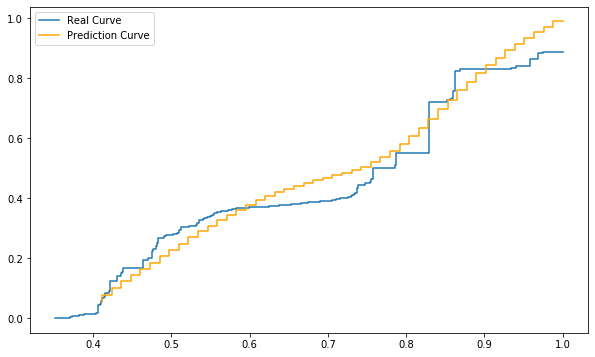

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using the Random Forest + CNN procedure
pp1 = rf_cnn_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Save the dataframe
rf_cnn_l1_distances.to_csv('rf_cnn_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading the dataframe
rf_cnn_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest + CNN\2\rf_cnn_l1_distances_scaled_final_2_qq_desv_2_incremental.csv')

In [ ]:
# Mean error for each hour
rf_cnn_l1_distances.mean()

1    0.0238231843
2    0.0259867911
3    0.0292749381
4    0.0309600567
5    0.0305329934
6    0.0265680281
7    0.0201281200
8    0.0184080761
9    0.0164213041
10   0.0134989407
11   0.0117680397
12   0.0103245753
13   0.0096966954
14   0.0090438635
15   0.0092641022
16   0.0094273969
17   0.0098595108
18   0.0106412274
19   0.0116835198
20   0.0120546103
21   0.0125049087
22   0.0126532943
23   0.0132470784
24   0.0147527399
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(rf_cnn_l1_distances.mean()) / 24, 4)

0.0164

## Analysis comparison Naive vs Random Forest + CNN

In [21]:
difference = naive_l1_distances.iloc[:, :25] - rf_cnn_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-0.0545576545,-0.2350714017,-0.3198453508,-0.4215998916,-0.4310817110,-0.2107228311,0.1331199002,-0.1308659624,-0.3635956052,-0.7642756149,...,-0.7426718555,-0.5798900075,-0.5983820007,-0.5518666020,-0.4347507531,-0.6323239163,-0.6938711151,-0.7163618719,-0.7426305841,-0.7158188258
std,1.5802014662,2.3744879257,2.6210055741,3.4933194591,3.3502688031,2.2447803659,1.1459589406,1.8250034395,1.9494002874,6.2098106341,...,4.0358606271,2.9464089817,3.4182545436,3.0035715394,1.7757523498,2.8020804354,2.6777639882,2.2262076467,2.1426896532,1.8815536801
min,-18.6075991062,-30.0370533492,-36.8802995974,-63.3133642994,-56.4780243051,-37.0245514858,-17.4984519524,-24.1844222820,-23.2793216791,-151.7263524357,...,-61.3755078545,-48.1845719259,-68.4827140942,-56.1876813539,-16.8069078596,-42.3156126826,-53.9884645928,-28.5743854787,-20.7938413060,-17.8921403214
25%,-0.1848314071,-0.2974634036,-0.4157278571,-0.4262639273,-0.4739270623,-0.3263449899,0.0044274697,-0.2930448807,-0.4824603715,-0.6900881557,...,-0.5004616492,-0.5097161618,-0.5236401269,-0.6039629314,-0.6082905561,-0.7362199748,-1.0487161922,-0.9897109528,-1.0783165755,-1.0452556307
50%,0.3625255750,0.3996779292,0.4118160489,0.4215107765,0.4307389483,0.4220319029,0.4394515807,0.3465406530,0.1801649299,0.1242155478,...,0.2402454949,0.2401847969,0.2103583506,0.1597618940,0.1475546686,0.1463682558,0.0793619018,-0.0003491683,-0.0411121413,-0.0555160773
75%,0.6676309139,0.7037485843,0.7121132569,0.7051105916,0.7105943919,0.7166525885,0.6826043784,0.6497982860,0.5456028127,0.5183495641,...,0.5559997304,0.5574064460,0.5664682194,0.5547542522,0.5197717232,0.4965548761,0.4775510415,0.4605231243,0.4503917425,0.4134108345
max,0.9348267475,0.9452072149,0.9348851349,0.9510648931,0.9500042898,0.9550785833,0.9488996026,0.9222106208,0.9173541625,0.9347103759,...,0.9069905748,0.8631966987,0.9187897875,0.9010316966,0.9070681864,0.8996183117,0.9090554882,0.8842913040,0.9353971572,0.8970525003


# Random Forest + LSTM

In [ ]:
# Computation of the standard deviation of X_train and dividing by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 3:52]
desv_x = df.std()
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[:(h-1) + (d-1) * 24, 52:]], axis = 1)

In [ ]:
# Obtaining X_train
d = 1012
h = 1
X_train = np.array(df_x)
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1) # Reshape data due to the input structure required

In [ ]:
X_train.shape

(24264, 128, 1)

In [ ]:
# Computation of the standard deviation of y_train and dividing by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[24:(h-1) + (d-1) * 24, 3:52]
desv_y = df.std()
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_train
d = 1013
h = 1
y_train = np.array(df_y)

In [ ]:
y_train.shape

(24264, 49)

In [ ]:
# Using the standard deviation of X_train to divide the data by it
d = 1012
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 3:52]
df = df.div(desv_x, axis=1)
df_x = pd.concat([df, grid_prices_scaled.iloc[(h-1) + (d-1) * 24: -24, 52:]], axis = 1)

In [ ]:
# Obtaining X_test
d = 1012
h = 1
X_test = np.array(df_x)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1) # Reshape data due to the input structure required

In [ ]:
X_test.shape

(17544, 128, 1)

In [ ]:
# Using the standard deviation of y_train to divide the data by it
d = 1013
h = 1
df = grid_prices_scaled.iloc[(h-1) + (d-1) * 24:, 3:52]
df_y = df.div(desv_y, axis=1)

In [ ]:
# Obtaining y_test
d = 1013
h = 1
y_test = np.array(df_y)

In [ ]:
y_test.shape

(17544, 49)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# Create the Random Forest model for regression
random_forest = RandomForestRegressor(n_estimators=100, random_state=42)

# Create the MultiOutputRegressor model with the Random Forest
multi_output_forest = MultiOutputRegressor(random_forest)

# Train the model
multi_output_forest.fit(X_train, y_train)

# Compute the predictions using the test set
rf_predictions = multi_output_forest.predict(X_test)

In [ ]:
# Loading the dataframe
rf_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest\rf_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_predictions = rf_predictions.values

[[1.29591006 1.7494723  1.41545224 ... 3.2043745  3.19157411 3.14518969]
 [1.98404331 2.07178102 1.66650374 ... 3.27451953 3.24639779 3.21846569]
 [1.10129776 1.49578976 1.20137777 ... 3.30992137 3.30101789 3.25545291]
 ...
 [0.00597637 0.01311886 0.0107071  ... 1.07596243 1.06637063 1.05117401]
 [0.04473039 0.01502991 0.0152275  ... 1.12582815 1.06389998 1.07102255]
 [0.01269523 0.00967848 0.0059431  ... 1.33155294 1.41156937 1.34968646]]


In [ ]:
# Reshaping data due to the input structure required
rf_predictions = rf_predictions.reshape(rf_predictions.shape[0], rf_predictions.shape[1], 1)

In [ ]:
rf_predictions.shape

(17544, 49, 1)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

model = Sequential()
# Add the first LSTM layer and dropout regularization
model.add(LSTM(units=64, input_shape=(rf_predictions.shape[1], rf_predictions.shape[2]), return_sequences=True))
model.add(Dropout(0.1))

# Add the second LSTM layer and dropout regularization
model.add(LSTM(units=128, return_sequences=True))
model.add(Dropout(0.1))

# Add the third LSTM layer and dropout regularization
model.add(LSTM(units=64))
model.add(Dropout(0.1))

# Dense layers
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))  # Add dropout for regularization

model.add(Dense(64, activation='relu'))
model.add(Dropout(0.1))

# Output layer with the same number of columns as y_train
model.add(Dense(rf_predictions.shape[1]))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[tensorflow.keras.metrics.MeanAbsoluteError()])

# Train the model with the training set
model.fit(rf_predictions, y_test, epochs=200, batch_size=32, verbose=1)

# Compute the predictions using the test set
predictions = model.predict(rf_predictions)

Epoch 1/200
549/549 [==============================] - 60s 103ms/step - loss: 0.4803 - mean_absolute_error: 0.4429
Epoch 2/200
549/549 [==============================] - 60s 109ms/step - loss: 0.3575 - mean_absolute_error: 0.3711
Epoch 3/200
549/549 [==============================] - 59s 108ms/step - loss: 0.3427 - mean_absolute_error: 0.3605
Epoch 4/200
549/549 [==============================] - 59s 107ms/step - loss: 0.3327 - mean_absolute_error: 0.3528
Epoch 5/200
549/549 [==============================] - 63s 115ms/step - loss: 0.3298 - mean_absolute_error: 0.3506
Epoch 6/200
549/549 [==============================] - 61s 111ms/step - loss: 0.3222 - mean_absolute_error: 0.3460
Epoch 7/200
549/549 [==============================] - 59s 107ms/step - loss: 0.3251 - mean_absolute_error: 0.3470
Epoch 8/200
549/549 [==============================] - 58s 106ms/step - loss: 0.3188 - mean_absolute_error: 0.3423
Epoch 9/200
549/549 [==============================] - 60s 109ms/step - loss: 0.

Epoch 141/200
549/549 [==============================] - 60s 108ms/step - loss: 0.1407 - mean_absolute_error: 0.2404
Epoch 142/200
549/549 [==============================] - 60s 110ms/step - loss: 0.1490 - mean_absolute_error: 0.2452
Epoch 143/200
549/549 [==============================] - 60s 110ms/step - loss: 0.1500 - mean_absolute_error: 0.2470
Epoch 144/200
549/549 [==============================] - 59s 108ms/step - loss: 0.1402 - mean_absolute_error: 0.2401
Epoch 145/200
549/549 [==============================] - 61s 110ms/step - loss: 0.1385 - mean_absolute_error: 0.2387
Epoch 146/200
549/549 [==============================] - 60s 109ms/step - loss: 0.1392 - mean_absolute_error: 0.2392
Epoch 147/200
549/549 [==============================] - 60s 109ms/step - loss: 0.1365 - mean_absolute_error: 0.2374
Epoch 148/200
549/549 [==============================] - 60s 109ms/step - loss: 0.1413 - mean_absolute_error: 0.2390
Epoch 149/200
549/549 [==============================] - 60s 110

In [ ]:
# Store the predictions into a dataframe
rf_lstm_predictions = pd.DataFrame(predictions)

In [ ]:
# Loading the dataframe
rf_lstm_predictions = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest + LSTM\rf_lstm_predictions_sin_multiplicar_ni_incrementar.csv')

In [ ]:
rf_lstm_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,4.1345916000,4.5090660000,4.8305507000,5.1963115000,5.0910964000,4.8496420000,4.5663896000,4.3244660000,4.0992610000,3.9201243000,...,3.6891708000,3.6364088000,3.6009336000,3.5775235000,3.5501351000,3.4892864000,3.4040961000,3.3349990000,3.2902377000,3.2846860000
1,5.7281966000,6.0210576000,6.2549060000,6.5248985000,6.2504635000,5.8471320000,5.4081500000,5.0357685000,4.6932020000,4.4117255000,...,3.7992687000,3.7203422000,3.6533580000,3.6280637000,3.5949955000,3.5360901000,3.4601622000,3.4166465000,3.3924920000,3.3994534000
2,5.7542920000,6.1516323000,6.4916654000,6.8282360000,6.5879865000,6.1849513000,5.7275753000,5.3258176000,4.9605000000,4.6411767000,...,3.9036832000,3.7945008000,3.7122989000,3.6834254000,3.6608968000,3.6169570000,3.5563037000,3.5237212000,3.5140874000,3.5266150000
3,8.5112890000,8.2009030000,7.8648350000,7.4568090000,6.8467050000,6.2706437000,5.8134494000,5.4164433000,5.0486300000,4.7107190000,...,4.0780620000,3.9193930000,3.8006763000,3.7759090000,3.7593594000,3.7142177000,3.6607883000,3.6260056000,3.6240733000,3.6293204000
4,7.8681045000,7.8225026000,7.7378387000,7.5986915000,7.0966597000,6.5502660000,6.0594540000,5.6277750000,5.2311454000,4.8702500000,...,4.0212765000,3.8723292000,3.7637196000,3.7382972000,3.7220273000,3.6809309000,3.6290290000,3.5984092000,3.6027358000,3.6163962000
5,5.6701465000,5.8141756000,5.9187512000,6.0434747000,5.7583170000,5.3910494000,5.0273420000,4.7253110000,4.4504220000,4.2213080000,...,3.7832403000,3.7122574000,3.6563063000,3.6411672000,3.6218800000,3.5730636000,3.5040953000,3.4511070000,3.4220104000,3.4181256000
6,1.5418943000,1.9316430000,2.3174012000,2.8242955000,3.1034596000,3.2912111000,3.3277721000,3.3227484000,3.2932180000,3.2770900000,...,3.4862494000,3.4905725000,3.5114837000,3.5161953000,3.5149393000,3.4834340000,3.4350917000,3.3895326000,3.3815410000,3.4092834000
7,0.2658761000,0.2713267200,0.2852868400,0.3012239300,0.3362421700,0.4370923000,0.5451199000,0.6771605000,0.8261608000,0.9941504000,...,2.2089462000,2.2830338000,2.3721900000,2.4622433000,2.5608030000,2.6457014000,2.7407048000,2.7908850000,2.8727179000,2.9548597000
8,-0.0128726200,-0.0018047271,-0.0006283857,-0.0013298476,0.0066235150,0.0118570530,0.0097139080,0.0089442570,0.0027009565,0.0034532044,...,1.2426066000,1.2493254000,1.2439961000,1.2409861000,1.2415410000,1.2413707000,1.2429302000,1.2454016000,1.2626303000,1.2846174000
9,-0.0030347146,0.0062861997,0.0061271860,0.0008377102,0.0012029409,0.0138572960,0.0276899800,0.0317391830,0.0409780600,0.0506606330,...,1.3682252000,1.3526659000,1.3360721000,1.3246214000,1.3166262000,1.3066632000,1.3004794000,1.2867326000,1.2951416000,1.3087431000


In [ ]:
# If there is any negative number it is changed to positive
for i in range(rf_lstm_predictions.shape[0]):
    for c in range(rf_lstm_predictions.shape[1]):
        if rf_lstm_predictions.iloc[i, c] < 0:
            rf_lstm_predictions.iloc[i, c] = abs(rf_lstm_predictions.iloc[i, c])

In [ ]:
for i in range(rf_lstm_predictions.shape[0]):
    for c in range(rf_lstm_predictions.shape[1]):
        if c < rf_lstm_predictions.shape[1] - 2:
            # If the first number is higher than the two nexts, it is changed being the same as the next number
            if c == 0 and rf_lstm_predictions.iloc[i, c] > rf_lstm_predictions.iloc[i, c + 1] and rf_lstm_predictions.iloc[i, c] > rf_lstm_predictions.iloc[i, c + 2]:
                rf_lstm_predictions.iloc[i, c] = rf_lstm_predictions.iloc[i, c + 1]
            # If any other number is higher than its next two numbers,
            if c != 0 and rf_lstm_predictions.iloc[i, c] > rf_lstm_predictions.iloc[i, c + 1] and rf_lstm_predictions.iloc[i, c] > rf_lstm_predictions.iloc[i, c + 2]:
                # if the next number is higher or equal to the previous number, the number is equal to its next one
                if rf_lstm_predictions.iloc[i, c + 1] >= rf_lstm_predictions.iloc[i, c - 1]:
                    rf_lstm_predictions.iloc[i, c] = rf_lstm_predictions.iloc[i, c + 1]
                # If the next number is smaller than the previous, the next one is equal to the number
                if rf_lstm_predictions.iloc[i, c + 1] < rf_lstm_predictions.iloc[i, c - 1]:
                    rf_lstm_predictions.iloc[i, c + 1] = rf_lstm_predictions.iloc[i, c]
            # If the number is higher than the next, but smaller than the next of the next, the next one is equal to the number
            if rf_lstm_predictions.iloc[i, c] > rf_lstm_predictions.iloc[i, c + 1] and rf_lstm_predictions.iloc[i, c] < rf_lstm_predictions.iloc[i, c + 2]:
                rf_lstm_predictions.iloc[i, c + 1] = rf_lstm_predictions.iloc[i, c]
        if c >= rf_lstm_predictions.shape[1] - 2:
            # If the last two are smaller than the previous number, they are changed being equal to the previous one
            if rf_lstm_predictions.iloc[i, c] < rf_lstm_predictions.iloc[i, c - 1]:
                rf_lstm_predictions.iloc[i, c] = rf_lstm_predictions.iloc[i, c - 1]

In [ ]:
rf_lstm_predictions

,1,2,3,4,5,6,7,8,9,10,...,40,41,42,43,44,45,46,47,48,49
0,4.1345916000,4.5090660000,4.8305507000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,...,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000,5.0910964000
1,5.7281966000,6.0210576000,6.2549060000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,...,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000,6.5248985000
2,5.7542920000,6.1516323000,6.4916654000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,...,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000,6.5879865000
3,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,...,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000,8.2009030000
4,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,...,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000,7.8225026000
5,5.6701465000,5.8141756000,5.9187512000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,...,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000,6.0434747000
6,1.5418943000,1.9316430000,2.3174012000,2.8242955000,3.1034596000,3.2912111000,3.3227484000,3.3227484000,3.3227484000,3.3227484000,...,3.4909380000,3.4909380000,3.5114837000,3.5149393000,3.5149393000,3.5149393000,3.5149393000,3.5149393000,3.5149393000,3.5149393000
7,0.2658761000,0.2713267200,0.2852868400,0.3012239300,0.3362421700,0.4370923000,0.5451199000,0.6771605000,0.8261608000,0.9941504000,...,2.6202083000,2.6202083000,2.6202083000,2.6202083000,2.6202083000,2.6457014000,2.7407048000,2.7908850000,2.8727179000,2.9548597000
8,0.0018047271,0.0018047271,0.0018047271,0.0018047271,0.0066235150,0.0097139080,0.0097139080,0.0097139080,0.0097139080,0.0097139080,...,1.2611006000,1.2611006000,1.2611006000,1.2611006000,1.2611006000,1.2611006000,1.2611006000,1.2611006000,1.2626303000,1.2846174000
9,0.0030347146,0.0061271860,0.0061271860,0.0061271860,0.0061271860,0.0138572960,0.0276899800,0.0317391830,0.0409780600,0.0506606330,...,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000,1.5324018000


In [ ]:
# Rename the columns from 0, ..., n - 1 to 1, ..., n
nuevos_nombres = {}
for i, col in enumerate(rf_lstm_predictions.columns):
    nuevos_nombres[col] = str(i + 1)

rf_lstm_predictions = rf_lstm_predictions.rename(columns=nuevos_nombres)

In [ ]:
# Save the data
rf_lstm_predictions.to_csv('rf_lstm_predictions_incremental_sin_multiplicar.csv', index = False)

In [ ]:
# Multiply by the standard deviation of y_train in order to return to the original scale
rf_lstm_predictions = rf_lstm_predictions.multiply(desv_y, axis = 1)

In [ ]:
# Define again the same grid of quantities
minimum = energy_m_reduced_scaled.iloc[42601, 386]
energy_m_reduced_scaled.iloc[42601, 386]
max_q = minimum

min_q = energy_m_reduced_scaled['x1'].quantile(0.3)
qq1 = np.linspace(min_q, max_q, 49)
qq1 = qq1.tolist()

In [ ]:
# Create an empty dataframe
rf_lstm_l1_distances = pd.DataFrame()

for d in range(1013, 1743):

  for h in range(1, 25):

    qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
    pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

    # Remove the NaN values from the list
    qq = [x for x in qq if not np.isnan(x)]
    pp = [x for x in pp if not np.isnan(x)]

   # Compute the prediction using Random Forest + LSTM procedure
    pp1 = rf_lstm_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

    # The list of combined qq´s is obtained and then sorted
    qq_combinada = list(set(qq + qq1))
    qq_combinada = sorted(qq_combinada)

    # Initialize a list to store the differences between successive elements (q's)
    diferencias = np.diff(qq_combinada).tolist()

    # Compute the L1 distance between the two step functions
    l1 = l1_distance(qq, pp, qq1, pp1, diferencias, qq_combinada)

    # Add to each column its distance value
    rf_lstm_l1_distances.at[d, f'{h}'] = l1

    print(f"Distancia L1 (Manhattan) para la hora {h} del día {d}:", l1)
    print('------------------------')
    print()


# Reset the indices to start at 0
rf_lstm_l1_distances.reset_index(drop=True, inplace=True)

Distancia L1 (Manhattan) para la hora 1 del día 1013: 0.02229038391080445
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1013: 0.023441769164789752
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1013: 0.02307602070987829
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1013: 0.031682325580982156
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1013: 0.029328137992698886
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1013: 0.03920443058964011
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1013: 0.0344373822531577
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1013: 0.0655403473488386
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1013: 0.13081673041048564
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1013: 0.07005073823010548
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1016: 0.016331022867478426
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1016: 0.015324234021095689
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1016: 0.019409715421304145
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1016: 0.020590886898765242
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1017: 0.03067155196218571
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1017: 0.02221071961881722
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1017: 0.020929085562459905
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1017: 0.016496793044379635
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1017: 0.014555086321766504
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1017: 0.01551881186505628
---------------

Distancia L1 (Manhattan) para la hora 19 del día 1020: 0.012497934467493851
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1020: 0.015223405777424478
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1020: 0.022623137286036054
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1020: 0.023025449482311257
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1020: 0.018948348723546764
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1020: 0.01462017660352617
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1021: 0.018182314482482743
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1021: 0.0163011848706311
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1021: 0.03862659693428909
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1021: 0.011885601385940617
--------------

Distancia L1 (Manhattan) para la hora 2 del día 1025: 0.017430530001575226
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1025: 0.01731469841059357
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1025: 0.018539670509270655
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1025: 0.015377129463471145
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1025: 0.0161895621713764
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1025: 0.01949835798229583
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1025: 0.03176222902873527
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1025: 0.02797178238868881
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1025: 0.016035790329056564
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1025: 0.010659369866708172
--------------------

Distancia L1 (Manhattan) para la hora 15 del día 1029: 0.007283839091626791
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1029: 0.00714852193302855
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1029: 0.007888446092771988
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1029: 0.01047440391873039
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1029: 0.008706495121763691
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1029: 0.012338625926745695
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1029: 0.009927451091798366
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1029: 0.009108926309685857
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1029: 0.016021155556810933
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1029: 0.04685530998022469
---------

Distancia L1 (Manhattan) para la hora 10 del día 1034: 0.010224009444138454
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1034: 0.01208648858736402
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1034: 0.015131962531576788
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1034: 0.01656469996736662
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1034: 0.020132265478123863
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1034: 0.02209751480861777
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1034: 0.025848914837514187
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1034: 0.028672380566567277
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1034: 0.032948342549049124
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1034: 0.036455975547138295
---------

Distancia L1 (Manhattan) para la hora 12 del día 1039: 0.06307153953770975
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1039: 0.07036198254676496
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1039: 0.07323187361954982
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1039: 0.06977442631438666
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1039: 0.06803973523077034
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1039: 0.06941810515319828
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1039: 0.07108631630461407
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1039: 0.04978147402870023
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1039: 0.049430631990407134
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1039: 0.041753315244942364
--------------

Distancia L1 (Manhattan) para la hora 7 del día 1044: 0.028814390001680665
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1044: 0.04143492569947671
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1044: 0.018863046322894303
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1044: 0.016648699079506543
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1044: 0.008422413777202185
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1044: 0.008446226637431274
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1044: 0.01272434617579147
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1044: 0.008120217594680084
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1044: 0.011135443274128838
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1044: 0.010787340017564092
-----------

Distancia L1 (Manhattan) para la hora 22 del día 1048: 0.0212401372839478
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1048: 0.02610016494899423
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1048: 0.02265446791046509
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1049: 0.029997927519156208
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1049: 0.02730053876741227
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1049: 0.017445174460619804
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1049: 0.02777689886949978
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1049: 0.014372268714507265
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1049: 0.025305963151348948
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1049: 0.028971965546692652
-------------------

Distancia L1 (Manhattan) para la hora 5 del día 1053: 0.009972967784172976
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1053: 0.012257776323932046
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1053: 0.05090374145862056
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1053: 0.016268241597185866
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1053: 0.029179793855434254
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1053: 0.03512767116166393
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1053: 0.026933090774910445
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1053: 0.028634188193643127
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1053: 0.02216449166716438
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1053: 0.021148244187032764
--------------

Distancia L1 (Manhattan) para la hora 8 del día 1057: 0.0350190713541139
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1057: 0.035017614033631524
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1057: 0.04000157095598632
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1057: 0.03981395714894908
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1057: 0.04011395242123719
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1057: 0.03664970947876931
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1057: 0.032787142762355635
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1057: 0.028934043449204097
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1057: 0.027192196251275932
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1057: 0.02403117503706097
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1061: 0.00829388826207849
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1061: 0.007985431625368614
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1061: 0.008470400889077925
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1061: 0.01126901213670095
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1061: 0.012580627674338344
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1061: 0.01347260351250413
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1061: 0.009369410996452276
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1061: 0.008882457187055201
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1061: 0.009763216279968498
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1061: 0.020387347955361873
---------

Distancia L1 (Manhattan) para la hora 21 del día 1065: 0.009181304669031122
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1065: 0.009236742873467397
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1065: 0.010272226060230023
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1065: 0.012483112812422037
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1066: 0.031110974779611465
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1066: 0.02553482186713601
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1066: 0.013469908688621045
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1066: 0.0205277042944553
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1066: 0.014429506568768654
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1066: 0.013968400575787295
---------------

Distancia L1 (Manhattan) para la hora 11 del día 1069: 0.01657795951592389
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1069: 0.02589027557291257
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1069: 0.0340083109032438
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1069: 0.02901309217624208
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1069: 0.03079951332017445
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1069: 0.030587308501247586
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1069: 0.0255688948352787
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1069: 0.02143149257632758
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1069: 0.027660737543660236
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1069: 0.029985867703976727
---------------

Distancia L1 (Manhattan) para la hora 2 del día 1073: 0.023609350228116173
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1073: 0.013723112760184255
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1073: 0.017819071623453933
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1073: 0.016580653755358984
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1073: 0.038485295640381056
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1073: 0.014808183060865964
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1073: 0.025450915518152546
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1073: 0.009128818552683283
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1073: 0.009249534429981165
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1073: 0.012971069239480652
--------------

Distancia L1 (Manhattan) para la hora 20 del día 1076: 0.00942765079391501
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1076: 0.02462174517453124
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1076: 0.04066386447755175
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1076: 0.03961848079371058
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1076: 0.046090442440083236
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1077: 0.022152135033295675
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1077: 0.012885982021261818
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1077: 0.019079366879992742
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1077: 0.01675423728805389
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1077: 0.04670769012302845
-----------------

Distancia L1 (Manhattan) para la hora 8 del día 1081: 0.017680023154397248
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1081: 0.02494864989738678
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1081: 0.014075845268146016
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1081: 0.014459143713078349
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1081: 0.009913237528981867
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1081: 0.008667321798793974
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1081: 0.008752057690472523
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1081: 0.008850806346093254
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1081: 0.008928126690597392
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1081: 0.007849418318671472
---------

Distancia L1 (Manhattan) para la hora 13 del día 1085: 0.013618973061542517
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1085: 0.01453174013968789
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1085: 0.014985996536973464
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1085: 0.014575435486146635
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1085: 0.01428864445205533
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1085: 0.012400160616625047
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1085: 0.015373431924284673
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1085: 0.014635770985642409
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1085: 0.011143256705214485
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1085: 0.010035323417659704
--------

Distancia L1 (Manhattan) para la hora 2 del día 1090: 0.014770845257241896
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1090: 0.013216611532950614
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1090: 0.024342862328894568
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1090: 0.016488190985330973
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1090: 0.01483560725673528
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1090: 0.025260685782123222
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1090: 0.01540357458699282
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1090: 0.009994000464866558
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1090: 0.011534050716975067
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1090: 0.015068610092176811
----------------

Distancia L1 (Manhattan) para la hora 15 del día 1094: 0.011758169292181698
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1094: 0.012076599876517635
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1094: 0.02171059679558281
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1094: 0.015154905853241318
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1094: 0.02007164467251938
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1094: 0.010793298194508541
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1094: 0.01082118961594171
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1094: 0.012174484102764362
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1094: 0.011118591636405894
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1094: 0.015870774264680858
---------

Distancia L1 (Manhattan) para la hora 16 del día 1098: 0.01444674454689818
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1098: 0.01667264708267298
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1098: 0.015903522496979367
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1098: 0.012224364684732661
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1098: 0.014646765169016534
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1098: 0.016528809464587724
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1098: 0.015892979761226743
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1098: 0.011350162008030833
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1098: 0.013104620859962439
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1099: 0.013838644147212437
---------

Distancia L1 (Manhattan) para la hora 8 del día 1102: 0.021171653571488556
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1102: 0.036717557910382385
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1102: 0.022097125268021205
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1102: 0.024228512467417453
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1102: 0.02129900492136008
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1102: 0.021581228393533453
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1102: 0.0275288860571844
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1102: 0.0314083304541415
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1102: 0.0218203030109168
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1102: 0.025686360124259643
---------------

Distancia L1 (Manhattan) para la hora 22 del día 1105: 0.013888775124113253
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1105: 0.016753230078424615
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1105: 0.01271428677846986
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1106: 0.015182488663459814
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1106: 0.009871189770148224
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1106: 0.01096914272245058
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1106: 0.010812257434791389
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1106: 0.01357780341227601
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1106: 0.01508454977630592
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1106: 0.033339010004902574
-----------------

Distancia L1 (Manhattan) para la hora 14 del día 1110: 0.015204394529871493
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1110: 0.015597590874902655
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1110: 0.018173242311791963
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1110: 0.015304108487514604
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1110: 0.0152012579143293
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1110: 0.010218900276509166
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1110: 0.009846704091462927
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1110: 0.010392962139732126
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1110: 0.010400707318723456
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1110: 0.010540980992419804
--------

Distancia L1 (Manhattan) para la hora 19 del día 1114: 0.017449529161526704
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1114: 0.022176712981488527
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1114: 0.024477276427363012
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1114: 0.02259714033175528
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1114: 0.026990827316049428
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1114: 0.042431289097568804
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1115: 0.02698677101477079
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1115: 0.02723810601760917
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1115: 0.020086973739914703
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1115: 0.044693911073725695
-------------

Distancia L1 (Manhattan) para la hora 11 del día 1118: 0.02990923525197359
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1118: 0.03686437625970248
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1118: 0.03000677884464232
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1118: 0.030898654315027453
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1118: 0.03519933688485656
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1118: 0.03639975633973
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1118: 0.030964197051692212
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1118: 0.03316714424930232
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1118: 0.03409837227869318
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1118: 0.02982418977119919
-----------------

Distancia L1 (Manhattan) para la hora 18 del día 1122: 0.011112913037980258
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1122: 0.009412440166405682
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1122: 0.011784439840129276
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1122: 0.01583472836753311
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1122: 0.012356289506555033
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1122: 0.012295026380909175
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1122: 0.01381516603889061
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1123: 0.013301940585513284
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1123: 0.017494520036666825
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1123: 0.014138627506402409
-----------

Distancia L1 (Manhattan) para la hora 3 del día 1126: 0.01978357669208378
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1126: 0.017570676158436743
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1126: 0.014690919799820297
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1126: 0.019248941099257236
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1126: 0.03437840975299192
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1126: 0.015347443502290475
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1126: 0.0208472401284101
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1126: 0.023151709941220327
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1126: 0.021603436210117184
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1126: 0.027232773169214
--------------------

Distancia L1 (Manhattan) para la hora 7 del día 1130: 0.023201504716444724
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1130: 0.0302682525175251
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1130: 0.020524887365449294
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1130: 0.011831398020576216
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1130: 0.01856311364878699
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1130: 0.013117735834572309
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1130: 0.013651280448777007
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1130: 0.013310098032785034
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1130: 0.015432261838647996
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1130: 0.01668477549781644
-------------

Distancia L1 (Manhattan) para la hora 3 del día 1134: 0.024166186086954426
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1134: 0.020902735928024625
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1134: 0.020714000853539874
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1134: 0.020183907487512254
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1134: 0.021753385914876244
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1134: 0.027199615238220867
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1134: 0.040201657646100716
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1134: 0.04953208857839181
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1134: 0.05206086788720095
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1134: 0.042122633872675695
---------------

Distancia L1 (Manhattan) para la hora 23 del día 1137: 0.023512804435186732
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1137: 0.031007275626421714
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1138: 0.014700610918718944
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1138: 0.01893773168166841
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1138: 0.019012051958478878
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1138: 0.017551096556560255
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1138: 0.018481581782747832
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1138: 0.015679609534966867
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1138: 0.015109162319019775
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1138: 0.037743539890367286
---------------

Distancia L1 (Manhattan) para la hora 14 del día 1142: 0.019991207496350923
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1142: 0.01743397488443404
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1142: 0.014920776513520171
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1142: 0.015558997677594609
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1142: 0.016003258624743062
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1142: 0.0135600983845015
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1142: 0.017427689082479412
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1142: 0.022690185743938315
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1142: 0.026877612775657436
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1142: 0.027576523222024644
---------

Distancia L1 (Manhattan) para la hora 1 del día 1146: 0.02069966606151038
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1146: 0.018313010421326013
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1146: 0.0185950292290614
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1146: 0.01775007543199988
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1146: 0.014080093321684202
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1146: 0.018472404420907675
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1146: 0.015381637526342612
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1146: 0.026074709333316348
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1146: 0.018254449871188606
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1146: 0.015805550008553847
-------------------

Distancia L1 (Manhattan) para la hora 2 del día 1150: 0.016975208625266653
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1150: 0.015617889873829506
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1150: 0.021893598874067263
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1150: 0.014307742256014333
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1150: 0.013675984628605071
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1150: 0.019673169061482136
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1150: 0.026537325239270708
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1150: 0.0402175681423067
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1150: 0.04142680978015242
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1150: 0.0336865521802759
-------------------

Distancia L1 (Manhattan) para la hora 24 del día 1154: 0.013496430419463473
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1155: 0.021964698081596186
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1155: 0.022485138707211128
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1155: 0.021130750454813836
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1155: 0.023614099747483006
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1155: 0.022351933115799118
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1155: 0.02114911313917111
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1155: 0.03183606193076529
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1155: 0.026112519426320962
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1155: 0.01818897700422807
------------------

Distancia L1 (Manhattan) para la hora 20 del día 1158: 0.0066671494916839494
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1158: 0.008233441310360344
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1158: 0.0100716979524039
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1158: 0.013419800788134668
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1158: 0.013404407466369738
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1159: 0.017782845275176255
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1159: 0.017137357394765722
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1159: 0.018143900599321926
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1159: 0.01707593610334601
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1159: 0.02352544525122175
--------------

Distancia L1 (Manhattan) para la hora 14 del día 1162: 0.010419582493438648
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1162: 0.013382583113112021
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1162: 0.017600841799179527
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1162: 0.017441661123300457
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1162: 0.015042718491595608
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1162: 0.016010650786988254
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1162: 0.015601416564275132
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1162: 0.013731959494033502
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1162: 0.015500458056005221
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1162: 0.008246447887307412
------

Distancia L1 (Manhattan) para la hora 1 del día 1168: 0.014890802910203508
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1168: 0.0192421889310792
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1168: 0.01815298024206257
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1168: 0.02092071131580938
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1168: 0.022346892749544982
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1168: 0.018817234107943375
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1168: 0.019150340213876647
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1168: 0.019315662311931624
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1168: 0.010182590036761797
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1168: 0.022286490691614744
-------------------

Distancia L1 (Manhattan) para la hora 23 del día 1171: 0.0073763785746695995
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1171: 0.007247008293295747
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1172: 0.015697635415609187
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1172: 0.012377472754059612
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1172: 0.013683835246771935
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1172: 0.01450316655248976
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1172: 0.015517027287569969
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1172: 0.017706193978280937
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1172: 0.017225886193702154
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1172: 0.024668327606419814
--------------

Distancia L1 (Manhattan) para la hora 1 del día 1176: 0.016107471903130114
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1176: 0.01183501502097374
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1176: 0.011974753164301195
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1176: 0.012486718428048086
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1176: 0.013533102262381821
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1176: 0.01858478233883991
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1176: 0.031687646665497754
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1176: 0.008178108482200085
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1176: 0.007049828958720646
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1176: 0.008658534553631858
-----------------

Distancia L1 (Manhattan) para la hora 20 del día 1180: 0.008482379341385567
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1180: 0.008995769465932786
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1180: 0.006310555537147795
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1180: 0.00912790820119647
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1180: 0.006603339804757505
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1181: 0.024018901114419112
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1181: 0.01913160507256682
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1181: 0.020279717466748462
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1181: 0.019161160440171847
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1181: 0.01726696662679264
--------------

Distancia L1 (Manhattan) para la hora 19 del día 1184: 0.007878014844007124
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1184: 0.005590914765000602
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1184: 0.008397655652104041
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1184: 0.01128653676374079
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1184: 0.0169485625588034
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1184: 0.010214041253446556
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1185: 0.013793960428983554
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1185: 0.014006235710213737
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1185: 0.019948488851484796
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1185: 0.017668276062459985
-------------

Distancia L1 (Manhattan) para la hora 7 del día 1188: 0.03561525895096346
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1188: 0.030919104966799595
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1188: 0.012096297865889786
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1188: 0.008685483650536223
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1188: 0.009057645272431802
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1188: 0.0072628747024521215
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1188: 0.008122176065305737
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1188: 0.009906524703477618
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1188: 0.008225485442228052
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1188: 0.01119204784503013
----------

Distancia L1 (Manhattan) para la hora 8 del día 1193: 0.01966942057690298
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1193: 0.014241925820362177
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1193: 0.00765149618650694
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1193: 0.008383781395198343
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1193: 0.00514775440494545
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1193: 0.005326249569564057
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1193: 0.004203067194707819
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1193: 0.004085770703635783
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1193: 0.004301526845774556
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1193: 0.0038164618053082937
----------

Distancia L1 (Manhattan) para la hora 12 del día 1198: 0.0077829447225834635
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1198: 0.010723256518857327
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1198: 0.008539896729809822
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1198: 0.0069397596739414705
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1198: 0.006410229123086229
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1198: 0.007134537091453455
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1198: 0.007402578095504416
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1198: 0.006682215295980078
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1198: 0.008804003904701062
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1198: 0.006217292368919531
----

Distancia L1 (Manhattan) para la hora 1 del día 1202: 0.022390090793153128
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1202: 0.016671146574547314
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1202: 0.01440290436181262
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1202: 0.01714709404051819
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1202: 0.017532608202663974
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1202: 0.026709653445165953
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1202: 0.022196475201232968
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1202: 0.007066491089286368
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1202: 0.00883199956564736
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1202: 0.010517299732986126
------------------

Distancia L1 (Manhattan) para la hora 21 del día 1205: 0.020633720443404443
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1205: 0.014289701943956595
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1205: 0.012371513662856201
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1205: 0.009769571120944983
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1206: 0.023892758810072627
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1206: 0.016124165055081234
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1206: 0.014071464165160466
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1206: 0.021021506434183854
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1206: 0.022042356525378393
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1206: 0.01689444381614624
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1209: 0.013461369525802938
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1209: 0.005096558446429708
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1209: 0.004200328009435858
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1209: 0.00504665652692933
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1209: 0.004273568731761141
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1209: 0.0037456515463752194
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1209: 0.008212851152176962
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1210: 0.013295961503989033
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1210: 0.024628182887396665
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1210: 0.019938670808304332
---------

Distancia L1 (Manhattan) para la hora 9 del día 1213: 0.01130593115267498
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1213: 0.0074957376815371814
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1213: 0.013465540675857776
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1213: 0.011575886753407084
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1213: 0.008917520493004816
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1213: 0.012865018151849417
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1213: 0.011714865544343428
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1213: 0.011588121633145158
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1213: 0.010388690017687096
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1213: 0.010507920441629242
-------

Distancia L1 (Manhattan) para la hora 24 del día 1216: 0.01390836428605735
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1217: 0.018721909289909057
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1217: 0.01473548132987083
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1217: 0.015548480386561541
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1217: 0.019077490618422514
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1217: 0.024687786892803917
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1217: 0.01728375314174854
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1217: 0.018178133180934412
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1217: 0.012970896482994532
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1217: 0.027915665715292887
------------------

Distancia L1 (Manhattan) para la hora 14 del día 1220: 0.0065771430309207275
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1220: 0.008090980606697665
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1220: 0.007977435763319139
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1220: 0.007087832463243581
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1220: 0.0056414896160825725
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1220: 0.010236497564129131
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1220: 0.007348926495167624
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1220: 0.006594317578638193
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1220: 0.006727193121224854
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1220: 0.0070267303326883405
---

Distancia L1 (Manhattan) para la hora 23 del día 1223: 0.012942315698894617
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1223: 0.01791319760017556
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1224: 0.03972912105234637
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1224: 0.013412895736740094
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1224: 0.02562121453196662
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1224: 0.017045409984304438
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1224: 0.012291723405427661
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1224: 0.02119065103402963
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1224: 0.01586251238626268
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1224: 0.007044363655470732
-------------------

Distancia L1 (Manhattan) para la hora 19 del día 1227: 0.0049632077687858335
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1227: 0.00532394514430336
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1227: 0.00637294882245642
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1227: 0.006791392743744266
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1227: 0.006040593141631991
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1227: 0.010535759281404787
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1228: 0.025905053153795723
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1228: 0.019173058817586526
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1228: 0.019547380545927653
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1228: 0.016705452420005602
-----------

Distancia L1 (Manhattan) para la hora 24 del día 1231: 0.0116635808123659
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1232: 0.01262103625759911
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1232: 0.012142550586157604
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1232: 0.014097994339318649
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1232: 0.013356529315732248
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1232: 0.018064562371390265
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1232: 0.011424628466884657
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1232: 0.01676693128583346
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1232: 0.006610630509907199
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1232: 0.01289296359581803
--------------------

Distancia L1 (Manhattan) para la hora 18 del día 1235: 0.011338170117235235
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1235: 0.007981262250421348
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1235: 0.008996694122844012
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1235: 0.014017363133450854
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1235: 0.013250551201011736
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1235: 0.009281544989109086
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1235: 0.01507282292906261
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1236: 0.022670332230844394
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1236: 0.017016624658141875
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1236: 0.016418142943088878
----------

Distancia L1 (Manhattan) para la hora 17 del día 1239: 0.004489083411763743
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1239: 0.004481008073934918
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1239: 0.0038375590523901898
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1239: 0.00484151846504449
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1239: 0.005100401861881375
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1239: 0.008980109959896416
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1239: 0.008736479656802288
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1239: 0.007939008705607127
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1240: 0.0136467911659572
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1240: 0.018386650494005716
----------

Distancia L1 (Manhattan) para la hora 6 del día 1243: 0.012641474432702773
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1243: 0.017154058492694933
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1243: 0.04621801901568226
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1243: 0.015912424953087926
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1243: 0.014491659211329326
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1243: 0.01385965075706886
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1243: 0.011890926067384275
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1243: 0.005576343815961279
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1243: 0.006230287675711809
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1243: 0.006910510940404785
------------

Distancia L1 (Manhattan) para la hora 3 del día 1247: 0.024910900106413173
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1247: 0.014770648107674735
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1247: 0.01767040770722306
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1247: 0.017289261477643307
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1247: 0.03249872286093934
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1247: 0.010812745883311103
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1247: 0.0068926447161768885
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1247: 0.006961259110007117
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1247: 0.007414522217739697
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1247: 0.0058632234658372445
-------------

Distancia L1 (Manhattan) para la hora 14 del día 1250: 0.005184878711258667
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1250: 0.005107070451956301
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1250: 0.005267832290477791
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1250: 0.00582765324818684
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1250: 0.00871068613581975
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1250: 0.0104499328231917
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1250: 0.013016498466120014
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1250: 0.010679797911555256
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1250: 0.01568662301911938
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1250: 0.01831016616685077
------------

Distancia L1 (Manhattan) para la hora 12 del día 1254: 0.011081079849530495
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1254: 0.0113354834168338
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1254: 0.010544105927641849
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1254: 0.008865851818375889
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1254: 0.006464763287089003
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1254: 0.005654541975058701
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1254: 0.006415937326948815
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1254: 0.006565135520589634
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1254: 0.005858440199680653
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1254: 0.00586859624736406
---------

Distancia L1 (Manhattan) para la hora 9 del día 1258: 0.004030862454907845
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1258: 0.004374073033527146
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1258: 0.010496676027774878
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1258: 0.013701001835270819
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1258: 0.018239946731684824
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1258: 0.02396017960379504
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1258: 0.014297933748761163
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1258: 0.014453054139295733
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1258: 0.014967515911082401
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1258: 0.016150384742933684
--------

Distancia L1 (Manhattan) para la hora 9 del día 1262: 0.011151806246298438
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1262: 0.007956858860172795
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1262: 0.008719799547542454
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1262: 0.008418903560836523
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1262: 0.009529096108818504
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1262: 0.00861822832674699
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1262: 0.009047037012330587
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1262: 0.0076874928225620885
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1262: 0.0065622637775648125
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1262: 0.007372719097734206
------

Distancia L1 (Manhattan) para la hora 11 del día 1267: 0.025886934328776798
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1267: 0.020837192860628094
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1267: 0.016802651154775146
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1267: 0.025961427578310752
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1267: 0.020468584463145804
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1267: 0.02007748612055248
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1267: 0.01695467195433392
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1267: 0.01913107979259119
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1267: 0.013106908987535436
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1267: 0.00732584570924704
----------

Distancia L1 (Manhattan) para la hora 23 del día 1271: 0.00927157868230259
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1271: 0.029216313750573313
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1272: 0.04040440862903539
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1272: 0.034398407123944104
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1272: 0.02610072330754496
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1272: 0.036125580417596385
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1272: 0.02963883146870573
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1272: 0.022032331921232457
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1272: 0.03127618315357749
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1272: 0.013666770653470913
-------------------

Distancia L1 (Manhattan) para la hora 7 del día 1276: 0.04736737525373359
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1276: 0.024217829124734594
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1276: 0.009213277691689635
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1276: 0.006053912182629609
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1276: 0.008397478249733796
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1276: 0.009525286333789901
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1276: 0.013796334211378618
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1276: 0.014506408993095047
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1276: 0.01828673428356501
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1276: 0.014197320665748943
-----------

Distancia L1 (Manhattan) para la hora 23 del día 1280: 0.025201323803539323
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1280: 0.013080088990178543
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1281: 0.020611883065501282
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1281: 0.017586630867636906
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1281: 0.016705531013555132
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1281: 0.016996310465840138
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1281: 0.02027038906852559
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1281: 0.017783767952046864
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1281: 0.02602543475141697
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1281: 0.016399440715179583
----------------

Distancia L1 (Manhattan) para la hora 13 del día 1285: 0.009641606181226725
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1285: 0.011116357774687124
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1285: 0.01455051771320937
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1285: 0.01749947172711562
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1285: 0.02174955900198084
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1285: 0.028555117085645367
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1285: 0.03177003627799642
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1285: 0.03222474520801956
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1285: 0.02709386744168054
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1285: 0.035482962126111225
------------

Distancia L1 (Manhattan) para la hora 2 del día 1289: 0.023043331397529346
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1289: 0.02401316766540949
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1289: 0.021495061290689184
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1289: 0.024687064644048476
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1289: 0.026757394771249603
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1289: 0.01928576966021487
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1289: 0.015972463623381596
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1289: 0.019341176039031533
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1289: 0.018255341562244176
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1289: 0.016636418833655416
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1293: 0.016234916449952622
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1293: 0.02489046398412655
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1293: 0.01948524509230344
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1293: 0.017586318452217215
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1293: 0.012411947948222733
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1293: 0.011472871940695968
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1293: 0.010090798252302483
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1293: 0.011321913588168277
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1293: 0.00977787486148678
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1293: 0.009842471985023771
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1296: 0.005688437611270284
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1296: 0.004907392933618836
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1296: 0.007142325591937177
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1296: 0.005002165617245633
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1296: 0.005669500172228298
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1296: 0.005539763025840012
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1296: 0.005842410352596474
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1296: 0.00609651143678522
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1297: 0.021737539979247433
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1297: 0.025799894921622928
---------

Distancia L1 (Manhattan) para la hora 4 del día 1302: 0.012618406965558295
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1302: 0.015495633621095867
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1302: 0.013725517592756776
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1302: 0.03038263570007259
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1302: 0.01802438843073452
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1302: 0.026349907491386017
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1302: 0.024528173784744076
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1302: 0.034644190616127196
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1302: 0.030983892161898854
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1302: 0.02492021783132336
---------------

Distancia L1 (Manhattan) para la hora 11 del día 1306: 0.01254080780407536
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1306: 0.006636911657200793
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1306: 0.006397699038801012
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1306: 0.007395623845704087
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1306: 0.007770111821160938
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1306: 0.007563148356762711
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1306: 0.008275095429890378
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1306: 0.008770272894391692
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1306: 0.014031675430800106
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1306: 0.01602264042272591
--------

Distancia L1 (Manhattan) para la hora 24 del día 1309: 0.017053145846618198
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1310: 0.021974197647537278
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1310: 0.014770302960506753
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1310: 0.022037139441686372
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1310: 0.01623821414431383
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1310: 0.013101852823481573
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1310: 0.012286947239136285
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1310: 0.03249967082326351
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1310: 0.00828470168268186
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1310: 0.0053365062729639505
-----------------

Distancia L1 (Manhattan) para la hora 13 del día 1314: 0.007083863652655711
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1314: 0.0064570001280782035
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1314: 0.005807615292958382
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1314: 0.011072774676677744
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1314: 0.011671763099958512
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1314: 0.019130406882544783
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1314: 0.015748221051978692
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1314: 0.020717010910073184
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1314: 0.015506153376443756
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1314: 0.015351396116985355
-----

Distancia L1 (Manhattan) para la hora 10 del día 1318: 0.03061482764615512
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1318: 0.03843078174809593
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1318: 0.024936342513450532
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1318: 0.024768758733151174
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1318: 0.02591598515086662
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1318: 0.02494506587691128
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1318: 0.02114199777734329
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1318: 0.01739248987851647
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1318: 0.013958899987733999
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1318: 0.01807916388525116
-------------

Distancia L1 (Manhattan) para la hora 2 del día 1323: 0.025479665307321257
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1323: 0.015306352365784235
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1323: 0.015390873161343408
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1323: 0.015882286688801785
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1323: 0.011345481615188117
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1323: 0.028300931373090726
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1323: 0.010442614135757446
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1323: 0.00830711843734834
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1323: 0.012635245515956043
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1323: 0.009778499413958967
---------------

Distancia L1 (Manhattan) para la hora 17 del día 1326: 0.011017271455324034
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1326: 0.009842311241276725
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1326: 0.01275881985727617
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1326: 0.015133959383589463
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1326: 0.017057310293342468
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1326: 0.016730914388605213
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1326: 0.020689654342619143
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1326: 0.024414637343065603
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1327: 0.01806451635332282
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1327: 0.021716277604865795
----------

Distancia L1 (Manhattan) para la hora 16 del día 1330: 0.02406841819911506
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1330: 0.017509999405269268
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1330: 0.01251318099463114
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1330: 0.01144203694354121
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1330: 0.015934845296074446
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1330: 0.011309454602595536
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1330: 0.012980296399439574
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1330: 0.012334029959020387
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1330: 0.011323982477057137
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1331: 0.03067911757992709
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1334: 0.021985713061839218
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1334: 0.016703075452334147
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1334: 0.017014060925039372
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1334: 0.010127271983663063
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1334: 0.011382287853352381
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1334: 0.010261479148518096
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1334: 0.009471085475758404
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1334: 0.009044743833894316
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1334: 0.009191220103987456
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1334: 0.011064048504682579
-------

Distancia L1 (Manhattan) para la hora 12 del día 1338: 0.04151243713009077
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1338: 0.04154334377532795
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1338: 0.04181296486574708
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1338: 0.044298296228998266
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1338: 0.048403303787662874
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1338: 0.060556795688329945
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1338: 0.05745714322667017
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1338: 0.062244593945850475
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1338: 0.055376479347416414
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1338: 0.04814320598873192
-----------

Distancia L1 (Manhattan) para la hora 2 del día 1343: 0.015042130529868844
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1343: 0.015125732566175306
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1343: 0.012513308138990493
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1343: 0.018088397563785316
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1343: 0.01277589684533069
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1343: 0.018615822252223968
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1343: 0.014164367307515333
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1343: 0.013805858276326653
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1343: 0.01370031181042924
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1343: 0.014291888211634863
----------------

Distancia L1 (Manhattan) para la hora 8 del día 1347: 0.0367417188284693
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1347: 0.030988264604033547
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1347: 0.032354533340100744
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1347: 0.025126237512715477
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1347: 0.026449252387625796
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1347: 0.03110894679635806
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1347: 0.028634826998967078
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1347: 0.032913617937924286
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1347: 0.026867869837309426
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1347: 0.024123039876911303
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1350: 0.012452237123577996
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1350: 0.011742395782516853
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1350: 0.012419284021590394
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1350: 0.01849841799062779
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1350: 0.023274444695555552
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1350: 0.023160879804368966
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1350: 0.029024717405242602
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1350: 0.04075686912864418
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1351: 0.02762796683138857
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1351: 0.030342660631117443
-----------

Distancia L1 (Manhattan) para la hora 9 del día 1354: 0.01153149079478412
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1354: 0.019785825359670838
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1354: 0.016099206819831537
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1354: 0.015368738892130012
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1354: 0.01544762948582088
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1354: 0.014715558251390799
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1354: 0.01192930344981042
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1354: 0.011282475335825291
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1354: 0.006692053695955779
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1354: 0.011881522220600644
----------

Distancia L1 (Manhattan) para la hora 23 del día 1357: 0.033467207095879054
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1357: 0.03405988933327155
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1358: 0.0771358275941071
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1358: 0.018746041856378924
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1358: 0.01792722493059945
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1358: 0.04945347912722438
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1358: 0.03774959682302099
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1358: 0.12269542005321742
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1358: 0.013518229488978782
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1358: 0.03299218170779849
----------------------

Distancia L1 (Manhattan) para la hora 4 del día 1362: 0.0151665988758376
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1362: 0.01661636989301004
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1362: 0.022610785424920038
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1362: 0.02778739122306435
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1362: 0.008497100751399991
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1362: 0.017617398793065724
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1362: 0.01203586368155531
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1362: 0.011047188083395932
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1362: 0.010950159458693796
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1362: 0.010825502543023058
-----------------

Distancia L1 (Manhattan) para la hora 21 del día 1366: 0.017739395232239483
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1366: 0.014912888712301519
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1366: 0.01657048184341415
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1366: 0.013012536917352175
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1367: 0.024957288823282322
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1367: 0.02079106438514458
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1367: 0.028286896861657394
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1367: 0.021646844963828356
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1367: 0.02559865610628033
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1367: 0.03288898260680493
----------------

Distancia L1 (Manhattan) para la hora 14 del día 1371: 0.011170013186757026
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1371: 0.009443994266978093
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1371: 0.00948999338306421
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1371: 0.009644512391894716
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1371: 0.009014958393653589
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1371: 0.016563382170728513
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1371: 0.01805729660106383
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1371: 0.018804838914897697
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1371: 0.019321283817312938
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1371: 0.013009284283534355
--------

Distancia L1 (Manhattan) para la hora 22 del día 1375: 0.01115918886661302
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1375: 0.011049917511361394
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1375: 0.013267926272645048
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1376: 0.022062075647124875
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1376: 0.026196518089577833
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1376: 0.02707486202007852
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1376: 0.016693146118403383
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1376: 0.026141650204406147
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1376: 0.01594971726342194
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1376: 0.017341097113255287
----------------

Distancia L1 (Manhattan) para la hora 2 del día 1381: 0.014147871584171912
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1381: 0.025911857457429646
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1381: 0.013283532433726195
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1381: 0.0215997237340133
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1381: 0.02056877875795033
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1381: 0.014378235655715187
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1381: 0.024151567791658737
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1381: 0.006280775624439792
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1381: 0.007705065364177388
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1381: 0.00817664507702764
------------------

Distancia L1 (Manhattan) para la hora 21 del día 1384: 0.006881957076811917
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1384: 0.006985664773351893
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1384: 0.007094401868754705
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1384: 0.008455033175950376
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1385: 0.016222319321894225
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1385: 0.010888134122711715
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1385: 0.013623553009617251
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1385: 0.01394947666960155
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1385: 0.017887007457161853
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1385: 0.022286287068513787
-------------

Distancia L1 (Manhattan) para la hora 6 del día 1389: 0.013103251557665903
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1389: 0.019490646450557227
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1389: 0.020291777259288078
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1389: 0.06253776558284961
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1389: 0.020932131483253458
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1389: 0.014064898057560837
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1389: 0.014471727855001877
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1389: 0.013534385443402581
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1389: 0.013417361609976185
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1389: 0.014539795768805333
-----------

Distancia L1 (Manhattan) para la hora 17 del día 1392: 0.012861749131783489
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1392: 0.018056655279543306
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1392: 0.017848333988930203
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1392: 0.015733491814699456
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1392: 0.013721321052061492
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1392: 0.0141334208654765
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1392: 0.013526051192303094
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1392: 0.01568539326717596
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1393: 0.018041032541156927
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1393: 0.014199567560430172
-----------

Distancia L1 (Manhattan) para la hora 12 del día 1396: 0.024907555505618552
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1396: 0.026221809785252684
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1396: 0.028394268785132154
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1396: 0.023375698932488916
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1396: 0.023625027107493292
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1396: 0.03431508061543708
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1396: 0.037725735785449105
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1396: 0.03834636646225803
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1396: 0.034976453312773347
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1396: 0.026420884248799733
--------

Distancia L1 (Manhattan) para la hora 7 del día 1400: 0.027878270702514023
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1400: 0.030030757009461784
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1400: 0.03951785622764384
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1400: 0.028984743631331883
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1400: 0.029907069853249466
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1400: 0.024623119810867636
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1400: 0.02142496869901728
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1400: 0.01939706930899152
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1400: 0.015454678234437136
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1400: 0.020939441883831865
------------

Distancia L1 (Manhattan) para la hora 21 del día 1404: 0.025340476079441353
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1404: 0.02886669147187196
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1404: 0.021847424627989567
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1404: 0.016984158517070757
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1405: 0.020602830828812063
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1405: 0.016423507575465845
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1405: 0.01343903186894755
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1405: 0.011159518238643782
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1405: 0.012874268870299164
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1405: 0.013922772201346696
--------------

Distancia L1 (Manhattan) para la hora 15 del día 1408: 0.007546727877472728
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1408: 0.007347205590473092
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1408: 0.007278038221921289
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1408: 0.008427830243984198
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1408: 0.008347330563378079
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1408: 0.007502151920280194
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1408: 0.007232856049819392
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1408: 0.006857801246891469
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1408: 0.008954051869687969
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1408: 0.008504853478896953
------

Distancia L1 (Manhattan) para la hora 3 del día 1413: 0.010249339417197325
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1413: 0.010964609514543372
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1413: 0.01946900914662885
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1413: 0.023362309986334973
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1413: 0.016195821745427136
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1413: 0.033414348410848844
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1413: 0.01437998957777756
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1413: 0.01657610996588123
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1413: 0.012644757801563348
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1413: 0.012733602161914737
----------------

Distancia L1 (Manhattan) para la hora 12 del día 1416: 0.028232989343465957
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1416: 0.02103840002606177
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1416: 0.022735582555632804
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1416: 0.02637478267240445
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1416: 0.02949360824458036
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1416: 0.032545048062481895
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1416: 0.03421439838062802
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1416: 0.026067385457102375
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1416: 0.024550861268740582
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1416: 0.025255491523665085
----------

Distancia L1 (Manhattan) para la hora 24 del día 1419: 0.020552972282194985
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1420: 0.018063303795212163
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1420: 0.02155311787719304
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1420: 0.023212139550743117
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1420: 0.01922229948533522
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1420: 0.022034039493457454
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1420: 0.022016074973911122
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1420: 0.016225793834257225
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1420: 0.02114304810266318
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1420: 0.027921339943851584
------------------

Distancia L1 (Manhattan) para la hora 20 del día 1424: 0.014052659313643065
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1424: 0.008290235994211931
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1424: 0.007833102452261893
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1424: 0.007416956097462641
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1424: 0.010985271206238949
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1425: 0.01362958692158689
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1425: 0.02069031692790576
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1425: 0.01244920745130796
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1425: 0.014297663962299752
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1425: 0.014536200854091137
--------------

Distancia L1 (Manhattan) para la hora 23 del día 1428: 0.021263305839969587
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1428: 0.021601778338663526
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1429: 0.03629187468492383
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1429: 0.013255918483336206
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1429: 0.014163843610572711
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1429: 0.014874020797101262
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1429: 0.013139135683061567
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1429: 0.0129707364191716
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1429: 0.017599194656987907
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1429: 0.02167154323450695
------------------

Distancia L1 (Manhattan) para la hora 18 del día 1432: 0.007667183701015452
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1432: 0.007199638210588011
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1432: 0.008264626992512155
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1432: 0.011449852781545025
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1432: 0.013033512081717036
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1432: 0.015124961445057115
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1432: 0.018750577471109756
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1433: 0.04612067079009913
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1433: 0.018452614889800087
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1433: 0.01949997953616882
-----------

Distancia L1 (Manhattan) para la hora 1 del día 1437: 0.011670346373687558
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1437: 0.008329864976516516
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1437: 0.007504330697966322
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1437: 0.006145524345286726
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1437: 0.0059962289071870374
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1437: 0.005862663546194186
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1437: 0.08364551715382276
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1437: 0.04320043245417965
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1437: 0.06380467490139943
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1437: 0.049467346267405544
-----------------

Distancia L1 (Manhattan) para la hora 23 del día 1440: 0.00785652619620174
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1440: 0.009344300808587648
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1441: 0.016636107729127186
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1441: 0.010958822849518058
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1441: 0.010361536738143936
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1441: 0.01522603771613714
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1441: 0.014553667590384971
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1441: 0.015365084139299533
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1441: 0.008446937184301097
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1441: 0.028326978096223407
----------------

Distancia L1 (Manhattan) para la hora 4 del día 1445: 0.01537406843541586
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1445: 0.015532950673642812
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1445: 0.01688926679260827
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1445: 0.014004759772743488
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1445: 0.015216435375237349
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1445: 0.022753474915593454
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1445: 0.027114264134321314
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1445: 0.018001001232604424
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1445: 0.017170531460235935
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1445: 0.012197096578168806
--------------

Distancia L1 (Manhattan) para la hora 18 del día 1448: 0.01662130944824211
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1448: 0.01651467044837927
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1448: 0.01499555960358977
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1448: 0.017880411196855753
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1448: 0.019555447133227936
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1448: 0.01436002675400983
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1448: 0.02080267365600257
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1449: 0.02547292227491245
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1449: 0.017002207841723464
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1449: 0.015262133999227224
---------------

Distancia L1 (Manhattan) para la hora 2 del día 1454: 0.006884230792293696
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1454: 0.006751496089940075
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1454: 0.005218989437270031
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1454: 0.010066532541229668
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1454: 0.010854051117395834
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1454: 0.027087912257564118
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1454: 0.022068554471173507
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1454: 0.015861685311894868
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1454: 0.016003325493369084
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1454: 0.01754175817948596
---------------

Distancia L1 (Manhattan) para la hora 8 del día 1458: 0.01926175559934305
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1458: 0.016273643259597598
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1458: 0.01860116872095542
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1458: 0.009516420290963697
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1458: 0.010293294724417429
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1458: 0.007139861853273864
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1458: 0.007274684977836003
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1458: 0.007427760691209611
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1458: 0.013590856249250518
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1458: 0.015731443232876067
----------

Distancia L1 (Manhattan) para la hora 2 del día 1462: 0.014181431362296602
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1462: 0.029936550299182817
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1462: 0.011185407908984972
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1462: 0.014935479289566723
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1462: 0.01670244388065682
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1462: 0.010646382196755177
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1462: 0.006131980633257558
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1462: 0.007428223747319862
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1462: 0.006900474944123012
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1462: 0.011223116171498413
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1467: 0.02242806786029531
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1467: 0.02466170985742055
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1467: 0.020179715277921582
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1467: 0.0182414836416677
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1467: 0.019906177225566545
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1467: 0.019743321031016593
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1467: 0.01675104217850001
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1467: 0.008541400427141577
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1467: 0.005549898250181541
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1467: 0.0045324931206066526
-------------

Distancia L1 (Manhattan) para la hora 19 del día 1470: 0.006136023964216019
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1470: 0.009121934980470424
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1470: 0.006694913763802287
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1470: 0.008500323793562189
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1470: 0.009693894412846288
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1470: 0.004164335219329204
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1471: 0.03664518940198294
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1471: 0.03525996920039866
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1471: 0.012257142658828359
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1471: 0.02077255972303754
-------------

Distancia L1 (Manhattan) para la hora 18 del día 1474: 0.03033406135716892
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1474: 0.03029232364000553
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1474: 0.02253419281775918
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1474: 0.013485946408468884
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1474: 0.013049407586680616
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1474: 0.01242131950954325
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1474: 0.010136573808354579
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1475: 0.02738368659188074
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1475: 0.026026027723452777
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1475: 0.015126999238813872
--------------

Distancia L1 (Manhattan) para la hora 11 del día 1478: 0.0159700201285788
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1478: 0.011779038439725248
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1478: 0.008939863385785089
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1478: 0.008361111011340962
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1478: 0.007836540485339848
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1478: 0.0055978883935653015
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1478: 0.003561995094801585
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1478: 0.005594341474468639
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1478: 0.005532959670622527
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1478: 0.005970828742997569
-------

Distancia L1 (Manhattan) para la hora 23 del día 1481: 0.006213520425396593
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1481: 0.005974038952541573
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1482: 0.014940571499665843
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1482: 0.016896858677912213
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1482: 0.01547896721177508
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1482: 0.01368246102047303
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1482: 0.012983105537405795
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1482: 0.029749190513084094
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1482: 0.05627770171411468
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1482: 0.0414751156294961
-------------------

Distancia L1 (Manhattan) para la hora 7 del día 1487: 0.020290099405679437
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1487: 0.022220749942507
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1487: 0.026075374938600827
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1487: 0.006235200081057294
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1487: 0.013007770075511396
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1487: 0.003518982104510559
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1487: 0.004774803545973826
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1487: 0.006986183236695643
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1487: 0.011028197807277422
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1487: 0.014644706820316686
------------

Distancia L1 (Manhattan) para la hora 18 del día 1490: 0.007448626617153838
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1490: 0.009263027113728929
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1490: 0.00832678295028889
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1490: 0.013729049842697932
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1490: 0.011973102964531647
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1490: 0.016079213433167344
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1490: 0.024927012471186505
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1491: 0.03535613041955568
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1491: 0.020434712962542477
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1491: 0.014684206621701279
-----------

Distancia L1 (Manhattan) para la hora 14 del día 1495: 0.005519828594652546
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1495: 0.004390431379265376
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1495: 0.005599765095220125
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1495: 0.006730826272537901
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1495: 0.007137932272521464
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1495: 0.006060611548148366
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1495: 0.008757998659802885
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1495: 0.009033029121712877
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1495: 0.008118958365133917
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1495: 0.007364669431614803
------

Distancia L1 (Manhattan) para la hora 11 del día 1500: 0.008675089730268145
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1500: 0.003925706431716228
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1500: 0.0016808812251169864
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1500: 0.0027381749343584148
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1500: 0.005105794282117241
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1500: 0.007612954713590928
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1500: 0.004995055923019156
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1500: 0.005123078696070189
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1500: 0.009184697018491863
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1500: 0.0114940797020705
------

Distancia L1 (Manhattan) para la hora 23 del día 1503: 0.020252500737599197
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1503: 0.023779079793357707
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1504: 0.018235495361591098
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1504: 0.027114745686533517
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1504: 0.013168692048254792
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1504: 0.015957138020898487
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1504: 0.015210495321165664
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1504: 0.01622192765189435
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1504: 0.027326158946889965
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1504: 0.026074323212866596
---------------

Distancia L1 (Manhattan) para la hora 7 del día 1508: 0.01718048864095912
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1508: 0.023866455545216318
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1508: 0.02123940306078182
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1508: 0.009870015632287333
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1508: 0.011591593747537016
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1508: 0.006972113497898477
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1508: 0.004694608699279327
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1508: 0.0045702995200471675
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1508: 0.0037333793569599293
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1508: 0.005176376580328411
---------

Distancia L1 (Manhattan) para la hora 17 del día 1512: 0.004991338538526049
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1512: 0.004384003628649228
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1512: 0.004633131941563299
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1512: 0.004684001045571732
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1512: 0.005316775463771487
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1512: 0.005463728352273545
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1512: 0.00593984257432424
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1512: 0.003709056365202558
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1513: 0.02437473905773438
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1513: 0.019410545288851066
----------

Distancia L1 (Manhattan) para la hora 18 del día 1517: 0.005076826418917578
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1517: 0.006087621448487314
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1517: 0.008548387545403976
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1517: 0.010711849410172355
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1517: 0.013241307533165131
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1517: 0.008804117950275508
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1517: 0.009853433471254953
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1518: 0.01690565510017523
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1518: 0.01806312219523567
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1518: 0.014773773080622925
-----------

Distancia L1 (Manhattan) para la hora 8 del día 1522: 0.02638307749253555
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1522: 0.02323275457313948
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1522: 0.012079675387913227
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1522: 0.007112703585973131
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1522: 0.008430731725218037
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1522: 0.01021560290361768
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1522: 0.009053910524212892
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1522: 0.00786531608120401
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1522: 0.006468678113685146
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1522: 0.004326058002719124
------------

Distancia L1 (Manhattan) para la hora 1 del día 1526: 0.030185735378249125
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1526: 0.02248964840584294
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1526: 0.02203273828387159
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1526: 0.019977209667874068
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1526: 0.016886350414165068
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1526: 0.019421169827453108
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1526: 0.017881846781655806
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1526: 0.023062957321814338
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1526: 0.011945101261358115
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1526: 0.009527862617735142
-----------------

Distancia L1 (Manhattan) para la hora 15 del día 1530: 0.011751543964045477
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1530: 0.008384825692750049
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1530: 0.0070974526476218994
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1530: 0.004329018446855128
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1530: 0.004536946878840617
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1530: 0.007929284924427946
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1530: 0.006677032704052147
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1530: 0.00823916894744995
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1530: 0.009649718035396798
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1530: 0.014062395973574577
------

Distancia L1 (Manhattan) para la hora 18 del día 1535: 0.014238347873375188
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1535: 0.016742947129943585
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1535: 0.013660653916225403
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1535: 0.015377270964077105
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1535: 0.007211437129357852
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1535: 0.008443592485455254
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1535: 0.011278034688517364
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1536: 0.025618697965602105
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1536: 0.019556043851255145
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1536: 0.0246625294670462
-----------

Distancia L1 (Manhattan) para la hora 20 del día 1540: 0.02860628158891888
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1540: 0.0214916888877037
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1540: 0.018968688716162786
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1540: 0.024109859998066942
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1540: 0.024475772203925147
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1541: 0.023663990002756638
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1541: 0.05137318626900545
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1541: 0.0236130614188396
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1541: 0.02526201639099248
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1541: 0.04014105162035042
-------------------

Distancia L1 (Manhattan) para la hora 15 del día 1545: 0.005561396415831892
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1545: 0.007455527119655149
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1545: 0.00841544282219951
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1545: 0.009036421893174894
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1545: 0.007771239720767437
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1545: 0.004706701116123761
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1545: 0.005097451972288957
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1545: 0.0058413776592886445
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1545: 0.0061844801012128515
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1545: 0.006644169349137799
-----

Distancia L1 (Manhattan) para la hora 5 del día 1549: 0.01667492674422416
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1549: 0.017701346309937235
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1549: 0.018043270903462305
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1549: 0.028483987596619204
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1549: 0.02336679024942661
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1549: 0.014868837794332929
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1549: 0.01662764599814409
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1549: 0.01712694360785929
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1549: 0.01416807298666427
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1549: 0.00992781939299848
-----------------

Distancia L1 (Manhattan) para la hora 12 del día 1555: 0.02130521067221995
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1555: 0.023036850367709628
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1555: 0.024554189023275868
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1555: 0.024443545809691103
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1555: 0.024114559118180737
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1555: 0.026531341159976293
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1555: 0.022358619931609452
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1555: 0.021399741294982046
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1555: 0.019450105627306896
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1555: 0.01028414295986722
--------

Distancia L1 (Manhattan) para la hora 1 del día 1559: 0.021970006217109407
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1559: 0.017338061916754622
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1559: 0.025573270804860534
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1559: 0.021601703324114735
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1559: 0.016429632586623204
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1559: 0.01608587311542197
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1559: 0.03808942783454494
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1559: 0.027200889017548666
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1559: 0.010758232440622014
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1559: 0.016354617889634278
-----------------

Distancia L1 (Manhattan) para la hora 11 del día 1563: 0.01216043138271284
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1563: 0.008618092566465252
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1563: 0.006195907286055983
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1563: 0.005398742167694869
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1563: 0.006032000199421252
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1563: 0.006783721378125035
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1563: 0.006407700761856815
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1563: 0.0065407405897242085
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1563: 0.008227555884194547
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1563: 0.011568781026973899
------

Distancia L1 (Manhattan) para la hora 7 del día 1567: 0.02201050582830595
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1567: 0.006804827684770743
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1567: 0.0058969176840697
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1567: 0.005756260282841161
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1567: 0.004585539323165764
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1567: 0.005942585679508686
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1567: 0.009085724669335264
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1567: 0.007374859955147339
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1567: 0.006107799540694706
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1567: 0.004522912330411972
------------

Distancia L1 (Manhattan) para la hora 3 del día 1572: 0.02029602759786818
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1572: 0.013584765400242043
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1572: 0.018793029148773382
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1572: 0.013464742236047596
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1572: 0.02389215057326442
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1572: 0.0683395982408399
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1572: 0.01054386741198644
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1572: 0.014316489271299396
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1572: 0.013217344370242783
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1572: 0.013764100543407515
------------------

Distancia L1 (Manhattan) para la hora 2 del día 1577: 0.024852439528788517
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1577: 0.018409804695321986
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1577: 0.016898679373430953
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1577: 0.01585586349258221
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1577: 0.014191112975837352
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1577: 0.018582803563358098
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1577: 0.017258628550048984
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1577: 0.020078235821148593
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1577: 0.023799730323392738
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1577: 0.018362030005273602
---------------

Distancia L1 (Manhattan) para la hora 18 del día 1581: 0.0061069541955456885
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1581: 0.010475719403273732
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1581: 0.006970045650895292
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1581: 0.010288056720677874
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1581: 0.006335039881588397
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1581: 0.005709529247575692
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1581: 0.011606508941045451
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1582: 0.020308121165487105
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1582: 0.01670096194889253
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1582: 0.01604898912824096
----------

Distancia L1 (Manhattan) para la hora 11 del día 1585: 0.004896635764639223
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1585: 0.005116656375314085
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1585: 0.00925087669044023
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1585: 0.008046736260031167
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1585: 0.007592823876095927
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1585: 0.006728207571990448
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1585: 0.007183042769555241
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1585: 0.009277251695530094
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1585: 0.006323395120236681
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1585: 0.00526339964347012
--------

Distancia L1 (Manhattan) para la hora 11 del día 1590: 0.007397899898882956
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1590: 0.012061872780039557
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1590: 0.008861173079950995
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1590: 0.010530278155606107
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1590: 0.011391084363951835
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1590: 0.007732467709682428
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1590: 0.008633114007647604
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1590: 0.008989826101701574
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1590: 0.009155099516350547
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1590: 0.010959030618892614
------

Distancia L1 (Manhattan) para la hora 12 del día 1595: 0.008201479047305706
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1595: 0.004994247500326326
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1595: 0.0052208148517361545
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1595: 0.00549877386911553
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1595: 0.00529093308494354
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1595: 0.005604922219167426
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1595: 0.006631171905137359
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1595: 0.01034560961526847
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1595: 0.02123011702892688
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1595: 0.02018156249225442
----------

Distancia L1 (Manhattan) para la hora 19 del día 1599: 0.003376367881634659
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1599: 0.0054808778122295496
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1599: 0.006428598467836333
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1599: 0.00622207513051129
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1599: 0.007183611782030941
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1599: 0.026567980234334636
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1600: 0.012129607477493264
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1600: 0.026212678662954035
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1600: 0.02342523121808372
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1600: 0.014766601042158871
-----------

Distancia L1 (Manhattan) para la hora 10 del día 1604: 0.0069042858827221025
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1604: 0.005108046184287739
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1604: 0.005354674749078382
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1604: 0.005873433833970351
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1604: 0.0038275410664216324
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1604: 0.004150002588330652
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1604: 0.0038248543844980176
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1604: 0.0036796072621344275
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1604: 0.003781514529897612
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1604: 0.0046120396340815295
-

Distancia L1 (Manhattan) para la hora 24 del día 1607: 0.005116434244004996
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1608: 0.01773235567634361
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1608: 0.025399004059863277
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1608: 0.016305760439240556
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1608: 0.022371045047814304
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1608: 0.03110042490682886
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1608: 0.023162690987599502
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1608: 0.013767470787219153
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1608: 0.017449143470233654
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1608: 0.012169325962461577
-----------------

Distancia L1 (Manhattan) para la hora 10 del día 1611: 0.009374021598854754
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1611: 0.016659464141693878
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1611: 0.010127540481213136
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1611: 0.012129881172746073
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1611: 0.013261672782930738
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1611: 0.013779803071008845
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1611: 0.015346636001373693
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1611: 0.012215649384609225
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1611: 0.018830430612652577
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1611: 0.015904291697203147
------

Distancia L1 (Manhattan) para la hora 16 del día 1615: 0.0043423977252979125
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1615: 0.0040665870493292655
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1615: 0.003548424334121521
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1615: 0.0052020007156453035
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1615: 0.004156660059131653
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1615: 0.004685129009133179
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1615: 0.009808638787414196
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1615: 0.01180992187459442
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1615: 0.008589329435203324
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1616: 0.020342518630083822
-----

Distancia L1 (Manhattan) para la hora 14 del día 1620: 0.01461297991380639
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1620: 0.020986286050223374
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1620: 0.022040244369215305
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1620: 0.026089691285363686
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1620: 0.027376362425241482
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1620: 0.02549723698052404
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1620: 0.030681193019041843
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1620: 0.029618198984062104
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1620: 0.010587581042937107
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1620: 0.010175677713281296
--------

Distancia L1 (Manhattan) para la hora 23 del día 1623: 0.003447741122311708
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1623: 0.004109583031001798
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1624: 0.019684030216741158
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1624: 0.011435842723252293
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1624: 0.014475165530055099
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1624: 0.018695859073408476
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1624: 0.01836631727165706
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1624: 0.027366985528147574
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1624: 0.017269574240370848
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1624: 0.021371371108334866
---------------

Distancia L1 (Manhattan) para la hora 13 del día 1627: 0.01192462487608053
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1627: 0.011323453394930003
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1627: 0.012024393808432442
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1627: 0.010794160776141074
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1627: 0.00962217242740045
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1627: 0.008194525178869353
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1627: 0.0073719014085193765
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1627: 0.010458934505701158
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1627: 0.009747273489053557
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1627: 0.006834279356836212
-------

Distancia L1 (Manhattan) para la hora 3 del día 1631: 0.02504563032922523
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1631: 0.024335376931191366
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1631: 0.019665436937175602
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1631: 0.030191348508450646
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1631: 0.016869125105404878
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1631: 0.0169090322919403
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1631: 0.01566132439373363
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1631: 0.00697610045916368
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1631: 0.008905764179487652
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1631: 0.00393787134177155
-------------------

Distancia L1 (Manhattan) para la hora 17 del día 1635: 0.004428525715156076
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1635: 0.0034269095918256116
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1635: 0.005688382015096111
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1635: 0.00343111630468453
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1635: 0.003945450984767602
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1635: 0.007579761814851229
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1635: 0.012154187307668268
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1635: 0.007214774830482046
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1636: 0.01594538972336922
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1636: 0.016168438860733166
---------

Distancia L1 (Manhattan) para la hora 4 del día 1640: 0.016943175051815695
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1640: 0.022123640492538572
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1640: 0.02794799943873093
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1640: 0.026704947128704554
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1640: 0.027739803502852618
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1640: 0.03837935381443626
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1640: 0.010571112773358081
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1640: 0.0071773415426342295
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1640: 0.011537734351215332
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1640: 0.013663943092042625
-------------

Distancia L1 (Manhattan) para la hora 23 del día 1644: 0.008503806325300841
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1644: 0.011168612344971171
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1645: 0.03249120962034407
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1645: 0.015828701342449864
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1645: 0.01584828889068361
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1645: 0.014945023019444226
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1645: 0.01965978798647167
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1645: 0.019475379915358717
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1645: 0.023243193257358137
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1645: 0.009550701834277146
-----------------

Distancia L1 (Manhattan) para la hora 6 del día 1650: 0.017925439248200885
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1650: 0.030466403026444388
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1650: 0.018393605097235213
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1650: 0.04143500343250359
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1650: 0.02922160527130712
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1650: 0.03503098154710082
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1650: 0.030913078977657726
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1650: 0.027174791480319805
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1650: 0.025265751936316253
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1650: 0.02638852406709625
--------------

Distancia L1 (Manhattan) para la hora 4 del día 1655: 0.027813621895859633
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1655: 0.033808908636708754
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1655: 0.023308044692280774
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1655: 0.01110746628139389
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1655: 0.013894595616101357
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1655: 0.009780911795685802
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1655: 0.0075635442689602084
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1655: 0.015038438241348588
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1655: 0.007208930271776337
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1655: 0.009439664456887577
------------

Distancia L1 (Manhattan) para la hora 19 del día 1658: 0.007403372907197767
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1658: 0.01726735512211242
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1658: 0.020011093531964855
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1658: 0.019180135869923176
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1658: 0.022085066563802914
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1658: 0.012261989342236657
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1659: 0.015515442016863482
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1659: 0.023494568542873216
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1659: 0.01852689879996705
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1659: 0.017567616231902335
------------

Distancia L1 (Manhattan) para la hora 6 del día 1663: 0.0197989319583596
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1663: 0.02006090775613973
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1663: 0.027147007905616242
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1663: 0.017044829380974166
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1663: 0.015614446371247596
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1663: 0.010644318655878057
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1663: 0.010016219488870487
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1663: 0.009123444492336468
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1663: 0.00972144532459856
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1663: 0.010798392367922252
--------------

Distancia L1 (Manhattan) para la hora 20 del día 1667: 0.022789675774765247
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1667: 0.028933872200189906
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1667: 0.02526862948880245
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1667: 0.026581167252109458
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1667: 0.034586514953632685
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1668: 0.046542426116864835
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1668: 0.022542611955386798
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1668: 0.014139025747062007
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1668: 0.016469090262391406
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1668: 0.016946548667190753
------------

Distancia L1 (Manhattan) para la hora 12 del día 1672: 0.00904319319716548
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1672: 0.009803754394314333
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1672: 0.01214184963089951
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1672: 0.010426576821649169
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1672: 0.009224144965911738
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1672: 0.00915828857351213
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1672: 0.01312885811245583
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1672: 0.024417661663207593
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1672: 0.03702292630283674
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1672: 0.03599156447744726
------------

Distancia L1 (Manhattan) para la hora 19 del día 1676: 0.016834801323921327
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1676: 0.011979124081231567
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1676: 0.011945451335295506
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1676: 0.007355340149004999
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1676: 0.008207527256624622
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1676: 0.01052899487825794
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1677: 0.017509064610784386
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1677: 0.025104505384827135
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1677: 0.01783494550020737
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1677: 0.019399793497241066
------------

Distancia L1 (Manhattan) para la hora 8 del día 1680: 0.030177599839846893
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1680: 0.026562307751596376
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1680: 0.015317861787311975
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1680: 0.008557812034535189
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1680: 0.010118287346051063
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1680: 0.01153192527057469
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1680: 0.010593600511748184
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1680: 0.010734845220443615
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1680: 0.010414068564722875
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1680: 0.00968930862201427
----------

Distancia L1 (Manhattan) para la hora 11 del día 1684: 0.015002106197160825
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1684: 0.026423532940735857
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1684: 0.020140732245585827
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1684: 0.024537130653939507
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1684: 0.033125199601773535
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1684: 0.037241455978349186
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1684: 0.03430981123122681
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1684: 0.041443847502172684
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1684: 0.04274534455109539
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1684: 0.035747125912441724
--------

Distancia L1 (Manhattan) para la hora 16 del día 1689: 0.00924966529703954
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1689: 0.014175869576248168
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1689: 0.01064664832604102
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1689: 0.015939859480180594
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1689: 0.018529088806497
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1689: 0.021406193431855694
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1689: 0.022648194383345477
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1689: 0.01889439934047525
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1689: 0.02994649634629717
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1690: 0.02086217199019996
---------------

Distancia L1 (Manhattan) para la hora 24 del día 1693: 0.012685628160105634
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1694: 0.02047307727693557
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1694: 0.019932498834560212
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1694: 0.016749507695392168
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1694: 0.01699739002649417
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1694: 0.01969515829013117
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1694: 0.018509872936829503
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1694: 0.023027488450155707
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1694: 0.018110757753886295
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1694: 0.02124264070303989
-------------------

Distancia L1 (Manhattan) para la hora 9 del día 1698: 0.05028037515558574
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1698: 0.023455049457073232
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1698: 0.026260090339451553
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1698: 0.0265851610618541
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1698: 0.020484460177386334
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1698: 0.024924807469149254
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1698: 0.024614402671449417
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1698: 0.030729127292477423
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1698: 0.020032993625849035
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1698: 0.03066411091188829
-----------

Distancia L1 (Manhattan) para la hora 19 del día 1701: 0.04834427863581291
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1701: 0.05122089964475583
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1701: 0.04950802601084571
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1701: 0.05299168659151415
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1701: 0.04710547646414592
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1701: 0.05800269537862097
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1702: 0.03198882695046141
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1702: 0.01720385651968512
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1702: 0.02021714736107691
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1702: 0.02388698298640912
--------------------

Distancia L1 (Manhattan) para la hora 5 del día 1706: 0.017566079888946734
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1706: 0.01547056922007381
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1706: 0.031245756845394518
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1706: 0.02605030125486659
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1706: 0.009906717212599232
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1706: 0.0065980803021473515
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1706: 0.0050156111376218485
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1706: 0.004967331856380262
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1706: 0.0070399994621905375
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1706: 0.011050148605350286
----------

Distancia L1 (Manhattan) para la hora 16 del día 1709: 0.014079492414259091
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1709: 0.019439585564091484
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1709: 0.029163011166437276
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1709: 0.02421415667037869
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1709: 0.026277946580682107
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1709: 0.029564800536395708
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1709: 0.02599659626920519
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1709: 0.03689189926029794
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1709: 0.038052782957879755
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1710: 0.019911870804101117
----------

Distancia L1 (Manhattan) para la hora 4 del día 1714: 0.027195275243591294
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1714: 0.026984755419995524
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1714: 0.013843809232092259
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1714: 0.014762286253957787
------------------------

Distancia L1 (Manhattan) para la hora 8 del día 1714: 0.020089191603866886
------------------------

Distancia L1 (Manhattan) para la hora 9 del día 1714: 0.02464584356621426
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1714: 0.029984200692101927
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1714: 0.029909166819624022
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1714: 0.03508333790975673
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1714: 0.02854757068246421
---------------

Distancia L1 (Manhattan) para la hora 12 del día 1718: 0.018474583295529517
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1718: 0.009569389552063722
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1718: 0.005911266887761288
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1718: 0.0058099834321804905
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1718: 0.011385114443082293
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1718: 0.013750336547824461
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1718: 0.011036963306468266
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1718: 0.011507442089899903
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1718: 0.01184188660417442
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1718: 0.011315901981729336
------

Distancia L1 (Manhattan) para la hora 9 del día 1723: 0.023073017987974086
------------------------

Distancia L1 (Manhattan) para la hora 10 del día 1723: 0.02178903786946238
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1723: 0.022473315627333085
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1723: 0.020915378940945594
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1723: 0.01578217603252017
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1723: 0.015492917719387277
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1723: 0.015987218655115803
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1723: 0.02009683565062335
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1723: 0.018337878380773137
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1723: 0.013442758144560835
----------

Distancia L1 (Manhattan) para la hora 22 del día 1726: 0.011886997913276132
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1726: 0.011985082211179917
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1726: 0.013843226401722118
------------------------

Distancia L1 (Manhattan) para la hora 1 del día 1727: 0.014234084143633457
------------------------

Distancia L1 (Manhattan) para la hora 2 del día 1727: 0.01279332452751298
------------------------

Distancia L1 (Manhattan) para la hora 3 del día 1727: 0.010892352954371801
------------------------

Distancia L1 (Manhattan) para la hora 4 del día 1727: 0.010607185726749901
------------------------

Distancia L1 (Manhattan) para la hora 5 del día 1727: 0.016132504703435285
------------------------

Distancia L1 (Manhattan) para la hora 6 del día 1727: 0.010145778644930714
------------------------

Distancia L1 (Manhattan) para la hora 7 del día 1727: 0.013779816151111356
--------------

Distancia L1 (Manhattan) para la hora 10 del día 1732: 0.029854110020817816
------------------------

Distancia L1 (Manhattan) para la hora 11 del día 1732: 0.022067719104566775
------------------------

Distancia L1 (Manhattan) para la hora 12 del día 1732: 0.012209361804576428
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1732: 0.007811027307678733
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1732: 0.008791467305954476
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1732: 0.012368212238401217
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1732: 0.011898383012483464
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1732: 0.011539798928022687
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1732: 0.01296988625992649
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1732: 0.010901963260514706
-------

Distancia L1 (Manhattan) para la hora 15 del día 1736: 0.01321212085827892
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1736: 0.009482655994431903
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1736: 0.01728032733559068
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1736: 0.021185743048476712
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1736: 0.016054605316079586
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1736: 0.013716318937995697
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1736: 0.011513561759556971
------------------------

Distancia L1 (Manhattan) para la hora 22 del día 1736: 0.015837163706732365
------------------------

Distancia L1 (Manhattan) para la hora 23 del día 1736: 0.010666562148494324
------------------------

Distancia L1 (Manhattan) para la hora 24 del día 1736: 0.03347825518245362
---------

Distancia L1 (Manhattan) para la hora 12 del día 1740: 0.037352836093778784
------------------------

Distancia L1 (Manhattan) para la hora 13 del día 1740: 0.03594430756443033
------------------------

Distancia L1 (Manhattan) para la hora 14 del día 1740: 0.03533753056857116
------------------------

Distancia L1 (Manhattan) para la hora 15 del día 1740: 0.03469004497327483
------------------------

Distancia L1 (Manhattan) para la hora 16 del día 1740: 0.03567214175202365
------------------------

Distancia L1 (Manhattan) para la hora 17 del día 1740: 0.046633391429727895
------------------------

Distancia L1 (Manhattan) para la hora 18 del día 1740: 0.04577861777352714
------------------------

Distancia L1 (Manhattan) para la hora 19 del día 1740: 0.037055369251379935
------------------------

Distancia L1 (Manhattan) para la hora 20 del día 1740: 0.034112337720274416
------------------------

Distancia L1 (Manhattan) para la hora 21 del día 1740: 0.033377751873047395
-----------

In [ ]:
rf_lstm_l1_distances

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
0,0.0222903839,0.0234417692,0.0230760207,0.0316823256,0.0293281380,0.0392044306,0.0344373823,0.0655403473,0.1308167304,0.0700507382,...,0.0339130111,0.0224241003,0.0352163332,0.0399432819,0.0301019082,0.0241440431,0.0205084425,0.0172954001,0.0151020382,0.0166120644
1,0.0174394073,0.0324973623,0.0266160168,0.0206926938,0.0261426910,0.0343500221,0.0292601691,0.0273311398,0.0452855443,0.0672074735,...,0.0265205979,0.0449840186,0.0135431104,0.0086112931,0.0093484010,0.0217295126,0.0353144672,0.0368109873,0.0329792714,0.0123827122
2,0.0407754650,0.0239498525,0.0129831081,0.0106932644,0.0109584772,0.0135708571,0.0276670960,0.0453130422,0.0137796470,0.0125025520,...,0.0213967060,0.0294198117,0.0315859167,0.0206388238,0.0269499036,0.0220843590,0.0135637542,0.0126950615,0.0103325265,0.0233668206
3,0.0418840147,0.0196962361,0.0184026916,0.0106901575,0.0124380733,0.0109184559,0.0185007992,0.0168545496,0.0123259330,0.0148464205,...,0.0118930032,0.0105603796,0.0082792592,0.0089681410,0.0087734252,0.0077459921,0.0163310229,0.0153242340,0.0194097154,0.0205908869
4,0.0306715520,0.0222107196,0.0209290856,0.0164967930,0.0145550863,0.0155188119,0.0174302274,0.0197113597,0.0160085625,0.0140299858,...,0.0168173055,0.0113800777,0.0116320574,0.0136814736,0.0175846103,0.0223896238,0.0324263141,0.0170606836,0.0285464750,0.0140813339
5,0.0171191693,0.0185674774,0.0153633704,0.0210944469,0.0190117985,0.0267553802,0.0181239389,0.0231144660,0.0241950909,0.0159929327,...,0.0129072099,0.0140930644,0.0141472305,0.0130098929,0.0131792629,0.0133630423,0.0185976125,0.0139315524,0.0159980040,0.0182113819
6,0.0179175533,0.0137534349,0.0185506601,0.0147374402,0.0236073624,0.0176371836,0.0271701809,0.0284876100,0.0092841036,0.0185639559,...,0.0150029926,0.0145196966,0.0140959645,0.0138140014,0.0099939098,0.0120414166,0.0150169866,0.0194769836,0.0198245347,0.0141116969
7,0.0443034822,0.0168154366,0.0172239437,0.0178849768,0.0169264759,0.0178403994,0.0464933490,0.0154207110,0.0217632220,0.0110318244,...,0.0158994428,0.0159894039,0.0196364318,0.0156609832,0.0124979345,0.0152234058,0.0226231373,0.0230254495,0.0189483487,0.0146201766
8,0.0181823145,0.0163011849,0.0386265969,0.0118856014,0.0192055046,0.0104576717,0.0167375313,0.0158991916,0.0120679502,0.0164069397,...,0.0236339360,0.0242821183,0.0196327897,0.0210118371,0.0247241831,0.0220751676,0.0272258949,0.0294416570,0.0258527144,0.0253098485
9,0.0274868167,0.0147910683,0.0149143442,0.0140190351,0.0120638242,0.0168008572,0.0170295121,0.0233772636,0.0275195650,0.0242095530,...,0.0279438716,0.0172016458,0.0338379907,0.0284524883,0.0237366887,0.0235047121,0.0152210509,0.0178321537,0.0185713357,0.0154351701


In [ ]:
# Save the dataframe
rf_lstm_l1_distances.to_csv('rf_lstm_l1_distances_scaled_final_2_qq_desv_incremental.csv', index = False)

In [ ]:
# Loading the dataframe
rf_lstm_l1_distances = pd.read_csv(r'C:\Users\Elías Jr\Desktop\TFG\Dataframes\Nuevos Datos\L1 Distances\Random Forest + LSTM\rf_lstm_l1_distances_scaled_final_2_qq_desv.csv')

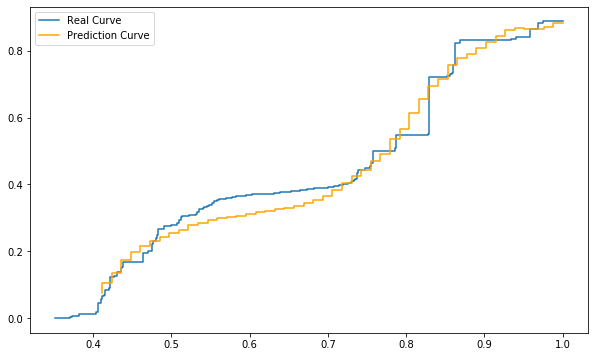

In [ ]:
h = 1
d = 1013

# Plot of the day d and hour h following the formula: (h-1) + (d-1) * 24
qq = energy_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()
pp = prices_m_reduced_scaled.iloc[((h-1) + (d-1) * 24) + 2016, 3:].to_list()

# Remove NaN values from the list
qq = [x for x in qq if not np.isnan(x)]
pp = [x for x in pp if not np.isnan(x)]

# Compute the prediction using Random Forest + LSTM procedure
pp1 = rf_lstm_predictions.iloc[(h-1) + (d-1013) * 24].to_list()

fig, ax = plt.subplots(figsize = (10,6))
plt.step(qq, pp, label = 'Real January 1')
plt.step(qq1, pp1, color = 'orange', label = 'Pred January 1')
plt.legend(['Real Curve', 'Prediction Curve'])

In [ ]:
# Mean error for each hour
rf_lstm_l1_distances.mean()

1    0.0231937111
2    0.0204313035
3    0.0196167200
4    0.0192859770
5    0.0197121401
6    0.0207390432
7    0.0252022452
8    0.0251773110
9    0.0205722229
10   0.0173285447
11   0.0155470898
12   0.0150345931
13   0.0145007355
14   0.0144578331
15   0.0143969486
16   0.0145818819
17   0.0150373833
18   0.0153887883
19   0.0154123040
20   0.0156789533
21   0.0155829449
22   0.0154247614
23   0.0157971534
24   0.0174669887
dtype: float64

In [ ]:
# Mean daily prediction error
round(sum(rf_lstm_l1_distances.mean()) / 24, 4)

0.0177

## Analysis comparison Naive vs Random Forest + LSTM

In [27]:
difference = naive_l1_distances.iloc[:, :25] - rf_lstm_l1_distances.iloc[:, :25]
summary = difference.div(naive_l1_distances.iloc[:, :25])
summary.describe()

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
count,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,...,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000,730.0000000000
mean,-0.0815973094,0.0388710372,0.1109612940,0.1171323918,0.0658469022,-0.0262860825,-0.1142687090,-0.4316907093,-0.4333786426,-1.1629094661,...,-1.6511219917,-1.3644196986,-1.3702711907,-1.2155916182,-0.7011835244,-0.7849694201,-0.8896792054,-0.7167118061,-0.7495054924,-0.6803852697
std,1.2615024928,1.2696420617,1.0796486161,1.1397258401,1.3914412013,1.9540525232,1.4987418780,2.8940841377,2.1487355045,15.9072664399,...,6.8923472054,5.3292382637,8.4483092185,7.9525980904,2.5834465043,4.0971270031,5.9100014472,2.1461629593,2.5085773218,2.1078021737
min,-11.1278331612,-20.7923609276,-14.4731981042,-15.5352808234,-21.1891550168,-37.0017646137,-18.3560217101,-58.6978498862,-27.9972085011,-422.7340887608,...,-89.9716554247,-86.9368402896,-206.9856303413,-187.7868426814,-34.4099928132,-94.3851987707,-150.0582708131,-26.4750295805,-38.4175687075,-25.7074702270
25%,-0.2606443649,-0.1866656192,-0.1097885181,-0.0662127316,-0.0474794812,-0.1970187537,-0.2299216717,-0.4472437728,-0.4270108498,-0.5573260843,...,-0.8943321924,-0.9401590774,-0.9076624354,-0.8738706951,-0.7470177565,-0.7495435420,-0.7662065573,-0.7850192792,-0.7716424803,-0.8105339870
50%,0.3262328516,0.4352485394,0.4756364306,0.4875642466,0.4779689097,0.4479417707,0.3162461100,0.1808645624,0.0741515570,-0.0047802803,...,-0.0711623134,-0.0481875865,-0.0518679273,-0.0249461021,-0.0514630785,-0.0580280714,-0.1065406625,-0.0610809941,-0.1135027637,-0.1014142648
75%,0.6075034774,0.6849198954,0.7182701584,0.7219400998,0.7219644362,0.7049352888,0.6114366439,0.4954105131,0.3636707855,0.2775330408,...,0.2586517238,0.2643751269,0.2653408636,0.2606417446,0.3097050731,0.2931038169,0.2635665487,0.2649298276,0.2467657129,0.2378251338
max,0.9431449095,0.9469060373,0.9616839082,0.9663510781,0.9684148833,0.9679467655,0.9513468352,0.8916669894,0.9143888095,0.7696781320,...,0.8130316602,0.8075917653,0.8409673833,0.8661213095,0.8087439178,0.7528322286,0.7976546608,0.8041893357,0.8105460475,0.8343308897


# Models comparison

## Mean error for each hour of the day

In [ ]:
naive_l1_distances.mean()

1    0.0409316172
2    0.0447588436
3    0.0472144065
4    0.0478618265
5    0.0479784267
6    0.0463920518
7    0.0423406425
8    0.0353322077
9    0.0246366831
10   0.0184007938
11   0.0159236872
12   0.0147807346
13   0.0142167207
14   0.0139720328
15   0.0140764934
16   0.0144022024
17   0.0148320089
18   0.0154949450
19   0.0159057870
20   0.0158241386
21   0.0155839970
22   0.0152801038
23   0.0154087311
24   0.0168686316
dtype: float64

In [ ]:
dnn_l1_distances.mean()

1    0.0490601299
2    0.0538256067
3    0.0566527593
4    0.0561380973
5    0.0556943271
6    0.0543075754
7    0.0478897137
8    0.0372413888
9    0.0256910788
10   0.0198513111
11   0.0179508050
12   0.0172275957
13   0.0169833703
14   0.0170722773
15   0.0170046669
16   0.0170475868
17   0.0172716432
18   0.0176080055
19   0.0181759370
20   0.0190152140
21   0.0193937952
22   0.0196337947
23   0.0201954473
24   0.0218223672
dtype: float64

In [ ]:
cnn_l1_distances.mean()

1    0.0495841760
2    0.0547041382
3    0.0576263532
4    0.0578443347
5    0.0585816035
6    0.0566405773
7    0.0468571716
8    0.0359225584
9    0.0262740937
10   0.0209803246
11   0.0185853847
12   0.0184674353
13   0.0188483749
14   0.0186080191
15   0.0185292075
16   0.0183708634
17   0.0182666812
18   0.0190540090
19   0.0188249927
20   0.0194288608
21   0.0196970546
22   0.0193668181
23   0.0194801174
24   0.0223735146
dtype: float64

In [ ]:
lstm_l1_distances.mean()

1    0.0479682367
2    0.0479721335
3    0.0505531293
4    0.0509347031
5    0.0511540976
6    0.0492780490
7    0.0442812238
8    0.0340508471
9    0.0244947652
10   0.0198398514
11   0.0173872485
12   0.0165839989
13   0.0165845896
14   0.0165716524
15   0.0166644474
16   0.0171294887
17   0.0172376215
18   0.0175287196
19   0.0178269094
20   0.0179091388
21   0.0179380638
22   0.0178775071
23   0.0183260639
24   0.0206737838
dtype: float64

In [ ]:
rf_l1_distances.mean()

1    0.0436034200
2    0.0478196706
3    0.0508696070
4    0.0518276362
5    0.0519011703
6    0.0498170867
7    0.0431098612
8    0.0340962677
9    0.0234654089
10   0.0184201993
11   0.0166675729
12   0.0161608581
13   0.0157849350
14   0.0156766623
15   0.0156591999
16   0.0158747163
17   0.0160160251
18   0.0162731287
19   0.0163980386
20   0.0166595490
21   0.0167260478
22   0.0165863624
23   0.0166466386
24   0.0184229801
dtype: float64

In [ ]:
rf_dnn_l1_distances.mean()

1    0.0391276111
2    0.0416085730
3    0.0435144168
4    0.0444451920
5    0.0449156013
6    0.0429205716
7    0.0398063721
8    0.0322993026
9    0.0226569743
10   0.0177838091
11   0.0159116608
12   0.0151006241
13   0.0145546900
14   0.0144083929
15   0.0144945733
16   0.0148130181
17   0.0152986262
18   0.0158200607
19   0.0159711012
20   0.0162432274
21   0.0160568143
22   0.0159248468
23   0.0162451403
24   0.0181468232
dtype: float64

In [ ]:
rf_cnn_l1_distances.mean()

1    0.0238231843
2    0.0259867911
3    0.0292749381
4    0.0309600567
5    0.0305329934
6    0.0265680281
7    0.0201281200
8    0.0184080761
9    0.0164213041
10   0.0134989407
11   0.0117680397
12   0.0103245753
13   0.0096966954
14   0.0090438635
15   0.0092641022
16   0.0094273969
17   0.0098595108
18   0.0106412274
19   0.0116835198
20   0.0120546103
21   0.0125049087
22   0.0126532943
23   0.0132470784
24   0.0147527399
dtype: float64

In [ ]:
rf_lstm_l1_distances.mean()

1    0.0231937111
2    0.0204313035
3    0.0196167200
4    0.0192859770
5    0.0197121401
6    0.0207390432
7    0.0252022452
8    0.0251773110
9    0.0205722229
10   0.0173285447
11   0.0155470898
12   0.0150345931
13   0.0145007355
14   0.0144578331
15   0.0143969486
16   0.0145818819
17   0.0150373833
18   0.0153887883
19   0.0154123040
20   0.0156789533
21   0.0155829449
22   0.0154247614
23   0.0157971534
24   0.0174669887
dtype: float64

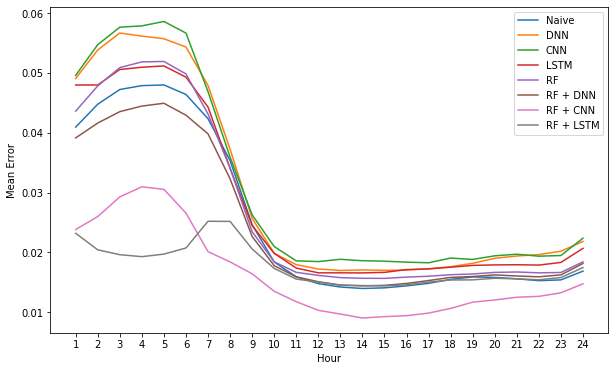

In [ ]:
# Figure showing the mean error of the different procedures through all the hours of the day
fig, ax = plt.subplots(figsize = (10,6))

ax.plot(energy_m_reduced['hour'].unique(),naive_l1_distances.mean(), label = 'Naive')
ax.plot(energy_m_reduced['hour'].unique(),dnn_l1_distances.mean(), label = 'DNN')
ax.plot(energy_m_reduced['hour'].unique(),cnn_l1_distances.mean(), label = 'CNN')
ax.plot(energy_m_reduced['hour'].unique(),lstm_l1_distances.mean(), label = 'LSTM')
ax.plot(energy_m_reduced['hour'].unique(),rf_l1_distances.mean(), label = 'RF')
ax.plot(energy_m_reduced['hour'].unique(),rf_dnn_l1_distances.mean(), label = 'RF + DNN')
ax.plot(energy_m_reduced['hour'].unique(),rf_cnn_l1_distances.mean(), label = 'RF + CNN')
ax.plot(energy_m_reduced['hour'].unique(),rf_lstm_l1_distances.mean(), label = 'RF + LSTM')

ax.set_xlabel('Hour')
ax.set_ylabel('Mean Error')

ax.set_xticks(energy_m_reduced['hour'].unique())

plt.legend(['Naive', 'DNN', 'CNN', 'LSTM', 'RF', 'RF + DNN', 'RF + CNN', 'RF + LSTM'])
plt.show()

## Mean Daily Prediction Error

In [ ]:
round(sum(naive_l1_distances.mean()) / 24, 4)

0.0254

In [ ]:
round(sum(dnn_l1_distances.mean()) / 24, 4)

0.0297

In [ ]:
round(sum(cnn_l1_distances.mean()) / 24, 4)

0.0305

In [ ]:
round(sum(lstm_l1_distances.mean()) / 24, 4)

0.0278

In [ ]:
round(sum(rf_l1_distances.mean()) / 24, 4)

0.0269

In [ ]:
round(sum(rf_dnn_l1_distances.mean()) / 24, 4)

0.0245

In [ ]:
round(sum(rf_cnn_l1_distances.mean()) / 24, 4)

0.0164

In [ ]:
round(sum(rf_lstm_l1_distances.mean()) / 24, 4)

0.0177

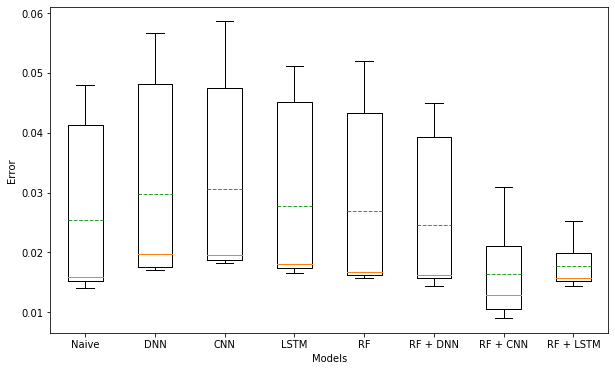

In [ ]:
fig, ax = plt.subplots(figsize = (10,6))

labels = ['Naive', 'DNN', 'CNN', 'LSTM', 'RF', 'RF + DNN', 'RF + CNN', 'RF + LSTM']

ax.boxplot([naive_l1_distances.mean(), dnn_l1_distances.mean(), cnn_l1_distances.mean(), lstm_l1_distances.mean(), rf_l1_distances.mean(), rf_dnn_l1_distances.mean(), rf_cnn_l1_distances.mean(), rf_lstm_l1_distances.mean()], showmeans = True, meanline = True)

ax.set_xlabel('Models')
ax.set_ylabel('Error')

ax.set_xticklabels(labels)
plt.show()

## Mean daily error per day of the week

### Naive

In [ ]:
# Obtain the total number of rows
total_rows = naive_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
naive_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
naive_days = naive_l1_distances.groupby('day_of_week').mean()
naive_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0347276839,0.0397500962,0.0422640708,0.0426266335,0.0426590945,0.0411644831,0.0340116571,0.0227492139,0.0177518581,0.0150953590,...,0.0124281533,0.0129890560,0.0133914925,0.0138008733,0.0137609333,0.0141759106,0.0147561931,0.0145828006,0.0146635061,0.0159967907
Monday,0.0459552888,0.0502459832,0.0537293967,0.0554101784,0.0548543434,0.0526536198,0.0546565734,0.0584166626,0.0386886917,0.0253381509,...,0.0157986670,0.0162782849,0.0170431505,0.0185647308,0.0193670293,0.0186688633,0.0183236390,0.0180470408,0.0180161311,0.0191064905
Saturday,0.0368946054,0.0416724779,0.0442762858,0.0467163314,0.0469632571,0.0462862375,0.0490459867,0.0458873732,0.0265084632,0.0195351450,...,0.0146063384,0.0148172703,0.0150296721,0.0158497843,0.0170059356,0.0167636762,0.0163642424,0.0156387708,0.0155058405,0.0173740905
Sunday,0.0451441520,0.0483173599,0.0508257225,0.0510882007,0.0522986783,0.0516130679,0.0487390111,0.0429469391,0.0308655791,0.0198222145,...,0.0144127752,0.0151315860,0.0157099370,0.0158039745,0.0156138508,0.0149636567,0.0146251839,0.0149254222,0.0157845929,0.0165984559
Thursday,0.0343939714,0.0392400903,0.0419819370,0.0425366541,0.0434916661,0.0424292362,0.0351673130,0.0248130348,0.0195248509,0.0164542605,...,0.0130127092,0.0127633167,0.0128983060,0.0134381790,0.0134772628,0.0138149216,0.0135793440,0.0132456245,0.0135441835,0.0147915299
Tuesday,0.0467665263,0.0457028241,0.0468502611,0.0459461862,0.0456402836,0.0435982156,0.0372784369,0.0260851319,0.0181825718,0.0147198013,...,0.0143829593,0.0146984453,0.0151324545,0.0156391932,0.0165823239,0.0168125191,0.0165287990,0.0161846567,0.0163689357,0.0182348693
Wednesday,0.0425672600,0.0483395670,0.0505446515,0.0506997332,0.0499452345,0.0470203254,0.0375799702,0.0265999761,0.0210314908,0.0178810178,...,0.0138926721,0.0141371576,0.0146182167,0.0153677163,0.0155302789,0.0155624358,0.0149079929,0.0143367835,0.0139824102,0.0159736627


In [ ]:
# round(naive_days.iloc[0].mean(), 4) # Friday
# round(naive_days.iloc[1].mean(), 4) # Monday
# round(naive_days.iloc[2].mean(), 4) # Saturday
round(naive_days.iloc[3].mean(), 4) # Sunday
# round(naive_days.iloc[4].mean(), 4) # Thursday
# round(naive_days.iloc[5].mean(), 4) # Tuesday
# round(naive_days.iloc[6].mean(), 4) # Wednesday

0.0272

### DNN

In [ ]:
# Obtain the total number of rows
total_rows = dnn_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
dnn_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
dnn_days = dnn_l1_distances.groupby('day_of_week').mean()
dnn_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0455386939,0.0536774980,0.0552493092,0.0548711655,0.0557918979,0.0547919810,0.0472102760,0.0345612828,0.0234512172,0.0194414932,...,0.0161778499,0.0163130454,0.0167320285,0.0169044139,0.0164468471,0.0173154553,0.0179472005,0.0187887214,0.0188901490,0.0208174625
Monday,0.0589093076,0.0633465800,0.0673566555,0.0643949970,0.0615153065,0.0599838127,0.0510750518,0.0378233197,0.0257401287,0.0209424641,...,0.0170618470,0.0174314417,0.0176908636,0.0185192569,0.0200685175,0.0203927059,0.0200303167,0.0209144879,0.0217596563,0.0229996232
Saturday,0.0470492027,0.0495002117,0.0520815451,0.0540812798,0.0550319085,0.0555682324,0.0511464411,0.0395385437,0.0272801238,0.0185487295,...,0.0172682939,0.0169282494,0.0167561786,0.0170176091,0.0175168184,0.0185087648,0.0200515324,0.0196541587,0.0203273498,0.0219510024
Sunday,0.0541103566,0.0586840956,0.0638131306,0.0636294577,0.0624183662,0.0603158182,0.0548113211,0.0481252188,0.0347376278,0.0227205681,...,0.0180194914,0.0181592838,0.0189503575,0.0193572985,0.0194746672,0.0205181726,0.0209214185,0.0220183063,0.0231609046,0.0245500684
Thursday,0.0458028867,0.0516609794,0.0510674674,0.0492451610,0.0501038606,0.0498009276,0.0446022211,0.0338598436,0.0228143171,0.0185223945,...,0.0165141747,0.0164482038,0.0165296813,0.0173264035,0.0175322126,0.0188213117,0.0186372414,0.0180678756,0.0184915900,0.0196883102
Tuesday,0.0474691596,0.0525066775,0.0552647845,0.0549497235,0.0537719557,0.0507603452,0.0448704366,0.0337468932,0.0221444849,0.0188459563,...,0.0170455733,0.0171846327,0.0172681062,0.0173883558,0.0183325229,0.0193310871,0.0192897285,0.0192895634,0.0197367228,0.0213517535
Wednesday,0.0445994911,0.0474769316,0.0517964641,0.0518475780,0.0512878489,0.0490168909,0.0416017411,0.0331079655,0.0237226806,0.0199463250,...,0.0169456125,0.0168686535,0.0169771524,0.0167530336,0.0178614911,0.0182235752,0.0188850211,0.0187155885,0.0190174956,0.0214068703


In [ ]:
# round(dnn_days.iloc[0].mean(), 4) # Friday
# round(dnn_days.iloc[1].mean(), 4) # Monday
# round(dnn_days.iloc[2].mean(), 4) # Saturday
round(dnn_days.iloc[3].mean(), 4) # Sunday
# round(dnn_days.iloc[4].mean(), 4) # Thursday
# round(dnn_days.iloc[5].mean(), 4) # Tuesday
# round(dnn_days.iloc[6].mean(), 4) # Wednesday

0.0335

### CNN

In [ ]:
# Obtain the total number of rows
total_rows = cnn_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
cnn_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
cnn_days = cnn_l1_distances.groupby('day_of_week').mean()
cnn_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0472743932,0.0520435529,0.0553349029,0.0562848151,0.0570230965,0.0569891323,0.0474332313,0.0317688259,0.0246501722,0.0212766310,...,0.0183262114,0.0185448805,0.0191005899,0.0197806007,0.0192889562,0.0189672855,0.0194147138,0.0199429803,0.0204745411,0.0237231918
Monday,0.0588349647,0.0617688123,0.0636077969,0.0626406269,0.0637590042,0.0623039487,0.0469404539,0.0366830620,0.0252449266,0.0216035304,...,0.0166868730,0.0172692153,0.0180266531,0.0199431410,0.0201218346,0.0204684536,0.0208578619,0.0202565045,0.0196351871,0.0233665546
Saturday,0.0468031697,0.0518835632,0.0523858997,0.0538687421,0.0556420029,0.0535041748,0.0466859915,0.0387279093,0.0262336287,0.0189510923,...,0.0187242758,0.0179500811,0.0172668743,0.0173045345,0.0176928623,0.0184356640,0.0188432932,0.0201903897,0.0202893525,0.0217655322
Sunday,0.0539480594,0.0589439505,0.0634887409,0.0620576642,0.0604879045,0.0620927663,0.0551559608,0.0433136859,0.0333377014,0.0225387113,...,0.0193093451,0.0194996961,0.0192958119,0.0197445652,0.0195597682,0.0210308730,0.0210122543,0.0194127282,0.0203910329,0.0238689433
Thursday,0.0436541688,0.0501274003,0.0531014988,0.0534260376,0.0540795938,0.0503348889,0.0423655316,0.0305267496,0.0223825060,0.0197308270,...,0.0185081148,0.0188865488,0.0180647613,0.0187359082,0.0182994057,0.0190954000,0.0190639320,0.0188349433,0.0180053905,0.0204249365
Tuesday,0.0512037701,0.0579826879,0.0620045380,0.0620866041,0.0623634487,0.0582019475,0.0438179981,0.0363162314,0.0276322946,0.0217282381,...,0.0198201264,0.0193093909,0.0192150541,0.0197304444,0.0199820336,0.0209095395,0.0204963040,0.0198534130,0.0200325994,0.0236525396
Wednesday,0.0453954100,0.0501908729,0.0534590676,0.0545368643,0.0566979225,0.0530764397,0.0456419421,0.0341348486,0.0244419834,0.0210256149,...,0.0183191133,0.0171390511,0.0169010358,0.0181411425,0.0168380681,0.0171029376,0.0181977544,0.0170939434,0.0175460031,0.0198251100


In [ ]:
# round(cnn_days.iloc[0].mean(), 4) # Friday
# round(cnn_days.iloc[1].mean(), 4) # Monday
# round(cnn_days.iloc[2].mean(), 4) # Saturday
round(cnn_days.iloc[3].mean(), 4) # Sunday
# round(cnn_days.iloc[4].mean(), 4) # Thursday
# round(cnn_days.iloc[5].mean(), 4) # Tuesday
# round(cnn_days.iloc[6].mean(), 4) # Wednesday

0.0331

### LSTM

In [ ]:
# Obtain the total number of rows
total_rows = lstm_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
lstm_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
lstm_days = lstm_l1_distances.groupby('day_of_week').mean()
lstm_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0451127292,0.0470330912,0.0501822958,0.0523479674,0.0518466860,0.0491437539,0.0411362382,0.0293852638,0.0219233635,0.0205222698,...,0.0175205506,0.0180975711,0.0179089045,0.0177127929,0.0173695684,0.0185260489,0.0184758609,0.0185190057,0.0188627604,0.0207119000
Monday,0.0540017231,0.0516138082,0.0532419354,0.0521908387,0.0543981879,0.0504778773,0.0454484977,0.0363731297,0.0242876960,0.0220929924,...,0.0172078757,0.0178201796,0.0177253156,0.0175376395,0.0189517792,0.0192178266,0.0181965023,0.0176282326,0.0185026831,0.0199701526
Saturday,0.0423097095,0.0427570793,0.0439449308,0.0463559439,0.0481396822,0.0459574574,0.0445181585,0.0351157883,0.0244295500,0.0178838475,...,0.0166945902,0.0165450263,0.0170506818,0.0180107063,0.0173437862,0.0181761857,0.0186717262,0.0184097406,0.0191197275,0.0222249513
Sunday,0.0529051979,0.0553648932,0.0563192557,0.0588015258,0.0608210054,0.0579473155,0.0570031700,0.0485411982,0.0348834999,0.0235605391,...,0.0175296907,0.0178397803,0.0185593082,0.0192272168,0.0192659986,0.0185424751,0.0188492003,0.0196753068,0.0204719363,0.0233911204
Thursday,0.0453315663,0.0462528987,0.0468368689,0.0452172405,0.0429558254,0.0451641315,0.0394637611,0.0295241045,0.0228167101,0.0184070252,...,0.0159789566,0.0165040158,0.0162958914,0.0175785100,0.0182396805,0.0181663327,0.0181447810,0.0178793431,0.0174478248,0.0204159933
Tuesday,0.0509093903,0.0489524566,0.0524434255,0.0509249734,0.0509988465,0.0481623534,0.0404371972,0.0306650233,0.0215469174,0.0182688350,...,0.0153356905,0.0157948604,0.0159917260,0.0162551150,0.0165416030,0.0164573086,0.0165204265,0.0158662187,0.0155533173,0.0175869672
Wednesday,0.0452056236,0.0438608132,0.0508818563,0.0507067175,0.0489412200,0.0481153616,0.0420202462,0.0288341384,0.0216314955,0.0181745689,...,0.0163991051,0.0173160271,0.0171443988,0.0164021351,0.0170953431,0.0163071573,0.0167331657,0.0171906461,0.0183506231,0.0204472608


In [ ]:
# round(lstm_days.iloc[0].mean(), 4) # Friday
# round(lstm_days.iloc[1].mean(), 4) # Monday
# round(lstm_days.iloc[2].mean(), 4) # Saturday
round(lstm_days.iloc[3].mean(), 4) # Sunday
# round(lstm_days.iloc[4].mean(), 4) # Thursday
# round(lstm_days.iloc[5].mean(), 4) # Tuesday
# round(lstm_days.iloc[6].mean(), 4) # Wednesday

0.0321

### Random Forest

In [ ]:
# Obtain the total number of rows
total_rows = rf_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
rf_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
rf_days = rf_l1_distances.groupby('day_of_week').mean()
rf_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0427116693,0.0467894097,0.0504753099,0.0512317495,0.0517353229,0.0496954585,0.0421614971,0.0295048107,0.0207954216,0.0174617899,...,0.0152625397,0.0153118487,0.0151273150,0.0149270304,0.0149839877,0.0156955899,0.0162388182,0.0161850254,0.0159549562,0.0178644544
Monday,0.0496806903,0.0546031612,0.0582349923,0.0586354251,0.0576805405,0.0533966288,0.0452373540,0.0410335318,0.0266774153,0.0202288618,...,0.0159504342,0.0163933203,0.0167556957,0.0180284210,0.0184491496,0.0184043238,0.0182523365,0.0182629287,0.0181591155,0.0200597889
Saturday,0.0406654329,0.0451708192,0.0475234798,0.0499923669,0.0506176581,0.0495658863,0.0446521777,0.0369566294,0.0240707876,0.0176592625,...,0.0147606468,0.0148387384,0.0149050319,0.0151163184,0.0158443087,0.0159786030,0.0163707452,0.0163281556,0.0164451797,0.0185788454
Sunday,0.0456648750,0.0509800913,0.0548374489,0.0560434756,0.0563425724,0.0555057242,0.0504907138,0.0435125077,0.0319019841,0.0221874903,...,0.0156176902,0.0161621904,0.0165353511,0.0173436443,0.0169446922,0.0170626056,0.0170991021,0.0168483188,0.0178096163,0.0202393705
Thursday,0.0403702457,0.0456671964,0.0478848012,0.0487171034,0.0491504832,0.0475183643,0.0395131831,0.0284179219,0.0205354724,0.0175911937,...,0.0162666841,0.0165284736,0.0165869759,0.0162963344,0.0163048743,0.0169070098,0.0165464147,0.0162719892,0.0160266956,0.0174181776
Tuesday,0.0451148710,0.0472599456,0.0502140792,0.0506334629,0.0499168717,0.0472442387,0.0399141679,0.0299712617,0.0202584760,0.0164894468,...,0.0160005283,0.0161976515,0.0163201422,0.0164133537,0.0165788883,0.0167814534,0.0167357606,0.0164469221,0.0163564158,0.0178064174
Wednesday,0.0410264019,0.0443062356,0.0469610232,0.0475920789,0.0479220837,0.0458561312,0.0398618933,0.0293623923,0.0200816771,0.0173521847,...,0.0157517042,0.0156894671,0.0158800470,0.0157900949,0.0156854822,0.0157944038,0.0158475113,0.0157703840,0.0157855610,0.0170132897


In [ ]:
# round(rf_days.iloc[0].mean(), 4) # Friday
# round(rf_days.iloc[1].mean(), 4) # Monday
# round(rf_days.iloc[2].mean(), 4) # Saturday
round(rf_days.iloc[3].mean(), 4) # Sunday
# round(rf_days.iloc[4].mean(), 4) # Thursday
# round(rf_days.iloc[5].mean(), 4) # Tuesday
# round(rf_days.iloc[6].mean(), 4) # Wednesday

0.0294

### Random Forest + DNN

In [ ]:
# Obtain the total number of rows
total_rows = rf_dnn_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
rf_dnn_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
rf_dnn_days = rf_dnn_l1_distances.groupby('day_of_week').mean()
rf_dnn_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0378505339,0.0398599677,0.0425833086,0.0434621831,0.0440993076,0.0434230263,0.0382820043,0.0279457279,0.0207453093,0.0166311365,...,0.0138164883,0.0140355035,0.0145176541,0.0146511590,0.0144536581,0.0151479105,0.0154581407,0.0154916893,0.0154852650,0.0177582242
Monday,0.0433464230,0.0474926873,0.0472430946,0.0490929435,0.0494098672,0.0449893614,0.0412970356,0.0368655860,0.0240897844,0.0190072364,...,0.0137942925,0.0143340428,0.0149113594,0.0164217538,0.0171468195,0.0173982196,0.0171248930,0.0170996522,0.0170920830,0.0192234919
Saturday,0.0355999324,0.0399763791,0.0421556797,0.0435303911,0.0448263212,0.0446957744,0.0434125588,0.0359939384,0.0236983068,0.0179116910,...,0.0143825690,0.0146324900,0.0149816764,0.0157843967,0.0162661406,0.0159516328,0.0159499925,0.0159830889,0.0164044764,0.0185896312
Sunday,0.0433952645,0.0441292829,0.0477448748,0.0487353893,0.0487537109,0.0473924527,0.0466377656,0.0437701829,0.0317323503,0.0216901964,...,0.0153631040,0.0160747858,0.0164605580,0.0167288843,0.0166692487,0.0168237643,0.0162726501,0.0163771820,0.0173010135,0.0195964996
Thursday,0.0379010858,0.0394551266,0.0416278313,0.0425118699,0.0425104468,0.0399537222,0.0372987122,0.0260956662,0.0202805568,0.0168472621,...,0.0146663533,0.0147906172,0.0154396955,0.0154262113,0.0153652122,0.0163859744,0.0159706323,0.0155912944,0.0160912406,0.0177620873
Tuesday,0.0386912497,0.0403057735,0.0429955329,0.0431516352,0.0425103274,0.0396893471,0.0357764008,0.0282629773,0.0188083084,0.0156305447,...,0.0146552215,0.0149207812,0.0155872880,0.0160487167,0.0163969614,0.0166384515,0.0165184498,0.0161174737,0.0161689346,0.0175236631
Wednesday,0.0371321713,0.0400681328,0.0402866212,0.0406805679,0.0423470528,0.0403560453,0.0360153295,0.0272484168,0.0193133609,0.0167987728,...,0.0147796981,0.0149010235,0.0151904171,0.0156784662,0.0155001021,0.0153613184,0.0151076292,0.0148222961,0.0151839062,0.0165950776


In [ ]:
# round(rf_dnn_days.iloc[0].mean(), 4) # Friday
# round(rf_dnn_days.iloc[1].mean(), 4) # Monday
# round(rf_dnn_days.iloc[2].mean(), 4) # Saturday
round(rf_dnn_days.iloc[3].mean(), 4) # Sunday
# round(rf_dnn_days.iloc[4].mean(), 4) # Thursday
# round(rf_dnn_days.iloc[5].mean(), 4) # Tuesday
# round(rf_dnn_days.iloc[6].mean(), 4) # Wednesday

0.0273

### Random Forest + CNN

In [ ]:
# Obtain the total number of rows
total_rows = rf_cnn_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
rf_cnn_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
rf_cnn_days = rf_cnn_l1_distances.groupby('day_of_week').mean()
rf_cnn_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0197049263,0.0201010191,0.0242736878,0.0246559686,0.0250928195,0.0233446663,0.0187896292,0.0182719460,0.0161144353,0.0132562771,...,0.0089889962,0.0092509546,0.0096817903,0.0096991262,0.0105982753,0.0120737534,0.0128514084,0.0128097136,0.0127826665,0.0146379329
Monday,0.0413557465,0.0417693427,0.0443637081,0.0457169648,0.0427411022,0.0340861711,0.0197290829,0.0210399881,0.0173706770,0.0134285107,...,0.0096322229,0.0092447497,0.0095984426,0.0109534530,0.0124103811,0.0117558299,0.0121282840,0.0126878653,0.0124901141,0.0142511010
Saturday,0.0188894272,0.0225295670,0.0252996140,0.0294556241,0.0304874251,0.0275322019,0.0207663512,0.0179454575,0.0169853887,0.0143335476,...,0.0092711300,0.0097426059,0.0097754824,0.0107661361,0.0121303823,0.0121261288,0.0135441622,0.0131071856,0.0139573349,0.0158478192
Sunday,0.0238894989,0.0252025537,0.0284966261,0.0325137801,0.0328961945,0.0298771996,0.0245467935,0.0188258948,0.0176241004,0.0145348778,...,0.0098252787,0.0106805815,0.0107534771,0.0116163245,0.0124655223,0.0127213134,0.0136408943,0.0141693739,0.0151824607,0.0156958143
Thursday,0.0203411914,0.0218315684,0.0234059290,0.0236571681,0.0225233248,0.0226997725,0.0186660830,0.0178498399,0.0159163332,0.0129109718,...,0.0091205785,0.0086865680,0.0098724639,0.0107321509,0.0114094795,0.0118954836,0.0115049416,0.0125330617,0.0118884113,0.0143873410
Tuesday,0.0231848857,0.0299925918,0.0350151335,0.0354015721,0.0346792436,0.0269468495,0.0194405634,0.0180474519,0.0160070073,0.0130083735,...,0.0090464681,0.0090623573,0.0095083076,0.0103235596,0.0110994347,0.0113819282,0.0114502451,0.0111477762,0.0128802395,0.0142577828
Wednesday,0.0194448507,0.0204951819,0.0240647720,0.0253307400,0.0253210906,0.0215340967,0.0189760259,0.0168939810,0.0149493241,0.0130292595,...,0.0089689718,0.0093284227,0.0098302697,0.0104031850,0.0116768442,0.0124306868,0.0124253315,0.0121375196,0.0135489463,0.0142014481


In [ ]:
# round(rf_cnn_days.iloc[0].mean(), 4) # Friday
# round(rf_cnn_days.iloc[1].mean(), 4) # Monday
# round(rf_cnn_days.iloc[2].mean(), 4) # Saturday
round(rf_cnn_days.iloc[3].mean(), 4) # Sunday
# round(rf_cnn_days.iloc[4].mean(), 4) # Thursday
# round(rf_cnn_days.iloc[5].mean(), 4) # Tuesday
# round(rf_cnn_days.iloc[6].mean(), 4) # Wednesday

0.0175

### Random Forest + LSTM

In [ ]:
# Obtain the total number of rows
total_rows = rf_lstm_l1_distances.shape[0]

# Create a list for the days of the week
days_of_week = ['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Monday']

# Create the new column 'day_of_week' with the numbers from 1 to 7
day_column = []
for i in range(total_rows):
    day_column.extend([days_of_week[i % 7]])
rf_lstm_l1_distances.insert(0, 'day_of_week', day_column)

In [ ]:
# Mean error for each day through all the hours of the day
rf_lstm_days = rf_lstm_l1_distances.groupby('day_of_week').mean()
rf_lstm_days

,1,2,3,4,5,6,7,8,9,10,...,15,16,17,18,19,20,21,22,23,24
day_of_week,,,,,,,,,,,,,,,,,,,,,
Friday,0.0232901212,0.0208786031,0.0200805848,0.0198728229,0.0210219538,0.0208752756,0.0243592727,0.0238408495,0.0182594222,0.0161233184,...,0.0140849816,0.0141248898,0.0142174442,0.0143746077,0.0139689503,0.0145935358,0.0151340528,0.0148905009,0.0153940016,0.0174075531
Monday,0.0211898762,0.0195759313,0.0186824748,0.0194061170,0.0200135604,0.0207250758,0.0269206400,0.0271916712,0.0213010347,0.0180495618,...,0.0146298265,0.0149291636,0.0151231435,0.0160224254,0.0164407215,0.0168890413,0.0166970549,0.0168537549,0.0168042529,0.0176313014
Saturday,0.0231777827,0.0212751117,0.0196302450,0.0194789784,0.0192995647,0.0203987486,0.0231214599,0.0284059170,0.0219867291,0.0175975446,...,0.0137942196,0.0138344777,0.0145498924,0.0153402835,0.0155678253,0.0158352789,0.0157753784,0.0158462797,0.0156987462,0.0180186786
Sunday,0.0207656191,0.0194000789,0.0187213538,0.0192424875,0.0204538440,0.0198212074,0.0216259462,0.0268651668,0.0254321676,0.0203664579,...,0.0149671330,0.0154246793,0.0161213641,0.0168879014,0.0160102889,0.0157163023,0.0158427576,0.0153815565,0.0166971108,0.0191008480
Thursday,0.0223839316,0.0200054354,0.0200984345,0.0184459807,0.0184273658,0.0212250164,0.0261701763,0.0223385881,0.0197003973,0.0166061190,...,0.0144291757,0.0144859518,0.0151132288,0.0147814022,0.0152975740,0.0158006866,0.0150227656,0.0148023443,0.0152327822,0.0166356166
Tuesday,0.0259886336,0.0211658149,0.0208112403,0.0204273657,0.0198040498,0.0220742169,0.0276081450,0.0254198076,0.0193641462,0.0158275923,...,0.0148093874,0.0150138015,0.0155279988,0.0158009975,0.0161930053,0.0157727786,0.0158276601,0.0155941644,0.0160968958,0.0172090286
Wednesday,0.0255108590,0.0207084218,0.0192844164,0.0181282438,0.0189708862,0.0200475726,0.0265737550,0.0222054209,0.0179980312,0.0167492220,...,0.0140631600,0.0142591597,0.0146080224,0.0145183070,0.0144098944,0.0151492407,0.0147862522,0.0146109256,0.0146642953,0.0162797907


In [ ]:
# round(rf_lstm_days.iloc[0].mean(), 4) # Friday
# round(rf_lstm_days.iloc[1].mean(), 4) # Monday
# round(rf_lstm_days.iloc[2].mean(), 4) # Saturday
round(rf_lstm_days.iloc[3].mean(), 4) # Sunday
# round(rf_lstm_days.iloc[4].mean(), 4) # Thursday
# round(rf_lstm_days.iloc[5].mean(), 4) # Tuesday
# round(rf_lstm_days.iloc[6].mean(), 4) # Wednesday

0.0182

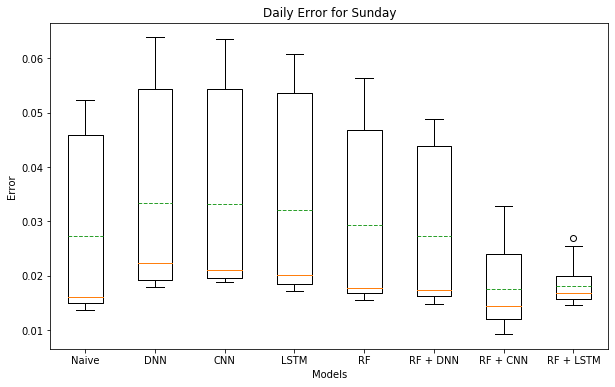

In [ ]:
fig, ax = plt.subplots(figsize = (10,6))

labels = ['Naive', 'DNN', 'CNN', 'LSTM', 'RF', 'RF + DNN', 'RF + CNN', 'RF + LSTM']

ax.boxplot([naive_days.iloc[3], dnn_days.iloc[3], cnn_days.iloc[3], lstm_days.iloc[3], rf_days.iloc[3], rf_dnn_days.iloc[3], rf_cnn_days.iloc[3], rf_lstm_days.iloc[3]], showmeans = True, meanline = True)

ax.set_title('Daily Error for Sunday')

ax.set_xlabel('Models')
ax.set_ylabel('Error')

ax.set_xticklabels(labels)
plt.show()

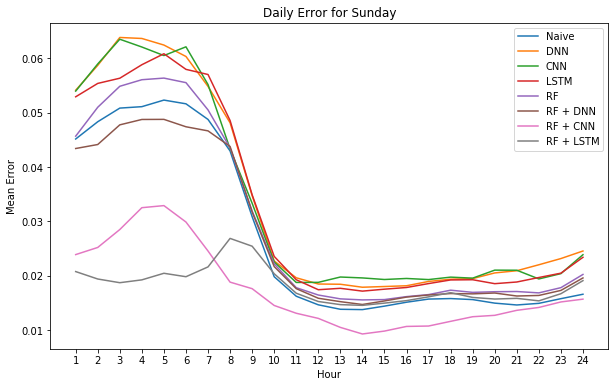

In [ ]:
# Figure showing the mean error of the different procedures through all the hours of the day for Sunday
fig, ax = plt.subplots(figsize = (10,6))

ax.plot(energy_m_reduced['hour'].unique(), naive_days.iloc[3], label = 'Naive')
ax.plot(energy_m_reduced['hour'].unique(), dnn_days.iloc[3], label = 'DNN')
ax.plot(energy_m_reduced['hour'].unique(), cnn_days.iloc[3], label = 'CNN')
ax.plot(energy_m_reduced['hour'].unique(), lstm_days.iloc[3], label = 'LSTM')
ax.plot(energy_m_reduced['hour'].unique(), rf_days.iloc[3], label = 'RF')
ax.plot(energy_m_reduced['hour'].unique(), rf_dnn_days.iloc[3], label = 'RF + DNN')
ax.plot(energy_m_reduced['hour'].unique(), rf_cnn_days.iloc[3], label = 'RF + CNN')
ax.plot(energy_m_reduced['hour'].unique(), rf_lstm_days.iloc[3], label = 'RF + LSTM')

ax.set_title('Daily Error for Sunday')

ax.set_xlabel('Hour')
ax.set_ylabel('Mean Error')

ax.set_xticks(energy_m_reduced['hour'].unique())

plt.legend(['Naive', 'DNN', 'CNN', 'LSTM', 'RF', 'RF + DNN', 'RF + CNN', 'RF + LSTM'])
plt.show()